## Part 5. 사교육비 실습

#**1. 모듈 설치 및 호출**

In [1]:
# !pip install geneticalgorithm

In [2]:
import copy
import math
import itertools
from random import randint

import numpy as np
import pandas as pd
import tqdm
import matplotlib.pyplot as plt
from scipy.stats import spearmanr
from scipy.cluster import hierarchy
from sklearn.ensemble import RandomForestRegressor, VotingRegressor
from sklearn.inspection import permutation_importance
from sklearn.linear_model import ElasticNet
from sklearn.metrics import r2_score
from sklearn.model_selection import train_test_split, GridSearchCV, RandomizedSearchCV
from sklearn.neighbors import KNeighborsRegressor
from sklearn.neural_network import MLPRegressor
from sklearn.preprocessing import MinMaxScaler
from sklearn.svm import SVR
from sklearn.utils.fixes import loguniform
from xgboost import XGBRegressor
from geneticalgorithm import geneticalgorithm


pd.set_option('display.max_columns', None)

# **2. 데이터 로드 및 탐색적 데이터 분석**

In [3]:
# # student-mat.csv 데이터 파일을 Colab에 업로드
# # Data link: https://archive.ics.uci.edu/ml/datasets/student+performance
# # 두 과목 성적중 수학 성적 데이터 (student-mat.csv) 사용

# from google.colab import files, drive
# file_uploaded = files.upload()

In [4]:
# # Colab에 데이터 파일을 올려놓은 경우
# # drive.mount('./content')
# ! ls /content

In [5]:
# 학생데이터로 G1(1차시험), G2(2차시험), G3(최종성적/등급)
# 여러학교 데이터
raw_data = pd.read_csv('student-mat.csv', delimiter=';')
raw_data

,school,sex,age,address,famsize,Pstatus,Medu,Fedu,Mjob,Fjob,reason,guardian,traveltime,studytime,failures,schoolsup,famsup,paid,activities,nursery,higher,internet,romantic,famrel,freetime,goout,Dalc,Walc,health,absences,G1,G2,G3
0,GP,F,18,U,GT3,A,4,4,at_home,teacher,course,mother,2,2,0,yes,no,no,no,yes,yes,no,no,4,3,4,1,1,3,6,5,6,6
1,GP,F,17,U,GT3,T,1,1,at_home,other,course,father,1,2,0,no,yes,no,no,no,yes,yes,no,5,3,3,1,1,3,4,5,5,6
2,GP,F,15,U,LE3,T,1,1,at_home,other,other,mother,1,2,3,yes,no,yes,no,yes,yes,yes,no,4,3,2,2,3,3,10,7,8,10
3,GP,F,15,U,GT3,T,4,2,health,services,home,mother,1,3,0,no,yes,yes,yes,yes,yes,yes,yes,3,2,2,1,1,5,2,15,14,15
4,GP,F,16,U,GT3,T,3,3,other,other,home,father,1,2,0,no,yes,yes,no,yes,yes,no,no,4,3,2,1,2,5,4,6,10,10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
390,MS,M,20,U,LE3,A,2,2,services,services,course,other,1,2,2,no,yes,yes,no,yes,yes,no,no,5,5,4,4,5,4,11,9,9,9
391,MS,M,17,U,LE3,T,3,1,services,services,course,mother,2,1,0,no,no,no,no,no,yes,yes,no,2,4,5,3,4,2,3,14,16,16
392,MS,M,21,R,GT3,T,1,1,other,other,course,other,1,1,3,no,no,no,no,no,yes,no,no,5,5,3,3,3,3,3,10,8,7
393,MS,M,18,R,LE3,T,3,2,services,other,course,mother,3,1,0,no,no,no,no,no,yes,yes,no,4,4,1,3,4,5,0,11,12,10


In [6]:
# # Attributes for both student-mat.csv (Math course) and student-por.csv (Portuguese language course) datasets:
# 1 school - student's school (binary: "GP" - Gabriel Pereira or "MS" - Mousinho da Silveira)
# 2 sex - student's sex (binary: "F" - female or "M" - male)
# 3 age - student's age (numeric: from 15 to 22)
# 4 address - student's home address type (binary: "U" - urban or "R" - rural)
# 5 famsize - family size (binary: "LE3" - less or equal to 3 or "GT3" - greater than 3)
# 6 Pstatus - parent's cohabitation status (binary: "T" - living together or "A" - apart)
# 7 Medu - mother's education (numeric: 0 - none,  1 - primary education (4th grade), 2 – 5th to 9th grade, 3 – secondary education or 4 – higher education)
# 8 Fedu - father's education (numeric: 0 - none,  1 - primary education (4th grade), 2 – 5th to 9th grade, 3 – secondary education or 4 – higher education)
# 9 Mjob - mother's job (nominal: "teacher", "health" care related, civil "services" (e.g. administrative or police), "at_home" or "other")
# 10 Fjob - father's job (nominal: "teacher", "health" care related, civil "services" (e.g. administrative or police), "at_home" or "other")
# 11 reason - reason to choose this school (nominal: close to "home", school "reputation", "course" preference or "other")
# 12 guardian - student's guardian (nominal: "mother", "father" or "other")
# 13 traveltime - home to school travel time (numeric: 1 - <15 min., 2 - 15 to 30 min., 3 - 30 min. to 1 hour, or 4 - >1 hour)
# 14 studytime - weekly study time (numeric: 1 - <2 hours, 2 - 2 to 5 hours, 3 - 5 to 10 hours, or 4 - >10 hours)
# 15 failures - number of past class failures (numeric: n if 1<=n<3, else 4)
# 16 schoolsup - extra educational support (binary: yes or no)
# 17 famsup - family educational support (binary: yes or no)
# 18 paid - extra paid classes within the course subject (Math or Portuguese) (binary: yes or no)
# 19 activities - extra-curricular activities (binary: yes or no)
# 20 nursery - attended nursery school (binary: yes or no)
# 21 higher - wants to take higher education (binary: yes or no)
# 22 internet - Internet access at home (binary: yes or no)
# 23 romantic - with a romantic relationship (binary: yes or no)
# 24 famrel - quality of family relationships (numeric: from 1 - very bad to 5 - excellent)
# 25 freetime - free time after school (numeric: from 1 - very low to 5 - very high)
# 26 goout - going out with friends (numeric: from 1 - very low to 5 - very high)
# 27 Dalc - workday alcohol consumption (numeric: from 1 - very low to 5 - very high)
# 28 Walc - weekend alcohol consumption (numeric: from 1 - very low to 5 - very high)
# 29 health - current health status (numeric: from 1 - very bad to 5 - very good)
# 30 absences - number of school absences (numeric: from 0 to 93)

# # these grades are related with the course subject, Math or Portuguese:
# 31 G1 - first period grade (numeric: from 0 to 20)
# 31 G2 - second period grade (numeric: from 0 to 20)
# 32 G3 - final grade (numeric: from 0 to 20, output target)

In [7]:
raw_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 395 entries, 0 to 394
Data columns (total 33 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   school      395 non-null    object
 1   sex         395 non-null    object
 2   age         395 non-null    int64 
 3   address     395 non-null    object
 4   famsize     395 non-null    object
 5   Pstatus     395 non-null    object
 6   Medu        395 non-null    int64 
 7   Fedu        395 non-null    int64 
 8   Mjob        395 non-null    object
 9   Fjob        395 non-null    object
 10  reason      395 non-null    object
 11  guardian    395 non-null    object
 12  traveltime  395 non-null    int64 
 13  studytime   395 non-null    int64 
 14  failures    395 non-null    int64 
 15  schoolsup   395 non-null    object
 16  famsup      395 non-null    object
 17  paid        395 non-null    object
 18  activities  395 non-null    object
 19  nursery     395 non-null    object
 20  higher    

In [8]:
raw_data.describe()

,age,Medu,Fedu,traveltime,studytime,failures,famrel,freetime,goout,Dalc,Walc,health,absences,G1,G2,G3
count,395.000000,395.000000,395.000000,395.000000,395.000000,395.000000,395.000000,395.000000,395.000000,395.000000,395.000000,395.000000,395.000000,395.000000,395.000000,395.000000
mean,16.696203,2.749367,2.521519,1.448101,2.035443,0.334177,3.944304,3.235443,3.108861,1.481013,2.291139,3.554430,5.708861,10.908861,10.713924,10.415190
std,1.276043,1.094735,1.088201,0.697505,0.839240,0.743651,0.896659,0.998862,1.113278,0.890741,1.287897,1.390303,8.003096,3.319195,3.761505,4.581443
min,15.000000,0.000000,0.000000,1.000000,1.000000,0.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000,3.000000,0.000000,0.000000
25%,16.000000,2.000000,2.000000,1.000000,1.000000,0.000000,4.000000,3.000000,2.000000,1.000000,1.000000,3.000000,0.000000,8.000000,9.000000,8.000000
50%,17.000000,3.000000,2.000000,1.000000,2.000000,0.000000,4.000000,3.000000,3.000000,1.000000,2.000000,4.000000,4.000000,11.000000,11.000000,11.000000
75%,18.000000,4.000000,3.000000,2.000000,2.000000,0.000000,5.000000,4.000000,4.000000,2.000000,3.000000,5.000000,8.000000,13.000000,13.000000,14.000000
max,22.000000,4.000000,4.000000,4.000000,4.000000,3.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,75.000000,19.000000,19.000000,20.000000


In [9]:
raw_data.isnull().sum()

school        0
sex           0
age           0
address       0
famsize       0
Pstatus       0
Medu          0
Fedu          0
Mjob          0
Fjob          0
reason        0
guardian      0
traveltime    0
studytime     0
failures      0
schoolsup     0
famsup        0
paid          0
activities    0
nursery       0
higher        0
internet      0
romantic      0
famrel        0
freetime      0
goout         0
Dalc          0
Walc          0
health        0
absences      0
G1            0
G2            0
G3            0
dtype: int64

In [10]:
for i in list(raw_data):
    print(raw_data[i].value_counts())
    print('\n')

GP    349
MS     46
Name: school, dtype: int64


F    208
M    187
Name: sex, dtype: int64


16    104
17     98
15     82
18     82
19     24
20      3
21      1
22      1
Name: age, dtype: int64


U    307
R     88
Name: address, dtype: int64


GT3    281
LE3    114
Name: famsize, dtype: int64


T    354
A     41
Name: Pstatus, dtype: int64


4    131
2    103
3     99
1     59
0      3
Name: Medu, dtype: int64


2    115
3    100
4     96
1     82
0      2
Name: Fedu, dtype: int64


other       141
services    103
at_home      59
teacher      58
health       34
Name: Mjob, dtype: int64


other       217
services    111
teacher      29
at_home      20
health       18
Name: Fjob, dtype: int64


course        145
home          109
reputation    105
other          36
Name: reason, dtype: int64


mother    273
father     90
other      32
Name: guardian, dtype: int64


1    257
2    107
3     23
4      8
Name: traveltime, dtype: int64


2    198
1    105
3     65
4     27
Name: studytime,

#**3. 피쳐 엔지니어링**

In [11]:
int_features = ['age', 'Medu', 'Fedu', 'traveltime', 'studytime',
                'failures', 'famrel', 'freetime', 'goout', 'Dalc',
                'Walc', 'health', 'absences', 'G1']
obj_features = ['address', 'famsize', 'Pstatus', 'Mjob', 'Fjob',
                'reason', 'guardian', 'schoolsup', 'famsup', 'paid',
                'activities', 'nursery', 'higher', 'internet', 'romantic']

In [12]:
df = copy.deepcopy(raw_data)

for i in obj_features:
    dynamic_variable = str(i) + '_encode'
    globals()[dynamic_variable] = df.groupby(i)['G3'].mean()

    new_col = str(i) + '_mean_enc'
    df.loc[:, new_col] = df[i].map(globals()[dynamic_variable])

In [13]:
mean_enc_features = []

for i in obj_features:
    mean_enc_features.append(str(i) + '_mean_enc')

mean_enc_features

['address_mean_enc',
 'famsize_mean_enc',
 'Pstatus_mean_enc',
 'Mjob_mean_enc',
 'Fjob_mean_enc',
 'reason_mean_enc',
 'guardian_mean_enc',
 'schoolsup_mean_enc',
 'famsup_mean_enc',
 'paid_mean_enc',
 'activities_mean_enc',
 'nursery_mean_enc',
 'higher_mean_enc',
 'internet_mean_enc',
 'romantic_mean_enc']

In [14]:
df

,school,sex,age,address,famsize,Pstatus,Medu,Fedu,Mjob,Fjob,reason,guardian,traveltime,studytime,failures,schoolsup,famsup,paid,activities,nursery,higher,internet,romantic,famrel,freetime,goout,Dalc,Walc,health,absences,G1,G2,G3,address_mean_enc,famsize_mean_enc,Pstatus_mean_enc,Mjob_mean_enc,Fjob_mean_enc,reason_mean_enc,guardian_mean_enc,schoolsup_mean_enc,famsup_mean_enc,paid_mean_enc,activities_mean_enc,nursery_mean_enc,higher_mean_enc,internet_mean_enc,romantic_mean_enc
0,GP,F,18,U,GT3,A,4,4,at_home,teacher,course,mother,2,2,0,yes,no,no,no,yes,yes,no,no,4,3,4,1,1,3,6,5,6,6,10.674267,10.177936,11.195122,9.152542,11.965517,9.820690,10.483516,9.431373,10.640523,9.985981,10.340206,10.535032,10.608,9.409091,10.836502
1,GP,F,17,U,GT3,T,1,1,at_home,other,course,father,1,2,0,no,yes,no,no,no,yes,yes,no,5,3,3,1,1,3,4,5,5,6,10.674267,10.177936,10.324859,9.152542,10.193548,9.820690,10.688889,10.561047,10.272727,9.985981,10.340206,9.950617,10.608,10.617021,10.836502
2,GP,F,15,U,LE3,T,1,1,at_home,other,other,mother,1,2,3,yes,no,yes,no,yes,yes,yes,no,4,3,2,2,3,3,10,7,8,10,10.674267,11.000000,10.324859,9.152542,10.193548,11.166667,10.483516,9.431373,10.640523,10.922652,10.340206,10.535032,10.608,10.617021,10.836502
3,GP,F,15,U,GT3,T,4,2,health,services,home,mother,1,3,0,no,yes,yes,yes,yes,yes,yes,yes,3,2,2,1,1,5,2,15,14,15,10.674267,10.177936,10.324859,12.147059,10.297297,10.256881,10.483516,10.561047,10.272727,10.922652,10.487562,10.535032,10.608,10.617021,9.575758
4,GP,F,16,U,GT3,T,3,3,other,other,home,father,1,2,0,no,yes,yes,no,yes,yes,no,no,4,3,2,1,2,5,4,6,10,10,10.674267,10.177936,10.324859,9.822695,10.193548,10.256881,10.688889,10.561047,10.272727,10.922652,10.340206,10.535032,10.608,9.409091,10.836502
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
390,MS,M,20,U,LE3,A,2,2,services,services,course,other,1,2,2,no,yes,yes,no,yes,yes,no,no,5,5,4,4,5,4,11,9,9,9,10.674267,11.000000,11.195122,11.019417,10.297297,9.820690,9.062500,10.561047,10.272727,10.922652,10.340206,10.535032,10.608,9.409091,10.836502
391,MS,M,17,U,LE3,T,3,1,services,services,course,mother,2,1,0,no,no,no,no,no,yes,yes,no,2,4,5,3,4,2,3,14,16,16,10.674267,11.000000,10.324859,11.019417,10.297297,9.820690,10.483516,10.561047,10.640523,9.985981,10.340206,9.950617,10.608,10.617021,10.836502
392,MS,M,21,R,GT3,T,1,1,other,other,course,other,1,1,3,no,no,no,no,no,yes,no,no,5,5,3,3,3,3,3,10,8,7,9.511364,10.177936,10.324859,9.822695,10.193548,9.820690,9.062500,10.561047,10.640523,9.985981,10.340206,9.950617,10.608,9.409091,10.836502
393,MS,M,18,R,LE3,T,3,2,services,other,course,mother,3,1,0,no,no,no,no,no,yes,yes,no,4,4,1,3,4,5,0,11,12,10,9.511364,11.000000,10.324859,11.019417,10.193548,9.820690,10.483516,10.561047,10.640523,9.985981,10.340206,9.950617,10.608,10.617021,10.836502


In [15]:
features = int_features + mean_enc_features
x_input = df[features]
x_input

,age,Medu,Fedu,traveltime,studytime,failures,famrel,freetime,goout,Dalc,Walc,health,absences,G1,address_mean_enc,famsize_mean_enc,Pstatus_mean_enc,Mjob_mean_enc,Fjob_mean_enc,reason_mean_enc,guardian_mean_enc,schoolsup_mean_enc,famsup_mean_enc,paid_mean_enc,activities_mean_enc,nursery_mean_enc,higher_mean_enc,internet_mean_enc,romantic_mean_enc
0,18,4,4,2,2,0,4,3,4,1,1,3,6,5,10.674267,10.177936,11.195122,9.152542,11.965517,9.820690,10.483516,9.431373,10.640523,9.985981,10.340206,10.535032,10.608,9.409091,10.836502
1,17,1,1,1,2,0,5,3,3,1,1,3,4,5,10.674267,10.177936,10.324859,9.152542,10.193548,9.820690,10.688889,10.561047,10.272727,9.985981,10.340206,9.950617,10.608,10.617021,10.836502
2,15,1,1,1,2,3,4,3,2,2,3,3,10,7,10.674267,11.000000,10.324859,9.152542,10.193548,11.166667,10.483516,9.431373,10.640523,10.922652,10.340206,10.535032,10.608,10.617021,10.836502
3,15,4,2,1,3,0,3,2,2,1,1,5,2,15,10.674267,10.177936,10.324859,12.147059,10.297297,10.256881,10.483516,10.561047,10.272727,10.922652,10.487562,10.535032,10.608,10.617021,9.575758
4,16,3,3,1,2,0,4,3,2,1,2,5,4,6,10.674267,10.177936,10.324859,9.822695,10.193548,10.256881,10.688889,10.561047,10.272727,10.922652,10.340206,10.535032,10.608,9.409091,10.836502
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
390,20,2,2,1,2,2,5,5,4,4,5,4,11,9,10.674267,11.000000,11.195122,11.019417,10.297297,9.820690,9.062500,10.561047,10.272727,10.922652,10.340206,10.535032,10.608,9.409091,10.836502
391,17,3,1,2,1,0,2,4,5,3,4,2,3,14,10.674267,11.000000,10.324859,11.019417,10.297297,9.820690,10.483516,10.561047,10.640523,9.985981,10.340206,9.950617,10.608,10.617021,10.836502
392,21,1,1,1,1,3,5,5,3,3,3,3,3,10,9.511364,10.177936,10.324859,9.822695,10.193548,9.820690,9.062500,10.561047,10.640523,9.985981,10.340206,9.950617,10.608,9.409091,10.836502
393,18,3,2,3,1,0,4,4,1,3,4,5,0,11,9.511364,11.000000,10.324859,11.019417,10.193548,9.820690,10.483516,10.561047,10.640523,9.985981,10.340206,9.950617,10.608,10.617021,10.836502


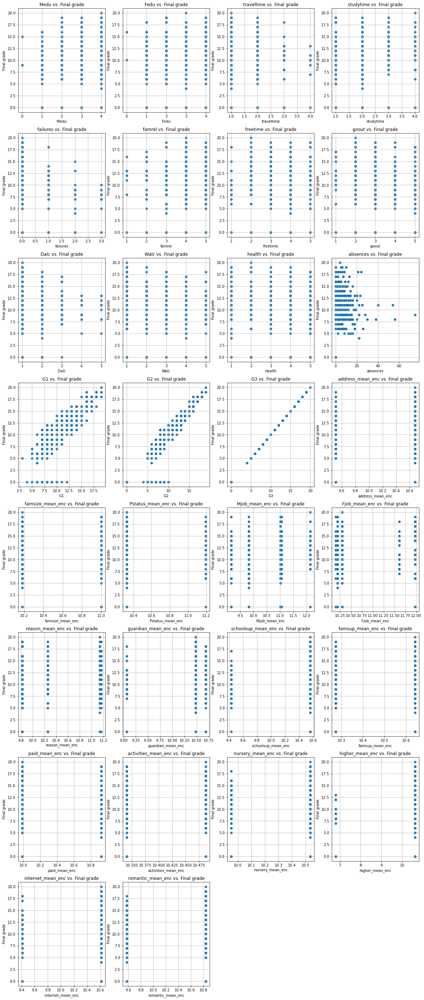

In [16]:
plt.figure(figsize=(20, 50))

for i in range(1, len(df.describe().columns)):
    plt.subplot(8, 4, i)
    title = str(df.describe().columns[i]) + ' vs. Final grade'
    plt.title(title)
    plt.xlabel(df.describe().columns[i])
    plt.ylabel('Final grade')
    plt.grid()
    plt.scatter(df[df.describe().columns[i]], df['G3'])    

In [17]:
df = df[df['G3'] != 0]

x_input = df[features]
x_input

,age,Medu,Fedu,traveltime,studytime,failures,famrel,freetime,goout,Dalc,Walc,health,absences,G1,address_mean_enc,famsize_mean_enc,Pstatus_mean_enc,Mjob_mean_enc,Fjob_mean_enc,reason_mean_enc,guardian_mean_enc,schoolsup_mean_enc,famsup_mean_enc,paid_mean_enc,activities_mean_enc,nursery_mean_enc,higher_mean_enc,internet_mean_enc,romantic_mean_enc
0,18,4,4,2,2,0,4,3,4,1,1,3,6,5,10.674267,10.177936,11.195122,9.152542,11.965517,9.820690,10.483516,9.431373,10.640523,9.985981,10.340206,10.535032,10.608,9.409091,10.836502
1,17,1,1,1,2,0,5,3,3,1,1,3,4,5,10.674267,10.177936,10.324859,9.152542,10.193548,9.820690,10.688889,10.561047,10.272727,9.985981,10.340206,9.950617,10.608,10.617021,10.836502
2,15,1,1,1,2,3,4,3,2,2,3,3,10,7,10.674267,11.000000,10.324859,9.152542,10.193548,11.166667,10.483516,9.431373,10.640523,10.922652,10.340206,10.535032,10.608,10.617021,10.836502
3,15,4,2,1,3,0,3,2,2,1,1,5,2,15,10.674267,10.177936,10.324859,12.147059,10.297297,10.256881,10.483516,10.561047,10.272727,10.922652,10.487562,10.535032,10.608,10.617021,9.575758
4,16,3,3,1,2,0,4,3,2,1,2,5,4,6,10.674267,10.177936,10.324859,9.822695,10.193548,10.256881,10.688889,10.561047,10.272727,10.922652,10.340206,10.535032,10.608,9.409091,10.836502
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
390,20,2,2,1,2,2,5,5,4,4,5,4,11,9,10.674267,11.000000,11.195122,11.019417,10.297297,9.820690,9.062500,10.561047,10.272727,10.922652,10.340206,10.535032,10.608,9.409091,10.836502
391,17,3,1,2,1,0,2,4,5,3,4,2,3,14,10.674267,11.000000,10.324859,11.019417,10.297297,9.820690,10.483516,10.561047,10.640523,9.985981,10.340206,9.950617,10.608,10.617021,10.836502
392,21,1,1,1,1,3,5,5,3,3,3,3,3,10,9.511364,10.177936,10.324859,9.822695,10.193548,9.820690,9.062500,10.561047,10.640523,9.985981,10.340206,9.950617,10.608,9.409091,10.836502
393,18,3,2,3,1,0,4,4,1,3,4,5,0,11,9.511364,11.000000,10.324859,11.019417,10.193548,9.820690,10.483516,10.561047,10.640523,9.985981,10.340206,9.950617,10.608,10.617021,10.836502


                     age  Medu  Fedu  traveltime  studytime  failures  famrel  \
age                  1.0   NaN   NaN         NaN        NaN       NaN     NaN   
Medu                 NaN   1.0   NaN         NaN        NaN       NaN     NaN   
Fedu                 NaN   NaN   1.0         NaN        NaN       NaN     NaN   
traveltime           NaN   NaN   NaN         1.0        NaN       NaN     NaN   
studytime            NaN   NaN   NaN         NaN        1.0       NaN     NaN   
failures             NaN   NaN   NaN         NaN        NaN       1.0     NaN   
famrel               NaN   NaN   NaN         NaN        NaN       NaN     1.0   
freetime             NaN   NaN   NaN         NaN        NaN       NaN     NaN   
goout                NaN   NaN   NaN         NaN        NaN       NaN     NaN   
Dalc                 NaN   NaN   NaN         NaN        NaN       NaN     NaN   
Walc                 NaN   NaN   NaN         NaN        NaN       NaN     NaN   
health               NaN   N

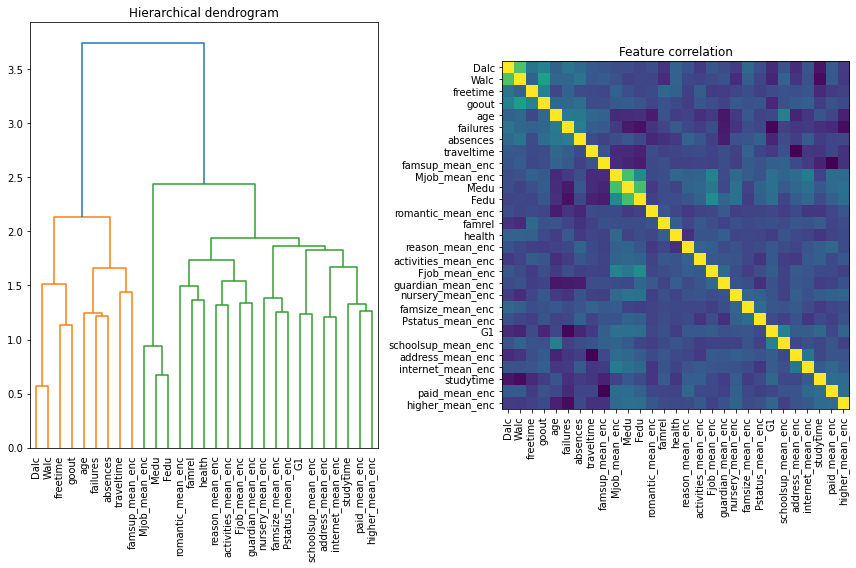

In [18]:
cor_table = x_input.corr()

print(cor_table[cor_table > 0.9])

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 8))
ax1.set_title('Hierarchical dendrogram')
corr = spearmanr(x_input).correlation
corr_linkage = hierarchy.ward(corr)
dendro = hierarchy.dendrogram(corr_linkage, labels=features, ax=ax1, leaf_rotation=90)

dendro_idx = np.arange(0, len(dendro['ivl']))

ax2.imshow(corr[dendro['leaves'], :][:, dendro['leaves']])
ax2.set_title('Feature correlation')
ax2.set_xticks(dendro_idx)
ax2.set_yticks(dendro_idx)
ax2.set_xticklabels(dendro['ivl'], rotation='vertical')
ax2.set_yticklabels(dendro['ivl'])

fig.tight_layout()

In [19]:
# 이부분 추가: G1빼면 데이터분석이 안됨 
# 만약 G1을 빼도 교호작용을 통해서 분석이되면 좋겠지만 여기선 그렇지 않았다 
features = ['G1', 'absences', 'goout', 'age', 'famrel',
            'studytime', 'Medu', 'Walc', 'Mjob_mean_enc', 'freetime',
            'Fedu', 'Fjob_mean_enc']

x_input = df[features]
y_output = df['G3']

x_train, x_test, y_train, y_test = train_test_split(x_input, y_output, random_state=42)

#**4. 데이터 스케일링**

In [20]:
scaler = MinMaxScaler()
x_train_scaled = scaler.fit_transform(x_train)
x_test_scaled = scaler.transform(x_test)

#**5. 모델 생성 및 최적화**

In [21]:
model_name = []
train_perf = []
test_perf = []

Fitting 5 folds for each of 2790 candidates, totalling 13950 fits
Best_estimator: ElasticNet(alpha=0.009000000000000001, l1_ratio=0.9000000000000001,
           max_iter=100000000, random_state=42, tol=3.16)
Best_params: {'alpha': 0.009000000000000001, 'l1_ratio': 0.9000000000000001, 'tol': 3.16}
Best_score: 0.8083460489024212
Train score: 0.7804428063110728
Test  score: 0.7484576272786545


C:\Users\wousi\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:918: UserWarning: One or more of the test scores are non-finite: [0.80667797 0.80667797 0.80745116 ...        nan        nan        nan]
  warnings.warn(


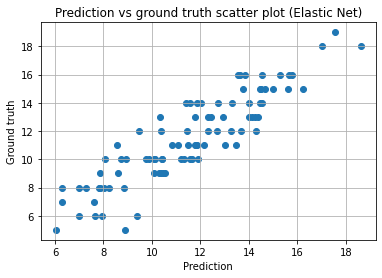

In [22]:
en_model = ElasticNet(max_iter=100000000, random_state=42)

en_param = {'l1_ratio': np.arange(0.70, 1, 0.01),
            'alpha': np.arange(0.001, 0.016, 0.001),
            'tol': [0.316, 1, 3.16, 10, 31.6, 100]}

clf = GridSearchCV(estimator=en_model, param_grid=en_param, n_jobs=-1, verbose=1)
clf.fit(x_train_scaled, y_train)
y_train_pred = clf.predict(x_train_scaled)
y_test_pred = clf.predict(x_test_scaled)

print('Best_estimator:', clf.best_estimator_)
print('Best_params:', clf.best_params_)
print('Best_score:', clf.best_score_)
train_score = r2_score(y_train_pred, y_train)
print('Train score:', train_score)
test_score = r2_score(y_test_pred, y_test)
print('Test  score:', test_score)

model_name.append('Elastic Net')
train_perf.append(train_score)
test_perf.append(test_score)

plt.title('Prediction vs ground truth scatter plot (Elastic Net)')
plt.xlabel('Prediction')
plt.ylabel('Ground truth')
plt.grid()
plt.scatter(y_test_pred, y_test)

In [23]:
en_model = ElasticNet(alpha=0.009, l1_ratio=0.9, tol=3.16, max_iter=100000000, random_state=42)

Fitting 5 folds for each of 200 candidates, totalling 1000 fits
Best_estimator: RandomForestRegressor(max_depth=6, min_samples_split=8, n_estimators=110,
                      n_jobs=-1, random_state=42)
Best_params: {'max_depth': 6, 'min_samples_split': 8, 'n_estimators': 110}
Best_score: 0.809597681927114
Train score: 0.8982988138805192
Test  score: 0.6615857240025544


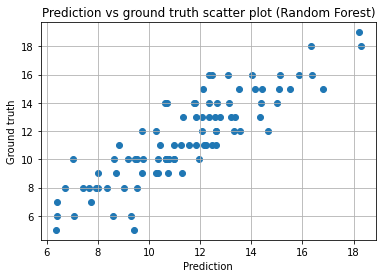

In [24]:
rf_model = RandomForestRegressor(n_jobs=-1, random_state=42)

rf_param = {'n_estimators': range(90, 140, 10),
            'max_depth': range(3, 8, 1),
            'min_samples_split': range(2, 10, 1)}

clf = GridSearchCV(estimator=rf_model, param_grid=rf_param, n_jobs=-1, verbose=1, cv=5)

clf.fit(x_train_scaled, y_train)
y_train_pred = clf.predict(x_train_scaled)
y_test_pred = clf.predict(x_test_scaled)

print('Best_estimator:', clf.best_estimator_)
print('Best_params:', clf.best_params_)
print('Best_score:', clf.best_score_)
train_score = r2_score(y_train_pred, y_train)
print('Train score:', train_score)
test_score = r2_score(y_test_pred, y_test)
print('Test  score:', test_score)

model_name.append('Random Forest')
train_perf.append(train_score)
test_perf.append(test_score)

plt.title('Prediction vs ground truth scatter plot (Random Forest)')
plt.xlabel('Prediction')
plt.ylabel('Ground truth')
plt.grid()
plt.scatter(y_test_pred, y_test)

In [25]:
rf_model = RandomForestRegressor(max_depth=6, min_samples_split=8, n_estimators=110, n_jobs=-1, random_state=42)

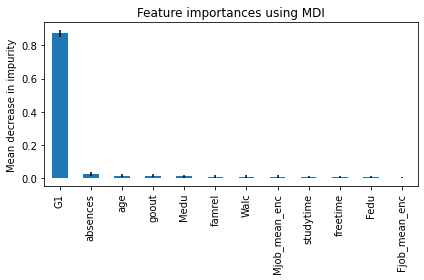

In [26]:
rf_model.fit(x_train_scaled, y_train)

feature_names = ['feature {i}' for i in range(x_train_scaled.shape[1])]

importances = rf_model.feature_importances_
std = np.std([tree.feature_importances_ for tree in rf_model.estimators_], axis=0)

forest_importances = pd.Series(importances, index=features)
forest_importances = forest_importances.sort_values(ascending=False)

fig, ax = plt.subplots()
forest_importances.plot.bar(yerr=std, ax=ax)
ax.set_title("Feature importances using MDI")
ax.set_ylabel("Mean decrease in impurity")
# ax.set_ylim(0, 0.05)
fig.tight_layout()

Index(['Fjob_mean_enc', 'Fedu', 'freetime', 'Mjob_mean_enc', 'Medu', 'Walc',
       'studytime', 'famrel', 'age', 'goout', 'absences', 'G1'],
      dtype='object')
[[0.00243772 0.00747817 0.00872839 ... 0.02354234 0.0340892  1.44664762]
 [0.00471614 0.0063939  0.00708553 ... 0.01467024 0.03293317 1.56382551]
 [0.00583772 0.00628238 0.0075397  ... 0.01723543 0.03683995 1.58411999]
 ...
 [0.00306746 0.00680108 0.00546976 ... 0.01485421 0.0369812  1.59336052]
 [0.00439624 0.00664298 0.00791953 ... 0.03274799 0.03050368 1.63742274]
 [0.00591074 0.00762931 0.00539629 ... 0.02852984 0.03988525 1.65293361]]


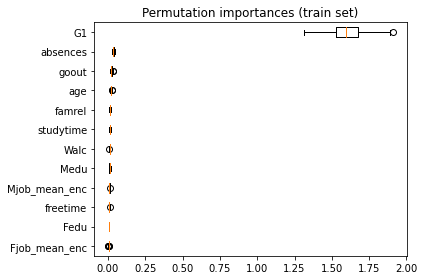

In [27]:
# 피쳐에 랜덤하게 숫자를 넣어서 피쳐가 전체에 미치는 영향력을 본다 
result = permutation_importance(rf_model, x_train_scaled, y_train, n_repeats=200, n_jobs=-1, random_state=42)
sorted_idx = result.importances_mean.argsort()

fig, ax = plt.subplots()
ax.boxplot(result.importances[sorted_idx].T, vert=False, labels=x_train.columns[sorted_idx])

print(x_train.columns[sorted_idx])
print(result.importances[sorted_idx].T)

ax.set_title("Permutation importances (train set)")
fig.tight_layout()

Train score: 0.7620004407947304
Test  score: 0.7322977605308391


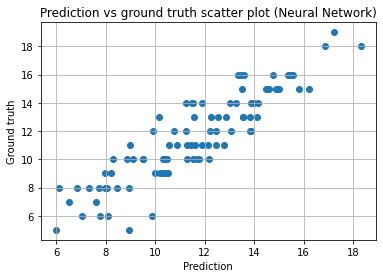

In [28]:
# MLP
mlp_model = MLPRegressor(learning_rate='adaptive', max_iter=2000000, verbose=0,
                         early_stopping=True, random_state=42)

# mlp_param = {'hidden_layer_sizes': [x for x in itertools.product((range(7, 32)), repeat=2)],
#              'alpha': loguniform(1e-5, 1e-4)}

# rand_clf = RandomizedSearchCV(estimator=mlp_model, param_distributions=mlp_param, n_iter=5, n_jobs=-1,
#                               cv=3, verbose=2, random_state=42)

rand_clf = MLPRegressor(hidden_layer_sizes=(31, 7), alpha=2e-5, learning_rate='adaptive',
                        max_iter=2000000, verbose=0, early_stopping=True, random_state=42)

rand_clf.fit(x_train_scaled, y_train)

y_train_pred = rand_clf.predict(x_train_scaled)
y_test_pred = rand_clf.predict(x_test_scaled)

# print('Best_estimator:', rand_clf.best_estimator_)
# print('Best_params:', rand_clf.best_params_)
# print('Best_score:', rand_clf.best_score_)
train_score = r2_score(y_train_pred, y_train)
print('Train score:', train_score)
test_score = r2_score(y_test_pred, y_test)
print('Test  score:', test_score)

model_name.append('Neural Network')
train_perf.append(train_score)
test_perf.append(test_score)
plt.title('Prediction vs ground truth scatter plot (Neural Network)')
plt.xlabel('Prediction')
plt.ylabel('Ground truth')
plt.grid()
plt.scatter(y_test_pred, y_test)

In [29]:
mlp_model = MLPRegressor(hidden_layer_sizes=(31, 7), alpha=2e-5, learning_rate='adaptive',
                         max_iter=2000000, verbose=0, early_stopping=True, random_state=42)

Fitting 5 folds for each of 2100 candidates, totalling 10500 fits
Best_estimator: XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, enable_categorical=False,
             gamma=0, gpu_id=-1, importance_type=None,
             interaction_constraints='', learning_rate=0.300000012,
             max_delta_step=0, max_depth=2, min_child_weight=1, missing=nan,
             monotone_constraints='()', n_estimators=40, n_jobs=-1,
             num_parallel_tree=1, predictor='auto', random_state=42,
             reg_alpha=3.16, reg_lambda=0.01, scale_pos_weight=1, subsample=1,
             tree_method='exact', validate_parameters=1, verbosity=None)
Best_params: {'max_depth': 2, 'n_estimators': 40, 'reg_alpha': 3.16, 'reg_lambda': 0.01}
Best_score: 0.7979233924388458
Train score: 0.853997429187053
Test  score: 0.747307562327008


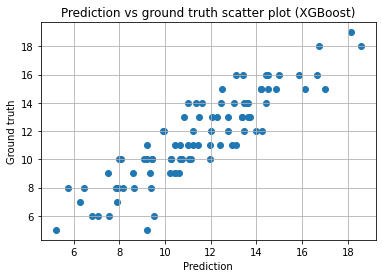

In [30]:
xgb_model = XGBRegressor(n_jobs=-1, random_state=42)

xgb_param = {'n_estimators': range(40, 80, 2),
             'max_depth': range(2, 5, 1),
             'reg_alpha': [1e-2, 3.16e-2, 1e-1, 3.16e-1, 1, 3.16, 10],
             'reg_lambda': [1e-3, 3.16e-3, 1e-2, 3.16e-2, 1e-1]}

xgb_clf = GridSearchCV(estimator=xgb_model, param_grid=xgb_param, n_jobs=-1, verbose=2, cv=5)

xgb_clf.fit(x_train_scaled, y_train)
y_train_pred = xgb_clf.predict(x_train_scaled)
y_test_pred = xgb_clf.predict(x_test_scaled)

print('Best_estimator:', xgb_clf.best_estimator_)
print('Best_params:', xgb_clf.best_params_)
print('Best_score:', xgb_clf.best_score_)
train_score = r2_score(y_train_pred, y_train)
print('Train score:', train_score)
test_score = r2_score(y_test_pred, y_test)
print('Test  score:', test_score)

model_name.append('XGBoost')
train_perf.append(train_score)
test_perf.append(test_score)

plt.title('Prediction vs ground truth scatter plot (XGBoost)')
plt.xlabel('Prediction')
plt.ylabel('Ground truth')
plt.grid()
plt.scatter(y_test_pred, y_test)

In [31]:
xgb_model = XGBRegressor(max_depth=2, n_estimators=48, reg_alpha=1, reg_lambda=0.0316, n_jobs=-1, random_state=42)

Fitting 5 folds for each of 30 candidates, totalling 150 fits
Best_estimator: SVR(C=10000.0, gamma=0.00316)
Best_params: {'C': 10000.0, 'gamma': 0.00316}
Best_score: 0.8024702732804775
Train score: 0.8034234792726743
Test  score: 0.7586133333736278


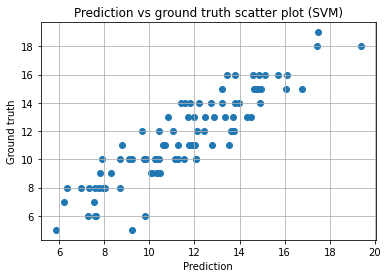

In [32]:
svr_model = SVR()

svr_param = {'C': [1e5, 3.16e5, 1e4, 3.16e4, 1e5],
             'gamma': [1e-4, 3.16e-4, 1e-3, 3.16e-3, 1e-2, 3.16e-2]}

svr_clf = GridSearchCV(estimator=svr_model, param_grid=svr_param, n_jobs=-1, verbose=3)

svr_clf.fit(x_train_scaled, y_train)
y_train_pred = svr_clf.predict(x_train_scaled)
y_test_pred = svr_clf.predict(x_test_scaled)

print('Best_estimator:', svr_clf.best_estimator_)
print('Best_params:', svr_clf.best_params_)
print('Best_score:', svr_clf.best_score_)
train_score = r2_score(y_train_pred, y_train)
print('Train score:', train_score)
test_score = r2_score(y_test_pred, y_test)
print('Test  score:', test_score)

model_name.append('SVM')
train_perf.append(train_score)
test_perf.append(test_score)

plt.title('Prediction vs ground truth scatter plot (SVM)')
plt.xlabel('Prediction')
plt.ylabel('Ground truth')
plt.grid()
plt.scatter(y_test_pred, y_test)

In [33]:
svr_model = SVR(C=10000, gamma=0.00316)

Fitting 5 folds for each of 40 candidates, totalling 200 fits
Best_estimator: KNeighborsRegressor(leaf_size=1, n_jobs=-1, n_neighbors=4, weights='distance')
Best_params: {'leaf_size': 1, 'n_neighbors': 4, 'weights': 'distance'}
Best_score: 0.4407902357017884
Train score: 1.0
Test  score: -0.26585052354944616


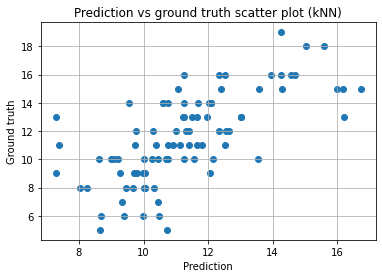

In [34]:
knn_model = KNeighborsRegressor(n_jobs=-1)

knn_param = {'n_neighbors': range(1, 6, 1),
             'weights': ['uniform', 'distance'],
             'leaf_size': range(1, 5, 1)}

knn_clf = GridSearchCV(estimator=knn_model, param_grid=knn_param, n_jobs=-1, verbose=3)

knn_clf.fit(x_train_scaled, y_train)
y_train_pred = knn_clf.predict(x_train_scaled)
y_test_pred = knn_clf.predict(x_test_scaled)

print('Best_estimator:', knn_clf.best_estimator_)
print('Best_params:', knn_clf.best_params_)
print('Best_score:', knn_clf.best_score_)
print('Train score:', r2_score(y_train_pred, y_train))
print('Test  score:', r2_score(y_test_pred, y_test))

plt.title('Prediction vs ground truth scatter plot (kNN)')
plt.xlabel('Prediction')
plt.ylabel('Ground truth')
plt.grid()
plt.scatter(y_test_pred, y_test)

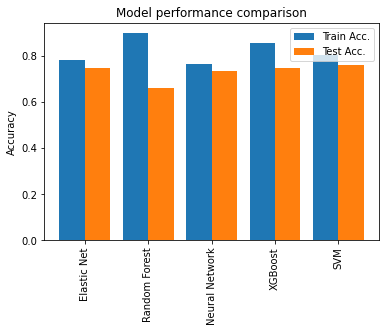

In [35]:
plt.title('Model performance comparison')
plt.xticks(rotation=90)
plt.ylabel('Accuracy')

x = np.arange(len(model_name))
plt.xticks(x, model_name)
plt.bar(x - 0.2, train_perf, width=0.4, label='Train Acc.')
plt.bar(x + 0.2, test_perf, width=0.4, label='Test Acc.')
plt.legend()

#**6. 모델 앙상블**

In [36]:
ensemble_list = [('en', en_model),
                 ('svm', svr_model),
                 ('mlp', mlp_model),
                 ('xgb', xgb_model),
                 ('rf', rf_model)]

voting_est = []

1 Ensemble train score: 0.7804428063110728
1 Ensemble test  score: 0.7484576272786545
2 Ensemble train score: 0.7949827670476884
2 Ensemble test  score: 0.7557057189925874
3 Ensemble train score: 0.7865612991854093
3 Ensemble test  score: 0.7500627376423108
4 Ensemble train score: 0.8181277478156992
4 Ensemble test  score: 0.7512518571965148
5 Ensemble train score: 0.8400755471248784
5 Ensemble test  score: 0.7399111039492563


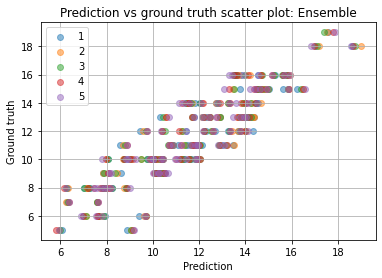

In [37]:
for idx, target_model in enumerate(ensemble_list):
    voting_est.append(target_model)

    voting_clf = VotingRegressor(estimators=voting_est, n_jobs=-1)
    voting_clf.fit(x_train_scaled, y_train)
    y_train_pred = voting_clf.predict(x_train_scaled)
    y_test_pred = voting_clf.predict(x_test_scaled)
    print(idx + 1, 'Ensemble train score:', r2_score(y_train_pred, y_train))
    print(idx + 1, 'Ensemble test  score:', r2_score(y_test_pred, y_test))

    plt.scatter(y_test_pred, y_test, label=str(idx + 1), alpha=0.5)
    title = 'Prediction vs ground truth scatter plot: Ensemble'
    plt.title(title)
    plt.xlabel('Prediction')
    plt.ylabel('Ground truth')
    plt.grid()
    plt.legend()

In [38]:
voting_clf = VotingRegressor(estimators=[('en', en_model), ('svm', svr_model), ('mlp', mlp_model)],
                             n_jobs=-1)

In [39]:
x_total = np.concatenate((x_train, x_test), axis=0)
y_total = np.concatenate((y_train, y_test), axis=0)

x_total_scaled = scaler.transform(x_total)

voting_clf.fit(x_total_scaled, y_total)

VotingRegressor(estimators=[('en',
                             ElasticNet(alpha=0.009, l1_ratio=0.9,
                                        max_iter=100000000, random_state=42,
                                        tol=3.16)),
                            ('svm', SVR(C=10000, gamma=0.00316)),
                            ('mlp',
                             MLPRegressor(alpha=2e-05, early_stopping=True,
                                          hidden_layer_sizes=(31, 7),
                                          learning_rate='adaptive',
                                          max_iter=2000000, random_state=42,
                                          verbose=0))],
                n_jobs=-1)

#**7. 특성(피쳐) 중요도 분석**

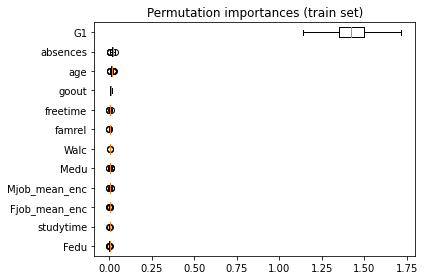

In [40]:
result = permutation_importance(voting_clf, x_train_scaled, y_train, n_repeats=500, n_jobs=-1, random_state=42)
sorted_idx = result.importances_mean.argsort()

fig, ax = plt.subplots()
ax.boxplot(result.importances[sorted_idx].T, vert=False, labels=x_train.columns[sorted_idx])
ax.set_title("Permutation importances (train set)")
fig.tight_layout()

In [41]:
features

['G1',
 'absences',
 'goout',
 'age',
 'famrel',
 'studytime',
 'Medu',
 'Walc',
 'Mjob_mean_enc',
 'freetime',
 'Fedu',
 'Fjob_mean_enc']

#**8. 유전 알고리즘 적용**

#**Task 1. 최대값 탐색**

In [42]:
# [GA 최대값 탐색]
# 1차 시험에서 평균점(20점중 11점)을 받은 학생이 공부를 아주 열심히 했을 경우 (studytime=4) 달성 가능한 최대 등급은?

In [43]:
# 0: 'G1',
# 1: 'absences',
# 2: 'goout',
# 3: 'age',
# 4: 'famrel',
# 5: 'studytime',
# 6: 'Medu',
# 7: 'Walc',
# 8: 'Mjob_mean_enc',
# 9: 'freetime',
# 10: 'Fedu',
# 11: 'Fjob_mean_enc'


def input_conversion(x_input):
    conversion = [int(x_input[0]),
                  int(x_input[1]),
                  int(x_input[2]),
                  int(x_input[3]),
                  int(x_input[4]),
                  int(x_input[5]),
                  int(x_input[6]),
                  int(x_input[7]),
                  Mjob_encode.iloc[int(x_input[8])], # enc
                  int(x_input[9]),
                  int(x_input[10]),
                  Fjob_encode.iloc[int(x_input[11])]] # enc

    return conversion

In [44]:
# 0: 'G1',
# 1: 'absences',
# 2: 'goout',
# 3: 'age',
# 4: 'famrel',
# 5: 'studytime',
# 6: 'Medu',
# 7: 'Walc',
# 8: 'Mjob_mean_enc',
# 9: 'freetime',
# 10: 'Fedu',
# 11: 'Fjob_mean_enc'

# varbound = np.array([[df['G1'].min(), df['G1'].max()],
#                      [df['absences'].min(), df['absences'].max()],
#                      [df['goout'].min(), df['goout'].max()],
#                      [df['age'].min(), df['age'].max()],
#                      [df['famrel'].min(), df['famrel'].max()],                     
#                      [df['studytime'].min(), df['studytime'].max()],
#                      [df['Medu'].min(), df['Medu'].max()],
#                      [df['Walc'].min(), df['Walc'].max()],
#                      [0, len(Mjob_encode) - 1],
#                      [df['freetime'].min(), df['freetime'].max()],
#                      [df['Fedu'].min(), df['Fedu'].max()],                     
#                      [0, len(Fjob_encode) - 1]])

varbound = np.array([[11, 11],
                     [df['absences'].min(), df['absences'].max()],
                     [df['goout'].min(), df['goout'].max()],
                     [df['age'].min(), df['age'].max()],
                     [df['famrel'].min(), df['famrel'].max()],                     
                     [4, 4],
                     [df['Medu'].min(), df['Medu'].max()],
                     [df['Walc'].min(), df['Walc'].max()],
                     [0, len(Mjob_encode) - 1],
                     [df['freetime'].min(), df['freetime'].max()],
                     [df['Fedu'].min(), df['Fedu'].max()],                     
                     [0, len(Fjob_encode) - 1]])

In [45]:
def object_function_t1(x_input, target_model=voting_clf):
    input_converted = input_conversion(x_input)
    input_converted = np.array(input_converted).reshape(1, -1)

    input_scaled = scaler.transform(input_converted)
    prediction = target_model.predict(input_scaled)

    # target = 20.0
    # print('Predicted views:', int(prediction), 'Difference from target:', int(prediction - target))
    print('Predicted grade:', prediction[0])

    return pow(-prediction[0], 3)

In [46]:
algorithm_param = {'max_num_iteration': 500,
                   'population_size': 200,
                   'mutation_probability': 0.2,
                   'elit_ratio': 0.01,
                   'crossover_probability': 0.5,
                   'parents_portion': 0.3,
                   'crossover_type': 'uniform',
                   'max_iteration_without_improv': None}

Predicted grade: 9.177256643779758
Predicted grade: 10.197948086846434
Predicted grade: 9.449684376195139
Predicted grade: 10.136843428894467
Predicted grade: 9.54232612909726
Predicted grade: 9.934307270166967
Predicted grade: 10.50798878221792
Predicted grade: 8.579408058525027
Predicted grade: 10.734166466400486
Predicted grade: 9.061412365383624
Predicted grade: 10.61689846298673
Predicted grade: 9.478763663666031
Predicted grade: 9.772496710177288
Predicted grade: 8.97733412161829
Predicted grade: 10.766130397475612
Predicted grade: 9.817145148679382
Predicted grade: 8.40969712451056
Predicted grade: 10.886168504226648
Predicted grade: 10.004199626467086
Predicted grade: 9.588000168182024
Predicted grade: 10.45766461910884
Predicted grade: 8.907010734006322
Predicted grade: 9.547234245632488
Predicted grade: 10.841009254166735
Predicted grade: 10.007124787634451
Predicted grade: 9.055369814142027
Predicted grade: 8.78393463288507
Predicted grade: 10.800781077335989
Predicted grade

Predicted grade: 9.095322162100068
Predicted grade: 9.4272559177223
Predicted grade: 9.095013041360923
Predicted grade: 11.029132252774117
Predicted grade: 9.501093449425834
Predicted grade: 10.728381127135018
Predicted grade: 11.617041171955114
Predicted grade: 9.265107728285283
Predicted grade: 10.54315843437755
Predicted grade: 10.937226204424912
Predicted grade: 9.531511935243628
Predicted grade: 9.005097795471812
Predicted grade: 10.81156990456274
Predicted grade: 11.012556436810966
Predicted grade: 10.858825682849549
Predicted grade: 9.326894698737545
Predicted grade: 9.821209664135267
Predicted grade: 10.611252231366015
Predicted grade: 9.971548285493855
Predicted grade: 9.171332885059329
Predicted grade: 11.221750032175697
Predicted grade: 11.163919881731276
Predicted grade: 11.977971763829288
Predicted grade: 9.791118592469715
Predicted grade: 10.5631500475228
Predicted grade: 10.143950058284203
Predicted grade: 10.845797151956427
Predicted grade: 10.993386888598527
Predicted 

Predicted grade: 10.146797890601933
Predicted grade: 11.820750966946372
Predicted grade: 10.038411368589598
Predicted grade: 12.204423752024477
Predicted grade: 9.63990085099615
Predicted grade: 12.571164025934843
Predicted grade: 10.918267801708987
Predicted grade: 10.57456798483807
Predicted grade: 10.159829071241617
Predicted grade: 10.083410204108338
Predicted grade: 10.284699791921048
Predicted grade: 11.264889869970768
Predicted grade: 9.946036247245905
Predicted grade: 11.446355702012236
Predicted grade: 10.817794786654277
Predicted grade: 11.782357079946967
Predicted grade: 11.257838474110093
Predicted grade: 10.879195686005263
Predicted grade: 11.317186133033259
Predicted grade: 10.51195313052598
Predicted grade: 10.915834807025691
Predicted grade: 10.390365259810272
Predicted grade: 10.56064327598512
Predicted grade: 11.48749858510404
Predicted grade: 11.691218996937176
Predicted grade: 12.136238391321621
Predicted grade: 11.911537116068425
Predicted grade: 11.050324827174263

Predicted grade: 9.876031536165655
Predicted grade: 10.157110545420688
Predicted grade: 10.7264656493694
Predicted grade: 12.169648313055129
Predicted grade: 11.360938799773942
Predicted grade: 12.4390553256013
Predicted grade: 11.465193044543943
Predicted grade: 12.749771750238736
Predicted grade: 11.47108437083734
Predicted grade: 11.856995607276803
Predicted grade: 11.347644945486834
Predicted grade: 12.446326330934587
Predicted grade: 10.72766137554475
Predicted grade: 12.134209521328776
Predicted grade: 12.82065552401165
Predicted grade: 10.7005463908786
Predicted grade: 12.449859567549018
Predicted grade: 11.968938728403595
Predicted grade: 11.5483284060572
Predicted grade: 11.696961228513809
Predicted grade: 11.346281776048352
Predicted grade: 11.26285542451754
Predicted grade: 12.154759422099838
Predicted grade: 12.292095522562896
Predicted grade: 11.031196314416144
Predicted grade: 11.389770899150166
Predicted grade: 11.64238512733356
Predicted grade: 11.745584013482569
Predic

Predicted grade: 11.565936198521213
Predicted grade: 13.000430307890817
Predicted grade: 11.792601256173135
Predicted grade: 11.807384128970682
Predicted grade: 11.476542119731834
Predicted grade: 12.028370528302062
Predicted grade: 11.825151658092087
Predicted grade: 11.405576438652261
Predicted grade: 11.925493205862457
Predicted grade: 12.166809693849364
Predicted grade: 10.510405763012963
Predicted grade: 12.51734624570557
Predicted grade: 12.568221273287625
Predicted grade: 12.405009374382473
|_________________________________________________ 1.4% GA is running...Predicted grade: 13.044631668893148
Predicted grade: 11.659959146079474
Predicted grade: 12.043552821901585
Predicted grade: 11.724054694416878
Predicted grade: 12.228226004631523
Predicted grade: 10.394407627800726
Predicted grade: 12.047727824563808
Predicted grade: 11.940616553444267
Predicted grade: 10.963112985457194
Predicted grade: 11.982356834642369
Predicted grade: 11.600732154355265
Predicted grade: 12.056278667

Predicted grade: 11.199793150143456
Predicted grade: 12.610616491608248
Predicted grade: 11.885830109376762
Predicted grade: 11.689115672640128
Predicted grade: 11.677832131885012
Predicted grade: 12.725281960492405
Predicted grade: 11.51157130646821
Predicted grade: 11.39732987737527
Predicted grade: 10.671966997113964
Predicted grade: 10.737236435486118
Predicted grade: 11.941192357074916
Predicted grade: 11.548158778369519
Predicted grade: 11.256057125498478
Predicted grade: 12.175890570539215
Predicted grade: 10.670677816715875
Predicted grade: 12.614198191923826
Predicted grade: 12.671562594694043
Predicted grade: 12.178336230305305
Predicted grade: 11.010005025756394
Predicted grade: 11.591074419135234
Predicted grade: 10.691800493971341
Predicted grade: 12.14028583913398
Predicted grade: 11.332878301376873
Predicted grade: 12.851330788661363
Predicted grade: 11.841022297329141
Predicted grade: 12.191932213793159
Predicted grade: 12.39154932915603
Predicted grade: 10.864609006618

Predicted grade: 12.341789755813684
Predicted grade: 11.658442612001457
Predicted grade: 11.576411501651265
Predicted grade: 12.827130189153962
Predicted grade: 11.125326715020277
Predicted grade: 10.151200698706369
Predicted grade: 11.25754291886993
Predicted grade: 11.952584588647724
Predicted grade: 12.606748857722636
Predicted grade: 12.775847509384965
Predicted grade: 13.011132438847454
Predicted grade: 10.250413809103636
Predicted grade: 11.928161146637597
Predicted grade: 11.275213473582212
Predicted grade: 11.893777090160794
Predicted grade: 11.185356934258108
Predicted grade: 12.04841760017751
Predicted grade: 11.566948453226203
Predicted grade: 10.877020048041608
Predicted grade: 12.946006249215793
Predicted grade: 12.557266349372592
Predicted grade: 12.066304270546164
Predicted grade: 12.628648919693973
Predicted grade: 12.416907147415747
Predicted grade: 12.850355211009488
Predicted grade: 12.775933404552129
Predicted grade: 10.573855666056993
Predicted grade: 12.6300785295

Predicted grade: 12.0528678526048
Predicted grade: 11.075652344578025
Predicted grade: 11.519072519568331
Predicted grade: 12.340062663096873
Predicted grade: 11.912575590504098
Predicted grade: 10.744005035544427
Predicted grade: 10.839524205537366
Predicted grade: 11.369054636824549
Predicted grade: 11.608641623867117
Predicted grade: 12.296594252338629
Predicted grade: 11.962726086545212
Predicted grade: 10.137658483465135
Predicted grade: 12.15166099103918
Predicted grade: 12.41002013275
Predicted grade: 13.032459097044594
|_________________________________________________ 2.4% GA is running...Predicted grade: 11.786330095171742
Predicted grade: 12.753036250270492
Predicted grade: 12.144243394503372
Predicted grade: 11.330433265059307
Predicted grade: 12.076090938747626
Predicted grade: 12.876301732446173
Predicted grade: 11.639892885812825
Predicted grade: 12.698604939092846
Predicted grade: 11.297999136345796
Predicted grade: 13.026852651729095
Predicted grade: 11.40836033284719


Predicted grade: 11.27144722171638
Predicted grade: 12.245631824841078
Predicted grade: 9.903760677495383
Predicted grade: 11.243355475855594
Predicted grade: 11.617846374426966
Predicted grade: 12.171156027049955
Predicted grade: 11.451340061939241
Predicted grade: 12.003917459520457
Predicted grade: 11.401571940223418
Predicted grade: 10.65520771968911
Predicted grade: 11.424182414287861
Predicted grade: 12.061108069803955
Predicted grade: 12.20090027782111
Predicted grade: 9.970360253181513
Predicted grade: 12.507382681484126
Predicted grade: 10.724309994193817
Predicted grade: 12.361220489523404
Predicted grade: 11.771271977530283
Predicted grade: 11.861869278032964
Predicted grade: 11.010249857776836
Predicted grade: 12.211719109038484
Predicted grade: 9.849078562559397
Predicted grade: 12.338002733312807
Predicted grade: 11.207952007871592
Predicted grade: 12.154841486993229
Predicted grade: 10.526876360185986
Predicted grade: 12.27247857824448
Predicted grade: 11.805833115136432

Predicted grade: 11.148671845642104
Predicted grade: 10.958330119646845
Predicted grade: 9.601457305039105
Predicted grade: 13.186860422012353
Predicted grade: 11.766512863378557
Predicted grade: 12.003047167875387
Predicted grade: 12.637892350872006
Predicted grade: 11.225166639533
Predicted grade: 10.366376868072454
Predicted grade: 11.050374709677937
Predicted grade: 9.86817602688001
Predicted grade: 12.35170765922824
Predicted grade: 11.639784022915242
Predicted grade: 12.152083103409964
Predicted grade: 12.160505404756535
Predicted grade: 9.751619501807165
Predicted grade: 12.54123875496611
Predicted grade: 12.193098108272075
Predicted grade: 11.098003071951572
Predicted grade: 12.198929247249533
Predicted grade: 12.964813282615642
Predicted grade: 10.609226659266406
Predicted grade: 11.915064154365416
Predicted grade: 11.982546426900731
Predicted grade: 12.033361638220605
Predicted grade: 11.197755787444342
Predicted grade: 12.5641401762297
Predicted grade: 11.172572476369396
Pre

||________________________________________________ 3.4% GA is running...Predicted grade: 12.411259502355515
Predicted grade: 10.822511501750434
Predicted grade: 11.320313271588821
Predicted grade: 12.541877447640745
Predicted grade: 12.25074183851432
Predicted grade: 12.417432619201625
Predicted grade: 11.500881877475004
Predicted grade: 12.666532163849046
Predicted grade: 10.455482049132511
Predicted grade: 12.497199487835886
Predicted grade: 12.261489676477522
Predicted grade: 8.990991379909408
Predicted grade: 9.576310954663652
Predicted grade: 10.408321942904081
Predicted grade: 9.34115595968858
Predicted grade: 12.378829313483083
Predicted grade: 10.064632109384396
Predicted grade: 9.95181980878227
Predicted grade: 9.355630895163907
Predicted grade: 12.16814846954353
Predicted grade: 12.540220688765203
Predicted grade: 11.847959978536354
Predicted grade: 9.352089113510196
Predicted grade: 12.515768600935289
Predicted grade: 11.749324970410958
Predicted grade: 11.347503702897688
Pr

Predicted grade: 12.179075735876543
Predicted grade: 12.726545207389117
Predicted grade: 10.121483981148652
Predicted grade: 12.225211499672005
Predicted grade: 12.346900900248079
Predicted grade: 10.366504978176591
Predicted grade: 12.41120555303029
Predicted grade: 12.611358713537362
Predicted grade: 11.558487743739045
Predicted grade: 11.092183545442166
Predicted grade: 11.092958489855855
Predicted grade: 11.819728029423024
Predicted grade: 9.656825255839768
Predicted grade: 10.756639083102712
Predicted grade: 11.517352966835132
Predicted grade: 12.061525654613794
Predicted grade: 12.36432948826583
Predicted grade: 11.842299864696209
Predicted grade: 11.222237107143926
Predicted grade: 12.01663814202245
Predicted grade: 12.786828767164437
Predicted grade: 11.918115089681445
Predicted grade: 12.118151075429907
Predicted grade: 12.427032820123307
Predicted grade: 8.686118986043825
Predicted grade: 12.324391240669982
Predicted grade: 12.115547266655861
Predicted grade: 12.0495118561226

Predicted grade: 12.179840230945766
Predicted grade: 11.57184705861147
Predicted grade: 11.771726262532738
Predicted grade: 11.512457541246599
Predicted grade: 12.096443076548786
Predicted grade: 11.312449404694965
Predicted grade: 11.515244342632498
Predicted grade: 10.377513023678757
Predicted grade: 12.153894054621324
Predicted grade: 12.578975235449159
Predicted grade: 11.891326548104919
Predicted grade: 12.708400598417796
Predicted grade: 12.603060247877487
Predicted grade: 12.461559286960076
Predicted grade: 11.513305422871747
Predicted grade: 13.044689222353062
Predicted grade: 13.092725034156402
Predicted grade: 12.817176490727235
Predicted grade: 12.40787513980672
Predicted grade: 11.782573070317383
Predicted grade: 11.686240594510886
Predicted grade: 11.856771709392618
Predicted grade: 11.710472949122185
Predicted grade: 11.015905550534201
Predicted grade: 13.103319083994117
Predicted grade: 9.917995247641835
Predicted grade: 12.124413233196089
Predicted grade: 11.08396072916

Predicted grade: 11.826568561094303
Predicted grade: 12.219915131105497
Predicted grade: 12.20266428405972
Predicted grade: 10.6841528399993
Predicted grade: 11.281809209330575
Predicted grade: 12.248390850000872
Predicted grade: 11.8263231172928
Predicted grade: 11.8222085809811
Predicted grade: 10.052659504866085
||________________________________________________ 4.4% GA is running...Predicted grade: 12.542878624919927
Predicted grade: 11.962876561445697
Predicted grade: 12.676780356755772
Predicted grade: 11.572540720375661
Predicted grade: 12.654205494669263
Predicted grade: 12.149005647655633
Predicted grade: 11.549806343120252
Predicted grade: 12.546458638442635
Predicted grade: 11.0855793859949
Predicted grade: 12.233284036076682
Predicted grade: 11.643669929446853
Predicted grade: 11.833310931433134
Predicted grade: 11.973005810333056
Predicted grade: 11.502465583678953
Predicted grade: 11.400768150771603
Predicted grade: 11.512491123348738
Predicted grade: 10.968050712225141
P

Predicted grade: 12.861402532349716
Predicted grade: 12.566016049242464
Predicted grade: 12.239235352895802
Predicted grade: 12.395444000363165
Predicted grade: 10.128908315081423
Predicted grade: 11.44502330895177
Predicted grade: 10.512830185795115
Predicted grade: 12.490002303910591
Predicted grade: 11.687444546359538
Predicted grade: 12.497387356333343
Predicted grade: 10.024518206780131
Predicted grade: 11.955439378415546
Predicted grade: 12.465543691728724
Predicted grade: 11.579806594890831
Predicted grade: 12.609611238182405
Predicted grade: 11.241723187319812
Predicted grade: 12.428856208393748
Predicted grade: 10.017684882708215
Predicted grade: 12.563197083280741
Predicted grade: 12.555495531918604
Predicted grade: 11.279918666169417
Predicted grade: 11.933239162393898
Predicted grade: 12.15855030019168
Predicted grade: 11.962371121670573
Predicted grade: 11.76699479357716
Predicted grade: 12.770597237733506
Predicted grade: 10.785751871628895
Predicted grade: 10.71804095306

Predicted grade: 11.47757575782979
Predicted grade: 11.713963896505632
Predicted grade: 12.05445021533003
Predicted grade: 12.13122860713622
Predicted grade: 12.602505177602259
Predicted grade: 12.588415362053519
Predicted grade: 11.853429219548289
Predicted grade: 11.510018088506309
Predicted grade: 11.372659817615423
Predicted grade: 12.470107476100518
Predicted grade: 12.564075488382818
Predicted grade: 11.683859746551425
Predicted grade: 10.88962139488151
Predicted grade: 12.045930543529215
Predicted grade: 11.281285385448752
Predicted grade: 12.004327045686443
Predicted grade: 12.283466733661754
Predicted grade: 11.680389784595917
Predicted grade: 12.04835359117826
Predicted grade: 11.994660079433492
Predicted grade: 11.697623671386738
Predicted grade: 12.26325439872307
Predicted grade: 10.893942110682408
Predicted grade: 11.776511490563053
Predicted grade: 12.197003058256575
Predicted grade: 12.497199487835886
Predicted grade: 11.5493813720596
Predicted grade: 9.652334569442772
P

Predicted grade: 12.661803017853154
Predicted grade: 12.256525683122398
Predicted grade: 11.737783943319757
Predicted grade: 11.435170763850161
Predicted grade: 12.261845727212753
Predicted grade: 11.314411166327572
Predicted grade: 12.581610288662938
Predicted grade: 11.261361386721395
Predicted grade: 12.201161583662548
Predicted grade: 12.439141098388243
|||_______________________________________________ 5.4% GA is running...Predicted grade: 11.80715541022743
Predicted grade: 11.828814403996896
Predicted grade: 11.751939790815433
Predicted grade: 12.370736856990552
Predicted grade: 13.032227864553883
Predicted grade: 12.242097914321251
Predicted grade: 11.379488252566881
Predicted grade: 11.269104682050544
Predicted grade: 11.495637161399356
Predicted grade: 11.758353952558359
Predicted grade: 12.907681645551252
Predicted grade: 12.464681524489984
Predicted grade: 12.34750123240056
Predicted grade: 12.761392825491
Predicted grade: 12.08029335718503
Predicted grade: 11.45526440687133

Predicted grade: 12.681018706545254
Predicted grade: 12.022529566895743
Predicted grade: 13.062340700600501
Predicted grade: 12.925686711235718
Predicted grade: 12.463511559166662
Predicted grade: 13.075721276995578
Predicted grade: 10.069161086583215
Predicted grade: 11.426154472853971
Predicted grade: 11.794539918847542
Predicted grade: 11.63921576623333
Predicted grade: 12.240878507804888
Predicted grade: 12.177081609412978
Predicted grade: 11.673201032663593
Predicted grade: 12.461163041123557
Predicted grade: 11.881557652744908
Predicted grade: 10.824910284394655
Predicted grade: 12.29501262952489
Predicted grade: 12.164880206951366
Predicted grade: 12.056986359500984
Predicted grade: 13.277555798167091
Predicted grade: 12.875151630445556
Predicted grade: 11.348976743596907
Predicted grade: 12.68451352639405
Predicted grade: 11.920126398179441
Predicted grade: 12.437490274376472
Predicted grade: 13.087924116758991
Predicted grade: 10.046903816196847
Predicted grade: 10.95193799523

Predicted grade: 12.139764029208598
Predicted grade: 12.201250501256217
Predicted grade: 12.167451883873076
Predicted grade: 12.770562775979846
Predicted grade: 12.962088524047852
Predicted grade: 10.628688846821822
Predicted grade: 11.67504748870593
Predicted grade: 12.033703199506506
Predicted grade: 11.588294755791381
Predicted grade: 8.714620164425012
Predicted grade: 11.367816173093324
Predicted grade: 12.977530809330736
Predicted grade: 12.54705405262684
Predicted grade: 12.87346038729641
Predicted grade: 10.73878802960852
Predicted grade: 11.618031625061668
Predicted grade: 11.263030900080025
Predicted grade: 12.05875849987776
Predicted grade: 10.998856321659682
Predicted grade: 12.653128380369054
Predicted grade: 11.587173129478126
Predicted grade: 12.848410457163283
Predicted grade: 12.791124841526278
Predicted grade: 12.39774720412908
Predicted grade: 12.484433018963365
Predicted grade: 11.980954005138857
Predicted grade: 12.206133601822025
Predicted grade: 10.239726221606833

Predicted grade: 11.65166379476773
Predicted grade: 10.60612378203654
Predicted grade: 10.743465688911243
Predicted grade: 11.455518040386798
Predicted grade: 11.404180075977232
Predicted grade: 11.254353401737509
Predicted grade: 12.394680765164821
Predicted grade: 12.591421913302803
Predicted grade: 12.107193247788118
Predicted grade: 12.473148911398889
Predicted grade: 12.183591567996125
Predicted grade: 12.959347184866175
Predicted grade: 11.792715887915676
Predicted grade: 12.326825465933936
Predicted grade: 12.449198153103694
Predicted grade: 12.848410457163283
Predicted grade: 9.738942585501363
Predicted grade: 12.20270053089841
Predicted grade: 10.983970917480741
Predicted grade: 12.8690464556367
Predicted grade: 11.640336321981025
Predicted grade: 12.390152779950796
|||_______________________________________________ 6.4% GA is running...Predicted grade: 11.945367675186922
Predicted grade: 11.629382416774925
Predicted grade: 12.486287120906995
Predicted grade: 12.32299329103240

Predicted grade: 12.757662812968368
Predicted grade: 11.983466461310272
Predicted grade: 11.230450464484756
Predicted grade: 12.474698587660015
Predicted grade: 12.720110961197838
Predicted grade: 12.762691956722948
Predicted grade: 12.061004365036522
Predicted grade: 12.276085754025367
Predicted grade: 10.938499404749258
Predicted grade: 11.884462585083815
Predicted grade: 11.810657149532076
Predicted grade: 11.330202867760777
Predicted grade: 12.828070232622991
Predicted grade: 12.246156760312521
Predicted grade: 11.827592235594514
Predicted grade: 10.438637287015986
Predicted grade: 13.092861136026505
Predicted grade: 10.839269248478187
Predicted grade: 12.385437595132665
Predicted grade: 12.054977371561625
Predicted grade: 12.351076742023544
Predicted grade: 11.099456059834615
Predicted grade: 12.521357582657673
Predicted grade: 11.177050974412131
Predicted grade: 11.76659702957525
Predicted grade: 11.722959908426281
Predicted grade: 12.824894913791288
Predicted grade: 11.653347783

Predicted grade: 10.830013093211699
Predicted grade: 11.791212804608568
Predicted grade: 11.76443056804917
Predicted grade: 10.920709706793469
Predicted grade: 13.113385121951007
Predicted grade: 12.71279700684039
Predicted grade: 12.213178161087784
Predicted grade: 11.474204508150345
Predicted grade: 12.518366056458683
Predicted grade: 11.822926816128598
Predicted grade: 12.866734566626128
Predicted grade: 11.820246021789648
Predicted grade: 12.005965044982156
Predicted grade: 12.303806416587037
Predicted grade: 11.62347793915196
Predicted grade: 11.79702165105862
Predicted grade: 12.427658852585528
Predicted grade: 12.225283241934399
Predicted grade: 10.991342374954078
Predicted grade: 12.468889203450624
Predicted grade: 12.86692448623802
Predicted grade: 12.790991677330604
Predicted grade: 12.007050847309912
Predicted grade: 12.847810492591643
Predicted grade: 12.79013427692388
Predicted grade: 11.402481178750726
Predicted grade: 11.81280988650556
Predicted grade: 12.482461265765124

Predicted grade: 11.871709121070504
Predicted grade: 9.062699311832747
Predicted grade: 12.554311802085484
Predicted grade: 10.448180890914074
Predicted grade: 11.857388183799662
Predicted grade: 12.15094373570498
Predicted grade: 11.340255751475466
Predicted grade: 13.073997860378164
Predicted grade: 11.855989851390525
Predicted grade: 12.295651094261018
Predicted grade: 12.01553563561864
Predicted grade: 11.78066260605224
Predicted grade: 12.088613093151809
Predicted grade: 12.183746416303174
Predicted grade: 12.548643388099835
Predicted grade: 11.325417517591418
Predicted grade: 13.056531385434822
Predicted grade: 11.945950096082731
Predicted grade: 12.594469950940614
Predicted grade: 10.510603768502675
Predicted grade: 12.852018220369574
Predicted grade: 10.3510175597329
Predicted grade: 11.39783258551394
Predicted grade: 9.956278220066979
Predicted grade: 11.382179753708208
Predicted grade: 11.634092886210686
Predicted grade: 12.126733812489235
Predicted grade: 12.799253679601597


Predicted grade: 11.783654143878232
Predicted grade: 12.663390029535359
Predicted grade: 12.364409805488975
Predicted grade: 9.90435128932369
Predicted grade: 10.746049751742916
Predicted grade: 10.597805554546415
Predicted grade: 12.483994765013506
Predicted grade: 11.878770933981729
Predicted grade: 12.695174202078627
Predicted grade: 11.197100697829562
Predicted grade: 12.259947770396273
Predicted grade: 12.005984775151234
Predicted grade: 12.942286290734698
Predicted grade: 12.962054591800815
Predicted grade: 12.21797191000494
Predicted grade: 12.000555836334234
Predicted grade: 12.59593072047702
Predicted grade: 12.903496678579295
Predicted grade: 12.262846017841788
Predicted grade: 12.87715698889262
Predicted grade: 12.69437521212316
Predicted grade: 10.837734875323584
Predicted grade: 10.837408626324454
Predicted grade: 11.918351449793876
Predicted grade: 12.923345553408355
Predicted grade: 10.29018538389655
Predicted grade: 10.956599594479997
Predicted grade: 10.55434145610237


Predicted grade: 12.515875056027093
Predicted grade: 11.633595210086911
Predicted grade: 12.149730544494444
Predicted grade: 13.242367684750038
Predicted grade: 12.710301331878478
Predicted grade: 9.61623950850646
Predicted grade: 11.792477602294502
Predicted grade: 11.329331592691885
Predicted grade: 11.050835428318441
Predicted grade: 12.531259298650033
Predicted grade: 12.00269728622107
Predicted grade: 11.352875545220073
Predicted grade: 11.979874793418645
Predicted grade: 10.578381734540528
Predicted grade: 10.851410241804736
Predicted grade: 11.31970261034221
Predicted grade: 11.578669775467583
Predicted grade: 12.646642087714449
Predicted grade: 11.104061611037409
Predicted grade: 11.84391122179243
Predicted grade: 11.49254855854808
Predicted grade: 9.426798525934954
Predicted grade: 11.924671656478345
Predicted grade: 11.446449882712523
Predicted grade: 12.950664913247019
Predicted grade: 13.086962301138861
Predicted grade: 11.881102906521889
Predicted grade: 10.945123748813335

Predicted grade: 10.86341601638115
Predicted grade: 11.39783258551394
Predicted grade: 11.96832447958329
Predicted grade: 12.27657550350074
Predicted grade: 12.384191658479644
Predicted grade: 10.976019341517253
Predicted grade: 12.805428663453823
Predicted grade: 12.465798923188643
Predicted grade: 11.953838488771401
Predicted grade: 10.510418371309633
Predicted grade: 12.019958301111656
Predicted grade: 11.538085417204435
Predicted grade: 12.35605625282178
Predicted grade: 11.794298237874507
Predicted grade: 11.41411355384121
Predicted grade: 11.912870489360367
Predicted grade: 11.374025230424635
Predicted grade: 11.424256320087451
Predicted grade: 12.924063248648741
Predicted grade: 12.38802284350763
Predicted grade: 12.505999639560079
Predicted grade: 12.713682899351047
Predicted grade: 10.60380936933531
Predicted grade: 13.306796329968
Predicted grade: 12.88330878758312
||||______________________________________________ 8.4% GA is running...Predicted grade: 12.721525921269086
Pred

Predicted grade: 11.576066175443083
Predicted grade: 12.164525457805189
Predicted grade: 12.0667708555697
Predicted grade: 12.644994188461162
Predicted grade: 10.720688271089713
Predicted grade: 12.674585227666611
Predicted grade: 11.619546066949981
Predicted grade: 11.779903716351475
Predicted grade: 12.222834276513877
Predicted grade: 12.52711309211901
Predicted grade: 11.854243454252376
Predicted grade: 11.5516420368159
Predicted grade: 10.154631676679486
Predicted grade: 12.747751614088541
Predicted grade: 11.579216223161298
Predicted grade: 11.548272113654614
Predicted grade: 12.043098018497737
Predicted grade: 9.411980431582641
Predicted grade: 12.639150067620255
Predicted grade: 12.981446742086362
Predicted grade: 12.393390990514405
Predicted grade: 12.358548577519677
Predicted grade: 11.919990908501838
Predicted grade: 13.186860422012353
Predicted grade: 12.847580249723338
Predicted grade: 9.210555179790918
Predicted grade: 12.313576191016068
Predicted grade: 12.426452732918294

Predicted grade: 12.56563900807071
Predicted grade: 11.004504798968258
Predicted grade: 12.521033137409113
Predicted grade: 11.413964737755355
Predicted grade: 10.324752429851166
Predicted grade: 12.355982184537028
Predicted grade: 11.93940901239126
Predicted grade: 11.721087467311245
Predicted grade: 11.595101119989204
Predicted grade: 11.57229270927616
Predicted grade: 11.761182761692728
Predicted grade: 12.634984272644047
Predicted grade: 12.7323149559563
Predicted grade: 12.009848198174899
Predicted grade: 11.569241087150976
Predicted grade: 12.234120791284115
Predicted grade: 11.564080429717448
Predicted grade: 11.79422538465124
Predicted grade: 10.879708033522896
Predicted grade: 11.916586429047308
Predicted grade: 12.670385956875966
Predicted grade: 10.857994514149302
Predicted grade: 12.692260773259726
Predicted grade: 10.98054666545176
Predicted grade: 11.595114762942094
Predicted grade: 11.200272570597315
Predicted grade: 11.970549588543717
Predicted grade: 11.458641669285717

Predicted grade: 12.685909264143902
Predicted grade: 11.847503830305975
Predicted grade: 12.088057560611778
Predicted grade: 12.299004381571224
Predicted grade: 11.569241087150976
Predicted grade: 11.746015552737461
Predicted grade: 11.03925825960151
Predicted grade: 11.011632717019914
Predicted grade: 11.386852942230185
Predicted grade: 12.1340291351114
Predicted grade: 10.996521765398121
Predicted grade: 11.080785859722491
Predicted grade: 9.295230808259136
Predicted grade: 12.511874632749562
Predicted grade: 12.180670586479772
Predicted grade: 10.962220269997227
Predicted grade: 11.125250912541292
Predicted grade: 11.816991750931576
Predicted grade: 12.229841642958375
Predicted grade: 10.936162010028914
Predicted grade: 12.285893791024876
Predicted grade: 11.048858959298093
Predicted grade: 11.24579345631651
Predicted grade: 12.112148990485112
Predicted grade: 10.925936206476534
Predicted grade: 10.355165546968015
Predicted grade: 11.360386257834682
Predicted grade: 11.9054933698001

Predicted grade: 11.840549072478717
Predicted grade: 11.517673357747114
Predicted grade: 11.6872939018008
Predicted grade: 12.254872260982012
Predicted grade: 12.326997483766055
Predicted grade: 13.058013301062948
Predicted grade: 11.435250413286818
Predicted grade: 12.17074873710636
Predicted grade: 11.657217861349556
Predicted grade: 11.764966838412832
Predicted grade: 12.564050879370383
Predicted grade: 11.948807321919984
Predicted grade: 11.519317179142284
Predicted grade: 12.528605906141257
Predicted grade: 12.50838373058069
Predicted grade: 12.630858421306103
Predicted grade: 12.42263719433935
Predicted grade: 12.414999985056058
Predicted grade: 12.510210842065073
Predicted grade: 10.591343579540052
Predicted grade: 12.519570548760747
Predicted grade: 13.124583429579976
Predicted grade: 11.680448725831885
Predicted grade: 12.450969616666908
Predicted grade: 12.905721318539264
Predicted grade: 10.90441223672135
Predicted grade: 12.583208209397577
Predicted grade: 10.42585238359345

Predicted grade: 12.717143923307953
Predicted grade: 12.522993529697212
Predicted grade: 13.313898333305856
Predicted grade: 12.721525921269086
Predicted grade: 12.40683804989736
Predicted grade: 11.968088645452157
Predicted grade: 10.476295379579327
Predicted grade: 12.540244626442211
Predicted grade: 12.766316937713142
Predicted grade: 12.806858824047792
Predicted grade: 12.44942987665542
Predicted grade: 12.385514339778757
Predicted grade: 12.18146567443425
Predicted grade: 12.307191377433876
Predicted grade: 12.829706782426419
Predicted grade: 12.595918561177013
Predicted grade: 12.326190171868014
Predicted grade: 11.076334464959046
Predicted grade: 11.754453060777342
Predicted grade: 12.693361421436071
Predicted grade: 11.540764031115984
Predicted grade: 12.782835910741317
Predicted grade: 12.191555664108508
Predicted grade: 12.545224501490603
Predicted grade: 11.501933264964904
Predicted grade: 12.291046126391883
Predicted grade: 9.722001492067394
Predicted grade: 12.193416561736

Predicted grade: 12.964989082821612
Predicted grade: 12.331457497004665
Predicted grade: 12.663390029535359
Predicted grade: 10.865611477279794
Predicted grade: 10.769178829154157
Predicted grade: 10.78319840504517
Predicted grade: 11.747121579696172
Predicted grade: 11.935975084403756
Predicted grade: 12.21332132895831
Predicted grade: 12.040615811120697
Predicted grade: 12.250334181045014
Predicted grade: 11.39487673522558
Predicted grade: 10.881514996132191
Predicted grade: 10.467373142093606
Predicted grade: 11.757791817787163
Predicted grade: 12.292526224016123
Predicted grade: 11.528444640299272
Predicted grade: 10.7817359603908
Predicted grade: 11.07212586646262
Predicted grade: 12.984371710124998
Predicted grade: 12.619088183859612
Predicted grade: 12.26014379053756
Predicted grade: 12.43796182484285
Predicted grade: 11.70882174374312
Predicted grade: 11.94521103479381
Predicted grade: 12.044653467249036
Predicted grade: 12.542025476022998
Predicted grade: 10.755071336574956
Pr

Predicted grade: 12.4256418493322
Predicted grade: 9.395502202879253
Predicted grade: 12.496928238946609
Predicted grade: 12.675513797319352
Predicted grade: 12.23736860411286
Predicted grade: 10.08521850123819
Predicted grade: 12.10599923714266
Predicted grade: 13.050876970399065
Predicted grade: 12.44229840811879
Predicted grade: 12.44435620051955
Predicted grade: 10.922338858300414
Predicted grade: 12.268378333488656
Predicted grade: 10.959311246190424
Predicted grade: 11.280554684378934
Predicted grade: 11.998000901760724
Predicted grade: 11.992748219984959
Predicted grade: 11.684482768346577
Predicted grade: 9.151561242445457
Predicted grade: 11.910171447752539
Predicted grade: 13.120551398764539
Predicted grade: 12.701134851398209
Predicted grade: 11.78185939166915
Predicted grade: 12.636671121985763
Predicted grade: 12.481355495425133
Predicted grade: 12.117922281975941
Predicted grade: 12.5173326700123
Predicted grade: 11.927682911639673
Predicted grade: 10.952214467595644
Pred

Predicted grade: 12.05443939831112
Predicted grade: 12.888298118995186
Predicted grade: 12.059540837312904
Predicted grade: 12.101284517066668
Predicted grade: 12.692276282567605
Predicted grade: 12.106578917273367
Predicted grade: 11.71929055700724
Predicted grade: 12.910251274007491
Predicted grade: 12.028045336729468
Predicted grade: 12.43381888654828
Predicted grade: 11.737538178934122
Predicted grade: 12.676720279054871
Predicted grade: 11.737340270298262
Predicted grade: 11.830824767875583
Predicted grade: 12.477567250907219
Predicted grade: 12.546286398981467
Predicted grade: 11.648362659224825
Predicted grade: 10.981154606365001
Predicted grade: 9.86260843345559
Predicted grade: 11.839869671212492
Predicted grade: 12.204634417118713
Predicted grade: 11.993953909731554
Predicted grade: 11.620533655550227
Predicted grade: 10.664768357865725
Predicted grade: 12.379478088085945
Predicted grade: 12.148669873427671
Predicted grade: 13.079551199439175
Predicted grade: 12.3726638070297

Predicted grade: 11.544977434133507
Predicted grade: 12.353450680296797
Predicted grade: 12.305452407729463
Predicted grade: 11.960287583573313
Predicted grade: 12.233110116567417
Predicted grade: 11.452576615049617
Predicted grade: 11.586327143050156
Predicted grade: 11.875248483883562
Predicted grade: 12.455514738991129
Predicted grade: 11.212588778392757
Predicted grade: 11.979809805040757
Predicted grade: 12.073172092117366
Predicted grade: 10.922033997549898
Predicted grade: 12.069600375263745
Predicted grade: 12.566408014993954
Predicted grade: 12.055637794400901
Predicted grade: 11.814410316393472
Predicted grade: 13.004302442676769
Predicted grade: 12.855939818745009
Predicted grade: 13.3212601105555
Predicted grade: 10.755063588137554
Predicted grade: 12.279347086942808
Predicted grade: 12.38472078529693
Predicted grade: 12.243344594400996
Predicted grade: 10.909040260493468
Predicted grade: 12.072342345376997
Predicted grade: 11.993955075155036
Predicted grade: 11.93110340432

Predicted grade: 11.92302487144299
Predicted grade: 12.265999897206825
Predicted grade: 12.794213189710746
Predicted grade: 12.366986523682646
Predicted grade: 12.558113572650607
Predicted grade: 12.353938004457603
Predicted grade: 12.512498353873525
Predicted grade: 12.410516621964137
Predicted grade: 12.604296339110165
Predicted grade: 12.758706025555014
Predicted grade: 12.222708052831043
Predicted grade: 9.734027067596877
Predicted grade: 10.023686301779023
Predicted grade: 12.131297639655841
Predicted grade: 13.05887720521721
Predicted grade: 11.957689141320728
Predicted grade: 12.29053447453037
Predicted grade: 12.369951536192048
Predicted grade: 12.185967348133202
Predicted grade: 12.215635334086974
Predicted grade: 10.339142157793434
Predicted grade: 12.214139828952836
Predicted grade: 11.735845281946126
Predicted grade: 12.621594222930256
Predicted grade: 12.046824425699578
Predicted grade: 9.912915351778427
Predicted grade: 9.856248891561675
Predicted grade: 12.22278389533862

Predicted grade: 12.556749446859376
||||||____________________________________________ 12.0% GA is running...Predicted grade: 12.882574317979868
Predicted grade: 11.782061154903099
Predicted grade: 11.089679594213417
Predicted grade: 10.667602893130018
Predicted grade: 12.523711671382676
Predicted grade: 11.274645429301538
Predicted grade: 11.83988483002218
Predicted grade: 12.428111721202603
Predicted grade: 12.706268840344187
Predicted grade: 10.474820329224736
Predicted grade: 12.252373283762557
Predicted grade: 9.509838646749168
Predicted grade: 10.810221582676178
Predicted grade: 12.001398156234805
Predicted grade: 11.910530009337597
Predicted grade: 9.385562555017644
Predicted grade: 12.356718153965543
Predicted grade: 12.417225348020496
Predicted grade: 12.052963386761865
Predicted grade: 12.461039501704212
Predicted grade: 11.39592682940745
Predicted grade: 12.491943258180152
Predicted grade: 11.933574171807075
Predicted grade: 12.362783306533458
Predicted grade: 12.76732129017

Predicted grade: 10.565202389364694
Predicted grade: 10.704302443260536
Predicted grade: 12.018209332977554
Predicted grade: 11.008132412876373
Predicted grade: 11.531098493031491
Predicted grade: 12.458651354711263
Predicted grade: 12.089739326562269
Predicted grade: 12.16712243388136
Predicted grade: 12.953317763466236
Predicted grade: 10.572201323426972
Predicted grade: 13.3212601105555
Predicted grade: 10.263103381219722
Predicted grade: 9.995492794403951
Predicted grade: 11.158554969670254
Predicted grade: 13.162761524446836
Predicted grade: 12.076220638772634
Predicted grade: 12.270819550840121
Predicted grade: 11.940182209170125
Predicted grade: 11.37037540879767
Predicted grade: 11.254199597610906
Predicted grade: 12.486911995117133
Predicted grade: 10.142747205947414
Predicted grade: 10.995185951980437
Predicted grade: 11.739652152750088
Predicted grade: 13.155727430524522
Predicted grade: 12.358014414689338
Predicted grade: 9.572494498469817
Predicted grade: 12.28423812167885

Predicted grade: 12.394724655469764
Predicted grade: 12.325021501099245
Predicted grade: 12.41126447735329
Predicted grade: 12.067182915429155
Predicted grade: 11.703911564468513
Predicted grade: 12.22634179604414
Predicted grade: 11.03459355089545
Predicted grade: 12.164249540424409
Predicted grade: 9.56851060744343
Predicted grade: 12.44384059126853
Predicted grade: 12.481185410281533
Predicted grade: 10.693223352103105
Predicted grade: 12.170890247525938
Predicted grade: 12.331323868128516
Predicted grade: 11.081137953529458
Predicted grade: 11.712062524917007
Predicted grade: 11.799771945809463
Predicted grade: 13.269991825307343
Predicted grade: 9.62483056982843
Predicted grade: 12.09066909536194
Predicted grade: 11.94470616824644
Predicted grade: 10.719822968003186
Predicted grade: 11.583137090501253
Predicted grade: 11.685423988244679
Predicted grade: 10.338298312048922
Predicted grade: 10.783581718946792
Predicted grade: 11.271032699999672
Predicted grade: 10.797984779960595
Pr

Predicted grade: 13.092272861715125
||||||____________________________________________ 13.0% GA is running...Predicted grade: 11.24402589127311
Predicted grade: 12.107484777626864
Predicted grade: 11.303976947477617
Predicted grade: 12.688240401978396
Predicted grade: 11.383022809596122
Predicted grade: 12.264966224808715
Predicted grade: 11.350872161611454
Predicted grade: 12.417940469654296
Predicted grade: 12.276838194412818
Predicted grade: 12.058235995267859
Predicted grade: 11.06751015781255
Predicted grade: 13.099385728889066
Predicted grade: 11.929616681533664
Predicted grade: 12.4653463121701
Predicted grade: 10.634297387589653
Predicted grade: 12.43066096473119
Predicted grade: 10.911207213188616
Predicted grade: 12.091045579166973
Predicted grade: 10.86368210932765
Predicted grade: 11.569322533766519
Predicted grade: 11.137996896398066
Predicted grade: 12.888618060363237
Predicted grade: 11.94509014681025
Predicted grade: 11.991990786879365
Predicted grade: 11.72672586002551

Predicted grade: 11.449904094905323
Predicted grade: 12.09117400049034
Predicted grade: 11.398508931273321
Predicted grade: 11.305477529715452
Predicted grade: 12.536958695735114
Predicted grade: 12.488738905960053
Predicted grade: 12.456976613645095
Predicted grade: 12.907118998380833
Predicted grade: 10.722552877783782
Predicted grade: 12.343624372988728
Predicted grade: 10.14441500115246
Predicted grade: 12.530400759721788
Predicted grade: 12.359683792343125
Predicted grade: 11.786375030355794
Predicted grade: 12.247672618660005
Predicted grade: 10.786702639003876
Predicted grade: 10.968024123418294
Predicted grade: 11.856392645238465
Predicted grade: 12.217120654838121
Predicted grade: 10.109616267560975
Predicted grade: 13.011132438847454
Predicted grade: 10.476361961183134
Predicted grade: 12.143456083185749
Predicted grade: 9.866214977702855
Predicted grade: 11.368205850333553
Predicted grade: 12.455611748100623
Predicted grade: 13.306796329968
Predicted grade: 12.54929296828740

Predicted grade: 8.870764576373862
Predicted grade: 12.42012095585909
Predicted grade: 12.31360965705741
Predicted grade: 12.565440339550682
Predicted grade: 11.143685195745045
Predicted grade: 11.975184103588795
Predicted grade: 11.739928302822989
Predicted grade: 12.411405855789104
Predicted grade: 12.21303632846197
Predicted grade: 12.40015043653837
Predicted grade: 11.370891136432276
Predicted grade: 11.594868015125412
Predicted grade: 12.766619934922957
Predicted grade: 11.959528492401654
Predicted grade: 12.221013793904385
Predicted grade: 12.191924442786272
Predicted grade: 12.819504290568162
Predicted grade: 12.40027853526288
Predicted grade: 12.186802088697538
Predicted grade: 12.024254307299486
Predicted grade: 11.980179844258991
Predicted grade: 11.388117089429711
Predicted grade: 13.184083047699502
Predicted grade: 12.979894443828462
Predicted grade: 11.366282176371053
Predicted grade: 11.933976204428086
Predicted grade: 12.096002558604175
Predicted grade: 11.20023234467059

Predicted grade: 12.173370424330875
Predicted grade: 11.098493885785546
Predicted grade: 11.22772355880412
Predicted grade: 12.743981773652672
Predicted grade: 13.109493911025323
Predicted grade: 12.491943258180152
Predicted grade: 11.330976163771012
Predicted grade: 11.822858437452075
Predicted grade: 12.619810288514401
Predicted grade: 13.291998855206204
Predicted grade: 12.096976671552
Predicted grade: 12.236480052907448
|||||||___________________________________________ 14.0% GA is running...Predicted grade: 12.072927275966263
Predicted grade: 12.494549167919695
Predicted grade: 11.121623981693881
Predicted grade: 12.728120877632845
Predicted grade: 11.334735873950544
Predicted grade: 11.94935603731633
Predicted grade: 9.965299700899008
Predicted grade: 11.349891437227557
Predicted grade: 11.513565123014173
Predicted grade: 12.464682656137091
Predicted grade: 11.332740690848562
Predicted grade: 11.948437265471595
Predicted grade: 10.898308299276286
Predicted grade: 11.7453014776650

Predicted grade: 11.944119016099583
Predicted grade: 12.655761631351035
Predicted grade: 10.745376056871828
Predicted grade: 13.075562999798693
Predicted grade: 12.891630072897847
Predicted grade: 11.637516768799008
Predicted grade: 12.64964699920039
Predicted grade: 12.343078255345759
Predicted grade: 12.338021324137946
Predicted grade: 11.583358802758484
Predicted grade: 11.628370498655187
Predicted grade: 11.837072498391047
Predicted grade: 10.89566880961628
Predicted grade: 11.677467711871492
Predicted grade: 12.333767387683046
Predicted grade: 11.67382987166089
Predicted grade: 12.57976890638021
Predicted grade: 12.050407570112808
Predicted grade: 12.73126795757694
Predicted grade: 11.755275910553372
Predicted grade: 11.971134312427656
Predicted grade: 11.259937625629817
Predicted grade: 11.799420459877282
Predicted grade: 11.982496591997455
Predicted grade: 11.732928813824273
Predicted grade: 11.05781118350882
Predicted grade: 12.677786025761968
Predicted grade: 9.622438901277865

Predicted grade: 11.474247728865324
Predicted grade: 12.509918228832552
Predicted grade: 12.09511293999195
Predicted grade: 11.93685495202305
Predicted grade: 13.003257221201316
Predicted grade: 12.189415591154924
Predicted grade: 11.707124634119554
Predicted grade: 12.426259405020138
Predicted grade: 12.346680204561196
Predicted grade: 11.27402154031889
Predicted grade: 9.882608901392805
Predicted grade: 12.115642353183452
Predicted grade: 12.022220696816015
Predicted grade: 11.81805572489833
Predicted grade: 11.833719957290208
Predicted grade: 11.60972557969018
Predicted grade: 12.5350111425335
Predicted grade: 12.873387586232106
Predicted grade: 12.378682563438145
Predicted grade: 12.990901609501071
Predicted grade: 12.588862082752447
Predicted grade: 12.320232572953081
Predicted grade: 12.675297810735835
Predicted grade: 12.852671600041825
Predicted grade: 12.280756566465888
Predicted grade: 10.898691919476754
Predicted grade: 12.669764729804898
Predicted grade: 11.23120523767958
P

Predicted grade: 11.996452393414273
Predicted grade: 12.70351522612498
Predicted grade: 12.17263354230895
Predicted grade: 13.10007510397137
Predicted grade: 13.060901154834246
Predicted grade: 12.467836038290743
Predicted grade: 11.590012886478169
Predicted grade: 12.032678915129054
Predicted grade: 10.466652462501964
Predicted grade: 12.081456138558005
Predicted grade: 10.68400973601861
Predicted grade: 11.189376279800427
Predicted grade: 11.509287103699696
Predicted grade: 12.133680530973445
Predicted grade: 11.639118350587543
Predicted grade: 12.261926471331106
Predicted grade: 12.135442320290338
Predicted grade: 11.792809080965718
Predicted grade: 11.955575890710108
Predicted grade: 12.093110106029627
Predicted grade: 11.687977172888461
Predicted grade: 12.405264748171325
Predicted grade: 10.95042833595968
Predicted grade: 11.605396610536337
||||||||__________________________________________ 15.0% GA is running...Predicted grade: 11.462617129273989
Predicted grade: 10.800744182933

Predicted grade: 12.27797073535252
Predicted grade: 12.276913270405103
Predicted grade: 10.741415722331212
Predicted grade: 10.621165173512768
Predicted grade: 10.92377752579371
Predicted grade: 12.346635481474403
Predicted grade: 12.387797624531006
Predicted grade: 12.58930343332868
Predicted grade: 11.943630791308953
Predicted grade: 11.198329341353755
Predicted grade: 10.684848556726463
Predicted grade: 11.924251394961113
Predicted grade: 11.742622120010525
Predicted grade: 9.225971221824112
Predicted grade: 12.157576986353527
Predicted grade: 12.369840254698447
Predicted grade: 12.474370201217676
Predicted grade: 10.827942329706149
Predicted grade: 12.87715698889262
Predicted grade: 11.402674494583692
Predicted grade: 12.619080081317458
Predicted grade: 10.200947289222077
Predicted grade: 12.610865906359756
Predicted grade: 12.307051211586286
Predicted grade: 11.631671928540351
Predicted grade: 11.914555794847649
Predicted grade: 11.436733892038275
Predicted grade: 12.2006122882733

Predicted grade: 11.701208498534635
Predicted grade: 11.933217627245782
Predicted grade: 11.902923904211347
Predicted grade: 12.333029075303385
Predicted grade: 12.670039429045842
Predicted grade: 12.78827513861917
Predicted grade: 12.103805761209523
Predicted grade: 12.385681088934055
Predicted grade: 11.520308234588802
Predicted grade: 12.990718845267693
Predicted grade: 12.149230205064965
Predicted grade: 12.319591355107752
Predicted grade: 11.470852714109137
Predicted grade: 10.32866774797908
Predicted grade: 11.524225313254398
Predicted grade: 11.695620739001448
Predicted grade: 12.06526297582841
Predicted grade: 12.69416125558928
Predicted grade: 12.102445948951816
Predicted grade: 11.479735643740733
Predicted grade: 10.351375605087275
Predicted grade: 12.380476254466894
Predicted grade: 12.650995452349443
Predicted grade: 11.448136525249296
Predicted grade: 10.782998278373556
Predicted grade: 12.629411032831557
Predicted grade: 10.96526999152164
Predicted grade: 10.5199303579712

Predicted grade: 12.320544069256632
Predicted grade: 12.884301134535528
Predicted grade: 8.980591367819688
Predicted grade: 11.715532976065804
Predicted grade: 11.282363794481682
Predicted grade: 11.57622383919417
Predicted grade: 11.500365071845541
Predicted grade: 10.732832125581984
Predicted grade: 11.114268325924186
Predicted grade: 11.639026664061165
Predicted grade: 12.412252464356463
Predicted grade: 12.286621917439428
Predicted grade: 13.059532898376105
Predicted grade: 10.920761286127659
Predicted grade: 12.104237255863305
Predicted grade: 11.218546694062761
Predicted grade: 11.773151683521526
Predicted grade: 12.365095756656979
Predicted grade: 10.660086936117208
Predicted grade: 11.717546846709446
Predicted grade: 12.051276740729458
Predicted grade: 12.212704976911185
Predicted grade: 12.457660699264403
Predicted grade: 12.79967279348893
Predicted grade: 12.832309053621705
Predicted grade: 11.48826541944391
Predicted grade: 12.643951000873537
Predicted grade: 12.533352576291

Predicted grade: 10.924559429515483
Predicted grade: 8.64874392785653
Predicted grade: 11.612850505500854
Predicted grade: 11.852481345552205
Predicted grade: 12.780568916936948
Predicted grade: 12.83172717691424
Predicted grade: 11.665624912033786
Predicted grade: 12.394401981987727
Predicted grade: 12.44638576177823
Predicted grade: 11.927938766907033
Predicted grade: 10.904164998974915
Predicted grade: 11.723736994765112
Predicted grade: 12.138816977457362
Predicted grade: 12.043161219298659
Predicted grade: 11.170859689880828
Predicted grade: 12.68307716392348
Predicted grade: 10.778968860692805
Predicted grade: 12.359112480091705
Predicted grade: 12.052339539291728
Predicted grade: 12.121523473626004
Predicted grade: 11.652671374295892
Predicted grade: 10.476128026181787
Predicted grade: 11.688671640622877
Predicted grade: 11.649636009002954
Predicted grade: 11.53230354633323
Predicted grade: 11.542004396135077
Predicted grade: 11.617357267248545
Predicted grade: 11.19560894833429

Predicted grade: 11.536362001065484
Predicted grade: 12.015447088758888
Predicted grade: 12.417575639800063
Predicted grade: 10.248332073214428
Predicted grade: 11.533978923442746
Predicted grade: 12.450792692824194
Predicted grade: 11.213597020511658
Predicted grade: 10.832045474536244
Predicted grade: 11.142743177284816
Predicted grade: 12.502857401294854
Predicted grade: 12.48603484441009
Predicted grade: 12.078487480439433
Predicted grade: 10.643569512586282
Predicted grade: 12.32415562585937
Predicted grade: 11.554985738050902
Predicted grade: 9.97153164503041
Predicted grade: 12.141824952522393
Predicted grade: 11.797324314483129
Predicted grade: 11.846973201174118
Predicted grade: 12.247772469605069
Predicted grade: 12.404922385544415
Predicted grade: 9.147785340607586
Predicted grade: 10.520596206172973
Predicted grade: 11.826831867208929
Predicted grade: 12.021071142753444
Predicted grade: 11.630919892406636
Predicted grade: 12.86328139242473
Predicted grade: 11.08770116392921

Predicted grade: 11.20286444351981
Predicted grade: 11.902125848993313
Predicted grade: 11.641278703894287
Predicted grade: 12.27038260764052
Predicted grade: 9.79690997608291
Predicted grade: 13.20039187142126
Predicted grade: 11.441563502676134
Predicted grade: 10.647130352502511
Predicted grade: 12.6473928087778
Predicted grade: 11.963429787608943
Predicted grade: 11.279715021817461
Predicted grade: 10.811278621890963
Predicted grade: 12.112877302357353
Predicted grade: 10.112944169006179
Predicted grade: 10.887153552098516
Predicted grade: 10.628893170421941
Predicted grade: 11.930706117929617
Predicted grade: 10.060549321645361
Predicted grade: 11.258861499245148
Predicted grade: 11.173976553400427
Predicted grade: 11.20768450049033
Predicted grade: 12.480977759157161
Predicted grade: 10.943135949964159
Predicted grade: 11.730999617632646
Predicted grade: 10.672793807742275
Predicted grade: 12.17748491402664
Predicted grade: 12.543411906972821
Predicted grade: 12.289786291342077
P

Predicted grade: 11.980449583640222
Predicted grade: 11.894464866372045
Predicted grade: 12.248433150991316
Predicted grade: 12.342502822673575
Predicted grade: 11.726347454499525
Predicted grade: 11.665896475842095
Predicted grade: 10.69234850940918
Predicted grade: 10.344117661691683
Predicted grade: 11.43942339551383
Predicted grade: 12.595993553520712
Predicted grade: 12.666967288977345
Predicted grade: 11.793853781961005
Predicted grade: 11.64021839882565
Predicted grade: 12.64536141761073
Predicted grade: 11.729535940702355
Predicted grade: 11.74059243756004
Predicted grade: 11.636106979248353
Predicted grade: 11.560031167851811
Predicted grade: 12.023463689362968
Predicted grade: 12.273823745345913
Predicted grade: 12.858807851871271
Predicted grade: 12.502857401294854
Predicted grade: 12.415106181260507
Predicted grade: 12.424197269282965
Predicted grade: 11.920905219861938
Predicted grade: 12.115408699701668
Predicted grade: 10.96044005148579
Predicted grade: 11.68363152817614

|||||||||_________________________________________ 17.6% GA is running...Predicted grade: 11.879446356827025
Predicted grade: 11.232382853785817
Predicted grade: 11.248722075455836
Predicted grade: 11.426584312677003
Predicted grade: 12.170041894653329
Predicted grade: 12.260858505038478
Predicted grade: 11.998505078241926
Predicted grade: 12.439885150039347
Predicted grade: 12.556335020121281
Predicted grade: 11.691813114200768
Predicted grade: 12.445644906188953
Predicted grade: 11.018143957778774
Predicted grade: 11.090453232767166
Predicted grade: 11.435394894499899
Predicted grade: 11.347644945486834
Predicted grade: 10.02588485711691
Predicted grade: 9.41210549942809
Predicted grade: 11.642084965103464
Predicted grade: 12.573974826098068
Predicted grade: 9.925811087879369
Predicted grade: 11.113291168602688
Predicted grade: 11.635827259428586
Predicted grade: 13.099620693592897
Predicted grade: 12.179678073202387
Predicted grade: 11.641376926371294
Predicted grade: 12.17690293366

Predicted grade: 10.862441929740157
Predicted grade: 11.597093349249677
Predicted grade: 12.00126754755191
Predicted grade: 11.00024918175589
Predicted grade: 11.957899263703572
Predicted grade: 12.161565308520652
Predicted grade: 12.089862202258209
Predicted grade: 12.727965688723215
Predicted grade: 12.931873623589416
Predicted grade: 13.152975630521704
Predicted grade: 12.201525882575659
Predicted grade: 12.501156871798804
Predicted grade: 12.638538802051881
Predicted grade: 11.522396220765382
Predicted grade: 12.87953545367143
Predicted grade: 11.504689633171909
Predicted grade: 12.301838908803767
Predicted grade: 12.253858125938555
Predicted grade: 11.214384180206281
Predicted grade: 13.291998855206204
Predicted grade: 11.935708377882563
Predicted grade: 12.084551650001677
Predicted grade: 12.02220969362322
Predicted grade: 12.50663671738028
Predicted grade: 12.317494953802475
Predicted grade: 12.347661096719792
Predicted grade: 11.213687247849686
Predicted grade: 11.6670099096891

Predicted grade: 11.994940176306729
Predicted grade: 9.28972893574367
Predicted grade: 11.755846895114681
Predicted grade: 12.17035816977682
Predicted grade: 12.36037857598314
Predicted grade: 11.515650171835661
Predicted grade: 11.964066800448876
Predicted grade: 10.905714369458742
Predicted grade: 11.169295776180443
Predicted grade: 10.83605765080434
Predicted grade: 11.543379401719056
Predicted grade: 10.520478234097212
Predicted grade: 11.695609069994015
Predicted grade: 11.967733069613308
Predicted grade: 12.812757816267853
Predicted grade: 11.346768207426114
Predicted grade: 12.574095080858092
Predicted grade: 11.083352216393195
Predicted grade: 12.1929580093289
Predicted grade: 10.886375011074165
Predicted grade: 11.776517434871884
Predicted grade: 11.290599506369327
Predicted grade: 12.546879772398958
Predicted grade: 10.914716144687139
Predicted grade: 13.09625094477709
Predicted grade: 12.177139868423282
Predicted grade: 10.73259406619256
Predicted grade: 12.095327539205913
P

Predicted grade: 12.903730907109136
Predicted grade: 10.806307361711134
|||||||||_________________________________________ 18.6% GA is running...Predicted grade: 12.332967038956056
Predicted grade: 11.535747282496883
Predicted grade: 11.889385619161866
Predicted grade: 12.713350114253458
Predicted grade: 11.593453505901698
Predicted grade: 10.312924631982881
Predicted grade: 11.866026225098231
Predicted grade: 11.506626451057196
Predicted grade: 12.278436421521386
Predicted grade: 12.006288858089698
Predicted grade: 12.042928407780707
Predicted grade: 11.315626323553511
Predicted grade: 10.90960911030193
Predicted grade: 11.934309093522677
Predicted grade: 12.325222866262209
Predicted grade: 10.583770130037736
Predicted grade: 11.86299407373032
Predicted grade: 11.696503358762584
Predicted grade: 12.330156534809058
Predicted grade: 12.797463280564905
Predicted grade: 11.253185883494282
Predicted grade: 12.037879896263767
Predicted grade: 12.643439661511152
Predicted grade: 12.044192054

Predicted grade: 12.3683507862525
Predicted grade: 11.300490348053229
Predicted grade: 11.368683917398167
Predicted grade: 10.002139938277375
Predicted grade: 11.20726212935548
Predicted grade: 10.887233198306467
Predicted grade: 12.218349507735752
Predicted grade: 12.556301137789768
Predicted grade: 12.818211705230711
Predicted grade: 12.832253421385678
Predicted grade: 12.311771874526366
Predicted grade: 8.726653392934072
Predicted grade: 8.397434811793488
Predicted grade: 11.252004491696644
Predicted grade: 11.85921184172551
Predicted grade: 12.10457035991437
Predicted grade: 12.446203264974754
Predicted grade: 10.953094811297781
Predicted grade: 12.219379884916933
Predicted grade: 11.065684362432519
Predicted grade: 12.723553704180729
Predicted grade: 12.494148771745225
Predicted grade: 12.460357931699656
Predicted grade: 12.17355756020027
Predicted grade: 12.48725269226837
Predicted grade: 12.034315423278843
Predicted grade: 11.534034037054695
Predicted grade: 11.70141565376629
Pr

Predicted grade: 12.055872605068144
Predicted grade: 11.938111070982627
Predicted grade: 10.830683833225855
Predicted grade: 12.739631741976796
Predicted grade: 12.628782479812612
Predicted grade: 10.342882701537285
Predicted grade: 11.24404339522342
Predicted grade: 10.20853864959487
Predicted grade: 11.393513337046011
Predicted grade: 10.130751651766742
Predicted grade: 10.078625299249131
Predicted grade: 12.301230078095648
Predicted grade: 9.576609106218514
Predicted grade: 11.17719800840184
Predicted grade: 12.074145860592324
Predicted grade: 11.500771936998852
Predicted grade: 11.139492391517516
Predicted grade: 11.706136355574479
Predicted grade: 12.585342301655558
Predicted grade: 11.874725052532028
Predicted grade: 9.423013002489478
Predicted grade: 12.655390121964693
Predicted grade: 12.378621691492064
Predicted grade: 12.422409083159023
Predicted grade: 11.48117330962809
Predicted grade: 13.097741264591576
Predicted grade: 9.700384588562889
Predicted grade: 11.417894885277349

Predicted grade: 12.218009431629563
Predicted grade: 10.835727827049586
Predicted grade: 12.576720165149576
Predicted grade: 12.473329053805577
Predicted grade: 11.33925382368759
Predicted grade: 11.881355690433702
Predicted grade: 9.391813214734672
||||||||||________________________________________ 19.6% GA is running...Predicted grade: 11.523988723813567
Predicted grade: 11.398977195097892
Predicted grade: 10.731964181343328
Predicted grade: 12.330680827115387
Predicted grade: 12.498303291790355
Predicted grade: 11.258696160875731
Predicted grade: 10.114478232683354
Predicted grade: 12.063117398838989
Predicted grade: 12.617600242513996
Predicted grade: 12.52397360285426
Predicted grade: 12.691484210039986
Predicted grade: 12.05930347244477
Predicted grade: 9.362453355221767
Predicted grade: 12.643223938200675
Predicted grade: 11.587388341921434
Predicted grade: 13.301825851081908
Predicted grade: 13.099620693592897
Predicted grade: 12.304837410792944
Predicted grade: 11.236241911883

Predicted grade: 11.99850252365466
Predicted grade: 12.023308960221273
Predicted grade: 9.705733611805032
Predicted grade: 10.458490748232238
Predicted grade: 12.785785315565827
Predicted grade: 13.117616778992634
Predicted grade: 9.81798801841754
Predicted grade: 11.832428992239139
Predicted grade: 11.76353779345917
Predicted grade: 12.396572730808169
Predicted grade: 11.844755584471985
Predicted grade: 11.853226380170142
Predicted grade: 11.929350209342495
Predicted grade: 12.300512858644609
Predicted grade: 12.459805454217653
Predicted grade: 11.399437426370701
Predicted grade: 12.78282389299598
Predicted grade: 12.770562775979846
Predicted grade: 12.74809769623675
Predicted grade: 13.291998855206204
Predicted grade: 11.842476864519602
Predicted grade: 12.218686534040557
Predicted grade: 13.103787145707813
Predicted grade: 12.18886362764993
Predicted grade: 11.543832519606992
Predicted grade: 12.26966641895462
Predicted grade: 11.701278182572452
Predicted grade: 12.538686586687925
P

Predicted grade: 13.145537064347465
Predicted grade: 13.290693348116895
Predicted grade: 10.947070646631254
Predicted grade: 12.950806121610377
Predicted grade: 12.641676706580355
Predicted grade: 12.01032996347051
Predicted grade: 13.033632287984132
Predicted grade: 12.361146117892835
Predicted grade: 12.220617810199562
Predicted grade: 12.574771412825362
Predicted grade: 13.267678140575915
Predicted grade: 12.466138249283292
Predicted grade: 12.521810527107524
Predicted grade: 12.443403637217328
Predicted grade: 12.228885360806329
Predicted grade: 12.93925900869165
Predicted grade: 13.155727430524522
Predicted grade: 12.176402962947103
Predicted grade: 12.018877444530192
Predicted grade: 12.163550437841657
Predicted grade: 12.021899789750364
Predicted grade: 12.058512516339789
Predicted grade: 12.527367056977086
Predicted grade: 11.852271282602802
Predicted grade: 12.736049053659476
Predicted grade: 12.544997011898365
Predicted grade: 11.251013392080239
Predicted grade: 11.8434512810

Predicted grade: 13.040323938618458
Predicted grade: 12.03561863398395
Predicted grade: 11.9376201670169
Predicted grade: 12.744928064470201
Predicted grade: 12.382987204327245
Predicted grade: 11.37526479573657
Predicted grade: 11.713174823508721
||||||||||________________________________________ 20.6% GA is running...Predicted grade: 11.734347725098909
Predicted grade: 12.633490190718248
Predicted grade: 12.731473322596196
Predicted grade: 13.111808343203128
Predicted grade: 11.938214085501324
Predicted grade: 12.12824256105099
Predicted grade: 11.397873112263042
Predicted grade: 12.746807225654905
Predicted grade: 12.412803190429125
Predicted grade: 12.176273750089464
Predicted grade: 10.804232998692385
Predicted grade: 12.169603654426972
Predicted grade: 11.459385330476003
Predicted grade: 11.379738624047222
Predicted grade: 13.068720052741563
Predicted grade: 12.83915352099686
Predicted grade: 12.856313366506038
Predicted grade: 11.961482389726504
Predicted grade: 11.3334552047319

Predicted grade: 12.79137447045602
Predicted grade: 11.822585112816332
Predicted grade: 11.883676497589299
Predicted grade: 12.555958794458178
Predicted grade: 12.347837706748402
Predicted grade: 12.043547375087703
Predicted grade: 11.822169393626512
Predicted grade: 10.784448438985052
Predicted grade: 12.31319392635139
Predicted grade: 11.550065474537908
Predicted grade: 12.531187073244416
Predicted grade: 10.919195453339041
Predicted grade: 12.42137051747981
Predicted grade: 11.449349464767609
Predicted grade: 12.161036514632563
Predicted grade: 11.841197445271751
Predicted grade: 12.856774695554094
Predicted grade: 12.953484037513313
Predicted grade: 12.219658094855015
Predicted grade: 12.282143408689683
Predicted grade: 12.58111842416382
Predicted grade: 10.468576741483039
Predicted grade: 12.498303291790355
Predicted grade: 11.45755898940169
Predicted grade: 11.426297167241195
Predicted grade: 11.521935272755192
Predicted grade: 10.696922232865367
Predicted grade: 11.9512542379854

Predicted grade: 10.983831715804413
Predicted grade: 12.203431810611079
Predicted grade: 12.524502485107254
Predicted grade: 12.427483002804784
Predicted grade: 10.851524148682408
Predicted grade: 11.348101509132912
Predicted grade: 10.60636153020881
Predicted grade: 11.689215876625164
Predicted grade: 13.145073320911225
Predicted grade: 12.379448725423273
Predicted grade: 10.004601190117517
Predicted grade: 10.191144814219744
Predicted grade: 12.415447595951962
Predicted grade: 10.334769965085405
Predicted grade: 12.228327945363338
Predicted grade: 11.019455200662444
Predicted grade: 11.62854073203165
Predicted grade: 11.809259876555387
Predicted grade: 11.653379050103025
Predicted grade: 10.966664960489949
Predicted grade: 12.652443077521427
Predicted grade: 12.668152307056028
Predicted grade: 11.314668557174302
Predicted grade: 11.521138561878358
Predicted grade: 12.958882397351468
Predicted grade: 12.471435628088537
Predicted grade: 12.055890407327949
Predicted grade: 12.9864814470

Predicted grade: 13.175468886489897
Predicted grade: 10.082496125708682
Predicted grade: 11.727455894109701
Predicted grade: 12.59908761943125
Predicted grade: 10.862418790711999
Predicted grade: 12.982378398969937
Predicted grade: 8.697135639822934
Predicted grade: 11.436024947018547
Predicted grade: 12.900779966377
Predicted grade: 12.253307552305543
Predicted grade: 13.291998855206204
Predicted grade: 10.67313501359993
Predicted grade: 12.375742488225292
Predicted grade: 12.590537696823157
Predicted grade: 12.756773257925403
Predicted grade: 12.969569034649254
Predicted grade: 10.652415322298085
Predicted grade: 12.117311111969569
|||||||||||_______________________________________ 21.6% GA is running...Predicted grade: 10.90279106236091
Predicted grade: 12.513295736229386
Predicted grade: 13.135405056383371
Predicted grade: 10.176566145787339
Predicted grade: 11.905372883576263
Predicted grade: 10.876267717345511
Predicted grade: 10.643759798631946
Predicted grade: 12.54349021168939

Predicted grade: 10.617535409960341
Predicted grade: 12.471919168308707
Predicted grade: 12.378332082818481
Predicted grade: 12.925686711235718
Predicted grade: 11.14976543535362
Predicted grade: 11.98940898603396
Predicted grade: 12.8570720096034
Predicted grade: 11.523329068077985
Predicted grade: 10.035001454747905
Predicted grade: 12.128899335192385
Predicted grade: 12.532709060597755
Predicted grade: 12.436652183478467
Predicted grade: 11.14629474529768
Predicted grade: 10.423187497756397
Predicted grade: 12.412274022429266
Predicted grade: 11.29081345885671
Predicted grade: 12.321014736608674
Predicted grade: 12.579650175741511
Predicted grade: 12.101518968766316
Predicted grade: 10.714798464283902
Predicted grade: 11.42345466262197
Predicted grade: 11.88905738940587
Predicted grade: 10.576201094213646
Predicted grade: 12.851693829321059
Predicted grade: 12.74752017095824
Predicted grade: 11.305511306413427
Predicted grade: 10.775476185108339
Predicted grade: 9.761247608819462
Pr

Predicted grade: 11.875301701472603
Predicted grade: 12.046665037627575
Predicted grade: 12.108477372388071
Predicted grade: 12.935701569231732
Predicted grade: 12.975033046233754
Predicted grade: 11.678062869376523
Predicted grade: 11.880693034678055
Predicted grade: 12.59114547547093
Predicted grade: 11.892358737127152
Predicted grade: 11.99199841329522
Predicted grade: 12.175076014999007
Predicted grade: 12.032033037142199
Predicted grade: 11.747929861295034
Predicted grade: 10.601156236980758
Predicted grade: 11.969027492449134
Predicted grade: 11.480174377030208
Predicted grade: 13.117616778992634
Predicted grade: 11.939140467040163
Predicted grade: 11.931821592309626
Predicted grade: 10.187464528166286
Predicted grade: 12.669632541764633
Predicted grade: 11.819751552929787
Predicted grade: 11.00425399206578
Predicted grade: 11.214988667008882
Predicted grade: 12.442574212230511
Predicted grade: 11.754038463151375
Predicted grade: 12.19978445753616
Predicted grade: 11.899447222022

Predicted grade: 12.20998295522734
Predicted grade: 12.430945631781292
Predicted grade: 12.372690542749519
Predicted grade: 11.621921305488454
Predicted grade: 12.063662133952342
Predicted grade: 11.531896572469805
Predicted grade: 11.618154725493122
Predicted grade: 11.632922795335807
Predicted grade: 12.031621922250496
Predicted grade: 12.392875178594016
Predicted grade: 11.921905827737127
Predicted grade: 12.872035293240023
Predicted grade: 11.54625069097189
Predicted grade: 11.80624606726695
Predicted grade: 10.89646261891098
Predicted grade: 11.275589224481854
Predicted grade: 10.588299821884673
Predicted grade: 12.04162354893341
Predicted grade: 12.944495209654283
Predicted grade: 12.704144113679364
|||||||||||_______________________________________ 22.6% GA is running...Predicted grade: 11.363318472569347
Predicted grade: 11.254008543065927
Predicted grade: 12.507335023181612
Predicted grade: 13.3212601105555
Predicted grade: 10.615883772202492
Predicted grade: 12.05684741727333

Predicted grade: 11.789444449874594
Predicted grade: 11.93798235837773
Predicted grade: 11.14827943635241
Predicted grade: 12.803352547549556
Predicted grade: 10.505178497558708
Predicted grade: 11.748145955017904
Predicted grade: 12.699259196411838
Predicted grade: 13.061160231560663
Predicted grade: 12.83749437798648
Predicted grade: 10.221611933435874
Predicted grade: 12.931873623589416
Predicted grade: 11.76077212724376
Predicted grade: 12.48755947192403
Predicted grade: 11.64779047858489
Predicted grade: 12.967400886349168
Predicted grade: 11.862854530664608
Predicted grade: 11.309918965367588
Predicted grade: 11.239777586704982
Predicted grade: 12.478973499018442
Predicted grade: 11.8779493575174
Predicted grade: 11.39120444221266
Predicted grade: 12.64301828458192
Predicted grade: 12.27330356277215
Predicted grade: 12.213092101115935
Predicted grade: 11.942520341536417
Predicted grade: 11.663549023074774
Predicted grade: 11.628384828684034
Predicted grade: 12.725926974858055
Pre

Predicted grade: 12.714296926069531
Predicted grade: 11.85480353157451
Predicted grade: 12.532330722808235
Predicted grade: 12.671636120885358
Predicted grade: 11.710331909775958
Predicted grade: 12.458465006625724
Predicted grade: 12.658557242427394
Predicted grade: 12.371419265800839
Predicted grade: 12.195954634971963
Predicted grade: 12.653715953948923
Predicted grade: 11.404053666972686
Predicted grade: 12.973135658197984
Predicted grade: 10.11387098447737
Predicted grade: 11.48314422292107
Predicted grade: 11.792765505168148
Predicted grade: 11.336314754334476
Predicted grade: 9.603113697150844
Predicted grade: 12.889484103052288
Predicted grade: 11.694161606021524
Predicted grade: 12.268102179171308
Predicted grade: 12.527107000463728
Predicted grade: 11.21859340091745
Predicted grade: 10.609330075408675
Predicted grade: 12.76667537034126
Predicted grade: 11.589478849468776
Predicted grade: 9.572325435103293
Predicted grade: 12.601212501332284
Predicted grade: 12.19526471738059


Predicted grade: 12.33811572619768
Predicted grade: 10.738117563783184
Predicted grade: 11.398199306575883
Predicted grade: 12.164469381856941
Predicted grade: 10.152854875528332
Predicted grade: 12.472086165521228
Predicted grade: 12.333645421598943
Predicted grade: 11.279098345319946
Predicted grade: 11.99791153383166
Predicted grade: 11.981173418413327
Predicted grade: 11.712725412486384
Predicted grade: 11.177047131982908
Predicted grade: 11.584418752486846
Predicted grade: 12.145470837295234
Predicted grade: 13.20039187142126
Predicted grade: 12.130107201716262
Predicted grade: 12.107189199786077
Predicted grade: 11.738897746053269
Predicted grade: 12.761392825491
Predicted grade: 11.717484038677037
Predicted grade: 11.345009907144464
Predicted grade: 12.470002068055754
Predicted grade: 11.943195562857712
Predicted grade: 11.82155094131459
Predicted grade: 12.471993771058868
||||||||||||______________________________________ 23.6% GA is running...Predicted grade: 13.3212601105555


Predicted grade: 11.936422551832687
Predicted grade: 12.12260547490274
Predicted grade: 10.531487723087112
Predicted grade: 12.670698295435443
Predicted grade: 12.46191679575307
Predicted grade: 12.474139036407932
Predicted grade: 12.088205464648423
Predicted grade: 12.052137081136635
Predicted grade: 12.56978959480112
Predicted grade: 10.955198699073401
Predicted grade: 12.309237644025748
Predicted grade: 10.433663640888476
Predicted grade: 11.788483832440022
Predicted grade: 11.35791364660823
Predicted grade: 12.12311039155133
Predicted grade: 12.40669527542547
Predicted grade: 11.837955393898445
Predicted grade: 12.102617064826546
Predicted grade: 11.68721726198378
Predicted grade: 12.074425361142799
Predicted grade: 12.86560150759559
Predicted grade: 11.43374735158236
Predicted grade: 11.621041649220466
Predicted grade: 10.830719498098361
Predicted grade: 12.096537867369102
Predicted grade: 12.266999523060269
Predicted grade: 12.1888237834533
Predicted grade: 11.250202629699986
Pre

Predicted grade: 12.309177861386354
Predicted grade: 10.064117674454543
Predicted grade: 10.185716526266956
Predicted grade: 12.425682263163198
Predicted grade: 11.242448332620464
Predicted grade: 11.446512449809438
Predicted grade: 11.129467292690725
Predicted grade: 11.85445994195779
Predicted grade: 11.3198160628942
Predicted grade: 11.44820611801572
Predicted grade: 11.441182776690525
Predicted grade: 11.975238055465015
Predicted grade: 12.263893643112146
Predicted grade: 12.271947357286654
Predicted grade: 11.334800701132915
Predicted grade: 10.99710354609235
Predicted grade: 12.146465219340564
Predicted grade: 12.620976013083672
Predicted grade: 10.610081566176058
Predicted grade: 11.632996074604572
Predicted grade: 12.952770996626754
Predicted grade: 11.35540016109436
Predicted grade: 11.72652531293057
Predicted grade: 12.474489813985914
Predicted grade: 11.310665586667419
Predicted grade: 12.125965891875277
Predicted grade: 12.129725448934556
Predicted grade: 12.345641874554905

Predicted grade: 11.069752134759705
Predicted grade: 9.723991944053028
Predicted grade: 11.662529599251208
Predicted grade: 12.011109911198616
Predicted grade: 11.434843087775342
Predicted grade: 11.621905902688605
Predicted grade: 12.680665084677168
Predicted grade: 11.377831875089326
Predicted grade: 10.345971621483807
Predicted grade: 11.18463084098348
Predicted grade: 11.501258704506782
Predicted grade: 10.952691057936581
Predicted grade: 12.268174628297551
Predicted grade: 11.834791253221743
Predicted grade: 12.301737423805553
Predicted grade: 11.930579484142656
Predicted grade: 11.929791300245071
Predicted grade: 11.69833131084272
Predicted grade: 12.757148628594441
Predicted grade: 10.630837874387822
Predicted grade: 12.659605387841864
Predicted grade: 11.158107472502474
Predicted grade: 12.05535045782066
Predicted grade: 11.973388704259792
Predicted grade: 10.56962499299726
Predicted grade: 11.508248045251356
Predicted grade: 11.152686142892207
Predicted grade: 10.3049092950604

Predicted grade: 12.455730876670408
Predicted grade: 11.91295579270288
Predicted grade: 11.689920815626714
Predicted grade: 12.391838087676474
Predicted grade: 10.759884685903357
Predicted grade: 13.103787145707813
Predicted grade: 11.512272582552997
Predicted grade: 12.631627077490426
Predicted grade: 12.714426066475598
Predicted grade: 10.989346837435884
Predicted grade: 11.272872485755293
Predicted grade: 11.171530917409505
Predicted grade: 10.91038635290684
Predicted grade: 12.109900676482155
Predicted grade: 11.820347212206073
Predicted grade: 10.333129610352946
Predicted grade: 9.847998946652984
Predicted grade: 11.198424799113676
Predicted grade: 12.534319201646175
Predicted grade: 11.410351983794321
Predicted grade: 11.188463156330378
Predicted grade: 11.746008676475407
Predicted grade: 9.39484153594804
Predicted grade: 11.167820875855204
Predicted grade: 11.502017101479424
Predicted grade: 10.165725219767255
Predicted grade: 11.740455911315829
Predicted grade: 12.5560091686580

Predicted grade: 11.549610804036528
Predicted grade: 12.048933317634726
Predicted grade: 12.390676208375794
Predicted grade: 11.505760203037076
Predicted grade: 12.162834019376957
Predicted grade: 12.576085988552547
Predicted grade: 13.329696847271604
Predicted grade: 12.08967872684604
Predicted grade: 11.568496537054324
Predicted grade: 10.754031765421333
Predicted grade: 12.489792182659428
Predicted grade: 11.69480957901689
Predicted grade: 10.92329330426073
Predicted grade: 10.256946529861063
Predicted grade: 11.232831028010354
Predicted grade: 11.941384077526022
Predicted grade: 12.022750451971604
Predicted grade: 11.207140212895832
Predicted grade: 12.3974785857233
Predicted grade: 11.527746135662694
Predicted grade: 11.831170556964636
Predicted grade: 12.297029997738212
Predicted grade: 11.316397901651763
Predicted grade: 12.001867904824081
Predicted grade: 12.96498603954916
Predicted grade: 10.882771300382847
Predicted grade: 11.847311682955143
Predicted grade: 8.913369011261137

Predicted grade: 11.811727607916383
Predicted grade: 11.885021917360882
Predicted grade: 12.489816371857012
Predicted grade: 11.631873466141732
Predicted grade: 11.59031324725529
Predicted grade: 11.175874001678276
Predicted grade: 11.405382447705676
Predicted grade: 11.317043269506568
Predicted grade: 12.779056562208291
Predicted grade: 11.434363545526006
Predicted grade: 12.113656145765693
Predicted grade: 11.4015943205308
Predicted grade: 12.23452906281066
Predicted grade: 11.354858016839051
Predicted grade: 12.307808512273903
Predicted grade: 12.433621216373652
Predicted grade: 12.47179501898421
Predicted grade: 11.607232384879799
Predicted grade: 10.601826039646037
Predicted grade: 11.813202277000906
Predicted grade: 11.618556267769785
Predicted grade: 12.148763045545543
Predicted grade: 11.590409501781743
Predicted grade: 12.15309747241949
Predicted grade: 10.487743823707303
Predicted grade: 10.795674475697545
Predicted grade: 11.9628462934731
Predicted grade: 12.033075745995701


Predicted grade: 12.28362553020613
Predicted grade: 11.303022995952341
Predicted grade: 9.8750871471603
Predicted grade: 13.111808343203128
Predicted grade: 12.146685108595188
Predicted grade: 11.622674870549465
Predicted grade: 10.777301854088023
Predicted grade: 12.075070539511074
Predicted grade: 9.892696646042666
Predicted grade: 11.915354421683176
Predicted grade: 11.920243496320245
Predicted grade: 11.09978093725537
Predicted grade: 11.832839140615917
Predicted grade: 12.15677240672837
Predicted grade: 11.33481438392604
Predicted grade: 10.144740650111418
Predicted grade: 12.55102604614495
Predicted grade: 12.725926974858055
Predicted grade: 11.81968276228575
Predicted grade: 11.991018050227693
Predicted grade: 12.520052524925163
Predicted grade: 11.502294492963223
Predicted grade: 11.67113240810015
Predicted grade: 12.484727104199857
Predicted grade: 11.605786963146363
Predicted grade: 11.603391602913222
Predicted grade: 12.495490180734024
Predicted grade: 10.32256275257624
Pred

Predicted grade: 9.676900225360777
Predicted grade: 12.282197089667699
Predicted grade: 12.466851918151873
Predicted grade: 12.492187429925488
Predicted grade: 11.193321182084071
Predicted grade: 12.215419667232126
Predicted grade: 12.466851918151873
Predicted grade: 11.746895518180446
|||||||||||||_____________________________________ 26.2% GA is running...Predicted grade: 12.051031531710267
Predicted grade: 11.910180704807734
Predicted grade: 12.634322624344684
Predicted grade: 12.107208242010167
Predicted grade: 11.359410551451944
Predicted grade: 12.402129836286363
Predicted grade: 13.329696847271604
Predicted grade: 13.099916747584542
Predicted grade: 11.916838203672285
Predicted grade: 12.080759509902935
Predicted grade: 12.333027686357665
Predicted grade: 9.978488555162293
Predicted grade: 12.026117852948564
Predicted grade: 11.911365837508603
Predicted grade: 11.550362480165852
Predicted grade: 10.880964294419046
Predicted grade: 12.082726809796688
Predicted grade: 12.328100756

Predicted grade: 11.454416696097743
Predicted grade: 12.379221639885246
Predicted grade: 12.046954736654731
Predicted grade: 12.743750636562568
Predicted grade: 8.920975139311773
Predicted grade: 13.033632287984132
Predicted grade: 13.048930305156025
Predicted grade: 10.43782328192868
Predicted grade: 12.179209076075958
Predicted grade: 12.514192782832168
Predicted grade: 10.854046814781
Predicted grade: 11.518031412609062
Predicted grade: 12.072901129034577
Predicted grade: 10.806310783828524
Predicted grade: 12.196536289974071
Predicted grade: 12.134253902739909
Predicted grade: 12.186054916330113
Predicted grade: 11.424841192721326
Predicted grade: 12.851730078996114
Predicted grade: 12.295004616453213
Predicted grade: 10.667817345849253
Predicted grade: 13.329696847271604
Predicted grade: 12.097658821888901
Predicted grade: 11.23843400542401
Predicted grade: 12.460425653717868
Predicted grade: 12.226573810182208
Predicted grade: 11.904447148904959
Predicted grade: 12.60847754357740

Predicted grade: 10.955729692308237
Predicted grade: 11.963579372033593
Predicted grade: 11.647153075259295
Predicted grade: 12.473397892122064
Predicted grade: 11.949968305170321
Predicted grade: 11.374930066843538
Predicted grade: 11.285878898188052
Predicted grade: 12.011149102662655
Predicted grade: 11.906324498966974
Predicted grade: 12.274388751632612
Predicted grade: 12.449799213405399
Predicted grade: 12.238734826658566
Predicted grade: 11.630173981052856
Predicted grade: 10.593111846648801
Predicted grade: 12.50345701266999
Predicted grade: 11.94872324998549
Predicted grade: 12.646213845670664
Predicted grade: 12.935716196163701
Predicted grade: 12.05772154662437
Predicted grade: 11.977411607561017
Predicted grade: 12.735640686618908
Predicted grade: 12.576785810231632
Predicted grade: 12.284174219981992
Predicted grade: 12.192146486100702
Predicted grade: 11.897336922566618
Predicted grade: 11.864403866271141
Predicted grade: 11.410345238285643
Predicted grade: 11.89212181648

Predicted grade: 11.751455159085445
Predicted grade: 11.584864024597067
Predicted grade: 11.41726197175372
Predicted grade: 12.313263066033471
Predicted grade: 9.868530213013676
Predicted grade: 12.582674202987436
Predicted grade: 11.125640590459861
Predicted grade: 12.598201383950856
Predicted grade: 11.69269243144875
Predicted grade: 12.01071786278338
Predicted grade: 11.822559051479287
Predicted grade: 11.799268772039738
Predicted grade: 12.109211001152223
Predicted grade: 10.906721236285087
Predicted grade: 11.154347271284538
Predicted grade: 11.80306310976129
Predicted grade: 12.388347067584268
Predicted grade: 11.674955703324528
Predicted grade: 11.193321454568482
Predicted grade: 12.923676663310118
Predicted grade: 11.144425811127162
Predicted grade: 12.36361116671929
Predicted grade: 12.956234153195089
Predicted grade: 12.938011820024208
||||||||||||||____________________________________ 27.2% GA is running...Predicted grade: 12.417184478686494
Predicted grade: 12.0612953823323

Predicted grade: 12.347665147718402
Predicted grade: 12.023807556076514
Predicted grade: 12.248939226171316
Predicted grade: 12.232864102188286
Predicted grade: 11.18653013149241
Predicted grade: 11.825616114804758
Predicted grade: 11.7907209567949
Predicted grade: 11.950172777802335
Predicted grade: 12.633700080233153
Predicted grade: 11.387709081780429
Predicted grade: 11.505604829058308
Predicted grade: 10.793640815840357
Predicted grade: 12.578386274157841
Predicted grade: 12.302362857026454
Predicted grade: 11.908355445277158
Predicted grade: 11.874612441540123
Predicted grade: 12.068849682098225
Predicted grade: 11.12560215773737
Predicted grade: 11.920494962234832
Predicted grade: 11.183950925719623
Predicted grade: 11.03976166374387
Predicted grade: 11.807663715624862
Predicted grade: 12.698045358126672
Predicted grade: 10.911620820034086
Predicted grade: 11.52305008272157
Predicted grade: 12.282274312866583
Predicted grade: 9.980061663846817
Predicted grade: 12.167428844172882

Predicted grade: 11.699821583215027
Predicted grade: 11.908812863199515
Predicted grade: 13.011972622469203
Predicted grade: 12.576085988552547
Predicted grade: 11.880062684395307
Predicted grade: 13.050876970399065
Predicted grade: 12.086471139229452
Predicted grade: 12.418852221367368
Predicted grade: 12.086603456015434
Predicted grade: 12.17653154025934
Predicted grade: 11.78390882060377
Predicted grade: 12.444636350419918
Predicted grade: 10.930045756437494
Predicted grade: 13.079840192084724
Predicted grade: 12.43218829244291
Predicted grade: 11.328396327106837
Predicted grade: 12.892682625363639
Predicted grade: 9.623057525048614
Predicted grade: 10.604194113798433
Predicted grade: 10.080292440451643
Predicted grade: 10.337454458498668
Predicted grade: 11.358683941886634
Predicted grade: 12.75764965201484
Predicted grade: 12.367225809912831
Predicted grade: 11.677048658448177
Predicted grade: 12.000461458952003
Predicted grade: 12.457700857160475
Predicted grade: 10.0699444352304

Predicted grade: 12.87353448785985
Predicted grade: 12.109438758508517
Predicted grade: 11.783822980322356
Predicted grade: 12.768052071699373
Predicted grade: 11.79831194711921
Predicted grade: 12.610057353585923
Predicted grade: 12.738927045455222
Predicted grade: 12.241053540460086
Predicted grade: 11.170649354491843
Predicted grade: 12.866454598021896
Predicted grade: 12.368336793070092
Predicted grade: 12.822264289444826
Predicted grade: 12.533503677110785
Predicted grade: 11.219155620690744
Predicted grade: 8.669673744082493
Predicted grade: 10.959480931841313
Predicted grade: 12.241336137250457
Predicted grade: 12.207214318950383
Predicted grade: 11.771264407799586
Predicted grade: 12.48440363946718
Predicted grade: 10.965626528924846
Predicted grade: 12.213290580278127
Predicted grade: 12.711598893141302
Predicted grade: 12.276188769603309
Predicted grade: 12.661277045656087
Predicted grade: 12.780645613334224
Predicted grade: 12.341103230045126
Predicted grade: 12.048559434386

Predicted grade: 10.75754313508336
Predicted grade: 13.291998855206204
Predicted grade: 10.921189001785889
Predicted grade: 11.913812852155601
Predicted grade: 10.640847193400017
Predicted grade: 13.09984518778567
Predicted grade: 12.100410543918072
Predicted grade: 12.177319386745204
Predicted grade: 12.379249158664427
Predicted grade: 11.491066148407109
Predicted grade: 10.548814903457062
Predicted grade: 10.8724211185859
Predicted grade: 10.465462276150978
Predicted grade: 10.81277896791873
Predicted grade: 11.570245267010632
Predicted grade: 12.52645473235595
Predicted grade: 13.20039187142126
Predicted grade: 11.485407947557936
Predicted grade: 12.69076330881415
Predicted grade: 12.22599982438173
Predicted grade: 10.538131171180376
Predicted grade: 10.064217496992045
Predicted grade: 12.053602214916856
Predicted grade: 11.555186404228058
Predicted grade: 12.410872158676156
Predicted grade: 12.870355093890778
Predicted grade: 13.329696847271604
Predicted grade: 12.223003085011543
P

Predicted grade: 9.45326205922223
Predicted grade: 11.729013990360206
Predicted grade: 12.636754178425912
Predicted grade: 12.637957161343257
Predicted grade: 12.799384906496464
Predicted grade: 9.829007245658607
Predicted grade: 10.099804416172054
Predicted grade: 12.428153134437679
Predicted grade: 10.331102436123391
Predicted grade: 12.75873878101252
Predicted grade: 12.552616827871953
Predicted grade: 12.673662123509585
Predicted grade: 11.746968471381699
Predicted grade: 11.540886683800075
Predicted grade: 10.38211227568151
Predicted grade: 11.680792486366018
Predicted grade: 13.058807487989506
Predicted grade: 9.705453844733468
Predicted grade: 12.405702961619008
Predicted grade: 12.68489825878338
Predicted grade: 11.3887304218841
Predicted grade: 11.873978649112912
Predicted grade: 12.95997385992544
Predicted grade: 11.988603700610758
Predicted grade: 11.736474910636526
Predicted grade: 12.348421637914965
Predicted grade: 11.25235255508926
Predicted grade: 12.433437601121355
Pre

Predicted grade: 12.307326846875165
Predicted grade: 11.883331823368236
Predicted grade: 10.198249176678061
Predicted grade: 12.885790999615063
Predicted grade: 11.640846465867329
Predicted grade: 9.520254773330125
Predicted grade: 12.205543447292465
Predicted grade: 11.69002552361681
Predicted grade: 9.743783621671119
Predicted grade: 12.302882383908491
Predicted grade: 10.76455926966004
Predicted grade: 11.814253503403819
Predicted grade: 11.91138476779013
Predicted grade: 11.247068675617996
Predicted grade: 12.855092999221725
Predicted grade: 12.67063260673919
Predicted grade: 11.792881150699955
Predicted grade: 10.063151747207911
Predicted grade: 12.127650950698419
Predicted grade: 12.268331084827468
Predicted grade: 10.145619672734242
Predicted grade: 12.885417900532062
Predicted grade: 10.816911184458283
Predicted grade: 12.64896619474546
Predicted grade: 12.191650391994264
Predicted grade: 12.169955093408063
Predicted grade: 11.603056566190963
Predicted grade: 11.50917589959476


Predicted grade: 11.795943074029045
Predicted grade: 11.508722434544671
Predicted grade: 11.352603162581879
Predicted grade: 9.668767685230996
Predicted grade: 12.580454470560275
Predicted grade: 11.881710755819661
Predicted grade: 12.109382630822395
Predicted grade: 10.503272489052911
Predicted grade: 13.068720052741563
Predicted grade: 10.529902367324373
Predicted grade: 12.130512788473775
Predicted grade: 12.71217795973306
Predicted grade: 12.189534641883297
Predicted grade: 11.978085489747704
Predicted grade: 9.52284062804028
Predicted grade: 10.743672919241314
Predicted grade: 12.35752542869084
Predicted grade: 13.206600126280604
Predicted grade: 11.850499899152402
Predicted grade: 11.288136800015678
Predicted grade: 12.385179432671057
Predicted grade: 11.87318358206727
Predicted grade: 12.35380584997044
Predicted grade: 11.152676084015772
Predicted grade: 10.034704119672105
Predicted grade: 12.53603010949517
Predicted grade: 10.862520940998236
Predicted grade: 9.66756376192127
Pr

|||||||||||||||___________________________________ 29.8% GA is running...Predicted grade: 11.459688208533377
Predicted grade: 12.384253745026841
Predicted grade: 12.526521166356611
Predicted grade: 12.644387190433354
Predicted grade: 11.662813208810634
Predicted grade: 12.55430537007104
Predicted grade: 12.510869174096683
Predicted grade: 11.732151569722461
Predicted grade: 12.147887817560184
Predicted grade: 11.90684337779733
Predicted grade: 11.034284215954822
Predicted grade: 12.104164557287929
Predicted grade: 12.096131392967733
Predicted grade: 12.110528488596293
Predicted grade: 11.84898108670547
Predicted grade: 12.342627368367578
Predicted grade: 12.36617775687045
Predicted grade: 12.119851329805519
Predicted grade: 11.00891237370117
Predicted grade: 12.458525255219628
Predicted grade: 11.59233166376984
Predicted grade: 12.945054070337989
Predicted grade: 9.904654958978373
Predicted grade: 12.465773884630698
Predicted grade: 12.449528168577325
Predicted grade: 12.2488135484344


Predicted grade: 12.357073313903669
Predicted grade: 12.434119894254259
Predicted grade: 12.154588008276917
Predicted grade: 12.115034380300498
Predicted grade: 12.278142430263633
Predicted grade: 12.196803649749059
Predicted grade: 10.602296302874466
Predicted grade: 12.158248907799694
Predicted grade: 11.759696936722214
Predicted grade: 12.602317349066581
Predicted grade: 11.34828210214223
Predicted grade: 9.42577744499102
Predicted grade: 11.298453575361817
Predicted grade: 12.535080041856006
Predicted grade: 9.700111599717156
Predicted grade: 10.531243956380443
Predicted grade: 12.112527595273965
Predicted grade: 12.553016876522511
Predicted grade: 11.533402180884783
Predicted grade: 11.488456859412885
Predicted grade: 11.661418200982675
Predicted grade: 9.075075417468922
Predicted grade: 12.153568588393256
Predicted grade: 10.290754495730821
Predicted grade: 10.712658569288015
Predicted grade: 10.9206130529815
Predicted grade: 12.022940056795766
Predicted grade: 12.38531059321185


Predicted grade: 11.300285541491
Predicted grade: 12.760652853190743
Predicted grade: 12.667543612190462
Predicted grade: 11.737108783037456
Predicted grade: 12.535320082285494
Predicted grade: 10.804844655434843
Predicted grade: 10.486045340282883
Predicted grade: 11.473106584214248
Predicted grade: 10.570366271831258
Predicted grade: 12.765817427220746
Predicted grade: 10.692984318190186
Predicted grade: 12.8570720096034
Predicted grade: 12.167308153725537
Predicted grade: 11.745509082285844
Predicted grade: 12.54284965044108
Predicted grade: 12.756788806762748
Predicted grade: 12.683144962921892
Predicted grade: 9.54932009769338
Predicted grade: 12.532018746939004
Predicted grade: 12.431487820852993
Predicted grade: 11.162019219277463
Predicted grade: 11.954501595687546
Predicted grade: 12.712542200849583
Predicted grade: 12.461601642381433
Predicted grade: 9.717192356105
Predicted grade: 11.638004369643747
Predicted grade: 12.85750207548461
Predicted grade: 12.262050307104795
Predi

Predicted grade: 12.37445113038086
Predicted grade: 10.920124039697251
Predicted grade: 11.363365330111828
|||||||||||||||___________________________________ 30.8% GA is running...Predicted grade: 10.480097245394374
Predicted grade: 11.0809497033313
Predicted grade: 11.745532240639365
Predicted grade: 12.00268247829697
Predicted grade: 11.015071656072017
Predicted grade: 12.04143814421007
Predicted grade: 12.214815986467237
Predicted grade: 12.284099011973979
Predicted grade: 12.24048800756872
Predicted grade: 12.747474646602257
Predicted grade: 12.411872348596225
Predicted grade: 12.113128033391822
Predicted grade: 10.72919635197188
Predicted grade: 11.346642729768169
Predicted grade: 11.134139369639707
Predicted grade: 11.56196147652976
Predicted grade: 11.054995329695913
Predicted grade: 11.097001640020174
Predicted grade: 11.27277928161424
Predicted grade: 12.500961821399931
Predicted grade: 12.216588185155807
Predicted grade: 12.051720935191051
Predicted grade: 11.198874058271537


Predicted grade: 11.94285860332243
Predicted grade: 11.229425034681114
Predicted grade: 12.355061714219735
Predicted grade: 11.840125960112816
Predicted grade: 10.907392973377341
Predicted grade: 12.417685867769544
Predicted grade: 12.310189546749092
Predicted grade: 11.58026753933894
Predicted grade: 11.468557530274579
Predicted grade: 11.125691942537252
Predicted grade: 12.900779966377
Predicted grade: 12.64347253585916
Predicted grade: 11.47516418737034
Predicted grade: 9.437845375923633
Predicted grade: 11.54344471682415
Predicted grade: 11.320627115126918
Predicted grade: 12.241202421737178
Predicted grade: 11.834380912869621
Predicted grade: 11.583407897824586
Predicted grade: 11.794464502090221
Predicted grade: 12.083313349811197
Predicted grade: 11.644752511846901
Predicted grade: 12.031498642437597
Predicted grade: 12.51243739485115
Predicted grade: 12.944495209654283
Predicted grade: 12.009100541167669
Predicted grade: 10.99668681537841
Predicted grade: 12.05445888656078
Pred

Predicted grade: 12.70006289273519
Predicted grade: 12.48709828652364
Predicted grade: 12.069709956985799
Predicted grade: 13.148137022856192
Predicted grade: 11.133726126164682
Predicted grade: 9.258729046770855
Predicted grade: 10.973442136894823
Predicted grade: 12.946006249215793
Predicted grade: 12.66058898261099
Predicted grade: 11.8295611168558
Predicted grade: 11.993634901438185
Predicted grade: 11.757908335846066
Predicted grade: 11.548447483915234
Predicted grade: 11.63815228093186
Predicted grade: 10.683237828412382
Predicted grade: 12.404649899391705
Predicted grade: 10.54611851768835
Predicted grade: 11.509505156935665
Predicted grade: 12.95252289971343
Predicted grade: 12.791882295607001
Predicted grade: 11.621398649574791
Predicted grade: 11.54832768340014
Predicted grade: 11.875362448629794
Predicted grade: 10.988950249691394
Predicted grade: 12.19609531557605
Predicted grade: 10.88378605028682
Predicted grade: 11.371572814469479
Predicted grade: 12.517082321846674
Pred

Predicted grade: 12.184115162432333
Predicted grade: 11.38232524816281
Predicted grade: 10.352815472086158
Predicted grade: 12.425292144773971
Predicted grade: 10.924087789467771
Predicted grade: 10.33229099368787
Predicted grade: 12.133906618489583
Predicted grade: 12.186145269668858
Predicted grade: 11.18006683692757
Predicted grade: 12.344611478894441
Predicted grade: 11.567353818209648
Predicted grade: 10.02812047926802
Predicted grade: 12.223193687879006
Predicted grade: 12.402113919273589
Predicted grade: 11.646686881537198
Predicted grade: 9.558529573904856
||||||||||||||||__________________________________ 31.8% GA is running...Predicted grade: 11.016239669837487
Predicted grade: 10.836911984356083
Predicted grade: 12.594505195020778
Predicted grade: 10.495661328216615
Predicted grade: 9.643606121599197
Predicted grade: 10.3353881667974
Predicted grade: 12.916482923482292
Predicted grade: 12.396096206228345
Predicted grade: 12.326747686997514
Predicted grade: 10.402523855589294

Predicted grade: 11.787905079161078
Predicted grade: 12.576247148904338
Predicted grade: 12.944495209654283
Predicted grade: 11.354135122483948
Predicted grade: 11.066824785013793
Predicted grade: 11.835986488948421
Predicted grade: 11.718962007851317
Predicted grade: 12.4208465295336
Predicted grade: 10.57875903043943
Predicted grade: 11.977928843144975
Predicted grade: 9.969160353864476
Predicted grade: 10.178188019850024
Predicted grade: 11.881277299274517
Predicted grade: 13.184083047699502
Predicted grade: 11.871399333743085
Predicted grade: 13.329696847271604
Predicted grade: 12.855994938715561
Predicted grade: 11.437545603789426
Predicted grade: 10.924548797754786
Predicted grade: 9.073765911607273
Predicted grade: 12.264386878140485
Predicted grade: 12.445150417749304
Predicted grade: 13.329696847271604
Predicted grade: 12.73967418668976
Predicted grade: 10.8176519014252
Predicted grade: 11.698281040071242
Predicted grade: 11.919288035961765
Predicted grade: 13.03562547054675
P

Predicted grade: 13.083640962635181
Predicted grade: 11.465023167836543
Predicted grade: 11.804634480621297
Predicted grade: 11.509819654715784
Predicted grade: 12.900293357507755
Predicted grade: 11.916509862100893
Predicted grade: 11.458588193582749
Predicted grade: 11.076038802594438
Predicted grade: 12.624320673818724
Predicted grade: 10.884670321114285
Predicted grade: 12.239184488547409
Predicted grade: 12.231541006232126
Predicted grade: 11.35898729555211
Predicted grade: 13.148137022856192
Predicted grade: 11.201568563295057
Predicted grade: 11.988292554714837
Predicted grade: 12.754152966090961
Predicted grade: 11.94935603731633
Predicted grade: 11.600503690625201
Predicted grade: 11.592155891228499
Predicted grade: 9.340112291189778
Predicted grade: 11.726394572820588
Predicted grade: 12.26702469596634
Predicted grade: 11.875749169836146
Predicted grade: 12.227803074186928
Predicted grade: 11.410132867311354
Predicted grade: 10.607469608526472
Predicted grade: 12.522579086965

Predicted grade: 11.6596378711247
Predicted grade: 12.712663480637637
Predicted grade: 11.76447720559234
Predicted grade: 12.262042039222905
Predicted grade: 8.675569035137153
Predicted grade: 12.093605308128046
Predicted grade: 9.6093485751844
Predicted grade: 12.12652779032427
Predicted grade: 12.563453819739204
Predicted grade: 11.110514970834949
Predicted grade: 11.961485751785688
Predicted grade: 11.622136265579996
Predicted grade: 13.045850648803851
Predicted grade: 11.555682619260667
Predicted grade: 10.332411587162504
Predicted grade: 12.759773117878941
Predicted grade: 12.805580406969973
Predicted grade: 12.161335320931522
Predicted grade: 11.788899171660011
Predicted grade: 12.397575029973922
Predicted grade: 12.692233685494864
Predicted grade: 12.071331655620156
Predicted grade: 12.050609940575159
Predicted grade: 10.718738714221606
Predicted grade: 12.620571116138587
Predicted grade: 12.226069615776643
Predicted grade: 12.181200995917083
Predicted grade: 11.350410307215105


Predicted grade: 12.177021917677868
Predicted grade: 11.831901357383332
Predicted grade: 12.276700351770083
Predicted grade: 12.704956374855419
Predicted grade: 11.797738713137475
Predicted grade: 12.18176610870538
Predicted grade: 13.117616778992634
Predicted grade: 12.928087057960589
Predicted grade: 12.413496381773777
Predicted grade: 11.751568961658199
Predicted grade: 10.546707126119626
Predicted grade: 12.170755257954506
Predicted grade: 10.085457364148965
Predicted grade: 11.742121610084565
Predicted grade: 13.092284042593214
Predicted grade: 12.397575029973922
Predicted grade: 11.136122341853723
Predicted grade: 12.000082341913718
Predicted grade: 13.18379149013805
Predicted grade: 11.206831985697377
Predicted grade: 10.517364327094564
Predicted grade: 12.221516372012724
Predicted grade: 9.967245482093276
Predicted grade: 12.648197778863816
Predicted grade: 13.261763522561795
Predicted grade: 12.397575029973922
Predicted grade: 10.834809113411213
Predicted grade: 12.09857691676

Predicted grade: 13.14636364744569
Predicted grade: 12.311811968399057
Predicted grade: 12.243755514773525
Predicted grade: 12.734932758570816
Predicted grade: 9.733375283640997
Predicted grade: 11.569402072464442
Predicted grade: 10.194074044029646
Predicted grade: 12.08109422551219
Predicted grade: 12.195198118405116
Predicted grade: 12.774061818960744
Predicted grade: 12.956093940994672
Predicted grade: 9.61299232806026
Predicted grade: 12.893931657166505
Predicted grade: 11.689869127474589
Predicted grade: 11.988480617619144
Predicted grade: 12.339168314499554
Predicted grade: 11.93362915607247
Predicted grade: 12.171304403877935
Predicted grade: 10.8123398217276
Predicted grade: 12.228392128267544
Predicted grade: 12.744703859033635
Predicted grade: 10.106116923517165
Predicted grade: 12.057090554424642
Predicted grade: 12.357415248795432
Predicted grade: 12.21692555448753
Predicted grade: 12.692793347821288
Predicted grade: 10.200671284169859
Predicted grade: 10.58700310398955
Pr

Predicted grade: 13.145073320911225
Predicted grade: 11.01262577213945
Predicted grade: 12.272939842073148
Predicted grade: 10.140152084895695
Predicted grade: 12.113934121124842
Predicted grade: 11.942905788525762
Predicted grade: 12.816488979811034
Predicted grade: 12.395151586293808
Predicted grade: 10.898925288187087
Predicted grade: 12.25264230357942
Predicted grade: 12.127536372423393
Predicted grade: 12.430960961784459
Predicted grade: 12.12279866654096
Predicted grade: 11.939198426565893
Predicted grade: 12.619229727150367
Predicted grade: 12.781803413524763
Predicted grade: 11.632871000283947
Predicted grade: 12.931873623589416
Predicted grade: 12.540836117078243
Predicted grade: 11.106538543879386
Predicted grade: 12.098145232736229
Predicted grade: 12.421817976507775
Predicted grade: 12.638365485970477
Predicted grade: 12.238476180170942
Predicted grade: 11.337466664289947
Predicted grade: 9.787988033779836
Predicted grade: 11.233617538804106
Predicted grade: 13.291998855206

Predicted grade: 11.289063138466645
Predicted grade: 12.066422759235502
Predicted grade: 11.91199693076072
Predicted grade: 10.9750443888218
Predicted grade: 10.452575801069143
Predicted grade: 11.236279513381623
Predicted grade: 12.626379322586942
Predicted grade: 11.875249311172174
Predicted grade: 11.255537472388083
Predicted grade: 12.947275440922008
Predicted grade: 11.283770096610796
Predicted grade: 12.427418070860105
Predicted grade: 11.038206492873678
Predicted grade: 10.292781397852346
Predicted grade: 12.34973800049363
Predicted grade: 11.972301206846028
Predicted grade: 12.751681456849418
Predicted grade: 12.174587709071446
Predicted grade: 11.823338784120502
Predicted grade: 11.83781020787489
Predicted grade: 12.003339761997852
Predicted grade: 12.691824703453586
Predicted grade: 11.697393341865462
Predicted grade: 11.823034422633079
Predicted grade: 11.810139587303489
Predicted grade: 11.912270367223678
Predicted grade: 11.228212254234876
Predicted grade: 12.9804195707795

Predicted grade: 12.041281720644676
Predicted grade: 12.470606287998505
Predicted grade: 9.80415755174339
Predicted grade: 11.17415686566023
Predicted grade: 9.939807247954896
Predicted grade: 9.084499337229099
Predicted grade: 11.941076579231881
Predicted grade: 12.039460541270927
Predicted grade: 9.418972141179967
Predicted grade: 12.29868839472661
Predicted grade: 13.079840192084724
Predicted grade: 10.836974493012528
Predicted grade: 11.353337698762262
Predicted grade: 11.868702954939968
Predicted grade: 9.296814716057034
Predicted grade: 12.403834903277163
Predicted grade: 12.124748834160863
Predicted grade: 12.675740075939899
Predicted grade: 12.188454145084165
Predicted grade: 12.907210106362278
Predicted grade: 11.855375936621435
Predicted grade: 10.617891923406942
Predicted grade: 11.8624258418955
Predicted grade: 11.22063435925349
Predicted grade: 12.289782383324285
Predicted grade: 12.033244894331508
Predicted grade: 9.805517654313455
Predicted grade: 12.316381980460571
Pred

Predicted grade: 13.008955634898674
Predicted grade: 13.079840192084724
Predicted grade: 11.690093058329069
Predicted grade: 12.221647866742396
Predicted grade: 12.653582757067019
Predicted grade: 11.569241736697348
Predicted grade: 12.001909867049347
Predicted grade: 11.663753448778733
Predicted grade: 12.787478250189755
Predicted grade: 12.096186726268192
Predicted grade: 12.47395575348176
Predicted grade: 12.263635585600378
Predicted grade: 11.42344371060391
Predicted grade: 12.59160250809329
Predicted grade: 12.769685411405831
Predicted grade: 9.959593953824575
Predicted grade: 11.908417976555716
Predicted grade: 10.92866758349839
Predicted grade: 11.437899859177639
Predicted grade: 11.802876551182791
Predicted grade: 12.666648244007801
Predicted grade: 11.136826999757142
Predicted grade: 11.633408644810666
Predicted grade: 12.567868011445732
Predicted grade: 13.291998855206204
Predicted grade: 11.756020033313938
Predicted grade: 10.066457540319982
Predicted grade: 12.8828548273946

Predicted grade: 11.49207337985544
Predicted grade: 12.456427571749801
Predicted grade: 11.67231546592429
Predicted grade: 12.306280921777743
Predicted grade: 10.561734893301738
Predicted grade: 13.269991825307343
Predicted grade: 12.968522540942734
Predicted grade: 12.838678861716575
Predicted grade: 12.7375542384576
Predicted grade: 11.32696733190946
Predicted grade: 8.820424733285359
Predicted grade: 12.322395598473145
Predicted grade: 13.008955634898674
Predicted grade: 12.507449682897061
Predicted grade: 11.554652839721571
Predicted grade: 9.773061475403553
Predicted grade: 13.167870537949161
Predicted grade: 11.485206400235418
Predicted grade: 12.127272107329548
Predicted grade: 12.374756663118589
Predicted grade: 12.849593300054797
Predicted grade: 11.426760202082574
Predicted grade: 11.960298170800451
Predicted grade: 12.829069389934295
Predicted grade: 11.233469608086077
Predicted grade: 12.266090508675953
Predicted grade: 12.525070183080897
Predicted grade: 13.182828208346022

||||||||||||||||||________________________________ 35.4% GA is running...Predicted grade: 13.329696847271604
Predicted grade: 12.326122318866524
Predicted grade: 12.14272209793986
Predicted grade: 12.272914502649117
Predicted grade: 13.044631668893148
Predicted grade: 12.931879479325303
Predicted grade: 13.135405056383371
Predicted grade: 12.165810983628305
Predicted grade: 12.327210178726034
Predicted grade: 12.217506588643088
Predicted grade: 12.710109079793801
Predicted grade: 11.464574667818363
Predicted grade: 10.76905057695979
Predicted grade: 12.610404467970511
Predicted grade: 12.300925541584169
Predicted grade: 13.277555798167091
Predicted grade: 11.093913985586214
Predicted grade: 11.096218314708102
Predicted grade: 11.317271548050947
Predicted grade: 12.005747459842334
Predicted grade: 12.693344011476677
Predicted grade: 12.757707628385718
Predicted grade: 12.195070279600714
Predicted grade: 11.429099643303248
Predicted grade: 13.066649440175723
Predicted grade: 12.244939150

Predicted grade: 12.523300994112589
Predicted grade: 12.44230105449933
Predicted grade: 12.38792939601678
Predicted grade: 12.400727002777737
Predicted grade: 11.709665544678609
Predicted grade: 12.55227540724051
Predicted grade: 12.582195521604385
Predicted grade: 12.281952562576611
Predicted grade: 12.697412363986887
Predicted grade: 12.588487762767203
Predicted grade: 12.421380403753085
Predicted grade: 11.762341555606698
Predicted grade: 12.280742386152284
Predicted grade: 11.908956617914287
Predicted grade: 13.329696847271604
Predicted grade: 11.958634001444233
Predicted grade: 12.328671551571915
Predicted grade: 10.940492742761968
Predicted grade: 10.882627587284551
Predicted grade: 12.966840676695066
Predicted grade: 12.600189337634035
Predicted grade: 12.182849100186045
Predicted grade: 12.368000318849226
Predicted grade: 12.155317486503984
Predicted grade: 12.741819327934422
Predicted grade: 12.774906433480993
Predicted grade: 10.994436311720769
Predicted grade: 11.89330342588

Predicted grade: 12.781430455948696
Predicted grade: 11.901209011935515
Predicted grade: 12.736771500011628
Predicted grade: 13.09625094477709
Predicted grade: 10.749789911096812
Predicted grade: 12.325465870347763
Predicted grade: 12.29346368774195
Predicted grade: 12.677505732528266
Predicted grade: 9.875717346256318
Predicted grade: 11.304925132535336
Predicted grade: 9.369566733247082
Predicted grade: 11.85937456635966
Predicted grade: 10.471249443589187
Predicted grade: 9.610581320608059
Predicted grade: 12.55737962469196
Predicted grade: 12.289616267224972
Predicted grade: 12.360550216798345
Predicted grade: 12.335035150095806
Predicted grade: 10.983418395539756
Predicted grade: 10.498164257231673
Predicted grade: 11.552550961204828
Predicted grade: 11.138354507594634
Predicted grade: 10.145371560538427
Predicted grade: 10.403807281828628
Predicted grade: 11.274186670478372
Predicted grade: 13.269991825307343
Predicted grade: 11.141560906236322
Predicted grade: 11.565511646213608

Predicted grade: 11.971622779531378
Predicted grade: 9.685294958317497
Predicted grade: 12.552485297753336
Predicted grade: 10.460674458403362
Predicted grade: 10.524437787122912
Predicted grade: 11.48915571041231
Predicted grade: 11.137972536398294
Predicted grade: 9.479048057680277
||||||||||||||||||________________________________ 36.4% GA is running...Predicted grade: 11.661154129622254
Predicted grade: 11.702272721291115
Predicted grade: 12.547960744078976
Predicted grade: 12.628860435038257
Predicted grade: 11.620149525115993
Predicted grade: 11.57411582787394
Predicted grade: 11.046845004091942
Predicted grade: 11.799429374618322
Predicted grade: 11.679267721150604
Predicted grade: 10.672764368582905
Predicted grade: 11.665049949435849
Predicted grade: 10.71222965840333
Predicted grade: 11.854149031158142
Predicted grade: 10.99719778229673
Predicted grade: 11.377057022519814
Predicted grade: 13.287356366246877
Predicted grade: 10.932611050308884
Predicted grade: 12.5998491157026

Predicted grade: 12.358913419544871
Predicted grade: 11.717396216095173
Predicted grade: 11.709215712398104
Predicted grade: 10.000495663813252
Predicted grade: 12.672646180009503
Predicted grade: 11.897331069682787
Predicted grade: 10.88172140896438
Predicted grade: 12.27277661489066
Predicted grade: 11.928037210716576
Predicted grade: 13.083590600717656
Predicted grade: 12.622177839558445
Predicted grade: 11.913511679368847
Predicted grade: 12.377912445572322
Predicted grade: 12.799796165416168
Predicted grade: 12.054571399356035
Predicted grade: 10.79326026673811
Predicted grade: 12.754660277605183
Predicted grade: 9.792981021081642
Predicted grade: 11.364592993480999
Predicted grade: 9.550447552056335
Predicted grade: 11.357902899146834
Predicted grade: 11.643158273371943
Predicted grade: 10.234236557593752
Predicted grade: 11.1033327157923
Predicted grade: 11.691845477113057
Predicted grade: 11.450619525924777
Predicted grade: 10.927148080378089
Predicted grade: 11.48258031502319


Predicted grade: 10.253207611313522
Predicted grade: 11.61187470117372
Predicted grade: 12.763062674439553
Predicted grade: 10.95582462634205
Predicted grade: 13.125462531528349
Predicted grade: 12.409747285989859
Predicted grade: 12.643786229345281
Predicted grade: 11.743048683254562
Predicted grade: 11.909241636725175
Predicted grade: 12.156443393267777
Predicted grade: 12.545720747872402
Predicted grade: 13.082666540180023
Predicted grade: 12.461399559157977
Predicted grade: 12.90100432014504
Predicted grade: 10.228785537955234
Predicted grade: 13.054932976126805
Predicted grade: 11.953197045297904
Predicted grade: 12.038177320400587
Predicted grade: 10.343233294074404
Predicted grade: 12.6935552699997
Predicted grade: 11.909609096155961
Predicted grade: 12.292575996884935
Predicted grade: 12.746236876257855
Predicted grade: 12.720539053586075
Predicted grade: 11.221628366706772
Predicted grade: 12.35808841212966
Predicted grade: 10.552958457784365
Predicted grade: 11.05653581058822

Predicted grade: 12.163762190851644
Predicted grade: 12.238899464628014
Predicted grade: 12.17583460003584
Predicted grade: 12.222370115205385
Predicted grade: 12.000415362163523
Predicted grade: 11.514052664723168
Predicted grade: 10.947896893008178
Predicted grade: 12.091736241463977
Predicted grade: 10.528155411921139
Predicted grade: 12.683144962921892
Predicted grade: 11.104583882736742
Predicted grade: 12.382410015262353
Predicted grade: 9.698216683958721
Predicted grade: 11.830693408292184
Predicted grade: 10.155683864482784
Predicted grade: 13.269991825307343
Predicted grade: 11.97121228944757
Predicted grade: 12.649491576341944
Predicted grade: 12.29207877431764
Predicted grade: 11.652037410511483
|||||||||||||||||||_______________________________ 37.4% GA is running...Predicted grade: 12.620413801999112
Predicted grade: 12.29945242590724
Predicted grade: 12.082971018865246
Predicted grade: 9.856827747167133
Predicted grade: 12.240239444046274
Predicted grade: 12.6393477389037

Predicted grade: 12.400522265629176
Predicted grade: 12.427916362278877
Predicted grade: 12.389508460706322
Predicted grade: 11.736473240737306
Predicted grade: 12.40015043653837
Predicted grade: 13.035774672326282
Predicted grade: 12.492972912330409
Predicted grade: 11.9584554736186
Predicted grade: 12.28139769752616
Predicted grade: 11.602421606258966
Predicted grade: 11.129852037293892
Predicted grade: 12.520618596858606
Predicted grade: 12.602583415694026
Predicted grade: 12.344039861455627
Predicted grade: 12.38381481462016
Predicted grade: 12.092487955420458
Predicted grade: 12.245847134622379
Predicted grade: 12.67611152346624
Predicted grade: 12.696249197258345
Predicted grade: 12.331234697511556
Predicted grade: 13.180016650369742
Predicted grade: 13.005184143000216
Predicted grade: 12.39827357730311
Predicted grade: 11.35797108083286
Predicted grade: 12.686609372961549
Predicted grade: 12.109028784632685
Predicted grade: 12.451637410438352
Predicted grade: 12.291406600603056


Predicted grade: 12.515338333376775
Predicted grade: 11.268001264263807
Predicted grade: 12.547291967883497
Predicted grade: 11.678792689715012
Predicted grade: 12.02885431097517
Predicted grade: 11.479585049705916
Predicted grade: 12.404711172947229
Predicted grade: 12.286951883008216
Predicted grade: 11.93021415238053
Predicted grade: 11.608789426333876
Predicted grade: 12.37545921936106
Predicted grade: 12.06475953784495
Predicted grade: 12.725926974858055
Predicted grade: 12.58776774763937
Predicted grade: 11.982409889994372
Predicted grade: 11.770255088610213
Predicted grade: 13.287356366246877
Predicted grade: 12.280929064553385
Predicted grade: 12.828383721476447
Predicted grade: 11.855811834030893
Predicted grade: 13.133355861176012
Predicted grade: 12.282921654311664
Predicted grade: 12.006609361699107
Predicted grade: 12.593723097084053
Predicted grade: 11.0498299231922
Predicted grade: 11.525009415554436
Predicted grade: 12.548914183179852
Predicted grade: 11.761323068880847

Predicted grade: 11.368399519246358
Predicted grade: 12.492647674705625
Predicted grade: 12.37963750960499
Predicted grade: 11.735900417076488
Predicted grade: 11.537454583085633
Predicted grade: 12.408028141968394
Predicted grade: 12.102802372848855
Predicted grade: 11.547040986658253
Predicted grade: 12.006586160061536
Predicted grade: 11.860941786432415
Predicted grade: 12.962054591800815
Predicted grade: 13.095110776791808
Predicted grade: 13.14636364744569
Predicted grade: 12.475834998892926
Predicted grade: 11.96577169305776
Predicted grade: 12.18912478328789
Predicted grade: 12.996466854788176
Predicted grade: 12.923368504590178
Predicted grade: 11.611144522281302
Predicted grade: 12.11176794557506
Predicted grade: 9.505041913320715
Predicted grade: 11.395078346594175
Predicted grade: 11.45766273196746
Predicted grade: 11.306697530069547
Predicted grade: 11.566886749585136
|||||||||||||||||||_______________________________ 38.4% GA is running...Predicted grade: 12.53477352956660

Predicted grade: 11.089087308835493
Predicted grade: 12.009807624325738
Predicted grade: 10.331153122212351
Predicted grade: 13.035774672326282
Predicted grade: 12.202947973080887
Predicted grade: 13.167241607698784
Predicted grade: 12.572070930712144
Predicted grade: 11.443347876614332
Predicted grade: 10.671751865451455
Predicted grade: 12.683356531808853
Predicted grade: 12.07536058140811
Predicted grade: 12.7585614358032
Predicted grade: 11.638016211485152
Predicted grade: 12.250153885143632
Predicted grade: 12.480526210083026
Predicted grade: 12.532901662944061
Predicted grade: 11.432712395791071
Predicted grade: 12.018434790191248
Predicted grade: 11.787352092228353
Predicted grade: 11.671988818438491
Predicted grade: 11.401558129526428
Predicted grade: 11.259558944623627
Predicted grade: 9.672736366437297
Predicted grade: 11.639208688506976
Predicted grade: 12.662490382856513
Predicted grade: 10.990648147042366
Predicted grade: 12.447107544091809
Predicted grade: 11.249858012792

Predicted grade: 11.12830785716063
Predicted grade: 12.463316038980771
Predicted grade: 11.726227384649393
Predicted grade: 11.804338028040823
Predicted grade: 11.374260160832593
Predicted grade: 12.637242578335366
Predicted grade: 11.207726016453416
Predicted grade: 13.287356366246877
Predicted grade: 12.034167547745682
Predicted grade: 11.793293894608661
Predicted grade: 12.539921845358206
Predicted grade: 12.264081136431807
Predicted grade: 9.580759021260542
Predicted grade: 12.92878466804427
Predicted grade: 10.033739894062162
Predicted grade: 12.277225268242269
Predicted grade: 12.907071445352912
Predicted grade: 12.517554612729924
Predicted grade: 12.858753066475748
Predicted grade: 12.554782625183071
Predicted grade: 9.998166939162665
Predicted grade: 12.603650779775572
Predicted grade: 12.386314591803282
Predicted grade: 11.639945735084007
Predicted grade: 11.133496231955744
Predicted grade: 12.045199993928335
Predicted grade: 12.22065980432629
Predicted grade: 12.3066436611179

Predicted grade: 11.442027638462434
Predicted grade: 11.758999986473052
Predicted grade: 11.909606937137227
Predicted grade: 11.119051791927527
Predicted grade: 12.047478856148608
Predicted grade: 12.179301789738423
Predicted grade: 10.64282870048343
Predicted grade: 12.427886661199771
Predicted grade: 12.11796933521444
Predicted grade: 10.144674124143007
Predicted grade: 12.350197920536909
Predicted grade: 11.711305954114374
Predicted grade: 11.873329193524887
Predicted grade: 12.209792832537204
Predicted grade: 11.704560751404069
Predicted grade: 12.377490976331321
Predicted grade: 12.586218479589759
Predicted grade: 12.00477371103093
Predicted grade: 11.778705346371657
Predicted grade: 11.857563801546542
Predicted grade: 12.05583488519895
Predicted grade: 12.579083014754941
Predicted grade: 12.78642844230792
Predicted grade: 12.680847693811389
Predicted grade: 10.779181750827737
Predicted grade: 12.134547701112822
Predicted grade: 13.196625520311551
Predicted grade: 12.1169772902412

Predicted grade: 11.721744647938651
Predicted grade: 12.861232845301162
Predicted grade: 10.914275622679881
Predicted grade: 12.790702837495695
Predicted grade: 12.84509916331904
Predicted grade: 10.732034734657242
Predicted grade: 10.81362393811407
Predicted grade: 11.531053398608732
Predicted grade: 11.521289531298839
Predicted grade: 12.296422643968725
Predicted grade: 11.946451927439838
Predicted grade: 12.745477698277789
Predicted grade: 11.142165933915713
Predicted grade: 11.148355150598043
Predicted grade: 10.09173757783448
Predicted grade: 12.332007234120686
Predicted grade: 10.392851063872298
Predicted grade: 12.338834997183719
Predicted grade: 10.091918409965247
Predicted grade: 13.003257221201316
Predicted grade: 12.977860484499482
Predicted grade: 12.40252722428256
Predicted grade: 10.358210820920554
Predicted grade: 12.017407822163053
Predicted grade: 12.584988500090985
Predicted grade: 9.899352334867427
Predicted grade: 12.515919591461364
Predicted grade: 12.1214288786938

Predicted grade: 11.583852461943245
Predicted grade: 12.204599525922049
Predicted grade: 11.64581611050851
Predicted grade: 12.874802704147399
Predicted grade: 11.268625421748844
Predicted grade: 12.486972339841666
Predicted grade: 11.776008449033563
Predicted grade: 11.923997594333343
Predicted grade: 8.660963752734872
Predicted grade: 12.07348380793138
Predicted grade: 12.294865425671206
Predicted grade: 12.950806121610377
Predicted grade: 9.981343904915493
Predicted grade: 12.76487643300556
Predicted grade: 11.848251210040639
Predicted grade: 11.625941708117503
Predicted grade: 11.877431135777845
Predicted grade: 12.400656287649431
Predicted grade: 10.397084981760157
Predicted grade: 11.97095799809857
Predicted grade: 12.36906756068141
Predicted grade: 12.946316032128548
Predicted grade: 11.49573669462299
Predicted grade: 12.595205849590007
Predicted grade: 10.436152241012223
Predicted grade: 11.54729019614002
Predicted grade: 12.297375326620312
Predicted grade: 12.610054244808564
P

Predicted grade: 12.692414914774863
Predicted grade: 11.831965866537141
Predicted grade: 11.1507761641243
Predicted grade: 12.866323878749695
Predicted grade: 13.313898333305856
Predicted grade: 12.8638663008713
Predicted grade: 10.367271894940995
Predicted grade: 11.13509593493574
Predicted grade: 12.25946908804363
Predicted grade: 12.78849606236515
Predicted grade: 12.157176745023861
Predicted grade: 12.544791028337558
Predicted grade: 12.716417491680417
Predicted grade: 10.402251296739143
Predicted grade: 13.329696847271604
Predicted grade: 11.426711181866736
Predicted grade: 11.901090039241987
Predicted grade: 11.324970013469155
Predicted grade: 10.924015962258304
Predicted grade: 12.206664261968593
Predicted grade: 11.66543229875334
Predicted grade: 11.930706443474458
Predicted grade: 12.681734614806613
Predicted grade: 12.968955609064286
Predicted grade: 12.57840664272637
Predicted grade: 12.098069048225426
Predicted grade: 12.276736411760792
Predicted grade: 11.942476803027157
P

Predicted grade: 12.884659119737792
Predicted grade: 13.072725222893672
Predicted grade: 11.707006552889595
Predicted grade: 11.454701756644956
Predicted grade: 12.174290696521155
Predicted grade: 12.587640834280952
Predicted grade: 12.294285600782937
Predicted grade: 12.70530250724667
Predicted grade: 11.797904204869974
Predicted grade: 11.381632686553028
Predicted grade: 11.759891566297773
Predicted grade: 12.088965207995725
Predicted grade: 12.726461767530807
Predicted grade: 12.888743301268887
Predicted grade: 11.814578009072086
Predicted grade: 12.816915911557581
Predicted grade: 12.247615958966419
Predicted grade: 11.410999132741365
Predicted grade: 12.500098978944342
Predicted grade: 10.118135865020674
Predicted grade: 12.617630038820076
Predicted grade: 12.896338138119626
Predicted grade: 12.278270912536476
Predicted grade: 12.689888490706478
Predicted grade: 11.041124050868248
Predicted grade: 13.033463569187603
Predicted grade: 11.71408803252091
Predicted grade: 10.7278523428

Predicted grade: 12.385659039585624
Predicted grade: 11.388208953916054
Predicted grade: 12.25773983296621
Predicted grade: 12.740255758961673
Predicted grade: 11.73663400086597
Predicted grade: 11.89972813835775
Predicted grade: 12.933395784313205
Predicted grade: 13.096132246403059
||||||||||||||||||||______________________________ 41.0% GA is running...Predicted grade: 11.663356526516749
Predicted grade: 12.609423359209663
Predicted grade: 9.278783188742787
Predicted grade: 12.763875139620675
Predicted grade: 10.847101620621865
Predicted grade: 10.941852311180655
Predicted grade: 10.64766473716357
Predicted grade: 12.60962397112374
Predicted grade: 12.931873623589416
Predicted grade: 11.937689096055175
Predicted grade: 11.593554702110387
Predicted grade: 12.310177797727881
Predicted grade: 10.956720559653933
Predicted grade: 12.737984721706894
Predicted grade: 12.488873788728554
Predicted grade: 11.758650386441916
Predicted grade: 9.75843240985172
Predicted grade: 12.625425070240754

Predicted grade: 11.536006438827954
Predicted grade: 11.757924431609709
Predicted grade: 11.945447356378246
Predicted grade: 10.82105076056981
Predicted grade: 10.281681376676694
Predicted grade: 12.872830639329015
Predicted grade: 12.229838390417628
Predicted grade: 11.554521613848557
Predicted grade: 11.469195077360732
Predicted grade: 12.026239314714124
Predicted grade: 11.784909581267874
Predicted grade: 12.341167462470976
Predicted grade: 11.36250298593255
Predicted grade: 11.092632284010449
Predicted grade: 12.774882117003292
Predicted grade: 12.270234487101428
Predicted grade: 10.947608228848424
Predicted grade: 12.186904715483648
Predicted grade: 12.11580239211971
Predicted grade: 12.855788159243374
Predicted grade: 12.34973800049363
Predicted grade: 12.717841936861811
Predicted grade: 12.740070773248105
Predicted grade: 12.397114235953858
Predicted grade: 11.731131415190639
Predicted grade: 13.329696847271604
Predicted grade: 10.439867310395421
Predicted grade: 12.954864757949

Predicted grade: 12.980659899609728
Predicted grade: 11.971066892509299
Predicted grade: 12.682553389318011
Predicted grade: 13.256152556319739
Predicted grade: 12.144972647465025
Predicted grade: 12.585156282387338
Predicted grade: 12.690474811746173
Predicted grade: 12.453614985262602
Predicted grade: 12.765280365335173
Predicted grade: 12.553032439821331
Predicted grade: 12.019395739633309
Predicted grade: 12.305950385052109
Predicted grade: 12.328393703718675
Predicted grade: 11.26672809833895
Predicted grade: 12.954031404166921
Predicted grade: 11.882327029273581
Predicted grade: 13.068720052741563
Predicted grade: 12.423981033028483
Predicted grade: 11.675465701044004
Predicted grade: 9.996801894760427
Predicted grade: 12.950399177345917
Predicted grade: 11.825299821325489
Predicted grade: 12.606094586194297
Predicted grade: 12.304738014151667
Predicted grade: 12.596017983746284
Predicted grade: 11.710867103044713
Predicted grade: 12.258573081753404
Predicted grade: 9.42631807657

Predicted grade: 12.947275440922008
Predicted grade: 12.516409090555484
Predicted grade: 12.764676433090749
Predicted grade: 12.369236629032182
Predicted grade: 13.037262707806738
Predicted grade: 12.525992905303331
Predicted grade: 12.190751761158934
Predicted grade: 11.824364314027164
|||||||||||||||||||||_____________________________ 42.0% GA is running...Predicted grade: 11.374919560857416
Predicted grade: 11.73737723685028
Predicted grade: 12.21046721300245
Predicted grade: 12.320195168890388
Predicted grade: 11.736807144536376
Predicted grade: 12.84402947344349
Predicted grade: 10.1553847505662
Predicted grade: 10.96260018313105
Predicted grade: 12.977946186124067
Predicted grade: 12.534423829916209
Predicted grade: 12.227160439397336
Predicted grade: 12.84629455490198
Predicted grade: 12.597781452956434
Predicted grade: 12.96498603954916
Predicted grade: 11.20184926165397
Predicted grade: 12.725529661160948
Predicted grade: 10.348506572074957
Predicted grade: 12.720127408600122


Predicted grade: 12.279521548268695
Predicted grade: 12.483450826339377
Predicted grade: 11.173774412244384
Predicted grade: 12.176903966226588
Predicted grade: 10.913921272527707
Predicted grade: 11.80185040465466
Predicted grade: 11.124413686681136
Predicted grade: 12.980387266459596
Predicted grade: 12.695889206771872
Predicted grade: 12.855461429086048
Predicted grade: 12.3683507862525
Predicted grade: 12.61048661691607
Predicted grade: 12.120924563817661
Predicted grade: 12.058716053386023
Predicted grade: 11.534776686297201
Predicted grade: 12.43656246389387
Predicted grade: 12.261108496005845
Predicted grade: 10.285422376095019
Predicted grade: 9.658387666189133
Predicted grade: 11.237551908309984
Predicted grade: 12.881834184005049
Predicted grade: 12.509208537895534
Predicted grade: 12.706467197981278
Predicted grade: 11.770417205371652
Predicted grade: 10.867934953766934
Predicted grade: 12.77308682829532
Predicted grade: 12.531291433412628
Predicted grade: 12.79723914010264


Predicted grade: 12.956841488313875
Predicted grade: 12.734306581218505
Predicted grade: 12.185289291700032
Predicted grade: 12.559926918876826
Predicted grade: 11.097299878949945
Predicted grade: 10.236769062418679
Predicted grade: 11.101501834312755
Predicted grade: 11.35672961875386
Predicted grade: 11.745827641188248
Predicted grade: 12.5630964889802
Predicted grade: 9.760934814511046
Predicted grade: 12.629050629711974
Predicted grade: 12.047712933473683
Predicted grade: 11.997436324302592
Predicted grade: 11.701418194562555
Predicted grade: 12.38459694993477
Predicted grade: 12.086508986119362
Predicted grade: 11.835699590896985
Predicted grade: 12.40494034184079
Predicted grade: 12.67063260673919
Predicted grade: 10.982101213014525
Predicted grade: 12.07637611477818
Predicted grade: 11.668487380591012
Predicted grade: 10.74260500230971
Predicted grade: 12.415191766063595
Predicted grade: 10.588178225362265
Predicted grade: 11.998787646043924
Predicted grade: 12.522216830151178
P

Predicted grade: 12.230139949589914
Predicted grade: 10.83526484008818
Predicted grade: 12.33154544733347
Predicted grade: 12.489286109976158
Predicted grade: 12.39042253371892
Predicted grade: 11.573098029473051
Predicted grade: 11.742444746232314
Predicted grade: 12.331739225621083
||||||||||||||||||||||____________________________ 43.0% GA is running...Predicted grade: 12.732382184153474
Predicted grade: 10.608203000417717
Predicted grade: 12.263599378173433
Predicted grade: 12.200050415077781
Predicted grade: 10.593863410445929
Predicted grade: 11.602968513670875
Predicted grade: 10.926077127262912
Predicted grade: 11.902069729205584
Predicted grade: 12.873387586232106
Predicted grade: 12.678289467194077
Predicted grade: 11.938112516395911
Predicted grade: 11.509417217759834
Predicted grade: 11.321030705379917
Predicted grade: 12.46811842801556
Predicted grade: 12.00628180888287
Predicted grade: 10.543361493553862
Predicted grade: 12.563197083280741
Predicted grade: 10.475635750776

Predicted grade: 12.866622073136446
Predicted grade: 11.907394402286798
Predicted grade: 12.503022519308134
Predicted grade: 12.680888335298098
Predicted grade: 10.121028609273756
Predicted grade: 12.287957208289802
Predicted grade: 12.17839445381424
Predicted grade: 12.466851918151873
Predicted grade: 13.117616778992634
Predicted grade: 11.830711100269452
Predicted grade: 11.66526591481751
Predicted grade: 9.901984131708018
Predicted grade: 11.43454149491562
Predicted grade: 10.994230917411334
Predicted grade: 12.256576006442737
Predicted grade: 10.077746680343061
Predicted grade: 11.62260889580885
Predicted grade: 11.57935380794325
Predicted grade: 12.88791208573461
Predicted grade: 12.466768211647448
Predicted grade: 12.731094442843661
Predicted grade: 12.12919446153841
Predicted grade: 12.229773813330823
Predicted grade: 11.519326518015843
Predicted grade: 12.126719660532023
Predicted grade: 12.790104820449693
Predicted grade: 12.367702362276807
Predicted grade: 11.607664637354654


Predicted grade: 10.500377931268288
Predicted grade: 12.390081651471808
Predicted grade: 11.091893703929019
Predicted grade: 12.403847754461076
Predicted grade: 10.32069656232784
Predicted grade: 11.959727114519227
Predicted grade: 11.25566023549846
Predicted grade: 10.981230241828873
Predicted grade: 11.509719575427516
Predicted grade: 11.128288407018426
Predicted grade: 11.125134740095314
Predicted grade: 9.72465502831931
Predicted grade: 13.008955634898674
Predicted grade: 10.874386937468019
Predicted grade: 11.535175272954007
Predicted grade: 11.133609333254453
Predicted grade: 11.06239790967644
Predicted grade: 11.353943976018746
Predicted grade: 11.79984103167618
Predicted grade: 11.857451241575822
Predicted grade: 12.076677158671353
Predicted grade: 11.00550914668419
Predicted grade: 10.71699933314595
Predicted grade: 11.818060880690105
Predicted grade: 12.237003175929502
Predicted grade: 12.781803413524763
Predicted grade: 12.538686586687925
Predicted grade: 12.05580110480989
P

Predicted grade: 10.266618346748217
Predicted grade: 10.90950622152828
Predicted grade: 9.522123552036367
Predicted grade: 12.992307880630849
Predicted grade: 11.853553590448223
Predicted grade: 11.69622607338592
Predicted grade: 11.939344597140126
Predicted grade: 11.45237313292832
Predicted grade: 10.821279208304148
Predicted grade: 11.782768790801958
||||||||||||||||||||||____________________________ 44.0% GA is running...Predicted grade: 10.985423729848533
Predicted grade: 12.014845838647156
Predicted grade: 12.916410715898296
Predicted grade: 11.928610269865354
Predicted grade: 10.08721980261076
Predicted grade: 12.381703543865427
Predicted grade: 11.867926437633443
Predicted grade: 12.132123953651591
Predicted grade: 12.686179783660927
Predicted grade: 12.191197634257705
Predicted grade: 10.960371219004434
Predicted grade: 11.924671714709698
Predicted grade: 10.221766617115781
Predicted grade: 11.954816303348894
Predicted grade: 11.528764201467832
Predicted grade: 11.638034771843

Predicted grade: 13.292917214801713
Predicted grade: 11.323415104981244
Predicted grade: 12.703423416934578
Predicted grade: 10.821022032559085
Predicted grade: 12.042504773883946
Predicted grade: 11.988574910921827
Predicted grade: 11.51763547938779
Predicted grade: 11.230784756512563
Predicted grade: 11.75789442004555
Predicted grade: 11.185638039915675
Predicted grade: 12.179387572517072
Predicted grade: 11.08504734990421
Predicted grade: 11.895358219328307
Predicted grade: 12.218579129211363
Predicted grade: 11.4518363405977
Predicted grade: 11.851893059100727
Predicted grade: 12.736547305603684
Predicted grade: 11.504410344923345
Predicted grade: 12.574421774694299
Predicted grade: 11.632867635299442
Predicted grade: 11.199406839930832
Predicted grade: 9.77248880976115
Predicted grade: 12.019358446598334
Predicted grade: 12.41074842100371
Predicted grade: 12.895244882078046
Predicted grade: 9.066650533092535
Predicted grade: 11.607549814734186
Predicted grade: 12.46023521844407
Pr

Predicted grade: 12.809010698856548
Predicted grade: 12.907071445352912
Predicted grade: 10.206049980507153
Predicted grade: 11.327479976117553
Predicted grade: 11.964641145597495
Predicted grade: 11.675479988802598
Predicted grade: 11.64513577959162
Predicted grade: 11.977657666497246
Predicted grade: 9.771994547056607
Predicted grade: 11.681981999994347
Predicted grade: 12.62062981633779
Predicted grade: 10.211254864756219
Predicted grade: 11.729858222044982
Predicted grade: 12.382785181084865
Predicted grade: 12.51537262753044
Predicted grade: 12.085091655451478
Predicted grade: 11.1432170549679
Predicted grade: 12.49224982923962
Predicted grade: 12.04189052734092
Predicted grade: 11.850216390100941
Predicted grade: 10.179418662809406
Predicted grade: 11.457332274951215
Predicted grade: 11.48818432353943
Predicted grade: 12.165097533415958
Predicted grade: 11.910239699821638
Predicted grade: 11.97346881383477
Predicted grade: 11.144894638176202
Predicted grade: 11.660876276989768
Pr

Predicted grade: 12.093192664742359
Predicted grade: 9.87047028992646
Predicted grade: 12.741179925087707
Predicted grade: 12.155687096046355
Predicted grade: 11.006819299705151
Predicted grade: 11.7163311411082
Predicted grade: 8.649797860860843
Predicted grade: 10.014780084622053
Predicted grade: 12.60983690357458
Predicted grade: 11.6919647569987
Predicted grade: 11.821056597098382
Predicted grade: 11.815843648361664
Predicted grade: 12.239587440115798
Predicted grade: 11.607943394721028
Predicted grade: 12.178840957326225
Predicted grade: 12.084841496569801
Predicted grade: 12.168408992602602
Predicted grade: 12.395736424285568
Predicted grade: 10.055771801811852
Predicted grade: 11.82880568240791
||||||||||||||||||||||____________________________ 45.0% GA is running...Predicted grade: 10.539471632839023
Predicted grade: 11.155376147365274
Predicted grade: 9.780358601184583
Predicted grade: 13.206600126280604
Predicted grade: 12.190241915502538
Predicted grade: 11.589345856119634
P

Predicted grade: 11.067848431600956
Predicted grade: 12.781966815968923
Predicted grade: 12.395254561620732
Predicted grade: 12.873741689995043
Predicted grade: 10.14238566043002
Predicted grade: 12.923109803060035
Predicted grade: 11.97308959282397
Predicted grade: 11.840748778821668
Predicted grade: 12.327710392868084
Predicted grade: 10.187521802658678
Predicted grade: 10.572343306305113
Predicted grade: 11.911265841321494
Predicted grade: 12.881934983761441
Predicted grade: 9.475406115297728
Predicted grade: 11.639935935096913
Predicted grade: 12.549614938363932
Predicted grade: 11.77563821843527
Predicted grade: 9.676003377421232
Predicted grade: 10.886663331175802
Predicted grade: 9.030686040851146
Predicted grade: 11.98357010649915
Predicted grade: 12.203390262607934
Predicted grade: 11.999244368228076
Predicted grade: 10.48161370519034
Predicted grade: 10.31960114589037
Predicted grade: 10.533892902700686
Predicted grade: 10.946766480472471
Predicted grade: 11.495065258272605
P

Predicted grade: 12.192548348168245
Predicted grade: 11.361021317383495
Predicted grade: 9.685482693851752
Predicted grade: 11.654823462981383
Predicted grade: 11.88527941797514
Predicted grade: 12.609384390955649
Predicted grade: 11.316003048820347
Predicted grade: 11.596508690613616
Predicted grade: 11.772662558469682
Predicted grade: 11.575807016862091
Predicted grade: 12.714619405785763
Predicted grade: 12.721525921269086
Predicted grade: 13.162761524446836
Predicted grade: 10.470793575162068
Predicted grade: 12.367682853631175
Predicted grade: 12.48440363946718
Predicted grade: 12.797956355607326
Predicted grade: 12.46968520191757
Predicted grade: 12.031012444066391
Predicted grade: 12.204935733029965
Predicted grade: 11.595595538532278
Predicted grade: 12.429591998702838
Predicted grade: 11.502218225528674
Predicted grade: 11.867426108634467
Predicted grade: 10.146886050620507
Predicted grade: 11.996547631844356
Predicted grade: 9.875394322840428
Predicted grade: 12.1295429752008

Predicted grade: 12.046064930026594
Predicted grade: 11.85852582231143
Predicted grade: 12.110089475060084
Predicted grade: 12.646772975824861
Predicted grade: 11.339269206914338
Predicted grade: 12.38809684056848
Predicted grade: 12.553314312262572
Predicted grade: 13.003257221201316
Predicted grade: 12.260245386674823
Predicted grade: 12.88988855882217
Predicted grade: 11.37416401420838
Predicted grade: 10.693543311896745
Predicted grade: 11.516529798407424
Predicted grade: 11.213802981121658
Predicted grade: 12.105083884966513
Predicted grade: 11.951803316445146
Predicted grade: 12.64713095713895
Predicted grade: 11.006708172479486
Predicted grade: 11.117670521590185
Predicted grade: 12.706467197981278
Predicted grade: 10.451254316444494
Predicted grade: 11.785394170290125
Predicted grade: 13.066649440175723
|||||||||||||||||||||||___________________________ 46.0% GA is running...Predicted grade: 9.344165087606777
Predicted grade: 12.602701635178912
Predicted grade: 11.3903908471848

Predicted grade: 12.417587218462188
Predicted grade: 12.179134037191275
Predicted grade: 12.908879396262813
Predicted grade: 9.054447614363903
Predicted grade: 11.478804174855066
Predicted grade: 12.581629075486967
Predicted grade: 12.338472197287237
Predicted grade: 11.639004426990518
Predicted grade: 11.673818511028879
Predicted grade: 10.171481622990642
Predicted grade: 11.814202939133386
Predicted grade: 11.716255868988824
Predicted grade: 11.071745798588394
Predicted grade: 11.487444031510824
Predicted grade: 11.8059092345416
Predicted grade: 11.967303336184699
Predicted grade: 11.344314623245472
Predicted grade: 10.488476074188865
Predicted grade: 11.46431202336889
Predicted grade: 12.55500940428445
Predicted grade: 11.059462744761476
Predicted grade: 11.256510180224536
Predicted grade: 11.17282903900991
Predicted grade: 11.22537208906702
Predicted grade: 11.058150556188982
Predicted grade: 12.746396028510361
Predicted grade: 11.0025100708931
Predicted grade: 10.702820363134032
P

Predicted grade: 9.8696843388511
Predicted grade: 12.768052071699373
Predicted grade: 11.535233136994341
Predicted grade: 11.786103730363218
Predicted grade: 11.786103730363218
Predicted grade: 10.809317352281596
Predicted grade: 9.270450665152827
Predicted grade: 11.940590173419181
Predicted grade: 11.891408037079733
Predicted grade: 11.720809223265377
Predicted grade: 12.804401462519548
Predicted grade: 12.71755139247682
Predicted grade: 11.395281640641429
Predicted grade: 10.009038548731207
Predicted grade: 11.727284478861895
Predicted grade: 11.850079014940585
Predicted grade: 12.031764179293596
Predicted grade: 12.11137394078576
Predicted grade: 12.16712243388136
Predicted grade: 12.189002990145399
Predicted grade: 11.203664984233805
Predicted grade: 10.384233973303092
Predicted grade: 12.514372887924738
Predicted grade: 11.012281369933916
Predicted grade: 11.97291594852058
Predicted grade: 12.749352689071586
Predicted grade: 10.619927105659034
Predicted grade: 12.88758590298334
P

Predicted grade: 10.626512279397478
Predicted grade: 12.43568460795654
Predicted grade: 10.25538386355855
Predicted grade: 9.518878282935725
Predicted grade: 12.390456638194154
Predicted grade: 12.3321628086313
Predicted grade: 11.078448068635288
Predicted grade: 11.210333659312715
Predicted grade: 12.227120541458286
Predicted grade: 12.781966815968923
Predicted grade: 12.781966815968923
Predicted grade: 10.046731904774804
Predicted grade: 12.711863267954302
Predicted grade: 8.951823046698424
Predicted grade: 12.217858806518485
Predicted grade: 10.401804905270359
Predicted grade: 11.352730582370286
||||||||||||||||||||||||__________________________ 47.0% GA is running...Predicted grade: 11.497640517013677
Predicted grade: 12.472086165521228
Predicted grade: 12.779457212741702
Predicted grade: 12.60270487821444
Predicted grade: 10.310304222312572
Predicted grade: 12.668345789835227
Predicted grade: 11.52800424294638
Predicted grade: 10.167309942716495
Predicted grade: 8.969980658985532


Predicted grade: 10.887666445239546
Predicted grade: 12.506369510578724
Predicted grade: 11.138599242659387
Predicted grade: 11.4326925532051
Predicted grade: 11.639263687034687
Predicted grade: 11.76242932728438
Predicted grade: 11.69741616965169
Predicted grade: 12.01715285188651
Predicted grade: 12.127493001483572
Predicted grade: 12.66292594755386
Predicted grade: 10.121825598411341
Predicted grade: 11.724568978699866
Predicted grade: 12.677190830230606
Predicted grade: 12.47318247144854
Predicted grade: 11.884661738827504
Predicted grade: 11.596028550828779
Predicted grade: 12.085414572966831
Predicted grade: 11.609175395697791
Predicted grade: 11.992041690034398
Predicted grade: 12.080782530783821
Predicted grade: 12.882657462026074
Predicted grade: 11.798517718799545
Predicted grade: 11.644237847661012
Predicted grade: 12.413218539956274
Predicted grade: 11.934035537226473
Predicted grade: 10.998801301096591
Predicted grade: 11.766195825793389
Predicted grade: 11.663981998812853

Predicted grade: 12.679583240844279
Predicted grade: 11.24148954427037
Predicted grade: 12.219670045707398
Predicted grade: 9.987178535732069
Predicted grade: 12.394614149326328
Predicted grade: 10.72726139990735
Predicted grade: 9.942944054074319
Predicted grade: 11.676828503654399
Predicted grade: 12.411285453969915
Predicted grade: 12.585329781821502
Predicted grade: 12.090721989445443
Predicted grade: 12.32464375573484
Predicted grade: 10.796816645012408
Predicted grade: 11.96979628088365
Predicted grade: 12.814179335823658
Predicted grade: 11.962079382985367
Predicted grade: 12.247054996624273
Predicted grade: 11.887197318813486
Predicted grade: 12.31189237249049
Predicted grade: 9.686665089498007
Predicted grade: 11.11057018164007
Predicted grade: 10.090632637127856
Predicted grade: 12.085897022059848
Predicted grade: 11.474485851415587
Predicted grade: 12.921352107280052
Predicted grade: 9.670706962974682
Predicted grade: 10.864062993349696
Predicted grade: 10.221409865562164
Pr

Predicted grade: 10.18160032062273
Predicted grade: 11.574619967429939
Predicted grade: 10.5304919991795
Predicted grade: 10.321541756412032
Predicted grade: 12.493727892146858
Predicted grade: 11.771924873339145
Predicted grade: 12.624597268713929
Predicted grade: 11.77783689318211
Predicted grade: 11.146691612485236
Predicted grade: 10.495037325350829
Predicted grade: 12.304817176321414
Predicted grade: 11.50467108141572
Predicted grade: 10.819351045396473
Predicted grade: 12.292331224545046
Predicted grade: 11.528989798849812
Predicted grade: 12.22783649826203
Predicted grade: 11.901854643493493
Predicted grade: 10.219470513772558
Predicted grade: 12.352820386682843
Predicted grade: 11.969373340278603
Predicted grade: 12.139684555844227
Predicted grade: 10.203823411441387
Predicted grade: 12.197341880192658
Predicted grade: 9.851988177011037
Predicted grade: 12.18732359779701
Predicted grade: 11.959237246233085
Predicted grade: 12.387069081505848
Predicted grade: 11.969255101154046


Predicted grade: 12.52454493705803
Predicted grade: 11.436707872704838
Predicted grade: 11.364930148049126
Predicted grade: 12.004024008425565
Predicted grade: 11.332325894286223
Predicted grade: 10.503739170297086
Predicted grade: 10.010472098055727
Predicted grade: 11.93254061943687
Predicted grade: 11.898370848239336
Predicted grade: 11.922941106570027
Predicted grade: 12.218913754098105
Predicted grade: 13.104930808129742
Predicted grade: 12.127597748640122
Predicted grade: 12.296431981678273
Predicted grade: 12.667423194070443
Predicted grade: 10.51652590630196
Predicted grade: 12.796169033081968
Predicted grade: 12.685282120991062
Predicted grade: 12.866674239094502
Predicted grade: 11.800422156087214
Predicted grade: 12.245453407432235
Predicted grade: 11.52458945098646
Predicted grade: 11.999487538533435
Predicted grade: 11.539115634279304
Predicted grade: 12.90790850202402
Predicted grade: 13.103319083994117
Predicted grade: 12.848935296007076
Predicted grade: 11.7524960758084

Predicted grade: 11.849711745334588
Predicted grade: 11.931426150780899
Predicted grade: 12.444784647737364
Predicted grade: 11.620860504704408
Predicted grade: 12.539143446252083
Predicted grade: 12.23331915758169
Predicted grade: 12.08283653142984
Predicted grade: 9.835309745472754
Predicted grade: 9.825807733752141
Predicted grade: 10.53348916690101
Predicted grade: 12.4050780962559
Predicted grade: 12.744967324674866
Predicted grade: 11.79645705334113
Predicted grade: 10.794704489615343
Predicted grade: 12.968522540942734
Predicted grade: 11.804132575490252
Predicted grade: 12.826911621647662
Predicted grade: 12.517282093639254
Predicted grade: 11.712024169629748
Predicted grade: 11.386539267667464
Predicted grade: 12.933972972179129
Predicted grade: 11.48861435436079
Predicted grade: 12.073886220585877
Predicted grade: 12.833090146676511
Predicted grade: 11.155644159012345
Predicted grade: 12.343465830210741
Predicted grade: 12.595905908451526
Predicted grade: 12.118140226655697
P

Predicted grade: 11.83725978695221
Predicted grade: 12.661212326556381
Predicted grade: 12.565426923256808
Predicted grade: 11.443674475285869
Predicted grade: 12.812809878930253
Predicted grade: 11.837371441215135
Predicted grade: 11.96719379436646
Predicted grade: 11.793596436471384
Predicted grade: 12.556606988623875
Predicted grade: 12.410147183017225
Predicted grade: 10.47283881057622
Predicted grade: 8.975175293426195
Predicted grade: 12.006556937793553
Predicted grade: 12.499355311488364
Predicted grade: 12.32606609385784
Predicted grade: 11.735125228550592
Predicted grade: 11.912823977893416
Predicted grade: 11.202908115164997
Predicted grade: 11.801614714074498
Predicted grade: 11.939670089145745
Predicted grade: 12.337118184541334
Predicted grade: 11.995261693437099
Predicted grade: 12.455116685074827
Predicted grade: 12.403108755140607
Predicted grade: 12.203601834637686
Predicted grade: 11.531788932408316
Predicted grade: 10.592285817807731
Predicted grade: 12.2567457050887

Predicted grade: 11.850765071629064
Predicted grade: 11.995228935332074
Predicted grade: 12.299829989769629
Predicted grade: 12.288642873273467
Predicted grade: 12.138255554381056
Predicted grade: 12.22199686653682
Predicted grade: 11.525437957840381
Predicted grade: 11.723186332275572
Predicted grade: 11.894116875682917
Predicted grade: 11.39810318654474
Predicted grade: 11.99836324489361
Predicted grade: 12.347395802758962
Predicted grade: 11.65434315557183
Predicted grade: 12.18856907725329
Predicted grade: 13.329696847271604
Predicted grade: 11.298977018135568
Predicted grade: 12.205453709792451
Predicted grade: 12.462427656399413
Predicted grade: 12.837738603165777
Predicted grade: 12.835557168565506
Predicted grade: 12.060692679978445
Predicted grade: 11.859290513761003
Predicted grade: 11.774309460424545
Predicted grade: 12.215893685049815
Predicted grade: 12.094897945705688
Predicted grade: 10.197561169138442
Predicted grade: 12.289271657955325
Predicted grade: 9.80807449760334

Predicted grade: 10.657333732219115
Predicted grade: 12.070313078146308
Predicted grade: 12.271830192851995
Predicted grade: 12.4931408325494
Predicted grade: 12.003892553182622
Predicted grade: 12.280405071102644
Predicted grade: 12.98877289211226
|||||||||||||||||||||||||_________________________ 49.6% GA is running...Predicted grade: 10.496179272202232
Predicted grade: 11.077874477080499
Predicted grade: 12.485632591749251
Predicted grade: 12.10152200097321
Predicted grade: 12.41658330004306
Predicted grade: 12.695837886884894
Predicted grade: 12.525714914387287
Predicted grade: 11.95849230743738
Predicted grade: 11.174276932668628
Predicted grade: 11.30720190282131
Predicted grade: 12.42541755980748
Predicted grade: 11.76787371461865
Predicted grade: 11.604255074045133
Predicted grade: 12.646995355006652
Predicted grade: 10.470089421676086
Predicted grade: 12.481362607471276
Predicted grade: 12.379939437423284
Predicted grade: 12.166771828473292
Predicted grade: 12.534463346388916


Predicted grade: 12.347366473693207
Predicted grade: 12.060586057980776
Predicted grade: 12.31013366953689
Predicted grade: 12.074449109089764
Predicted grade: 12.599012866599786
Predicted grade: 12.944495209654283
Predicted grade: 11.965834231394814
Predicted grade: 11.872558807962411
Predicted grade: 11.457799634190122
Predicted grade: 12.444449558337794
Predicted grade: 12.654523942483587
Predicted grade: 11.435180326564378
Predicted grade: 11.257369640630586
Predicted grade: 12.061470555172226
Predicted grade: 10.600208664668925
Predicted grade: 12.849385953360924
Predicted grade: 10.797864009010516
Predicted grade: 11.782143113560208
Predicted grade: 12.958882397351468
Predicted grade: 12.223815458297537
Predicted grade: 11.695570241286989
Predicted grade: 12.231519009562271
Predicted grade: 11.996875560362914
Predicted grade: 12.908834784575086
Predicted grade: 11.89219545926012
Predicted grade: 11.95173201084377
Predicted grade: 12.811584092445125
Predicted grade: 12.53786630119

Predicted grade: 12.163486685065074
Predicted grade: 10.025450067581437
Predicted grade: 10.237804040272458
Predicted grade: 11.50999031679118
Predicted grade: 11.357995774446707
Predicted grade: 12.24334141216442
Predicted grade: 12.379139789096298
Predicted grade: 12.837435424171224
Predicted grade: 9.357747193433518
Predicted grade: 10.24168141510536
Predicted grade: 12.184894417724221
Predicted grade: 10.781797020843323
Predicted grade: 11.589090977136992
Predicted grade: 11.844980168682278
Predicted grade: 12.591127881392326
Predicted grade: 10.774081557655768
Predicted grade: 10.741557683357044
Predicted grade: 12.973479514658875
Predicted grade: 11.767693430259527
Predicted grade: 9.030989353635626
Predicted grade: 12.908834784575086
Predicted grade: 11.442121543822116
Predicted grade: 10.123038895647133
Predicted grade: 12.048721498990494
Predicted grade: 12.520050616761546
Predicted grade: 11.08406349044335
Predicted grade: 10.640936337000644
Predicted grade: 11.93871536838739

|||||||||||||||||||||||||_________________________ 50.6% GA is running...Predicted grade: 11.659627473496593
Predicted grade: 12.529821790261956
Predicted grade: 9.202130713761035
Predicted grade: 12.662449512086
Predicted grade: 11.58599268029404
Predicted grade: 12.359235455613964
Predicted grade: 11.75006060184794
Predicted grade: 12.566180229730884
Predicted grade: 11.479204424400272
Predicted grade: 11.988895925168967
Predicted grade: 10.087309501987514
Predicted grade: 10.85938045453677
Predicted grade: 11.885898119423501
Predicted grade: 11.507752003922112
Predicted grade: 12.301154019288946
Predicted grade: 12.3664193920858
Predicted grade: 11.700970027082262
Predicted grade: 13.184083047699502
Predicted grade: 11.965730462736905
Predicted grade: 12.422169948426658
Predicted grade: 11.452265457496685
Predicted grade: 12.055879427032941
Predicted grade: 9.68093482166892
Predicted grade: 12.183772603171358
Predicted grade: 12.124397602472783
Predicted grade: 10.722152867878856
Pr

Predicted grade: 12.05499995280193
Predicted grade: 12.131280099907583
Predicted grade: 12.376548868800564
Predicted grade: 12.383230910124004
Predicted grade: 12.520542131807213
Predicted grade: 12.484847934319035
Predicted grade: 10.93578598574799
Predicted grade: 12.28358928663962
Predicted grade: 11.953689123464832
Predicted grade: 12.144972647465025
Predicted grade: 12.452412858086637
Predicted grade: 11.62075199258299
Predicted grade: 10.722147005358417
Predicted grade: 11.44714735247991
Predicted grade: 12.317719347593645
Predicted grade: 11.884659602040443
Predicted grade: 12.30469606361128
Predicted grade: 11.980161275626083
Predicted grade: 11.728820749474759
Predicted grade: 11.478732214369524
Predicted grade: 12.279142889837724
Predicted grade: 12.96671883380777
Predicted grade: 12.3956753439537
Predicted grade: 12.474681087945171
Predicted grade: 10.303493488695002
Predicted grade: 11.838058323535884
Predicted grade: 10.12953522286823
Predicted grade: 11.651399946548944
Pr

Predicted grade: 12.228967915904855
Predicted grade: 10.909735630516721
Predicted grade: 12.121164907943779
Predicted grade: 11.242966854946497
Predicted grade: 12.097802785974407
Predicted grade: 12.302680629363566
Predicted grade: 12.573661747557702
Predicted grade: 12.05931312654772
Predicted grade: 11.980265514965886
Predicted grade: 12.095280822546252
Predicted grade: 12.181621069796497
Predicted grade: 10.863545059671887
Predicted grade: 11.96853216379449
Predicted grade: 12.614237313245717
Predicted grade: 12.777942915102471
Predicted grade: 12.264652239381954
Predicted grade: 12.05536777333151
Predicted grade: 12.908834784575086
Predicted grade: 12.725926974858055
Predicted grade: 11.727973489644418
Predicted grade: 12.749532371203026
Predicted grade: 12.305234370098846
Predicted grade: 11.811657886016784
Predicted grade: 12.12922633705927
Predicted grade: 12.01002150179489
Predicted grade: 12.404029611102919
Predicted grade: 12.060499939257086
Predicted grade: 12.8500035655145

Predicted grade: 11.425587593421104
Predicted grade: 12.266779245856108
Predicted grade: 11.89604219514368
Predicted grade: 12.549339655211897
Predicted grade: 12.499681550002348
Predicted grade: 11.032817197414866
||||||||||||||||||||||||||________________________ 51.6% GA is running...Predicted grade: 10.637638338660691
Predicted grade: 10.909049593831186
Predicted grade: 12.862698577500849
Predicted grade: 12.529114461189806
Predicted grade: 11.481972856857263
Predicted grade: 11.457468933214654
Predicted grade: 12.560094181800139
Predicted grade: 12.140571804155305
Predicted grade: 10.459822362177057
Predicted grade: 11.604197650741915
Predicted grade: 11.832766516432798
Predicted grade: 12.717433265207275
Predicted grade: 11.543203815405164
Predicted grade: 12.04820497815175
Predicted grade: 10.426723456042511
Predicted grade: 12.300734388309245
Predicted grade: 12.389837752204587
Predicted grade: 11.946605657918994
Predicted grade: 12.111301175689931
Predicted grade: 11.270390059

Predicted grade: 11.754743242816355
Predicted grade: 12.761507980437209
Predicted grade: 11.379940047272589
Predicted grade: 11.062424636622104
Predicted grade: 12.490440076103305
Predicted grade: 11.919054879437931
Predicted grade: 11.341206953984896
Predicted grade: 12.540499348104866
Predicted grade: 11.562893884112997
Predicted grade: 13.096292421327119
Predicted grade: 11.574830253766839
Predicted grade: 12.113688791216802
Predicted grade: 11.714268525163448
Predicted grade: 11.720469266939794
Predicted grade: 12.302228743504878
Predicted grade: 11.732468001162333
Predicted grade: 12.14366266250362
Predicted grade: 12.036294179542422
Predicted grade: 11.811291706869278
Predicted grade: 10.690742120322534
Predicted grade: 10.357704823938795
Predicted grade: 12.424418852394325
Predicted grade: 8.844968858429878
Predicted grade: 12.249121473986497
Predicted grade: 12.648375444603909
Predicted grade: 12.298861660023896
Predicted grade: 11.588464249353015
Predicted grade: 12.3289808375

Predicted grade: 11.777392686225205
Predicted grade: 11.38029060820754
Predicted grade: 11.029142004350398
Predicted grade: 12.422649353431003
Predicted grade: 10.368035171295263
Predicted grade: 9.426931640411627
Predicted grade: 10.685846995842804
Predicted grade: 10.052983876390043
Predicted grade: 12.058113026277795
Predicted grade: 12.434251579957271
Predicted grade: 12.509171076379303
Predicted grade: 11.813111596267538
Predicted grade: 12.455450561696871
Predicted grade: 12.353440069710047
Predicted grade: 12.190251111158384
Predicted grade: 11.90123132188355
Predicted grade: 11.63628007482285
Predicted grade: 12.212534914483015
Predicted grade: 11.316251719342992
Predicted grade: 12.285630895879146
Predicted grade: 11.639182367236165
Predicted grade: 12.737841900648382
Predicted grade: 12.188640134054806
Predicted grade: 12.005597948101935
Predicted grade: 9.659167267764394
Predicted grade: 11.406035103962225
Predicted grade: 12.714296926069531
Predicted grade: 9.19052746416266

Predicted grade: 11.929310440491847
Predicted grade: 11.997479586022935
Predicted grade: 11.370589101870094
Predicted grade: 12.87186440444225
Predicted grade: 12.319365262542663
Predicted grade: 12.092429348487569
Predicted grade: 12.196078874092478
Predicted grade: 10.770177031837859
Predicted grade: 11.749080289408683
Predicted grade: 12.177097341419824
Predicted grade: 12.384333993293325
Predicted grade: 12.304005490509146
||||||||||||||||||||||||||________________________ 52.6% GA is running...Predicted grade: 11.170959241672799
Predicted grade: 12.562104970664029
Predicted grade: 10.728902282757607
Predicted grade: 12.49438249628592
Predicted grade: 12.84833170199137
Predicted grade: 11.365007289125346
Predicted grade: 11.829374757180318
Predicted grade: 12.20313523387793
Predicted grade: 12.66312698008351
Predicted grade: 11.993778974062453
Predicted grade: 9.848367216756655
Predicted grade: 12.732107412941454
Predicted grade: 13.061160231560663
Predicted grade: 12.1748164672034

Predicted grade: 10.790822765751273
Predicted grade: 12.061355653146991
Predicted grade: 12.026109035756674
Predicted grade: 12.470869313102883
Predicted grade: 10.99974779972388
Predicted grade: 12.838804532917527
Predicted grade: 10.145096231442247
Predicted grade: 12.040765794785857
Predicted grade: 12.717652128113967
Predicted grade: 11.957368234385195
Predicted grade: 10.273040151631024
Predicted grade: 12.315425171738061
Predicted grade: 11.686645800286898
Predicted grade: 12.630214650320353
Predicted grade: 12.595109750989101
Predicted grade: 12.382312915673921
Predicted grade: 12.960958095082384
Predicted grade: 12.456095790335532
Predicted grade: 10.398123370700803
Predicted grade: 12.066220091939181
Predicted grade: 11.912020805922884
Predicted grade: 11.898447108713988
Predicted grade: 12.49578182263258
Predicted grade: 12.535824887587575
Predicted grade: 12.242736976175266
Predicted grade: 11.110934636632203
Predicted grade: 12.602317349066581
Predicted grade: 11.0189070640

Predicted grade: 11.125659973346545
Predicted grade: 12.64650380002599
Predicted grade: 12.115618101108339
Predicted grade: 11.127245609501877
Predicted grade: 11.3039140908812
Predicted grade: 11.838828978050886
Predicted grade: 11.394297419349158
Predicted grade: 11.735753146966625
Predicted grade: 11.843602616076973
Predicted grade: 12.156367119789138
Predicted grade: 12.61351612882413
Predicted grade: 11.170860811312108
Predicted grade: 9.4387880980279
Predicted grade: 11.788211440214212
Predicted grade: 12.166342876018684
Predicted grade: 12.366048012137277
Predicted grade: 9.772385529502094
Predicted grade: 12.183013135370677
Predicted grade: 12.996466854788176
Predicted grade: 11.905157567752562
Predicted grade: 12.31056898536876
Predicted grade: 11.977609399716217
Predicted grade: 11.990484907350158
Predicted grade: 11.953525749368007
Predicted grade: 11.023673121406537
Predicted grade: 12.62840602679969
Predicted grade: 9.357046769955092
Predicted grade: 12.421746879935533
Pre

Predicted grade: 12.899511294713877
Predicted grade: 11.855933061750937
Predicted grade: 12.068998166321222
Predicted grade: 11.944209569840273
Predicted grade: 12.491394167930268
Predicted grade: 10.656864939830088
Predicted grade: 11.772995905268944
Predicted grade: 12.30602063730116
Predicted grade: 12.597994592960953
Predicted grade: 12.94904685446492
Predicted grade: 12.042626252604542
Predicted grade: 13.003257221201316
Predicted grade: 11.79250000032413
Predicted grade: 10.896261141642816
Predicted grade: 12.40158785365355
Predicted grade: 11.646176760753846
Predicted grade: 11.523466060388856
Predicted grade: 11.919026462492374
Predicted grade: 12.55603728509975
Predicted grade: 11.888428937147069
Predicted grade: 12.301799123597542
Predicted grade: 11.654629269750487
Predicted grade: 11.287376483607469
Predicted grade: 12.12946782759788
Predicted grade: 12.658150846227407
|||||||||||||||||||||||||||_______________________ 53.6% GA is running...Predicted grade: 12.4707714273491

Predicted grade: 11.269711205176131
Predicted grade: 12.6455544245021
Predicted grade: 9.739995911082582
Predicted grade: 11.335784704977494
Predicted grade: 10.866727891901876
Predicted grade: 11.184453193732375
Predicted grade: 13.329696847271604
Predicted grade: 11.808623590525402
Predicted grade: 11.884128167299194
Predicted grade: 10.295690031594138
Predicted grade: 12.060329955219144
Predicted grade: 10.843642114935626
Predicted grade: 12.092610071114356
Predicted grade: 12.96287597645884
Predicted grade: 11.525766420503635
Predicted grade: 11.895826892435446
Predicted grade: 12.98877289211226
Predicted grade: 12.01153035890106
Predicted grade: 13.3212601105555
Predicted grade: 11.43248430321521
Predicted grade: 12.694258990488725
Predicted grade: 12.243851419041436
Predicted grade: 11.834347507127239
Predicted grade: 12.655750030850706
Predicted grade: 10.356304853038255
Predicted grade: 12.425253797974577
Predicted grade: 13.145271201338652
Predicted grade: 12.102414688438492
P

Predicted grade: 12.55332627611245
Predicted grade: 11.847568243564794
Predicted grade: 13.086656234413335
Predicted grade: 9.729168392229422
Predicted grade: 12.746843739276917
Predicted grade: 11.27269302796303
Predicted grade: 11.847572244612683
Predicted grade: 12.052992015445989
Predicted grade: 13.206600126280604
Predicted grade: 12.951929279903197
Predicted grade: 12.404289085294915
Predicted grade: 12.023722509768964
Predicted grade: 12.608402832119959
Predicted grade: 11.738577677335144
Predicted grade: 12.267066930672263
Predicted grade: 13.025803454205409
Predicted grade: 11.582625639979506
Predicted grade: 11.159091617097161
Predicted grade: 12.22478632902281
Predicted grade: 11.49167895015018
Predicted grade: 12.772535802102135
Predicted grade: 12.024341182209179
Predicted grade: 12.364072599837618
Predicted grade: 10.951151451855536
Predicted grade: 11.964290944137796
Predicted grade: 12.040371221629377
Predicted grade: 12.45119095901527
Predicted grade: 11.59691668139324

Predicted grade: 12.066935708168193
Predicted grade: 12.688895807493935
Predicted grade: 10.839340040940007
Predicted grade: 11.636964829168164
Predicted grade: 12.63153272606363
Predicted grade: 11.465361240312456
Predicted grade: 11.731805801972449
Predicted grade: 12.894453566118528
Predicted grade: 11.427900460459211
Predicted grade: 12.185954453061937
Predicted grade: 12.005487785535161
Predicted grade: 12.48917995672251
Predicted grade: 11.902796735500479
Predicted grade: 10.954382002441163
Predicted grade: 12.015932580266337
Predicted grade: 10.864042329332241
Predicted grade: 9.826491324392748
Predicted grade: 10.181405288922415
Predicted grade: 12.195909629928456
Predicted grade: 11.033943653850395
Predicted grade: 11.433344564437087
Predicted grade: 10.938139679864419
Predicted grade: 12.32438115874821
Predicted grade: 12.039381005464579
Predicted grade: 11.103902961682925
Predicted grade: 11.697008325352494
Predicted grade: 12.976377853047445
Predicted grade: 12.329745531828

Predicted grade: 11.496726846407412
Predicted grade: 9.344810037248946
Predicted grade: 10.24402600740516
Predicted grade: 12.2393143798574
Predicted grade: 12.108848181500525
Predicted grade: 11.511669966060063
Predicted grade: 12.577303635357618
Predicted grade: 12.76902381168742
Predicted grade: 11.559046550527432
Predicted grade: 12.305624848362148
Predicted grade: 12.11420103654992
Predicted grade: 12.241120628040596
Predicted grade: 11.336242835527136
Predicted grade: 11.526223469184188
Predicted grade: 12.269135522634258
Predicted grade: 12.241471965683305
Predicted grade: 9.172905218196469
Predicted grade: 12.534092046405584
Predicted grade: 11.482540565588032
Predicted grade: 11.264954124639061
Predicted grade: 10.992026056550804
Predicted grade: 12.085902899685726
Predicted grade: 11.710318834116789
Predicted grade: 12.397530604000211
Predicted grade: 12.49934058672608
Predicted grade: 11.026845368949092
Predicted grade: 10.467595849538478
Predicted grade: 12.473400564325473


||||||||||||||||||||||||||||______________________ 55.2% GA is running...Predicted grade: 10.24469018804407
Predicted grade: 11.482618221348728
Predicted grade: 11.941126290424029
Predicted grade: 11.541334090090643
Predicted grade: 11.925327642091284
Predicted grade: 12.615130546693011
Predicted grade: 12.249844958515524
Predicted grade: 12.583299665255888
Predicted grade: 10.994286010561083
Predicted grade: 11.047053309079837
Predicted grade: 12.453092105914772
Predicted grade: 12.21812712631251
Predicted grade: 12.772535802102135
Predicted grade: 12.015999257575919
Predicted grade: 12.735170080888304
Predicted grade: 12.232700862660144
Predicted grade: 11.6427248502986
Predicted grade: 11.34585099577461
Predicted grade: 12.441650098653676
Predicted grade: 12.714426066475598
Predicted grade: 12.576618687097712
Predicted grade: 12.185865606579368
Predicted grade: 12.262457156580076
Predicted grade: 10.324799970141182
Predicted grade: 12.4741502756811
Predicted grade: 12.32842094239670

Predicted grade: 11.08178160037153
Predicted grade: 10.36325918150452
Predicted grade: 12.314482180167516
Predicted grade: 12.001068806022404
Predicted grade: 12.39282241360872
Predicted grade: 10.73947837143325
Predicted grade: 12.387864128660794
Predicted grade: 11.231956673661848
Predicted grade: 11.334765160892632
Predicted grade: 10.492298765910979
Predicted grade: 12.066661339275564
Predicted grade: 12.687539319059711
Predicted grade: 12.281776793300494
Predicted grade: 12.597875912467165
Predicted grade: 12.322909340632156
Predicted grade: 12.282116046207166
Predicted grade: 12.690128482048154
Predicted grade: 10.698328297576253
Predicted grade: 12.75110481102036
Predicted grade: 12.923210773331638
Predicted grade: 11.996906222464185
Predicted grade: 11.17536079037921
Predicted grade: 10.8423762928741
Predicted grade: 11.882628348454352
Predicted grade: 12.327088977419264
Predicted grade: 12.88669664616929
Predicted grade: 11.900378353543458
Predicted grade: 11.548678443248916
P

Predicted grade: 11.748412728769429
Predicted grade: 12.556593005912339
Predicted grade: 12.581990474718268
Predicted grade: 11.535369923346066
Predicted grade: 12.947275440922008
Predicted grade: 13.148137022856192
Predicted grade: 11.2690835629748
Predicted grade: 11.290858589984031
Predicted grade: 12.450647850770343
Predicted grade: 12.451222241074205
Predicted grade: 11.041447047520082
Predicted grade: 10.758985432640408
Predicted grade: 12.470514116096574
Predicted grade: 11.926815680931613
Predicted grade: 10.522222573847934
Predicted grade: 12.610335054526885
Predicted grade: 11.225482233573134
Predicted grade: 12.558281619157176
Predicted grade: 12.784384013061233
Predicted grade: 12.779122446953513
Predicted grade: 11.057825698275742
Predicted grade: 12.73329484468463
Predicted grade: 12.790509908305795
Predicted grade: 12.113804677558866
Predicted grade: 12.294871931503941
Predicted grade: 12.828297991094587
Predicted grade: 12.461214941523439
Predicted grade: 12.65674385368

Predicted grade: 11.540608607948059
Predicted grade: 12.180815732234848
Predicted grade: 13.099916747584542
Predicted grade: 11.965032707159137
Predicted grade: 11.331448134478094
Predicted grade: 12.567868011445732
Predicted grade: 12.23210893414445
Predicted grade: 12.54165036437931
Predicted grade: 11.002077205024037
Predicted grade: 12.378264021642432
Predicted grade: 11.801135742401668
Predicted grade: 12.500634591300368
||||||||||||||||||||||||||||______________________ 56.2% GA is running...Predicted grade: 12.062262386799896
Predicted grade: 12.717544098101499
Predicted grade: 12.271170093373826
Predicted grade: 12.709722989898147
Predicted grade: 11.132631818816021
Predicted grade: 12.018255199108841
Predicted grade: 11.272605067250675
Predicted grade: 11.347466092179715
Predicted grade: 12.211318963045576
Predicted grade: 12.083961371471473
Predicted grade: 11.440142121517718
Predicted grade: 11.32479739311411
Predicted grade: 12.592791026026573
Predicted grade: 12.2335331317

Predicted grade: 11.53534389960952
Predicted grade: 11.259665452412476
Predicted grade: 12.085374541047793
Predicted grade: 10.924123261926054
Predicted grade: 12.547305402815644
Predicted grade: 12.20635470265813
Predicted grade: 11.815138370226967
Predicted grade: 9.435259623063859
Predicted grade: 11.343622257403974
Predicted grade: 11.469754763023822
Predicted grade: 12.643736444859032
Predicted grade: 11.281947385180004
Predicted grade: 12.006594404814583
Predicted grade: 12.417739474340772
Predicted grade: 12.464509355947607
Predicted grade: 11.994598475733468
Predicted grade: 12.3683507862525
Predicted grade: 12.643266825831352
Predicted grade: 12.692745092223488
Predicted grade: 12.990729436399844
Predicted grade: 10.423975418170913
Predicted grade: 9.90405258108473
Predicted grade: 12.334305086438382
Predicted grade: 11.264512739166285
Predicted grade: 12.670735922008143
Predicted grade: 12.361959895306848
Predicted grade: 12.940127942756734
Predicted grade: 9.171727280170865


Predicted grade: 12.558587990933928
Predicted grade: 13.176933162192569
Predicted grade: 13.093100723646392
Predicted grade: 12.94904685446492
Predicted grade: 12.388017790553329
Predicted grade: 12.221976139782242
Predicted grade: 9.369337975625278
Predicted grade: 12.631230055303208
Predicted grade: 9.660209830034304
Predicted grade: 11.867976513508715
Predicted grade: 12.96498603954916
Predicted grade: 12.461214941523439
Predicted grade: 10.808145021863183
Predicted grade: 12.824819081341383
Predicted grade: 10.909350219106821
Predicted grade: 9.682426823193351
Predicted grade: 12.872483112142007
Predicted grade: 11.047372016316222
Predicted grade: 13.096292421327119
Predicted grade: 11.825894314562104
Predicted grade: 12.818178037131096
Predicted grade: 11.804653440430046
Predicted grade: 12.887575792762128
Predicted grade: 12.830063835870812
Predicted grade: 12.525475562730293
Predicted grade: 12.655607906971767
Predicted grade: 11.704247061034133
Predicted grade: 12.2658295917954

Predicted grade: 11.76750486169117
Predicted grade: 11.169561737387616
Predicted grade: 12.707600103380765
Predicted grade: 12.295318178908985
Predicted grade: 12.262940247170356
Predicted grade: 10.736785774161305
Predicted grade: 12.209640268148414
Predicted grade: 10.195801939643223
Predicted grade: 12.97144238215013
Predicted grade: 12.556390651240113
Predicted grade: 12.01483203402968
Predicted grade: 10.76413101670632
Predicted grade: 12.94904685446492
|||||||||||||||||||||||||||||_____________________ 57.2% GA is running...Predicted grade: 10.393118624613624
Predicted grade: 11.769155370248178
Predicted grade: 12.582965982190402
Predicted grade: 11.433452936227226
Predicted grade: 11.9833741921953
Predicted grade: 13.117616778992634
Predicted grade: 9.633941252515713
Predicted grade: 12.22198795292058
Predicted grade: 11.99146332712
Predicted grade: 11.787951412772648
Predicted grade: 11.70694601145962
Predicted grade: 12.0412969027229
Predicted grade: 13.103319083994117
Predict

Predicted grade: 12.353294060715333
Predicted grade: 12.752508216757173
Predicted grade: 13.033463569187603
Predicted grade: 11.25714304994768
Predicted grade: 11.897729511153202
Predicted grade: 13.033463569187603
Predicted grade: 12.050687070838967
Predicted grade: 10.303714278504911
Predicted grade: 11.7423738466673
Predicted grade: 11.945570100021001
Predicted grade: 12.031384234659422
Predicted grade: 12.375987757785671
Predicted grade: 12.231955561634706
Predicted grade: 12.688440569793604
Predicted grade: 12.461613638240744
Predicted grade: 11.989683629762462
Predicted grade: 11.021472614726662
Predicted grade: 11.908768952605806
Predicted grade: 12.108671461954067
Predicted grade: 12.440480932004602
Predicted grade: 12.178543700932886
Predicted grade: 12.00885549924692
Predicted grade: 11.890767983306494
Predicted grade: 11.57169990715645
Predicted grade: 11.695521901174134
Predicted grade: 11.780675425010108
Predicted grade: 12.895966457737869
Predicted grade: 11.2338264126631

Predicted grade: 12.691860516085084
Predicted grade: 10.732755895493128
Predicted grade: 12.48472186475638
Predicted grade: 11.53175945560245
Predicted grade: 11.77919306023044
Predicted grade: 11.086270478150297
Predicted grade: 12.521723291812037
Predicted grade: 10.813219597002034
Predicted grade: 10.776525470183229
Predicted grade: 10.679605387939114
Predicted grade: 12.403036164350425
Predicted grade: 12.02569216886726
Predicted grade: 12.399588690211658
Predicted grade: 11.732839846727288
Predicted grade: 10.038068406350831
Predicted grade: 11.551574587726927
Predicted grade: 12.774932052488616
Predicted grade: 11.565983045831134
Predicted grade: 11.680762252972373
Predicted grade: 12.138709823912071
Predicted grade: 11.669216625878574
Predicted grade: 10.8120436236755
Predicted grade: 12.539687211845902
Predicted grade: 12.206779930074857
Predicted grade: 11.568984912976534
Predicted grade: 11.800066509466092
Predicted grade: 11.60912903045436
Predicted grade: 12.39215882249284


Predicted grade: 12.045905022157912
Predicted grade: 12.070044384354732
Predicted grade: 11.62487757068462
Predicted grade: 9.927301540434229
Predicted grade: 10.359171431685839
Predicted grade: 11.117534992720898
Predicted grade: 10.539920718956393
Predicted grade: 11.351958954447094
Predicted grade: 12.381126315574889
Predicted grade: 12.522784114101073
Predicted grade: 12.168020939858827
Predicted grade: 11.087317272628107
Predicted grade: 10.877121606479703
Predicted grade: 11.268680198402409
Predicted grade: 11.762203092260014
Predicted grade: 11.63521735877662
Predicted grade: 11.480660075798996
Predicted grade: 12.881975486221917
Predicted grade: 11.433361307636773
Predicted grade: 9.328678424304817
Predicted grade: 11.198842456205616
|||||||||||||||||||||||||||||_____________________ 58.2% GA is running...Predicted grade: 12.401497939578604
Predicted grade: 11.692701433561192
Predicted grade: 11.41573721160053
Predicted grade: 11.720817541270847
Predicted grade: 12.289449932091

Predicted grade: 11.269042208076227
Predicted grade: 12.797118496345988
Predicted grade: 12.980419570779517
Predicted grade: 12.269188958788265
Predicted grade: 11.496729343569312
Predicted grade: 11.277742485791288
Predicted grade: 12.559560334947804
Predicted grade: 12.433704187359533
Predicted grade: 11.61336984016228
Predicted grade: 11.548307366942465
Predicted grade: 12.019607919061391
Predicted grade: 11.451199924956574
Predicted grade: 12.885417900532062
Predicted grade: 12.444177311441676
Predicted grade: 11.075587573872284
Predicted grade: 9.907641708946544
Predicted grade: 12.043184137310186
Predicted grade: 11.580917363925407
Predicted grade: 12.89423445927128
Predicted grade: 11.776691492449082
Predicted grade: 12.035972663669634
Predicted grade: 11.884164666288392
Predicted grade: 10.343073962502842
Predicted grade: 12.413490713297913
Predicted grade: 11.508650780075556
Predicted grade: 12.905276878193442
Predicted grade: 12.984488301459843
Predicted grade: 12.22687282848

Predicted grade: 12.517221031715536
Predicted grade: 11.793723389030502
Predicted grade: 12.26339704620972
Predicted grade: 11.97508719663943
Predicted grade: 11.97336413213111
Predicted grade: 11.85429718017199
Predicted grade: 10.962041854525546
Predicted grade: 12.09017894170522
Predicted grade: 11.121942616509807
Predicted grade: 11.816342991649583
Predicted grade: 11.682989773989823
Predicted grade: 10.434299281893464
Predicted grade: 12.441279719460644
Predicted grade: 12.782339438840443
Predicted grade: 12.016890517553042
Predicted grade: 12.858057593108425
Predicted grade: 11.322095606445481
Predicted grade: 11.535943406482687
Predicted grade: 11.889699027589236
Predicted grade: 12.063379299331993
Predicted grade: 11.39987025944115
Predicted grade: 11.348853448768617
Predicted grade: 10.648734645052203
Predicted grade: 9.221754143654719
Predicted grade: 11.310175047207183
Predicted grade: 11.633176139129512
Predicted grade: 11.991689300843147
Predicted grade: 11.438801472931166

Predicted grade: 11.023159953421022
Predicted grade: 11.794957711393304
Predicted grade: 11.64932468875665
Predicted grade: 12.376018822126753
Predicted grade: 11.550500623512713
Predicted grade: 10.940469708726217
Predicted grade: 12.802579257354859
Predicted grade: 12.435013134331266
Predicted grade: 11.382434327529502
Predicted grade: 12.071538176303727
Predicted grade: 11.225521997464526
Predicted grade: 11.661042257914355
Predicted grade: 12.150228023869431
Predicted grade: 11.728478789140786
Predicted grade: 12.00891932271711
Predicted grade: 12.101494180396797
Predicted grade: 11.57044115811527
Predicted grade: 11.76132602473478
Predicted grade: 12.186047404128006
Predicted grade: 11.601183193161328
Predicted grade: 12.21084565354557
Predicted grade: 10.771169515123482
Predicted grade: 12.126671544588115
||||||||||||||||||||||||||||||____________________ 59.2% GA is running...Predicted grade: 11.943473421853705
Predicted grade: 11.364736883074842
Predicted grade: 11.379074129338

Predicted grade: 11.154119966860344
Predicted grade: 12.464401595441876
Predicted grade: 11.65001355110779
Predicted grade: 10.091633420825296
Predicted grade: 12.096704464554554
Predicted grade: 11.007345290718249
Predicted grade: 12.578598807467948
Predicted grade: 10.768938481138663
Predicted grade: 9.668692209908754
Predicted grade: 12.729361383987099
Predicted grade: 11.158511081765932
Predicted grade: 11.829541223574429
Predicted grade: 10.622591583936279
Predicted grade: 11.795811606634379
Predicted grade: 10.229162965516977
Predicted grade: 11.56586529943138
Predicted grade: 11.537101165398965
Predicted grade: 12.330660451943183
Predicted grade: 10.049200759189098
Predicted grade: 11.373160308718061
Predicted grade: 12.077834573484841
Predicted grade: 10.359188189365868
Predicted grade: 10.591211946628185
Predicted grade: 12.376206603509345
Predicted grade: 10.862936646957168
Predicted grade: 10.951003774928344
Predicted grade: 9.700773937565518
Predicted grade: 12.222753729064

Predicted grade: 12.311546949367335
Predicted grade: 12.228710290603424
Predicted grade: 11.993318284030037
Predicted grade: 12.314889055065583
Predicted grade: 12.867132203789609
Predicted grade: 13.075313283925839
Predicted grade: 12.443355464892191
Predicted grade: 12.345325954853863
Predicted grade: 12.609538670194974
Predicted grade: 13.075259640854384
Predicted grade: 11.986393773818087
Predicted grade: 12.042240146347078
Predicted grade: 10.792707618496642
Predicted grade: 11.608840283131224
Predicted grade: 11.76500925733408
Predicted grade: 11.439494546847214
Predicted grade: 11.94622468025399
Predicted grade: 12.34600760076034
Predicted grade: 12.364335311959076
Predicted grade: 12.114787096443122
Predicted grade: 9.136308308173517
Predicted grade: 11.458476910574797
Predicted grade: 12.8690464556367
Predicted grade: 12.419560712902147
Predicted grade: 13.066028133331498
Predicted grade: 11.800662553640402
Predicted grade: 12.065491807916887
Predicted grade: 11.44857048457848

Predicted grade: 12.637851538135914
Predicted grade: 11.659842093684544
Predicted grade: 12.282921672142175
Predicted grade: 11.96978140979879
Predicted grade: 12.284004369240236
Predicted grade: 12.393052873305349
Predicted grade: 12.86663664338627
Predicted grade: 12.512168238277825
Predicted grade: 12.797956355607326
Predicted grade: 10.354119809738355
Predicted grade: 12.7183067076068
Predicted grade: 12.227412001023952
Predicted grade: 12.872035293240023
Predicted grade: 11.10856058003288
Predicted grade: 11.64313510284319
Predicted grade: 12.436975635108874
Predicted grade: 12.042823550507533
Predicted grade: 12.907118998380833
Predicted grade: 12.039184186672694
Predicted grade: 11.727307091028862
Predicted grade: 12.781966815968923
Predicted grade: 12.6850218161674
Predicted grade: 11.47363390388466
Predicted grade: 12.575299715825023
Predicted grade: 10.062124030127391
Predicted grade: 12.650439196742132
Predicted grade: 9.791581732097686
Predicted grade: 12.78827513861917
Pre

Predicted grade: 9.289272751490211
Predicted grade: 12.350867316520079
Predicted grade: 11.10258036032093
Predicted grade: 10.032371726344941
Predicted grade: 11.706456548770056
Predicted grade: 12.699589216941659
Predicted grade: 12.693126142960105
Predicted grade: 11.688019607455592
Predicted grade: 10.676672647556613
Predicted grade: 12.41645788900704
Predicted grade: 11.825323220631171
Predicted grade: 12.584988500090985
Predicted grade: 12.465070618460295
Predicted grade: 11.555466755259461
Predicted grade: 12.279600957132052
Predicted grade: 11.315623948882655
Predicted grade: 12.554166051769414
Predicted grade: 11.820201228053515
Predicted grade: 12.012318755454634
Predicted grade: 11.964042454980456
Predicted grade: 10.013624788901875
Predicted grade: 12.735193004177347
Predicted grade: 12.8264996393574
Predicted grade: 12.001564733721755
Predicted grade: 12.561243686077816
Predicted grade: 12.552702802308843
Predicted grade: 8.957086614629189
Predicted grade: 11.01193483132572

Predicted grade: 11.445154275401594
Predicted grade: 12.083199514481128
Predicted grade: 11.427327368192621
Predicted grade: 10.484383757381673
Predicted grade: 12.692456845376292
Predicted grade: 12.41737670795299
Predicted grade: 12.070840457573183
Predicted grade: 11.926310829064855
Predicted grade: 12.264268208881797
Predicted grade: 12.516141011275396
Predicted grade: 12.281776793300494
Predicted grade: 13.024778998710131
Predicted grade: 12.005748855765615
Predicted grade: 12.784699875341085
Predicted grade: 11.931947483560679
Predicted grade: 11.520304507489394
Predicted grade: 11.272756113957206
Predicted grade: 9.59016681630287
Predicted grade: 12.552442155273075
Predicted grade: 11.817932588947523
Predicted grade: 12.992220500653048
Predicted grade: 13.003257221201316
Predicted grade: 12.538686586687925
Predicted grade: 10.901259535260486
Predicted grade: 12.878228647643544
Predicted grade: 12.889570353107084
Predicted grade: 12.050876269761686
Predicted grade: 11.92238811525

Predicted grade: 12.931873623589416
Predicted grade: 12.235928261687475
Predicted grade: 11.869042129497013
Predicted grade: 11.773767030132051
Predicted grade: 13.111808343203128
Predicted grade: 11.56856137716998
Predicted grade: 9.963828170239472
Predicted grade: 13.3212601105555
Predicted grade: 12.556806625047159
Predicted grade: 11.94547064403964
Predicted grade: 12.442768255209026
Predicted grade: 12.719425380739649
Predicted grade: 10.847126787369602
Predicted grade: 11.768134365902503
Predicted grade: 12.765817427220746
Predicted grade: 12.185570742059994
Predicted grade: 12.051667570492683
Predicted grade: 12.115384727274028
Predicted grade: 12.932120849598682
Predicted grade: 12.517732524209514
Predicted grade: 12.680199895763693
Predicted grade: 12.262703333852484
Predicted grade: 10.230603243385806
Predicted grade: 11.829502417247701
Predicted grade: 9.363458071424112
Predicted grade: 11.120103255087676
Predicted grade: 11.13098921670994
Predicted grade: 13.152975630521704

Predicted grade: 12.062630403688722
Predicted grade: 12.922427789201253
Predicted grade: 12.756999285316368
Predicted grade: 11.838554026663756
Predicted grade: 13.086656234413335
Predicted grade: 12.78835605858486
Predicted grade: 12.87363712843102
Predicted grade: 12.256030364298548
Predicted grade: 10.438293019752237
Predicted grade: 11.483480848551077
Predicted grade: 11.613420449402591
Predicted grade: 12.319744166555523
Predicted grade: 11.934086197003387
Predicted grade: 12.426104157745764
Predicted grade: 13.329696847271604
Predicted grade: 12.632731276089705
Predicted grade: 12.164917570706079
Predicted grade: 11.93583202176472
Predicted grade: 12.202987212360881
Predicted grade: 12.267066930672263
Predicted grade: 12.617710843738566
Predicted grade: 12.278333335999195
Predicted grade: 12.87363712843102
Predicted grade: 11.159414565832073
Predicted grade: 12.489286109976158
Predicted grade: 12.572120518499588
Predicted grade: 12.33976030184114
Predicted grade: 12.3557116208932

|||||||||||||||||||||||||||||||___________________ 61.8% GA is running...Predicted grade: 10.941522431186243
Predicted grade: 12.092502487327877
Predicted grade: 11.233388372283422
Predicted grade: 12.23415040159079
Predicted grade: 10.653781476188243
Predicted grade: 12.958882397351468
Predicted grade: 12.59436202290501
Predicted grade: 11.409012971010883
Predicted grade: 9.519695208644782
Predicted grade: 12.4153960301514
Predicted grade: 11.008188782149253
Predicted grade: 12.737818361442956
Predicted grade: 10.800836482221571
Predicted grade: 12.399842504688786
Predicted grade: 12.459825829296058
Predicted grade: 12.110160928336688
Predicted grade: 11.034544866486863
Predicted grade: 12.930173463310501
Predicted grade: 11.972183314372062
Predicted grade: 12.35469926597307
Predicted grade: 12.873354104864534
Predicted grade: 12.171288647762454
Predicted grade: 12.108646140302525
Predicted grade: 11.701149430106149
Predicted grade: 12.40258240199187
Predicted grade: 12.5499414030602


Predicted grade: 12.212985154731925
Predicted grade: 10.089075287161277
Predicted grade: 11.833215722381203
Predicted grade: 12.059594051161922
Predicted grade: 11.412147784294907
Predicted grade: 11.855186985039103
Predicted grade: 12.193977921119204
Predicted grade: 12.384681339127233
Predicted grade: 12.217548963539052
Predicted grade: 11.400989998602384
Predicted grade: 12.258604559323457
Predicted grade: 10.82839500366912
Predicted grade: 11.868014425001464
Predicted grade: 9.815060623690316
Predicted grade: 11.197342363073986
Predicted grade: 12.663047359412802
Predicted grade: 11.845060898975385
Predicted grade: 12.725926974858055
Predicted grade: 11.708116615198639
Predicted grade: 12.70380693715167
Predicted grade: 10.875830648083422
Predicted grade: 13.155727430524522
Predicted grade: 13.313898333305856
Predicted grade: 11.507993632001083
Predicted grade: 12.633956599467368
Predicted grade: 12.939596706280534
Predicted grade: 9.516070111251512
Predicted grade: 11.830560400385

Predicted grade: 10.612892725663166
Predicted grade: 9.792462026465353
Predicted grade: 10.503479482404106
Predicted grade: 12.776082069594004
Predicted grade: 11.112069895524632
Predicted grade: 12.101346644441731
Predicted grade: 11.55545017251032
Predicted grade: 12.706754953996963
Predicted grade: 12.83795840138231
Predicted grade: 11.517351776715378
Predicted grade: 10.183013944967149
Predicted grade: 10.789858682019585
Predicted grade: 9.262908256774685
Predicted grade: 11.413965565221062
Predicted grade: 11.468444777595371
Predicted grade: 13.206600126280604
Predicted grade: 11.590922075551958
Predicted grade: 11.99651392221741
Predicted grade: 10.625879052513127
Predicted grade: 11.411995113299094
Predicted grade: 12.80364380965374
Predicted grade: 12.97370514263424
Predicted grade: 13.207430378227627
Predicted grade: 12.368136635557162
Predicted grade: 8.934270971361876
Predicted grade: 11.877737085012605
Predicted grade: 11.828269654280986
Predicted grade: 11.993242212352614


Predicted grade: 13.301825851081908
Predicted grade: 12.405421972410133
Predicted grade: 12.508646928550471
Predicted grade: 12.019864677870245
Predicted grade: 11.653545822008681
Predicted grade: 12.059594051161922
Predicted grade: 10.764279523711984
Predicted grade: 12.163109622143173
Predicted grade: 9.466950131330012
|||||||||||||||||||||||||||||||___________________ 62.8% GA is running...Predicted grade: 12.462643325578654
Predicted grade: 12.375736494008924
Predicted grade: 12.924550954730739
Predicted grade: 12.68152754243337
Predicted grade: 10.124791281891445
Predicted grade: 10.555602711234528
Predicted grade: 10.574217419444425
Predicted grade: 11.492448200623619
Predicted grade: 11.539694789497938
Predicted grade: 11.57422817534619
Predicted grade: 12.359506675133103
Predicted grade: 12.118395882453656
Predicted grade: 11.49390237409682
Predicted grade: 12.386736786405514
Predicted grade: 12.62166606780679
Predicted grade: 12.660846177112951
Predicted grade: 12.118000604924

Predicted grade: 12.246816240863291
Predicted grade: 12.699259196411838
Predicted grade: 11.1567449869114
Predicted grade: 11.148360346549419
Predicted grade: 9.874574151710794
Predicted grade: 12.050387092881076
Predicted grade: 11.435540104207346
Predicted grade: 12.898264356995668
Predicted grade: 11.120236702832292
Predicted grade: 12.696574184580228
Predicted grade: 12.119701854186594
Predicted grade: 10.95154367292973
Predicted grade: 12.097769215111471
Predicted grade: 11.719259373574133
Predicted grade: 9.879475556514562
Predicted grade: 12.62642413674557
Predicted grade: 11.702128662424139
Predicted grade: 11.201634409957208
Predicted grade: 11.63309183916089
Predicted grade: 11.817443214344735
Predicted grade: 11.898237525351156
Predicted grade: 9.696167206284196
Predicted grade: 10.917282121814528
Predicted grade: 11.907707692535391
Predicted grade: 10.59491194687759
Predicted grade: 9.735621658111912
Predicted grade: 9.218456472761648
Predicted grade: 11.465377209793987
Pre

Predicted grade: 12.735454365644157
Predicted grade: 10.109027150717939
Predicted grade: 11.534357498528593
Predicted grade: 11.046266846541393
Predicted grade: 11.599871530385876
Predicted grade: 10.68870453083762
Predicted grade: 11.284967151289022
Predicted grade: 11.546713107777078
Predicted grade: 10.768354657426988
Predicted grade: 11.429636697816365
Predicted grade: 12.179066072744995
Predicted grade: 8.84813729201474
Predicted grade: 11.503564984846918
Predicted grade: 11.473240609232107
Predicted grade: 11.702736504232723
Predicted grade: 11.930638323171287
Predicted grade: 13.113651978925597
Predicted grade: 10.604514581949061
Predicted grade: 11.654018135799852
Predicted grade: 11.74088058456959
Predicted grade: 12.732274436877512
Predicted grade: 13.03562547054675
Predicted grade: 12.067352298053308
Predicted grade: 10.836494594565075
Predicted grade: 12.454592019119765
Predicted grade: 12.717990729099549
Predicted grade: 12.70651479974679
Predicted grade: 11.40337719796130

Predicted grade: 12.552616827871953
Predicted grade: 12.636648079291609
Predicted grade: 12.090339972126003
Predicted grade: 10.628033554587129
Predicted grade: 10.906309739800426
Predicted grade: 11.610931408371874
Predicted grade: 12.588938835027326
Predicted grade: 11.874346246352422
Predicted grade: 10.671724214409869
Predicted grade: 12.329956834279216
Predicted grade: 10.313645500461513
Predicted grade: 12.347307274187193
Predicted grade: 9.776741558553864
Predicted grade: 11.46189814861341
Predicted grade: 10.675339605265856
Predicted grade: 12.812334995160702
Predicted grade: 12.64704418184733
Predicted grade: 13.033263856797234
||||||||||||||||||||||||||||||||__________________ 63.8% GA is running...Predicted grade: 11.00146954396694
Predicted grade: 13.202997364771505
Predicted grade: 10.443221146155404
Predicted grade: 11.11838632601586
Predicted grade: 12.73654869381844
Predicted grade: 11.889110690137661
Predicted grade: 10.582308215771462
Predicted grade: 9.32968969445477

Predicted grade: 10.915524687078557
Predicted grade: 12.377695600498056
Predicted grade: 12.578392845690017
Predicted grade: 10.915034423420279
Predicted grade: 11.964075295728497
Predicted grade: 11.203740856059087
Predicted grade: 11.251746889141101
Predicted grade: 11.725017701938434
Predicted grade: 12.696863074043208
Predicted grade: 12.659550200340737
Predicted grade: 12.065189470330983
Predicted grade: 11.752927839515465
Predicted grade: 10.86739860857866
Predicted grade: 10.936763896725408
Predicted grade: 12.818169172079408
Predicted grade: 10.911345675404577
Predicted grade: 11.204064364938356
Predicted grade: 12.218942575561522
Predicted grade: 11.54360285257466
Predicted grade: 12.101466127329461
Predicted grade: 12.265333801507957
Predicted grade: 11.045204039533923
Predicted grade: 10.03405798692271
Predicted grade: 9.824679947746802
Predicted grade: 12.094887742375457
Predicted grade: 11.268315609448697
Predicted grade: 13.162761524446836
Predicted grade: 12.176419975004

Predicted grade: 11.448539828836104
Predicted grade: 12.953194306631545
Predicted grade: 12.659550200340737
Predicted grade: 12.762560781398827
Predicted grade: 12.352667203537523
Predicted grade: 12.206258241698414
Predicted grade: 10.01562354456638
Predicted grade: 10.528782396077323
Predicted grade: 11.288393127585172
Predicted grade: 11.224402957600313
Predicted grade: 12.079972774055397
Predicted grade: 12.87186440444225
Predicted grade: 11.443358547207096
Predicted grade: 11.813442747716948
Predicted grade: 11.692260805227603
Predicted grade: 11.985625537006962
Predicted grade: 12.859480505349731
Predicted grade: 10.622992626811806
Predicted grade: 11.1760669796875
Predicted grade: 12.13686464981518
Predicted grade: 11.73187113533938
Predicted grade: 11.448487036456626
Predicted grade: 12.366819671439941
Predicted grade: 9.839416148022663
Predicted grade: 9.821504003946586
Predicted grade: 12.293043059680372
Predicted grade: 13.291998855206204
Predicted grade: 12.546175230394105


Predicted grade: 12.511499239860916
Predicted grade: 12.269512594485429
Predicted grade: 11.86492885997423
Predicted grade: 12.176307852634935
Predicted grade: 11.091510351629315
Predicted grade: 13.287356366246877
Predicted grade: 12.624849860093404
Predicted grade: 12.532693761602806
Predicted grade: 12.589427032595344
Predicted grade: 12.944495209654283
Predicted grade: 12.7375542384576
Predicted grade: 11.339873518908298
Predicted grade: 11.5101669884899
Predicted grade: 10.982045623727918
Predicted grade: 9.646106042299616
Predicted grade: 9.84058105736219
Predicted grade: 12.850551008254635
Predicted grade: 11.138084676612406
Predicted grade: 12.28837951235739
Predicted grade: 13.113651978925597
Predicted grade: 11.942599441394643
Predicted grade: 11.935190315727572
Predicted grade: 13.291998855206204
Predicted grade: 11.816733993712852
Predicted grade: 12.29187009129979
Predicted grade: 11.550065322442995
Predicted grade: 12.20263783485909
Predicted grade: 11.709916870047612
Pre

Predicted grade: 10.696246706194868
Predicted grade: 10.85060620627757
Predicted grade: 12.962028360881234
Predicted grade: 12.828710029590354
Predicted grade: 10.982180859772157
Predicted grade: 10.737766790434952
Predicted grade: 12.278199122028711
Predicted grade: 11.091666337729505
Predicted grade: 12.324549503051456
Predicted grade: 12.461559286960076
Predicted grade: 12.630838389310213
Predicted grade: 10.479590291918337
Predicted grade: 10.901070661710543
Predicted grade: 12.51169141909604
Predicted grade: 10.946577806564362
Predicted grade: 11.945767925304414
Predicted grade: 12.368599103163717
Predicted grade: 9.969476473147418
Predicted grade: 11.749259655748167
Predicted grade: 12.02425232975032
Predicted grade: 11.878665828817864
Predicted grade: 12.508230493893715
Predicted grade: 11.049871887585518
Predicted grade: 12.62872931732555
Predicted grade: 12.76766582040217
Predicted grade: 12.235470633862013
Predicted grade: 13.109493911025323
Predicted grade: 12.30744918146627

Predicted grade: 12.233184235375091
Predicted grade: 12.545978877254512
Predicted grade: 12.477937983772776
Predicted grade: 12.171613032531146
Predicted grade: 10.969347799388174
Predicted grade: 11.360136254939095
Predicted grade: 11.193287388270278
Predicted grade: 11.732426408554511
Predicted grade: 12.350152895782712
Predicted grade: 11.695415012171424
Predicted grade: 10.445766241577415
Predicted grade: 10.853716264890759
Predicted grade: 12.443659566510133
Predicted grade: 12.150878551497756
Predicted grade: 11.683488847961248
Predicted grade: 12.958882397351468
Predicted grade: 11.17944068557275
Predicted grade: 11.747895677747309
Predicted grade: 12.218299602630276
Predicted grade: 9.67010348589018
Predicted grade: 12.86560150759559
Predicted grade: 11.898241230673205
Predicted grade: 11.749566206445051
Predicted grade: 12.009693120035871
Predicted grade: 13.103319083994117
Predicted grade: 13.329696847271604
Predicted grade: 13.207430378227627
Predicted grade: 12.578222878856

Predicted grade: 12.205040783643122
Predicted grade: 10.400212701148337
Predicted grade: 12.459667685967474
Predicted grade: 12.313624474554615
Predicted grade: 11.690035021172328
Predicted grade: 11.737995291201313
Predicted grade: 11.578238838555052
Predicted grade: 11.535235057192802
Predicted grade: 12.476716427043408
Predicted grade: 12.592450365655225
Predicted grade: 12.14272209793986
Predicted grade: 11.257562556546953
Predicted grade: 10.725362512060252
Predicted grade: 12.628782479812612
Predicted grade: 12.42335206635498
Predicted grade: 13.044631668893148
Predicted grade: 11.604809167492187
Predicted grade: 11.941744886702702
Predicted grade: 11.082966213770147
Predicted grade: 11.387617960327043
Predicted grade: 12.078446572594364
Predicted grade: 11.995628414433547
Predicted grade: 9.919426826015934
Predicted grade: 12.829520689617437
Predicted grade: 11.432512878427005
Predicted grade: 11.35298195549703
Predicted grade: 9.57559406856719
Predicted grade: 10.56628528792381

Predicted grade: 12.612738402027814
Predicted grade: 11.59723884690328
Predicted grade: 10.990954097464986
Predicted grade: 12.532693761602806
Predicted grade: 11.691619643337562
Predicted grade: 12.616570925974388
Predicted grade: 11.580564941665168
Predicted grade: 12.791437990444114
Predicted grade: 11.641932853814561
Predicted grade: 12.517546146386877
Predicted grade: 11.540290922032876
Predicted grade: 12.255963841068391
Predicted grade: 12.264203094050687
Predicted grade: 11.660536182134308
Predicted grade: 13.008955634898674
Predicted grade: 11.073991406883346
Predicted grade: 12.39874054420791
Predicted grade: 12.102004781888963
Predicted grade: 12.207102486791115
Predicted grade: 11.783990513462173
Predicted grade: 12.848262112720422
Predicted grade: 12.262296333208392
Predicted grade: 12.19159541188253
Predicted grade: 11.821854949036435
Predicted grade: 11.576445307236845
Predicted grade: 12.59604736060947
Predicted grade: 13.003257221201316
Predicted grade: 12.872035293240

|||||||||||||||||||||||||||||||||_________________ 66.4% GA is running...Predicted grade: 12.545563682917546
Predicted grade: 12.418043713968357
Predicted grade: 12.268331084827468
Predicted grade: 11.175064094982835
Predicted grade: 12.737818361442956
Predicted grade: 11.449831603838218
Predicted grade: 12.86560150759559
Predicted grade: 13.267678140575915
Predicted grade: 13.167870537949161
Predicted grade: 13.291998855206204
Predicted grade: 11.204732442812306
Predicted grade: 12.633943126362674
Predicted grade: 12.430945631781292
Predicted grade: 11.914563979424244
Predicted grade: 13.008955634898674
Predicted grade: 12.188834699122948
Predicted grade: 12.239362272463799
Predicted grade: 11.599408879569145
Predicted grade: 11.665371168166246
Predicted grade: 12.909906785526033
Predicted grade: 11.562403482406394
Predicted grade: 11.851210946188418
Predicted grade: 11.56717313034661
Predicted grade: 11.417743466641275
Predicted grade: 10.64461775950494
Predicted grade: 12.4974293640

Predicted grade: 12.924550954730739
Predicted grade: 10.433478583037546
Predicted grade: 12.018404178297304
Predicted grade: 11.551750465239229
Predicted grade: 11.657594013054295
Predicted grade: 10.358452861264025
Predicted grade: 12.530723699223524
Predicted grade: 11.734753865689676
Predicted grade: 12.61336040227466
Predicted grade: 13.081983548014335
Predicted grade: 10.360061574028157
Predicted grade: 12.773251917451043
Predicted grade: 12.90232851142226
Predicted grade: 12.924550954730739
Predicted grade: 11.182285136574412
Predicted grade: 12.585835235857898
Predicted grade: 11.750816633760053
Predicted grade: 12.341323868609905
Predicted grade: 10.512956457182673
Predicted grade: 10.70222488973293
Predicted grade: 12.892159351298455
Predicted grade: 13.003257221201316
Predicted grade: 11.627456151304472
Predicted grade: 12.145734312965468
Predicted grade: 11.85985446117059
Predicted grade: 12.307929819741062
Predicted grade: 13.079840192084724
Predicted grade: 12.288997122872

Predicted grade: 12.892305081825604
Predicted grade: 12.679119260683136
Predicted grade: 11.595805359166318
Predicted grade: 12.371023680236677
Predicted grade: 12.852921508482899
Predicted grade: 12.644169002823451
Predicted grade: 10.550798359969148
Predicted grade: 12.889484103052288
Predicted grade: 13.329696847271604
Predicted grade: 12.921253801329918
Predicted grade: 11.544145832366885
Predicted grade: 10.571477167172509
Predicted grade: 11.832508972498019
Predicted grade: 12.424197269282965
Predicted grade: 12.881593204398072
Predicted grade: 12.715151262536352
Predicted grade: 12.727191620046298
Predicted grade: 11.967466842561137
Predicted grade: 11.995798658091934
Predicted grade: 12.411043118079112
Predicted grade: 11.251152485399468
Predicted grade: 13.206600126280604
Predicted grade: 12.70447248082183
Predicted grade: 11.385089709128145
Predicted grade: 13.104930808129742
Predicted grade: 10.541643020046914
Predicted grade: 12.128510168195218
Predicted grade: 12.104660155

||||||||||||||||||||||||||||||||||________________ 67.4% GA is running...Predicted grade: 12.70447248082183
Predicted grade: 12.764699608076397
Predicted grade: 12.80102292303549
Predicted grade: 11.449831723954388
Predicted grade: 13.329696847271604
Predicted grade: 10.771617062670463
Predicted grade: 13.329696847271604
Predicted grade: 12.609332961649772
Predicted grade: 10.912154313914996
Predicted grade: 12.79027827806071
Predicted grade: 12.539108637217886
Predicted grade: 12.490341672789107
Predicted grade: 12.449737433910386
Predicted grade: 12.904537810261473
Predicted grade: 12.38179801628307
Predicted grade: 12.069393177611579
Predicted grade: 12.873387127149245
Predicted grade: 13.284805435234702
Predicted grade: 13.052881356049484
Predicted grade: 12.673072524716538
Predicted grade: 12.574789411562579
Predicted grade: 10.202363852291096
Predicted grade: 12.5065559333678
Predicted grade: 12.924345236118873
Predicted grade: 12.924550954730739
Predicted grade: 13.0200910037988

Predicted grade: 12.947881112608835
Predicted grade: 12.63670083353101
Predicted grade: 11.778860055432254
Predicted grade: 13.06411836146897
Predicted grade: 12.40764310049853
Predicted grade: 12.18949226341739
Predicted grade: 11.882704003349545
Predicted grade: 12.142632262837216
Predicted grade: 12.561728330744865
Predicted grade: 12.38179801628307
Predicted grade: 12.324399118097665
Predicted grade: 12.272966401701588
Predicted grade: 12.683142467775355
Predicted grade: 12.775498042647714
Predicted grade: 12.330341515125085
Predicted grade: 12.360254091208878
Predicted grade: 11.812826324702206
Predicted grade: 12.598164102167857
Predicted grade: 11.94009066114549
Predicted grade: 12.61329739352911
Predicted grade: 13.11180042588029
Predicted grade: 12.60500742559583
Predicted grade: 12.97882565067583
Predicted grade: 12.223527327598276
Predicted grade: 13.07894166405814
Predicted grade: 11.561789345282266
Predicted grade: 11.658801565327826
Predicted grade: 12.578596904877267
Pre

Predicted grade: 10.94110354041824
Predicted grade: 12.306506063358208
Predicted grade: 12.38411676335248
Predicted grade: 12.277838272326582
Predicted grade: 11.609660256110347
Predicted grade: 12.407308600351067
Predicted grade: 11.630480369758724
Predicted grade: 12.136597875995655
Predicted grade: 9.887993678491556
Predicted grade: 12.275519993716594
Predicted grade: 10.234424695758195
Predicted grade: 11.766008573091701
Predicted grade: 10.033491666524084
Predicted grade: 12.088115814758408
Predicted grade: 11.153284065100026
Predicted grade: 11.7202565367835
Predicted grade: 11.88905200946184
Predicted grade: 12.836902589428888
Predicted grade: 12.442574212230511
Predicted grade: 11.470669573878022
Predicted grade: 10.399320260082659
Predicted grade: 11.23577333361978
Predicted grade: 11.96006315058082
Predicted grade: 12.063741546838765
Predicted grade: 12.27604349108564
Predicted grade: 11.196892184156814
Predicted grade: 12.289369070267211
Predicted grade: 12.474681087945171
P

Predicted grade: 12.717249109184685
Predicted grade: 10.66445866178451
Predicted grade: 11.797814939628976
Predicted grade: 12.347408637969794
Predicted grade: 12.688409805902864
Predicted grade: 12.148099243091119
Predicted grade: 10.84767107883854
Predicted grade: 12.057543708725518
Predicted grade: 11.650694524350362
Predicted grade: 11.853155676911003
Predicted grade: 12.592455901354493
Predicted grade: 12.542033919286888
Predicted grade: 9.893991802611
Predicted grade: 12.552244858615126
Predicted grade: 12.582195521604385
||||||||||||||||||||||||||||||||||________________ 68.4% GA is running...Predicted grade: 12.67289818159731
Predicted grade: 12.580578192597509
Predicted grade: 11.365360604900694
Predicted grade: 11.785386756087476
Predicted grade: 11.446891337210616
Predicted grade: 11.786195325837033
Predicted grade: 11.574785877456272
Predicted grade: 13.10007510397137
Predicted grade: 12.071384967284088
Predicted grade: 12.800459521241132
Predicted grade: 11.816642487052897

Predicted grade: 11.951199020598004
Predicted grade: 12.030766168294507
Predicted grade: 12.929516688037163
Predicted grade: 11.374058093627207
Predicted grade: 12.250683894913942
Predicted grade: 12.692233685494864
Predicted grade: 12.068650822769058
Predicted grade: 12.508068525857711
Predicted grade: 12.355340478143432
Predicted grade: 11.432564780694895
Predicted grade: 12.357162715174624
Predicted grade: 11.772224480190824
Predicted grade: 12.741179925087707
Predicted grade: 12.260893815067403
Predicted grade: 12.155912742809692
Predicted grade: 12.11263800800243
Predicted grade: 12.156947422745437
Predicted grade: 11.99015760710135
Predicted grade: 12.29209986514688
Predicted grade: 11.865795738404293
Predicted grade: 12.614900126885708
Predicted grade: 12.856984585831768
Predicted grade: 13.109121025393064
Predicted grade: 11.073940191402512
Predicted grade: 11.198477180645218
Predicted grade: 12.260786259539627
Predicted grade: 11.245711991697044
Predicted grade: 12.08090998492

Predicted grade: 11.612735706398631
Predicted grade: 12.12700383979498
Predicted grade: 11.931538091741189
Predicted grade: 12.720152120883485
Predicted grade: 11.407506157428292
Predicted grade: 12.84073408493518
Predicted grade: 11.98182261229804
Predicted grade: 13.109121025393064
Predicted grade: 11.864578107950864
Predicted grade: 12.459719954153323
Predicted grade: 11.354441839326563
Predicted grade: 12.466851918151873
Predicted grade: 11.572706818318933
Predicted grade: 9.92986189680394
Predicted grade: 12.289274387784383
Predicted grade: 12.807537134959825
Predicted grade: 11.322991070146417
Predicted grade: 13.329696847271604
Predicted grade: 12.56239585038866
Predicted grade: 12.070579120273202
Predicted grade: 11.070356637221066
Predicted grade: 12.130188337629646
Predicted grade: 11.183039635666903
Predicted grade: 11.226110800604383
Predicted grade: 12.908834784575086
Predicted grade: 12.755304322560436
Predicted grade: 11.787058708727983
Predicted grade: 9.107207394744345

Predicted grade: 12.5641401762297
Predicted grade: 9.947692308758855
Predicted grade: 12.251445394738584
Predicted grade: 12.707812943607495
Predicted grade: 11.888150426834542
Predicted grade: 12.756034319402824
Predicted grade: 11.773298267587284
Predicted grade: 12.923210773331638
Predicted grade: 12.807537134959825
Predicted grade: 12.796277024902283
Predicted grade: 12.23302077760078
Predicted grade: 11.783930390051765
Predicted grade: 12.958814948849053
Predicted grade: 11.598703968850797
Predicted grade: 12.19012756270657
Predicted grade: 9.927521166438169
Predicted grade: 12.249279635413814
Predicted grade: 12.669570965264475
Predicted grade: 12.721290370342558
Predicted grade: 13.291998855206204
Predicted grade: 12.455403032834234
Predicted grade: 12.532330722808235
Predicted grade: 12.884659119737792
Predicted grade: 11.691383836999634
Predicted grade: 12.68123035097784
|||||||||||||||||||||||||||||||||||_______________ 69.4% GA is running...Predicted grade: 12.86123284530116

Predicted grade: 12.052856067133554
Predicted grade: 11.197998396159662
Predicted grade: 12.41010984385187
Predicted grade: 11.981398381348479
Predicted grade: 11.796018235980972
Predicted grade: 11.354930062257539
Predicted grade: 12.121656610000969
Predicted grade: 12.310544809336713
Predicted grade: 12.470606287998505
Predicted grade: 12.582225779749498
Predicted grade: 11.942542126043596
Predicted grade: 12.846899430214544
Predicted grade: 12.532635840586543
Predicted grade: 11.736933265927354
Predicted grade: 12.597451613094078
Predicted grade: 11.503068181117053
Predicted grade: 10.957064974839463
Predicted grade: 12.257556517437415
Predicted grade: 12.605550925122776
Predicted grade: 10.769326103046376
Predicted grade: 13.095201847773074
Predicted grade: 11.631502963721113
Predicted grade: 10.614432706275432
Predicted grade: 12.116301353047907
Predicted grade: 12.646376627702281
Predicted grade: 11.229907262844895
Predicted grade: 10.154195402064161
Predicted grade: 12.630858421

Predicted grade: 11.940687798054123
Predicted grade: 11.937076343409194
Predicted grade: 12.210665269802986
Predicted grade: 11.713636081001743
Predicted grade: 11.190503895243618
Predicted grade: 12.796746631969347
Predicted grade: 12.948427201944172
Predicted grade: 13.058807487989506
Predicted grade: 12.595479796899482
Predicted grade: 11.795354357736683
Predicted grade: 12.553209110089739
Predicted grade: 13.329696847271604
Predicted grade: 12.680199895763693
Predicted grade: 11.174147332664324
Predicted grade: 11.828597306225047
Predicted grade: 12.693911976331316
Predicted grade: 10.798682562788708
Predicted grade: 12.44064714706097
Predicted grade: 10.511394807360967
Predicted grade: 12.175346237435761
Predicted grade: 12.255758110350124
Predicted grade: 12.164058669846574
Predicted grade: 12.774965688420457
Predicted grade: 12.104415893049982
Predicted grade: 12.580028581996126
Predicted grade: 12.482187397456945
Predicted grade: 11.969911302105904
Predicted grade: 11.986270334

Predicted grade: 12.434232994624189
Predicted grade: 12.066559825566914
Predicted grade: 12.464800075819326
Predicted grade: 11.169010727715916
Predicted grade: 12.295943793813057
Predicted grade: 11.98978435026777
Predicted grade: 12.924742045935545
Predicted grade: 12.072670385957649
Predicted grade: 12.8638663008713
Predicted grade: 12.477062864624633
Predicted grade: 12.413787564788905
Predicted grade: 12.052771766207789
Predicted grade: 12.339311991015629
Predicted grade: 11.354687431995359
Predicted grade: 11.246269387653376
Predicted grade: 10.218731802536718
Predicted grade: 11.943354149917665
Predicted grade: 12.757864612125607
Predicted grade: 12.647833452270774
Predicted grade: 11.274351694130507
Predicted grade: 9.988956504951965
Predicted grade: 10.550163495872598
Predicted grade: 12.196255032427288
Predicted grade: 12.13334604547736
Predicted grade: 12.879852507703246
Predicted grade: 11.525790674860538
Predicted grade: 11.59702455948439
Predicted grade: 10.63698981453966

Predicted grade: 12.514727748115632
Predicted grade: 12.884659119737792
Predicted grade: 11.738948689122553
Predicted grade: 13.290693348116895
Predicted grade: 12.458253212902918
Predicted grade: 12.642749546893633
Predicted grade: 11.55743727669634
Predicted grade: 12.569669649327977
Predicted grade: 12.685781062953879
Predicted grade: 11.3811871048436
Predicted grade: 10.842710434847902
Predicted grade: 12.68866565308502
Predicted grade: 11.229314433385255
Predicted grade: 11.570627849462573
Predicted grade: 12.46379798719442
Predicted grade: 12.287801172268344
Predicted grade: 11.637373673478237
Predicted grade: 12.689040007717173
Predicted grade: 11.087420698851217
Predicted grade: 12.865935613111807
Predicted grade: 10.33357577713657
Predicted grade: 10.24130162202122
Predicted grade: 11.153965730573146
Predicted grade: 10.778875795852871
Predicted grade: 11.990104640746905
Predicted grade: 12.524734482530285
Predicted grade: 9.539269985540804
Predicted grade: 11.832010561293066


||||||||||||||||||||||||||||||||||||______________ 71.0% GA is running...Predicted grade: 12.32157668220828
Predicted grade: 11.453256552718093
Predicted grade: 10.789226942995612
Predicted grade: 12.500323614257463
Predicted grade: 12.642132329942186
Predicted grade: 12.567158207066717
Predicted grade: 12.440089648306639
Predicted grade: 11.525438394023595
Predicted grade: 11.033206985087794
Predicted grade: 11.898530593490017
Predicted grade: 11.979849662626956
Predicted grade: 11.561853643214585
Predicted grade: 12.664338060995261
Predicted grade: 11.533563519154965
Predicted grade: 12.02281960331257
Predicted grade: 12.041720295513903
Predicted grade: 11.803674029201176
Predicted grade: 12.47077907711646
Predicted grade: 10.238364363634481
Predicted grade: 11.278340379511652
Predicted grade: 13.085386406232141
Predicted grade: 11.893411123530813
Predicted grade: 12.036205888989928
Predicted grade: 12.884108929167695
Predicted grade: 11.22872830625221
Predicted grade: 12.29567721580

Predicted grade: 12.907210106362278
Predicted grade: 11.959454582739625
Predicted grade: 13.033463569187603
Predicted grade: 10.455269371344452
Predicted grade: 13.045915775449865
Predicted grade: 11.087487934220297
Predicted grade: 12.509208537895534
Predicted grade: 11.348724371266568
Predicted grade: 11.964663899064321
Predicted grade: 12.230711316814821
Predicted grade: 12.150913309433117
Predicted grade: 12.296579538751347
Predicted grade: 11.580375212725917
Predicted grade: 13.103787145707813
Predicted grade: 11.01567109195331
Predicted grade: 11.517012346420566
Predicted grade: 11.973325862895328
Predicted grade: 11.73651271520604
Predicted grade: 9.802366958164777
Predicted grade: 12.451069448483466
Predicted grade: 12.575472225860068
Predicted grade: 12.129909727352976
Predicted grade: 12.53449137536846
Predicted grade: 13.004037381970194
Predicted grade: 12.82633628797229
Predicted grade: 10.977741047062887
Predicted grade: 13.000430307890817
Predicted grade: 12.4213274171439

Predicted grade: 12.05313618833704
Predicted grade: 12.53601454727063
Predicted grade: 11.231383518874464
Predicted grade: 11.180748366811953
Predicted grade: 12.173122630316287
Predicted grade: 12.774906433480993
Predicted grade: 9.719309719936627
Predicted grade: 12.7585614358032
Predicted grade: 9.86701371451505
Predicted grade: 11.84334188620471
Predicted grade: 12.29386435687219
Predicted grade: 12.222719378991053
Predicted grade: 12.560336196683565
Predicted grade: 12.408558109203861
Predicted grade: 12.567223637956262
Predicted grade: 11.782473463403349
Predicted grade: 11.329763400070727
Predicted grade: 12.413771058726235
Predicted grade: 11.444469072634654
Predicted grade: 13.092272861715125
Predicted grade: 12.599849115702606
Predicted grade: 11.724068998811854
Predicted grade: 10.527739053322886
Predicted grade: 12.700231266263026
Predicted grade: 12.460357931699656
Predicted grade: 10.520334817744777
Predicted grade: 11.342355414961252
Predicted grade: 12.907071445352912
P

Predicted grade: 12.402057677448154
Predicted grade: 12.390374660073952
Predicted grade: 12.790872430589587
Predicted grade: 12.127673189824852
Predicted grade: 12.319516891196686
||||||||||||||||||||||||||||||||||||______________ 72.0% GA is running...Predicted grade: 11.910750258275874
Predicted grade: 12.286232818110063
Predicted grade: 12.450968162580006
Predicted grade: 12.470230681834844
Predicted grade: 10.977816395898353
Predicted grade: 12.339025789551131
Predicted grade: 9.943481305981189
Predicted grade: 12.870355093890778
Predicted grade: 9.885410514790557
Predicted grade: 12.622563588715126
Predicted grade: 10.317958069639914
Predicted grade: 12.730630320420687
Predicted grade: 9.48832785841334
Predicted grade: 12.298764800991615
Predicted grade: 12.906207026545651
Predicted grade: 12.622993999096645
Predicted grade: 11.906815745242332
Predicted grade: 11.337382377177741
Predicted grade: 10.098457824424367
Predicted grade: 9.710023862319652
Predicted grade: 11.547539857906

Predicted grade: 11.416831924077767
Predicted grade: 12.7487654119136
Predicted grade: 11.486389732745529
Predicted grade: 11.698880126061079
Predicted grade: 11.343392526522457
Predicted grade: 10.94183265147556
Predicted grade: 10.686384252459524
Predicted grade: 9.941051998064763
Predicted grade: 11.915260522000528
Predicted grade: 12.72214214143019
Predicted grade: 11.791325473648394
Predicted grade: 13.206600126280604
Predicted grade: 12.500783853117516
Predicted grade: 12.321480200564224
Predicted grade: 11.68813362519433
Predicted grade: 12.198667780538315
Predicted grade: 11.296664652298887
Predicted grade: 12.856287530007194
Predicted grade: 12.376158625994222
Predicted grade: 11.82981497849581
Predicted grade: 11.47546079153755
Predicted grade: 12.874891072472037
Predicted grade: 11.237438263764025
Predicted grade: 11.156358061762996
Predicted grade: 11.60538327848691
Predicted grade: 11.759333587281532
Predicted grade: 11.934327677012908
Predicted grade: 11.108266666859931
P

Predicted grade: 12.357693039751489
Predicted grade: 12.038421316226982
Predicted grade: 10.676774844409755
Predicted grade: 10.883838276203207
Predicted grade: 11.0453825702352
Predicted grade: 11.844498624696177
Predicted grade: 12.163787829301578
Predicted grade: 9.497823635943034
Predicted grade: 12.101807288207368
Predicted grade: 11.397717412020375
Predicted grade: 12.1315157300647
Predicted grade: 12.37880984738676
Predicted grade: 10.416976608605108
Predicted grade: 12.933058760970743
Predicted grade: 11.87111465169871
Predicted grade: 11.992268461618993
Predicted grade: 9.431695613089287
Predicted grade: 11.735060372519447
Predicted grade: 11.768676103617329
Predicted grade: 11.760908667944799
Predicted grade: 12.539220290480978
Predicted grade: 11.778704012824576
Predicted grade: 12.451331861167509
Predicted grade: 12.277929974967575
Predicted grade: 12.455317335806328
Predicted grade: 9.659410880741794
Predicted grade: 12.203622576605397
Predicted grade: 9.908084611371285
Pr

Predicted grade: 11.737033026832307
Predicted grade: 12.09836897068706
Predicted grade: 11.765701195974808
Predicted grade: 12.144607768021947
Predicted grade: 12.280675580991412
Predicted grade: 11.424358576090407
Predicted grade: 12.18064421380474
Predicted grade: 12.218179031143356
Predicted grade: 12.46613464145601
Predicted grade: 12.050815606015846
Predicted grade: 11.8959329522853
Predicted grade: 12.418622685683134
Predicted grade: 12.693843697898464
Predicted grade: 11.102182284333084
Predicted grade: 11.646140073136754
Predicted grade: 13.074876982560147
Predicted grade: 11.544740306450116
||||||||||||||||||||||||||||||||||||______________ 73.0% GA is running...Predicted grade: 12.459113249553662
Predicted grade: 12.062551900245646
Predicted grade: 11.70573394099952
Predicted grade: 12.072900101099819
Predicted grade: 12.9864814470739
Predicted grade: 11.904667385890358
Predicted grade: 12.92064423990376
Predicted grade: 12.9864814470739
Predicted grade: 12.367386648194488
Pr

Predicted grade: 12.157348986231659
Predicted grade: 12.38566841224015
Predicted grade: 12.878429443022696
Predicted grade: 12.609445420765235
Predicted grade: 12.539387270023207
Predicted grade: 10.571499770127062
Predicted grade: 12.264440728847141
Predicted grade: 12.68545176873271
Predicted grade: 10.81858865936425
Predicted grade: 11.68935637372963
Predicted grade: 11.096077892254522
Predicted grade: 11.548821968923441
Predicted grade: 12.138035922012122
Predicted grade: 10.44499749748896
Predicted grade: 12.167575304643577
Predicted grade: 11.622592791803214
Predicted grade: 12.812423315344711
Predicted grade: 12.600337785698045
Predicted grade: 12.52002430558978
Predicted grade: 11.525204759522225
Predicted grade: 12.83795840138231
Predicted grade: 11.889986810058176
Predicted grade: 11.050108919509341
Predicted grade: 12.289529448735529
Predicted grade: 11.221210366618559
Predicted grade: 12.201713777860322
Predicted grade: 9.219943032183545
Predicted grade: 12.06698607574247
P

Predicted grade: 12.747637968621376
Predicted grade: 12.299070042756975
Predicted grade: 12.22089011399097
Predicted grade: 12.554491985638393
Predicted grade: 9.612202136546538
Predicted grade: 12.022003056001141
Predicted grade: 11.85937775792263
Predicted grade: 13.167241607698784
Predicted grade: 12.168402052720358
Predicted grade: 12.898308540301263
Predicted grade: 12.464923653678463
Predicted grade: 11.301228651737981
Predicted grade: 10.276299773664375
Predicted grade: 11.97501430267556
Predicted grade: 11.32938494395519
Predicted grade: 11.231976405879214
Predicted grade: 12.796966951935929
Predicted grade: 11.275934150416235
Predicted grade: 12.894796554671473
Predicted grade: 12.5073003709916
Predicted grade: 12.520618596858606
Predicted grade: 11.35920221834028
Predicted grade: 12.753108762467235
Predicted grade: 12.025854217082198
Predicted grade: 11.941377523358335
Predicted grade: 13.329696847271604
Predicted grade: 11.595290035832656
Predicted grade: 11.381017922403016


Predicted grade: 12.24043889539187
Predicted grade: 11.846173747366793
Predicted grade: 12.972371347962431
Predicted grade: 10.053992547760503
Predicted grade: 12.807216721584593
Predicted grade: 12.631489790648024
Predicted grade: 12.7317590044596
Predicted grade: 10.224405773054992
Predicted grade: 11.70247972143587
Predicted grade: 11.773507448831166
Predicted grade: 12.562624541212863
Predicted grade: 12.546532613620412
Predicted grade: 12.713705495044627
Predicted grade: 11.550435019884508
Predicted grade: 10.94306606064707
Predicted grade: 12.375763835004355
Predicted grade: 12.68605782516353
Predicted grade: 12.676621621111465
Predicted grade: 12.675896436072058
Predicted grade: 12.584456161135293
Predicted grade: 11.580533223285672
Predicted grade: 12.57997980340977
Predicted grade: 10.462349811137292
Predicted grade: 12.296208157837478
Predicted grade: 12.152334234561309
Predicted grade: 11.288832438860974
|||||||||||||||||||||||||||||||||||||_____________ 74.0% GA is running.

Predicted grade: 12.519833874143606
Predicted grade: 12.770334683168732
Predicted grade: 12.398481548735617
Predicted grade: 11.527217691393181
Predicted grade: 11.66707145033685
Predicted grade: 11.865969487543689
Predicted grade: 9.878735731030448
Predicted grade: 11.139048084593279
Predicted grade: 11.589861769575355
Predicted grade: 11.300978367630293
Predicted grade: 9.791218029295871
Predicted grade: 10.22868025946846
Predicted grade: 10.832378136918436
Predicted grade: 11.259928844805856
Predicted grade: 12.843172244677556
Predicted grade: 10.448776770885784
Predicted grade: 10.971092856622938
Predicted grade: 12.884865258008153
Predicted grade: 12.375619944032621
Predicted grade: 12.5155720007221
Predicted grade: 11.27603611905442
Predicted grade: 12.403083856630452
Predicted grade: 12.28611652719944
Predicted grade: 12.805580406969973
Predicted grade: 12.619727273405962
Predicted grade: 12.468612960059117
Predicted grade: 12.57997980340977
Predicted grade: 13.092725034156402
P

Predicted grade: 12.625385928772658
Predicted grade: 11.701418194562555
Predicted grade: 8.972862430438806
Predicted grade: 11.57766927041041
Predicted grade: 13.099916747584542
Predicted grade: 11.874512950368135
Predicted grade: 12.086603456015434
Predicted grade: 12.61227334594858
Predicted grade: 11.517975888752552
Predicted grade: 10.066716893497462
Predicted grade: 12.309235471348297
Predicted grade: 12.500304025503594
Predicted grade: 12.944495209654283
Predicted grade: 12.636750583622293
Predicted grade: 11.135839962189294
Predicted grade: 11.427534717209062
Predicted grade: 12.422704455461705
Predicted grade: 10.36358861024012
Predicted grade: 12.350945956489438
Predicted grade: 9.840456608251069
Predicted grade: 11.909847742877426
Predicted grade: 12.081954424825339
Predicted grade: 11.656309461180575
Predicted grade: 10.812947543661581
Predicted grade: 12.213526061782906
Predicted grade: 13.068779601520278
Predicted grade: 13.076766648342213
Predicted grade: 12.0816688562768

Predicted grade: 10.124293342831827
Predicted grade: 12.200284694168772
Predicted grade: 11.570479116578424
Predicted grade: 12.885790999615063
Predicted grade: 11.867112168115504
Predicted grade: 11.800672948945143
Predicted grade: 12.891536602961615
Predicted grade: 12.607377415839364
Predicted grade: 12.436237856852657
Predicted grade: 10.698496127967942
Predicted grade: 10.957841816529879
Predicted grade: 12.454772713156464
Predicted grade: 11.47069581590437
Predicted grade: 11.95311450308135
Predicted grade: 11.686667648263096
Predicted grade: 11.160367271922297
Predicted grade: 11.65993851711965
Predicted grade: 12.519404187690617
Predicted grade: 11.405376289902838
Predicted grade: 12.761738853394249
Predicted grade: 11.83412226653308
Predicted grade: 12.737818361442956
Predicted grade: 11.123158441848767
Predicted grade: 12.552625129740045
Predicted grade: 11.704250533995122
Predicted grade: 13.075259640854384
Predicted grade: 13.080066882808316
Predicted grade: 12.115037015387

Predicted grade: 12.758667111023692
Predicted grade: 11.061164881322135
Predicted grade: 11.556349095649972
Predicted grade: 12.167902456844951
Predicted grade: 12.454529128347788
Predicted grade: 11.352229821217833
Predicted grade: 12.129092450077673
Predicted grade: 11.721368036300788
Predicted grade: 11.643032127768391
Predicted grade: 11.602801092715593
Predicted grade: 12.164567203855773
Predicted grade: 12.78835605858486
Predicted grade: 12.862350439329918
Predicted grade: 10.75069919823114
Predicted grade: 10.006493598757913
Predicted grade: 11.517567253609771
Predicted grade: 12.298228765796859
Predicted grade: 12.009295865127234
Predicted grade: 12.255168529512646
Predicted grade: 12.614312361122664
Predicted grade: 11.663760590734903
Predicted grade: 12.662135729001015
Predicted grade: 12.342647338795402
Predicted grade: 9.498267099779943
Predicted grade: 11.322452353689634
Predicted grade: 11.987243952130578
Predicted grade: 13.050876970399065
Predicted grade: 12.33935910036

Predicted grade: 11.655530781769803
Predicted grade: 10.41397467330053
Predicted grade: 11.402380143089337
Predicted grade: 12.528533139881333
Predicted grade: 10.915618396179596
Predicted grade: 12.137869377937818
Predicted grade: 11.75498692407568
Predicted grade: 12.90189847127364
Predicted grade: 12.653830754998294
Predicted grade: 12.016086945993074
Predicted grade: 12.458319439198066
Predicted grade: 11.030669931039895
Predicted grade: 12.441770152735444
Predicted grade: 11.485462024245004
Predicted grade: 11.67121912073631
Predicted grade: 12.534939019193112
Predicted grade: 12.471088271103655
Predicted grade: 12.180348372226726
Predicted grade: 11.747921464487662
Predicted grade: 11.891582890127566
Predicted grade: 12.109214571891597
Predicted grade: 11.73227410575439
Predicted grade: 12.574561798283213
Predicted grade: 11.875125221922273
Predicted grade: 13.329696847271604
Predicted grade: 10.607162335625567
Predicted grade: 11.922792038523916
Predicted grade: 11.9753010338847

Predicted grade: 11.040918260487066
Predicted grade: 11.376227283710827
Predicted grade: 10.7431792226921
Predicted grade: 11.27072011779554
Predicted grade: 12.180333340451876
Predicted grade: 11.85413823491402
Predicted grade: 12.643789556961826
Predicted grade: 12.443369042286548
Predicted grade: 11.187366136160042
Predicted grade: 12.012405764221361
Predicted grade: 11.712110472003053
Predicted grade: 12.279394932297665
Predicted grade: 10.68756134996893
Predicted grade: 12.017923896922454
Predicted grade: 9.751383455606183
Predicted grade: 12.076562813772517
Predicted grade: 12.736234534279172
Predicted grade: 12.737726460329425
Predicted grade: 11.298862413122896
Predicted grade: 12.89284429777546
Predicted grade: 12.289746575911922
Predicted grade: 11.647828965314567
Predicted grade: 13.064046065785014
Predicted grade: 11.703265686200709
Predicted grade: 11.553454943293408
Predicted grade: 8.545391125182556
Predicted grade: 12.101045832494782
Predicted grade: 12.076423576936056


Predicted grade: 11.721362062690007
Predicted grade: 11.67341917751799
Predicted grade: 12.944511387932968
Predicted grade: 12.611358713537362
Predicted grade: 12.310769645813648
Predicted grade: 11.85732084545315
Predicted grade: 11.994760156652854
Predicted grade: 11.579316507262178
Predicted grade: 11.148533499062543
Predicted grade: 12.713109052555739
Predicted grade: 9.57954454869253
Predicted grade: 12.85750207548461
Predicted grade: 12.855421210489974
Predicted grade: 12.127055436278878
Predicted grade: 11.99930953093652
Predicted grade: 11.748161150734788
Predicted grade: 11.628513456902091
Predicted grade: 12.614092664868295
Predicted grade: 11.798379747328228
Predicted grade: 11.676002879542878
Predicted grade: 9.00497342483889
Predicted grade: 12.084319843343543
Predicted grade: 10.86520200056547
Predicted grade: 12.147838868703666
Predicted grade: 12.908411430990007
Predicted grade: 8.774663695507108
Predicted grade: 11.919815117839756
Predicted grade: 12.45315091018964
Pre

||||||||||||||||||||||||||||||||||||||____________ 76.6% GA is running...Predicted grade: 12.718399754032639
Predicted grade: 11.280118013254876
Predicted grade: 11.069149045232036
Predicted grade: 12.41737670795299
Predicted grade: 12.891630072897847
Predicted grade: 11.704769459042765
Predicted grade: 10.99611637433536
Predicted grade: 12.626066060391286
Predicted grade: 10.406132530380395
Predicted grade: 12.535547709653656
Predicted grade: 12.842824116692066
Predicted grade: 12.231294036841291
Predicted grade: 12.085034860694774
Predicted grade: 12.491204974307289
Predicted grade: 9.337052778599071
Predicted grade: 11.644380772598106
Predicted grade: 11.615937371569702
Predicted grade: 12.508199410496232
Predicted grade: 12.539750932859748
Predicted grade: 12.882529170935925
Predicted grade: 12.216588185155807
Predicted grade: 12.989690835948819
Predicted grade: 11.453914567912163
Predicted grade: 11.613680169294682
Predicted grade: 12.781426150797921
Predicted grade: 12.7078129436

Predicted grade: 12.15966224480436
Predicted grade: 11.215305576873059
Predicted grade: 11.39119928044713
Predicted grade: 11.147316718920782
Predicted grade: 10.61797488957806
Predicted grade: 11.73329437322745
Predicted grade: 12.662135729001015
Predicted grade: 11.415201339244406
Predicted grade: 12.6891864133762
Predicted grade: 12.626066060391286
Predicted grade: 11.851082368166146
Predicted grade: 11.748382930328033
Predicted grade: 8.459411171474988
Predicted grade: 12.674738801946502
Predicted grade: 11.6428565807583
Predicted grade: 11.213060299236583
Predicted grade: 12.225996740193631
Predicted grade: 10.724437040240977
Predicted grade: 11.884612307725428
Predicted grade: 12.942761064875489
Predicted grade: 12.697117566896843
Predicted grade: 12.359882559510433
Predicted grade: 10.703739331123764
Predicted grade: 12.155693848523685
Predicted grade: 12.045424306101959
Predicted grade: 11.519729914498518
Predicted grade: 11.848163870796576
Predicted grade: 12.389114751221554
P

Predicted grade: 12.834330573748389
Predicted grade: 11.818880345204356
Predicted grade: 12.550233212682071
Predicted grade: 11.639864249079368
Predicted grade: 9.501065775312165
Predicted grade: 11.621573433154348
Predicted grade: 11.45520438179272
Predicted grade: 9.797461335439152
Predicted grade: 12.256030364298548
Predicted grade: 10.154920740854559
Predicted grade: 12.20619732150971
Predicted grade: 11.323007510079831
Predicted grade: 12.664191629022568
Predicted grade: 11.64162185373902
Predicted grade: 12.615571558717095
Predicted grade: 9.834566696305101
Predicted grade: 12.364587841657508
Predicted grade: 12.60806644215016
Predicted grade: 11.634369756076836
Predicted grade: 11.51473962560832
Predicted grade: 12.625881055431387
Predicted grade: 12.256433573919779
Predicted grade: 12.57982214141573
Predicted grade: 11.31474188468493
Predicted grade: 12.313981070211524
Predicted grade: 12.432794177546704
Predicted grade: 12.7640814791637
Predicted grade: 11.436122916199258
Pred

Predicted grade: 12.26151096229581
Predicted grade: 12.29735643579126
Predicted grade: 11.699971966729416
Predicted grade: 12.261179699280879
Predicted grade: 12.585457916616193
Predicted grade: 12.19599017831163
Predicted grade: 13.05082224333563
Predicted grade: 12.765810832046403
Predicted grade: 12.256690806527729
Predicted grade: 12.991240243437288
Predicted grade: 13.184083047699502
Predicted grade: 12.050795787206981
Predicted grade: 12.612796223060336
Predicted grade: 13.097741264591576
Predicted grade: 11.630418523048107
Predicted grade: 10.508254950266648
Predicted grade: 10.928777172545585
|||||||||||||||||||||||||||||||||||||||___________ 77.6% GA is running...Predicted grade: 9.132356385282902
Predicted grade: 12.79649591786687
Predicted grade: 11.608882923077553
Predicted grade: 12.559845002622147
Predicted grade: 12.424178123734952
Predicted grade: 12.26793632082906
Predicted grade: 11.282307632128592
Predicted grade: 12.743217663246687
Predicted grade: 10.81886909118758

Predicted grade: 11.898096541129751
Predicted grade: 12.312306705887798
Predicted grade: 13.329696847271604
Predicted grade: 10.731596572906767
Predicted grade: 12.747872345116454
Predicted grade: 13.329696847271604
Predicted grade: 12.5173326700123
Predicted grade: 12.292019665314648
Predicted grade: 12.545712320775385
Predicted grade: 11.452242948974977
Predicted grade: 11.592744431161094
Predicted grade: 10.036670759738422
Predicted grade: 12.324071533813148
Predicted grade: 12.845243763134661
Predicted grade: 13.003257221201316
Predicted grade: 12.94737238364298
Predicted grade: 10.590482545483601
Predicted grade: 12.424178123734952
Predicted grade: 12.203529510579068
Predicted grade: 12.884659119737792
Predicted grade: 11.178420316990184
Predicted grade: 11.871838950595874
Predicted grade: 12.118421623640897
Predicted grade: 11.51569909473592
Predicted grade: 12.532970566858637
Predicted grade: 12.944350707820433
Predicted grade: 13.329696847271604
Predicted grade: 11.963162756561

Predicted grade: 10.119991682923347
Predicted grade: 12.85750207548461
Predicted grade: 11.771672830293005
Predicted grade: 11.189428189041697
Predicted grade: 11.187234406805828
Predicted grade: 10.939486509790639
Predicted grade: 12.585187075214868
Predicted grade: 12.184521556548399
Predicted grade: 12.397008830448812
Predicted grade: 10.735835928853634
Predicted grade: 9.262526006277268
Predicted grade: 12.359067278254292
Predicted grade: 13.097741264591576
Predicted grade: 11.162814562124192
Predicted grade: 12.930173463310501
Predicted grade: 12.057775893086975
Predicted grade: 12.757864612125607
Predicted grade: 12.146831962812877
Predicted grade: 12.235921291568545
Predicted grade: 12.64964699920039
Predicted grade: 12.677879134495404
Predicted grade: 12.307034332029962
Predicted grade: 11.946048231576706
Predicted grade: 10.789381192973822
Predicted grade: 11.86254347409509
Predicted grade: 11.312624960290696
Predicted grade: 12.707541881411904
Predicted grade: 12.454299280159

Predicted grade: 12.363795887449713
Predicted grade: 12.071901102600913
Predicted grade: 12.766456609985719
Predicted grade: 11.742353716756723
Predicted grade: 10.526274986884124
Predicted grade: 12.013976139449523
Predicted grade: 11.852290133041905
Predicted grade: 10.685878569763458
Predicted grade: 11.074282364688202
Predicted grade: 12.105107001602114
Predicted grade: 10.36163173284366
Predicted grade: 11.961011670052393
Predicted grade: 12.831786246770493
Predicted grade: 11.126425381145266
Predicted grade: 12.830833340319339
Predicted grade: 12.527367056977086
Predicted grade: 12.536512176449383
Predicted grade: 10.990525952891355
Predicted grade: 10.505402940002392
Predicted grade: 10.648098935370548
|||||||||||||||||||||||||||||||||||||||___________ 78.6% GA is running...Predicted grade: 10.068966796019005
Predicted grade: 11.84311726100504
Predicted grade: 12.87440529018008
Predicted grade: 12.783891913951534
Predicted grade: 12.321363402831956
Predicted grade: 13.0530538450

Predicted grade: 11.73109691331554
Predicted grade: 11.909839701898164
Predicted grade: 12.155428615513019
Predicted grade: 11.736654262734127
Predicted grade: 12.725926974858055
Predicted grade: 12.545720747872402
Predicted grade: 10.588195028259458
Predicted grade: 12.543705357838938
Predicted grade: 12.545830195331385
Predicted grade: 11.025317648438715
Predicted grade: 11.784069255084843
Predicted grade: 12.243383265552845
Predicted grade: 9.69552966061776
Predicted grade: 11.062776394307221
Predicted grade: 12.429732914547204
Predicted grade: 12.299816068298243
Predicted grade: 11.402003737265131
Predicted grade: 13.103319083994117
Predicted grade: 11.945287975353393
Predicted grade: 12.948427201944172
Predicted grade: 11.95096481292694
Predicted grade: 12.332967038956056
Predicted grade: 12.222728643213456
Predicted grade: 11.954501595687546
Predicted grade: 12.272994925719573
Predicted grade: 13.115955636049625
Predicted grade: 9.291699409755614
Predicted grade: 11.9069272726786

Predicted grade: 11.869630282047986
Predicted grade: 12.611994036337597
Predicted grade: 11.80253981519771
Predicted grade: 13.155727430524522
Predicted grade: 10.767149537872077
Predicted grade: 10.929289728558961
Predicted grade: 11.755829840142901
Predicted grade: 12.1417317568366
Predicted grade: 10.617163974606639
Predicted grade: 10.629695940659316
Predicted grade: 12.037766084740786
Predicted grade: 11.624249832401787
Predicted grade: 11.95096481292694
Predicted grade: 10.29983368449649
Predicted grade: 12.130978679442896
Predicted grade: 12.628002165697389
Predicted grade: 12.282903227176178
Predicted grade: 12.665220699025781
Predicted grade: 12.706467197981278
Predicted grade: 12.984488301459843
Predicted grade: 11.585913068765379
Predicted grade: 10.89021743117621
Predicted grade: 12.293832989071971
Predicted grade: 12.08836226189518
Predicted grade: 10.983363444283475
Predicted grade: 12.680131498406043
Predicted grade: 11.491411867885702
Predicted grade: 10.612802183335635

Predicted grade: 11.526379267189393
Predicted grade: 12.157515217754048
Predicted grade: 12.226837069106955
Predicted grade: 12.61398491474016
Predicted grade: 10.664372515434616
Predicted grade: 12.190499001758617
Predicted grade: 9.660116052061896
Predicted grade: 10.699968143509098
Predicted grade: 12.750376557489234
Predicted grade: 11.881574528417472
Predicted grade: 11.810554270498315
Predicted grade: 10.463704881668876
Predicted grade: 12.365914081182327
Predicted grade: 12.456075864909295
Predicted grade: 12.41800710476393
Predicted grade: 12.975579078569107
Predicted grade: 12.427006517458324
Predicted grade: 11.902817321279317
Predicted grade: 12.84509916331904
Predicted grade: 13.103787145707813
Predicted grade: 12.266253912245233
Predicted grade: 11.737785454428957
Predicted grade: 12.370419453126308
Predicted grade: 12.633779642497393
Predicted grade: 12.16680532492513
Predicted grade: 10.609134353964613
Predicted grade: 11.7896160205281
Predicted grade: 9.749915791095283


Predicted grade: 13.072725222893672
Predicted grade: 10.809014306142052
Predicted grade: 11.71953677948001
Predicted grade: 12.438358031250772
Predicted grade: 12.250490694420035
Predicted grade: 12.481141589940734
Predicted grade: 10.6053065830744
Predicted grade: 12.472837095000278
Predicted grade: 12.532330722808235
Predicted grade: 12.467636770147337
Predicted grade: 12.874551626623509
Predicted grade: 12.42157671974322
Predicted grade: 13.206600126280604
Predicted grade: 10.613178393273747
Predicted grade: 12.219614915989071
Predicted grade: 12.885303253619718
Predicted grade: 11.11332057825687
Predicted grade: 12.907071445352912
Predicted grade: 12.385723232547926
Predicted grade: 11.139832485036635
Predicted grade: 12.47886492234793
Predicted grade: 12.167823585742065
Predicted grade: 12.116970970027573
Predicted grade: 12.579378271773605
Predicted grade: 11.906116092495196
Predicted grade: 10.842072251359296
Predicted grade: 11.399921726994956
Predicted grade: 10.53359707046605

Predicted grade: 12.430312117055133
Predicted grade: 12.884659119737792
Predicted grade: 12.724860740702509
Predicted grade: 11.683767269297823
Predicted grade: 12.431751063934406
Predicted grade: 11.188999693967176
Predicted grade: 12.232252040903376
Predicted grade: 11.258454095247524
Predicted grade: 12.709538664478679
Predicted grade: 10.96631814995659
Predicted grade: 11.830063374888047
Predicted grade: 11.286447586990471
Predicted grade: 11.869837605104884
Predicted grade: 12.220989597065099
Predicted grade: 10.189395075944104
Predicted grade: 12.835038678860029
Predicted grade: 12.29854495132321
Predicted grade: 10.960081728876403
Predicted grade: 12.53260983932391
Predicted grade: 12.49732544422318
Predicted grade: 12.129809691568825
Predicted grade: 12.305856811471648
Predicted grade: 11.62257659389149
Predicted grade: 12.659603723727225
Predicted grade: 13.047235855099956
Predicted grade: 11.459609392947316
Predicted grade: 12.223870904249376
Predicted grade: 9.81440194341141

Predicted grade: 12.54565807878362
Predicted grade: 10.718375738430472
Predicted grade: 12.589864527492006
Predicted grade: 12.346876351223834
Predicted grade: 12.687995700568345
Predicted grade: 12.452308070530961
Predicted grade: 12.1758679183381
Predicted grade: 10.96422888256587
Predicted grade: 11.750472753279086
Predicted grade: 12.543151451544242
Predicted grade: 12.20437159897316
Predicted grade: 10.463916926344885
Predicted grade: 12.701736785131507
Predicted grade: 13.175468886489897
Predicted grade: 12.382287654424283
Predicted grade: 10.071084892026846
Predicted grade: 12.518267077092409
Predicted grade: 10.812957901470325
Predicted grade: 11.183928445602978
Predicted grade: 12.695068655251859
Predicted grade: 11.644348077011784
Predicted grade: 11.864167188309418
Predicted grade: 10.797690034935735
Predicted grade: 12.375781829309213
Predicted grade: 11.567133975689693
Predicted grade: 12.338722581394416
Predicted grade: 12.60086437215894
Predicted grade: 12.50603199169337

Predicted grade: 13.148137022856192
Predicted grade: 12.237003175929502
Predicted grade: 12.345031231474758
Predicted grade: 12.718564356965581
Predicted grade: 12.88933203117256
Predicted grade: 12.962892499503226
Predicted grade: 12.976377853047445
Predicted grade: 12.03179803808068
Predicted grade: 12.825296464753345
Predicted grade: 11.944109581122602
Predicted grade: 11.943131401912213
Predicted grade: 11.502658042678151
Predicted grade: 12.353708787847362
Predicted grade: 11.15902126594744
Predicted grade: 13.329696847271604
Predicted grade: 11.015031468018437
Predicted grade: 11.537388623765112
Predicted grade: 11.715993901259603
Predicted grade: 11.060696904228216
Predicted grade: 12.450006142029316
Predicted grade: 12.46609812929402
Predicted grade: 12.5024139940703
Predicted grade: 12.687741675517367
Predicted grade: 12.796169033081968
Predicted grade: 11.227965582295228
Predicted grade: 11.554872020238177
Predicted grade: 11.238988619971025
Predicted grade: 12.45384183844476

|||||||||||||||||||||||||||||||||||||||||_________ 81.2% GA is running...Predicted grade: 12.799253679601597
Predicted grade: 12.117940795932
Predicted grade: 11.218084307159884
Predicted grade: 10.808397167876711
Predicted grade: 9.331289464704213
Predicted grade: 12.73623235486842
Predicted grade: 12.04795308653208
Predicted grade: 11.67346078460846
Predicted grade: 12.785176260695236
Predicted grade: 12.908480830384056
Predicted grade: 10.352173290609434
Predicted grade: 12.753750005275004
Predicted grade: 10.101974800557592
Predicted grade: 12.018704383497571
Predicted grade: 11.416438273092822
Predicted grade: 12.645154140660347
Predicted grade: 12.212239198009533
Predicted grade: 11.99432553648569
Predicted grade: 12.107650149056814
Predicted grade: 11.851735907453246
Predicted grade: 11.547275484465791
Predicted grade: 12.231990374709724
Predicted grade: 12.409042236148531
Predicted grade: 11.755694251036799
Predicted grade: 12.389727794727923
Predicted grade: 12.74002475704558


Predicted grade: 12.297155813134204
Predicted grade: 11.227219426201566
Predicted grade: 12.448650751670238
Predicted grade: 12.749118353217902
Predicted grade: 12.83915352099686
Predicted grade: 10.117763111877059
Predicted grade: 12.70006289273519
Predicted grade: 12.40510799452207
Predicted grade: 12.662494512874252
Predicted grade: 11.294717227112566
Predicted grade: 13.07678185785967
Predicted grade: 13.135405056383371
Predicted grade: 12.593743709225775
Predicted grade: 11.86234547155383
Predicted grade: 11.87176501515993
Predicted grade: 12.058065969355305
Predicted grade: 12.710504452576492
Predicted grade: 9.642263465516992
Predicted grade: 12.076641424405707
Predicted grade: 11.277503696054948
Predicted grade: 12.537704095167797
Predicted grade: 12.681194179019405
Predicted grade: 13.267678140575915
Predicted grade: 11.670337746970466
Predicted grade: 12.167184475433137
Predicted grade: 13.329696847271604
Predicted grade: 13.291998855206204
Predicted grade: 11.980632627758672

Predicted grade: 12.823887005585922
Predicted grade: 12.907118998380833
Predicted grade: 12.131657828758032
Predicted grade: 12.114224743877008
Predicted grade: 12.244630352497495
Predicted grade: 10.598078607351166
Predicted grade: 12.145554071613958
Predicted grade: 12.89260932290061
Predicted grade: 12.338442568825982
Predicted grade: 12.40444506951926
Predicted grade: 11.628899353656086
Predicted grade: 12.322478135841763
Predicted grade: 12.620144032990355
Predicted grade: 12.803978405908003
Predicted grade: 11.528174647219643
Predicted grade: 12.081311702955162
Predicted grade: 12.872035293240023
Predicted grade: 12.63102558501665
Predicted grade: 12.066199855353654
Predicted grade: 12.721784150733937
Predicted grade: 13.075313283925839
Predicted grade: 12.952770996626754
Predicted grade: 12.605355666134185
Predicted grade: 11.881559850276796
Predicted grade: 12.71859098551272
Predicted grade: 12.069668358221113
Predicted grade: 11.643784073847804
Predicted grade: 11.828918218364

Predicted grade: 12.656081189499877
Predicted grade: 12.550819592907532
Predicted grade: 12.618979678547811
|||||||||||||||||||||||||||||||||||||||||_________ 82.2% GA is running...Predicted grade: 12.575472225860068
Predicted grade: 13.176933162192569
Predicted grade: 11.863748419684631
Predicted grade: 12.422765197358027
Predicted grade: 12.04157973810027
Predicted grade: 12.281402789642321
Predicted grade: 12.22505674140253
Predicted grade: 12.130469171751484
Predicted grade: 12.43496799559052
Predicted grade: 12.361528363707995
Predicted grade: 12.952253351251175
Predicted grade: 10.601112071817072
Predicted grade: 13.329696847271604
Predicted grade: 13.329696847271604
Predicted grade: 13.0525063504181
Predicted grade: 12.881486909593553
Predicted grade: 12.23249681769549
Predicted grade: 12.452519646499061
Predicted grade: 12.412457768099273
Predicted grade: 12.36018935846638
Predicted grade: 9.533294899948993
Predicted grade: 13.103787145707813
Predicted grade: 11.82647003946632


Predicted grade: 10.90472581985322
Predicted grade: 11.585498356992522
Predicted grade: 10.598164498399006
Predicted grade: 12.541630809048359
Predicted grade: 12.004711529912305
Predicted grade: 12.716580863282891
Predicted grade: 12.815420954557828
Predicted grade: 11.507241594041673
Predicted grade: 12.582253222419292
Predicted grade: 9.676019933173283
Predicted grade: 12.295517903595467
Predicted grade: 10.101579006105917
Predicted grade: 13.329696847271604
Predicted grade: 13.099916747584542
Predicted grade: 12.517889750001473
Predicted grade: 12.411711409832336
Predicted grade: 12.221496117936766
Predicted grade: 11.70438680829021
Predicted grade: 13.019182773451439
Predicted grade: 12.403227570447319
Predicted grade: 11.817830228537503
Predicted grade: 10.50678957578453
Predicted grade: 11.830508625000625
Predicted grade: 9.909457398986566
Predicted grade: 12.331098752214928
Predicted grade: 11.779941265782567
Predicted grade: 10.607259765933339
Predicted grade: 12.9498707918470

Predicted grade: 12.659445235391706
Predicted grade: 11.73832089803138
Predicted grade: 12.592955096991735
Predicted grade: 9.954258927894434
Predicted grade: 12.249658130912513
Predicted grade: 12.752468376019216
Predicted grade: 11.811088229051663
Predicted grade: 11.786410021098852
Predicted grade: 12.73679932862683
Predicted grade: 12.13358797563428
Predicted grade: 10.409425009769272
Predicted grade: 11.359073786517948
Predicted grade: 11.488840685693612
Predicted grade: 12.97951211527211
Predicted grade: 10.99747949386172
Predicted grade: 12.15238624798613
Predicted grade: 12.623101913869176
Predicted grade: 12.54616281404447
Predicted grade: 12.35396389344379
Predicted grade: 10.608108173244169
Predicted grade: 11.060666332991785
Predicted grade: 10.668986705987896
Predicted grade: 10.180566407810053
Predicted grade: 12.063001976548222
Predicted grade: 12.808510846534787
Predicted grade: 12.429816545015901
Predicted grade: 11.977559072995376
Predicted grade: 9.71934591337869
Pre

Predicted grade: 12.161353336511963
Predicted grade: 10.90208131003316
Predicted grade: 12.707541881411904
Predicted grade: 12.803213722778997
Predicted grade: 12.649267057920092
Predicted grade: 10.144836048201674
Predicted grade: 12.15286258099332
Predicted grade: 13.05402083175997
Predicted grade: 11.75349700215658
||||||||||||||||||||||||||||||||||||||||||________ 83.2% GA is running...Predicted grade: 10.792129588640123
Predicted grade: 12.422425214918578
Predicted grade: 12.110990994015173
Predicted grade: 12.505108028119777
Predicted grade: 10.935487421902552
Predicted grade: 12.322297343014014
Predicted grade: 12.616379677069608
Predicted grade: 11.733268836552062
Predicted grade: 11.848453864923277
Predicted grade: 10.951326238031157
Predicted grade: 12.294029149770763
Predicted grade: 12.141537254789478
Predicted grade: 11.064260473254402
Predicted grade: 12.703244412973895
Predicted grade: 10.894676460524977
Predicted grade: 11.723503844458032
Predicted grade: 11.80360168201

Predicted grade: 12.620854405790821
Predicted grade: 11.02817557512074
Predicted grade: 12.670486114196938
Predicted grade: 12.756788806762748
Predicted grade: 11.66136946618871
Predicted grade: 12.562661182573628
Predicted grade: 12.848048350083728
Predicted grade: 12.889484103052288
Predicted grade: 12.319522304738955
Predicted grade: 12.884108929167695
Predicted grade: 12.4971128016737
Predicted grade: 11.840184300601727
Predicted grade: 11.780604180591629
Predicted grade: 12.42731296356736
Predicted grade: 10.054524622683532
Predicted grade: 12.469138892602453
Predicted grade: 11.904079254738974
Predicted grade: 12.738225303887544
Predicted grade: 11.984051976128002
Predicted grade: 12.450321563050991
Predicted grade: 12.270828479936904
Predicted grade: 10.2547171021117
Predicted grade: 12.224446184046611
Predicted grade: 12.26949360751203
Predicted grade: 10.99596435502391
Predicted grade: 12.215545202463858
Predicted grade: 11.576615096408744
Predicted grade: 12.992220500653048
P

Predicted grade: 10.961785805463988
Predicted grade: 12.509022863482537
Predicted grade: 12.02591953574805
Predicted grade: 12.170830334890125
Predicted grade: 12.2518338714293
Predicted grade: 12.209608988384488
Predicted grade: 12.216925222105898
Predicted grade: 12.46367774911892
Predicted grade: 12.37412444301611
Predicted grade: 13.075721276995578
Predicted grade: 11.89540291895947
Predicted grade: 12.040880180485644
Predicted grade: 12.116130510700515
Predicted grade: 11.667666561226639
Predicted grade: 11.6082321968721
Predicted grade: 12.474656040036601
Predicted grade: 10.611601963385956
Predicted grade: 11.11249980684144
Predicted grade: 12.35437691269231
Predicted grade: 12.88988855882217
Predicted grade: 12.234474023286845
Predicted grade: 12.02462855108277
Predicted grade: 11.309525000258622
Predicted grade: 12.111947579033389
Predicted grade: 11.737250024414152
Predicted grade: 12.665121529898117
Predicted grade: 12.121645277375928
Predicted grade: 12.419156774943575
Pred

Predicted grade: 12.541307500801608
Predicted grade: 12.431849270518901
Predicted grade: 10.91982086756201
Predicted grade: 11.334386028430538
Predicted grade: 11.303539110807572
Predicted grade: 12.529452899199862
Predicted grade: 11.170689919862482
Predicted grade: 11.065930064055356
Predicted grade: 12.47197241720994
||||||||||||||||||||||||||||||||||||||||||________ 84.2% GA is running...Predicted grade: 9.841350698474807
Predicted grade: 11.205144379128356
Predicted grade: 12.530754470016767
Predicted grade: 12.409629560549867
Predicted grade: 12.391561235174152
Predicted grade: 12.112370389300438
Predicted grade: 10.902152904892588
Predicted grade: 12.13695714565072
Predicted grade: 12.080110723861438
Predicted grade: 12.776588398883305
Predicted grade: 12.00560158489966
Predicted grade: 12.030262425161888
Predicted grade: 10.756139988161792
Predicted grade: 12.47835799162663
Predicted grade: 10.546757741480278
Predicted grade: 10.578879522321268
Predicted grade: 11.3150810424978

Predicted grade: 11.173553840500121
Predicted grade: 11.107842421180058
Predicted grade: 11.664826452112651
Predicted grade: 11.941032142883445
Predicted grade: 11.84137210639019
Predicted grade: 12.189768133452011
Predicted grade: 12.430647391988268
Predicted grade: 12.548942740633644
Predicted grade: 12.074362156666043
Predicted grade: 11.752329485789383
Predicted grade: 12.469368190601323
Predicted grade: 12.220740792964989
Predicted grade: 12.298250684349712
Predicted grade: 11.691871846933035
Predicted grade: 12.557528749273965
Predicted grade: 11.217466094601265
Predicted grade: 12.009445517321618
Predicted grade: 11.916010527320475
Predicted grade: 12.114043575322361
Predicted grade: 12.410048730241058
Predicted grade: 12.307989845634003
Predicted grade: 11.346275678173766
Predicted grade: 11.87302440423081
Predicted grade: 12.213533664310958
Predicted grade: 12.268472983300917
Predicted grade: 12.253324753863103
Predicted grade: 11.757972651234477
Predicted grade: 12.6780271398

Predicted grade: 12.122239440594711
Predicted grade: 12.098017573282712
Predicted grade: 12.106252776786983
Predicted grade: 13.111808343203128
Predicted grade: 13.10007510397137
Predicted grade: 12.221360385300805
Predicted grade: 12.294304735900988
Predicted grade: 11.979774867993124
Predicted grade: 11.80596571867777
Predicted grade: 11.19920915465678
Predicted grade: 11.840063231774364
Predicted grade: 10.603227601281452
Predicted grade: 12.824693866253659
Predicted grade: 12.867628484353103
Predicted grade: 12.375543978093843
Predicted grade: 11.329745854666504
Predicted grade: 13.206600126280604
Predicted grade: 12.063589430460432
Predicted grade: 12.82290351778485
Predicted grade: 12.71397582039297
Predicted grade: 12.567534668190211
Predicted grade: 11.641764519434611
Predicted grade: 11.360176598462337
Predicted grade: 11.296587287295495
Predicted grade: 12.026606201499456
Predicted grade: 12.36005263916587
Predicted grade: 12.385427356363223
Predicted grade: 11.92986271147597

Predicted grade: 10.253651296753583
Predicted grade: 11.480896859188661
Predicted grade: 12.796737747238078
Predicted grade: 11.658261312186115
Predicted grade: 12.40857828610469
Predicted grade: 13.072393006172069
Predicted grade: 11.68383070978176
Predicted grade: 10.798924366079945
Predicted grade: 11.509213955892802
Predicted grade: 10.43721934877912
Predicted grade: 12.141751934329072
Predicted grade: 12.577155781944386
Predicted grade: 12.1226138119199
Predicted grade: 12.218564267203872
Predicted grade: 12.727430267163058
Predicted grade: 12.962684777460888
Predicted grade: 12.923210773331638
Predicted grade: 12.397062864055494
Predicted grade: 12.134401402025196
Predicted grade: 12.150136160386571
Predicted grade: 11.4466424099352
Predicted grade: 10.635014385765428
Predicted grade: 10.66907043858564
|||||||||||||||||||||||||||||||||||||||||||_______ 85.2% GA is running...Predicted grade: 11.70226122044425
Predicted grade: 12.848935296007076
Predicted grade: 10.111154520764849


Predicted grade: 12.36256639007704
Predicted grade: 12.75259344800105
Predicted grade: 12.556041696708213
Predicted grade: 12.453247896092359
Predicted grade: 12.121611724398122
Predicted grade: 12.654799617636414
Predicted grade: 10.142924383730389
Predicted grade: 12.434759893771073
Predicted grade: 11.031984978508396
Predicted grade: 12.440248981463006
Predicted grade: 12.53601094703024
Predicted grade: 10.111698898056675
Predicted grade: 11.414817865830775
Predicted grade: 12.729364397304346
Predicted grade: 12.686970957155536
Predicted grade: 13.113651978925597
Predicted grade: 12.874551626623509
Predicted grade: 12.86765618133464
Predicted grade: 9.43143643304875
Predicted grade: 12.30338921756344
Predicted grade: 12.45140373551311
Predicted grade: 10.89562201029851
Predicted grade: 10.835694416932528
Predicted grade: 12.157933932764413
Predicted grade: 11.51875386493974
Predicted grade: 11.66204267095212
Predicted grade: 10.435670810305334
Predicted grade: 11.818909812092619
Pre

Predicted grade: 11.8905130305345
Predicted grade: 12.331234697511556
Predicted grade: 11.767276704449392
Predicted grade: 12.641761744966933
Predicted grade: 11.677832899036105
Predicted grade: 12.528317773361648
Predicted grade: 13.024460336173936
Predicted grade: 12.962028360881234
Predicted grade: 10.47494131024545
Predicted grade: 12.870778259619641
Predicted grade: 10.64026335590099
Predicted grade: 12.3706840610684
Predicted grade: 11.191145646473538
Predicted grade: 12.611988819941908
Predicted grade: 12.458081160564943
Predicted grade: 13.329696847271604
Predicted grade: 12.429715445678658
Predicted grade: 11.977485701951906
Predicted grade: 12.796482146942184
Predicted grade: 12.419512273181027
Predicted grade: 12.87715698889262
Predicted grade: 11.96961257277831
Predicted grade: 9.419505397709505
Predicted grade: 12.994280840028965
Predicted grade: 9.633449850534285
Predicted grade: 11.98324440203568
Predicted grade: 12.216935117233112
Predicted grade: 12.210206890258641
Pre

Predicted grade: 13.277555798167091
Predicted grade: 11.70685257343691
Predicted grade: 12.594019914704257
Predicted grade: 11.776239320895286
Predicted grade: 11.959378336597068
Predicted grade: 11.62650379513686
Predicted grade: 9.515638749519654
Predicted grade: 11.421994844286834
Predicted grade: 12.493976049856608
Predicted grade: 12.783514983602318
Predicted grade: 12.187547345073668
Predicted grade: 13.210613199368844
Predicted grade: 12.533760591252923
Predicted grade: 12.194909729463697
Predicted grade: 12.325781987571242
Predicted grade: 12.98612090506721
Predicted grade: 10.036110877886749
Predicted grade: 12.610360002633849
Predicted grade: 12.685351978475524
Predicted grade: 11.089843873506558
Predicted grade: 12.523341844331975
Predicted grade: 12.151960527914285
Predicted grade: 11.853310312285052
Predicted grade: 12.8161102044289
Predicted grade: 11.958803652181103
Predicted grade: 11.466269805801716
Predicted grade: 10.989076272594835
Predicted grade: 12.82098275013288

Predicted grade: 12.000308839206015
Predicted grade: 12.540243738083952
Predicted grade: 12.53731501798984
Predicted grade: 11.931271613773427
Predicted grade: 10.135344310084356
Predicted grade: 12.148284535432476
Predicted grade: 11.929673302409334
Predicted grade: 12.260652396024673
Predicted grade: 12.088350144557642
Predicted grade: 11.956557406157188
Predicted grade: 11.190294549380104
Predicted grade: 12.842765043357005
Predicted grade: 11.547445007354652
Predicted grade: 11.922982602273407
Predicted grade: 10.722220337276296
Predicted grade: 12.655752677426657
Predicted grade: 12.238302404626893
Predicted grade: 12.034059256367158
Predicted grade: 13.117616778992634
Predicted grade: 13.277555798167091
Predicted grade: 12.416109977779149
Predicted grade: 12.537250984269207
Predicted grade: 12.411351338020742
Predicted grade: 12.413457019744436
Predicted grade: 12.328711340330266
Predicted grade: 12.440579669120304
Predicted grade: 12.512038648284133
Predicted grade: 11.422593457

Predicted grade: 12.283211376275668
Predicted grade: 12.436549449242976
Predicted grade: 12.587996849025652
Predicted grade: 11.047180637291037
Predicted grade: 9.107195453110208
Predicted grade: 12.678936078210143
Predicted grade: 12.365449724673915
Predicted grade: 11.926788978889187
Predicted grade: 10.501578340738666
Predicted grade: 12.586397195978014
Predicted grade: 13.099916747584542
Predicted grade: 12.803352547549556
Predicted grade: 10.605073108344682
Predicted grade: 11.819042555523557
Predicted grade: 12.60931287404661
Predicted grade: 11.823353962761997
Predicted grade: 10.274004156237252
Predicted grade: 11.939995452520384
Predicted grade: 12.979779615683634
Predicted grade: 11.978422088676652
Predicted grade: 11.307422406745696
Predicted grade: 12.316101339376218
Predicted grade: 11.38734959150026
Predicted grade: 11.930869564373657
Predicted grade: 11.943921461522605
Predicted grade: 12.315702494280877
Predicted grade: 12.539356587513483
Predicted grade: 10.66534724100

Predicted grade: 12.494865568437016
Predicted grade: 11.860599573584167
Predicted grade: 11.64150725958928
Predicted grade: 10.683519226332834
Predicted grade: 12.74800412844931
Predicted grade: 12.471509451389231
Predicted grade: 11.737523308280238
Predicted grade: 10.357255414443147
Predicted grade: 11.833856211958794
Predicted grade: 12.697191920773138
Predicted grade: 12.298618443073016
Predicted grade: 12.472084891988947
Predicted grade: 11.4779013469032
Predicted grade: 12.519044156116372
Predicted grade: 13.035774672326282
Predicted grade: 12.542526455276281
Predicted grade: 13.291998855206204
Predicted grade: 13.125462531528349
Predicted grade: 11.550401186946688
Predicted grade: 11.932926852290654
Predicted grade: 12.193914454732129
Predicted grade: 11.71254115776536
Predicted grade: 12.672160353584658
Predicted grade: 10.553763058399948
Predicted grade: 11.277049180503617
Predicted grade: 12.437541116573897
Predicted grade: 11.05453866718598
Predicted grade: 11.92262446473415

Predicted grade: 11.116091800607146
Predicted grade: 11.088146790203567
Predicted grade: 11.998178372429175
Predicted grade: 11.904205715953418
Predicted grade: 12.150427861736675
Predicted grade: 13.014369314248492
Predicted grade: 11.956360811499295
Predicted grade: 12.587406418815528
Predicted grade: 12.654523942483587
Predicted grade: 10.681497979715653
Predicted grade: 10.64466612925035
Predicted grade: 11.097712718339261
Predicted grade: 12.319221429388568
Predicted grade: 12.21575791379584
Predicted grade: 12.266926386766917
Predicted grade: 12.224522309177777
Predicted grade: 11.184865529591818
Predicted grade: 11.6996531302528
Predicted grade: 12.41854421506053
Predicted grade: 12.291218699230084
Predicted grade: 9.3755613872041
Predicted grade: 11.261368358155906
Predicted grade: 10.76283305372919
Predicted grade: 12.600519141978472
Predicted grade: 12.188478587258027
Predicted grade: 11.920698373360613
Predicted grade: 12.657603644107036
Predicted grade: 12.407831257397284
P

||||||||||||||||||||||||||||||||||||||||||||______ 87.8% GA is running...Predicted grade: 12.885790999615063
Predicted grade: 10.768766790563532
Predicted grade: 12.799384906496464
Predicted grade: 11.971048220048786
Predicted grade: 12.594614208719321
Predicted grade: 12.464587427055376
Predicted grade: 12.84249379719598
Predicted grade: 12.198594630198405
Predicted grade: 11.31278074719374
Predicted grade: 12.307206738876012
Predicted grade: 11.733221534196396
Predicted grade: 12.752595197274315
Predicted grade: 9.563227064032125
Predicted grade: 11.531401553143292
Predicted grade: 12.31919894702741
Predicted grade: 11.48067712139492
Predicted grade: 12.881793405808901
Predicted grade: 12.462290931901345
Predicted grade: 12.286290694260904
Predicted grade: 11.645679665671677
Predicted grade: 11.077058528847664
Predicted grade: 12.595432338202594
Predicted grade: 12.026155508906468
Predicted grade: 10.764926168567806
Predicted grade: 12.18268954871337
Predicted grade: 12.3983793359835

Predicted grade: 12.790182199362192
Predicted grade: 12.764676433090749
Predicted grade: 12.427000982729856
Predicted grade: 11.537896420866426
Predicted grade: 12.305726531772832
Predicted grade: 10.58385867361593
Predicted grade: 9.87436259846839
Predicted grade: 12.80690311050528
Predicted grade: 12.178055431713892
Predicted grade: 10.972288663914425
Predicted grade: 12.098959660038934
Predicted grade: 11.67829393265204
Predicted grade: 10.149981559706406
Predicted grade: 11.570098199255673
Predicted grade: 11.904509621532545
Predicted grade: 11.627963538083327
Predicted grade: 11.463830953506559
Predicted grade: 12.159425215319876
Predicted grade: 13.277555798167091
Predicted grade: 11.413544944987963
Predicted grade: 11.652021492499367
Predicted grade: 12.992220500653048
Predicted grade: 11.017911547538006
Predicted grade: 11.96476979622956
Predicted grade: 12.9864814470739
Predicted grade: 10.430099969444276
Predicted grade: 12.37295905667208
Predicted grade: 12.78313624385089
Pr

Predicted grade: 11.820175580026989
Predicted grade: 12.20929040926343
Predicted grade: 11.817788792742318
Predicted grade: 12.225196915645549
Predicted grade: 11.244201099519918
Predicted grade: 11.66679193663977
Predicted grade: 12.482578812764677
Predicted grade: 12.393805090175158
Predicted grade: 11.888721049783939
Predicted grade: 11.344525259066302
Predicted grade: 12.382653618965625
Predicted grade: 11.564988690546423
Predicted grade: 12.040177389571708
Predicted grade: 10.436259104223893
Predicted grade: 11.585053241797004
Predicted grade: 11.143508853926951
Predicted grade: 12.460836387172291
Predicted grade: 9.798260557884332
Predicted grade: 10.483084065346917
Predicted grade: 11.738186423844782
Predicted grade: 11.542500555261194
Predicted grade: 9.87027593917499
Predicted grade: 12.293877877939906
Predicted grade: 11.945452571496569
Predicted grade: 11.522572040578217
Predicted grade: 12.124748834160863
Predicted grade: 12.128381871093632
Predicted grade: 11.1040425555010

Predicted grade: 12.342877376783518
Predicted grade: 11.44572284116831
Predicted grade: 11.775243967293612
Predicted grade: 12.321675847208992
Predicted grade: 12.10380057705946
Predicted grade: 12.081691780100472
Predicted grade: 12.308777035029754
Predicted grade: 12.46818508680456
Predicted grade: 11.575998660229283
Predicted grade: 12.100682744343962
Predicted grade: 11.96475437187073
||||||||||||||||||||||||||||||||||||||||||||______ 88.8% GA is running...Predicted grade: 10.960173048945839
Predicted grade: 12.554242519069257
Predicted grade: 9.862739907942649
Predicted grade: 9.883813581065604
Predicted grade: 12.065420620860401
Predicted grade: 12.655432441255071
Predicted grade: 11.65621945316731
Predicted grade: 11.752227910968097
Predicted grade: 11.721927740302398
Predicted grade: 11.587009498594355
Predicted grade: 11.755905515420977
Predicted grade: 12.643736924210843
Predicted grade: 11.904214771655381
Predicted grade: 12.290635486637804
Predicted grade: 10.46534196585840

Predicted grade: 11.842445309266916
Predicted grade: 12.642945913773175
Predicted grade: 9.652160978159706
Predicted grade: 11.784786219725051
Predicted grade: 10.525755822393858
Predicted grade: 12.866219878145728
Predicted grade: 9.881533607335927
Predicted grade: 12.116402027743915
Predicted grade: 10.924641662943776
Predicted grade: 10.182494036562645
Predicted grade: 12.099194534962677
Predicted grade: 11.943452304143497
Predicted grade: 11.769012604133941
Predicted grade: 11.779579754018775
Predicted grade: 11.856006823426553
Predicted grade: 12.20693422745407
Predicted grade: 10.974829960668055
Predicted grade: 11.06462492499898
Predicted grade: 11.625410271147347
Predicted grade: 12.001585454628708
Predicted grade: 12.190326995671152
Predicted grade: 10.43257404158816
Predicted grade: 11.406633821874921
Predicted grade: 11.324045502537459
Predicted grade: 12.786537030946645
Predicted grade: 11.408683499462931
Predicted grade: 12.765341554820923
Predicted grade: 12.2731080356296

Predicted grade: 12.425332948190407
Predicted grade: 12.422409083159023
Predicted grade: 12.49578676269973
Predicted grade: 11.690740197436064
Predicted grade: 12.772426319720346
Predicted grade: 12.46867088134878
Predicted grade: 10.894591100909743
Predicted grade: 12.425286984379374
Predicted grade: 12.535498057682922
Predicted grade: 10.647519544152694
Predicted grade: 12.435342176965568
Predicted grade: 10.930933870549273
Predicted grade: 12.677427980620429
Predicted grade: 12.399144864067031
Predicted grade: 12.666286269747554
Predicted grade: 12.8909986778867
Predicted grade: 11.700098682841249
Predicted grade: 8.651356968041094
Predicted grade: 12.928952310423995
Predicted grade: 11.260606301978347
Predicted grade: 12.914131517258719
Predicted grade: 11.89626130447718
Predicted grade: 12.961717935774985
Predicted grade: 12.311852738161635
Predicted grade: 12.119422398700872
Predicted grade: 10.264353159059839
Predicted grade: 12.32447015690766
Predicted grade: 12.415458381738139

Predicted grade: 11.994952726245957
Predicted grade: 11.038345768963744
Predicted grade: 11.818444911733332
Predicted grade: 12.263856351656974
Predicted grade: 11.834013501298793
Predicted grade: 11.756102548123065
Predicted grade: 11.982743344736443
Predicted grade: 11.879413323293099
Predicted grade: 11.003003500786505
Predicted grade: 12.161120924145479
Predicted grade: 11.699429881604019
Predicted grade: 11.443182274561515
Predicted grade: 11.644322586072164
Predicted grade: 10.224653910612547
Predicted grade: 9.270079074714586
Predicted grade: 12.421988655662139
Predicted grade: 12.772025511647774
Predicted grade: 11.90507280461511
Predicted grade: 12.054516775423926
Predicted grade: 12.224378476096987
Predicted grade: 12.688357046316206
Predicted grade: 11.855691226510347
Predicted grade: 12.0894542542409
|||||||||||||||||||||||||||||||||||||||||||||_____ 89.8% GA is running...Predicted grade: 10.670804502693693
Predicted grade: 12.725926974858055
Predicted grade: 11.13063561035

Predicted grade: 12.632352793379672
Predicted grade: 12.881105829110888
Predicted grade: 11.849121355866124
Predicted grade: 10.132660286015852
Predicted grade: 9.903819464164014
Predicted grade: 12.442834292214657
Predicted grade: 12.186576653041376
Predicted grade: 11.599745171629523
Predicted grade: 12.248260447266789
Predicted grade: 11.039590662665274
Predicted grade: 11.883130716815378
Predicted grade: 12.270414479331398
Predicted grade: 12.886182293693613
Predicted grade: 11.20735231897281
Predicted grade: 10.561613078651726
Predicted grade: 13.103319083994117
Predicted grade: 10.861697304950157
Predicted grade: 12.980387266459596
Predicted grade: 12.724172931557531
Predicted grade: 12.863442362218924
Predicted grade: 12.796564495638371
Predicted grade: 11.787829588776612
Predicted grade: 12.933058760970743
Predicted grade: 12.324528029669773
Predicted grade: 12.239020392253698
Predicted grade: 12.687848424139117
Predicted grade: 11.924841237513341
Predicted grade: 12.7893151876

Predicted grade: 11.16834546804129
Predicted grade: 12.435623419933146
Predicted grade: 12.83743405912828
Predicted grade: 9.983670180603662
Predicted grade: 12.352093748121197
Predicted grade: 12.265376539925844
Predicted grade: 13.3212601105555
Predicted grade: 12.413791099619102
Predicted grade: 13.089756213718163
Predicted grade: 11.172029191619478
Predicted grade: 12.874802704147399
Predicted grade: 12.611358713537362
Predicted grade: 12.632088859435749
Predicted grade: 10.616364220637777
Predicted grade: 11.654540060954282
Predicted grade: 12.45521270453547
Predicted grade: 12.75714977006142
Predicted grade: 12.52867460715981
Predicted grade: 11.258638999776794
Predicted grade: 12.469031941910663
Predicted grade: 13.131374968516006
Predicted grade: 12.679979701211002
Predicted grade: 12.588236216872474
Predicted grade: 12.616306255282238
Predicted grade: 12.020551867091365
Predicted grade: 12.847939877519863
Predicted grade: 12.089711761409674
Predicted grade: 12.050957313568658


Predicted grade: 11.714668310139976
Predicted grade: 12.121175563894896
Predicted grade: 12.624178899518448
Predicted grade: 10.3237451720751
Predicted grade: 10.664223807120399
Predicted grade: 10.424464861674915
Predicted grade: 12.667784531807657
Predicted grade: 11.982316418062041
Predicted grade: 12.446199523166953
Predicted grade: 12.324630254440772
Predicted grade: 11.149102133709297
Predicted grade: 11.660200146145586
Predicted grade: 12.670431599307003
Predicted grade: 12.37530747163772
Predicted grade: 11.800002400171678
Predicted grade: 12.750535095964615
Predicted grade: 12.181804076868849
Predicted grade: 12.02457137206342
Predicted grade: 11.958320460337092
Predicted grade: 12.367609465619893
Predicted grade: 9.49366886203559
Predicted grade: 12.48325004271657
Predicted grade: 11.538327739223968
Predicted grade: 10.821853290552689
Predicted grade: 10.283548929795607
Predicted grade: 11.869852024354097
Predicted grade: 13.000299757511897
Predicted grade: 11.722548322927894

Predicted grade: 13.076766648342213
Predicted grade: 12.297749246652971
Predicted grade: 11.13752109270184
Predicted grade: 12.500782008672035
Predicted grade: 12.983421035573322
Predicted grade: 12.342559357239963
Predicted grade: 13.207430378227627
Predicted grade: 11.45194471012055
Predicted grade: 12.92340207993989
Predicted grade: 11.873521801047618
Predicted grade: 12.136081795675215
Predicted grade: 12.18924187318157
Predicted grade: 10.744754197187666
Predicted grade: 12.658016988908948
Predicted grade: 12.082479520665188
Predicted grade: 12.542495753080912
Predicted grade: 12.385179432671057
Predicted grade: 11.44933638152939
Predicted grade: 12.646593356249086
Predicted grade: 10.536683527037264
Predicted grade: 12.78313624385089
Predicted grade: 12.975642911056473
Predicted grade: 11.409292540180758
Predicted grade: 12.000931494505332
Predicted grade: 11.1557623696005
Predicted grade: 12.678936078210143
Predicted grade: 12.31165239902632
Predicted grade: 10.981536400183723
P

||||||||||||||||||||||||||||||||||||||||||||||____ 91.4% GA is running...Predicted grade: 12.388852656164152
Predicted grade: 11.850233769460223
Predicted grade: 12.042873647363443
Predicted grade: 12.08334485958171
Predicted grade: 12.12600928127066
Predicted grade: 11.901649322479466
Predicted grade: 10.923927984138926
Predicted grade: 12.828721488975596
Predicted grade: 11.422559306115268
Predicted grade: 11.125825260481482
Predicted grade: 12.015259613991907
Predicted grade: 11.499218664513853
Predicted grade: 12.310788824853518
Predicted grade: 11.262311599687857
Predicted grade: 12.360997017466962
Predicted grade: 10.979795938197148
Predicted grade: 12.795540701381489
Predicted grade: 12.653124713422125
Predicted grade: 11.878201732421973
Predicted grade: 11.775272974803746
Predicted grade: 12.263126949546715
Predicted grade: 12.166810197455925
Predicted grade: 11.873920739675611
Predicted grade: 11.597746509949355
Predicted grade: 12.895966457737869
Predicted grade: 11.886736197

Predicted grade: 11.536234036504142
Predicted grade: 10.86520167914952
Predicted grade: 12.299181262441808
Predicted grade: 10.329069521130405
Predicted grade: 12.474364813596369
Predicted grade: 12.545353769725976
Predicted grade: 12.396768568527754
Predicted grade: 9.68055891438683
Predicted grade: 11.772289394062176
Predicted grade: 12.617275678685163
Predicted grade: 11.795026590334691
Predicted grade: 11.829638959425397
Predicted grade: 10.943323504990042
Predicted grade: 11.363140219897028
Predicted grade: 12.149915187175646
Predicted grade: 10.978615622676456
Predicted grade: 12.551053445109618
Predicted grade: 11.682088552075838
Predicted grade: 9.47361504733208
Predicted grade: 11.018742558466121
Predicted grade: 12.799988337986699
Predicted grade: 11.80181011353263
Predicted grade: 12.072340352081625
Predicted grade: 13.229115313565474
Predicted grade: 11.60915185870529
Predicted grade: 11.632113660321329
Predicted grade: 13.097741264591576
Predicted grade: 12.236873496990286

Predicted grade: 11.977065955161942
Predicted grade: 12.373808637200668
Predicted grade: 12.082185995536925
Predicted grade: 10.489369270576598
Predicted grade: 11.538311210601586
Predicted grade: 11.767005721883924
Predicted grade: 12.759480370016988
Predicted grade: 11.760202112492157
Predicted grade: 11.647112541964558
Predicted grade: 12.515627779336635
Predicted grade: 12.929272710711038
Predicted grade: 11.418338753273005
Predicted grade: 11.23841098229511
Predicted grade: 12.296758297411074
Predicted grade: 12.524339970958446
Predicted grade: 12.952826421445664
Predicted grade: 13.103319083994117
Predicted grade: 12.546058230794479
Predicted grade: 12.7722059868207
Predicted grade: 12.602304956802096
Predicted grade: 11.690859532176198
Predicted grade: 12.961717935774985
Predicted grade: 11.149390553392585
Predicted grade: 10.703014592216439
Predicted grade: 10.738020986920674
Predicted grade: 10.871319622636408
Predicted grade: 12.119856885504795
Predicted grade: 12.21072278518

Predicted grade: 11.18957499325201
Predicted grade: 11.974016521558525
Predicted grade: 12.50729252543555
Predicted grade: 12.354065364443267
||||||||||||||||||||||||||||||||||||||||||||||____ 92.4% GA is running...Predicted grade: 12.281068197797964
Predicted grade: 12.330464914864706
Predicted grade: 12.344477652152406
Predicted grade: 12.124499850514548
Predicted grade: 12.49191204946348
Predicted grade: 12.31826643889409
Predicted grade: 11.470859215147305
Predicted grade: 12.408810108970757
Predicted grade: 12.680129948415434
Predicted grade: 11.940239406686622
Predicted grade: 12.594850694706158
Predicted grade: 12.602304956802096
Predicted grade: 12.374494363983201
Predicted grade: 12.16270218957996
Predicted grade: 10.028381388029935
Predicted grade: 9.737692304167398
Predicted grade: 12.391681143488453
Predicted grade: 11.134376373012609
Predicted grade: 12.872445280075636
Predicted grade: 10.324437220123245
Predicted grade: 10.866040681273754
Predicted grade: 12.6071848630753

Predicted grade: 10.043884122740897
Predicted grade: 12.574771412825362
Predicted grade: 12.469854963352239
Predicted grade: 12.123675072044778
Predicted grade: 12.818482865829111
Predicted grade: 10.243066269958542
Predicted grade: 12.432514759509269
Predicted grade: 10.486358756638184
Predicted grade: 12.477275273487825
Predicted grade: 12.25850622626046
Predicted grade: 11.1453802321274
Predicted grade: 12.855092999221725
Predicted grade: 10.598851715411397
Predicted grade: 12.436314842407752
Predicted grade: 12.43085431445744
Predicted grade: 12.281854829328012
Predicted grade: 12.04797900219694
Predicted grade: 12.501509689376286
Predicted grade: 12.587111157602427
Predicted grade: 12.813884998305257
Predicted grade: 12.032539982028363
Predicted grade: 12.25850622626046
Predicted grade: 11.404869196647274
Predicted grade: 12.400533433182241
Predicted grade: 10.090614574566802
Predicted grade: 12.058109265512838
Predicted grade: 10.472560287084294
Predicted grade: 12.19992711731539

Predicted grade: 12.678936078210143
Predicted grade: 12.619807113756579
Predicted grade: 12.012950450100737
Predicted grade: 11.786007475370013
Predicted grade: 12.607563750981356
Predicted grade: 10.634524119645215
Predicted grade: 12.666844146107161
Predicted grade: 12.418879838892602
Predicted grade: 11.721029194120979
Predicted grade: 12.945962068225711
Predicted grade: 12.908879396262813
Predicted grade: 13.10007510397137
Predicted grade: 12.276990559323686
Predicted grade: 11.88587632240973
Predicted grade: 11.707929022567834
Predicted grade: 11.648625115272802
Predicted grade: 12.66126786598508
Predicted grade: 12.546095478622417
Predicted grade: 11.293249561593422
Predicted grade: 10.901291869456784
Predicted grade: 12.833090146676511
Predicted grade: 12.907118998380833
Predicted grade: 12.079273742413777
Predicted grade: 12.980419570779517
Predicted grade: 12.894453566118528
Predicted grade: 11.894696238597556
Predicted grade: 12.782585399966989
Predicted grade: 11.93345038742

Predicted grade: 12.094486166923
Predicted grade: 12.663166778351831
Predicted grade: 12.528747061253048
Predicted grade: 12.483770533920103
Predicted grade: 10.89622145799735
Predicted grade: 12.306384273435706
Predicted grade: 11.352241509939141
Predicted grade: 12.166292587814416
Predicted grade: 12.769623620636963
Predicted grade: 10.890783863419331
Predicted grade: 12.465797710215618
Predicted grade: 9.52408967738449
Predicted grade: 12.721435347667935
|||||||||||||||||||||||||||||||||||||||||||||||___ 93.4% GA is running...Predicted grade: 10.01747511595279
Predicted grade: 12.117811258501805
Predicted grade: 12.681901657813377
Predicted grade: 13.058807487989506
Predicted grade: 10.487040860808461
Predicted grade: 12.698045358126672
Predicted grade: 11.713572341748892
Predicted grade: 11.036770891659785
Predicted grade: 12.908834784575086
Predicted grade: 12.295880848584199
Predicted grade: 11.672181928774902
Predicted grade: 12.476013055935903
Predicted grade: 11.38562315534873

Predicted grade: 11.559046550527432
Predicted grade: 12.598579113464593
Predicted grade: 12.035340229136409
Predicted grade: 12.081104353527016
Predicted grade: 11.714810879953914
Predicted grade: 11.553304954857614
Predicted grade: 12.162807932522563
Predicted grade: 12.48490814082816
Predicted grade: 9.820681855657183
Predicted grade: 10.994009819583363
Predicted grade: 12.781501272204173
Predicted grade: 11.948559096077588
Predicted grade: 13.182828208346022
Predicted grade: 12.923210773331638
Predicted grade: 12.765810832046403
Predicted grade: 12.199086716929484
Predicted grade: 11.308990527874405
Predicted grade: 12.505166855927285
Predicted grade: 12.54797389559432
Predicted grade: 12.50825068016672
Predicted grade: 11.763725291295861
Predicted grade: 11.911578896697362
Predicted grade: 11.332001024700133
Predicted grade: 12.142507394653121
Predicted grade: 12.519920094303863
Predicted grade: 11.547960369385171
Predicted grade: 11.172290092716489
Predicted grade: 9.3386655268270

Predicted grade: 12.388286302732347
Predicted grade: 12.127061213960479
Predicted grade: 12.790285627470377
Predicted grade: 11.846174416663203
Predicted grade: 12.497749930056358
Predicted grade: 12.172924744364915
Predicted grade: 11.43183083625577
Predicted grade: 12.480241726131238
Predicted grade: 11.439710338719204
Predicted grade: 10.978154387973136
Predicted grade: 12.527006577239872
Predicted grade: 12.073922499899831
Predicted grade: 12.38630394361622
Predicted grade: 12.658557242427394
Predicted grade: 11.355868790251364
Predicted grade: 11.420043670258183
Predicted grade: 12.858807851871271
Predicted grade: 12.386212823511771
Predicted grade: 12.283652515748267
Predicted grade: 12.305662081496678
Predicted grade: 12.170695702009864
Predicted grade: 12.574186865211546
Predicted grade: 10.727629868301959
Predicted grade: 11.047248733117497
Predicted grade: 11.825255864724298
Predicted grade: 12.081279244212991
Predicted grade: 12.798828644251403
Predicted grade: 11.9967966876

Predicted grade: 11.857672300005468
Predicted grade: 10.384293075819732
Predicted grade: 9.885268158421354
Predicted grade: 12.359220272176662
Predicted grade: 12.543615921572796
Predicted grade: 11.75745084691349
Predicted grade: 11.910086238991802
Predicted grade: 12.698481358325012
Predicted grade: 11.653760066972902
Predicted grade: 12.255940694270981
Predicted grade: 10.726080928864414
Predicted grade: 11.20128357678898
Predicted grade: 12.65400474651677
Predicted grade: 11.904139811892056
Predicted grade: 12.774718014773446
Predicted grade: 12.34842114176024
Predicted grade: 12.340823202625222
Predicted grade: 12.741401984399758
Predicted grade: 12.861232845301162
Predicted grade: 12.059320363988869
|||||||||||||||||||||||||||||||||||||||||||||||___ 94.4% GA is running...Predicted grade: 11.002139199036728
Predicted grade: 12.08161097468274
Predicted grade: 10.465992337118658
Predicted grade: 12.387265888191349
Predicted grade: 11.945902008496297
Predicted grade: 12.0870692382673

Predicted grade: 12.693020601186534
Predicted grade: 12.611903922307974
Predicted grade: 12.566409410297277
Predicted grade: 11.363274431039216
Predicted grade: 11.773902907597721
Predicted grade: 11.923874917600088
Predicted grade: 11.522853562168114
Predicted grade: 11.88953567115261
Predicted grade: 10.26289480440581
Predicted grade: 11.851065897608068
Predicted grade: 12.183395550382476
Predicted grade: 11.13100756474075
Predicted grade: 12.422492571893592
Predicted grade: 12.445878437315017
Predicted grade: 11.313901129376644
Predicted grade: 10.927431049148998
Predicted grade: 12.752398062845792
Predicted grade: 10.18488448608757
Predicted grade: 11.291248648336383
Predicted grade: 12.149653681482972
Predicted grade: 12.931873623589416
Predicted grade: 11.445367540223685
Predicted grade: 12.861232845301162
Predicted grade: 9.243755626281105
Predicted grade: 12.029556228190168
Predicted grade: 11.094039858946351
Predicted grade: 12.184005217068036
Predicted grade: 10.7932700687888

Predicted grade: 12.548271662114894
Predicted grade: 9.261185209561903
Predicted grade: 12.41941674315307
Predicted grade: 11.306244793190004
Predicted grade: 11.516940454718423
Predicted grade: 12.212880010423362
Predicted grade: 10.823757913303895
Predicted grade: 12.358969471797371
Predicted grade: 11.451268522297852
Predicted grade: 12.770562775979846
Predicted grade: 11.502529432100834
Predicted grade: 13.329696847271604
Predicted grade: 11.951178707215062
Predicted grade: 11.46279215839054
Predicted grade: 11.690910398336973
Predicted grade: 12.166331524814595
Predicted grade: 12.318736068156594
Predicted grade: 12.339185923092133
Predicted grade: 11.797642276327133
Predicted grade: 12.076947730124472
Predicted grade: 12.425292893998355
Predicted grade: 10.929670222368058
Predicted grade: 10.873180500248921
Predicted grade: 12.152136147150523
Predicted grade: 11.87932799285096
Predicted grade: 12.559299968739422
Predicted grade: 10.255527059375687
Predicted grade: 11.680140708408

Predicted grade: 10.863697944389289
Predicted grade: 12.573654277643698
Predicted grade: 11.951533204828714
Predicted grade: 12.673366544342327
Predicted grade: 11.435160291648009
Predicted grade: 11.520386719496637
Predicted grade: 12.121864154037828
Predicted grade: 11.749387388255201
Predicted grade: 10.949303915548194
Predicted grade: 12.589551999663891
Predicted grade: 12.710087684473415
Predicted grade: 12.740059664386196
Predicted grade: 12.553931612607938
Predicted grade: 12.432567695389482
Predicted grade: 12.965963534815755
Predicted grade: 12.501788350937309
Predicted grade: 11.8719272788983
Predicted grade: 11.57165331022423
Predicted grade: 12.378906404763748
Predicted grade: 12.339103316109338
Predicted grade: 10.621143092705184
Predicted grade: 12.28563372183779
Predicted grade: 11.414910312752923
Predicted grade: 13.329696847271604
Predicted grade: 12.37955565339461
Predicted grade: 12.683365856172117
||||||||||||||||||||||||||||||||||||||||||||||||__ 95.4% GA is runnin

Predicted grade: 11.082530293868835
Predicted grade: 11.98725982286659
Predicted grade: 11.623063162531915
Predicted grade: 12.194106528139924
Predicted grade: 11.538538508077608
Predicted grade: 11.269138346775776
Predicted grade: 11.637002422380695
Predicted grade: 12.149693316676428
Predicted grade: 11.723105173182091
Predicted grade: 12.074653842479071
Predicted grade: 11.18964766143496
Predicted grade: 12.418790438970317
Predicted grade: 10.932007264449359
Predicted grade: 11.540952798291386
Predicted grade: 12.352870959261887
Predicted grade: 11.949050326931276
Predicted grade: 12.250314238009805
Predicted grade: 12.505920375939661
Predicted grade: 11.644409923483169
Predicted grade: 11.23416681423088
Predicted grade: 12.500899622731296
Predicted grade: 11.530099077776567
Predicted grade: 11.806447872552297
Predicted grade: 12.872724016811757
Predicted grade: 12.72210246142533
Predicted grade: 12.072160230520643
Predicted grade: 12.850353432242613
Predicted grade: 11.126423009646

Predicted grade: 11.38625732229202
Predicted grade: 12.831910740353358
Predicted grade: 11.776624086334058
Predicted grade: 11.234177614786319
Predicted grade: 12.237304446137829
Predicted grade: 11.522738890174617
Predicted grade: 12.428911573905891
Predicted grade: 12.836872929657444
Predicted grade: 12.791415374248047
Predicted grade: 12.372656152609101
Predicted grade: 12.0544574929513
Predicted grade: 12.981525420183948
Predicted grade: 12.148763045545543
Predicted grade: 13.09625094477709
Predicted grade: 12.54882135464023
Predicted grade: 12.886459366556343
Predicted grade: 11.680230272785424
Predicted grade: 11.380115309291861
Predicted grade: 11.07392321416746
Predicted grade: 11.888731489206554
Predicted grade: 12.028581923880099
Predicted grade: 12.359643465595761
Predicted grade: 12.175640879574226
Predicted grade: 12.552171650756657
Predicted grade: 11.037994873008037
Predicted grade: 11.85550753235512
Predicted grade: 12.329973665186108
Predicted grade: 10.563409608715123

Predicted grade: 11.659504005482397
Predicted grade: 11.527736974523956
Predicted grade: 10.697726554711053
Predicted grade: 10.871740340709204
Predicted grade: 12.112385038173564
Predicted grade: 11.673629556216412
Predicted grade: 11.803228242658589
Predicted grade: 9.926288717120324
Predicted grade: 10.82923622082133
Predicted grade: 13.184083047699502
Predicted grade: 12.808556962555215
Predicted grade: 11.534315465507582
Predicted grade: 12.224313391777102
Predicted grade: 11.271984763010062
Predicted grade: 11.78339803012149
Predicted grade: 12.670701672500357
Predicted grade: 12.870355093890778
Predicted grade: 8.632204457419652
Predicted grade: 11.607090794935404
Predicted grade: 11.995188074563002
Predicted grade: 12.278678924863007
Predicted grade: 12.785785315565827
Predicted grade: 11.671577474510256
Predicted grade: 12.584817952618849
Predicted grade: 12.652219902525216
Predicted grade: 13.329696847271604
Predicted grade: 13.074876982560147
Predicted grade: 12.031631996370

Predicted grade: 11.017119206575273
Predicted grade: 11.45450751766395
Predicted grade: 12.759784944404158
Predicted grade: 12.13002106371808
Predicted grade: 10.716054439979317
Predicted grade: 11.575181169152474
Predicted grade: 11.655788823526914
Predicted grade: 12.183441237957036
Predicted grade: 9.79646335543193
Predicted grade: 12.86765618133464
Predicted grade: 12.259732419042692
Predicted grade: 13.088398445226893
Predicted grade: 10.973140843824288
Predicted grade: 12.08752790878223
Predicted grade: 12.984821869976775
Predicted grade: 12.470533614207591
Predicted grade: 11.678836352581607
Predicted grade: 11.790147359713593
Predicted grade: 12.510811815271415
Predicted grade: 12.872035293240023
Predicted grade: 11.43298099253594
Predicted grade: 12.29152132920847
Predicted grade: 10.953643345310297
Predicted grade: 11.14941396595862
Predicted grade: 11.379257524182982
Predicted grade: 11.16692220565097
Predicted grade: 11.579795908041438
Predicted grade: 12.695284559024431
Pr

Predicted grade: 10.773305572011855
Predicted grade: 10.66261161277132
||||||||||||||||||||||||||||||||||||||||||||||||__ 97.0% GA is running...Predicted grade: 13.329696847271604
Predicted grade: 12.48465305382346
Predicted grade: 12.98877289211226
Predicted grade: 12.53771485489839
Predicted grade: 10.153770025047708
Predicted grade: 11.477849505586887
Predicted grade: 12.730804519258157
Predicted grade: 12.714476496334136
Predicted grade: 12.944350707820433
Predicted grade: 10.86153186377508
Predicted grade: 12.287094219881856
Predicted grade: 11.146531247081677
Predicted grade: 12.348278767623023
Predicted grade: 12.245066772094065
Predicted grade: 12.22736812397273
Predicted grade: 12.630466708161848
Predicted grade: 12.011624349104913
Predicted grade: 12.936595577490008
Predicted grade: 9.530407353492766
Predicted grade: 11.675388666098598
Predicted grade: 12.160673668567881
Predicted grade: 12.049701247266258
Predicted grade: 12.038709461718575
Predicted grade: 13.22352254401537

Predicted grade: 12.796430342203548
Predicted grade: 12.187105146587008
Predicted grade: 12.363119859104138
Predicted grade: 10.109603153966697
Predicted grade: 13.075313283925839
Predicted grade: 11.91773988236425
Predicted grade: 12.42748527566051
Predicted grade: 10.687049583075767
Predicted grade: 12.821862808150607
Predicted grade: 12.385029625796358
Predicted grade: 12.962028360881234
Predicted grade: 12.940477133805437
Predicted grade: 10.801386093526352
Predicted grade: 11.651482057028616
Predicted grade: 12.214286138148445
Predicted grade: 12.874397411219114
Predicted grade: 12.732274436877512
Predicted grade: 11.028930385355538
Predicted grade: 12.42887725495042
Predicted grade: 12.50920374947296
Predicted grade: 12.944350707820433
Predicted grade: 12.432370260984007
Predicted grade: 11.588923340628343
Predicted grade: 13.096132246403059
Predicted grade: 11.290854780236371
Predicted grade: 12.287445183568222
Predicted grade: 12.844706649040896
Predicted grade: 12.926125131629

Predicted grade: 12.768796225522701
Predicted grade: 11.837848582625883
Predicted grade: 11.511324944396016
Predicted grade: 12.107605725766746
Predicted grade: 12.10378364444231
Predicted grade: 12.029091697203294
Predicted grade: 12.401240826249845
Predicted grade: 12.782861991691107
Predicted grade: 11.69829047276257
Predicted grade: 13.058807487989506
Predicted grade: 9.848509606028548
Predicted grade: 10.807905828807902
Predicted grade: 11.327127704666319
Predicted grade: 13.329696847271604
Predicted grade: 12.551053445109618
Predicted grade: 12.882023821538496
Predicted grade: 13.291998855206204
Predicted grade: 9.989644533166198
Predicted grade: 13.073983131485866
Predicted grade: 12.884659119737792
Predicted grade: 9.905522301497614
Predicted grade: 13.086962301138861
Predicted grade: 12.771138406757634
Predicted grade: 11.540676549921079
Predicted grade: 13.113651978925597
Predicted grade: 9.516561010971868
Predicted grade: 12.371754861469734
Predicted grade: 11.24924351637565

Predicted grade: 12.329225069665222
Predicted grade: 12.791004233469883
Predicted grade: 12.848300667719885
Predicted grade: 12.877084523717102
Predicted grade: 10.616671960379355
Predicted grade: 12.928884358435907
Predicted grade: 12.426985721502534
Predicted grade: 12.321171685779726
Predicted grade: 11.71779622679651
Predicted grade: 11.599546146619842
Predicted grade: 12.587888445687739
Predicted grade: 9.955141246726123
Predicted grade: 11.982763555612332
|||||||||||||||||||||||||||||||||||||||||||||||||_ 98.0% GA is running...Predicted grade: 12.962199115819145
Predicted grade: 13.287356366246877
Predicted grade: 11.634430202312053
Predicted grade: 11.649274765163662
Predicted grade: 12.884301134535528
Predicted grade: 9.90701962765938
Predicted grade: 10.949663575633677
Predicted grade: 12.634040448868861
Predicted grade: 11.345072559891717
Predicted grade: 12.1964441712316
Predicted grade: 11.888424722617552
Predicted grade: 12.551297768375344
Predicted grade: 12.0371083105994

Predicted grade: 13.135557727411298
Predicted grade: 13.301825851081908
Predicted grade: 11.844351494276038
Predicted grade: 11.105264709089093
Predicted grade: 12.142190436494664
Predicted grade: 8.492108732784681
Predicted grade: 11.916610240995903
Predicted grade: 10.021488680407458
Predicted grade: 12.262787316304175
Predicted grade: 10.074927209001247
Predicted grade: 11.432820369856612
Predicted grade: 11.150844737262736
Predicted grade: 10.983326026129902
Predicted grade: 11.026613581301985
Predicted grade: 12.156354725852154
Predicted grade: 12.51473738444007
Predicted grade: 12.09895555006585
Predicted grade: 12.93709861332052
Predicted grade: 12.26814087611708
Predicted grade: 9.876425901169108
Predicted grade: 12.02919850776263
Predicted grade: 12.995345701089851
Predicted grade: 10.881107192174051
Predicted grade: 12.62938453803617
Predicted grade: 12.971968554710413
Predicted grade: 11.67561571806928
Predicted grade: 10.985155227451628
Predicted grade: 11.515555247518549
P

Predicted grade: 10.944128556706724
Predicted grade: 12.836283769310107
Predicted grade: 11.130478086504274
Predicted grade: 11.492551935806068
Predicted grade: 11.820594960811755
Predicted grade: 12.484329018868443
Predicted grade: 11.703899555909805
Predicted grade: 11.348745916316306
Predicted grade: 10.70513976828419
Predicted grade: 11.535747641136345
Predicted grade: 11.941666150355452
Predicted grade: 12.377348554529183
Predicted grade: 12.446180729181023
Predicted grade: 12.272598827279394
Predicted grade: 12.510725309664815
Predicted grade: 12.295620376684708
Predicted grade: 10.683464228320334
Predicted grade: 9.828006965560371
Predicted grade: 10.355510051758863
Predicted grade: 11.627206628549645
Predicted grade: 10.066355896780737
Predicted grade: 12.54459387933016
Predicted grade: 11.18087867601003
Predicted grade: 10.665997931919057
Predicted grade: 12.097004702445645
Predicted grade: 12.131732703530565
Predicted grade: 12.571171055454878
Predicted grade: 12.532400483029

Predicted grade: 11.50746513786522
Predicted grade: 12.923210773331638
Predicted grade: 11.921642031307542
Predicted grade: 10.686445523369393
Predicted grade: 11.140222161460322
Predicted grade: 12.265417227554446
Predicted grade: 12.701736785131507
Predicted grade: 12.900293357507755
Predicted grade: 13.073983131485866
Predicted grade: 11.853873354203769
Predicted grade: 12.504986121631179
Predicted grade: 10.835030338596704
Predicted grade: 12.123525050545359
Predicted grade: 11.554859556855197
Predicted grade: 9.982601964338395
Predicted grade: 12.75537773923341
Predicted grade: 11.20756760819171
Predicted grade: 11.601146854608933
Predicted grade: 11.532853869392293
Predicted grade: 12.377296735726476
Predicted grade: 12.912054178578925
Predicted grade: 13.10007510397137
Predicted grade: 10.824021561100158
Predicted grade: 10.933228486017116
|||||||||||||||||||||||||||||||||||||||||||||||||| 99.0% GA is running...Predicted grade: 12.367549263109629
Predicted grade: 12.619496132247

Predicted grade: 11.640368989329568
Predicted grade: 12.14641597870421
Predicted grade: 12.11653763681162
Predicted grade: 11.449969190260527
Predicted grade: 9.671759738958684
Predicted grade: 11.619629306777176
Predicted grade: 12.38174448956118
Predicted grade: 12.598579113464593
Predicted grade: 12.538686586687925
Predicted grade: 11.538138243795606
Predicted grade: 11.61967360140058
Predicted grade: 12.884301134535528
Predicted grade: 11.524757624756802
Predicted grade: 12.40859738955937
Predicted grade: 9.56595514183885
Predicted grade: 11.334096256491108
Predicted grade: 11.907137820261028
Predicted grade: 10.695474299447179
Predicted grade: 10.64651367181936
Predicted grade: 11.225009166130699
Predicted grade: 12.76162820212776
Predicted grade: 9.924959933748074
Predicted grade: 13.008955634898674
Predicted grade: 12.765817427220746
Predicted grade: 11.806701487783817
Predicted grade: 11.917870175516029
Predicted grade: 12.707952612325728
Predicted grade: 11.949712893005943
Pre

Predicted grade: 11.616622669601222
Predicted grade: 12.380506582376023
Predicted grade: 11.64884299541166
Predicted grade: 11.536828875528153
Predicted grade: 11.931459930882719
Predicted grade: 11.465761394086252
Predicted grade: 12.2443617991401
Predicted grade: 12.622865103340976
Predicted grade: 12.071340664586794
Predicted grade: 12.621630084722469
Predicted grade: 12.892422769315504
Predicted grade: 11.006441961960347
Predicted grade: 12.695592593347234
Predicted grade: 12.448420020444951
Predicted grade: 12.33354062020168
Predicted grade: 12.62528330881976
Predicted grade: 12.73664997291952
Predicted grade: 11.98420673155482
Predicted grade: 12.105134074105017
Predicted grade: 11.38411025095796
Predicted grade: 11.644346402596321
Predicted grade: 12.935922420192787
Predicted grade: 11.936053808812673
Predicted grade: 12.060930826458517
Predicted grade: 12.53154009178077
Predicted grade: 10.25713587605304
Predicted grade: 11.933203924008955
Predicted grade: 12.514601721436252
Pr

Predicted grade: 11.703254251073067
Predicted grade: 11.959847383842458
Predicted grade: 10.52447294724791
Predicted grade: 12.94904685446492
Predicted grade: 11.768227152907542
Predicted grade: 10.19809106215788
Predicted grade: 10.97890499329183
Predicted grade: 13.008955634898674
Predicted grade: 11.782726859217652
Predicted grade: 8.506487180819214
Predicted grade: 10.86029540813419
Predicted grade: 11.307893109020236
Predicted grade: 12.642434830880815
Predicted grade: 12.302450601710953
Predicted grade: 12.532077934952127
Predicted grade: 12.400521355016707
Predicted grade: 12.16866615066659
Predicted grade: 12.661367429585267
Predicted grade: 10.862239371406664
Predicted grade: 12.3617353956599
Predicted grade: 11.913531418297282
Predicted grade: 11.770166574325165
Predicted grade: 12.671912652877134
Predicted grade: 12.430945631781292
Predicted grade: 13.313898333305856
Predicted grade: 12.60913423227774
Predicted grade: 12.37492810524157
Predicted grade: 12.196642340318048
Pre

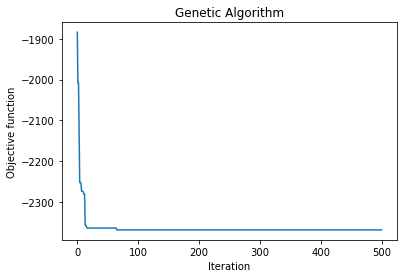

In [47]:
model_ga_t1 = geneticalgorithm(function=object_function_t1,
                               dimension=12,
                               variable_type='int',
                               variable_boundaries=varbound,
                               algorithm_parameters=algorithm_param)

model_ga_t1.run()

In [48]:
convergence_t1 = model_ga_t1.report
solution_t1 = model_ga_t1.output_dict

print(convergence_t1)
print(solution_t1)

[-1883.8310165902312, -2007.6453017649403, -2007.6453017649403, -2135.89030018483, -2252.4994477897462, -2252.4994477897462, -2252.4994477897462, -2273.437377544888, -2273.437377544888, -2273.437377544888, -2276.1314626458243, -2280.557565900941, -2280.557565900941, -2356.245451723073, -2356.245451723073, -2360.020138450452, -2363.9371469706966, -2363.9371469706966, -2363.9371469706966, -2363.9371469706966, -2363.9371469706966, -2363.9371469706966, -2363.9371469706966, -2363.9371469706966, -2363.9371469706966, -2363.9371469706966, -2363.9371469706966, -2363.9371469706966, -2363.9371469706966, -2363.9371469706966, -2363.9371469706966, -2363.9371469706966, -2363.9371469706966, -2363.9371469706966, -2363.9371469706966, -2363.9371469706966, -2363.9371469706966, -2363.9371469706966, -2363.9371469706966, -2363.9371469706966, -2363.9371469706966, -2363.9371469706966, -2363.9371469706966, -2363.9371469706966, -2363.9371469706966, -2363.9371469706966, -2363.9371469706966, -2363.9371469706966, -

In [49]:
ga_solution = input_conversion(solution_t1['variable'])
ga_solution = np.array(ga_solution).reshape(1, -1)

ga_solution_df = pd.DataFrame(ga_solution, columns=features)
ga_solution_df

,G1,absences,goout,age,famrel,studytime,Medu,Walc,Mjob_mean_enc,freetime,Fedu,Fjob_mean_enc
0,11.0,0.0,1.0,15.0,5.0,4.0,4.0,1.0,12.147059,1.0,4.0,10.15


In [50]:
Fjob = Fjob_encode[Fjob_encode.isin(ga_solution_df['Fjob_mean_enc'])].index[0]
ga_solution_df['Fjob_mean_enc'] = Fjob
ga_solution_df = ga_solution_df.rename(columns={'Fjob_mean_enc': 'Fjob'})

Mjob = Mjob_encode[Mjob_encode.isin(ga_solution_df['Mjob_mean_enc'])].index[0]
ga_solution_df['Mjob_mean_enc'] = Mjob
ga_solution_df = ga_solution_df.rename(columns={'Mjob_mean_enc': 'Mjob'})
ga_solution_df

,G1,absences,goout,age,famrel,studytime,Medu,Walc,Mjob,freetime,Fedu,Fjob
0,11.0,0.0,1.0,15.0,5.0,4.0,4.0,1.0,health,1.0,4.0,at_home


In [51]:
prediction = voting_clf.predict(scaler.transform(ga_solution))
ga_solution_df['G3'] = prediction[0]
ga_solution_t1 = ga_solution_df
ga_solution_t1

,G1,absences,goout,age,famrel,studytime,Medu,Walc,Mjob,freetime,Fedu,Fjob,G3
0,11.0,0.0,1.0,15.0,5.0,4.0,4.0,1.0,health,1.0,4.0,at_home,13.329697


#**Task 2. 최소값 탐색**

In [52]:
# [GA 최소값 탐색]
# 중간고사에서 1등 (G1=19)한 최상위권 학생이 공부를 게을리했을 때 (study time 4 -> 1) 하락할 최대 등급은?

In [53]:
# 0: 'G1',
# 1: 'absences',
# 2: 'goout',
# 3: 'age',
# 4: 'famrel',
# 5: 'studytime',
# 6: 'Medu',
# 7: 'Walc',
# 8: 'Mjob_mean_enc',
# 9: 'freetime',
# 10: 'Fedu',
# 11: 'Fjob_mean_enc'

# varbound = np.array([[df['G1'].min(), df['G1'].max()],
#                      [df['absences'].min(), df['absences'].max()],
#                      [df['goout'].min(), df['goout'].max()],
#                      [df['age'].min(), df['age'].max()],
#                      [df['famrel'].min(), df['famrel'].max()],                     
#                      [df['studytime'].min(), df['studytime'].max()],
#                      [df['Medu'].min(), df['Medu'].max()],
#                      [df['Walc'].min(), df['Walc'].max()],
#                      [0, len(Mjob_encode) - 1],
#                      [df['freetime'].min(), df['freetime'].max()],
#                      [df['Fedu'].min(), df['Fedu'].max()],                     
#                      [0, len(Fjob_encode) - 1]])

varbound = np.array([[19, 19],
                     [df['absences'].min(), df['absences'].max()],
                     [df['goout'].min(), df['goout'].max()],
                     [df['age'].min(), df['age'].max()],
                     [df['famrel'].min(), df['famrel'].max()],                     
                     [1, 1],
                     [df['Medu'].min(), df['Medu'].max()],
                     [df['Walc'].min(), df['Walc'].max()],
                     [0, len(Mjob_encode) - 1],
                     [df['freetime'].min(), df['freetime'].max()],
                     [df['Fedu'].min(), df['Fedu'].max()],                     
                     [0, len(Fjob_encode) - 1]])

In [54]:
def object_function_t2(x_input, target_model=voting_clf):
    input_converted = input_conversion(x_input)
    input_converted = np.array(input_converted).reshape(1, -1)

    input_scaled = scaler.transform(input_converted)
    prediction = target_model.predict(input_scaled)

    # target = 1.0
    # print('Predicted views:', int(prediction), 'Difference from target:', int(prediction - target))
    print('Predicted grade:', prediction[0]) 

    # return abs(int(prediction) - target)
    return pow(prediction[0], 3)    

Predicted grade: 17.037412238923014
Predicted grade: 15.211480096330538
Predicted grade: 15.67031640514071
Predicted grade: 16.795033476188348
Predicted grade: 15.92249754735842
Predicted grade: 14.755001717161349
Predicted grade: 16.555789846528167
Predicted grade: 16.566979509433818
Predicted grade: 14.666178435027534
Predicted grade: 17.395788758620235
Predicted grade: 16.506938675486655
Predicted grade: 16.412288073143873
Predicted grade: 14.783643894483234
Predicted grade: 15.75090715832146
Predicted grade: 14.7808877645567
Predicted grade: 15.25619867711078
Predicted grade: 17.278954674303048
Predicted grade: 16.762192195076555
Predicted grade: 16.08869115042825
Predicted grade: 14.715631142794878
Predicted grade: 15.719100877022228
Predicted grade: 15.951005057101304
Predicted grade: 17.07985956643419
Predicted grade: 15.930936104561647
Predicted grade: 15.181101698618187
Predicted grade: 15.815370651814868
Predicted grade: 15.858264913407782
Predicted grade: 15.409595467660454


Predicted grade: 15.023040569578242
Predicted grade: 16.36967171712722
Predicted grade: 16.828729662023182
Predicted grade: 15.785489983371162
Predicted grade: 15.16997014190279
Predicted grade: 14.664689145601196
Predicted grade: 17.446902568649495
Predicted grade: 15.624623156314591
Predicted grade: 15.146793006664174
Predicted grade: 15.849139878441916
Predicted grade: 16.350002494422252
Predicted grade: 16.252618861079664
Predicted grade: 14.436614822301465
Predicted grade: 16.004001001734647
Predicted grade: 15.527153734136727
Predicted grade: 15.489193955542419
Predicted grade: 14.960539250280222
Predicted grade: 16.992801148229624
Predicted grade: 14.96491077979448
Predicted grade: 16.120140576612854
Predicted grade: 16.639851979316813
Predicted grade: 16.305051672922854
Predicted grade: 15.240179798410617
Predicted grade: 16.486265329759114
Predicted grade: 16.321428455772445
Predicted grade: 14.54117821691674
Predicted grade: 16.785321564454943
Predicted grade: 14.791245851426

__________________________________________________ 0.6% GA is running...Predicted grade: 14.515744474553506
Predicted grade: 15.82436761450406
Predicted grade: 14.845036200865598
Predicted grade: 16.14577742782129
Predicted grade: 14.88210044569235
Predicted grade: 15.644238795519305
Predicted grade: 14.99918859349922
Predicted grade: 16.167546465909098
Predicted grade: 14.914544284377754
Predicted grade: 15.02590145805019
Predicted grade: 14.70219194718367
Predicted grade: 14.143790380422184
Predicted grade: 16.10188276535325
Predicted grade: 14.452558658645833
Predicted grade: 14.859304764869783
Predicted grade: 16.23221023922275
Predicted grade: 15.440556996530558
Predicted grade: 15.326717483322488
Predicted grade: 16.02720239587866
Predicted grade: 15.92502750627515
Predicted grade: 14.905602239080892
Predicted grade: 15.173015141720585
Predicted grade: 14.28203363220402
Predicted grade: 14.340601081351044
Predicted grade: 14.37980507196985
Predicted grade: 14.69213739839639
Predi

Predicted grade: 16.13715568463008
Predicted grade: 14.625117028384873
Predicted grade: 15.54896771894128
Predicted grade: 15.598421170426091
Predicted grade: 15.1188643934861
Predicted grade: 15.114466358201598
Predicted grade: 14.945595633688669
Predicted grade: 13.978801367961063
Predicted grade: 15.667872047429313
Predicted grade: 15.791419874429787
Predicted grade: 14.377436672532935
Predicted grade: 15.944012497314773
Predicted grade: 15.057243317921348
Predicted grade: 15.670030672716189
Predicted grade: 14.235238936044889
Predicted grade: 14.555069627399183
Predicted grade: 15.449756249004727
Predicted grade: 15.484935912091032
Predicted grade: 15.674105500584277
Predicted grade: 14.951662380348102
Predicted grade: 17.532815868023395
Predicted grade: 14.678972909273062
Predicted grade: 15.208740150039327
Predicted grade: 14.899449660731003
Predicted grade: 15.060120837839387
Predicted grade: 16.622300053401776
Predicted grade: 14.758434785281219
Predicted grade: 15.395942849614

Predicted grade: 15.07361564854
Predicted grade: 14.395013419990681
Predicted grade: 15.55389397715919
Predicted grade: 15.638162052992657
Predicted grade: 15.123250714653421
Predicted grade: 14.730321473750058
Predicted grade: 15.420548832949088
Predicted grade: 17.936717497473413
Predicted grade: 15.574384700970738
Predicted grade: 15.298413349583626
Predicted grade: 15.313647908268877
Predicted grade: 14.458090534053591
Predicted grade: 14.759650271109072
Predicted grade: 15.934519961728597
Predicted grade: 14.928679604524064
Predicted grade: 16.66405470896032
Predicted grade: 17.101429829349218
Predicted grade: 16.417175021833334
Predicted grade: 14.894264747312889
Predicted grade: 15.751061665011145
Predicted grade: 14.712869114088138
Predicted grade: 14.768592144471635
Predicted grade: 16.616195947883273
Predicted grade: 15.505449781769507
Predicted grade: 15.56627320744438
Predicted grade: 17.113229205765876
Predicted grade: 15.168814815298395
Predicted grade: 14.611229229114258

|_________________________________________________ 1.6% GA is running...Predicted grade: 15.912640616782788
Predicted grade: 15.404941121042242
Predicted grade: 17.30195879411176
Predicted grade: 14.627751780703733
Predicted grade: 14.168962881594377
Predicted grade: 14.1125928505395
Predicted grade: 14.511621816094623
Predicted grade: 15.8497629122897
Predicted grade: 14.722944206755146
Predicted grade: 15.278746423714258
Predicted grade: 14.65052355613227
Predicted grade: 15.01568239963759
Predicted grade: 15.803041124028622
Predicted grade: 15.004627124083092
Predicted grade: 14.88381900301645
Predicted grade: 15.243665303416902
Predicted grade: 13.963731142648243
Predicted grade: 13.812869111985803
Predicted grade: 14.815031130606641
Predicted grade: 14.855991960025461
Predicted grade: 15.15809134824226
Predicted grade: 15.405547080123254
Predicted grade: 14.458285480080896
Predicted grade: 16.137724633877287
Predicted grade: 14.740731159706101
Predicted grade: 14.016073377256921
P

Predicted grade: 14.196998140139696
Predicted grade: 14.585489534204655
Predicted grade: 15.854875376976706
Predicted grade: 14.507283761424157
Predicted grade: 14.468986096779139
Predicted grade: 14.509489267668544
Predicted grade: 14.013397869240654
Predicted grade: 16.351905845933427
Predicted grade: 15.69588405572396
Predicted grade: 15.839961554427367
Predicted grade: 14.536903855715117
Predicted grade: 13.925990990373217
Predicted grade: 14.471416645876035
Predicted grade: 14.5067245884527
Predicted grade: 15.025989520175989
Predicted grade: 14.550701097487817
Predicted grade: 14.075018629502887
Predicted grade: 14.63083337130029
Predicted grade: 14.847505779876379
Predicted grade: 16.58221240954043
Predicted grade: 14.326500406528666
Predicted grade: 16.380209875981503
Predicted grade: 15.714770440546204
Predicted grade: 14.46247049778556
Predicted grade: 15.822051162024811
Predicted grade: 15.085401974880432
Predicted grade: 15.123986965193973
Predicted grade: 16.31008734255792

Predicted grade: 14.533639566459074
Predicted grade: 14.963882281095655
Predicted grade: 13.95403348689983
Predicted grade: 14.090229853765441
Predicted grade: 14.783449442925239
Predicted grade: 14.160749338573064
Predicted grade: 14.133797974403828
Predicted grade: 14.400379491765927
Predicted grade: 15.33314918805936
Predicted grade: 15.285939120782755
Predicted grade: 14.23717095368225
Predicted grade: 14.390971854873763
Predicted grade: 14.891390770402012
Predicted grade: 14.734088527304328
Predicted grade: 15.283470591022853
Predicted grade: 14.333525367302137
Predicted grade: 14.03889511594888
Predicted grade: 14.060378946713437
Predicted grade: 14.890330366135595
Predicted grade: 14.441478076393869
Predicted grade: 14.694618691126854
Predicted grade: 14.331889192370518
Predicted grade: 15.796471466371665
Predicted grade: 15.107137107427134
Predicted grade: 14.301489475831962
Predicted grade: 13.707601282271392
Predicted grade: 13.997176364889873
Predicted grade: 15.032445549854

|_________________________________________________ 2.6% GA is running...Predicted grade: 14.591247387902726
Predicted grade: 13.82013936116745
Predicted grade: 14.033836243130809
Predicted grade: 14.281845839401837
Predicted grade: 14.097970197075968
Predicted grade: 14.46484237838881
Predicted grade: 14.360348067243015
Predicted grade: 14.177568748999908
Predicted grade: 14.577731512556001
Predicted grade: 14.151619197621706
Predicted grade: 16.1130516605144
Predicted grade: 14.73350059370096
Predicted grade: 14.8906910161568
Predicted grade: 14.731204467242568
Predicted grade: 13.968487466876274
Predicted grade: 13.968487466876274
Predicted grade: 13.539442710417804
Predicted grade: 14.0970154755776
Predicted grade: 15.35385795416685
Predicted grade: 14.414818398516587
Predicted grade: 14.58329747465037
Predicted grade: 14.914660054047665
Predicted grade: 14.598307285287964
Predicted grade: 14.530839199042154
Predicted grade: 14.593007442843765
Predicted grade: 14.857117299205079
Pre

Predicted grade: 13.949724148710132
Predicted grade: 14.65690612430195
Predicted grade: 14.568409639859349
Predicted grade: 15.022638593590381
Predicted grade: 15.206568117109455
Predicted grade: 14.412773666316012
Predicted grade: 14.159238796599766
Predicted grade: 15.322541537932189
Predicted grade: 15.242205086109566
Predicted grade: 14.26072293520022
Predicted grade: 14.805744691934828
Predicted grade: 14.893938491984116
Predicted grade: 15.185110155133174
Predicted grade: 15.239364560056792
Predicted grade: 14.50635331090236
Predicted grade: 13.890654557000282
Predicted grade: 14.970539519633357
Predicted grade: 14.921464439192702
Predicted grade: 14.554844785025361
Predicted grade: 14.230707462316339
Predicted grade: 14.779938112096161
Predicted grade: 14.953513354178378
Predicted grade: 14.722707062910635
Predicted grade: 14.222985927104519
Predicted grade: 15.10554700567261
Predicted grade: 14.433312147663628
Predicted grade: 14.71902489724704
Predicted grade: 13.9746413172020

Predicted grade: 14.080255180429623
Predicted grade: 14.077081195030678
Predicted grade: 14.99289064628077
Predicted grade: 14.162387120739618
Predicted grade: 15.76555069121172
Predicted grade: 15.765571583389926
Predicted grade: 14.54451129251544
Predicted grade: 14.696719837554056
Predicted grade: 16.010866167199826
Predicted grade: 14.402388792596865
Predicted grade: 14.708719185864647
Predicted grade: 14.329267270413792
Predicted grade: 15.079826047655368
Predicted grade: 14.992888109099532
Predicted grade: 16.233204765943924
Predicted grade: 15.618419737553841
Predicted grade: 15.25598232596136
Predicted grade: 14.907074638884444
Predicted grade: 15.70748901387581
Predicted grade: 15.584180990645196
Predicted grade: 14.143799573505248
Predicted grade: 14.744923430722872
Predicted grade: 14.162820523250593
Predicted grade: 14.071720282369236
Predicted grade: 17.007676282887896
Predicted grade: 14.32244075515593
Predicted grade: 13.909212945231305
Predicted grade: 15.14054612114012

Predicted grade: 15.059365679304326
Predicted grade: 14.22271406379405
Predicted grade: 14.015114876017336
Predicted grade: 14.70348195197117
Predicted grade: 13.724201190379615
Predicted grade: 14.070953872523582
Predicted grade: 14.291708066772294
Predicted grade: 14.590643449148388
Predicted grade: 13.900682217607354
||________________________________________________ 3.6% GA is running...Predicted grade: 14.44282881343454
Predicted grade: 14.849313781072697
Predicted grade: 14.913531215147296
Predicted grade: 14.994733701604664
Predicted grade: 14.603821032784957
Predicted grade: 15.403968834169035
Predicted grade: 14.737401501935272
Predicted grade: 14.721084966794391
Predicted grade: 14.707809172337376
Predicted grade: 14.77436667036985
Predicted grade: 14.480144019766684
Predicted grade: 15.105612706639192
Predicted grade: 14.272411852459527
Predicted grade: 13.953934582863461
Predicted grade: 14.350860742631292
Predicted grade: 14.425085711307219
Predicted grade: 15.077700475833

Predicted grade: 14.717850363943036
Predicted grade: 14.432467508115655
Predicted grade: 14.993588500692988
Predicted grade: 14.126633447318076
Predicted grade: 13.95181300543081
Predicted grade: 14.2339958599416
Predicted grade: 14.223361799023989
Predicted grade: 14.242123500992633
Predicted grade: 14.291682697638214
Predicted grade: 13.958147058775808
Predicted grade: 14.98916537980949
Predicted grade: 13.719767750059482
Predicted grade: 16.15748772296205
Predicted grade: 14.02640458060445
Predicted grade: 15.082349969942692
Predicted grade: 13.153952018921624
Predicted grade: 14.468254628007278
Predicted grade: 14.455422492222866
Predicted grade: 14.304726563442452
Predicted grade: 14.267073407803885
Predicted grade: 14.485780651040573
Predicted grade: 14.34794172769432
Predicted grade: 15.088886452849705
Predicted grade: 14.691127711989198
Predicted grade: 15.283724136407661
Predicted grade: 14.433024969316458
Predicted grade: 14.40962526656835
Predicted grade: 14.329418580259615


Predicted grade: 14.132614210422256
Predicted grade: 14.532608738208816
Predicted grade: 16.291166379916575
Predicted grade: 14.034738696841424
Predicted grade: 14.806677143667597
Predicted grade: 15.781327475302769
Predicted grade: 15.019429615410425
Predicted grade: 14.185050040228958
Predicted grade: 13.711932280344927
Predicted grade: 14.392076316513668
Predicted grade: 14.74293224340614
Predicted grade: 14.866745835333235
Predicted grade: 14.40172449665355
Predicted grade: 14.418300810629034
Predicted grade: 14.17197211088891
Predicted grade: 13.778508193883425
Predicted grade: 14.439733971544248
Predicted grade: 14.46603341911757
Predicted grade: 16.04560595074125
Predicted grade: 14.602825410006014
Predicted grade: 14.216668027764973
Predicted grade: 14.179279766614338
Predicted grade: 14.051642731447837
Predicted grade: 14.943010380497908
Predicted grade: 13.831338822059003
Predicted grade: 14.230768732477523
Predicted grade: 14.232601205927713
Predicted grade: 13.9961422394292

Predicted grade: 14.547047238732068
Predicted grade: 14.960242549405729
Predicted grade: 13.80818786881135
Predicted grade: 14.87693400718535
Predicted grade: 14.241674146975859
Predicted grade: 15.927069818033226
Predicted grade: 15.58162917611134
Predicted grade: 15.293420008558096
Predicted grade: 14.103079771743383
Predicted grade: 14.97987262221728
Predicted grade: 15.740881231195724
||________________________________________________ 4.6% GA is running...Predicted grade: 15.200497254376424
Predicted grade: 15.043394672245954
Predicted grade: 15.235677317029051
Predicted grade: 13.898703753169963
Predicted grade: 14.112707698810366
Predicted grade: 14.8182656989529
Predicted grade: 13.877616931004399
Predicted grade: 13.756107019400865
Predicted grade: 14.20435437799123
Predicted grade: 14.928059091263668
Predicted grade: 17.28287211082908
Predicted grade: 14.170194110128188
Predicted grade: 14.62364047358651
Predicted grade: 14.826569614306422
Predicted grade: 15.405438306139294
P

Predicted grade: 15.382620006862204
Predicted grade: 14.403985303690666
Predicted grade: 13.589996175144693
Predicted grade: 14.267682302213872
Predicted grade: 15.374781099524151
Predicted grade: 14.596853495673074
Predicted grade: 15.644321129679925
Predicted grade: 14.467233597064833
Predicted grade: 16.452050929978153
Predicted grade: 14.017355482652517
Predicted grade: 15.0211030233015
Predicted grade: 15.352120465448271
Predicted grade: 15.922771478212399
Predicted grade: 13.880729530403181
Predicted grade: 16.293447627373382
Predicted grade: 14.109763533918986
Predicted grade: 15.808168959851843
Predicted grade: 14.20833247534334
Predicted grade: 14.418496366413159
Predicted grade: 14.364701517801356
Predicted grade: 15.019595822129368
Predicted grade: 14.557590470158763
Predicted grade: 15.332253066897271
Predicted grade: 14.704562711767062
Predicted grade: 16.73424271383564
Predicted grade: 14.297159639980961
Predicted grade: 14.93047606691477
Predicted grade: 13.8427638831889

Predicted grade: 15.387468642720487
Predicted grade: 15.2790477728413
Predicted grade: 15.395946126341904
Predicted grade: 13.672780207500915
Predicted grade: 14.741995937363646
Predicted grade: 14.253845719396251
Predicted grade: 13.722470930687223
Predicted grade: 15.354570534520198
Predicted grade: 14.820204109668872
Predicted grade: 14.105267169620177
Predicted grade: 14.708727444916683
Predicted grade: 15.286589641767991
Predicted grade: 14.205446237535947
Predicted grade: 14.414058796989075
Predicted grade: 15.404180658453
Predicted grade: 14.906677815188187
Predicted grade: 15.439836612986793
Predicted grade: 14.261138230799764
Predicted grade: 14.44278720155709
Predicted grade: 14.735960241784355
Predicted grade: 14.37302305008724
Predicted grade: 14.320859537624145
Predicted grade: 15.248738233183325
Predicted grade: 14.13857086005583
Predicted grade: 14.236202472834492
Predicted grade: 14.07629972598095
Predicted grade: 16.159708797014098
Predicted grade: 14.166347881873365
P

Predicted grade: 13.583356103577438
Predicted grade: 14.315819380758626
Predicted grade: 14.915864722499942
Predicted grade: 14.754444278060697
Predicted grade: 13.745250201442664
Predicted grade: 13.719142528598995
Predicted grade: 13.829867863272897
Predicted grade: 14.356843759262759
Predicted grade: 13.984555716944358
Predicted grade: 14.531501440184053
Predicted grade: 14.276907912739077
Predicted grade: 13.705010389547246
Predicted grade: 14.619910111868611
Predicted grade: 14.485510429342767
Predicted grade: 14.28928347791341
Predicted grade: 13.814086556212075
Predicted grade: 13.841392452527673
Predicted grade: 14.641011975797502
Predicted grade: 14.47649358189903
Predicted grade: 13.970836837410232
|||_______________________________________________ 5.6% GA is running...Predicted grade: 13.614140125501422
Predicted grade: 14.66306402812019
Predicted grade: 13.73594873316933
Predicted grade: 13.946874311026905
Predicted grade: 16.04140471509133
Predicted grade: 14.3969195774196

Predicted grade: 15.326205371667989
Predicted grade: 15.27157114781464
Predicted grade: 14.637631487083352
Predicted grade: 16.615437427570942
Predicted grade: 14.714536995041085
Predicted grade: 14.010292546718198
Predicted grade: 14.974751467795713
Predicted grade: 14.623564754726322
Predicted grade: 14.67141744331108
Predicted grade: 14.185386420435137
Predicted grade: 16.227053209563
Predicted grade: 13.639602976650083
Predicted grade: 14.098659738314181
Predicted grade: 14.317573846510562
Predicted grade: 14.581305360120501
Predicted grade: 13.654574774402375
Predicted grade: 14.195975628392597
Predicted grade: 14.191243286589518
Predicted grade: 14.533144816162121
Predicted grade: 15.705639182710057
Predicted grade: 14.496589488926046
Predicted grade: 13.5125626001198
Predicted grade: 13.761448535537532
Predicted grade: 13.78314873181319
Predicted grade: 17.157488664733776
Predicted grade: 14.421106820863493
Predicted grade: 13.381045414367222
Predicted grade: 13.581142809576894


Predicted grade: 14.278673077404235
Predicted grade: 14.577372913069562
Predicted grade: 14.355390863262523
Predicted grade: 13.904531616218
Predicted grade: 13.604970908009584
Predicted grade: 13.991866844748621
Predicted grade: 13.768397029819303
Predicted grade: 13.862414330484327
Predicted grade: 14.57998116163427
Predicted grade: 14.54854743099657
Predicted grade: 14.094764380169622
Predicted grade: 13.895344452331807
Predicted grade: 13.849290083356186
Predicted grade: 14.387886252515484
Predicted grade: 14.631111959929365
Predicted grade: 13.41672032559726
Predicted grade: 15.396072291085275
Predicted grade: 16.08149637596529
Predicted grade: 14.86757667337151
Predicted grade: 14.251903349189384
Predicted grade: 14.167018266309709
Predicted grade: 15.032286514498296
Predicted grade: 16.056867341562896
Predicted grade: 14.400557867082695
Predicted grade: 14.767430038046008
Predicted grade: 15.098689090929474
Predicted grade: 15.633876328870443
Predicted grade: 14.582875410504252


Predicted grade: 14.618915106062147
Predicted grade: 14.23305762920611
Predicted grade: 13.904046416759043
Predicted grade: 14.152402837487992
Predicted grade: 14.259072633446516
Predicted grade: 14.890662867925855
Predicted grade: 15.825052344685972
Predicted grade: 13.791247883684045
Predicted grade: 13.352012763033756
Predicted grade: 15.844106696199978
Predicted grade: 16.41191172906067
Predicted grade: 14.511866592558752
Predicted grade: 15.037161018959132
Predicted grade: 14.712212724490366
Predicted grade: 14.852506391743882
Predicted grade: 14.777986886040976
Predicted grade: 14.38825777450048
Predicted grade: 14.611469662378404
Predicted grade: 15.84746169462701
Predicted grade: 15.584362687418249
|||_______________________________________________ 6.6% GA is running...Predicted grade: 13.778531610344473
Predicted grade: 13.678031616373865
Predicted grade: 14.492334840473015
Predicted grade: 13.922068461802871
Predicted grade: 14.368945311361173
Predicted grade: 14.257137146586

Predicted grade: 13.970681881060912
Predicted grade: 14.958887141629395
Predicted grade: 14.615502077081155
Predicted grade: 14.09220361212491
Predicted grade: 13.933118247876392
Predicted grade: 16.49290869619275
Predicted grade: 14.702263557087067
Predicted grade: 14.932244486884878
Predicted grade: 15.100114706925874
Predicted grade: 14.126917924601473
Predicted grade: 14.722743996280107
Predicted grade: 13.75862659044092
Predicted grade: 13.945089718974112
Predicted grade: 14.618532607135528
Predicted grade: 13.909606340175744
Predicted grade: 13.832861742982027
Predicted grade: 14.081568452295002
Predicted grade: 14.426771483769281
Predicted grade: 14.615808972574044
Predicted grade: 15.003327582954226
Predicted grade: 14.247486101611331
Predicted grade: 14.941746210417113
Predicted grade: 15.165465316519551
Predicted grade: 14.036976224543102
Predicted grade: 14.851142031807479
Predicted grade: 15.818807504934226
Predicted grade: 14.154236131221467
Predicted grade: 14.93797512406

Predicted grade: 14.724287636766986
Predicted grade: 14.908894763051828
Predicted grade: 13.436430330263073
Predicted grade: 14.323014632177978
Predicted grade: 13.788446925509298
Predicted grade: 14.26479176612169
Predicted grade: 14.735488330987602
Predicted grade: 15.165465316519551
Predicted grade: 14.922475784509196
Predicted grade: 16.239685675112383
Predicted grade: 14.658811766060174
Predicted grade: 13.959905851852008
Predicted grade: 16.44478824205563
Predicted grade: 14.926535108245337
Predicted grade: 14.367891369373673
Predicted grade: 13.813453443998306
Predicted grade: 14.897805633887861
Predicted grade: 14.85791520648548
Predicted grade: 14.195523211087087
Predicted grade: 14.741289957236157
Predicted grade: 14.980356681691354
Predicted grade: 14.267845250276808
Predicted grade: 16.01086554430088
Predicted grade: 16.04345352840431
Predicted grade: 13.686279187434623
Predicted grade: 14.761952933775232
Predicted grade: 16.900566517485814
Predicted grade: 15.3969004142254

Predicted grade: 14.571314860509252
Predicted grade: 14.28656628493478
Predicted grade: 14.073168670811862
Predicted grade: 14.670328591070662
Predicted grade: 15.31320290342722
Predicted grade: 15.148702246018168
Predicted grade: 13.562067757070182
Predicted grade: 14.709730700374061
Predicted grade: 15.128339041226626
Predicted grade: 15.72192772341318
Predicted grade: 14.736224934795482
Predicted grade: 13.858772302419387
Predicted grade: 14.049539870593
Predicted grade: 14.789651942541676
Predicted grade: 13.678375226325267
Predicted grade: 14.003450664772018
Predicted grade: 15.294359853305584
Predicted grade: 15.229040178948338
Predicted grade: 14.8164649202649
Predicted grade: 15.002836433989605
Predicted grade: 14.951632819564793
Predicted grade: 13.326473531697184
Predicted grade: 15.579967029034838
Predicted grade: 14.767850831898576
Predicted grade: 14.994198461540586
Predicted grade: 17.35083100991757
Predicted grade: 15.08088613889477
Predicted grade: 13.448376368680108
Pr

Predicted grade: 14.537010729218439
Predicted grade: 14.086309229250125
Predicted grade: 14.801639126054079
Predicted grade: 14.92876411824831
Predicted grade: 15.18193978478771
Predicted grade: 14.019945307946635
Predicted grade: 14.26133192584821
Predicted grade: 14.038532115118173
Predicted grade: 13.728277632418354
Predicted grade: 14.635843851529648
Predicted grade: 15.162967782947325
Predicted grade: 14.178124500449535
Predicted grade: 14.510670452409444
Predicted grade: 14.192727811395601
Predicted grade: 14.704792493769942
Predicted grade: 14.880952713582728
Predicted grade: 14.490626630525083
Predicted grade: 13.99346499356011
Predicted grade: 16.267929610098438
Predicted grade: 14.442346633559103
Predicted grade: 13.895390269796957
Predicted grade: 14.249626376656982
Predicted grade: 14.49200674574265
Predicted grade: 13.914014418950629
Predicted grade: 16.449882026193322
Predicted grade: 14.577752057092638
Predicted grade: 14.757990418267049
Predicted grade: 14.2094261555729

Predicted grade: 14.125345626902345
Predicted grade: 15.11167915406748
Predicted grade: 13.637103651866
Predicted grade: 13.80193911505718
Predicted grade: 13.983734589658093
Predicted grade: 13.770171140569607
Predicted grade: 14.425274875424606
Predicted grade: 14.800605889686933
Predicted grade: 13.933174095960448
Predicted grade: 14.036133295409192
Predicted grade: 13.711603209350239
Predicted grade: 14.446958900113012
Predicted grade: 14.600093609732156
Predicted grade: 13.596108367043414
Predicted grade: 14.756132878212151
Predicted grade: 14.281133461046565
Predicted grade: 14.306818001459355
Predicted grade: 14.143486213222225
Predicted grade: 14.053681682290522
Predicted grade: 14.108005876805796
Predicted grade: 14.182398314499983
Predicted grade: 14.937760300375423
Predicted grade: 15.381222167774155
Predicted grade: 13.560009964215482
Predicted grade: 16.164284138958337
Predicted grade: 14.1039657988885
Predicted grade: 14.560371075597073
Predicted grade: 14.52613843943575


Predicted grade: 13.740282417416722
Predicted grade: 13.997246505978262
Predicted grade: 13.51083536438392
Predicted grade: 16.628953080680063
Predicted grade: 14.071766579392337
Predicted grade: 14.012587580537826
Predicted grade: 14.0172093893812
Predicted grade: 13.589470882542356
Predicted grade: 13.603165357938153
Predicted grade: 14.071555288858397
Predicted grade: 14.204258565948754
Predicted grade: 13.574636517636941
Predicted grade: 14.532302733837993
Predicted grade: 15.032715738027212
Predicted grade: 13.898184120865494
Predicted grade: 14.109903769906355
Predicted grade: 14.51287434766818
Predicted grade: 14.067190694362202
Predicted grade: 14.31113450383136
Predicted grade: 14.087442072629443
Predicted grade: 13.391835229869832
Predicted grade: 13.78384501447509
Predicted grade: 13.911883627342656
Predicted grade: 14.966092990385855
Predicted grade: 13.9446585688265
Predicted grade: 14.509767743556262
Predicted grade: 13.756671272686717
Predicted grade: 14.967474753168133


Predicted grade: 16.9525965122704
Predicted grade: 15.642157183806498
Predicted grade: 15.560073923246293
Predicted grade: 15.949172926974006
Predicted grade: 15.688201005596857
Predicted grade: 14.98227118086009
Predicted grade: 14.803571136663441
Predicted grade: 16.34644909561901
Predicted grade: 16.120675028536937
Predicted grade: 13.733173826606006
Predicted grade: 13.76432101363916
Predicted grade: 16.034034438925826
Predicted grade: 14.661516862052272
Predicted grade: 13.74102754800092
Predicted grade: 13.869407760246668
Predicted grade: 14.377652674163018
Predicted grade: 13.815179033180664
Predicted grade: 14.420604526099465
Predicted grade: 14.301849046988748
Predicted grade: 14.244196506985965
Predicted grade: 14.106717851382884
Predicted grade: 14.357406117215243
Predicted grade: 14.308171825672472
Predicted grade: 14.90308495510997
Predicted grade: 14.28260921321278
Predicted grade: 14.146753319771852
Predicted grade: 16.269682933190918
Predicted grade: 15.541590574424461


|||||_____________________________________________ 9.2% GA is running...Predicted grade: 14.535725306844357
Predicted grade: 14.2854532163801
Predicted grade: 14.055446188510487
Predicted grade: 15.010447120593875
Predicted grade: 14.718725267225517
Predicted grade: 13.699293222780689
Predicted grade: 15.644043800755336
Predicted grade: 14.328908592740918
Predicted grade: 14.07479342955493
Predicted grade: 14.295686980336404
Predicted grade: 14.098450883249518
Predicted grade: 14.058880026504056
Predicted grade: 13.8830325031053
Predicted grade: 14.112276907152483
Predicted grade: 16.038280518070966
Predicted grade: 13.834825568320971
Predicted grade: 15.541462710553409
Predicted grade: 14.278452393079442
Predicted grade: 14.675033199967627
Predicted grade: 14.432810953366912
Predicted grade: 14.112387157894707
Predicted grade: 14.41895710822577
Predicted grade: 15.02889806283693
Predicted grade: 15.110344776407587
Predicted grade: 14.775311155191815
Predicted grade: 14.541292432832384

Predicted grade: 14.75405332843314
Predicted grade: 14.416911159070589
Predicted grade: 13.952869346805029
Predicted grade: 16.311099765776223
Predicted grade: 15.961368466134493
Predicted grade: 14.328908592740918
Predicted grade: 13.326473531697184
Predicted grade: 15.178514204354988
Predicted grade: 15.092162907380063
Predicted grade: 14.239876721009194
Predicted grade: 14.86304731012469
Predicted grade: 14.473179915775901
Predicted grade: 14.535966470884203
Predicted grade: 14.522264737382057
Predicted grade: 13.877869778966355
Predicted grade: 17.322524208813395
Predicted grade: 14.078122612055163
Predicted grade: 14.666784567014112
Predicted grade: 14.098130201254675
Predicted grade: 14.333437744297024
Predicted grade: 14.409845515667202
Predicted grade: 14.407432842836348
Predicted grade: 14.139922954534166
Predicted grade: 14.32256811318797
Predicted grade: 13.741617858944174
Predicted grade: 14.517528660040819
Predicted grade: 14.307223917026848
Predicted grade: 14.54633689374

Predicted grade: 14.250109279774705
Predicted grade: 14.362987417579475
Predicted grade: 14.23069747451486
Predicted grade: 14.586232902145582
Predicted grade: 15.002883909780358
Predicted grade: 14.261657131260657
Predicted grade: 15.247061770797833
Predicted grade: 13.593349859251761
Predicted grade: 14.507777503756104
Predicted grade: 13.732234306228397
Predicted grade: 14.750871129021329
Predicted grade: 15.515638576388575
Predicted grade: 13.797788127164287
Predicted grade: 14.088734457429013
Predicted grade: 16.35112923592938
Predicted grade: 15.101406169302408
Predicted grade: 15.426133079807569
Predicted grade: 14.630779883267977
Predicted grade: 14.409930322920959
Predicted grade: 14.865548313358012
Predicted grade: 15.137137014628912
Predicted grade: 15.494787755516873
Predicted grade: 14.152602371825585
Predicted grade: 14.609643716455599
Predicted grade: 14.157069491702922
Predicted grade: 14.792744333957765
Predicted grade: 14.920617215280094
Predicted grade: 14.0702427937

Predicted grade: 13.976677638128445
Predicted grade: 14.075074497894251
Predicted grade: 14.621856486865168
Predicted grade: 14.579475490539416
Predicted grade: 14.245696568814395
Predicted grade: 14.433519288705858
Predicted grade: 13.90193545961296
Predicted grade: 15.181643325474965
Predicted grade: 14.604985578533617
|||||_____________________________________________ 10.2% GA is running...Predicted grade: 14.629947006990584
Predicted grade: 13.68589008008859
Predicted grade: 15.829285579849058
Predicted grade: 14.077536717439102
Predicted grade: 14.903790842178493
Predicted grade: 14.018064490999981
Predicted grade: 15.430764951176902
Predicted grade: 13.574478036281791
Predicted grade: 14.640735771873162
Predicted grade: 14.400040164197398
Predicted grade: 14.22730212558171
Predicted grade: 14.908222789297197
Predicted grade: 13.605071817271432
Predicted grade: 14.481537435072772
Predicted grade: 15.154537085123044
Predicted grade: 13.934648525932024
Predicted grade: 14.0518382615

Predicted grade: 14.692017026694812
Predicted grade: 14.388516815195436
Predicted grade: 14.19516238735222
Predicted grade: 14.794287709915437
Predicted grade: 14.42537879780014
Predicted grade: 14.322486647340964
Predicted grade: 14.285547263262735
Predicted grade: 14.372233845349015
Predicted grade: 14.458503329926524
Predicted grade: 13.858859762523146
Predicted grade: 13.868238092520649
Predicted grade: 13.693734171002186
Predicted grade: 14.512766635184697
Predicted grade: 14.142829714866409
Predicted grade: 13.89131055729946
Predicted grade: 13.986918522178263
Predicted grade: 14.375566293232694
Predicted grade: 16.995254922734222
Predicted grade: 16.60151566361085
Predicted grade: 14.924479460347726
Predicted grade: 14.00788356484758
Predicted grade: 15.015393250620091
Predicted grade: 15.861896856542288
Predicted grade: 13.493447666592038
Predicted grade: 13.974441444217126
Predicted grade: 14.814046484781557
Predicted grade: 14.310730542879844
Predicted grade: 15.1889164413666

Predicted grade: 13.724053324850319
Predicted grade: 14.402661381831527
Predicted grade: 15.70015588137555
Predicted grade: 14.093897361973342
Predicted grade: 13.70848969387196
Predicted grade: 14.055868264442362
Predicted grade: 14.19256472009283
Predicted grade: 14.53084351440316
Predicted grade: 14.241422622742155
Predicted grade: 14.612372884935269
Predicted grade: 13.947541874241606
Predicted grade: 15.365372406599258
Predicted grade: 14.871385065648122
Predicted grade: 13.866698528924383
Predicted grade: 14.104094133356883
Predicted grade: 14.866780481316454
Predicted grade: 13.86367674468345
Predicted grade: 13.819563253677558
Predicted grade: 15.07378199436611
Predicted grade: 16.118120895253167
Predicted grade: 16.19300419433331
Predicted grade: 15.98387310457037
Predicted grade: 14.607628457286419
Predicted grade: 14.77313028829014
Predicted grade: 14.265407698953231
Predicted grade: 14.879973712094754
Predicted grade: 14.520032170112621
Predicted grade: 13.700489502991276
P

Predicted grade: 15.809900006103241
Predicted grade: 14.912407510959916
Predicted grade: 14.669222757913175
Predicted grade: 14.729961870583722
Predicted grade: 13.788257479551717
Predicted grade: 15.582254818623824
Predicted grade: 14.396795953698616
Predicted grade: 15.535213281114094
Predicted grade: 14.862517024909023
Predicted grade: 14.35883760321133
Predicted grade: 15.807716159735984
Predicted grade: 14.133961049596317
Predicted grade: 13.752635681369986
Predicted grade: 14.063991132276044
Predicted grade: 15.012383507844108
Predicted grade: 13.720221129972032
Predicted grade: 14.336831102867363
Predicted grade: 14.561135781099017
Predicted grade: 14.504463878272299
||||||____________________________________________ 11.2% GA is running...Predicted grade: 15.775445603159506
Predicted grade: 14.097355507644117
Predicted grade: 14.900135510193367
Predicted grade: 14.612570511016708
Predicted grade: 15.854139880621739
Predicted grade: 15.134466889634162
Predicted grade: 14.34497881

Predicted grade: 14.78957549237183
Predicted grade: 15.266575635763056
Predicted grade: 15.601372899415063
Predicted grade: 14.045013580163406
Predicted grade: 14.561058902305497
Predicted grade: 15.647250434394236
Predicted grade: 15.219330218254116
Predicted grade: 13.933010764395277
Predicted grade: 14.884155453642393
Predicted grade: 14.35858906359149
Predicted grade: 13.799562404702309
Predicted grade: 15.307080848153808
Predicted grade: 13.573529352815278
Predicted grade: 15.054809914694852
Predicted grade: 14.927905646613354
Predicted grade: 13.70848969387196
Predicted grade: 15.97963332691136
Predicted grade: 13.245989662799778
Predicted grade: 16.146144089508663
Predicted grade: 14.299813546242866
Predicted grade: 14.56704121789508
Predicted grade: 14.494651809751531
Predicted grade: 13.263410427404224
Predicted grade: 14.306862728763294
Predicted grade: 15.495688461865138
Predicted grade: 14.963358458677286
Predicted grade: 14.299576150959524
Predicted grade: 14.1100240201246

Predicted grade: 14.605530794444379
Predicted grade: 15.398350316284956
Predicted grade: 14.61403826869575
Predicted grade: 13.96189489962903
Predicted grade: 14.882196263799836
Predicted grade: 14.709937122163074
Predicted grade: 14.530264434765627
Predicted grade: 14.457754082029817
Predicted grade: 17.45615369789951
Predicted grade: 15.998497306422548
Predicted grade: 15.587140271898383
Predicted grade: 13.985538284250524
Predicted grade: 15.069209458046865
Predicted grade: 16.455115600290835
Predicted grade: 14.169080874860455
Predicted grade: 13.988927036799604
Predicted grade: 14.49812139372529
Predicted grade: 14.107781320950437
Predicted grade: 15.908206540409198
Predicted grade: 16.246216203234212
Predicted grade: 14.790363106182317
Predicted grade: 14.681313781145931
Predicted grade: 14.092597164715434
Predicted grade: 15.522812219027047
Predicted grade: 14.42146618934401
Predicted grade: 15.113651872649385
Predicted grade: 14.888240785555661
Predicted grade: 14.0204928771089

Predicted grade: 16.51068431030941
Predicted grade: 15.369731524328373
Predicted grade: 14.874960524153124
Predicted grade: 15.011422032422976
Predicted grade: 14.996921184392589
Predicted grade: 15.407705313427002
Predicted grade: 14.098035586359382
Predicted grade: 15.232692521527483
Predicted grade: 13.88568863369673
Predicted grade: 14.8224982707342
Predicted grade: 14.192449777209822
Predicted grade: 13.742687857431227
Predicted grade: 14.866084372984114
Predicted grade: 14.87434794525838
Predicted grade: 14.587555096207645
Predicted grade: 14.617011510052398
Predicted grade: 14.325549380411696
Predicted grade: 15.217786836196915
Predicted grade: 15.71458402290776
Predicted grade: 15.008828588801512
Predicted grade: 13.994255361100691
Predicted grade: 13.84128620329197
Predicted grade: 14.324113530575161
Predicted grade: 14.023671834425167
Predicted grade: 13.70434148283509
||||||____________________________________________ 12.2% GA is running...Predicted grade: 15.259484163265244

Predicted grade: 14.034707048796934
Predicted grade: 14.167719494324345
Predicted grade: 13.71067912787541
Predicted grade: 15.1119352804999
Predicted grade: 14.745546805643498
Predicted grade: 14.037111867777858
Predicted grade: 14.12679463870703
Predicted grade: 13.777032787507864
Predicted grade: 14.030660156760737
Predicted grade: 13.683779706498887
Predicted grade: 13.785464084103024
Predicted grade: 14.33998620831987
Predicted grade: 16.719969051227483
Predicted grade: 15.22209736307957
Predicted grade: 14.299752294589602
Predicted grade: 13.46088373098213
Predicted grade: 13.598330215785063
Predicted grade: 14.881569871035195
Predicted grade: 14.331551223292578
Predicted grade: 14.32046706818466
Predicted grade: 16.411385977148782
Predicted grade: 14.550058884897005
Predicted grade: 13.942836998879608
Predicted grade: 14.760584309485054
Predicted grade: 14.805411845743926
Predicted grade: 14.738391254865233
Predicted grade: 16.725351639218772
Predicted grade: 13.85209733730719
P

Predicted grade: 14.23561881078004
Predicted grade: 14.2982120616094
Predicted grade: 14.42514560317275
Predicted grade: 13.187115112478788
Predicted grade: 14.870398221111808
Predicted grade: 15.32240426001385
Predicted grade: 13.812104544428498
Predicted grade: 14.794674022182079
Predicted grade: 14.055981876358507
Predicted grade: 14.387964095201434
Predicted grade: 14.013334127482855
Predicted grade: 15.568179058365624
Predicted grade: 15.374594323332522
Predicted grade: 13.60053806019799
Predicted grade: 13.919871016337476
Predicted grade: 15.19516036888304
Predicted grade: 14.306587673907707
Predicted grade: 14.87520470465507
Predicted grade: 14.271604438483067
Predicted grade: 13.720691764746604
Predicted grade: 14.27579126240933
Predicted grade: 14.770989052666748
Predicted grade: 13.584882769224947
Predicted grade: 15.524269601262779
Predicted grade: 13.680797709532333
Predicted grade: 14.5033461919296
Predicted grade: 14.250171588514284
Predicted grade: 13.784007613183368
Pre

Predicted grade: 13.515097846950619
Predicted grade: 14.08192763439583
Predicted grade: 13.811264942704204
Predicted grade: 16.32997201301836
Predicted grade: 13.970674105521018
Predicted grade: 14.05045098206785
Predicted grade: 16.530154871771895
Predicted grade: 13.55164186780172
Predicted grade: 15.467066327834951
Predicted grade: 14.911893369658026
Predicted grade: 14.126715016474556
Predicted grade: 15.026426060158927
Predicted grade: 16.185971993326334
Predicted grade: 13.949668533909128
Predicted grade: 14.075877246208899
Predicted grade: 14.70788194313077
Predicted grade: 13.53291909186386
Predicted grade: 14.337805397079281
Predicted grade: 16.044834701192325
Predicted grade: 13.923647505691378
Predicted grade: 14.696436588799616
Predicted grade: 14.131073674329281
|||||||___________________________________________ 13.2% GA is running...Predicted grade: 13.322071407099209
Predicted grade: 15.319088664076716
Predicted grade: 13.870865283381697
Predicted grade: 15.5869765561502

Predicted grade: 14.009849428018901
Predicted grade: 13.538606435344638
Predicted grade: 14.860292533152574
Predicted grade: 14.56790022036059
Predicted grade: 17.11398014582583
Predicted grade: 14.229981734915034
Predicted grade: 13.972997984735107
Predicted grade: 14.189251502851585
Predicted grade: 13.640458139387116
Predicted grade: 13.318631736614739
Predicted grade: 14.884962730303561
Predicted grade: 14.40516204468471
Predicted grade: 13.522404541438178
Predicted grade: 13.948189483152936
Predicted grade: 14.238941495598256
Predicted grade: 14.104186881040782
Predicted grade: 14.41053263700852
Predicted grade: 15.995860589795805
Predicted grade: 13.436215522517022
Predicted grade: 13.994151427457082
Predicted grade: 14.345749865113845
Predicted grade: 14.921277219774117
Predicted grade: 13.926405181244467
Predicted grade: 14.291552868245697
Predicted grade: 14.105286471371961
Predicted grade: 14.41467239652239
Predicted grade: 14.31819277366372
Predicted grade: 14.03846782916434

Predicted grade: 15.237265030947507
Predicted grade: 14.892552774788909
Predicted grade: 14.398593829171327
Predicted grade: 14.12221437002402
Predicted grade: 15.621898342655404
Predicted grade: 14.103895617702056
Predicted grade: 13.464966155254926
Predicted grade: 13.839130597564614
Predicted grade: 14.352947215948609
Predicted grade: 13.753419865603226
Predicted grade: 13.525294409795302
Predicted grade: 13.922365907236975
Predicted grade: 13.680971907154374
Predicted grade: 13.691377277269652
Predicted grade: 14.83666570392893
Predicted grade: 14.747365511805114
Predicted grade: 14.322986626964463
Predicted grade: 13.753213898743502
Predicted grade: 16.053225203910785
Predicted grade: 14.00434095274158
Predicted grade: 14.05545831720302
Predicted grade: 14.59787598075095
Predicted grade: 14.265967127545524
Predicted grade: 14.014317662273669
Predicted grade: 16.293291852099884
Predicted grade: 14.32827642420726
Predicted grade: 13.512772311828137
Predicted grade: 14.13672344142339

Predicted grade: 14.744665328436222
Predicted grade: 16.085253004610657
Predicted grade: 14.343175565216347
Predicted grade: 14.639905795396716
Predicted grade: 13.649154957251179
Predicted grade: 14.22490361277611
Predicted grade: 14.24081044308648
Predicted grade: 14.098074075548803
Predicted grade: 13.590965934715646
Predicted grade: 14.040948350600743
Predicted grade: 14.005250500830341
Predicted grade: 15.275208429246376
Predicted grade: 14.149589542708485
Predicted grade: 13.419623573240543
Predicted grade: 14.756081466555761
Predicted grade: 14.56375823217225
Predicted grade: 14.10669367137399
Predicted grade: 13.742261412227107
Predicted grade: 13.73092692536863
Predicted grade: 16.386097144417757
Predicted grade: 13.72271187765385
Predicted grade: 14.820171264316881
Predicted grade: 13.427406447080008
Predicted grade: 13.728624541241809
Predicted grade: 14.331088473770512
Predicted grade: 13.626555369207267
Predicted grade: 13.846985518182727
Predicted grade: 14.69065922047031

Predicted grade: 14.24291628663537
Predicted grade: 13.840240510991402
Predicted grade: 14.188933956594369
Predicted grade: 14.899754182883427
Predicted grade: 13.810648532399805
Predicted grade: 14.835360613442623
Predicted grade: 15.211060569881553
Predicted grade: 14.686754879178773
Predicted grade: 14.859164298503394
Predicted grade: 14.366295915967493
Predicted grade: 13.905437438694747
Predicted grade: 14.384859244125275
Predicted grade: 15.419167961202044
Predicted grade: 15.422546313287144
Predicted grade: 15.182723205609767
Predicted grade: 15.198935448006614
Predicted grade: 14.176994983937675
Predicted grade: 14.534713799921343
Predicted grade: 14.29473676215573
Predicted grade: 14.837286802662058
Predicted grade: 13.912690364883646
Predicted grade: 14.494088577539172
Predicted grade: 14.265935995188121
Predicted grade: 13.902186606473618
Predicted grade: 13.392301151915206
Predicted grade: 15.922765909768804
Predicted grade: 13.921479370013188
Predicted grade: 15.0773611230

|||||||___________________________________________ 14.8% GA is running...Predicted grade: 14.257836327657536
Predicted grade: 15.47133593123327
Predicted grade: 14.348068518578467
Predicted grade: 14.546296597888182
Predicted grade: 14.666853612327406
Predicted grade: 14.031678082924435
Predicted grade: 14.885795194972806
Predicted grade: 15.09311614404421
Predicted grade: 15.338316677944306
Predicted grade: 13.363237237027247
Predicted grade: 17.91074035059304
Predicted grade: 14.41966036056156
Predicted grade: 13.86320431414824
Predicted grade: 14.442238398794386
Predicted grade: 14.910287831874035
Predicted grade: 13.428388528793313
Predicted grade: 14.219603545569626
Predicted grade: 14.646532407138883
Predicted grade: 14.751810230145706
Predicted grade: 14.350803006952821
Predicted grade: 14.459089831098277
Predicted grade: 13.815116114788529
Predicted grade: 15.415226515079574
Predicted grade: 14.030120207303703
Predicted grade: 13.480179867165603
Predicted grade: 14.168733924610

Predicted grade: 14.585405040167464
Predicted grade: 14.462515609247694
Predicted grade: 14.774007480336886
Predicted grade: 14.797340627412636
Predicted grade: 15.241438203056509
Predicted grade: 14.515909884524781
Predicted grade: 13.633529178937222
Predicted grade: 14.954409104932394
Predicted grade: 13.706929448464502
Predicted grade: 13.772673013471069
Predicted grade: 13.952826947149257
Predicted grade: 14.41697915875944
Predicted grade: 15.599844584165153
Predicted grade: 14.560751885808974
Predicted grade: 14.670596819226043
Predicted grade: 14.14911066478701
Predicted grade: 14.689092774282587
Predicted grade: 14.700100745232286
Predicted grade: 15.240037292214888
Predicted grade: 14.88673293022566
Predicted grade: 13.55065660435217
Predicted grade: 14.656236843732728
Predicted grade: 13.799994416254693
Predicted grade: 14.511432495016559
Predicted grade: 14.375088613197354
Predicted grade: 15.322982125779795
Predicted grade: 14.75270699917017
Predicted grade: 14.4109806686828

Predicted grade: 14.308825278510247
Predicted grade: 14.789563154093024
Predicted grade: 14.16429201736471
Predicted grade: 13.915942705899164
Predicted grade: 14.334156143151212
Predicted grade: 16.3131547264832
Predicted grade: 14.177329578872907
Predicted grade: 14.20811340345474
Predicted grade: 14.609162981251856
Predicted grade: 14.445019086061158
Predicted grade: 14.715137782541149
Predicted grade: 14.50264174510864
Predicted grade: 13.684118693880192
Predicted grade: 15.010120427593565
Predicted grade: 15.086929828766564
Predicted grade: 14.31858468177191
Predicted grade: 14.098712184327317
Predicted grade: 14.244052624387058
Predicted grade: 15.352771630718758
Predicted grade: 13.975034866296484
Predicted grade: 16.025917665097666
Predicted grade: 14.245434637716142
Predicted grade: 14.966919498031805
Predicted grade: 15.589585277464371
Predicted grade: 14.22064275542139
Predicted grade: 13.571520720454691
Predicted grade: 14.896824855111285
Predicted grade: 13.904497625627883

Predicted grade: 15.605583024094585
Predicted grade: 14.637324268504647
Predicted grade: 15.087410624947552
Predicted grade: 14.68559866321626
Predicted grade: 14.150003147684401
Predicted grade: 14.267479490113177
Predicted grade: 13.956521848584861
Predicted grade: 14.268767450319752
||||||||__________________________________________ 15.8% GA is running...Predicted grade: 16.06004430203887
Predicted grade: 13.690054931827516
Predicted grade: 14.681294925510384
Predicted grade: 15.03449317965127
Predicted grade: 15.263514314168019
Predicted grade: 13.633120557250278
Predicted grade: 14.11537862339307
Predicted grade: 14.098463458411585
Predicted grade: 16.26477358131284
Predicted grade: 14.689039704372457
Predicted grade: 13.9448472524764
Predicted grade: 14.878191976919814
Predicted grade: 14.363329423536632
Predicted grade: 14.903918292725907
Predicted grade: 14.576394801441326
Predicted grade: 14.718439256011065
Predicted grade: 13.8482858867568
Predicted grade: 14.850418703778146


Predicted grade: 14.996302718790249
Predicted grade: 14.28126052554498
Predicted grade: 13.806356165488788
Predicted grade: 13.888478815192586
Predicted grade: 14.477613384188553
Predicted grade: 13.8617079418035
Predicted grade: 14.85189010874754
Predicted grade: 14.37885146016447
Predicted grade: 14.248335623584696
Predicted grade: 14.627609719442816
Predicted grade: 15.466783817898772
Predicted grade: 14.34398815120624
Predicted grade: 14.989394834936254
Predicted grade: 14.62142648495734
Predicted grade: 15.166818587276703
Predicted grade: 15.25026167142883
Predicted grade: 14.114744747949496
Predicted grade: 15.021970536748134
Predicted grade: 14.180507731211032
Predicted grade: 14.591987144234873
Predicted grade: 15.012349431288948
Predicted grade: 15.367731226005224
Predicted grade: 14.684150801643646
Predicted grade: 14.53581161181375
Predicted grade: 14.137135396914504
Predicted grade: 14.386387153003653
Predicted grade: 14.87381836754001
Predicted grade: 14.23704004339666
Pre

Predicted grade: 13.910708918406707
Predicted grade: 15.938053735326513
Predicted grade: 14.904702998101113
Predicted grade: 14.49494435848861
Predicted grade: 15.721722203786362
Predicted grade: 15.004163797092184
Predicted grade: 14.888099371849174
Predicted grade: 14.697898183738815
Predicted grade: 14.753178079970084
Predicted grade: 13.767166802382159
Predicted grade: 15.135304146406797
Predicted grade: 15.970883607186918
Predicted grade: 14.50556093282482
Predicted grade: 14.328875651137764
Predicted grade: 14.22883029940455
Predicted grade: 14.608786751507132
Predicted grade: 13.466188011746075
Predicted grade: 13.725184786943082
Predicted grade: 14.028685374179423
Predicted grade: 14.538442195413438
Predicted grade: 14.312561728775348
Predicted grade: 14.614324782804749
Predicted grade: 13.253984654813673
Predicted grade: 14.78930943163464
Predicted grade: 15.26709669628879
Predicted grade: 14.608791729286713
Predicted grade: 14.783309278275937
Predicted grade: 15.1822708953430

Predicted grade: 14.162199474421238
Predicted grade: 15.028894665161792
Predicted grade: 14.371658910911728
Predicted grade: 14.22370164693193
Predicted grade: 13.769059485101797
Predicted grade: 14.102671632534225
Predicted grade: 14.896708501623399
Predicted grade: 14.20596311723432
Predicted grade: 15.730720541524073
Predicted grade: 16.36069805559248
Predicted grade: 15.520463157981448
Predicted grade: 15.442372353885176
Predicted grade: 14.805655559182211
Predicted grade: 15.77955196044393
Predicted grade: 14.716302770608829
Predicted grade: 14.659335976880643
Predicted grade: 15.77653899832608
Predicted grade: 14.890690151309153
Predicted grade: 14.088288124707796
||||||||__________________________________________ 16.8% GA is running...Predicted grade: 14.306924978497017
Predicted grade: 13.842112080881341
Predicted grade: 13.574621134269762
Predicted grade: 14.522134232226355
Predicted grade: 14.827354267313089
Predicted grade: 15.786003565670532
Predicted grade: 15.914635401782

Predicted grade: 14.695501539789957
Predicted grade: 14.341495056402337
Predicted grade: 13.189704598387769
Predicted grade: 15.07871292997973
Predicted grade: 15.001772551445962
Predicted grade: 15.163887507412973
Predicted grade: 15.097644303460442
Predicted grade: 13.727999140146638
Predicted grade: 14.737794863237907
Predicted grade: 14.496592302250628
Predicted grade: 14.86062011755955
Predicted grade: 13.270273344400978
Predicted grade: 13.812000628619082
Predicted grade: 14.261900014525724
Predicted grade: 13.986241250743143
Predicted grade: 15.056076168593004
Predicted grade: 13.814637758301643
Predicted grade: 14.210697746559342
Predicted grade: 13.945241682692613
Predicted grade: 13.398392872602878
Predicted grade: 15.973258796579843
Predicted grade: 14.342424404310028
Predicted grade: 14.482899817436929
Predicted grade: 14.552879159194253
Predicted grade: 13.818793854849721
Predicted grade: 13.794090533724706
Predicted grade: 13.717593036102501
Predicted grade: 14.2795304894

Predicted grade: 14.349554996481784
Predicted grade: 16.218716688537164
Predicted grade: 13.983666383927869
Predicted grade: 13.865878694246549
Predicted grade: 15.864689729865797
Predicted grade: 13.666579124991445
Predicted grade: 16.815817927231247
Predicted grade: 14.327995886969951
Predicted grade: 15.508207162443561
Predicted grade: 13.903836081335726
Predicted grade: 13.839967406544773
Predicted grade: 14.207550696902564
Predicted grade: 14.272144018516373
Predicted grade: 15.226774424725972
Predicted grade: 14.83999694650962
Predicted grade: 13.494574905221455
Predicted grade: 14.498548363367021
Predicted grade: 14.380919147808873
Predicted grade: 14.1095025961262
Predicted grade: 14.579434607145158
Predicted grade: 15.680981934573099
Predicted grade: 14.140582536553326
Predicted grade: 13.485452660882297
Predicted grade: 13.754520308529742
Predicted grade: 15.61278535003401
Predicted grade: 15.78641339517493
Predicted grade: 16.641623279530467
Predicted grade: 15.2987900451278

Predicted grade: 13.689496817781139
Predicted grade: 14.651486025569525
Predicted grade: 15.336507487064111
Predicted grade: 14.164519120324016
Predicted grade: 14.092189430693125
Predicted grade: 14.923154430708651
Predicted grade: 15.500881407865336
Predicted grade: 14.333019764480676
Predicted grade: 15.021862231831657
Predicted grade: 13.535959009897491
Predicted grade: 14.221989085476077
Predicted grade: 13.96389816613557
Predicted grade: 14.472332380905167
Predicted grade: 13.717433651139828
Predicted grade: 13.85757811070882
Predicted grade: 13.832437272993209
Predicted grade: 14.366068159330043
Predicted grade: 14.10781991827916
Predicted grade: 14.29212203611496
Predicted grade: 13.8809144161922
Predicted grade: 13.750032707999177
Predicted grade: 14.090143469639926
|||||||||_________________________________________ 17.8% GA is running...Predicted grade: 16.54277088436343
Predicted grade: 14.529898262094656
Predicted grade: 13.613736523024093
Predicted grade: 13.76175598337506

Predicted grade: 14.315824800888956
Predicted grade: 14.608928996420829
Predicted grade: 14.007373301335681
Predicted grade: 14.4703964180028
Predicted grade: 14.019779579101167
Predicted grade: 14.265704271697748
Predicted grade: 15.016262217526267
Predicted grade: 15.872427354164147
Predicted grade: 14.222686306111958
Predicted grade: 15.181257993854764
Predicted grade: 16.228049555566994
Predicted grade: 15.044958721579212
Predicted grade: 15.117418384847964
Predicted grade: 14.75126599079424
Predicted grade: 14.835997544935097
Predicted grade: 14.007075956304623
Predicted grade: 15.012759298343207
Predicted grade: 14.819366975513768
Predicted grade: 15.423321953519197
Predicted grade: 14.007071677892634
Predicted grade: 14.244777596032455
Predicted grade: 13.790855390652569
Predicted grade: 13.919175840964462
Predicted grade: 15.522324659473071
Predicted grade: 14.170625062215953
Predicted grade: 13.238356268248408
Predicted grade: 16.075654021476243
Predicted grade: 14.36097624053

Predicted grade: 14.261388828722902
Predicted grade: 14.428209296821137
Predicted grade: 14.473257450718917
Predicted grade: 14.069811713846825
Predicted grade: 14.095818396018501
Predicted grade: 14.139937879857648
Predicted grade: 14.551619537674176
Predicted grade: 16.335219876305626
Predicted grade: 14.660987040430308
Predicted grade: 15.20956262566645
Predicted grade: 15.707449565815764
Predicted grade: 13.666683552857108
Predicted grade: 13.34130067266585
Predicted grade: 14.012914986846086
Predicted grade: 16.239089963869844
Predicted grade: 14.01989498607022
Predicted grade: 13.884400252986543
Predicted grade: 14.696445597945148
Predicted grade: 14.299141668505342
Predicted grade: 15.71346414009328
Predicted grade: 14.057550595960835
Predicted grade: 13.403853269595468
Predicted grade: 15.36578970619441
Predicted grade: 13.866927756759486
Predicted grade: 14.151996107413197
Predicted grade: 14.009960728652317
Predicted grade: 15.155518447136252
Predicted grade: 14.5874347199489

Predicted grade: 14.355245269510283
Predicted grade: 14.72555725519114
Predicted grade: 14.263611984653208
Predicted grade: 14.842997464315163
Predicted grade: 14.536459420699032
Predicted grade: 14.279970097117152
Predicted grade: 13.852165082109003
Predicted grade: 14.374066249667587
Predicted grade: 13.559903968685832
Predicted grade: 13.883695858193926
Predicted grade: 13.779554924343799
Predicted grade: 14.034372301307775
Predicted grade: 15.15232663402585
Predicted grade: 14.123535512834076
Predicted grade: 16.04762261779152
Predicted grade: 14.069761350691872
Predicted grade: 14.576207199926438
Predicted grade: 14.592189795521536
Predicted grade: 14.252097149403795
Predicted grade: 13.987417663478029
Predicted grade: 14.922595678832208
Predicted grade: 15.163949304535551
Predicted grade: 13.657858229216268
Predicted grade: 13.782651647102695
Predicted grade: 13.62339544334631
Predicted grade: 14.555688207259903
|||||||||_________________________________________ 18.8% GA is runni

Predicted grade: 14.435138626336817
Predicted grade: 16.346176328635988
Predicted grade: 14.120581124052139
Predicted grade: 16.00991222552983
Predicted grade: 14.622858901595981
Predicted grade: 15.696174042262278
Predicted grade: 13.322071407099209
Predicted grade: 15.429887643361829
Predicted grade: 14.466628377133555
Predicted grade: 14.51168469864677
Predicted grade: 14.352406775686822
Predicted grade: 14.490977442370761
Predicted grade: 14.271718549576365
Predicted grade: 14.250339115178585
Predicted grade: 15.08615197037179
Predicted grade: 15.331610816607116
Predicted grade: 14.39389814153436
Predicted grade: 14.104247342440198
Predicted grade: 14.166732832626181
Predicted grade: 13.944442200315999
Predicted grade: 14.573269618779195
Predicted grade: 13.961854275714478
Predicted grade: 14.64590168924695
Predicted grade: 13.79838142003542
Predicted grade: 14.84101891679338
Predicted grade: 14.163996584526735
Predicted grade: 15.711054776204529
Predicted grade: 13.926672027320672

Predicted grade: 13.804639959865122
Predicted grade: 14.010575924144502
Predicted grade: 14.606987646386791
Predicted grade: 14.824474776924253
Predicted grade: 14.009619934373731
Predicted grade: 14.50863387225295
Predicted grade: 14.573211979099455
Predicted grade: 16.871185094429126
Predicted grade: 14.189407535973054
Predicted grade: 14.403738860992737
Predicted grade: 14.75460142367101
Predicted grade: 14.004825997444707
Predicted grade: 14.166332961276856
Predicted grade: 14.609555079022956
Predicted grade: 14.487760402041966
Predicted grade: 14.608125801265182
Predicted grade: 14.541352498660666
Predicted grade: 13.799662385924234
Predicted grade: 14.2340900179926
Predicted grade: 14.531048256927479
Predicted grade: 14.136191855689923
Predicted grade: 14.987999866733931
Predicted grade: 14.165254943676622
Predicted grade: 14.196957164728994
Predicted grade: 14.052103920449236
Predicted grade: 15.251542979262098
Predicted grade: 14.783521054159785
Predicted grade: 14.099955600562

Predicted grade: 14.94342745286469
Predicted grade: 16.030696008220044
Predicted grade: 14.088896256000623
Predicted grade: 14.908868995984653
Predicted grade: 14.984328883856636
Predicted grade: 15.871920096731651
Predicted grade: 15.936527977506316
Predicted grade: 13.880609835330391
Predicted grade: 14.289725433102404
Predicted grade: 13.98362365275714
Predicted grade: 14.359181028835332
Predicted grade: 14.676397799883892
Predicted grade: 14.071161266745086
Predicted grade: 14.504737130524786
Predicted grade: 14.69890917546055
Predicted grade: 14.039793639121584
Predicted grade: 13.953729107928913
Predicted grade: 14.041637219730134
Predicted grade: 13.912872509434033
Predicted grade: 14.865202054417614
Predicted grade: 14.399718816493802
Predicted grade: 14.31700272808493
Predicted grade: 14.512780743438222
Predicted grade: 14.212348485203398
Predicted grade: 14.123548266615709
Predicted grade: 16.78399562272639
Predicted grade: 14.759587364980783
Predicted grade: 14.5519517127995

Predicted grade: 15.378158034327205
Predicted grade: 13.31113109068139
Predicted grade: 13.671135804308003
Predicted grade: 15.090804092808753
Predicted grade: 15.003423110601991
Predicted grade: 15.85461641187122
Predicted grade: 13.495586789805813
Predicted grade: 14.355659489371028
Predicted grade: 14.432970264508924
Predicted grade: 15.282010315791718
Predicted grade: 14.43048862736253
Predicted grade: 14.838142951720526
Predicted grade: 14.380980174401236
||||||||||________________________________________ 20.2% GA is running...Predicted grade: 15.588366331761222
Predicted grade: 14.917025616971154
Predicted grade: 15.902577872523636
Predicted grade: 13.361018241740416
Predicted grade: 14.920338677354806
Predicted grade: 14.046003317023073
Predicted grade: 13.578342388200118
Predicted grade: 13.532956274103961
Predicted grade: 14.461406247990103
Predicted grade: 14.716728337310656
Predicted grade: 14.863429304541045
Predicted grade: 13.858775737650438
Predicted grade: 13.8795750934

Predicted grade: 15.17484689570687
Predicted grade: 14.963079451345957
Predicted grade: 13.750714058080497
Predicted grade: 13.879658295433046
Predicted grade: 13.692226719956524
Predicted grade: 14.386446648008453
Predicted grade: 14.635803297249103
Predicted grade: 14.111724238275613
Predicted grade: 14.557457428831201
Predicted grade: 14.369373188117057
Predicted grade: 14.381797144669074
Predicted grade: 13.89034672620763
Predicted grade: 14.217484666204955
Predicted grade: 13.452543363184809
Predicted grade: 14.405973994006507
Predicted grade: 13.90524784294586
Predicted grade: 14.741370747262918
Predicted grade: 14.408339430621064
Predicted grade: 15.227874091549255
Predicted grade: 14.507362503334692
Predicted grade: 15.218137812940393
Predicted grade: 15.144052668860548
Predicted grade: 13.756176405828393
Predicted grade: 14.165211498862298
Predicted grade: 14.212057327619439
Predicted grade: 14.291336802995646
Predicted grade: 14.500892192663036
Predicted grade: 13.68596364148

Predicted grade: 14.478009199165333
Predicted grade: 13.888790890097406
Predicted grade: 13.662365693831438
Predicted grade: 14.232441531494109
Predicted grade: 16.007963055301087
Predicted grade: 14.259006991128667
Predicted grade: 14.820161200992287
Predicted grade: 14.032364627645828
Predicted grade: 14.970413230155094
Predicted grade: 13.596864849859893
Predicted grade: 14.258211035671168
Predicted grade: 14.090314895114409
Predicted grade: 14.736126012743318
Predicted grade: 13.66438650301882
Predicted grade: 14.363386088159205
Predicted grade: 13.323882454432912
Predicted grade: 15.723375260688536
Predicted grade: 15.591693822889157
Predicted grade: 14.167324985022391
Predicted grade: 15.678086807456202
Predicted grade: 14.081219074409455
Predicted grade: 15.91062436571667
Predicted grade: 15.023671854587855
Predicted grade: 14.892095217288498
Predicted grade: 15.063456547795576
Predicted grade: 15.005571510209405
Predicted grade: 14.588294835941182
Predicted grade: 15.3882090984

Predicted grade: 15.782622008945749
Predicted grade: 13.974800944147189
Predicted grade: 13.723550275200921
Predicted grade: 15.837250579753396
Predicted grade: 14.41810377278839
Predicted grade: 14.126884124701569
Predicted grade: 13.80019719488643
Predicted grade: 15.075105461637856
Predicted grade: 14.134398729874599
Predicted grade: 13.942165780282705
Predicted grade: 16.166972014240326
Predicted grade: 13.542126226967172
Predicted grade: 16.385692771150147
Predicted grade: 14.035740961304056
Predicted grade: 13.870825382506617
Predicted grade: 13.72972297682922
Predicted grade: 14.307757736508682
Predicted grade: 13.921144632887538
Predicted grade: 14.391361320261026
Predicted grade: 15.245211546088301
Predicted grade: 13.95770558693156
Predicted grade: 14.847259776421739
Predicted grade: 13.626534533458743
Predicted grade: 13.764555152158854
Predicted grade: 14.054441359108603
Predicted grade: 13.866448775167212
|||||||||||_______________________________________ 21.2% GA is runni

Predicted grade: 13.622227237841807
Predicted grade: 14.268445434518787
Predicted grade: 15.35284350275135
Predicted grade: 14.352327331370468
Predicted grade: 15.958320169245743
Predicted grade: 13.649872475798155
Predicted grade: 14.007191086188152
Predicted grade: 16.053066408210174
Predicted grade: 14.41355747637595
Predicted grade: 14.691523211458803
Predicted grade: 13.794815812326641
Predicted grade: 13.683925334274305
Predicted grade: 13.532263292772598
Predicted grade: 14.69295114268102
Predicted grade: 14.05611588680578
Predicted grade: 14.003783842605984
Predicted grade: 13.746293419435524
Predicted grade: 14.386986538398519
Predicted grade: 14.061003360017665
Predicted grade: 13.848820847254387
Predicted grade: 14.12984463305204
Predicted grade: 14.45980027358371
Predicted grade: 13.365859191138037
Predicted grade: 14.101302925610424
Predicted grade: 14.763062234566556
Predicted grade: 13.846154490115213
Predicted grade: 14.425492001624585
Predicted grade: 14.40791041374075

Predicted grade: 13.610672424568028
Predicted grade: 14.544220063348009
Predicted grade: 14.117634724628827
Predicted grade: 14.311587086914352
Predicted grade: 13.810163175709066
Predicted grade: 14.165294634598679
Predicted grade: 14.301443314174024
Predicted grade: 13.544493117810722
Predicted grade: 14.227644731021408
Predicted grade: 13.92834040269431
Predicted grade: 16.35732175233202
Predicted grade: 14.333410975772361
Predicted grade: 14.298706957697625
Predicted grade: 14.65043470987643
Predicted grade: 14.173046611319016
Predicted grade: 13.834479522690517
Predicted grade: 13.153952018921624
Predicted grade: 14.26975353081158
Predicted grade: 13.739236241856739
Predicted grade: 13.878086041494194
Predicted grade: 13.989790829781219
Predicted grade: 14.645670075372522
Predicted grade: 13.720249301414333
Predicted grade: 13.717774492734156
Predicted grade: 13.686081464331844
Predicted grade: 14.641412789707246
Predicted grade: 13.151889312087311
Predicted grade: 13.234305066653

Predicted grade: 14.168079482242527
Predicted grade: 14.753247465170409
Predicted grade: 14.894272632565203
Predicted grade: 14.65294914511261
Predicted grade: 15.865646824035082
Predicted grade: 15.511797336268451
Predicted grade: 14.404671536432298
Predicted grade: 13.49115806855894
Predicted grade: 13.801162312942422
Predicted grade: 14.11895715102918
Predicted grade: 15.872537543565263
Predicted grade: 16.50696690121831
Predicted grade: 14.692658166850576
Predicted grade: 13.856651348284934
Predicted grade: 14.562508939183934
Predicted grade: 13.964010710422059
Predicted grade: 14.113320931722328
Predicted grade: 14.853479497193149
Predicted grade: 13.206184204093072
Predicted grade: 13.805461321579529
|||||||||||_______________________________________ 22.2% GA is running...Predicted grade: 14.209107214451725
Predicted grade: 13.76838121447827
Predicted grade: 13.770693795565203
Predicted grade: 14.036212397887937
Predicted grade: 14.082145773188726
Predicted grade: 13.872390828246

Predicted grade: 14.781084347825468
Predicted grade: 15.936917533271357
Predicted grade: 13.848446106614455
Predicted grade: 13.51482221844688
Predicted grade: 13.42590697479541
Predicted grade: 14.057869839724313
Predicted grade: 14.322500765686192
Predicted grade: 14.273865713266593
Predicted grade: 14.241809101503463
Predicted grade: 14.052562288632624
Predicted grade: 13.975338143051458
Predicted grade: 14.123664164396684
Predicted grade: 13.965890335921026
Predicted grade: 14.207821221251754
Predicted grade: 13.151889312087311
Predicted grade: 13.918605202162695
Predicted grade: 14.097150381106488
Predicted grade: 15.015203944097749
Predicted grade: 14.693350601436729
Predicted grade: 13.55260103840893
Predicted grade: 13.960088591679586
Predicted grade: 13.96314360277215
Predicted grade: 14.455390815749444
Predicted grade: 13.90019771090897
Predicted grade: 14.161096195376052
Predicted grade: 13.576508346991352
Predicted grade: 13.836810012121255
Predicted grade: 14.0688637250433

Predicted grade: 13.688529981320064
Predicted grade: 14.586410692488542
Predicted grade: 15.450681062644165
Predicted grade: 17.424277942716575
Predicted grade: 14.493098593529348
Predicted grade: 15.910731188716424
Predicted grade: 14.722511460854887
Predicted grade: 14.389827762457088
Predicted grade: 16.58580623304398
Predicted grade: 13.981366218089557
Predicted grade: 15.274899318635562
Predicted grade: 15.255073486834164
Predicted grade: 13.25474153125783
Predicted grade: 15.226051257927045
Predicted grade: 14.249198533063089
Predicted grade: 14.880933884427137
Predicted grade: 16.431189362632164
Predicted grade: 14.207062561332458
Predicted grade: 14.002718815480046
Predicted grade: 14.435550905385725
Predicted grade: 16.444453127324874
Predicted grade: 14.838000828212841
Predicted grade: 14.952064794007095
Predicted grade: 15.199440808417107
Predicted grade: 13.906487608109146
Predicted grade: 13.952892393564326
Predicted grade: 14.001694538909154
Predicted grade: 13.7095884790

Predicted grade: 14.587539237318722
Predicted grade: 15.528246639423884
Predicted grade: 14.350797227161442
Predicted grade: 13.375274645461365
Predicted grade: 13.641799580644795
Predicted grade: 15.207885227129786
Predicted grade: 15.04429063053608
Predicted grade: 14.357321108878379
Predicted grade: 15.34952688003978
Predicted grade: 14.618111283166478
Predicted grade: 14.112901496530915
Predicted grade: 15.443955125661333
Predicted grade: 13.353039544877232
Predicted grade: 13.976836448751635
Predicted grade: 14.713783252845161
Predicted grade: 14.512310006986203
Predicted grade: 13.894187869428684
Predicted grade: 14.053954936168887
Predicted grade: 14.675566498899817
Predicted grade: 13.542914290600907
Predicted grade: 14.69523143166049
Predicted grade: 14.494626040111456
Predicted grade: 14.027513654006206
||||||||||||______________________________________ 23.2% GA is running...Predicted grade: 14.524280756189421
Predicted grade: 13.714327784961556
Predicted grade: 13.5328533388

Predicted grade: 14.10517006601165
Predicted grade: 14.204266135148297
Predicted grade: 15.806555146783397
Predicted grade: 15.47860902803017
Predicted grade: 13.58360969354336
Predicted grade: 14.434314747907743
Predicted grade: 13.516004511894971
Predicted grade: 13.725505408105436
Predicted grade: 15.519776109272522
Predicted grade: 13.914533779014102
Predicted grade: 14.258494114706147
Predicted grade: 13.62457268084708
Predicted grade: 14.364809326193539
Predicted grade: 15.059882929604997
Predicted grade: 14.083961333909635
Predicted grade: 15.121204163192225
Predicted grade: 14.299109921738136
Predicted grade: 13.890430579524255
Predicted grade: 14.008306403265806
Predicted grade: 14.28311709517808
Predicted grade: 14.72540770711216
Predicted grade: 14.339233393693204
Predicted grade: 14.35011165182516
Predicted grade: 13.952594270789012
Predicted grade: 14.067941657380084
Predicted grade: 15.574379881218704
Predicted grade: 13.877514973437181
Predicted grade: 13.866655117057386

Predicted grade: 14.202719799851693
Predicted grade: 14.115456870402895
Predicted grade: 14.020486636704161
Predicted grade: 14.360145903543938
Predicted grade: 15.03747074388807
Predicted grade: 14.685751626364613
Predicted grade: 15.114752896969847
Predicted grade: 14.269968754782285
Predicted grade: 16.167501650308818
Predicted grade: 14.700777554788639
Predicted grade: 13.913794281262525
Predicted grade: 14.79530264735183
Predicted grade: 14.614461535093406
Predicted grade: 14.61716223744809
Predicted grade: 15.94203291135508
Predicted grade: 15.399806944551992
Predicted grade: 13.833389919037993
Predicted grade: 14.042798698716132
Predicted grade: 14.337318548537382
Predicted grade: 13.73281721889912
Predicted grade: 14.671152740380263
Predicted grade: 13.749760270830928
Predicted grade: 13.561235711471634
Predicted grade: 14.603624626032826
Predicted grade: 14.458821688676005
Predicted grade: 14.356927207249385
Predicted grade: 14.246211878168173
Predicted grade: 14.0078071619233

Predicted grade: 13.978550686099501
Predicted grade: 13.60841242829296
Predicted grade: 13.924241893499888
Predicted grade: 16.385917021153578
Predicted grade: 16.05403350987946
Predicted grade: 15.099703090217119
Predicted grade: 14.415785102936416
Predicted grade: 13.847010457024036
Predicted grade: 15.2044195544131
Predicted grade: 14.563691901751463
Predicted grade: 13.995801381575236
Predicted grade: 13.746287679188109
Predicted grade: 14.029910546811118
Predicted grade: 14.71352200815857
Predicted grade: 13.73429290808295
Predicted grade: 14.81021797282173
Predicted grade: 13.938533913652257
Predicted grade: 14.012448446957976
Predicted grade: 14.463079876090903
Predicted grade: 16.190910098688267
Predicted grade: 15.496659378909493
Predicted grade: 15.37767238710647
Predicted grade: 14.27435508460439
Predicted grade: 14.442052822086735
Predicted grade: 13.628963415641442
Predicted grade: 13.938936271956974
Predicted grade: 14.017150029950182
Predicted grade: 14.062025929360077
P

Predicted grade: 14.070312803614476
Predicted grade: 16.732802038400198
Predicted grade: 15.4943538656677
Predicted grade: 13.715182186756666
Predicted grade: 15.027061005849424
Predicted grade: 15.991369762477847
Predicted grade: 14.24384715880784
Predicted grade: 14.046645017425805
Predicted grade: 15.511056299802911
Predicted grade: 14.658823065141076
Predicted grade: 13.39360546771536
Predicted grade: 13.974376370625022
Predicted grade: 14.3879692424997
Predicted grade: 15.37083867574058
Predicted grade: 14.697863745733349
Predicted grade: 14.178538691366123
Predicted grade: 13.749760270830928
Predicted grade: 14.242369557858757
Predicted grade: 14.589315311188216
Predicted grade: 14.955969207228373
Predicted grade: 14.566339671904496
Predicted grade: 13.988884120021092
Predicted grade: 15.444346523942068
Predicted grade: 14.693813758194409
Predicted grade: 14.382436510222377
Predicted grade: 14.165875930850056
Predicted grade: 14.347703221002241
Predicted grade: 13.55495100051027


Predicted grade: 15.772811720746333
Predicted grade: 14.47883561425788
Predicted grade: 14.268121351065908
Predicted grade: 14.291636956379525
Predicted grade: 15.525609712319124
Predicted grade: 15.201843536130147
Predicted grade: 14.157994134492187
Predicted grade: 16.52959790495801
Predicted grade: 13.856207197202467
Predicted grade: 15.54433238773415
Predicted grade: 13.977958528223063
Predicted grade: 14.384830823443224
Predicted grade: 15.813662129082076
Predicted grade: 14.544123270939805
Predicted grade: 14.097029611329617
Predicted grade: 13.714210586159183
Predicted grade: 14.437175471297016
Predicted grade: 14.859618302864043
Predicted grade: 13.953937774361698
Predicted grade: 16.425716142964912
Predicted grade: 14.267564039956667
Predicted grade: 14.366800003318128
Predicted grade: 13.896823819323101
Predicted grade: 15.064119234685856
Predicted grade: 13.915159630944567
Predicted grade: 13.403853269595468
Predicted grade: 14.349067357594686
Predicted grade: 14.16238887858

Predicted grade: 14.138697386701722
Predicted grade: 13.549313484515423
Predicted grade: 16.766556261849164
Predicted grade: 14.186303584735564
Predicted grade: 14.29643243948532
Predicted grade: 14.283022842032798
Predicted grade: 14.72145627984336
Predicted grade: 14.260803545002327
Predicted grade: 15.261192066797863
Predicted grade: 14.777982750428762
Predicted grade: 14.65386278191094
Predicted grade: 14.484103501937676
Predicted grade: 15.424392454128236
Predicted grade: 15.012062836110472
Predicted grade: 14.097029611329617
Predicted grade: 15.186751819117342
Predicted grade: 14.8624468238579
Predicted grade: 13.986069667944514
Predicted grade: 15.44957828912905
Predicted grade: 15.49875987361674
Predicted grade: 14.887817814109475
Predicted grade: 14.864356677244794
Predicted grade: 16.6220935442996
Predicted grade: 14.152817478520893
Predicted grade: 15.809676278123648
Predicted grade: 14.285394133037494
Predicted grade: 14.618221163425263
Predicted grade: 13.61765402677293
Pr

Predicted grade: 15.96391771694492
Predicted grade: 15.193756190055103
Predicted grade: 14.487648438126518
Predicted grade: 13.713947722673806
Predicted grade: 15.418086417137095
Predicted grade: 14.609680893219029
Predicted grade: 14.237340930501622
Predicted grade: 14.056988496310204
Predicted grade: 14.968815364937706
Predicted grade: 13.71160647462951
Predicted grade: 14.999408251085134
Predicted grade: 13.935332336671644
Predicted grade: 15.501983286241463
Predicted grade: 15.647008140109158
Predicted grade: 15.542790854020646
Predicted grade: 14.46496181003459
Predicted grade: 14.049282347663137
Predicted grade: 14.425808762740452
Predicted grade: 13.531878110008988
Predicted grade: 13.676859571076262
Predicted grade: 16.441293914741795
Predicted grade: 15.665716766534613
Predicted grade: 15.216974525758465
Predicted grade: 14.135854960461378
Predicted grade: 15.802955104505847
Predicted grade: 15.325338658708548
Predicted grade: 16.993618257806293
Predicted grade: 14.77949660797

Predicted grade: 13.151889312087311
Predicted grade: 13.507181923423198
Predicted grade: 13.71160647462951
|||||||||||||_____________________________________ 25.8% GA is running...Predicted grade: 14.021107543078069
Predicted grade: 15.766153922575286
Predicted grade: 13.799814563749246
Predicted grade: 13.524883163297986
Predicted grade: 14.243792956042137
Predicted grade: 14.116282860767434
Predicted grade: 13.966319643626568
Predicted grade: 14.018109909490496
Predicted grade: 14.833004161178115
Predicted grade: 13.642403851209048
Predicted grade: 13.974665723738505
Predicted grade: 14.113605360111492
Predicted grade: 14.98814481122428
Predicted grade: 13.907501707572036
Predicted grade: 14.411933776426446
Predicted grade: 14.381839592000608
Predicted grade: 14.578342268239107
Predicted grade: 14.002873605177536
Predicted grade: 14.474760598655452
Predicted grade: 14.8287949830902
Predicted grade: 13.800110859361661
Predicted grade: 14.208340486051931
Predicted grade: 14.61351651715

Predicted grade: 16.150830498011434
Predicted grade: 14.310240510106466
Predicted grade: 15.048424390409124
Predicted grade: 13.854703413112576
Predicted grade: 14.923685261698326
Predicted grade: 14.617239245234499
Predicted grade: 14.762731485012003
Predicted grade: 14.414804204126106
Predicted grade: 13.32899057098866
Predicted grade: 14.406680057789098
Predicted grade: 14.304948589575778
Predicted grade: 14.657560689206411
Predicted grade: 14.894442819253966
Predicted grade: 14.880427813081397
Predicted grade: 14.74912341335497
Predicted grade: 13.729589031385034
Predicted grade: 15.084251594146911
Predicted grade: 15.341946822150362
Predicted grade: 13.931007918941226
Predicted grade: 16.047664216346245
Predicted grade: 15.570071826595028
Predicted grade: 13.727229449593105
Predicted grade: 14.51822702932107
Predicted grade: 16.520251501113936
Predicted grade: 15.63090573632112
Predicted grade: 14.240128980700083
Predicted grade: 14.761401753414154
Predicted grade: 13.987504421210

Predicted grade: 14.095445508099198
Predicted grade: 15.977480823335407
Predicted grade: 13.733785121495666
Predicted grade: 14.662243787509489
Predicted grade: 15.654167446544287
Predicted grade: 15.236614314317857
Predicted grade: 14.348368937032596
Predicted grade: 14.178597306083772
Predicted grade: 14.753328919276404
Predicted grade: 16.781811288788163
Predicted grade: 15.002811783321656
Predicted grade: 14.228273747153912
Predicted grade: 14.07061826397488
Predicted grade: 13.996510309079275
Predicted grade: 15.000293545204272
Predicted grade: 15.109730181274914
Predicted grade: 13.723272895715398
Predicted grade: 13.791928747230735
Predicted grade: 14.114459487344845
Predicted grade: 14.91734913940092
Predicted grade: 15.368858655589003
Predicted grade: 17.13286095538075
Predicted grade: 16.26436182621207
Predicted grade: 14.416675982424195
Predicted grade: 13.829046850141419
Predicted grade: 16.046139551474738
Predicted grade: 14.126177526240431
Predicted grade: 14.273623102495

Predicted grade: 13.595531195847338
Predicted grade: 16.383825528158052
Predicted grade: 13.454306875475808
Predicted grade: 14.399293051556832
Predicted grade: 15.34422980772166
Predicted grade: 15.385501502973566
Predicted grade: 13.78959638330307
Predicted grade: 14.626065040139986
|||||||||||||_____________________________________ 26.8% GA is running...Predicted grade: 14.684326176839901
Predicted grade: 14.164170227959929
Predicted grade: 15.034968776482437
Predicted grade: 13.933606705997192
Predicted grade: 14.698066934925066
Predicted grade: 15.437463800412393
Predicted grade: 15.505242516849217
Predicted grade: 14.407997648612103
Predicted grade: 13.885237119504746
Predicted grade: 14.427247281339353
Predicted grade: 13.954940316040402
Predicted grade: 15.659796358373342
Predicted grade: 14.05118040267808
Predicted grade: 13.690763207765217
Predicted grade: 14.498387554959129
Predicted grade: 14.796375827388465
Predicted grade: 15.417100369136941
Predicted grade: 14.1208777703

Predicted grade: 13.45169244444257
Predicted grade: 15.466862027715889
Predicted grade: 14.651399243673145
Predicted grade: 15.107040854822957
Predicted grade: 15.68624558148693
Predicted grade: 14.49417508606127
Predicted grade: 16.84630689282064
Predicted grade: 14.644903954251577
Predicted grade: 15.270216056071286
Predicted grade: 15.213952683705484
Predicted grade: 13.585085636974307
Predicted grade: 14.33116950066823
Predicted grade: 13.88518521614663
Predicted grade: 13.532693691670886
Predicted grade: 13.638999151787393
Predicted grade: 15.665747651290173
Predicted grade: 14.738710554219757
Predicted grade: 13.639205917360153
Predicted grade: 13.789116597222167
Predicted grade: 13.966092163079502
Predicted grade: 14.80714445623564
Predicted grade: 16.371718624684558
Predicted grade: 14.155989502628794
Predicted grade: 14.707299391705547
Predicted grade: 14.12358233020619
Predicted grade: 15.125031804128746
Predicted grade: 14.469405256024073
Predicted grade: 14.379942350917437


Predicted grade: 14.198631565899205
Predicted grade: 15.667162478326949
Predicted grade: 14.731800844687774
Predicted grade: 15.034811910509754
Predicted grade: 14.081972807918254
Predicted grade: 13.72634519042177
Predicted grade: 13.519483679558725
Predicted grade: 14.57019876211676
Predicted grade: 14.447573388035087
Predicted grade: 13.625218027418805
Predicted grade: 14.876354160802157
Predicted grade: 14.005440997709774
Predicted grade: 13.73882799938493
Predicted grade: 16.564490335378377
Predicted grade: 15.254711456124054
Predicted grade: 15.65486431966177
Predicted grade: 13.768302875874987
Predicted grade: 14.722132459701044
Predicted grade: 13.475427241961995
Predicted grade: 13.677296005420288
Predicted grade: 15.496757755201815
Predicted grade: 14.122260002600333
Predicted grade: 15.502598759948668
Predicted grade: 14.098915132531298
Predicted grade: 14.16330464408078
Predicted grade: 15.789671537764697
Predicted grade: 14.359822487699477
Predicted grade: 14.0531808131185

Predicted grade: 13.804332253570353
Predicted grade: 13.710279918503907
Predicted grade: 14.714128078059057
Predicted grade: 14.415631049814927
Predicted grade: 14.386892445311892
Predicted grade: 14.627400087305782
Predicted grade: 13.987457753249648
Predicted grade: 14.536789522662323
Predicted grade: 16.195480431663867
Predicted grade: 13.862969772918916
Predicted grade: 14.41782356186699
Predicted grade: 14.72162242864429
Predicted grade: 14.738110731913325
Predicted grade: 14.454093019600029
Predicted grade: 14.002416034960993
Predicted grade: 13.484510724887514
Predicted grade: 14.012216976567393
Predicted grade: 13.778169496515387
Predicted grade: 14.33391105669672
Predicted grade: 14.682970915637418
Predicted grade: 14.917429719498656
Predicted grade: 14.56438611916353
Predicted grade: 13.88439425541632
Predicted grade: 13.97446046874019
Predicted grade: 14.461863655131488
Predicted grade: 14.339460427001335
||||||||||||||____________________________________ 27.8% GA is running

Predicted grade: 14.397054983255456
Predicted grade: 13.77379842622615
Predicted grade: 14.775261178298479
Predicted grade: 14.01819844232041
Predicted grade: 13.808101564427547
Predicted grade: 13.71485140326039
Predicted grade: 13.249786014985242
Predicted grade: 13.535932019376213
Predicted grade: 13.526012712156357
Predicted grade: 14.578531090655993
Predicted grade: 15.162329528810636
Predicted grade: 14.077018368955668
Predicted grade: 15.117324456103068
Predicted grade: 15.167830982332262
Predicted grade: 14.912147309691283
Predicted grade: 14.34700050717269
Predicted grade: 15.202817769070284
Predicted grade: 14.945496066710154
Predicted grade: 14.09504533523422
Predicted grade: 14.728389812509448
Predicted grade: 14.53433403883732
Predicted grade: 14.138012262865464
Predicted grade: 13.926847118621717
Predicted grade: 13.573116862332036
Predicted grade: 14.516324682594366
Predicted grade: 14.090984679872014
Predicted grade: 15.143698111179676
Predicted grade: 13.19691993217032

Predicted grade: 15.444882951835899
Predicted grade: 14.965195304295596
Predicted grade: 14.960986429940746
Predicted grade: 13.464270605611105
Predicted grade: 14.074606036766662
Predicted grade: 14.105921214755895
Predicted grade: 13.558095152651816
Predicted grade: 13.871442939645783
Predicted grade: 16.06719267206169
Predicted grade: 16.28165211516504
Predicted grade: 14.424114490460303
Predicted grade: 14.066743666095846
Predicted grade: 14.012904749016409
Predicted grade: 14.213744370231288
Predicted grade: 14.123340009324354
Predicted grade: 14.902476230717596
Predicted grade: 13.972059369422384
Predicted grade: 13.690643479069257
Predicted grade: 14.123022275217005
Predicted grade: 14.395596892325797
Predicted grade: 14.392358546992654
Predicted grade: 14.961174214804393
Predicted grade: 14.502456684968712
Predicted grade: 14.070019807190596
Predicted grade: 14.125607074732935
Predicted grade: 15.139628416697624
Predicted grade: 14.340863420972356
Predicted grade: 13.7414656561

Predicted grade: 14.795715411322048
Predicted grade: 14.987302524724752
Predicted grade: 14.724372246583238
Predicted grade: 14.293026430232567
Predicted grade: 14.001109912098102
Predicted grade: 14.508991477841688
Predicted grade: 14.546260874667118
Predicted grade: 14.206828641504302
Predicted grade: 14.412747648875543
Predicted grade: 14.366122364322413
Predicted grade: 13.656142873300169
Predicted grade: 13.75302893969148
Predicted grade: 14.994373494762419
Predicted grade: 14.375645576980906
Predicted grade: 13.847913456612694
Predicted grade: 15.817237769097845
Predicted grade: 15.343745457563003
Predicted grade: 15.093015197518937
Predicted grade: 14.532779602553873
Predicted grade: 14.961946450809512
Predicted grade: 14.704635041206148
Predicted grade: 14.619083088172987
Predicted grade: 14.397302057227627
Predicted grade: 15.141854103344349
Predicted grade: 15.287985380081068
Predicted grade: 13.434189325746509
Predicted grade: 14.4546508650079
Predicted grade: 14.15221191195

Predicted grade: 14.112679210524846
Predicted grade: 13.977848512723371
Predicted grade: 15.28576759124161
Predicted grade: 14.894304972787472
Predicted grade: 15.271882442920898
Predicted grade: 15.270050094354838
Predicted grade: 14.174022365519003
Predicted grade: 14.059249269817363
Predicted grade: 14.183581727033827
Predicted grade: 16.65335027737932
Predicted grade: 14.347454358714494
Predicted grade: 13.796988625240495
Predicted grade: 14.783584520642036
Predicted grade: 13.756804923206024
Predicted grade: 14.959433820948723
Predicted grade: 14.14522400638714
Predicted grade: 15.24228499705241
Predicted grade: 14.337874797773205
Predicted grade: 13.403853269595468
Predicted grade: 13.57165579508944
Predicted grade: 14.032988245694673
Predicted grade: 14.447802334820452
Predicted grade: 14.754139326732357
Predicted grade: 14.39945864657946
Predicted grade: 14.279828720451489
Predicted grade: 15.048612992713297
Predicted grade: 13.898159771368212
Predicted grade: 14.78699713682053

Predicted grade: 15.423580965146703
Predicted grade: 14.502183072167183
|||||||||||||||___________________________________ 29.4% GA is running...Predicted grade: 14.28550223570206
Predicted grade: 14.390718998126474
Predicted grade: 16.46210877136426
Predicted grade: 13.750118458487876
Predicted grade: 14.035650945779247
Predicted grade: 14.551991459583027
Predicted grade: 13.88303611795285
Predicted grade: 15.192495817623039
Predicted grade: 15.608782438679981
Predicted grade: 14.398607676348854
Predicted grade: 14.136054264869896
Predicted grade: 14.225973105901426
Predicted grade: 15.083139169661642
Predicted grade: 14.460507497432573
Predicted grade: 14.343597809187619
Predicted grade: 14.22816434299555
Predicted grade: 14.963652667853287
Predicted grade: 14.433416815943815
Predicted grade: 15.268992759732939
Predicted grade: 15.126304179568345
Predicted grade: 13.919059054552681
Predicted grade: 14.87302594609658
Predicted grade: 13.948869109243143
Predicted grade: 14.174022365519

Predicted grade: 14.603049618836357
Predicted grade: 14.932774625666072
Predicted grade: 15.25067305532964
Predicted grade: 13.971236014175057
Predicted grade: 15.931545095612451
Predicted grade: 14.539925419936289
Predicted grade: 14.825607101936262
Predicted grade: 13.989170874376262
Predicted grade: 13.386955303416919
Predicted grade: 14.27930738194359
Predicted grade: 13.690108069568806
Predicted grade: 15.305535293609681
Predicted grade: 15.762838987563493
Predicted grade: 14.613484797555264
Predicted grade: 13.65920380316839
Predicted grade: 15.028876893250692
Predicted grade: 14.275881105328573
Predicted grade: 14.335540714646891
Predicted grade: 13.757106583893902
Predicted grade: 14.710552794246851
Predicted grade: 14.215891347941076
Predicted grade: 14.590245718527896
Predicted grade: 16.00048919110019
Predicted grade: 14.210720666589268
Predicted grade: 14.440987931632913
Predicted grade: 16.033342739329115
Predicted grade: 15.244239910028398
Predicted grade: 14.586278897746

Predicted grade: 14.969516171216037
Predicted grade: 13.958331901432507
Predicted grade: 14.279052211401455
Predicted grade: 14.009595653371784
Predicted grade: 13.61365099630894
Predicted grade: 14.90830725348034
Predicted grade: 13.391835229869832
Predicted grade: 14.110378138472342
Predicted grade: 14.155146060098858
Predicted grade: 13.925075594419418
Predicted grade: 15.399614335533025
Predicted grade: 13.524883163297986
Predicted grade: 15.1830321443187
Predicted grade: 14.302845475770333
Predicted grade: 14.554510002431675
Predicted grade: 14.759095343031404
Predicted grade: 14.454289409135832
Predicted grade: 13.718049712168456
Predicted grade: 14.254252395168143
Predicted grade: 14.277364677499675
Predicted grade: 13.931666310604447
Predicted grade: 13.701575772984251
Predicted grade: 13.166790608658907
Predicted grade: 14.369947476458007
Predicted grade: 13.921789919828448
Predicted grade: 13.919739377182083
Predicted grade: 13.684889120873043
Predicted grade: 13.638693958321

|||||||||||||||___________________________________ 30.4% GA is running...Predicted grade: 14.044986380103417
Predicted grade: 15.754800734940021
Predicted grade: 14.0969416874007
Predicted grade: 14.650433240786414
Predicted grade: 14.2455007402708
Predicted grade: 13.676980253658579
Predicted grade: 16.31443694158358
Predicted grade: 14.59185418798512
Predicted grade: 14.053542859532278
Predicted grade: 14.438578281490422
Predicted grade: 15.517164464303136
Predicted grade: 14.2788143545232
Predicted grade: 15.193268425185714
Predicted grade: 14.625905927790953
Predicted grade: 14.65220999948059
Predicted grade: 13.659738826923025
Predicted grade: 14.961026147128132
Predicted grade: 14.046180556106435
Predicted grade: 14.364495266868927
Predicted grade: 13.760176957331696
Predicted grade: 14.952176226920662
Predicted grade: 14.586419902400785
Predicted grade: 14.48592496443409
Predicted grade: 14.22232901893049
Predicted grade: 14.026089269043114
Predicted grade: 14.591448349910488
Pr

Predicted grade: 14.219681800313145
Predicted grade: 16.53607597919854
Predicted grade: 14.831692751973137
Predicted grade: 13.964497748925536
Predicted grade: 15.114690051228552
Predicted grade: 15.571141255255299
Predicted grade: 14.055858623445792
Predicted grade: 14.519611264497007
Predicted grade: 14.011563321408893
Predicted grade: 14.75555741862439
Predicted grade: 14.260005380086673
Predicted grade: 14.053021505486996
Predicted grade: 13.413512393263574
Predicted grade: 15.816744045844935
Predicted grade: 15.66847730531466
Predicted grade: 14.27391675230851
Predicted grade: 14.046421842082724
Predicted grade: 14.31792299714518
Predicted grade: 13.652301961853317
Predicted grade: 13.8113442914127
Predicted grade: 14.273371348186396
Predicted grade: 14.189865640612851
Predicted grade: 14.189865640612851
Predicted grade: 15.32771766003259
Predicted grade: 15.4921355501393
Predicted grade: 13.674244028186783
Predicted grade: 14.353899611864557
Predicted grade: 15.90760319039133
Pre

Predicted grade: 14.616787184454239
Predicted grade: 14.18137025547025
Predicted grade: 14.954235829200991
Predicted grade: 13.615888614388163
Predicted grade: 15.223987969727839
Predicted grade: 15.350891964988078
Predicted grade: 13.80917470823504
Predicted grade: 13.983133601797574
Predicted grade: 16.158888169530016
Predicted grade: 14.28690108519396
Predicted grade: 16.088484328240295
Predicted grade: 14.667713861991409
Predicted grade: 14.227407553956363
Predicted grade: 13.86581174598046
Predicted grade: 14.428069584056061
Predicted grade: 13.540791211373246
Predicted grade: 14.671826079344681
Predicted grade: 14.932084579611795
Predicted grade: 14.449388683525804
Predicted grade: 14.078516561411378
Predicted grade: 14.742321100775564
Predicted grade: 14.567776610264346
Predicted grade: 13.672756345972074
Predicted grade: 14.803851727291331
Predicted grade: 13.971196988099265
Predicted grade: 13.763455460708698
Predicted grade: 14.385623209905305
Predicted grade: 15.164148482122

Predicted grade: 13.678675499499567
Predicted grade: 14.845569669541135
Predicted grade: 14.688862958545437
Predicted grade: 13.827536227567691
Predicted grade: 15.066547797663167
Predicted grade: 16.042687970087563
Predicted grade: 13.683689765695133
Predicted grade: 15.54405004167979
Predicted grade: 14.219375495933543
Predicted grade: 15.315097542208603
Predicted grade: 14.287125679136777
||||||||||||||||__________________________________ 31.4% GA is running...Predicted grade: 14.659273278892142
Predicted grade: 14.814135907470112
Predicted grade: 16.045788594312064
Predicted grade: 14.372072734177186
Predicted grade: 13.887086958239031
Predicted grade: 15.873678373627762
Predicted grade: 14.784136357464439
Predicted grade: 13.982697063689969
Predicted grade: 14.88761582907645
Predicted grade: 14.975196660577081
Predicted grade: 14.547182453236132
Predicted grade: 14.596300464108017
Predicted grade: 14.607751229525213
Predicted grade: 14.27508430561353
Predicted grade: 17.7065993152

Predicted grade: 15.34337426977966
Predicted grade: 14.44133017061992
Predicted grade: 15.434029749996768
Predicted grade: 13.151889312087311
Predicted grade: 15.305919735582565
Predicted grade: 14.6124509207551
Predicted grade: 14.417050322654704
Predicted grade: 15.470705421859904
Predicted grade: 15.066282727132617
Predicted grade: 14.829396857709916
Predicted grade: 14.47684295668852
Predicted grade: 13.535108396440918
Predicted grade: 13.356820551933396
Predicted grade: 15.489931464701096
Predicted grade: 14.005622281289627
Predicted grade: 13.576271623193966
Predicted grade: 16.479506709662733
Predicted grade: 14.768812464927478
Predicted grade: 14.922150613736159
Predicted grade: 14.032009614712152
Predicted grade: 14.006417222381714
Predicted grade: 15.820268490891193
Predicted grade: 13.796373429794846
Predicted grade: 14.237586857734158
Predicted grade: 13.151889312087311
Predicted grade: 14.021956908213705
Predicted grade: 14.754739697324801
Predicted grade: 13.6414500652838

Predicted grade: 14.581342696925617
Predicted grade: 16.500843695654513
Predicted grade: 14.384472609441689
Predicted grade: 14.427077150879304
Predicted grade: 15.18984921118586
Predicted grade: 14.970359611016635
Predicted grade: 14.039473814287518
Predicted grade: 13.571968731925603
Predicted grade: 13.983962715603907
Predicted grade: 14.639065739929558
Predicted grade: 14.219496008777933
Predicted grade: 14.415070884356547
Predicted grade: 15.064058916898547
Predicted grade: 15.127829030406241
Predicted grade: 14.85486297288385
Predicted grade: 14.088791570056856
Predicted grade: 13.756295264964328
Predicted grade: 15.408878075630929
Predicted grade: 14.954389176853375
Predicted grade: 16.75253345801265
Predicted grade: 13.709198045016718
Predicted grade: 14.417596734649138
Predicted grade: 14.836492739120914
Predicted grade: 14.217103711018028
Predicted grade: 14.010065685434668
Predicted grade: 14.340104538187447
Predicted grade: 14.893371354500935
Predicted grade: 14.63528731566

Predicted grade: 14.40797684884775
Predicted grade: 15.687193133339141
Predicted grade: 13.679395882102028
Predicted grade: 14.667418402449512
Predicted grade: 15.129364914058101
Predicted grade: 14.146042892084347
Predicted grade: 14.629459843270089
Predicted grade: 14.76654843301827
Predicted grade: 15.289496267262018
Predicted grade: 14.609335948713538
Predicted grade: 15.100009292790249
Predicted grade: 13.527628940660401
Predicted grade: 14.552898044603081
Predicted grade: 14.494035798846559
Predicted grade: 14.886424670298226
Predicted grade: 15.13164280680187
Predicted grade: 14.053000832352856
Predicted grade: 14.340940907814321
Predicted grade: 15.983171474789627
Predicted grade: 15.815601269388603
||||||||||||||||__________________________________ 32.4% GA is running...Predicted grade: 15.734340952912115
Predicted grade: 14.440656801773088
Predicted grade: 14.061347283854593
Predicted grade: 14.539787367414817
Predicted grade: 15.527788381675984
Predicted grade: 14.0191526387

Predicted grade: 15.285675380811957
Predicted grade: 14.60894854715869
Predicted grade: 14.384090848016903
Predicted grade: 14.046399621319955
Predicted grade: 15.348434095695703
Predicted grade: 13.92786481960317
Predicted grade: 14.194122502527227
Predicted grade: 14.185462130061822
Predicted grade: 15.166940217200471
Predicted grade: 14.103638654724994
Predicted grade: 14.402485525973868
Predicted grade: 14.247238986955104
Predicted grade: 14.347583522759168
Predicted grade: 14.162227522774982
Predicted grade: 14.28270893582489
Predicted grade: 14.392753938162649
Predicted grade: 14.017788648364508
Predicted grade: 13.711957850812736
Predicted grade: 14.491596118112176
Predicted grade: 13.843861644852465
Predicted grade: 15.093281231189257
Predicted grade: 13.74468273347501
Predicted grade: 16.048396145350775
Predicted grade: 13.58692881813324
Predicted grade: 14.437587062757139
Predicted grade: 14.18499549903256
Predicted grade: 14.35139508660817
Predicted grade: 14.153121111183395

Predicted grade: 13.534662102574488
Predicted grade: 14.276209801209228
Predicted grade: 14.139465493642893
Predicted grade: 15.14375147411239
Predicted grade: 14.972152892474178
Predicted grade: 14.990563576730034
Predicted grade: 14.61839832779963
Predicted grade: 13.896107699465341
Predicted grade: 13.903295503520722
Predicted grade: 14.577501884067145
Predicted grade: 14.410479921393737
Predicted grade: 13.714103239388384
Predicted grade: 13.998782556189907
Predicted grade: 16.252306950835656
Predicted grade: 15.021521580323524
Predicted grade: 14.743927770688972
Predicted grade: 15.629531828344833
Predicted grade: 14.779773952086686
Predicted grade: 14.347859319252956
Predicted grade: 14.388135858337384
Predicted grade: 14.66223302163318
Predicted grade: 15.219556676669805
Predicted grade: 14.425238939869573
Predicted grade: 15.414817782213623
Predicted grade: 14.229955325311446
Predicted grade: 13.61494635161312
Predicted grade: 14.03628236841056
Predicted grade: 14.7981704265688

Predicted grade: 15.468296637403995
Predicted grade: 15.297930098625358
Predicted grade: 13.637079357277116
Predicted grade: 13.625720696333124
Predicted grade: 14.609498582426957
Predicted grade: 14.097889096888352
Predicted grade: 15.711620484954702
Predicted grade: 14.011245956986912
Predicted grade: 14.158257631275712
Predicted grade: 13.769156407817391
Predicted grade: 15.191051091618137
Predicted grade: 13.9878216186081
Predicted grade: 13.623328664105918
Predicted grade: 14.699462015819124
Predicted grade: 13.9702074390021
Predicted grade: 14.35960191657516
Predicted grade: 13.730048416793947
Predicted grade: 14.694016820086892
Predicted grade: 14.111063153673506
Predicted grade: 14.087996227695454
Predicted grade: 16.060876064760155
Predicted grade: 15.766919874085934
Predicted grade: 14.518755610759905
Predicted grade: 14.414632646370926
Predicted grade: 15.357458635974993
Predicted grade: 13.8909198153965
Predicted grade: 13.559691772615624
Predicted grade: 14.766935206288387

Predicted grade: 13.63907845589332
Predicted grade: 14.658077969943422
Predicted grade: 15.606640188471678
Predicted grade: 15.768534405914622
Predicted grade: 14.016244232245997
Predicted grade: 14.067372320812979
Predicted grade: 13.91138382013861
Predicted grade: 14.484768535726019
Predicted grade: 14.024718715490133
Predicted grade: 14.248280173000815
Predicted grade: 14.095515937059403
Predicted grade: 14.615389872844636
Predicted grade: 14.996037271089335
Predicted grade: 13.840311779174636
Predicted grade: 15.312098724638957
Predicted grade: 14.83746311478126
Predicted grade: 13.763267601959333
Predicted grade: 15.053857160937389
Predicted grade: 14.381196779224902
Predicted grade: 15.009679228132958
Predicted grade: 14.084930812447197
Predicted grade: 14.319767870198936
Predicted grade: 14.43552295883493
Predicted grade: 14.41281189258953
Predicted grade: 13.952031338423792
Predicted grade: 14.54131795964215
Predicted grade: 14.312832196302098
Predicted grade: 14.59404690145742

Predicted grade: 15.656084212099792
Predicted grade: 15.693239273488956
Predicted grade: 14.409671323619785
Predicted grade: 14.311513159534982
Predicted grade: 14.773354726955917
Predicted grade: 15.22840545567532
Predicted grade: 13.857113273340305
Predicted grade: 14.04766802995785
Predicted grade: 14.24263948191919
Predicted grade: 16.1465485718825
Predicted grade: 14.285488190711748
Predicted grade: 14.23276908624787
Predicted grade: 15.95715288461974
Predicted grade: 15.121213167310785
Predicted grade: 14.68608100329781
Predicted grade: 16.65655630942609
Predicted grade: 13.891196017354341
Predicted grade: 15.837640483988523
Predicted grade: 14.894573341328375
Predicted grade: 15.069565910721474
Predicted grade: 16.911855481597048
Predicted grade: 15.68185664680715
Predicted grade: 15.186115215571308
Predicted grade: 13.637153826349682
Predicted grade: 15.170464737578975
Predicted grade: 14.454580079462147
Predicted grade: 15.552051254911424
Predicted grade: 14.654405677113273
Pr

Predicted grade: 13.891168216023976
Predicted grade: 15.092429234030398
Predicted grade: 14.61457024674226
Predicted grade: 13.861997473919331
Predicted grade: 13.442582687284832
Predicted grade: 16.79017724945079
Predicted grade: 13.249545864033246
Predicted grade: 14.332946194923501
Predicted grade: 14.284581387389268
Predicted grade: 14.216401936745177
Predicted grade: 14.337425995066463
Predicted grade: 14.1209374975435
Predicted grade: 13.798136673780377
Predicted grade: 14.384050693605891
Predicted grade: 14.50681246089553
Predicted grade: 14.531406673795352
Predicted grade: 14.192403711017645
Predicted grade: 14.109005867522717
Predicted grade: 13.459232058127554
Predicted grade: 13.818467837761576
Predicted grade: 14.647052526670981
Predicted grade: 14.28017442733434
Predicted grade: 14.962093270271536
Predicted grade: 14.092933425913442
Predicted grade: 14.850912637691286
Predicted grade: 16.008407716502038
Predicted grade: 15.645717616339184
Predicted grade: 14.43571200754335

Predicted grade: 13.526144467330546
Predicted grade: 14.282740279291154
Predicted grade: 13.823719480212814
Predicted grade: 14.264378942345326
Predicted grade: 13.828095777834022
Predicted grade: 14.045148699370651
Predicted grade: 15.03280256245344
Predicted grade: 14.936752893680675
Predicted grade: 14.123755190016874
Predicted grade: 13.875171233383137
Predicted grade: 13.689723568172022
Predicted grade: 14.697067074658735
Predicted grade: 14.635669809784654
Predicted grade: 16.509892849123293
Predicted grade: 14.601498566638776
Predicted grade: 14.738660369493038
Predicted grade: 15.099935125497842
Predicted grade: 15.016840600928177
Predicted grade: 14.185278243598178
Predicted grade: 14.17794218095924
Predicted grade: 14.723109123236533
Predicted grade: 14.684956931010218
Predicted grade: 15.22277638058125
Predicted grade: 15.289258240359828
Predicted grade: 14.155034959118476
Predicted grade: 13.894117896870886
Predicted grade: 13.757909689856858
Predicted grade: 15.43512674088

||||||||||||||||||________________________________ 35.0% GA is running...Predicted grade: 15.491970452165816
Predicted grade: 14.372330496290823
Predicted grade: 14.486598133814091
Predicted grade: 14.306830636545532
Predicted grade: 15.199238726239185
Predicted grade: 13.851258541210017
Predicted grade: 15.666570413768278
Predicted grade: 14.61863501466567
Predicted grade: 13.935199944926737
Predicted grade: 14.558066840611886
Predicted grade: 16.039327175743512
Predicted grade: 16.008275541102254
Predicted grade: 13.75612903200505
Predicted grade: 14.19194115808755
Predicted grade: 14.681791102346393
Predicted grade: 14.301638041561707
Predicted grade: 14.72408386090315
Predicted grade: 14.751210376469947
Predicted grade: 14.560991580909901
Predicted grade: 13.450376705783597
Predicted grade: 14.007223321240714
Predicted grade: 14.699304940073452
Predicted grade: 16.1573147261872
Predicted grade: 13.583366255780566
Predicted grade: 15.536433014333435
Predicted grade: 15.8179798628900

Predicted grade: 14.96280290657557
Predicted grade: 14.393339885485082
Predicted grade: 14.013720693898838
Predicted grade: 14.416464898467433
Predicted grade: 15.689781047052692
Predicted grade: 15.059479433329793
Predicted grade: 14.337264359684108
Predicted grade: 15.069291775148978
Predicted grade: 14.720133022530169
Predicted grade: 14.584367026665516
Predicted grade: 14.60668133198895
Predicted grade: 14.385260923636046
Predicted grade: 14.491973163204221
Predicted grade: 14.568128435564487
Predicted grade: 14.588762626024973
Predicted grade: 15.188141278351916
Predicted grade: 15.637197603105406
Predicted grade: 14.899547239418082
Predicted grade: 13.576949979814968
Predicted grade: 14.86902969642325
Predicted grade: 14.968064048929
Predicted grade: 15.458209689315943
Predicted grade: 14.989365300396116
Predicted grade: 15.758677328972192
Predicted grade: 14.323212948369267
Predicted grade: 14.856309039614173
Predicted grade: 14.280084444138916
Predicted grade: 14.60488550015005

Predicted grade: 14.41558748833499
Predicted grade: 15.641431591256465
Predicted grade: 16.304812589388803
Predicted grade: 13.453857637670277
Predicted grade: 15.00521715207122
Predicted grade: 14.561803347245727
Predicted grade: 13.909326999451944
Predicted grade: 15.546428387311414
Predicted grade: 15.065690738131835
Predicted grade: 15.137483826565564
Predicted grade: 14.191637560807871
Predicted grade: 15.456907948720273
Predicted grade: 14.642368004351175
Predicted grade: 15.08184704019156
Predicted grade: 15.835559363309462
Predicted grade: 14.404039561451235
Predicted grade: 14.274514142942692
Predicted grade: 14.691439565620344
Predicted grade: 15.94463539536165
Predicted grade: 14.56512216720391
Predicted grade: 14.62364713404459
Predicted grade: 14.204343743174455
Predicted grade: 16.08718580684787
Predicted grade: 13.991260424656147
Predicted grade: 14.705140868257418
Predicted grade: 14.722214354708052
Predicted grade: 14.0619103176749
Predicted grade: 14.924820034985865
P

Predicted grade: 13.73238544408104
Predicted grade: 14.662456360622164
Predicted grade: 13.684978739395723
Predicted grade: 15.113859909027058
Predicted grade: 13.605617085118658
Predicted grade: 14.465787641654794
Predicted grade: 14.632404410147188
Predicted grade: 14.838396077631316
Predicted grade: 13.965578425779794
||||||||||||||||||________________________________ 36.0% GA is running...Predicted grade: 14.518488563083238
Predicted grade: 13.810204749411051
Predicted grade: 14.579951871990145
Predicted grade: 14.262522916060414
Predicted grade: 14.230914480917335
Predicted grade: 13.439741165556958
Predicted grade: 13.970474627268343
Predicted grade: 14.026909672494403
Predicted grade: 14.148294275125389
Predicted grade: 14.94413599315351
Predicted grade: 14.092533414777444
Predicted grade: 13.670726546444842
Predicted grade: 13.9446585688265
Predicted grade: 13.97614239576623
Predicted grade: 14.716717061909181
Predicted grade: 14.752835786065555
Predicted grade: 14.178342532025

Predicted grade: 16.46786398250085
Predicted grade: 13.505957566161095
Predicted grade: 14.0435705582104
Predicted grade: 14.02569960014786
Predicted grade: 13.83103189608093
Predicted grade: 14.78527702355428
Predicted grade: 13.38596625534616
Predicted grade: 13.723359200780033
Predicted grade: 14.639612879870398
Predicted grade: 13.906673121161466
Predicted grade: 13.538931800334659
Predicted grade: 13.746091879175596
Predicted grade: 14.274142226653856
Predicted grade: 14.40071944071419
Predicted grade: 16.348445261402485
Predicted grade: 15.459501835549426
Predicted grade: 13.838828975096982
Predicted grade: 13.946461474408054
Predicted grade: 15.5189882068125
Predicted grade: 15.371236709296761
Predicted grade: 17.363658239460054
Predicted grade: 13.966310917483007
Predicted grade: 13.972630028968352
Predicted grade: 14.663361272917891
Predicted grade: 15.97403372803943
Predicted grade: 15.005992991427647
Predicted grade: 14.458979704138002
Predicted grade: 13.924947487566689
Pre

Predicted grade: 14.714884606108901
Predicted grade: 16.29601501114571
Predicted grade: 16.415682825273738
Predicted grade: 14.809924553465526
Predicted grade: 13.933909231351237
Predicted grade: 14.324538673114128
Predicted grade: 14.509477353069158
Predicted grade: 14.098075473304652
Predicted grade: 14.33295520401073
Predicted grade: 13.922096529300333
Predicted grade: 13.871229219458675
Predicted grade: 14.249727385903313
Predicted grade: 14.055694925126703
Predicted grade: 13.680181868368146
Predicted grade: 14.101596064278281
Predicted grade: 14.750022386561374
Predicted grade: 14.794335198084537
Predicted grade: 14.351542007446062
Predicted grade: 13.700163406827665
Predicted grade: 14.921122274026454
Predicted grade: 14.451894686757901
Predicted grade: 13.915844379584493
Predicted grade: 14.007619502158278
Predicted grade: 14.583691107757693
Predicted grade: 15.403352117046305
Predicted grade: 14.946976964613059
Predicted grade: 13.719035729429905
Predicted grade: 14.9792209345

Predicted grade: 14.055140921896495
Predicted grade: 15.323419350370102
Predicted grade: 14.612881333851925
Predicted grade: 14.135290607012573
Predicted grade: 15.05737227649694
Predicted grade: 13.91059156833746
Predicted grade: 13.77306685338418
Predicted grade: 14.215796876601267
Predicted grade: 14.164970321340688
Predicted grade: 14.895946680322837
Predicted grade: 14.65759572511899
Predicted grade: 14.164513119310277
Predicted grade: 14.31071568642723
Predicted grade: 14.661465392531214
Predicted grade: 13.867725461504898
Predicted grade: 15.829849383759026
Predicted grade: 14.475061837641684
Predicted grade: 14.254841672496182
Predicted grade: 13.957955315454548
Predicted grade: 14.3759374562788
Predicted grade: 15.157992557268386
||||||||||||||||||________________________________ 37.0% GA is running...Predicted grade: 13.583249109476464
Predicted grade: 14.34826376048288
Predicted grade: 14.049928738135039
Predicted grade: 15.384536581736294
Predicted grade: 14.406531234930798

Predicted grade: 14.599595578134867
Predicted grade: 13.898496664043387
Predicted grade: 16.24964364155493
Predicted grade: 14.719901803458235
Predicted grade: 14.145739449828342
Predicted grade: 15.2882898052302
Predicted grade: 14.398554416931711
Predicted grade: 14.921371079035792
Predicted grade: 13.998710164131465
Predicted grade: 14.209843976280792
Predicted grade: 14.537157573816428
Predicted grade: 13.822341717542619
Predicted grade: 13.786232944182679
Predicted grade: 13.515473702739422
Predicted grade: 14.716754746454557
Predicted grade: 14.604209830542667
Predicted grade: 14.369714341225018
Predicted grade: 13.94186742041858
Predicted grade: 13.795738604721427
Predicted grade: 13.62632307529154
Predicted grade: 13.328344819831337
Predicted grade: 13.79184148157447
Predicted grade: 15.178227880636932
Predicted grade: 13.522872628702295
Predicted grade: 14.35089384005849
Predicted grade: 14.614199794543685
Predicted grade: 14.694694952971814
Predicted grade: 14.269220694580483

Predicted grade: 15.507963887314707
Predicted grade: 14.389424126930868
Predicted grade: 13.541260412488716
Predicted grade: 13.658642789877476
Predicted grade: 14.927189746503991
Predicted grade: 15.405216166034805
Predicted grade: 14.435346775050121
Predicted grade: 13.606126171928992
Predicted grade: 15.613539175922952
Predicted grade: 14.87619521829697
Predicted grade: 14.714455682749488
Predicted grade: 14.511175189894862
Predicted grade: 15.679471172954953
Predicted grade: 13.711602143279437
Predicted grade: 14.331410159869653
Predicted grade: 14.355306235754187
Predicted grade: 14.446363806432275
Predicted grade: 14.260708831520766
Predicted grade: 14.480993957855835
Predicted grade: 14.325061185033809
Predicted grade: 14.324097588693467
Predicted grade: 14.087226954030593
Predicted grade: 13.874625232349016
Predicted grade: 14.184900702930703
Predicted grade: 14.650675320421906
Predicted grade: 13.810534343875696
Predicted grade: 14.220316117233963
Predicted grade: 13.753268691

Predicted grade: 13.88392573243546
Predicted grade: 14.20306197527458
Predicted grade: 14.595045421732253
Predicted grade: 14.242308934948513
Predicted grade: 13.767040346934161
Predicted grade: 14.082343671002803
Predicted grade: 15.302032474825722
Predicted grade: 14.09378074742598
Predicted grade: 15.32539624963884
Predicted grade: 13.908443895661401
Predicted grade: 14.271105511492548
Predicted grade: 13.976875160853973
Predicted grade: 13.810534343875696
Predicted grade: 13.716594339470772
Predicted grade: 14.049206009225273
Predicted grade: 14.301782145291964
Predicted grade: 15.469848681740444
Predicted grade: 15.09673224134914
Predicted grade: 13.80122149266199
Predicted grade: 14.49894402626476
Predicted grade: 13.45056952344494
Predicted grade: 13.567705731051534
Predicted grade: 15.3177261169513
Predicted grade: 14.96779624706771
Predicted grade: 14.695065850310831
Predicted grade: 13.830116949331691
Predicted grade: 13.963474624792596
Predicted grade: 14.97186184101568
Pred

Predicted grade: 14.172315612186088
Predicted grade: 16.758266461313116
Predicted grade: 15.723532850995293
Predicted grade: 14.236452353443404
Predicted grade: 15.387012114448689
Predicted grade: 14.057137373648928
Predicted grade: 16.014204916416535
Predicted grade: 14.195807494002485
Predicted grade: 13.844879738133251
Predicted grade: 14.226926800498722
Predicted grade: 14.422707375712603
Predicted grade: 14.149031364280333
Predicted grade: 14.448496574902876
Predicted grade: 14.820885543629343
Predicted grade: 14.40100196231075
Predicted grade: 14.306833382766044
Predicted grade: 14.46437293942026
Predicted grade: 14.928914777731427
Predicted grade: 14.324939793630515
Predicted grade: 13.84878660254828
Predicted grade: 14.980621758280463
Predicted grade: 13.877528868828799
Predicted grade: 14.357504895797485
Predicted grade: 15.204079823138121
Predicted grade: 13.946706797049993
Predicted grade: 15.800249976556293
Predicted grade: 14.306340408880084
Predicted grade: 14.21893074188

Predicted grade: 13.972388090561173
Predicted grade: 14.703691584031107
Predicted grade: 14.2458818331173
Predicted grade: 14.269800532984576
Predicted grade: 14.089124349264821
Predicted grade: 14.929415420553815
Predicted grade: 14.48755455223757
Predicted grade: 15.071560289943632
Predicted grade: 17.106142000966077
Predicted grade: 13.772935084222437
Predicted grade: 14.610469589490577
Predicted grade: 14.844749188703608
Predicted grade: 14.045302197330315
Predicted grade: 13.999718437061768
Predicted grade: 14.333948118020297
Predicted grade: 15.041742190457668
Predicted grade: 15.039038864383649
Predicted grade: 15.21696460846377
Predicted grade: 15.272803650740366
Predicted grade: 15.319862358672173
Predicted grade: 16.3269944423501
Predicted grade: 14.293367240591015
Predicted grade: 14.309033860839515
Predicted grade: 15.896337593234284
Predicted grade: 14.201084358222763
Predicted grade: 15.476822688640405
Predicted grade: 16.29789577831674
Predicted grade: 15.956842951949783

Predicted grade: 14.887081165975113
Predicted grade: 15.06176410597289
Predicted grade: 14.683402573566875
Predicted grade: 14.149682384003738
Predicted grade: 14.081665212955604
Predicted grade: 16.154596479943198
Predicted grade: 14.782426001354887
Predicted grade: 14.365509974361649
Predicted grade: 14.729334075439107
Predicted grade: 14.37324798040021
Predicted grade: 14.598486790792577
Predicted grade: 14.067122323511326
Predicted grade: 14.333609300596907
Predicted grade: 14.303264431123706
Predicted grade: 14.811215699362938
Predicted grade: 13.893927596583035
Predicted grade: 14.414073554811585
Predicted grade: 13.993766377316618
Predicted grade: 15.585322636844566
Predicted grade: 14.411299925935985
Predicted grade: 14.401321574632567
Predicted grade: 14.98962347951993
Predicted grade: 14.95938918459401
Predicted grade: 14.035554433061558
Predicted grade: 14.21391359963873
Predicted grade: 14.742091077498609
Predicted grade: 14.588380633941611
Predicted grade: 14.1654224117247

Predicted grade: 14.465310887527929
Predicted grade: 14.185523051441086
Predicted grade: 15.352265990617559
Predicted grade: 14.57017019156064
Predicted grade: 14.028310220691615
Predicted grade: 14.206019055628746
Predicted grade: 14.93294109079064
Predicted grade: 14.712274566282062
Predicted grade: 13.965442564415206
Predicted grade: 16.208471972378906
Predicted grade: 14.450522813765552
Predicted grade: 14.465756428862056
Predicted grade: 14.453481166724865
Predicted grade: 14.797173618947115
Predicted grade: 14.05541449761604
Predicted grade: 14.869208987201318
Predicted grade: 14.279364316332034
Predicted grade: 14.97449431823234
Predicted grade: 14.267060949688016
Predicted grade: 15.03456289488254
Predicted grade: 15.224085184399483
Predicted grade: 14.707724072077374
Predicted grade: 13.814069776998366
Predicted grade: 15.034658451625164
Predicted grade: 14.46748794283277
Predicted grade: 14.698466968810779
Predicted grade: 14.489111632432696
Predicted grade: 14.02729247962755

Predicted grade: 17.566036131174613
Predicted grade: 14.068657526079745
Predicted grade: 14.90062461594056
Predicted grade: 15.549650064490208
Predicted grade: 14.620550738306628
Predicted grade: 14.95305179930517
Predicted grade: 13.870773941591928
Predicted grade: 15.161083517630408
Predicted grade: 14.621451375608595
Predicted grade: 13.721091627591713
Predicted grade: 15.454173061320077
Predicted grade: 15.180490364462207
Predicted grade: 15.324052169544549
Predicted grade: 14.355733777118196
Predicted grade: 14.14626943899348
Predicted grade: 14.913188940315605
Predicted grade: 14.531301664354578
Predicted grade: 13.670835697393315
Predicted grade: 14.790247639890808
Predicted grade: 15.112184004968272
Predicted grade: 14.35651853666935
Predicted grade: 15.330747286330078
Predicted grade: 14.644653752040002
Predicted grade: 14.527920997009915
Predicted grade: 14.09944172649906
Predicted grade: 14.185278926725298
Predicted grade: 15.63503032947309
Predicted grade: 14.46170219468131

Predicted grade: 15.622205487532776
Predicted grade: 15.108656439119997
Predicted grade: 13.781634522703696
Predicted grade: 14.466227897366965
Predicted grade: 14.736073996688715
Predicted grade: 14.347427504587017
Predicted grade: 14.356616162189162
Predicted grade: 14.571107753738724
Predicted grade: 14.352890969078842
Predicted grade: 14.11343346832137
Predicted grade: 14.853093913774208
Predicted grade: 14.515910956519642
Predicted grade: 15.853938161482896
Predicted grade: 15.625286141032154
Predicted grade: 14.380549213353945
Predicted grade: 14.060279038294182
Predicted grade: 13.7498186337519
Predicted grade: 13.919326214813845
Predicted grade: 14.276150660256112
Predicted grade: 15.704277477399458
Predicted grade: 15.635806042147436
Predicted grade: 14.787708783714935
Predicted grade: 14.301826900241622
Predicted grade: 15.748005070967578
Predicted grade: 15.151341692098958
Predicted grade: 15.2217994827349
Predicted grade: 15.066529518658792
Predicted grade: 15.7112649398534

Predicted grade: 14.37846023275616
Predicted grade: 14.791996718009168
Predicted grade: 15.387687321876797
Predicted grade: 15.799238259257402
Predicted grade: 14.60829292452874
Predicted grade: 14.590447578333048
Predicted grade: 15.400186220433746
Predicted grade: 14.912304112351023
Predicted grade: 15.780945823710235
Predicted grade: 14.079050999760467
Predicted grade: 14.629898061613384
Predicted grade: 15.110864932052325
Predicted grade: 15.392049628310295
Predicted grade: 14.597866468042838
Predicted grade: 14.432211534938775
Predicted grade: 14.913457607220508
Predicted grade: 14.239467211606522
Predicted grade: 14.760134035652158
Predicted grade: 15.022438180855007
Predicted grade: 14.253795251834248
Predicted grade: 14.897510327944525
Predicted grade: 14.278442240695862
Predicted grade: 14.902378227492271
Predicted grade: 14.751015610899989
Predicted grade: 14.773188182796853
Predicted grade: 13.954915436348793
Predicted grade: 14.533264599725248
Predicted grade: 14.8081508697

Predicted grade: 14.308845482173206
Predicted grade: 14.016449971203633
Predicted grade: 15.176501965525105
Predicted grade: 15.019199858562663
Predicted grade: 16.054421961834727
Predicted grade: 14.166856492736988
Predicted grade: 14.317179417144308
Predicted grade: 13.994639489354364
Predicted grade: 14.542034206316325
Predicted grade: 15.551384394041397
Predicted grade: 15.081187259624686
Predicted grade: 14.645382470027513
Predicted grade: 14.384798267347962
Predicted grade: 13.805057195098009
Predicted grade: 15.063232084140507
Predicted grade: 14.708520775020586
Predicted grade: 14.03727677354612
Predicted grade: 14.057209123754253
Predicted grade: 15.080133222717867
Predicted grade: 14.326569137102377
Predicted grade: 13.92058161681471
Predicted grade: 15.345652467732938
Predicted grade: 13.645027719041353
Predicted grade: 13.964023056705592
Predicted grade: 16.71198943378532
Predicted grade: 14.555186508901224
Predicted grade: 14.066552006703704
Predicted grade: 15.80165972230

Predicted grade: 14.2059574817048
Predicted grade: 14.682727559959881
Predicted grade: 14.423701858186769
Predicted grade: 13.716889065175748
Predicted grade: 13.924485516601527
Predicted grade: 14.299766520193913
Predicted grade: 16.142829990883587
Predicted grade: 14.841347837180427
Predicted grade: 14.504500772227368
Predicted grade: 16.050893560430836
Predicted grade: 14.484390336269271
Predicted grade: 14.353740693285696
Predicted grade: 14.912823588071012
Predicted grade: 13.855994545491788
Predicted grade: 13.238356268248408
Predicted grade: 14.192376959417723
Predicted grade: 14.337338982974048
Predicted grade: 13.744550657997202
Predicted grade: 14.866701963415581
Predicted grade: 14.499052063055103
Predicted grade: 14.747960159213827
Predicted grade: 13.761141218907225
Predicted grade: 13.977289671132704
Predicted grade: 15.006271853720932
Predicted grade: 14.121407867167626
Predicted grade: 15.355414541506974
Predicted grade: 15.330668058909922
Predicted grade: 15.0130464875

Predicted grade: 15.0444167954683
Predicted grade: 14.50032106085533
Predicted grade: 14.028527100890889
Predicted grade: 14.380818981010199
Predicted grade: 14.22060635032272
Predicted grade: 14.666466165212784
Predicted grade: 14.986331620364899
Predicted grade: 15.189607170324427
Predicted grade: 16.900314461877908
Predicted grade: 14.103693881459051
Predicted grade: 14.692212725992931
Predicted grade: 15.46355247967272
Predicted grade: 14.531995067375945
Predicted grade: 14.026485716364263
Predicted grade: 15.803060707691728
Predicted grade: 14.59556241976403
Predicted grade: 14.348955167998398
Predicted grade: 14.738334882092994
Predicted grade: 16.535942865766565
Predicted grade: 14.772650027495176
Predicted grade: 13.973934162226024
Predicted grade: 14.593845501641768
Predicted grade: 14.443073825519958
Predicted grade: 14.453253852922698
Predicted grade: 14.599762089754803
Predicted grade: 14.093507996538051
Predicted grade: 16.57617848421048
Predicted grade: 14.344990464799723

|||||||||||||||||||||_____________________________ 41.6% GA is running...Predicted grade: 14.867111088287425
Predicted grade: 13.893532362823748
Predicted grade: 14.933661613623604
Predicted grade: 14.320961565633787
Predicted grade: 14.219225074084592
Predicted grade: 14.098185886432843
Predicted grade: 15.206207990033063
Predicted grade: 13.914858493917734
Predicted grade: 13.96315591221122
Predicted grade: 13.782905690886901
Predicted grade: 14.215840750296616
Predicted grade: 14.237882965027074
Predicted grade: 14.910383251821502
Predicted grade: 14.276030934538989
Predicted grade: 14.317133550552887
Predicted grade: 13.927010314008937
Predicted grade: 14.69354190524914
Predicted grade: 14.306257208051397
Predicted grade: 14.498230654880823
Predicted grade: 14.353894755092275
Predicted grade: 14.487951013424762
Predicted grade: 13.871741610592105
Predicted grade: 15.398522595466241
Predicted grade: 13.813598187002567
Predicted grade: 14.00256846985519
Predicted grade: 14.3454294745

Predicted grade: 15.224382668291382
Predicted grade: 16.294929328340086
Predicted grade: 13.985819806989278
Predicted grade: 13.919383388893346
Predicted grade: 14.284366122432312
Predicted grade: 14.12967023610839
Predicted grade: 14.28344995443159
Predicted grade: 14.106959098245541
Predicted grade: 16.470311814452888
Predicted grade: 13.588143731877656
Predicted grade: 14.196885724279845
Predicted grade: 13.442797208993534
Predicted grade: 14.020665980223676
Predicted grade: 14.5707589031379
Predicted grade: 14.674439831358484
Predicted grade: 14.338004231580841
Predicted grade: 14.944755380549884
Predicted grade: 14.270087800085927
Predicted grade: 13.945500859697015
Predicted grade: 14.076060612745295
Predicted grade: 13.457586355397671
Predicted grade: 14.943057471412061
Predicted grade: 13.66388472770609
Predicted grade: 13.621205269575995
Predicted grade: 15.307290938115408
Predicted grade: 13.8704235866701
Predicted grade: 14.240374544985968
Predicted grade: 14.242053887587806

Predicted grade: 14.019057645747461
Predicted grade: 13.921145172557381
Predicted grade: 13.954584468808271
Predicted grade: 13.964988670112035
Predicted grade: 14.198022871935601
Predicted grade: 14.342306645861406
Predicted grade: 14.63804664299937
Predicted grade: 13.983193706806576
Predicted grade: 16.412707708196127
Predicted grade: 13.862754178094136
Predicted grade: 14.32225340968435
Predicted grade: 13.688086949304298
Predicted grade: 13.996532087731609
Predicted grade: 14.646396983859574
Predicted grade: 14.136649049026786
Predicted grade: 13.734436452795999
Predicted grade: 13.335181252046672
Predicted grade: 14.431640129008196
Predicted grade: 16.304885552079533
Predicted grade: 14.024560463840105
Predicted grade: 14.500573080770232
Predicted grade: 13.96707661737858
Predicted grade: 14.105250801294467
Predicted grade: 13.90639379581014
Predicted grade: 14.342719475693238
Predicted grade: 14.222495823921845
Predicted grade: 16.890257286774787
Predicted grade: 13.924277347180

|||||||||||||||||||||_____________________________ 42.6% GA is running...Predicted grade: 14.526481980635458
Predicted grade: 14.236338330789268
Predicted grade: 14.244665571162505
Predicted grade: 13.888607029432182
Predicted grade: 13.96485644031477
Predicted grade: 14.146641127106973
Predicted grade: 14.39857909181652
Predicted grade: 14.700656747192943
Predicted grade: 13.29895290477259
Predicted grade: 13.497899974675436
Predicted grade: 16.26842062161089
Predicted grade: 14.795968254317172
Predicted grade: 15.508556950014656
Predicted grade: 13.964349808942293
Predicted grade: 14.858213091337873
Predicted grade: 13.88643543094309
Predicted grade: 14.777816289197
Predicted grade: 14.735315762712574
Predicted grade: 15.241874128613153
Predicted grade: 14.534833468497212
Predicted grade: 14.203522373898222
Predicted grade: 15.016121930663383
Predicted grade: 14.326916498990478
Predicted grade: 15.214118669258816
Predicted grade: 14.870697710747981
Predicted grade: 15.315881782642949

Predicted grade: 14.428456085473414
Predicted grade: 13.952521860339038
Predicted grade: 13.929982858186102
Predicted grade: 14.11581601686896
Predicted grade: 14.017725312270683
Predicted grade: 14.847652955129746
Predicted grade: 14.282253832476465
Predicted grade: 15.586136680072789
Predicted grade: 13.8830890803273
Predicted grade: 15.856198586255793
Predicted grade: 14.568976959430634
Predicted grade: 14.316714856852622
Predicted grade: 13.868735458071745
Predicted grade: 13.75024390587376
Predicted grade: 14.282516313959546
Predicted grade: 14.247179345456592
Predicted grade: 15.311811882249948
Predicted grade: 14.062993572043181
Predicted grade: 14.592950674629904
Predicted grade: 14.953818610197352
Predicted grade: 14.537335332677037
Predicted grade: 13.812669601888592
Predicted grade: 14.181115784750133
Predicted grade: 14.771794144938951
Predicted grade: 13.469438773406262
Predicted grade: 14.23249076398345
Predicted grade: 15.990449606392614
Predicted grade: 14.0325046462378

Predicted grade: 14.574963870162776
Predicted grade: 13.716831568154346
Predicted grade: 13.938770947391719
Predicted grade: 15.116733593632881
Predicted grade: 14.720157645215117
Predicted grade: 13.80181741456881
Predicted grade: 15.275313264022154
Predicted grade: 15.322637605808765
Predicted grade: 13.734337414466703
Predicted grade: 15.03891053409516
Predicted grade: 13.90537483734716
Predicted grade: 14.254344837404611
Predicted grade: 14.400534909269766
Predicted grade: 14.230086515266839
Predicted grade: 13.611532202644284
Predicted grade: 13.956009679050972
Predicted grade: 16.315759778925884
Predicted grade: 14.864007977602682
Predicted grade: 15.036631608589417
Predicted grade: 15.055296969726642
Predicted grade: 13.798749471250986
Predicted grade: 14.165832760753167
Predicted grade: 14.016806904205245
Predicted grade: 14.011873260794106
Predicted grade: 14.459841276995961
Predicted grade: 13.646142613877345
Predicted grade: 14.275602794021149
Predicted grade: 15.69446407190

Predicted grade: 14.052258034766538
Predicted grade: 14.571134223752757
Predicted grade: 14.596445791322987
Predicted grade: 13.96324778481015
Predicted grade: 14.820638922576165
Predicted grade: 14.909883428655093
Predicted grade: 15.132679903119227
Predicted grade: 14.34675080049704
||||||||||||||||||||||____________________________ 43.6% GA is running...Predicted grade: 16.081033836198568
Predicted grade: 14.497749921246529
Predicted grade: 16.753891071766066
Predicted grade: 15.047328682215861
Predicted grade: 14.28994286372064
Predicted grade: 14.68202731626326
Predicted grade: 16.870679829034064
Predicted grade: 14.580338171245792
Predicted grade: 14.672910048374854
Predicted grade: 13.83125361096627
Predicted grade: 13.708336852286779
Predicted grade: 13.708336852286779
Predicted grade: 14.506268991637585
Predicted grade: 14.617004338326213
Predicted grade: 14.99434665335651
Predicted grade: 14.523969119522166
Predicted grade: 14.342583334028063
Predicted grade: 14.0363188052536

Predicted grade: 13.954907694303243
Predicted grade: 15.237920771750495
Predicted grade: 15.332194291820775
Predicted grade: 13.708336852286779
Predicted grade: 13.821567930071033
Predicted grade: 14.346450785444569
Predicted grade: 15.489017592385267
Predicted grade: 16.71223239166562
Predicted grade: 15.530740918916555
Predicted grade: 15.932287258409248
Predicted grade: 13.206184204093072
Predicted grade: 15.574198835108788
Predicted grade: 14.254437924160046
Predicted grade: 14.863485588564489
Predicted grade: 13.710858918406013
Predicted grade: 13.621205269575995
Predicted grade: 14.372696987600413
Predicted grade: 14.341186919348699
Predicted grade: 14.931374715704406
Predicted grade: 16.293484783529642
Predicted grade: 14.523674636918075
Predicted grade: 13.708336852286779
Predicted grade: 14.598072731749104
Predicted grade: 13.901846786214923
Predicted grade: 14.604214916104931
Predicted grade: 13.405896461063335
Predicted grade: 14.192476702858919
Predicted grade: 14.261886679

Predicted grade: 14.26360409803055
Predicted grade: 13.552970551152358
Predicted grade: 14.128169103028952
Predicted grade: 14.728120817463
Predicted grade: 15.093742867920804
Predicted grade: 14.442809426522404
Predicted grade: 14.594279014701632
Predicted grade: 14.867351755822332
Predicted grade: 13.702082183101439
Predicted grade: 14.510148423886898
Predicted grade: 14.240782433369425
Predicted grade: 13.472564812584956
Predicted grade: 13.919062505942634
Predicted grade: 13.914546819867832
Predicted grade: 15.098957687096183
Predicted grade: 14.072777662916614
Predicted grade: 15.33231337048067
Predicted grade: 14.494912115336938
Predicted grade: 14.084917091192835
Predicted grade: 14.279285392848914
Predicted grade: 14.782276206835066
Predicted grade: 14.580346366263434
Predicted grade: 14.620711319011505
Predicted grade: 14.16843070095426
Predicted grade: 15.530284643080478
Predicted grade: 14.028698566137399
Predicted grade: 13.609815159183347
Predicted grade: 15.03713546863654

Predicted grade: 14.103895601851624
Predicted grade: 13.785681025705552
Predicted grade: 13.431835774582169
Predicted grade: 13.6498741613797
Predicted grade: 14.0557273046823
Predicted grade: 15.00047033781216
Predicted grade: 13.82090875185014
Predicted grade: 15.151753824912236
Predicted grade: 13.911353602835135
Predicted grade: 14.216427194038701
Predicted grade: 15.700679910794106
Predicted grade: 13.655133823841147
Predicted grade: 13.90643770051158
Predicted grade: 13.469107489062829
Predicted grade: 13.492165878213404
Predicted grade: 13.58761498802386
Predicted grade: 14.214724622890765
Predicted grade: 13.658031881729963
Predicted grade: 13.721352672675422
||||||||||||||||||||||____________________________ 44.6% GA is running...Predicted grade: 15.76057350544747
Predicted grade: 13.73787576339244
Predicted grade: 14.158061338643536
Predicted grade: 14.035111326022887
Predicted grade: 13.791388730675791
Predicted grade: 14.385033993986417
Predicted grade: 15.228061352839768
P

Predicted grade: 13.623903971119612
Predicted grade: 14.807598408334016
Predicted grade: 14.152465678025434
Predicted grade: 13.78582456225268
Predicted grade: 13.57503135618037
Predicted grade: 14.200442545000621
Predicted grade: 16.581480826660627
Predicted grade: 14.878372650736504
Predicted grade: 13.838401856891025
Predicted grade: 13.901610508631109
Predicted grade: 14.211751803265713
Predicted grade: 14.403610728683391
Predicted grade: 14.013238222913627
Predicted grade: 13.627345467833402
Predicted grade: 13.781780588857558
Predicted grade: 13.679018118884636
Predicted grade: 13.854326318631438
Predicted grade: 13.633874524044126
Predicted grade: 14.305661669360633
Predicted grade: 13.760916514071036
Predicted grade: 13.614246989878794
Predicted grade: 13.462414096593918
Predicted grade: 14.021655484107535
Predicted grade: 15.064620092202086
Predicted grade: 16.002642003319497
Predicted grade: 13.597074694483863
Predicted grade: 13.599797488261023
Predicted grade: 13.5765242726

Predicted grade: 14.163660271428169
Predicted grade: 14.12751439692065
Predicted grade: 14.455838113018764
Predicted grade: 13.924038908634223
Predicted grade: 14.031247232390037
Predicted grade: 14.35462347543806
Predicted grade: 14.460414595331633
Predicted grade: 13.997878819446882
Predicted grade: 13.881587462686964
Predicted grade: 13.303453656555128
Predicted grade: 14.805396168958026
Predicted grade: 14.921820347770193
Predicted grade: 15.20342955179685
Predicted grade: 13.725618451366572
Predicted grade: 14.006649867021316
Predicted grade: 14.622628757076184
Predicted grade: 13.956875953887996
Predicted grade: 14.729622701162732
Predicted grade: 15.199241251562773
Predicted grade: 15.233130281773308
Predicted grade: 14.281481583241993
Predicted grade: 13.592281530559378
Predicted grade: 14.120371164621027
Predicted grade: 14.181430085841106
Predicted grade: 15.13794407112691
Predicted grade: 13.774975257961396
Predicted grade: 14.019173744543012
Predicted grade: 14.639346748092

Predicted grade: 13.943331202737234
Predicted grade: 14.962060179285027
Predicted grade: 14.077206089597775
Predicted grade: 13.33925167560235
Predicted grade: 13.535932019376213
Predicted grade: 14.696193985462116
Predicted grade: 14.201913472392349
Predicted grade: 16.681573944452584
Predicted grade: 14.422027036368497
Predicted grade: 14.33806582656239
Predicted grade: 14.033328673453914
Predicted grade: 13.69002903425531
Predicted grade: 15.032521022086266
Predicted grade: 13.84814186420653
Predicted grade: 14.161172325817546
Predicted grade: 13.671611435721408
Predicted grade: 15.175579165174652
Predicted grade: 14.221107423400776
Predicted grade: 13.96462986443287
Predicted grade: 13.780851460970899
Predicted grade: 14.641164980440536
Predicted grade: 13.8562354647003
Predicted grade: 14.524382456769887
Predicted grade: 15.082647902569592
Predicted grade: 14.186636717886069
Predicted grade: 14.841154365126505
Predicted grade: 13.206184204093072
Predicted grade: 13.249485028792433

Predicted grade: 14.006011430053135
Predicted grade: 15.45990726411335
Predicted grade: 13.643635409861607
Predicted grade: 14.417066209703364
Predicted grade: 14.055130945214101
Predicted grade: 14.703128713452685
Predicted grade: 14.047660849072244
Predicted grade: 14.290920291381155
Predicted grade: 13.429466529227335
Predicted grade: 14.892197285498872
Predicted grade: 13.552299973362038
Predicted grade: 15.59891513664637
Predicted grade: 13.88337484861409
Predicted grade: 13.929097372453116
Predicted grade: 13.632904405458717
Predicted grade: 14.454771984605706
Predicted grade: 14.067466170976921
Predicted grade: 13.735124822266437
Predicted grade: 13.627174734741436
Predicted grade: 15.008464149735351
Predicted grade: 14.431018331581576
Predicted grade: 15.1318897894364
Predicted grade: 13.453940716770385
Predicted grade: 13.571446788902497
Predicted grade: 14.034629829054134
Predicted grade: 13.367948861810381
Predicted grade: 13.648944006536851
Predicted grade: 14.7386983593475

|||||||||||||||||||||||___________________________ 46.2% GA is running...Predicted grade: 15.164522241998535
Predicted grade: 14.067751792125533
Predicted grade: 14.673177153007552
Predicted grade: 13.412473211484444
Predicted grade: 16.73397632351536
Predicted grade: 14.882166982845936
Predicted grade: 13.518505987933716
Predicted grade: 13.926935834185935
Predicted grade: 14.936944385056576
Predicted grade: 13.468004884913126
Predicted grade: 13.67087581477432
Predicted grade: 13.330299798447657
Predicted grade: 14.651743975909492
Predicted grade: 14.778557978179181
Predicted grade: 13.628908983500656
Predicted grade: 13.464270605611105
Predicted grade: 15.002165825627733
Predicted grade: 14.077896865285089
Predicted grade: 13.851620438117898
Predicted grade: 14.623448416280873
Predicted grade: 14.407221477765399
Predicted grade: 14.337381229243066
Predicted grade: 15.778872943670697
Predicted grade: 14.085583835251748
Predicted grade: 14.937947803482297
Predicted grade: 14.592613664

Predicted grade: 14.597587396748672
Predicted grade: 13.76802092396126
Predicted grade: 14.481866904849808
Predicted grade: 14.335195285983913
Predicted grade: 14.22778274684484
Predicted grade: 14.215525216833178
Predicted grade: 14.318193294232438
Predicted grade: 14.265518670453782
Predicted grade: 14.255532837958574
Predicted grade: 14.176285196900798
Predicted grade: 14.113066608670374
Predicted grade: 14.482983119479334
Predicted grade: 15.212306589810277
Predicted grade: 13.969459992309078
Predicted grade: 13.238356268248408
Predicted grade: 14.316538945676248
Predicted grade: 13.782305488255046
Predicted grade: 15.691795363507728
Predicted grade: 14.51612047797436
Predicted grade: 13.81387040766345
Predicted grade: 13.762018795241149
Predicted grade: 14.504160025703312
Predicted grade: 13.185889697655531
Predicted grade: 14.131658675416032
Predicted grade: 14.329518984191182
Predicted grade: 15.206691872171374
Predicted grade: 14.191865190154104
Predicted grade: 14.239605180534

Predicted grade: 15.208147337595937
Predicted grade: 13.78657860718544
Predicted grade: 14.502211927050851
Predicted grade: 13.693232231498866
Predicted grade: 14.456565511774592
Predicted grade: 14.173130351645732
Predicted grade: 15.077385612727802
Predicted grade: 14.070067951292804
Predicted grade: 14.111858367204945
Predicted grade: 15.025009226546162
Predicted grade: 14.007262564429533
Predicted grade: 14.50567003878849
Predicted grade: 14.360558924372265
Predicted grade: 13.602928142910228
Predicted grade: 14.352869364330424
Predicted grade: 13.619575076960297
Predicted grade: 15.774043000333599
Predicted grade: 14.054375570349931
Predicted grade: 15.11466524218095
Predicted grade: 13.857258713707532
Predicted grade: 14.520384160571828
Predicted grade: 13.783649496199436
Predicted grade: 13.5326876415103
Predicted grade: 13.768566453767646
Predicted grade: 13.831253804904852
Predicted grade: 13.455972638837423
Predicted grade: 14.936558901165744
Predicted grade: 14.4424332367215

Predicted grade: 15.592149905443426
Predicted grade: 15.994528917604848
Predicted grade: 13.604746318683091
Predicted grade: 15.046669104631158
Predicted grade: 13.529179053113983
Predicted grade: 14.028321599200025
Predicted grade: 13.92810935115547
Predicted grade: 13.955166164160284
Predicted grade: 15.123141904118741
||||||||||||||||||||||||__________________________ 47.2% GA is running...Predicted grade: 13.748480987788204
Predicted grade: 14.516341004996844
Predicted grade: 14.159391790188552
Predicted grade: 13.289563520861378
Predicted grade: 14.144833144761064
Predicted grade: 15.218864387022947
Predicted grade: 13.92476277390177
Predicted grade: 14.188179910875496
Predicted grade: 16.231567862181993
Predicted grade: 14.51531861344658
Predicted grade: 14.299375777522277
Predicted grade: 14.604951933962303
Predicted grade: 14.625616662179723
Predicted grade: 13.985019509246493
Predicted grade: 13.852833630364083
Predicted grade: 14.544018438690332
Predicted grade: 13.4198206197

Predicted grade: 14.276370515829486
Predicted grade: 14.873989536514252
Predicted grade: 14.397210421554712
Predicted grade: 13.744592540644055
Predicted grade: 13.361190396576973
Predicted grade: 14.956264256909753
Predicted grade: 15.574672281280256
Predicted grade: 14.271059146100754
Predicted grade: 14.127739555795529
Predicted grade: 14.601124442396317
Predicted grade: 13.83366342102705
Predicted grade: 13.44305182706917
Predicted grade: 13.256276259041854
Predicted grade: 15.542862318870121
Predicted grade: 14.671740717706932
Predicted grade: 14.811338337473503
Predicted grade: 14.235196198744626
Predicted grade: 13.419820619785204
Predicted grade: 14.217446419920782
Predicted grade: 15.088062605445332
Predicted grade: 14.45242550443335
Predicted grade: 14.487540070744728
Predicted grade: 16.076296747742813
Predicted grade: 13.182056594792256
Predicted grade: 13.419352468691718
Predicted grade: 14.61895583297327
Predicted grade: 13.9041225606549
Predicted grade: 13.54230371836459

Predicted grade: 15.795704540873613
Predicted grade: 13.320471179315108
Predicted grade: 14.35963139363715
Predicted grade: 14.821570042440959
Predicted grade: 14.417033334935828
Predicted grade: 13.91517015867617
Predicted grade: 14.32252134854292
Predicted grade: 14.733787720428259
Predicted grade: 14.481443966983056
Predicted grade: 14.205483599212906
Predicted grade: 17.310076959149836
Predicted grade: 13.697602987404943
Predicted grade: 14.187752060497042
Predicted grade: 14.203506234010325
Predicted grade: 13.631325051218445
Predicted grade: 16.80395583801782
Predicted grade: 13.639282764755373
Predicted grade: 14.369023679353731
Predicted grade: 14.174447626771043
Predicted grade: 15.664391407407628
Predicted grade: 14.741559101005572
Predicted grade: 13.493432271491988
Predicted grade: 15.975380214133061
Predicted grade: 14.274298476229168
Predicted grade: 13.886764912220585
Predicted grade: 13.256276259041854
Predicted grade: 14.46276079337593
Predicted grade: 13.4575795743157

Predicted grade: 13.710504354349629
Predicted grade: 14.72339623869391
Predicted grade: 13.694049253868672
Predicted grade: 13.243101606661137
Predicted grade: 15.51199721020366
Predicted grade: 13.840684009276222
Predicted grade: 15.348460220910198
Predicted grade: 14.153678383198809
Predicted grade: 15.282574715440596
Predicted grade: 14.156386351639421
Predicted grade: 14.125287509170903
Predicted grade: 14.448181856808324
Predicted grade: 14.330139551807896
Predicted grade: 14.579697568541485
Predicted grade: 14.896616991452527
Predicted grade: 14.527152917298821
Predicted grade: 15.650681535974734
Predicted grade: 14.457365546364182
||||||||||||||||||||||||__________________________ 48.2% GA is running...Predicted grade: 13.739706072108687
Predicted grade: 14.104244065518719
Predicted grade: 14.108596241043406
Predicted grade: 15.210340762486666
Predicted grade: 14.009720928332435
Predicted grade: 14.06517089228987
Predicted grade: 13.787442348593823
Predicted grade: 14.0542780708

Predicted grade: 14.034596446784468
Predicted grade: 15.399582707619677
Predicted grade: 15.69162833339856
Predicted grade: 13.996978651475004
Predicted grade: 14.481779647334141
Predicted grade: 14.556540807357827
Predicted grade: 13.929382331397235
Predicted grade: 14.204905528985279
Predicted grade: 14.434443059245076
Predicted grade: 14.187537026075594
Predicted grade: 13.58258618270492
Predicted grade: 13.25223945400372
Predicted grade: 14.519893520670841
Predicted grade: 14.97193823357768
Predicted grade: 13.333651346398257
Predicted grade: 13.756053844976883
Predicted grade: 13.723427114701602
Predicted grade: 15.404234844912892
Predicted grade: 13.743669342343182
Predicted grade: 13.151889312087311
Predicted grade: 14.320683514552107
Predicted grade: 14.722174345445111
Predicted grade: 14.873144295861726
Predicted grade: 13.274800546690528
Predicted grade: 13.851136124628134
Predicted grade: 14.664834251501723
Predicted grade: 15.167947804411616
Predicted grade: 15.337264645279

Predicted grade: 13.767585060439872
Predicted grade: 14.180678447489932
Predicted grade: 15.792237735234187
Predicted grade: 14.115120663545996
Predicted grade: 13.807512549041512
Predicted grade: 15.799873401253814
Predicted grade: 14.215438323483399
Predicted grade: 14.35500385614356
Predicted grade: 13.529873570334225
Predicted grade: 13.151889312087311
Predicted grade: 13.151889312087311
Predicted grade: 14.160323022370939
Predicted grade: 14.284926587635786
Predicted grade: 14.699525267900002
Predicted grade: 14.096573982554753
Predicted grade: 13.651094060495533
Predicted grade: 13.70571193804132
Predicted grade: 13.502358571400313
Predicted grade: 14.579290275017962
Predicted grade: 14.31869164938731
Predicted grade: 15.45247567436572
Predicted grade: 14.320967414367727
Predicted grade: 14.063035146347014
Predicted grade: 16.674406151154045
Predicted grade: 13.849498951785515
Predicted grade: 14.188000430229264
Predicted grade: 14.711770073888196
Predicted grade: 14.481319917644

Predicted grade: 14.087587046494434
Predicted grade: 15.096932217935533
Predicted grade: 14.157235650465433
Predicted grade: 13.997392459319437
Predicted grade: 15.030143513086514
Predicted grade: 13.541585717771227
Predicted grade: 13.558950064727123
Predicted grade: 13.256276259041854
Predicted grade: 13.585986108877014
Predicted grade: 13.632787809242194
Predicted grade: 13.419906504214923
Predicted grade: 14.80821628815559
Predicted grade: 13.70250394359126
Predicted grade: 14.068211696023917
Predicted grade: 13.597646599914754
Predicted grade: 14.71034423337524
Predicted grade: 14.036768151160102
Predicted grade: 14.49362414939089
Predicted grade: 13.613051514499782
Predicted grade: 14.104937634967314
Predicted grade: 13.892052860230635
|||||||||||||||||||||||||_________________________ 49.2% GA is running...Predicted grade: 13.819005574121164
Predicted grade: 15.040452862022237
Predicted grade: 14.111622749941295
Predicted grade: 13.558950064727123
Predicted grade: 15.36987704461

Predicted grade: 16.422244274302045
Predicted grade: 14.893876815402384
Predicted grade: 14.184122035991294
Predicted grade: 15.692118795411469
Predicted grade: 13.458204310697816
Predicted grade: 13.997392459319437
Predicted grade: 15.684436856414964
Predicted grade: 14.985398915968693
Predicted grade: 14.74299724299299
Predicted grade: 14.73589870212349
Predicted grade: 14.00628528058103
Predicted grade: 14.081895039552961
Predicted grade: 13.630606097776651
Predicted grade: 14.594064597137168
Predicted grade: 14.729887265655398
Predicted grade: 14.403373533192863
Predicted grade: 15.61301524151144
Predicted grade: 14.437622127933318
Predicted grade: 16.75526882581774
Predicted grade: 15.016246448738691
Predicted grade: 15.077622901060055
Predicted grade: 13.78627035259001
Predicted grade: 15.825378649843492
Predicted grade: 13.54436236564
Predicted grade: 15.24200138270772
Predicted grade: 15.774986658958213
Predicted grade: 13.865705287343658
Predicted grade: 13.548873567495699
Pre

Predicted grade: 14.405405158125182
Predicted grade: 14.106281377014092
Predicted grade: 15.465530426634146
Predicted grade: 14.895466508103729
Predicted grade: 14.490969891827753
Predicted grade: 14.688691578020162
Predicted grade: 14.211154939206034
Predicted grade: 13.564648290711887
Predicted grade: 14.44454244351295
Predicted grade: 14.454926485543206
Predicted grade: 13.781526509257711
Predicted grade: 13.984476441591747
Predicted grade: 15.514707797996152
Predicted grade: 13.759944677137748
Predicted grade: 16.5592291679236
Predicted grade: 14.168475184364198
Predicted grade: 13.917768873763814
Predicted grade: 15.177101137291734
Predicted grade: 13.884918671163028
Predicted grade: 14.147268302817158
Predicted grade: 15.214490533105716
Predicted grade: 14.450321503686183
Predicted grade: 14.399641374450328
Predicted grade: 13.288963255578222
Predicted grade: 15.077227231683105
Predicted grade: 13.866744578439722
Predicted grade: 13.33797712099677
Predicted grade: 13.868014796901

Predicted grade: 15.690334664120869
Predicted grade: 13.73558544603695
Predicted grade: 13.49801748502025
Predicted grade: 13.681767368335672
Predicted grade: 14.234736377945795
Predicted grade: 14.461488549480004
Predicted grade: 14.066743579781068
Predicted grade: 14.390700674976008
Predicted grade: 13.92349279729637
Predicted grade: 14.893415808465283
Predicted grade: 14.134794821398271
Predicted grade: 14.075844013057084
Predicted grade: 14.093645133519123
Predicted grade: 13.953198648361067
Predicted grade: 14.624864584521333
Predicted grade: 13.424496698727673
Predicted grade: 14.283284276547695
Predicted grade: 14.074499370931619
Predicted grade: 14.710552794246851
Predicted grade: 13.644213021603674
Predicted grade: 15.865218123234294
Predicted grade: 15.405654108522413
Predicted grade: 14.998590701957646
Predicted grade: 14.575029887780673
|||||||||||||||||||||||||_________________________ 50.2% GA is running...Predicted grade: 14.78717907124568
Predicted grade: 16.21794642337

Predicted grade: 14.857299941938544
Predicted grade: 14.145663494052938
Predicted grade: 13.805327391797539
Predicted grade: 13.773182359634786
Predicted grade: 14.242018686581607
Predicted grade: 14.090053673649884
Predicted grade: 14.03277811478889
Predicted grade: 14.395397083491332
Predicted grade: 14.399650649903107
Predicted grade: 14.63201989875177
Predicted grade: 13.991878739366733
Predicted grade: 14.399105649308162
Predicted grade: 14.101583957318786
Predicted grade: 15.350970955473764
Predicted grade: 13.829689397693807
Predicted grade: 13.988071909842397
Predicted grade: 14.94407351706648
Predicted grade: 14.121877283348292
Predicted grade: 13.845136297396307
Predicted grade: 14.043349017671916
Predicted grade: 14.110482436920007
Predicted grade: 14.671666890219592
Predicted grade: 14.146161424078072
Predicted grade: 14.267776990566974
Predicted grade: 13.419906504214923
Predicted grade: 13.777021477167471
Predicted grade: 14.1596989988264
Predicted grade: 13.4030519201968

Predicted grade: 15.23634929436678
Predicted grade: 14.719423067340008
Predicted grade: 16.146203976586445
Predicted grade: 15.11023390502418
Predicted grade: 14.611391654122855
Predicted grade: 13.717447926774803
Predicted grade: 15.26248092020454
Predicted grade: 14.084975542365633
Predicted grade: 15.967182900319463
Predicted grade: 14.936698088907596
Predicted grade: 14.057870249372032
Predicted grade: 13.887833291013704
Predicted grade: 14.384464838777532
Predicted grade: 13.92609312347261
Predicted grade: 15.043689216168078
Predicted grade: 14.829454890881555
Predicted grade: 14.470754790209023
Predicted grade: 13.632441466051818
Predicted grade: 15.447080690490601
Predicted grade: 13.720308675835135
Predicted grade: 13.94348129740684
Predicted grade: 15.39741245851336
Predicted grade: 13.748236273146823
Predicted grade: 13.920586893954008
Predicted grade: 14.473469126726476
Predicted grade: 13.90785226693351
Predicted grade: 15.296115054261426
Predicted grade: 14.711615935181236

Predicted grade: 14.446039201999957
Predicted grade: 14.318175176182313
Predicted grade: 14.336952996174745
Predicted grade: 13.962807382207247
Predicted grade: 15.419892396562224
Predicted grade: 13.505396730052714
Predicted grade: 14.0721577199073
Predicted grade: 14.839314690047239
Predicted grade: 15.333306150071765
Predicted grade: 14.05968614181881
Predicted grade: 14.415067794176709
Predicted grade: 14.184262295235323
Predicted grade: 14.635648076383971
Predicted grade: 14.355289317464942
Predicted grade: 14.661759840354875
Predicted grade: 14.133064431302286
Predicted grade: 16.209516026454708
Predicted grade: 13.836276386303723
Predicted grade: 14.157664883183974
Predicted grade: 14.134194206117181
Predicted grade: 14.21019505793682
Predicted grade: 14.35182317318286
Predicted grade: 15.026350713048961
Predicted grade: 13.583110078458652
Predicted grade: 13.730366356602417
Predicted grade: 13.530516803281373
Predicted grade: 14.041837533954135
Predicted grade: 13.7388355742843

Predicted grade: 14.607288612522263
Predicted grade: 13.637079357277116
Predicted grade: 14.057795484045293
Predicted grade: 14.584921547578253
Predicted grade: 13.864046299554111
Predicted grade: 15.266351227300119
Predicted grade: 14.478642214561246
Predicted grade: 14.307558094224452
Predicted grade: 13.706321336309026
Predicted grade: 14.400875369371255
Predicted grade: 15.84815555655122
Predicted grade: 15.340824805448245
Predicted grade: 13.98799922765051
Predicted grade: 14.614676676560032
Predicted grade: 14.38967449173217
Predicted grade: 14.008756767033915
Predicted grade: 14.846183306243594
Predicted grade: 14.4853113121354
Predicted grade: 14.632905759798419
Predicted grade: 13.906750508189214
Predicted grade: 13.876971734245847
Predicted grade: 15.235959484978956
Predicted grade: 13.601403337560845
Predicted grade: 14.22222574376211
Predicted grade: 16.224362417544544
Predicted grade: 14.367762281037578
Predicted grade: 13.940141195332243
Predicted grade: 14.88354728235915

||||||||||||||||||||||||||________________________ 51.8% GA is running...Predicted grade: 15.790470470421644
Predicted grade: 13.95638879209713
Predicted grade: 13.438772305422416
Predicted grade: 13.729585827060001
Predicted grade: 14.983587966960883
Predicted grade: 13.830474438661517
Predicted grade: 15.061088800241125
Predicted grade: 15.741551634105136
Predicted grade: 13.749782866363278
Predicted grade: 13.73929388043909
Predicted grade: 17.140894845728333
Predicted grade: 14.747360078174642
Predicted grade: 14.396639765948073
Predicted grade: 16.07359229725108
Predicted grade: 14.130232521695438
Predicted grade: 14.270892746890274
Predicted grade: 14.997658902011716
Predicted grade: 15.298937284575189
Predicted grade: 13.636167869376942
Predicted grade: 13.389701775474933
Predicted grade: 13.592685321879289
Predicted grade: 14.075498761789452
Predicted grade: 14.210082472158655
Predicted grade: 14.91512066715901
Predicted grade: 16.08576818749699
Predicted grade: 14.134877553069

Predicted grade: 13.886151971816723
Predicted grade: 14.51028170383414
Predicted grade: 14.49119666630296
Predicted grade: 13.94934819693915
Predicted grade: 13.88774330559724
Predicted grade: 13.837948395897323
Predicted grade: 14.9470045344994
Predicted grade: 14.737829175304851
Predicted grade: 14.397590919647039
Predicted grade: 14.507337602766276
Predicted grade: 14.532191340137985
Predicted grade: 14.049177580209099
Predicted grade: 13.341107244883126
Predicted grade: 13.891100752571527
Predicted grade: 14.671320572526625
Predicted grade: 13.877439594544825
Predicted grade: 17.929495716139314
Predicted grade: 13.915642542088188
Predicted grade: 13.79647092794868
Predicted grade: 15.233809508082365
Predicted grade: 14.367875073723772
Predicted grade: 14.043332863715955
Predicted grade: 15.192444869570105
Predicted grade: 14.233579423715431
Predicted grade: 14.828144075948574
Predicted grade: 14.66233417976322
Predicted grade: 14.264988484560666
Predicted grade: 14.438662791841466


Predicted grade: 13.496485494099858
Predicted grade: 14.937915652205751
Predicted grade: 13.53072953604755
Predicted grade: 15.650921373112126
Predicted grade: 13.806485010165629
Predicted grade: 14.982713463115253
Predicted grade: 14.549665418799984
Predicted grade: 13.85832337557793
Predicted grade: 14.192877008017474
Predicted grade: 14.697015389218727
Predicted grade: 14.022255130105941
Predicted grade: 14.456972416387407
Predicted grade: 13.859944061097847
Predicted grade: 13.526294921795722
Predicted grade: 14.768938335050045
Predicted grade: 14.506687773456981
Predicted grade: 13.928749461034437
Predicted grade: 15.867203579425288
Predicted grade: 14.749666899893427
Predicted grade: 14.309577677082089
Predicted grade: 13.673594076523736
Predicted grade: 13.7986847835667
Predicted grade: 14.293795043008933
Predicted grade: 14.765349779432777
Predicted grade: 13.778684350731856
Predicted grade: 14.449829175695896
Predicted grade: 14.08875462946287
Predicted grade: 13.9442573156264

||||||||||||||||||||||||||________________________ 52.8% GA is running...Predicted grade: 14.215951190495552
Predicted grade: 14.181828482314742
Predicted grade: 13.297314971642061
Predicted grade: 13.557168697967336
Predicted grade: 14.873506794903816
Predicted grade: 14.013470201929598
Predicted grade: 14.416967520957018
Predicted grade: 16.212956865688348
Predicted grade: 13.800597407308219
Predicted grade: 16.692418316992576
Predicted grade: 15.333417279034355
Predicted grade: 13.151889312087311
Predicted grade: 14.05665069430102
Predicted grade: 14.865431853690973
Predicted grade: 13.399252611554635
Predicted grade: 13.241010002654207
Predicted grade: 13.701415259405332
Predicted grade: 15.574585172595823
Predicted grade: 13.784846255903924
Predicted grade: 13.9309168157427
Predicted grade: 14.945806332159371
Predicted grade: 14.115729378262676
Predicted grade: 14.184796186244073
Predicted grade: 13.454306875475808
Predicted grade: 15.358393756418058
Predicted grade: 14.2223114301

Predicted grade: 14.965274082449639
Predicted grade: 14.324633584698484
Predicted grade: 15.669501084390637
Predicted grade: 14.080233820070069
Predicted grade: 14.446645969414904
Predicted grade: 16.104249583692553
Predicted grade: 13.289563520861378
Predicted grade: 13.753380613657711
Predicted grade: 13.777762713172692
Predicted grade: 13.93711292045478
Predicted grade: 14.250039282272793
Predicted grade: 16.89411273735524
Predicted grade: 14.05379131238206
Predicted grade: 14.39896402595192
Predicted grade: 14.16152422973697
Predicted grade: 13.781990911207393
Predicted grade: 14.717832378635984
Predicted grade: 14.337360587815391
Predicted grade: 14.405828458606655
Predicted grade: 13.841831535546495
Predicted grade: 13.57425919237226
Predicted grade: 14.071882794507596
Predicted grade: 14.240296591230921
Predicted grade: 14.61251942043924
Predicted grade: 14.565255927267385
Predicted grade: 13.972836783417383
Predicted grade: 14.177455481826343
Predicted grade: 14.524752620134132

Predicted grade: 15.233001288674998
Predicted grade: 14.734792097115855
Predicted grade: 15.133197450853013
Predicted grade: 15.450274951315683
Predicted grade: 15.262699894200933
Predicted grade: 14.449693800610016
Predicted grade: 14.630410316156238
Predicted grade: 15.26991361527655
Predicted grade: 13.611049973256483
Predicted grade: 14.302087185845771
Predicted grade: 14.414695444995372
Predicted grade: 13.608678719575018
Predicted grade: 13.151889312087311
Predicted grade: 14.946066501183873
Predicted grade: 14.00317504436555
Predicted grade: 15.283837672264632
Predicted grade: 14.207826875352088
Predicted grade: 14.757504618300487
Predicted grade: 13.59492037454992
Predicted grade: 14.399849688794612
Predicted grade: 15.097768851702995
Predicted grade: 15.444115320293074
Predicted grade: 15.614202098472937
Predicted grade: 14.308478032098932
Predicted grade: 15.18957142373137
Predicted grade: 14.50809389591474
Predicted grade: 13.60716330661775
Predicted grade: 15.18205168375957

|||||||||||||||||||||||||||_______________________ 53.8% GA is running...Predicted grade: 14.612509855864053
Predicted grade: 16.569249828774765
Predicted grade: 13.541387672607392
Predicted grade: 14.362505403766129
Predicted grade: 15.510414483838327
Predicted grade: 15.062435024393247
Predicted grade: 14.123678913522836
Predicted grade: 15.07866644232226
Predicted grade: 14.644022996726966
Predicted grade: 15.214062905362985
Predicted grade: 14.1055525865471
Predicted grade: 14.732232828000976
Predicted grade: 15.103759455148014
Predicted grade: 14.212498637147434
Predicted grade: 14.58420730293912
Predicted grade: 14.50264735674169
Predicted grade: 13.863982738523893
Predicted grade: 13.900437690358501
Predicted grade: 16.187735580803974
Predicted grade: 14.022255130105941
Predicted grade: 16.4995120873396
Predicted grade: 14.454426642505837
Predicted grade: 14.495024140136495
Predicted grade: 14.974560375086773
Predicted grade: 13.945359811410484
Predicted grade: 13.98872195369396

Predicted grade: 13.999720914518795
Predicted grade: 15.198179066935536
Predicted grade: 14.110748172327547
Predicted grade: 14.256361789437777
Predicted grade: 14.67068003886361
Predicted grade: 16.330723089105728
Predicted grade: 14.43477617349591
Predicted grade: 15.540554827303827
Predicted grade: 14.251285588776474
Predicted grade: 13.893013624164864
Predicted grade: 15.185394905639024
Predicted grade: 15.672846592155386
Predicted grade: 14.472550420230325
Predicted grade: 14.478349446856015
Predicted grade: 14.5396862794085
Predicted grade: 13.33925167560235
Predicted grade: 13.50394652349265
Predicted grade: 14.676494762486541
Predicted grade: 14.726146589741466
Predicted grade: 13.565116162795794
Predicted grade: 14.19513480974142
Predicted grade: 14.23878826987935
Predicted grade: 14.107749247662797
Predicted grade: 15.408212761346519
Predicted grade: 13.734114901823935
Predicted grade: 15.267932694280608
Predicted grade: 14.938259002110925
Predicted grade: 13.702743830966261


Predicted grade: 13.816010254869795
Predicted grade: 14.366690881230403
Predicted grade: 14.464142372802371
Predicted grade: 14.117506839181969
Predicted grade: 14.0873635404948
Predicted grade: 14.707447273522254
Predicted grade: 14.054830656010104
Predicted grade: 15.07929912245728
Predicted grade: 13.596847461654685
Predicted grade: 13.675198630162633
Predicted grade: 13.151889312087311
Predicted grade: 14.646923540039817
Predicted grade: 14.186126976323278
Predicted grade: 15.656723047319373
Predicted grade: 14.798793414368353
Predicted grade: 14.58865235552623
Predicted grade: 14.519298958342576
Predicted grade: 14.719711329105856
Predicted grade: 14.752892142474119
Predicted grade: 14.016372185562048
Predicted grade: 16.28645299182148
Predicted grade: 14.207261749150055
Predicted grade: 15.462688920866446
Predicted grade: 14.064909278210962
Predicted grade: 14.559471928006252
Predicted grade: 13.733290313854042
Predicted grade: 16.055589826154836
Predicted grade: 15.3392806809908

Predicted grade: 13.915941957672297
Predicted grade: 14.030821547080558
Predicted grade: 14.535676515170117
Predicted grade: 14.52829300131544
Predicted grade: 15.62248438527777
Predicted grade: 14.267236018238814
|||||||||||||||||||||||||||_______________________ 54.8% GA is running...Predicted grade: 14.547467660220258
Predicted grade: 14.581648988906684
Predicted grade: 14.20372974091548
Predicted grade: 16.406779791072864
Predicted grade: 14.954398273172819
Predicted grade: 14.509402980178075
Predicted grade: 14.646323158258127
Predicted grade: 13.72066946531678
Predicted grade: 14.840310931723431
Predicted grade: 14.214657583458168
Predicted grade: 16.478766787777015
Predicted grade: 14.514827044879945
Predicted grade: 14.891135238469714
Predicted grade: 14.327676476286582
Predicted grade: 13.889101314195427
Predicted grade: 14.321330186978011
Predicted grade: 15.269876682910146
Predicted grade: 15.267203188613228
Predicted grade: 13.816110883689086
Predicted grade: 14.40917297528

Predicted grade: 14.064799041121551
Predicted grade: 14.825563709222557
Predicted grade: 14.495148717639546
Predicted grade: 15.347660339880667
Predicted grade: 15.607328965197809
Predicted grade: 14.13844094280194
Predicted grade: 13.489063457149394
Predicted grade: 14.94122005597992
Predicted grade: 14.417693828030494
Predicted grade: 14.660165398966305
Predicted grade: 14.210877427349736
Predicted grade: 14.885192819985937
Predicted grade: 13.44990918046829
Predicted grade: 14.662686678869909
Predicted grade: 13.91743843545172
Predicted grade: 14.445504045642428
Predicted grade: 14.775289063610188
Predicted grade: 14.269953510392194
Predicted grade: 14.761451548528706
Predicted grade: 14.538234768468044
Predicted grade: 14.293113648288314
Predicted grade: 14.308840046311223
Predicted grade: 13.68105451133566
Predicted grade: 14.345524616845024
Predicted grade: 13.384532830287986
Predicted grade: 14.331367486143831
Predicted grade: 14.142175176360732
Predicted grade: 14.6733659330988

Predicted grade: 14.49131773554621
Predicted grade: 13.777558289870333
Predicted grade: 14.145307338021112
Predicted grade: 14.957415075847416
Predicted grade: 15.316728195657445
Predicted grade: 16.017637633041225
Predicted grade: 14.457031948677802
Predicted grade: 14.287595372129672
Predicted grade: 13.854459159907435
Predicted grade: 15.013894324653736
Predicted grade: 14.005472822939131
Predicted grade: 14.474884826269063
Predicted grade: 13.363237237027247
Predicted grade: 14.234364590962352
Predicted grade: 14.86160198780833
Predicted grade: 13.596847461654685
Predicted grade: 14.067043339026279
Predicted grade: 13.516555448401258
Predicted grade: 13.752588858427393
Predicted grade: 14.356004450223063
Predicted grade: 14.106975062215716
Predicted grade: 15.194659607337831
Predicted grade: 14.921593728615846
Predicted grade: 14.665312115511867
Predicted grade: 14.48817662361813
Predicted grade: 15.374849198398563
Predicted grade: 13.957364939696665
Predicted grade: 14.92871784015

Predicted grade: 13.844921395722338
Predicted grade: 13.550395824162473
Predicted grade: 13.922958698130627
Predicted grade: 14.100765583368025
Predicted grade: 13.706268456065878
Predicted grade: 15.883280636061187
Predicted grade: 14.44430611955881
Predicted grade: 14.227695882282312
Predicted grade: 14.222603771142355
Predicted grade: 15.111740925315194
Predicted grade: 14.260447714511793
Predicted grade: 14.254114141657654
Predicted grade: 14.946288559872293
||||||||||||||||||||||||||||______________________ 55.8% GA is running...Predicted grade: 14.977144132335694
Predicted grade: 14.429332062323317
Predicted grade: 13.92007189705645
Predicted grade: 15.111665203016711
Predicted grade: 13.991830789326874
Predicted grade: 14.007341421096276
Predicted grade: 14.083059795126943
Predicted grade: 14.217589357156522
Predicted grade: 14.585705409931409
Predicted grade: 14.175583413426144
Predicted grade: 14.381145371287596
Predicted grade: 14.414512297472314
Predicted grade: 15.409636741

Predicted grade: 16.473072051618377
Predicted grade: 14.196355723616563
Predicted grade: 14.478229909597749
Predicted grade: 13.726475500241397
Predicted grade: 13.933203888741998
Predicted grade: 13.740808222995915
Predicted grade: 14.290195533967525
Predicted grade: 15.206903513947838
Predicted grade: 15.325253603523421
Predicted grade: 13.45240277981342
Predicted grade: 17.296351894196324
Predicted grade: 13.874182763660366
Predicted grade: 13.852736763583179
Predicted grade: 13.766518304828379
Predicted grade: 13.869716630485696
Predicted grade: 14.155407030527071
Predicted grade: 14.216693476264291
Predicted grade: 14.800800215776134
Predicted grade: 14.474896613589593
Predicted grade: 14.413242455130792
Predicted grade: 13.92779316178261
Predicted grade: 14.702595847319833
Predicted grade: 14.31590381618625
Predicted grade: 14.116882540715375
Predicted grade: 14.94679172724264
Predicted grade: 14.951504714765626
Predicted grade: 14.803216665936702
Predicted grade: 14.281888102203

Predicted grade: 14.562134441662144
Predicted grade: 16.475396401054745
Predicted grade: 13.839180118520844
Predicted grade: 13.963021578909482
Predicted grade: 14.217588054890614
Predicted grade: 14.874924919534052
Predicted grade: 14.389560034389447
Predicted grade: 15.547838449072321
Predicted grade: 13.935937297251769
Predicted grade: 16.012108500117183
Predicted grade: 14.958420831934566
Predicted grade: 14.880679449521196
Predicted grade: 14.527686740851545
Predicted grade: 14.383541130188398
Predicted grade: 15.09092241455482
Predicted grade: 14.54952510827613
Predicted grade: 14.42377533931549
Predicted grade: 15.701061154484407
Predicted grade: 14.366345842935894
Predicted grade: 15.530309961030326
Predicted grade: 15.335965484583477
Predicted grade: 14.283873508242868
Predicted grade: 15.052736919869403
Predicted grade: 13.944799314961008
Predicted grade: 14.077508489991956
Predicted grade: 14.471529627540612
Predicted grade: 14.412658064208822
Predicted grade: 13.58735328481

Predicted grade: 14.793942365989787
Predicted grade: 13.815700480530472
Predicted grade: 16.342735156344016
Predicted grade: 13.51127673201753
Predicted grade: 17.136524672040164
Predicted grade: 14.26196908832469
Predicted grade: 14.572552751111383
Predicted grade: 14.626643004339146
Predicted grade: 15.269098236705952
Predicted grade: 14.456952480298261
Predicted grade: 13.946798290830642
Predicted grade: 14.766213550252877
Predicted grade: 15.055962751901658
Predicted grade: 13.885721817495677
Predicted grade: 15.08101102126343
Predicted grade: 14.976660204465546
Predicted grade: 14.874717446255959
Predicted grade: 15.135409120276707
Predicted grade: 15.096354132623011
Predicted grade: 13.833405765640485
||||||||||||||||||||||||||||______________________ 56.8% GA is running...Predicted grade: 14.784281950716405
Predicted grade: 14.535190422082655
Predicted grade: 14.202991241805691
Predicted grade: 14.709282895378601
Predicted grade: 14.150063859532745
Predicted grade: 13.7831554762

Predicted grade: 13.712805972178158
Predicted grade: 14.62706484749305
Predicted grade: 13.95918361761114
Predicted grade: 14.623174433755475
Predicted grade: 13.274800546690528
Predicted grade: 13.856562327106658
Predicted grade: 16.300968386705488
Predicted grade: 14.693879062330359
Predicted grade: 14.620576432361352
Predicted grade: 13.779337763353515
Predicted grade: 14.672351614733058
Predicted grade: 17.268626150994773
Predicted grade: 14.707537531144418
Predicted grade: 15.083708538787008
Predicted grade: 13.710342296644697
Predicted grade: 15.239862623649003
Predicted grade: 14.719790689265276
Predicted grade: 13.791360656130342
Predicted grade: 14.381806109019351
Predicted grade: 15.989526798047665
Predicted grade: 15.522127846251246
Predicted grade: 14.535881217424839
Predicted grade: 14.726390356297037
Predicted grade: 14.206932111176052
Predicted grade: 15.079932547925177
Predicted grade: 13.705905581819637
Predicted grade: 14.032284530809347
Predicted grade: 15.4543186168

Predicted grade: 13.867901548366502
Predicted grade: 14.668118912891208
Predicted grade: 14.69125920869739
Predicted grade: 13.834592120795437
Predicted grade: 14.835417166813889
Predicted grade: 14.104244065518719
Predicted grade: 15.046431713802619
Predicted grade: 14.64554027590915
Predicted grade: 15.70629359353809
Predicted grade: 14.274887509255494
Predicted grade: 14.032037129701925
Predicted grade: 13.826459832441047
Predicted grade: 14.72050126894465
Predicted grade: 14.899690420494734
Predicted grade: 14.535771788727713
Predicted grade: 13.704195032821422
Predicted grade: 15.67843973933924
Predicted grade: 14.058304796041776
Predicted grade: 13.935398313102134
Predicted grade: 13.543188474726435
Predicted grade: 15.218468326855836
Predicted grade: 14.802339088534518
Predicted grade: 13.960638539176202
Predicted grade: 15.457551929819353
Predicted grade: 15.088690486240884
Predicted grade: 14.154350215141669
Predicted grade: 14.230672289385373
Predicted grade: 15.5170838919046

Predicted grade: 14.262148177879965
Predicted grade: 14.912108102185734
Predicted grade: 13.97751560277151
Predicted grade: 14.58997523403191
Predicted grade: 14.010171654412524
Predicted grade: 14.756413833351061
Predicted grade: 13.526188523484095
Predicted grade: 14.891830025531029
Predicted grade: 14.58110276113795
Predicted grade: 13.597413579567998
Predicted grade: 15.244573214824143
Predicted grade: 14.192998313018004
Predicted grade: 14.561512406720423
Predicted grade: 15.086384974841598
Predicted grade: 14.701858536485938
Predicted grade: 14.525686670797098
Predicted grade: 14.433562019015975
Predicted grade: 14.941288931741965
Predicted grade: 15.37207358919945
Predicted grade: 14.237901200800103
Predicted grade: 14.323181909646493
Predicted grade: 15.208851684310117
Predicted grade: 15.956770255123018
Predicted grade: 16.04043499896376
Predicted grade: 15.444503504519579
Predicted grade: 14.477339620977515
Predicted grade: 14.443466509043143
|||||||||||||||||||||||||||||____

Predicted grade: 15.06358657845899
Predicted grade: 13.870314983390662
Predicted grade: 14.745776396904953
Predicted grade: 14.756661655013824
Predicted grade: 14.257918968619444
Predicted grade: 14.049891731527106
Predicted grade: 13.749174977481331
Predicted grade: 16.220607990214585
Predicted grade: 15.574745654660722
Predicted grade: 15.868499641644101
Predicted grade: 15.43981240233955
Predicted grade: 15.372553372189813
Predicted grade: 14.408050734694704
Predicted grade: 14.286557169749045
Predicted grade: 16.85270335957859
Predicted grade: 14.032504309845145
Predicted grade: 14.136337869619211
Predicted grade: 13.542503262105548
Predicted grade: 14.966897445870927
Predicted grade: 15.36777393587961
Predicted grade: 16.60511256458985
Predicted grade: 16.189902317620852
Predicted grade: 15.963257745891502
Predicted grade: 14.948879543858842
Predicted grade: 15.596748388984864
Predicted grade: 13.536119026477872
Predicted grade: 14.734530954661594
Predicted grade: 15.3495963325593

Predicted grade: 14.241695574392525
Predicted grade: 14.956943095543366
Predicted grade: 14.403518702918669
Predicted grade: 15.582242384355743
Predicted grade: 14.737594273724062
Predicted grade: 14.68985634678309
Predicted grade: 14.368717727227972
Predicted grade: 15.777207428421812
Predicted grade: 14.307816171607774
Predicted grade: 14.62745600547577
Predicted grade: 14.379411553200987
Predicted grade: 15.794764304572338
Predicted grade: 14.99515743945546
Predicted grade: 13.997073328608423
Predicted grade: 14.582121174914576
Predicted grade: 14.83435697968431
Predicted grade: 15.65234928722284
Predicted grade: 15.071744452863816
Predicted grade: 14.58636822084648
Predicted grade: 14.717796988912092
Predicted grade: 14.019674326945434
Predicted grade: 14.362496210011193
Predicted grade: 14.498452612763481
Predicted grade: 15.227762038514657
Predicted grade: 16.10351012471836
Predicted grade: 15.809042933052261
Predicted grade: 14.23842380070912
Predicted grade: 15.484959523061457


Predicted grade: 13.589445851321933
Predicted grade: 14.132264590187106
Predicted grade: 13.314931644802364
Predicted grade: 14.633097862546672
Predicted grade: 13.935583787322855
Predicted grade: 14.639056785421502
Predicted grade: 14.174819501373321
Predicted grade: 14.40166709736147
Predicted grade: 14.353712507320841
Predicted grade: 13.151889312087311
Predicted grade: 15.59218455643971
Predicted grade: 14.534765539286033
Predicted grade: 13.868543529652138
Predicted grade: 13.518652641754933
Predicted grade: 13.212304430571644
Predicted grade: 14.381543668157848
Predicted grade: 14.340430353659025
Predicted grade: 13.96518347134937
Predicted grade: 14.592104391313157
Predicted grade: 16.32962634069005
Predicted grade: 13.810082007334438
Predicted grade: 15.052014121986545
Predicted grade: 15.176090453676466
Predicted grade: 14.481654078867484
Predicted grade: 14.31573499968289
Predicted grade: 15.775814966510865
Predicted grade: 14.382252886918387
Predicted grade: 14.9397076245219

Predicted grade: 15.127970318837514
Predicted grade: 13.345271501919468
Predicted grade: 14.010230556282272
Predicted grade: 14.039891250523695
Predicted grade: 15.416428916493102
Predicted grade: 14.292145120374562
Predicted grade: 14.755933202252235
Predicted grade: 14.452854444604474
Predicted grade: 13.787678200468859
Predicted grade: 15.202523392373214
Predicted grade: 14.02146668241303
Predicted grade: 13.669329763882972
Predicted grade: 15.617096093670284
Predicted grade: 15.697032704569475
Predicted grade: 13.668760215594256
Predicted grade: 17.0520039949129
Predicted grade: 17.049441688727732
Predicted grade: 15.539506650813017
Predicted grade: 13.858305653492927
Predicted grade: 14.145655236872571
Predicted grade: 13.986491682049683
Predicted grade: 13.827731481398622
Predicted grade: 14.330626373837196
Predicted grade: 14.66596079537527
Predicted grade: 14.339119148446608
Predicted grade: 14.246761342113805
Predicted grade: 14.841193279932247
Predicted grade: 14.525469782803

Predicted grade: 16.492342068538346
Predicted grade: 15.015856418520736
Predicted grade: 15.878400372588544
Predicted grade: 13.930478684644152
Predicted grade: 14.06591813350216
Predicted grade: 15.083822854483216
Predicted grade: 14.125955021771437
Predicted grade: 14.429055865128921
Predicted grade: 16.208737054620713
Predicted grade: 13.814436688078024
Predicted grade: 14.713551470946802
Predicted grade: 13.912384943073244
Predicted grade: 13.668100255480331
Predicted grade: 14.1323015266878
Predicted grade: 14.635732199223979
Predicted grade: 14.003611843657609
Predicted grade: 13.98866207151878
Predicted grade: 14.911010988373192
Predicted grade: 13.616393054927187
Predicted grade: 13.675493011354456
Predicted grade: 14.290645179899064
Predicted grade: 13.693060444983976
Predicted grade: 14.364616150179577
Predicted grade: 14.511383691345591
Predicted grade: 15.7853505014157
Predicted grade: 13.948007741663607
Predicted grade: 15.379710026104485
Predicted grade: 14.22141369269365

Predicted grade: 14.631906278052151
Predicted grade: 14.734536826114011
Predicted grade: 15.265586985111975
Predicted grade: 14.59695609697375
Predicted grade: 14.098052480828583
Predicted grade: 14.190152529741406
Predicted grade: 16.8581031085825
Predicted grade: 14.757694039034142
Predicted grade: 14.583340168335964
Predicted grade: 14.88750492905605
Predicted grade: 16.384265079317135
Predicted grade: 13.723349070086448
Predicted grade: 14.108024965921699
Predicted grade: 15.85926845793698
Predicted grade: 14.882162170711359
Predicted grade: 14.336657687941655
Predicted grade: 16.0715481533404
Predicted grade: 13.825067504844624
Predicted grade: 13.656990540557695
Predicted grade: 13.988994992311854
Predicted grade: 14.440266817769752
Predicted grade: 13.939927691838365
Predicted grade: 14.201337988709234
Predicted grade: 14.903528864303865
Predicted grade: 16.08739376361726
Predicted grade: 14.505919482908704
Predicted grade: 14.961906752187561
Predicted grade: 14.910887878302907


Predicted grade: 13.48859939244989
Predicted grade: 15.662357814056842
Predicted grade: 14.125185897390523
Predicted grade: 14.230884332860128
Predicted grade: 15.304661016233618
Predicted grade: 14.660216842174306
Predicted grade: 15.395329931946906
Predicted grade: 15.57482507969174
Predicted grade: 14.61432686274925
Predicted grade: 14.473483430638408
Predicted grade: 13.844717043217448
Predicted grade: 14.356534920311626
Predicted grade: 13.855356508203506
Predicted grade: 15.52012690257672
Predicted grade: 14.40828777640946
Predicted grade: 14.705390684786929
Predicted grade: 15.726402688284127
Predicted grade: 14.954321537332268
Predicted grade: 14.37335451135715
Predicted grade: 14.059962272146981
Predicted grade: 14.3305867691251
Predicted grade: 15.379066853551768
Predicted grade: 15.111821067378083
Predicted grade: 15.368800525682223
Predicted grade: 14.468281229775917
Predicted grade: 15.422948003858025
Predicted grade: 14.775747464130681
Predicted grade: 15.603984750420345


||||||||||||||||||||||||||||||____________________ 60.4% GA is running...Predicted grade: 14.083705536036781
Predicted grade: 15.32811176754994
Predicted grade: 13.946747339271882
Predicted grade: 14.06466525264399
Predicted grade: 14.79460864030086
Predicted grade: 14.033525481724743
Predicted grade: 14.311692114727668
Predicted grade: 14.455471538504248
Predicted grade: 14.78736785949122
Predicted grade: 14.218671253501148
Predicted grade: 14.070158830980938
Predicted grade: 13.885493668319654
Predicted grade: 14.873088309851788
Predicted grade: 14.680134139149532
Predicted grade: 14.545130035697682
Predicted grade: 14.251850997043002
Predicted grade: 14.180427198463235
Predicted grade: 14.736254319139533
Predicted grade: 14.589415498949158
Predicted grade: 13.657826851753276
Predicted grade: 15.812174670836532
Predicted grade: 14.062970551358731
Predicted grade: 14.357345750138862
Predicted grade: 15.661045852917836
Predicted grade: 14.64285593870408
Predicted grade: 14.157476539579

Predicted grade: 13.609475445354684
Predicted grade: 14.811040791154719
Predicted grade: 13.74635996586646
Predicted grade: 14.177366546417117
Predicted grade: 13.771273178481778
Predicted grade: 16.317775678345313
Predicted grade: 13.806201174443702
Predicted grade: 14.626275578539156
Predicted grade: 14.005787475908884
Predicted grade: 13.465433376937233
Predicted grade: 14.51538708765193
Predicted grade: 13.824933929662052
Predicted grade: 13.27002506073377
Predicted grade: 14.105654742745676
Predicted grade: 14.01466987679759
Predicted grade: 15.700815925750291
Predicted grade: 14.3806494515245
Predicted grade: 14.651164772828508
Predicted grade: 14.110377810087407
Predicted grade: 15.205659375468244
Predicted grade: 14.974846785895146
Predicted grade: 15.485346861095458
Predicted grade: 14.425379836416624
Predicted grade: 15.981959773234678
Predicted grade: 13.92070321301197
Predicted grade: 14.155882880193355
Predicted grade: 13.633261547565468
Predicted grade: 14.513330455820112

Predicted grade: 14.03370895544557
Predicted grade: 14.286611090710588
Predicted grade: 13.80178797737522
Predicted grade: 14.725376248241126
Predicted grade: 14.138383858887742
Predicted grade: 14.613276268484961
Predicted grade: 14.113893758219577
Predicted grade: 14.69324486664869
Predicted grade: 14.73201576820693
Predicted grade: 13.330531970737054
Predicted grade: 13.643006034670195
Predicted grade: 14.228854504099052
Predicted grade: 15.362324260912368
Predicted grade: 13.801912387786162
Predicted grade: 15.492326587034809
Predicted grade: 13.664176470460715
Predicted grade: 13.686501657800337
Predicted grade: 14.661944531982359
Predicted grade: 13.975891792551584
Predicted grade: 15.99958973256391
Predicted grade: 13.703904442794611
Predicted grade: 14.981862183063114
Predicted grade: 14.02115321388248
Predicted grade: 14.792989021568944
Predicted grade: 13.884918671163028
Predicted grade: 14.283492926850306
Predicted grade: 13.554786160785476
Predicted grade: 14.70441298486209

Predicted grade: 14.09957738952208
Predicted grade: 15.591955842753984
Predicted grade: 14.681235518998536
Predicted grade: 14.59552891823497
Predicted grade: 14.186482909038219
Predicted grade: 14.182673304895276
Predicted grade: 14.242324517375167
Predicted grade: 13.847875969997949
Predicted grade: 14.178134764951855
Predicted grade: 15.020343810659972
Predicted grade: 14.362965998478868
|||||||||||||||||||||||||||||||___________________ 61.4% GA is running...Predicted grade: 14.814033089654915
Predicted grade: 14.19116257007093
Predicted grade: 14.645277789466677
Predicted grade: 13.906936575199829
Predicted grade: 14.502759248501318
Predicted grade: 13.899327538578143
Predicted grade: 14.035952561355144
Predicted grade: 14.237261024648902
Predicted grade: 13.532956274103961
Predicted grade: 13.335517729199564
Predicted grade: 15.118337244255253
Predicted grade: 14.49883157015383
Predicted grade: 14.854533160730588
Predicted grade: 14.480596120970526
Predicted grade: 15.05694441274

Predicted grade: 15.23262935256517
Predicted grade: 13.686410499941664
Predicted grade: 13.697602987404943
Predicted grade: 14.238549284662488
Predicted grade: 16.176069962822144
Predicted grade: 14.113907410066133
Predicted grade: 13.348882509060873
Predicted grade: 13.721021083703043
Predicted grade: 13.933180105223633
Predicted grade: 14.136596613053369
Predicted grade: 14.772222175755848
Predicted grade: 13.35217377049355
Predicted grade: 14.391293850302757
Predicted grade: 14.39925555633806
Predicted grade: 13.890408324037113
Predicted grade: 13.353072402944875
Predicted grade: 13.64723049497051
Predicted grade: 13.70555024870925
Predicted grade: 14.557985673820502
Predicted grade: 13.544787665955155
Predicted grade: 15.762645224606828
Predicted grade: 13.341311270465027
Predicted grade: 16.440853262302053
Predicted grade: 15.038740576482192
Predicted grade: 15.629138203027603
Predicted grade: 14.57035008370089
Predicted grade: 14.104515297034515
Predicted grade: 14.37946113015305

Predicted grade: 15.932899561751901
Predicted grade: 14.745989362200428
Predicted grade: 14.30881947061142
Predicted grade: 14.987662066329397
Predicted grade: 15.448364509524003
Predicted grade: 13.588714234643973
Predicted grade: 13.91606040041168
Predicted grade: 13.663650266338186
Predicted grade: 15.510740519507692
Predicted grade: 13.420763100409559
Predicted grade: 13.795910927048565
Predicted grade: 14.118684950911884
Predicted grade: 14.620287808937638
Predicted grade: 14.160885917687573
Predicted grade: 14.963951095875897
Predicted grade: 13.574479559316265
Predicted grade: 13.97023747832713
Predicted grade: 13.486858307535485
Predicted grade: 14.29614165481487
Predicted grade: 14.6496902025033
Predicted grade: 15.709256788464815
Predicted grade: 15.103924222873646
Predicted grade: 14.767183056219833
Predicted grade: 14.29832206038931
Predicted grade: 14.234526521378433
Predicted grade: 14.077198494481358
Predicted grade: 13.395527449789961
Predicted grade: 14.247226626706146

Predicted grade: 13.621270484925828
Predicted grade: 14.288458236585756
Predicted grade: 13.445841726107352
Predicted grade: 15.545820499200552
Predicted grade: 13.97181169275376
Predicted grade: 15.56224168253535
Predicted grade: 16.629469960756563
Predicted grade: 14.359108290548065
Predicted grade: 14.023798879914748
Predicted grade: 14.202513999897299
Predicted grade: 14.213835618095407
Predicted grade: 14.310728278105827
Predicted grade: 14.26482147859832
Predicted grade: 14.073131686109619
Predicted grade: 13.340195446370194
Predicted grade: 13.49572468203865
Predicted grade: 13.41757209308983
Predicted grade: 15.318800466101846
Predicted grade: 14.47853942121747
Predicted grade: 14.89910358565964
Predicted grade: 14.646602091688438
Predicted grade: 14.500933426055106
|||||||||||||||||||||||||||||||___________________ 62.4% GA is running...Predicted grade: 13.919558444971665
Predicted grade: 13.555918936902748
Predicted grade: 14.021456805777047
Predicted grade: 14.02816498948817

Predicted grade: 14.49948230461252
Predicted grade: 13.926477318811756
Predicted grade: 13.151889312087311
Predicted grade: 13.651904724151441
Predicted grade: 14.547303622100353
Predicted grade: 14.903984199131079
Predicted grade: 14.773926931182205
Predicted grade: 14.754870741826393
Predicted grade: 14.534021191083143
Predicted grade: 13.452249695962585
Predicted grade: 15.163312332857949
Predicted grade: 15.75232948610386
Predicted grade: 13.701953543426308
Predicted grade: 13.914059303665013
Predicted grade: 14.07806702599399
Predicted grade: 14.492785656588062
Predicted grade: 13.835890251647195
Predicted grade: 15.666136657722019
Predicted grade: 14.150092499028327
Predicted grade: 14.462504658894474
Predicted grade: 14.8839416470718
Predicted grade: 15.1574156046596
Predicted grade: 15.248444050731186
Predicted grade: 13.486665354833107
Predicted grade: 13.656433908045003
Predicted grade: 13.720869218187895
Predicted grade: 14.719507208353557
Predicted grade: 15.189784078388906

Predicted grade: 14.933370001423308
Predicted grade: 15.78023995625482
Predicted grade: 13.992490721803449
Predicted grade: 14.698661111872973
Predicted grade: 15.130750726902127
Predicted grade: 13.932264145494669
Predicted grade: 14.451331112505143
Predicted grade: 16.992967249496072
Predicted grade: 13.476604260232534
Predicted grade: 13.845413603859514
Predicted grade: 14.460046668974655
Predicted grade: 13.718354582201044
Predicted grade: 14.071537196336976
Predicted grade: 14.568249354250197
Predicted grade: 13.659497499051312
Predicted grade: 16.651973670923237
Predicted grade: 14.531623998017276
Predicted grade: 14.157509464138451
Predicted grade: 13.282752036118339
Predicted grade: 13.80726867732305
Predicted grade: 13.80726867732305
Predicted grade: 13.593719006559686
Predicted grade: 13.151889312087311
Predicted grade: 13.83416699421771
Predicted grade: 15.490705254982885
Predicted grade: 14.962279096454063
Predicted grade: 14.928439266500966
Predicted grade: 14.428586399109

Predicted grade: 15.285383790092235
Predicted grade: 13.895495065152602
Predicted grade: 14.099053868222077
Predicted grade: 14.019469133147112
Predicted grade: 15.05510814666633
Predicted grade: 16.06451253227266
Predicted grade: 15.439230973343063
Predicted grade: 14.617623049205513
Predicted grade: 13.94230921829471
Predicted grade: 13.928740270866578
Predicted grade: 14.166920870856066
Predicted grade: 15.703747792633928
Predicted grade: 16.375927254138062
Predicted grade: 14.08627131365752
Predicted grade: 13.75509137259087
Predicted grade: 14.255532837958574
Predicted grade: 13.498492063242201
Predicted grade: 13.19348871868848
Predicted grade: 13.810071351978705
Predicted grade: 15.428018656415908
Predicted grade: 13.848446106614455
Predicted grade: 13.864561590101587
Predicted grade: 15.19359257378334
Predicted grade: 14.668589713914885
Predicted grade: 14.47875105642079
Predicted grade: 14.842846692700649
Predicted grade: 15.023707011819939
Predicted grade: 14.313569519035502


Predicted grade: 13.948104624400804
Predicted grade: 13.689104841626923
Predicted grade: 14.889719945902172
Predicted grade: 14.695538337255853
Predicted grade: 13.613064099392417
Predicted grade: 14.146493886435392
Predicted grade: 13.151889312087311
Predicted grade: 16.554906755273063
Predicted grade: 14.027027607015823
Predicted grade: 13.151889312087311
Predicted grade: 13.675198630162633
Predicted grade: 15.367304818036407
Predicted grade: 14.892458321265037
Predicted grade: 14.886905801351679
Predicted grade: 13.686954084124672
Predicted grade: 13.826153187600928
Predicted grade: 13.980609723856395
Predicted grade: 14.772231667460787
Predicted grade: 13.578062541549642
Predicted grade: 14.295936613122228
Predicted grade: 15.045472312672253
Predicted grade: 14.078209882532926
Predicted grade: 15.307366364363666
Predicted grade: 14.798168109274192
Predicted grade: 14.41083959345616
Predicted grade: 14.116264950020033
Predicted grade: 13.151889312087311
Predicted grade: 14.446651270

||||||||||||||||||||||||||||||||__________________ 64.0% GA is running...Predicted grade: 13.442707845363621
Predicted grade: 14.6981739788408
Predicted grade: 14.713449170076958
Predicted grade: 14.794091812741932
Predicted grade: 13.89767389479914
Predicted grade: 15.289106412953686
Predicted grade: 14.446719273994432
Predicted grade: 15.035376707449261
Predicted grade: 14.252083636254957
Predicted grade: 14.956728890329458
Predicted grade: 14.996373132950325
Predicted grade: 13.3115524464343
Predicted grade: 13.75945374249195
Predicted grade: 13.491595704194019
Predicted grade: 13.543355515865649
Predicted grade: 13.372193128632512
Predicted grade: 15.119786617473487
Predicted grade: 14.940878624748995
Predicted grade: 13.508219120662664
Predicted grade: 13.892181435604817
Predicted grade: 15.150148808307726
Predicted grade: 14.087852110625363
Predicted grade: 14.687387270947426
Predicted grade: 13.516555448401258
Predicted grade: 15.557504808340378
Predicted grade: 15.7697716480365

Predicted grade: 15.487313308948556
Predicted grade: 14.70835423497361
Predicted grade: 15.99368482628467
Predicted grade: 17.94475364425631
Predicted grade: 16.018654224744754
Predicted grade: 13.242632799302598
Predicted grade: 13.151889312087311
Predicted grade: 14.56287158430265
Predicted grade: 15.392310742179063
Predicted grade: 14.704467684558471
Predicted grade: 14.278830162350744
Predicted grade: 15.984461660576736
Predicted grade: 15.522245101553866
Predicted grade: 14.202407082965744
Predicted grade: 14.860624060117027
Predicted grade: 14.167943615343953
Predicted grade: 15.851336293537964
Predicted grade: 13.703522392764853
Predicted grade: 15.191649098414956
Predicted grade: 14.781666903341653
Predicted grade: 15.505611252172878
Predicted grade: 14.336348931243288
Predicted grade: 16.132376231812795
Predicted grade: 14.033989611074228
Predicted grade: 14.195769950851462
Predicted grade: 14.11706980161116
Predicted grade: 15.936828598501643
Predicted grade: 14.2931720275997

Predicted grade: 14.258829887208085
Predicted grade: 14.302810292240617
Predicted grade: 17.098870828525378
Predicted grade: 13.880196706237252
Predicted grade: 17.07861136380985
Predicted grade: 14.383964353630416
Predicted grade: 15.048148886420307
Predicted grade: 14.382915680952374
Predicted grade: 14.86041346866322
Predicted grade: 14.416303604811974
Predicted grade: 14.357253929963248
Predicted grade: 14.705814459760257
Predicted grade: 15.302833021889688
Predicted grade: 14.572299993258639
Predicted grade: 15.752632323117048
Predicted grade: 14.152430688541287
Predicted grade: 14.534034689475222
Predicted grade: 15.756037619766921
Predicted grade: 15.369800445605222
Predicted grade: 13.804688034264226
Predicted grade: 15.233357407789422
Predicted grade: 15.875473429636008
Predicted grade: 15.16282864177871
Predicted grade: 14.759270057008267
Predicted grade: 14.349649735451633
Predicted grade: 14.330868111263577
Predicted grade: 14.817126562459295
Predicted grade: 14.03577835475

Predicted grade: 15.671185612840238
Predicted grade: 14.724609202342736
Predicted grade: 14.46980010199857
Predicted grade: 13.783855463570424
Predicted grade: 14.971814091926518
Predicted grade: 15.436832434550029
Predicted grade: 14.3317169461551
||||||||||||||||||||||||||||||||__________________ 65.0% GA is running...Predicted grade: 15.222252561547796
Predicted grade: 15.559662853756757
Predicted grade: 14.2786992318237
Predicted grade: 15.155704293946206
Predicted grade: 14.959726622863704
Predicted grade: 14.368772031136468
Predicted grade: 14.072088322147785
Predicted grade: 14.920861085498231
Predicted grade: 15.684640804439256
Predicted grade: 14.579313792623275
Predicted grade: 14.096533324804222
Predicted grade: 13.592294762601918
Predicted grade: 15.625565505522468
Predicted grade: 14.077369513841498
Predicted grade: 14.661082344924923
Predicted grade: 15.16104702119585
Predicted grade: 13.950201522037252
Predicted grade: 14.57268972527442
Predicted grade: 15.15966755445409

Predicted grade: 14.258730178395917
Predicted grade: 14.169851103307264
Predicted grade: 13.876776062114095
Predicted grade: 15.239878289637344
Predicted grade: 15.11679463826552
Predicted grade: 16.499356615311395
Predicted grade: 14.30610502811318
Predicted grade: 13.809339759569928
Predicted grade: 13.877896191919149
Predicted grade: 14.721537315668215
Predicted grade: 14.030947407632352
Predicted grade: 15.572642445598092
Predicted grade: 14.566871833078721
Predicted grade: 14.154505362281881
Predicted grade: 13.984286405717805
Predicted grade: 14.737800688822032
Predicted grade: 14.608108307201507
Predicted grade: 14.281671012249864
Predicted grade: 13.924899394239796
Predicted grade: 15.26339900763341
Predicted grade: 15.048748602627247
Predicted grade: 15.123902093304807
Predicted grade: 14.451473181418557
Predicted grade: 14.325534341114
Predicted grade: 14.977911370526641
Predicted grade: 15.351570494383028
Predicted grade: 13.635662923443642
Predicted grade: 14.18721307695259

Predicted grade: 14.831875138065795
Predicted grade: 15.942268533867159
Predicted grade: 14.775671337851394
Predicted grade: 13.858991022553246
Predicted grade: 15.145670723090184
Predicted grade: 14.299809705288881
Predicted grade: 14.309387189111783
Predicted grade: 13.898603223692547
Predicted grade: 14.591378044573522
Predicted grade: 16.880664058124434
Predicted grade: 14.41555621479061
Predicted grade: 15.006272149268918
Predicted grade: 13.776489241117323
Predicted grade: 14.521992747193252
Predicted grade: 14.354377478940364
Predicted grade: 14.293566970069593
Predicted grade: 13.907132285121449
Predicted grade: 13.904472024765182
Predicted grade: 16.19298940525215
Predicted grade: 14.575773352604065
Predicted grade: 14.837096790270758
Predicted grade: 15.04744387610767
Predicted grade: 15.768288284472256
Predicted grade: 13.646253652835417
Predicted grade: 14.507911087074111
Predicted grade: 14.151577142560408
Predicted grade: 14.188646263437457
Predicted grade: 14.09677614737

Predicted grade: 14.1001522776806
Predicted grade: 14.950547037458486
Predicted grade: 14.820508022701047
Predicted grade: 15.734648552639745
Predicted grade: 13.909404127800391
Predicted grade: 14.22167275028452
Predicted grade: 14.373860097376872
Predicted grade: 14.246866458230778
Predicted grade: 13.745507087331369
Predicted grade: 14.124869925713298
Predicted grade: 13.236470217422623
|||||||||||||||||||||||||||||||||_________________ 66.0% GA is running...Predicted grade: 13.767747917832109
Predicted grade: 14.69696610853884
Predicted grade: 14.173467835394211
Predicted grade: 14.355854784194856
Predicted grade: 14.590833318939646
Predicted grade: 13.99229895700523
Predicted grade: 14.631553462638102
Predicted grade: 15.456635870173008
Predicted grade: 14.823663530500136
Predicted grade: 15.137855758983322
Predicted grade: 14.935598430821647
Predicted grade: 14.237058660788264
Predicted grade: 15.737465733805081
Predicted grade: 14.041957983646476
Predicted grade: 15.421077217698

Predicted grade: 14.13087918586119
Predicted grade: 14.349932881491739
Predicted grade: 14.148817722724175
Predicted grade: 15.003788630095727
Predicted grade: 15.87148981221654
Predicted grade: 14.388049921969369
Predicted grade: 14.208314809809005
Predicted grade: 14.350781161081535
Predicted grade: 14.325498276599639
Predicted grade: 14.629903095283431
Predicted grade: 14.008978842410079
Predicted grade: 14.005889177911632
Predicted grade: 14.977608234729194
Predicted grade: 13.643127303172752
Predicted grade: 14.3453091081712
Predicted grade: 13.97000753750162
Predicted grade: 13.710801340711441
Predicted grade: 14.21989470918711
Predicted grade: 16.1747036827792
Predicted grade: 14.442188350569646
Predicted grade: 15.73034149047061
Predicted grade: 13.38302658841301
Predicted grade: 14.661869589712325
Predicted grade: 13.5218961654928
Predicted grade: 14.077295797433209
Predicted grade: 15.203155408071696
Predicted grade: 15.859959015057228
Predicted grade: 13.762989286703771
Pred

Predicted grade: 14.866157075204669
Predicted grade: 13.983370174303333
Predicted grade: 14.323495515652967
Predicted grade: 14.616252844130537
Predicted grade: 13.715318974564385
Predicted grade: 13.556009744464973
Predicted grade: 15.20650489070031
Predicted grade: 14.684407131130946
Predicted grade: 13.929717055451789
Predicted grade: 14.420273158029849
Predicted grade: 13.718157943285496
Predicted grade: 15.836373405124645
Predicted grade: 15.578370787092654
Predicted grade: 14.197085554907474
Predicted grade: 13.151889312087311
Predicted grade: 15.441000579098874
Predicted grade: 13.991045403113118
Predicted grade: 14.553765463776907
Predicted grade: 14.440306515566954
Predicted grade: 13.730366356602417
Predicted grade: 13.153952018921624
Predicted grade: 14.399420097032431
Predicted grade: 15.081927720251601
Predicted grade: 15.25777722173713
Predicted grade: 14.647667459230234
Predicted grade: 14.598445460439054
Predicted grade: 14.214885294904215
Predicted grade: 14.5496050726

Predicted grade: 14.439315239352455
Predicted grade: 13.558950064727123
Predicted grade: 14.986812561138578
Predicted grade: 14.516720791896923
Predicted grade: 14.371298625479064
Predicted grade: 14.684006605124267
Predicted grade: 14.252703513422091
Predicted grade: 14.995690669087693
Predicted grade: 13.749119237753092
Predicted grade: 13.560599369819505
Predicted grade: 14.202900291509616
Predicted grade: 14.794783226488553
Predicted grade: 15.385235165089867
Predicted grade: 14.603119919635366
Predicted grade: 14.889853803711524
Predicted grade: 14.042232473657757
Predicted grade: 14.649926035287272
Predicted grade: 15.499479478739397
||||||||||||||||||||||||||||||||||________________ 67.0% GA is running...Predicted grade: 16.324563926529667
Predicted grade: 13.917937205898989
Predicted grade: 13.774588168095079
Predicted grade: 14.404172063958129
Predicted grade: 13.743120167365369
Predicted grade: 13.869997653920572
Predicted grade: 14.049321128654775
Predicted grade: 14.3155440

Predicted grade: 14.379715286925306
Predicted grade: 13.64542021228212
Predicted grade: 13.728876537000351
Predicted grade: 14.376258508117473
Predicted grade: 15.804693217191273
Predicted grade: 14.149790797000207
Predicted grade: 14.16786669438529
Predicted grade: 14.780424139303657
Predicted grade: 14.90267704472654
Predicted grade: 15.295030100013335
Predicted grade: 14.335797485608225
Predicted grade: 14.44384922286835
Predicted grade: 14.874311430490685
Predicted grade: 14.898234212166725
Predicted grade: 14.645476840497935
Predicted grade: 13.774588168095079
Predicted grade: 14.219811351196299
Predicted grade: 14.235522285892182
Predicted grade: 13.986823038907739
Predicted grade: 14.32611290951869
Predicted grade: 14.42002387283578
Predicted grade: 14.793496144702443
Predicted grade: 14.42338575341808
Predicted grade: 15.159107400941387
Predicted grade: 14.366344159214691
Predicted grade: 15.4189845271351
Predicted grade: 15.171364527476726
Predicted grade: 14.461572660645947
P

Predicted grade: 14.902982616306337
Predicted grade: 14.572839838981379
Predicted grade: 15.21673711068008
Predicted grade: 14.372206242210913
Predicted grade: 14.391666822569798
Predicted grade: 14.581668817821432
Predicted grade: 14.216368778411152
Predicted grade: 14.173814822713746
Predicted grade: 13.759168547274877
Predicted grade: 14.383690495317715
Predicted grade: 14.774746008271586
Predicted grade: 15.304746896967409
Predicted grade: 14.24766495401964
Predicted grade: 14.960440484221769
Predicted grade: 13.58201510219815
Predicted grade: 16.140841108213063
Predicted grade: 13.912345409208706
Predicted grade: 14.234612574008947
Predicted grade: 15.340957501763741
Predicted grade: 16.57804681714238
Predicted grade: 14.593389962030443
Predicted grade: 15.234855500849221
Predicted grade: 13.965525554515763
Predicted grade: 15.380317484764971
Predicted grade: 14.023986619094424
Predicted grade: 13.914487216457461
Predicted grade: 15.173639803373417
Predicted grade: 15.950255838566

Predicted grade: 15.660066975566464
Predicted grade: 16.00712227433684
Predicted grade: 14.611266100661782
Predicted grade: 14.755502016108016
Predicted grade: 15.414892755106814
Predicted grade: 15.304392822927817
Predicted grade: 15.089460917653716
Predicted grade: 15.305142627237649
Predicted grade: 15.001182982032368
Predicted grade: 14.004019581131637
Predicted grade: 15.288839514806426
Predicted grade: 14.520326115568011
Predicted grade: 13.65760141637647
Predicted grade: 14.220323121816437
Predicted grade: 14.244187962399481
Predicted grade: 16.574496656633514
Predicted grade: 14.760336142265587
Predicted grade: 15.417522152517973
Predicted grade: 15.146331255572187
Predicted grade: 14.301235918090326
Predicted grade: 14.089076628791465
Predicted grade: 15.821976857727895
Predicted grade: 14.109536896895628
Predicted grade: 14.675236976787359
Predicted grade: 14.25841138780426
Predicted grade: 16.220915231384065
Predicted grade: 14.85022716007426
||||||||||||||||||||||||||||||||

Predicted grade: 15.0167614311058
Predicted grade: 14.971250639811666
Predicted grade: 15.000145299463313
Predicted grade: 13.91960323799308
Predicted grade: 14.431432071886176
Predicted grade: 14.892744620753652
Predicted grade: 14.85183109368924
Predicted grade: 15.419906959870564
Predicted grade: 13.852511689870667
Predicted grade: 13.939860551883735
Predicted grade: 15.273997096495416
Predicted grade: 14.682487925760048
Predicted grade: 14.469545291135924
Predicted grade: 13.718025554451502
Predicted grade: 14.477195862147676
Predicted grade: 15.014794613985195
Predicted grade: 14.703948121416998
Predicted grade: 16.431004312172856
Predicted grade: 14.807735070085412
Predicted grade: 14.062719557878092
Predicted grade: 14.186870898237254
Predicted grade: 15.50017938679081
Predicted grade: 15.708581273021684
Predicted grade: 14.904238089393504
Predicted grade: 15.226131429152625
Predicted grade: 14.637519528188312
Predicted grade: 15.139910629466366
Predicted grade: 14.9631989462183

Predicted grade: 14.661282162564618
Predicted grade: 14.657158894952873
Predicted grade: 13.930485210107276
Predicted grade: 13.603745203066497
Predicted grade: 14.918268127587325
Predicted grade: 13.864352401056026
Predicted grade: 14.8644803066072
Predicted grade: 15.03662251906754
Predicted grade: 14.818320564694304
Predicted grade: 14.180163767739955
Predicted grade: 14.552441579115682
Predicted grade: 16.38390007001456
Predicted grade: 14.951610277804868
Predicted grade: 15.794078947646396
Predicted grade: 14.65157601653199
Predicted grade: 14.768251198716706
Predicted grade: 14.029745713944598
Predicted grade: 13.92887968492429
Predicted grade: 14.90283555593137
Predicted grade: 14.945924002105727
Predicted grade: 16.248576219080682
Predicted grade: 14.602031296727091
Predicted grade: 14.992398868015647
Predicted grade: 14.6273820884473
Predicted grade: 14.501870203916331
Predicted grade: 13.571883787733563
Predicted grade: 14.464175753886275
Predicted grade: 14.011681809389799
P

Predicted grade: 13.826662080663347
Predicted grade: 15.712182605414037
Predicted grade: 14.170568906111313
Predicted grade: 14.552870414231508
Predicted grade: 14.411384846652176
Predicted grade: 14.424125121835596
Predicted grade: 15.138862474724846
Predicted grade: 14.456919715856854
Predicted grade: 15.26325436020108
Predicted grade: 14.899208324069804
Predicted grade: 14.079714798651914
Predicted grade: 14.641334036879114
Predicted grade: 15.828773080057653
Predicted grade: 14.753679088413415
Predicted grade: 14.548458203855182
Predicted grade: 15.984607163982764
Predicted grade: 16.196542496198763
Predicted grade: 14.611247931080309
Predicted grade: 15.085258023898016
Predicted grade: 14.987252889344804
Predicted grade: 15.050416117916887
Predicted grade: 13.882715887467233
Predicted grade: 14.428592440603488
Predicted grade: 13.819528886236021
Predicted grade: 14.032056463051836
Predicted grade: 14.870893199665295
Predicted grade: 13.911484968306162
Predicted grade: 15.622401221

Predicted grade: 14.653005781547913
Predicted grade: 15.398279191983844
Predicted grade: 16.25379600861373
Predicted grade: 14.747396395121875
Predicted grade: 14.089298266310948
Predicted grade: 14.800774332757726
Predicted grade: 14.135541260451182
Predicted grade: 14.273297090607509
Predicted grade: 15.73962549928867
Predicted grade: 14.326444262137622
Predicted grade: 14.860505868316869
Predicted grade: 15.446399223217123
Predicted grade: 15.039900149251336
Predicted grade: 14.357970961161145
Predicted grade: 14.217870010592057
Predicted grade: 13.787835945421321
Predicted grade: 14.352903964697793
Predicted grade: 14.560337490238908
Predicted grade: 13.782711464634515
Predicted grade: 14.734676051683357
Predicted grade: 14.352903964697793
Predicted grade: 14.27499716597304
Predicted grade: 15.5948709808724
Predicted grade: 15.375050401120722
Predicted grade: 14.321478268790157
Predicted grade: 14.3753034439695
Predicted grade: 13.249786014985242
Predicted grade: 15.338572582022165

|||||||||||||||||||||||||||||||||||_______________ 69.6% GA is running...Predicted grade: 14.359142076279005
Predicted grade: 14.287906189460246
Predicted grade: 14.36142980587951
Predicted grade: 14.18592205236451
Predicted grade: 15.19117984806203
Predicted grade: 14.310763756814772
Predicted grade: 13.940242397285637
Predicted grade: 14.133474180071476
Predicted grade: 14.011040629710232
Predicted grade: 13.897440930528722
Predicted grade: 14.339345195465114
Predicted grade: 13.87476005689519
Predicted grade: 16.185834753443036
Predicted grade: 14.221313163259659
Predicted grade: 15.501822999837492
Predicted grade: 14.043029229298194
Predicted grade: 14.84457251082093
Predicted grade: 14.78042772881414
Predicted grade: 14.056015304871432
Predicted grade: 13.834522946106615
Predicted grade: 13.388739373957739
Predicted grade: 14.162907284633768
Predicted grade: 13.83691621819735
Predicted grade: 14.298802847410576
Predicted grade: 14.659326355967272
Predicted grade: 14.22774636869859

Predicted grade: 13.706945874172154
Predicted grade: 14.001214388256207
Predicted grade: 13.783394074311138
Predicted grade: 14.456143494685955
Predicted grade: 14.546152871968552
Predicted grade: 14.26171794085014
Predicted grade: 13.742127512535982
Predicted grade: 13.854542257775245
Predicted grade: 14.107403676952352
Predicted grade: 13.932041870524253
Predicted grade: 13.674840156574527
Predicted grade: 14.721679584491648
Predicted grade: 16.375214989249102
Predicted grade: 13.703276771447877
Predicted grade: 13.981296226425096
Predicted grade: 14.154350215141669
Predicted grade: 14.175945628309279
Predicted grade: 13.576266946271351
Predicted grade: 14.074061717257571
Predicted grade: 14.12775761877298
Predicted grade: 14.616180132742121
Predicted grade: 14.298987470096895
Predicted grade: 13.834348275706985
Predicted grade: 13.663028465797398
Predicted grade: 14.894966921227697
Predicted grade: 15.006683977254758
Predicted grade: 14.239167425783293
Predicted grade: 14.0649458006

Predicted grade: 13.288963255578222
Predicted grade: 14.182061294480006
Predicted grade: 14.11566352701925
Predicted grade: 15.407302903305313
Predicted grade: 14.873021624615006
Predicted grade: 13.959355364179126
Predicted grade: 13.975457521817601
Predicted grade: 15.527232557182506
Predicted grade: 13.482537928166662
Predicted grade: 13.67419471569591
Predicted grade: 14.603603355946651
Predicted grade: 15.280182568720535
Predicted grade: 14.019752275357247
Predicted grade: 13.89826456821654
Predicted grade: 15.14408910737958
Predicted grade: 14.110688827353314
Predicted grade: 14.674226965919102
Predicted grade: 14.25682077179701
Predicted grade: 14.174818690821601
Predicted grade: 15.128347494550354
Predicted grade: 13.721746888022144
Predicted grade: 14.7345651849104
Predicted grade: 14.160055422628497
Predicted grade: 14.330132637437787
Predicted grade: 14.112460925685959
Predicted grade: 15.212649707329547
Predicted grade: 14.62044039841716
Predicted grade: 14.382939738514859


Predicted grade: 14.893372652017144
Predicted grade: 14.8647748788976
Predicted grade: 13.731661042735313
Predicted grade: 15.663037634992351
Predicted grade: 15.767504546981746
Predicted grade: 14.613863444469738
Predicted grade: 14.12955160735457
|||||||||||||||||||||||||||||||||||_______________ 70.6% GA is running...Predicted grade: 13.651446953183216
Predicted grade: 13.394288273780141
Predicted grade: 13.548565355700163
Predicted grade: 13.496418949573107
Predicted grade: 15.06184826819206
Predicted grade: 14.56205737817335
Predicted grade: 14.771221403223386
Predicted grade: 15.005412460455148
Predicted grade: 14.250477242431776
Predicted grade: 13.519338081626259
Predicted grade: 14.365384916717582
Predicted grade: 14.256492269094844
Predicted grade: 13.721358573204716
Predicted grade: 15.584994110142588
Predicted grade: 16.192122674387903
Predicted grade: 15.12750048791325
Predicted grade: 14.347217222650615
Predicted grade: 14.828278944290501
Predicted grade: 15.5204435249191

Predicted grade: 14.327942750521856
Predicted grade: 13.911577661032767
Predicted grade: 14.890308066319674
Predicted grade: 14.512558867230657
Predicted grade: 16.526412845403744
Predicted grade: 15.499570942109884
Predicted grade: 13.683251001462375
Predicted grade: 14.499467964082404
Predicted grade: 14.155988951065188
Predicted grade: 14.370327836458266
Predicted grade: 13.920477302602777
Predicted grade: 14.075633963497639
Predicted grade: 15.99521488424479
Predicted grade: 14.219014510870283
Predicted grade: 13.83343547390846
Predicted grade: 14.67767022037919
Predicted grade: 16.177014186672466
Predicted grade: 14.25074717196288
Predicted grade: 14.225346071239153
Predicted grade: 15.38466533981788
Predicted grade: 16.42360741319624
Predicted grade: 14.979939377092228
Predicted grade: 15.059957371612336
Predicted grade: 13.663730679169822
Predicted grade: 13.945154464077413
Predicted grade: 14.675910140879955
Predicted grade: 14.30358522185161
Predicted grade: 14.15317962181341


Predicted grade: 13.473193046898302
Predicted grade: 14.124388664253779
Predicted grade: 14.933018676461044
Predicted grade: 14.653302627347301
Predicted grade: 15.90055334669105
Predicted grade: 14.217012765597422
Predicted grade: 14.263434938234107
Predicted grade: 14.31017940102973
Predicted grade: 14.872441174303598
Predicted grade: 14.321630987571824
Predicted grade: 13.832566162191995
Predicted grade: 14.550547599085826
Predicted grade: 14.828058805541852
Predicted grade: 14.538223251381503
Predicted grade: 14.468390886495008
Predicted grade: 14.893521517833298
Predicted grade: 14.226827776304177
Predicted grade: 13.872356810752796
Predicted grade: 14.031852910281335
Predicted grade: 14.60182682445035
Predicted grade: 15.3945126849871
Predicted grade: 14.429120811811492
Predicted grade: 14.216345896519229
Predicted grade: 16.657502762653497
Predicted grade: 13.916081425670072
Predicted grade: 14.5906605536584
Predicted grade: 16.867169826195724
Predicted grade: 15.560034833287233

Predicted grade: 15.087213095559632
Predicted grade: 13.320853070986503
Predicted grade: 13.908458204489852
Predicted grade: 14.92235207693472
Predicted grade: 14.954107453417826
Predicted grade: 14.24486714064768
Predicted grade: 14.870671028421484
Predicted grade: 14.636423475068915
Predicted grade: 14.397934341785549
Predicted grade: 14.563220876166453
Predicted grade: 15.528511351118189
Predicted grade: 13.80974731972797
Predicted grade: 14.870807062540097
Predicted grade: 13.701142105155638
Predicted grade: 14.101522914933916
Predicted grade: 13.80209115024933
Predicted grade: 14.048794240899076
Predicted grade: 15.322615530168926
Predicted grade: 13.572923350904697
Predicted grade: 14.504588804129652
||||||||||||||||||||||||||||||||||||______________ 71.6% GA is running...Predicted grade: 15.23177811021435
Predicted grade: 14.74138330839761
Predicted grade: 13.475427241961995
Predicted grade: 14.013709889713615
Predicted grade: 14.412738079685473
Predicted grade: 14.0474818986337

Predicted grade: 14.499201678458357
Predicted grade: 14.611563195842217
Predicted grade: 14.290120270301935
Predicted grade: 14.386031368102037
Predicted grade: 14.58041414572817
Predicted grade: 13.989789933082141
Predicted grade: 14.27176768382128
Predicted grade: 14.578135009493584
Predicted grade: 15.041135331068913
Predicted grade: 15.340877990210453
Predicted grade: 13.2938169050667
Predicted grade: 14.595465616749998
Predicted grade: 14.717632154599714
Predicted grade: 14.337665955483482
Predicted grade: 15.226001379472399
Predicted grade: 14.824126027239501
Predicted grade: 14.278154605973407
Predicted grade: 14.590348512468315
Predicted grade: 13.986560242654257
Predicted grade: 13.642069456232223
Predicted grade: 14.55390238959866
Predicted grade: 13.809964377175708
Predicted grade: 15.400799643706419
Predicted grade: 14.285833268715875
Predicted grade: 14.149916757584057
Predicted grade: 14.890431768227208
Predicted grade: 14.970157883341306
Predicted grade: 13.4268535100586

Predicted grade: 14.66037582263086
Predicted grade: 14.608118474213997
Predicted grade: 14.389499477973104
Predicted grade: 15.250361877135626
Predicted grade: 15.492903788679117
Predicted grade: 13.91409643255424
Predicted grade: 14.908589134715399
Predicted grade: 14.985904167559601
Predicted grade: 14.653952858506392
Predicted grade: 13.978889476729817
Predicted grade: 14.80127054040908
Predicted grade: 14.90817936736375
Predicted grade: 14.596591700173384
Predicted grade: 13.43943642638257
Predicted grade: 14.653952858506392
Predicted grade: 13.632338929431953
Predicted grade: 13.69150631331496
Predicted grade: 14.059940405325136
Predicted grade: 13.768936202015889
Predicted grade: 14.177699517442397
Predicted grade: 13.548278841643969
Predicted grade: 14.109563852542266
Predicted grade: 14.292921183278123
Predicted grade: 14.290122491431704
Predicted grade: 13.72634519042177
Predicted grade: 15.320758145865321
Predicted grade: 14.80019571038814
Predicted grade: 13.390029763202632


Predicted grade: 14.161716706841622
Predicted grade: 15.668796002259642
Predicted grade: 14.954290179003513
Predicted grade: 14.540225069629415
Predicted grade: 13.849284753125021
Predicted grade: 13.36951402886473
Predicted grade: 14.202386708203429
Predicted grade: 14.663082388616198
Predicted grade: 14.454259595116207
Predicted grade: 15.659556678193605
Predicted grade: 14.445623752296028
Predicted grade: 13.341487282229636
Predicted grade: 14.521671897114137
Predicted grade: 14.1465770409908
Predicted grade: 13.948450552500724
Predicted grade: 13.390029763202632
Predicted grade: 15.428030708615841
Predicted grade: 15.446179066205124
Predicted grade: 16.606640238883767
Predicted grade: 14.31348680198654
Predicted grade: 14.441807529214572
Predicted grade: 14.298098963864826
Predicted grade: 14.575856143684732
Predicted grade: 14.472725092596123
Predicted grade: 15.199810788763074
Predicted grade: 14.772423354998585
Predicted grade: 13.624737768020063
Predicted grade: 13.686653268064

Predicted grade: 13.852955228964325
Predicted grade: 14.352578784605493
Predicted grade: 13.77679042314974
Predicted grade: 14.891065261845261
Predicted grade: 13.758568465935634
Predicted grade: 14.560928942122752
Predicted grade: 15.726545164083412
Predicted grade: 15.097311083583966
Predicted grade: 13.735086910496115
Predicted grade: 15.194052739947088
Predicted grade: 13.626377381765137
Predicted grade: 14.03724297842065
Predicted grade: 14.695258446290495
Predicted grade: 14.360752149885649
Predicted grade: 14.154160128921538
Predicted grade: 14.51663343564014
Predicted grade: 13.871150487025988
Predicted grade: 14.465212716799458
Predicted grade: 14.076635689385126
Predicted grade: 14.71545733941543
Predicted grade: 15.057503020307044
Predicted grade: 15.71753041053293
Predicted grade: 13.994469490588022
Predicted grade: 13.752637460300326
Predicted grade: 15.471871777651558
Predicted grade: 15.081757485829362
Predicted grade: 14.887428771455644
Predicted grade: 14.5602014289844

Predicted grade: 14.073030682577604
|||||||||||||||||||||||||||||||||||||_____________ 73.2% GA is running...Predicted grade: 14.67842763484729
Predicted grade: 14.034016274162191
Predicted grade: 14.569820697592377
Predicted grade: 15.24080757132455
Predicted grade: 16.20277110978219
Predicted grade: 14.445381231165257
Predicted grade: 13.801370570262975
Predicted grade: 14.283212415599936
Predicted grade: 13.977118385490229
Predicted grade: 13.388739373957739
Predicted grade: 15.860194621276412
Predicted grade: 13.936655321020545
Predicted grade: 15.334847060637715
Predicted grade: 14.317618423869428
Predicted grade: 13.627345467833402
Predicted grade: 13.644605988794368
Predicted grade: 14.182275734073968
Predicted grade: 15.124693743040686
Predicted grade: 15.11992667095925
Predicted grade: 14.416273767994204
Predicted grade: 13.771568343852218
Predicted grade: 14.179919325164647
Predicted grade: 14.856095753923418
Predicted grade: 14.301261217588488
Predicted grade: 14.82040940882

Predicted grade: 13.314468678491991
Predicted grade: 14.341759404970082
Predicted grade: 13.865537431079028
Predicted grade: 14.350562685409727
Predicted grade: 14.65837309890315
Predicted grade: 13.491272447969303
Predicted grade: 14.33291385726806
Predicted grade: 13.865764778714611
Predicted grade: 14.266851616015055
Predicted grade: 14.861797220023028
Predicted grade: 15.123679249749708
Predicted grade: 14.516809073152169
Predicted grade: 14.907676768053193
Predicted grade: 14.253148554315132
Predicted grade: 13.784265312317592
Predicted grade: 15.077585112368476
Predicted grade: 14.556172539777734
Predicted grade: 14.094492668889425
Predicted grade: 13.151889312087311
Predicted grade: 15.691274762186746
Predicted grade: 14.375066640714792
Predicted grade: 14.225866229130302
Predicted grade: 13.99211310122871
Predicted grade: 14.085868204909
Predicted grade: 14.430758250262835
Predicted grade: 14.634336737152637
Predicted grade: 14.150083990592032
Predicted grade: 14.30708020535382

Predicted grade: 13.796869329405823
Predicted grade: 13.89122608560268
Predicted grade: 13.469099840148482
Predicted grade: 14.340921061704869
Predicted grade: 15.535530892108381
Predicted grade: 15.068204155422436
Predicted grade: 14.68991522782809
Predicted grade: 14.30294056506753
Predicted grade: 15.112744192928217
Predicted grade: 14.642397418604354
Predicted grade: 15.038363114389126
Predicted grade: 14.458335395635002
Predicted grade: 13.991581555357383
Predicted grade: 14.238405676848748
Predicted grade: 14.145936296376414
Predicted grade: 14.077605080649247
Predicted grade: 13.886457024639093
Predicted grade: 16.87269102217061
Predicted grade: 13.763979625325291
Predicted grade: 13.917947479258814
Predicted grade: 17.032743603825704
Predicted grade: 14.449866519511374
Predicted grade: 13.25223945400372
Predicted grade: 14.171721517932285
Predicted grade: 13.206184204093072
Predicted grade: 13.151889312087311
Predicted grade: 14.17494132424432
Predicted grade: 14.80583556274509

Predicted grade: 13.369962171722037
Predicted grade: 13.151889312087311
Predicted grade: 14.753916615202764
Predicted grade: 14.662205167253413
Predicted grade: 13.741122586738735
Predicted grade: 13.56079134051003
Predicted grade: 14.64216236065562
Predicted grade: 14.270277759888842
Predicted grade: 13.804176665728958
Predicted grade: 15.110476821166372
Predicted grade: 13.708953864539872
Predicted grade: 14.701541026450593
Predicted grade: 13.657189952861591
Predicted grade: 14.54407331876443
Predicted grade: 13.88403722353786
Predicted grade: 13.937556866694658
Predicted grade: 13.829211363490609
Predicted grade: 13.632285521643674
Predicted grade: 13.516967962103882
Predicted grade: 14.283598981916922
Predicted grade: 14.041254885466827
|||||||||||||||||||||||||||||||||||||_____________ 74.2% GA is running...Predicted grade: 13.986769535614672
Predicted grade: 15.366516732763472
Predicted grade: 13.58047225856963
Predicted grade: 13.834018345782047
Predicted grade: 14.531225956430

Predicted grade: 14.11430990722902
Predicted grade: 14.021871711630181
Predicted grade: 14.290731919911039
Predicted grade: 15.315781035576746
Predicted grade: 14.18597067154714
Predicted grade: 14.549986383253108
Predicted grade: 13.845410877914054
Predicted grade: 15.314002029747677
Predicted grade: 14.323482656643526
Predicted grade: 14.697120077008675
Predicted grade: 14.019461722769515
Predicted grade: 14.486460054213524
Predicted grade: 13.789356947852106
Predicted grade: 13.599823247166634
Predicted grade: 16.289642512882246
Predicted grade: 14.172084580904288
Predicted grade: 13.790817723019794
Predicted grade: 14.634144744045791
Predicted grade: 14.521483146837587
Predicted grade: 13.887254091374457
Predicted grade: 13.857997450291023
Predicted grade: 14.304460357323473
Predicted grade: 14.22652766428955
Predicted grade: 13.764848776699672
Predicted grade: 13.264810895535307
Predicted grade: 14.278133081627779
Predicted grade: 13.999158801716945
Predicted grade: 14.02173904807

Predicted grade: 15.296665545245247
Predicted grade: 14.65989006506156
Predicted grade: 14.375075493898828
Predicted grade: 13.755587249330285
Predicted grade: 14.901960089756306
Predicted grade: 14.664199033516619
Predicted grade: 13.975421012707992
Predicted grade: 14.238082663925306
Predicted grade: 14.006393090131098
Predicted grade: 14.256665596945352
Predicted grade: 13.999377590961037
Predicted grade: 13.773624380965536
Predicted grade: 13.33925167560235
Predicted grade: 13.621039034135942
Predicted grade: 14.565703913525558
Predicted grade: 13.715795928589912
Predicted grade: 13.238356268248408
Predicted grade: 13.151889312087311
Predicted grade: 14.362988786887506
Predicted grade: 14.532492953303048
Predicted grade: 16.47005435057996
Predicted grade: 15.412794795085608
Predicted grade: 14.615894766395394
Predicted grade: 14.20694397248243
Predicted grade: 14.319587421594974
Predicted grade: 14.35901134614584
Predicted grade: 14.46441457149826
Predicted grade: 13.93411036815772

Predicted grade: 14.349136545028335
Predicted grade: 14.499062825479463
Predicted grade: 14.852033596638984
Predicted grade: 15.328005252791007
Predicted grade: 13.733534113471222
Predicted grade: 13.77418664897762
Predicted grade: 13.881345446309433
Predicted grade: 15.88665809816523
Predicted grade: 14.113998274827408
Predicted grade: 14.980477080461315
Predicted grade: 14.41255223177879
Predicted grade: 14.154756301261203
Predicted grade: 13.761251287649282
Predicted grade: 14.907729770514328
Predicted grade: 14.478992550975613
Predicted grade: 14.04674045450316
Predicted grade: 15.252932129481872
Predicted grade: 14.237273714745863
Predicted grade: 14.048568019005442
Predicted grade: 14.202772860438818
Predicted grade: 14.66377015472313
Predicted grade: 14.305907952470463
Predicted grade: 13.751179825321321
Predicted grade: 13.591314939765825
Predicted grade: 15.476536961825682
Predicted grade: 13.50085997549518
Predicted grade: 14.249137966147943
Predicted grade: 14.43481266623142

Predicted grade: 14.433557518999436
Predicted grade: 13.881520503935834
Predicted grade: 14.939811489256
Predicted grade: 16.107582918588275
Predicted grade: 14.480376645817827
Predicted grade: 14.202929729287623
Predicted grade: 14.42286601325525
Predicted grade: 14.841643079324365
Predicted grade: 14.296062995905913
Predicted grade: 16.668046379910525
Predicted grade: 14.435475975225051
Predicted grade: 15.276917413752761
Predicted grade: 14.182766722968507
Predicted grade: 13.983344043576565
Predicted grade: 14.486776884417187
Predicted grade: 15.083496721238324
Predicted grade: 14.442943535642618
Predicted grade: 15.559773145417765
Predicted grade: 15.261627904656663
Predicted grade: 15.395750310501436
Predicted grade: 13.461945341268914
Predicted grade: 15.431447782914715
Predicted grade: 13.969753543906952
Predicted grade: 15.324643255170194
Predicted grade: 14.594123771285675
Predicted grade: 14.36000526873322
Predicted grade: 14.495063370032597
Predicted grade: 15.2169226907743

Predicted grade: 13.546435207909203
Predicted grade: 15.083643128965127
Predicted grade: 14.906009725327111
Predicted grade: 14.15217107400077
Predicted grade: 14.29538977366731
Predicted grade: 13.57350017343986
Predicted grade: 13.53141089398388
Predicted grade: 13.852440295292945
Predicted grade: 15.533228105096262
Predicted grade: 14.756575560181652
Predicted grade: 14.17598444892141
Predicted grade: 14.083563908102251
Predicted grade: 13.546648919302811
Predicted grade: 14.329617701263281
Predicted grade: 14.414880676570911
Predicted grade: 13.998341713695153
Predicted grade: 14.49293571761667
Predicted grade: 13.90200329638482
Predicted grade: 15.086482754789111
Predicted grade: 16.46175850076852
Predicted grade: 14.659191562796844
Predicted grade: 14.790588982270654
Predicted grade: 14.049011520411701
Predicted grade: 13.576263397666224
Predicted grade: 13.768060140320976
Predicted grade: 13.864255183325684
Predicted grade: 15.285481342831511
Predicted grade: 14.369170094243698


Predicted grade: 14.52452953605255
Predicted grade: 13.547731276186601
Predicted grade: 14.201985331198093
Predicted grade: 15.13181223650558
Predicted grade: 14.757212715174248
Predicted grade: 14.32880665172418
Predicted grade: 14.036148205603704
Predicted grade: 15.162116543424935
Predicted grade: 14.428741118066418
Predicted grade: 14.613735180852338
Predicted grade: 13.618580978535713
Predicted grade: 14.505435821635482
Predicted grade: 14.637051079736914
Predicted grade: 14.690185508167536
Predicted grade: 14.507324281682918
Predicted grade: 15.038255662030096
Predicted grade: 13.484002932733077
Predicted grade: 15.322099313270023
Predicted grade: 14.379415449792512
Predicted grade: 13.189704598387769
Predicted grade: 13.806050237111139
Predicted grade: 14.845536018737171
Predicted grade: 13.544414418255187
Predicted grade: 13.729438903493383
Predicted grade: 14.027286197149193
Predicted grade: 13.729438903493383
Predicted grade: 13.752033903182507
Predicted grade: 14.08722013471

Predicted grade: 14.037823289355325
Predicted grade: 14.247708122975057
Predicted grade: 13.498677789360727
Predicted grade: 14.209872543605611
Predicted grade: 14.563654366867292
Predicted grade: 15.011774357972214
Predicted grade: 15.510821809208771
Predicted grade: 15.590752535094333
Predicted grade: 13.551326364996271
Predicted grade: 14.400377539257237
Predicted grade: 15.06961729192255
Predicted grade: 14.418629854901274
Predicted grade: 15.545026803628796
Predicted grade: 14.29656414413035
Predicted grade: 14.869169442144836
Predicted grade: 13.921620875471481
Predicted grade: 14.066711893578736
Predicted grade: 15.169639485818449
Predicted grade: 14.560007639803962
Predicted grade: 14.60126127662628
Predicted grade: 15.188746287828693
Predicted grade: 16.319241832519083
Predicted grade: 16.02459953824517
Predicted grade: 13.612167576884938
Predicted grade: 14.629758265882733
Predicted grade: 14.06106034907924
Predicted grade: 14.373742307486305
Predicted grade: 14.9330086574075

Predicted grade: 14.050798055748446
Predicted grade: 14.718736464366629
Predicted grade: 14.354277798042675
Predicted grade: 15.521260158924164
Predicted grade: 13.764827775634595
Predicted grade: 14.925818478585114
Predicted grade: 14.620398462970387
||||||||||||||||||||||||||||||||||||||____________ 76.8% GA is running...Predicted grade: 14.831309752113496
Predicted grade: 14.840285403559983
Predicted grade: 14.303503715612381
Predicted grade: 14.21014457040314
Predicted grade: 14.277178000601666
Predicted grade: 13.506192108732302
Predicted grade: 14.779821141232105
Predicted grade: 14.249586547707247
Predicted grade: 16.071525807107026
Predicted grade: 14.60218632527379
Predicted grade: 16.63390252812372
Predicted grade: 14.772370510126644
Predicted grade: 14.793065592640673
Predicted grade: 13.993624472638748
Predicted grade: 13.792851292738325
Predicted grade: 14.112973635307652
Predicted grade: 16.730172419075014
Predicted grade: 14.096297434347571
Predicted grade: 13.8660123543

Predicted grade: 15.125000232655362
Predicted grade: 14.219624939734118
Predicted grade: 14.343818244421776
Predicted grade: 14.347051419622021
Predicted grade: 13.54387557650771
Predicted grade: 14.034941242449591
Predicted grade: 14.086101322205282
Predicted grade: 14.058239214251607
Predicted grade: 14.498424367843844
Predicted grade: 15.381552121126944
Predicted grade: 15.119766623815947
Predicted grade: 14.305578196498764
Predicted grade: 14.545291897424562
Predicted grade: 14.597015787306347
Predicted grade: 14.600480357845294
Predicted grade: 14.19912738521923
Predicted grade: 15.859912946857179
Predicted grade: 13.581929387073268
Predicted grade: 15.344758933274798
Predicted grade: 13.883904282702682
Predicted grade: 15.51455238741791
Predicted grade: 13.808454415831035
Predicted grade: 15.866704420546874
Predicted grade: 13.264810895535307
Predicted grade: 14.55958749119499
Predicted grade: 13.573950615739927
Predicted grade: 14.449532595048693
Predicted grade: 15.742162707116

Predicted grade: 13.805109088026859
Predicted grade: 15.309226800535356
Predicted grade: 14.768234354432614
Predicted grade: 14.08416254834347
Predicted grade: 14.126305442059431
Predicted grade: 14.963863718093926
Predicted grade: 15.187756088055776
Predicted grade: 14.517920365710319
Predicted grade: 14.421017586085753
Predicted grade: 13.70989762058168
Predicted grade: 13.654195090827592
Predicted grade: 15.635482988297525
Predicted grade: 14.934151148871221
Predicted grade: 14.261437570070159
Predicted grade: 14.097895350436763
Predicted grade: 14.17698387757914
Predicted grade: 13.790623589609547
Predicted grade: 13.683752114496166
Predicted grade: 14.289372614613603
Predicted grade: 14.783099409388042
Predicted grade: 14.699565815528638
Predicted grade: 14.954834922076024
Predicted grade: 14.146098759804845
Predicted grade: 13.94096524478951
Predicted grade: 15.042403114442271
Predicted grade: 13.923412553495647
Predicted grade: 14.0146068230193
Predicted grade: 14.62298563762936

Predicted grade: 14.60670253219015
Predicted grade: 16.190731704596107
Predicted grade: 15.014279710561643
Predicted grade: 14.37232281008003
Predicted grade: 14.421934909007694
Predicted grade: 14.605870346686382
Predicted grade: 13.537627798170638
Predicted grade: 13.89532128942698
Predicted grade: 15.620624465389042
Predicted grade: 14.643909433584106
Predicted grade: 15.741013126219727
Predicted grade: 14.097786095337815
Predicted grade: 16.942123557000823
Predicted grade: 14.251971330247295
Predicted grade: 14.935639881162757
|||||||||||||||||||||||||||||||||||||||___________ 77.8% GA is running...Predicted grade: 15.295737677757742
Predicted grade: 14.7699636498404
Predicted grade: 14.328236937665984
Predicted grade: 15.095519963640792
Predicted grade: 16.182555571781624
Predicted grade: 14.845984921010086
Predicted grade: 14.608080519468666
Predicted grade: 14.604205471625667
Predicted grade: 14.502161556910139
Predicted grade: 15.732705204382347
Predicted grade: 14.576884580177

Predicted grade: 15.605498293759737
Predicted grade: 14.459257242251411
Predicted grade: 16.358361941714566
Predicted grade: 14.872553807071691
Predicted grade: 15.493008917751084
Predicted grade: 14.46107466351116
Predicted grade: 14.342207074072206
Predicted grade: 16.607940873186237
Predicted grade: 16.697742909545486
Predicted grade: 14.613586247146268
Predicted grade: 17.0321126827945
Predicted grade: 14.273726852258363
Predicted grade: 14.030668262667314
Predicted grade: 14.722294813643812
Predicted grade: 14.028356314655076
Predicted grade: 15.115114696371128
Predicted grade: 14.918175966178353
Predicted grade: 14.230736932154352
Predicted grade: 13.707180002608126
Predicted grade: 14.26244137445815
Predicted grade: 14.545093343592642
Predicted grade: 14.844711521819812
Predicted grade: 16.98827669668364
Predicted grade: 13.943095429838225
Predicted grade: 14.891269375652582
Predicted grade: 14.167483361034058
Predicted grade: 14.002886742430489
Predicted grade: 14.5401429991993

Predicted grade: 15.740087451594533
Predicted grade: 14.473488505388735
Predicted grade: 14.114315567257057
Predicted grade: 16.008000351632223
Predicted grade: 14.84257362948543
Predicted grade: 13.939162337770592
Predicted grade: 13.9696970470764
Predicted grade: 13.515513751163915
Predicted grade: 16.127978239947364
Predicted grade: 14.323463733168607
Predicted grade: 15.369228499251046
Predicted grade: 14.765833823994143
Predicted grade: 13.973965812103067
Predicted grade: 14.165387126510353
Predicted grade: 14.098638425714368
Predicted grade: 14.150528326899185
Predicted grade: 14.61668294547122
Predicted grade: 14.541230476550737
Predicted grade: 14.473605618132503
Predicted grade: 15.310297345156846
Predicted grade: 14.112311478691266
Predicted grade: 13.580826541944921
Predicted grade: 14.400813234940856
Predicted grade: 13.574945037707414
Predicted grade: 16.30153282774255
Predicted grade: 14.077054820925476
Predicted grade: 14.735462926828825
Predicted grade: 15.6872637387626

Predicted grade: 15.440099987981881
Predicted grade: 14.883934537839343
Predicted grade: 15.448264490017449
Predicted grade: 15.348942252849406
Predicted grade: 14.702083579216989
Predicted grade: 14.867068831492793
|||||||||||||||||||||||||||||||||||||||___________ 78.8% GA is running...Predicted grade: 16.067622822811288
Predicted grade: 14.706426460125405
Predicted grade: 14.691568445267066
Predicted grade: 14.374755978379406
Predicted grade: 14.398922041319688
Predicted grade: 14.912417523157044
Predicted grade: 14.22569082558683
Predicted grade: 15.470769846358015
Predicted grade: 15.583358134948966
Predicted grade: 15.786041574165276
Predicted grade: 14.890160166378175
Predicted grade: 15.51843471753167
Predicted grade: 14.645677271714865
Predicted grade: 13.869246058846606
Predicted grade: 14.737207713092113
Predicted grade: 13.661523589712111
Predicted grade: 15.095760186435276
Predicted grade: 14.635469557121354
Predicted grade: 15.056164876553774
Predicted grade: 14.510297095

Predicted grade: 14.612345914213082
Predicted grade: 14.438606225596091
Predicted grade: 13.7606740156549
Predicted grade: 15.533089586584806
Predicted grade: 14.3054018548167
Predicted grade: 14.605935600925681
Predicted grade: 15.126223243919057
Predicted grade: 14.714205650363832
Predicted grade: 14.685409834147949
Predicted grade: 13.719953185399552
Predicted grade: 14.351716322931827
Predicted grade: 14.514532156547602
Predicted grade: 17.06758142441765
Predicted grade: 14.381484984929104
Predicted grade: 15.900934354335112
Predicted grade: 14.591374034825392
Predicted grade: 14.519838801009888
Predicted grade: 14.173177962700036
Predicted grade: 15.017171491548758
Predicted grade: 14.046318460615531
Predicted grade: 15.923731509596548
Predicted grade: 15.726825408601366
Predicted grade: 14.135181405951315
Predicted grade: 13.865894691055255
Predicted grade: 15.173698454818163
Predicted grade: 14.701924078339696
Predicted grade: 14.731557562368133
Predicted grade: 14.5868095228103

Predicted grade: 15.533168423170954
Predicted grade: 15.021605902474883
Predicted grade: 13.390100617029958
Predicted grade: 16.720184403389187
Predicted grade: 15.172693283276592
Predicted grade: 14.663999739404153
Predicted grade: 13.945755182470203
Predicted grade: 14.6643004760052
Predicted grade: 14.810281670810296
Predicted grade: 13.390100617029958
Predicted grade: 15.140819969910481
Predicted grade: 14.706034535773078
Predicted grade: 14.019317606367451
Predicted grade: 15.938036232867915
Predicted grade: 14.922471294036901
Predicted grade: 14.45638191197417
Predicted grade: 14.22277310634392
Predicted grade: 13.809120620251088
Predicted grade: 13.79794077205105
Predicted grade: 13.803060267625815
Predicted grade: 14.895265968933025
Predicted grade: 13.424730483766679
Predicted grade: 15.321464157844133
Predicted grade: 13.83946815866368
Predicted grade: 14.10828632026211
Predicted grade: 13.390100617029958
Predicted grade: 15.386579431362057
Predicted grade: 14.882909322773372

Predicted grade: 13.861087317997061
Predicted grade: 14.948402059141609
Predicted grade: 15.533042727548384
Predicted grade: 14.684493298573974
Predicted grade: 13.496485494099858
Predicted grade: 15.656950282504594
Predicted grade: 13.919512764160379
Predicted grade: 14.638700523047115
Predicted grade: 14.873633069305138
||||||||||||||||||||||||||||||||||||||||__________ 79.8% GA is running...Predicted grade: 14.475595966292039
Predicted grade: 14.159218115121973
Predicted grade: 13.896830701375206
Predicted grade: 13.99112693775662
Predicted grade: 14.159611416587154
Predicted grade: 13.656562725999736
Predicted grade: 14.065707724428421
Predicted grade: 13.288963255578222
Predicted grade: 15.436435313609978
Predicted grade: 14.048678039695574
Predicted grade: 14.351648065574372
Predicted grade: 14.199247388051978
Predicted grade: 14.671919738683314
Predicted grade: 14.530643381830396
Predicted grade: 14.784092711659222
Predicted grade: 13.449714937966668
Predicted grade: 14.15927676

Predicted grade: 15.614655316325383
Predicted grade: 14.32625906920604
Predicted grade: 14.179706194639644
Predicted grade: 14.605818562046133
Predicted grade: 14.83812388379095
Predicted grade: 13.968927723346523
Predicted grade: 13.801171609045795
Predicted grade: 13.457586355397671
Predicted grade: 13.561448777741367
Predicted grade: 14.21408201123741
Predicted grade: 14.195177236957628
Predicted grade: 14.160323022370939
Predicted grade: 14.03489162853018
Predicted grade: 14.126463235696635
Predicted grade: 13.41932075187971
Predicted grade: 15.759595846167493
Predicted grade: 13.921745520503256
Predicted grade: 13.859846143781153
Predicted grade: 13.953313480812616
Predicted grade: 14.952515101204511
Predicted grade: 14.262604857862135
Predicted grade: 14.88206833744819
Predicted grade: 14.57348789626849
Predicted grade: 15.973418867292006
Predicted grade: 14.431545936952608
Predicted grade: 13.71854491774316
Predicted grade: 13.683534528691562
Predicted grade: 14.713163458044802


Predicted grade: 14.17907842672952
Predicted grade: 14.856966209884414
Predicted grade: 14.227575520257439
Predicted grade: 13.9831489243319
Predicted grade: 15.40498718559079
Predicted grade: 14.458907912490522
Predicted grade: 13.553447760450043
Predicted grade: 14.626482244768289
Predicted grade: 14.624560393364769
Predicted grade: 13.328787557948026
Predicted grade: 15.549938942787866
Predicted grade: 14.249791442522598
Predicted grade: 15.243021268917559
Predicted grade: 13.565649245365591
Predicted grade: 14.061345367087666
Predicted grade: 15.108606045117476
Predicted grade: 14.607503882988155
Predicted grade: 16.032529500603268
Predicted grade: 14.36131096365814
Predicted grade: 13.801632064177669
Predicted grade: 13.974779157766486
Predicted grade: 14.753942563476679
Predicted grade: 14.335717357715636
Predicted grade: 16.076697569262716
Predicted grade: 13.68138034835713
Predicted grade: 15.958535450783378
Predicted grade: 14.682382370175446
Predicted grade: 13.89842418250306

Predicted grade: 13.878536556337579
Predicted grade: 13.479398448565476
Predicted grade: 14.207574222959346
Predicted grade: 14.018693483149612
Predicted grade: 14.712402683615613
Predicted grade: 14.61460118893462
Predicted grade: 13.653340756006793
Predicted grade: 14.15460285065869
Predicted grade: 14.448508675079841
Predicted grade: 15.079880760461057
Predicted grade: 14.921502137255422
Predicted grade: 15.357333305634407
Predicted grade: 14.49331239966439
Predicted grade: 14.008202039460132
Predicted grade: 14.328207578933776
Predicted grade: 14.807871921503745
Predicted grade: 14.292507158432777
||||||||||||||||||||||||||||||||||||||||__________ 80.8% GA is running...Predicted grade: 14.052461522610352
Predicted grade: 14.737251870113923
Predicted grade: 14.479883711677004
Predicted grade: 13.655139857764903
Predicted grade: 15.287082222049166
Predicted grade: 14.097737338735342
Predicted grade: 15.029889260951187
Predicted grade: 13.582738296741162
Predicted grade: 14.4936970011

Predicted grade: 14.541333190467155
Predicted grade: 14.777850456194386
Predicted grade: 13.919192137107808
Predicted grade: 14.164324947850401
Predicted grade: 14.442536218857187
Predicted grade: 14.997788622233793
Predicted grade: 13.948563222840724
Predicted grade: 14.199587272851247
Predicted grade: 13.475090326267681
Predicted grade: 16.061708041216907
Predicted grade: 13.647675077100303
Predicted grade: 15.182688363301281
Predicted grade: 14.32170824542961
Predicted grade: 13.662931846157925
Predicted grade: 15.40970667161181
Predicted grade: 14.459351811184815
Predicted grade: 14.316567514252696
Predicted grade: 14.286543620741325
Predicted grade: 13.83946164214827
Predicted grade: 14.55951338503857
Predicted grade: 13.976576262398604
Predicted grade: 14.959128718749348
Predicted grade: 14.481748333820592
Predicted grade: 13.836075742467813
Predicted grade: 13.805189325693902
Predicted grade: 14.847112697285175
Predicted grade: 13.606540842670299
Predicted grade: 13.841056679932

Predicted grade: 14.190538201790503
Predicted grade: 14.0659118951708
Predicted grade: 13.63165915849883
Predicted grade: 14.980584991991863
Predicted grade: 15.454551045904253
Predicted grade: 14.859769287728431
Predicted grade: 14.703730801662813
Predicted grade: 14.612744061935095
Predicted grade: 14.883604108527754
Predicted grade: 14.260423496402263
Predicted grade: 14.683941551749541
Predicted grade: 14.593451679762305
Predicted grade: 14.66907954158655
Predicted grade: 14.22690834015709
Predicted grade: 13.655444493566167
Predicted grade: 14.074488274628294
Predicted grade: 13.79150351379134
Predicted grade: 16.154529161576423
Predicted grade: 15.87335196759176
Predicted grade: 14.458818872257226
Predicted grade: 16.3510935179837
Predicted grade: 14.258372013552323
Predicted grade: 14.473939452033742
Predicted grade: 14.830861924345825
Predicted grade: 14.1770312880857
Predicted grade: 15.627784316711441
Predicted grade: 14.292092609489798
Predicted grade: 14.046243064591492
Pre

Predicted grade: 14.795667159727586
Predicted grade: 14.307399886358068
Predicted grade: 16.123291438924667
Predicted grade: 14.8483972213009
Predicted grade: 14.452339358403
Predicted grade: 14.67341777208483
Predicted grade: 16.284444173164704
Predicted grade: 13.707249263458436
Predicted grade: 13.721128699445217
Predicted grade: 13.59649754478466
Predicted grade: 15.62425495533067
Predicted grade: 14.071851021708987
Predicted grade: 14.122927083349959
Predicted grade: 14.366122027729888
Predicted grade: 13.92947336105584
Predicted grade: 14.30501657407214
Predicted grade: 13.849476999543738
Predicted grade: 15.285635745064168
Predicted grade: 16.84426982056937
Predicted grade: 13.956698666570631
Predicted grade: 15.178629625913777
Predicted grade: 14.565857833311279
Predicted grade: 15.685504320331326
Predicted grade: 14.642145996696748
Predicted grade: 14.716740983413663
Predicted grade: 14.770266158249385
Predicted grade: 14.404609563436338
Predicted grade: 14.223311188626491
|||

Predicted grade: 13.910491825143547
Predicted grade: 15.059366222496513
Predicted grade: 15.283377662496894
Predicted grade: 14.120901817900247
Predicted grade: 14.280087603954607
Predicted grade: 14.405846513650054
Predicted grade: 14.102541141414662
Predicted grade: 15.12073483362081
Predicted grade: 14.513076440482925
Predicted grade: 14.205373979504452
Predicted grade: 14.654692638826882
Predicted grade: 13.78856405435478
Predicted grade: 14.474487205370139
Predicted grade: 14.152958234547208
Predicted grade: 14.532553929695025
Predicted grade: 15.529672591840695
Predicted grade: 14.326228008744915
Predicted grade: 17.142515470723136
Predicted grade: 14.96636751704033
Predicted grade: 14.525447860617396
Predicted grade: 13.996553976940442
Predicted grade: 14.216279999858328
Predicted grade: 15.571765475952773
Predicted grade: 15.112805527270234
Predicted grade: 13.964586964346665
Predicted grade: 14.213933303043499
Predicted grade: 13.642756018533857
Predicted grade: 16.29043817175

Predicted grade: 14.774508123337995
Predicted grade: 15.035633854125201
Predicted grade: 15.572734448385356
Predicted grade: 13.511435278442775
Predicted grade: 14.484329226645874
Predicted grade: 14.311736909073424
Predicted grade: 14.075833688505675
Predicted grade: 14.547642767070839
Predicted grade: 14.522141625690216
Predicted grade: 15.58665378518014
Predicted grade: 13.238356268248408
Predicted grade: 14.433749657283093
Predicted grade: 15.265981380370262
Predicted grade: 14.271407230526544
Predicted grade: 15.122653143240603
Predicted grade: 14.607886461864704
Predicted grade: 14.57204967972676
Predicted grade: 15.134917189223778
Predicted grade: 15.058327228888464
Predicted grade: 14.05634213182867
Predicted grade: 13.916677697638946
Predicted grade: 14.935710940994676
Predicted grade: 14.310019780054295
Predicted grade: 15.326201669038724
Predicted grade: 14.40165545651034
Predicted grade: 15.215784148471158
Predicted grade: 14.935555906242845
Predicted grade: 15.072507438398

Predicted grade: 13.788774604369143
Predicted grade: 14.377786743999863
Predicted grade: 14.673930265691368
Predicted grade: 13.54312523218798
Predicted grade: 14.395030683517566
Predicted grade: 14.313301058656407
Predicted grade: 15.33575627013312
Predicted grade: 16.04718020404681
Predicted grade: 14.449647925572338
Predicted grade: 13.98043442695076
Predicted grade: 14.445452977933465
Predicted grade: 15.463987122732519
Predicted grade: 15.739158609153094
Predicted grade: 16.1221600178551
Predicted grade: 14.51150287734221
Predicted grade: 14.910715052591293
Predicted grade: 14.463771273676429
Predicted grade: 15.548616569394726
Predicted grade: 14.192320250356326
Predicted grade: 14.835368698466505
Predicted grade: 14.438053877109432
Predicted grade: 14.832164481300603
Predicted grade: 15.29776099816398
Predicted grade: 14.315613323975624
Predicted grade: 14.464451816124848
Predicted grade: 14.74860234783038
Predicted grade: 14.351036114718662
Predicted grade: 14.567913556345928
P

Predicted grade: 14.488949519782144
Predicted grade: 14.870415813578214
Predicted grade: 14.535599872879759
Predicted grade: 14.889181390666153
Predicted grade: 15.387577992727799
Predicted grade: 15.238654123237808
Predicted grade: 14.825826851032838
Predicted grade: 14.11371584926284
Predicted grade: 14.39876186461719
Predicted grade: 14.749996878988988
Predicted grade: 14.437382968288958
Predicted grade: 14.60459109316227
Predicted grade: 15.370993578475614
Predicted grade: 14.374735813091384
Predicted grade: 14.77317907620395
Predicted grade: 13.543269641180553
Predicted grade: 13.45240277981342
Predicted grade: 15.135175866910688
Predicted grade: 14.12049617409567
Predicted grade: 14.547188917047102
Predicted grade: 14.316443271916663
Predicted grade: 14.012497333124216
Predicted grade: 14.322795394810655
Predicted grade: 14.482948382239636
Predicted grade: 15.21418647882711
Predicted grade: 14.449474434957779
Predicted grade: 14.41890581790411
Predicted grade: 14.201747688520847


||||||||||||||||||||||||||||||||||||||||||________ 83.4% GA is running...Predicted grade: 14.549718022593177
Predicted grade: 14.502046252177225
Predicted grade: 14.19831768877041
Predicted grade: 14.054644037237784
Predicted grade: 14.69018329266398
Predicted grade: 14.411033518531559
Predicted grade: 14.820509761934199
Predicted grade: 14.33178339064255
Predicted grade: 14.379184144011896
Predicted grade: 14.740856836874217
Predicted grade: 15.116350197942376
Predicted grade: 14.482865706770838
Predicted grade: 14.692014309582552
Predicted grade: 14.759707588022039
Predicted grade: 14.528125139439283
Predicted grade: 14.390505023166929
Predicted grade: 15.389786316190012
Predicted grade: 14.746062099564893
Predicted grade: 14.617369480211659
Predicted grade: 15.06309911086061
Predicted grade: 14.490057948069277
Predicted grade: 14.0632662565067
Predicted grade: 16.972595758519812
Predicted grade: 14.322003644237498
Predicted grade: 15.774419473953605
Predicted grade: 14.7009402759525

Predicted grade: 14.587050933284447
Predicted grade: 14.943582068287661
Predicted grade: 14.550200897936932
Predicted grade: 14.626647462735539
Predicted grade: 15.10539309448228
Predicted grade: 15.694733554732112
Predicted grade: 14.080662677051558
Predicted grade: 14.140102683104558
Predicted grade: 15.576303559388919
Predicted grade: 14.694928390897658
Predicted grade: 14.904803548217453
Predicted grade: 13.745787276917298
Predicted grade: 16.254778775906853
Predicted grade: 14.437563916724784
Predicted grade: 14.28371478456092
Predicted grade: 14.353408519164082
Predicted grade: 14.87627908068537
Predicted grade: 14.353853772204973
Predicted grade: 15.708311726976367
Predicted grade: 14.912047516097795
Predicted grade: 14.571336056542632
Predicted grade: 14.921295391851025
Predicted grade: 15.72538902252802
Predicted grade: 14.448075350523167
Predicted grade: 15.599322937885589
Predicted grade: 15.057586823550954
Predicted grade: 15.158294315950622
Predicted grade: 15.326772797185

Predicted grade: 14.8099334599584
Predicted grade: 15.13879138158876
Predicted grade: 13.696335158541935
Predicted grade: 14.418344747836542
Predicted grade: 14.823048805874945
Predicted grade: 13.48867621108482
Predicted grade: 15.015110172192722
Predicted grade: 13.816598047848176
Predicted grade: 14.214377449890783
Predicted grade: 15.113201424030402
Predicted grade: 14.242066311075595
Predicted grade: 14.07169153275599
Predicted grade: 14.966072319548303
Predicted grade: 16.195732399064607
Predicted grade: 13.44463166139746
Predicted grade: 14.719032915396525
Predicted grade: 14.601635607111001
Predicted grade: 15.81330440989944
Predicted grade: 15.08602550831953
Predicted grade: 14.189938733103864
Predicted grade: 15.288643687981855
Predicted grade: 14.688138227749368
Predicted grade: 13.709024031340386
Predicted grade: 15.335821794529567
Predicted grade: 13.621806606879112
Predicted grade: 15.214655437531716
Predicted grade: 14.150489540745207
Predicted grade: 14.630143845132544


Predicted grade: 13.824628115907933
Predicted grade: 14.104577172605447
Predicted grade: 13.95586219968905
Predicted grade: 14.425971096427768
Predicted grade: 14.306750936128784
Predicted grade: 14.34289712209476
Predicted grade: 14.290808537035515
Predicted grade: 14.178355883878027
Predicted grade: 14.236584755992547
Predicted grade: 13.36158316374744
Predicted grade: 13.86692508559579
Predicted grade: 14.67574232791236
Predicted grade: 14.104879872464076
||||||||||||||||||||||||||||||||||||||||||________ 84.4% GA is running...Predicted grade: 14.45194849620278
Predicted grade: 14.051063098179943
Predicted grade: 14.499504279245082
Predicted grade: 13.732239289960859
Predicted grade: 13.604950385431252
Predicted grade: 13.891069979485929
Predicted grade: 14.745805092464755
Predicted grade: 13.95764096420764
Predicted grade: 14.171978043460959
Predicted grade: 14.978263498242859
Predicted grade: 14.425971096427768
Predicted grade: 13.672002017134545
Predicted grade: 13.65951079351500

Predicted grade: 14.670422205920367
Predicted grade: 14.366750598839246
Predicted grade: 14.00424597028472
Predicted grade: 13.672679756986179
Predicted grade: 15.051349014658314
Predicted grade: 14.336618163517452
Predicted grade: 14.30608177578543
Predicted grade: 14.317369331729756
Predicted grade: 13.76344456998261
Predicted grade: 14.32626839960035
Predicted grade: 15.465295263040042
Predicted grade: 16.116377726445815
Predicted grade: 13.895537807840133
Predicted grade: 14.364477478369247
Predicted grade: 14.33111673253631
Predicted grade: 13.794968122968266
Predicted grade: 14.025913330185404
Predicted grade: 14.88326960301368
Predicted grade: 14.385539002816538
Predicted grade: 14.516975924086866
Predicted grade: 14.653920914695812
Predicted grade: 14.955780900588346
Predicted grade: 14.487690156108272
Predicted grade: 15.66723495131503
Predicted grade: 14.079945202470974
Predicted grade: 14.347279313407258
Predicted grade: 14.039429311713562
Predicted grade: 14.590358242483545

Predicted grade: 14.349730151288547
Predicted grade: 14.515766369357726
Predicted grade: 15.687783014918383
Predicted grade: 13.84162058084563
Predicted grade: 15.743883230795374
Predicted grade: 14.66985152567625
Predicted grade: 15.005850604315327
Predicted grade: 14.361122710128312
Predicted grade: 14.860673289855404
Predicted grade: 13.973613770694277
Predicted grade: 14.167962294522225
Predicted grade: 14.760811698811494
Predicted grade: 14.912520580339537
Predicted grade: 13.83452789926101
Predicted grade: 14.114644320790688
Predicted grade: 15.672529956203254
Predicted grade: 16.036119493304636
Predicted grade: 13.997224434856046
Predicted grade: 14.352455347002289
Predicted grade: 15.145411501234575
Predicted grade: 14.28000536300199
Predicted grade: 14.234746954981654
Predicted grade: 14.674739833658153
Predicted grade: 15.102769012101026
Predicted grade: 14.257580344300976
Predicted grade: 14.416600948244437
Predicted grade: 14.186285020060595
Predicted grade: 14.028262493047

Predicted grade: 14.289990085929622
Predicted grade: 14.349379017824411
Predicted grade: 15.033949151091115
Predicted grade: 14.109661976882839
Predicted grade: 14.464108073326692
Predicted grade: 14.069770388222496
Predicted grade: 14.396029622794723
Predicted grade: 14.063697147225588
Predicted grade: 14.1666742582657
Predicted grade: 14.636949813729572
Predicted grade: 14.299855621951465
Predicted grade: 15.024622220812148
Predicted grade: 14.100905452164753
Predicted grade: 14.685349696074764
Predicted grade: 15.79241461908452
Predicted grade: 14.760323970748871
Predicted grade: 13.926731140235402
Predicted grade: 15.582260344304336
Predicted grade: 15.005273968015402
Predicted grade: 14.53384212659365
Predicted grade: 14.065887033430704
Predicted grade: 15.137847555799416
Predicted grade: 13.84593866405527
Predicted grade: 14.799518118036792
Predicted grade: 14.298108115188583
Predicted grade: 15.081746230853694
Predicted grade: 14.147004866890844
Predicted grade: 14.5286803423183

Predicted grade: 14.453778948761107
Predicted grade: 14.559354749519676
Predicted grade: 14.058362971922008
Predicted grade: 14.571515275323913
Predicted grade: 13.962779982492059
Predicted grade: 15.188317305655906
Predicted grade: 14.67130054151194
Predicted grade: 14.628846244918975
Predicted grade: 13.52474397157573
Predicted grade: 14.559354749519676
Predicted grade: 14.793217211392294
Predicted grade: 14.768447494876696
Predicted grade: 14.38112436780289
Predicted grade: 14.501602676290853
Predicted grade: 15.066737025000274
Predicted grade: 15.502983535736158
Predicted grade: 15.221151254093932
Predicted grade: 14.584439947451301
Predicted grade: 13.777200948933276
Predicted grade: 13.64992843281864
Predicted grade: 14.524883265762256
Predicted grade: 13.722469193000995
Predicted grade: 14.34240472575137
Predicted grade: 14.41698205259521
Predicted grade: 14.160740140712532
Predicted grade: 14.38874147313088
Predicted grade: 13.849177807332685
Predicted grade: 13.953828233189531

|||||||||||||||||||||||||||||||||||||||||||_______ 86.0% GA is running...Predicted grade: 14.815315800179377
Predicted grade: 13.59900234114293
Predicted grade: 14.417814704934164
Predicted grade: 14.738460647499338
Predicted grade: 14.018162255201231
Predicted grade: 15.424134424210152
Predicted grade: 15.35939234350341
Predicted grade: 14.320436089868794
Predicted grade: 14.437225327944985
Predicted grade: 16.148378559265918
Predicted grade: 13.49030501517413
Predicted grade: 13.599582347645473
Predicted grade: 14.094231059383787
Predicted grade: 14.920198202819293
Predicted grade: 14.121156303959069
Predicted grade: 14.901008309097884
Predicted grade: 14.850228854252821
Predicted grade: 14.413739457545761
Predicted grade: 14.681705048189997
Predicted grade: 15.059670319076323
Predicted grade: 15.062639073110859
Predicted grade: 14.785990723468558
Predicted grade: 14.127823571394783
Predicted grade: 13.824454448179148
Predicted grade: 14.461180097827329
Predicted grade: 14.7564733354

Predicted grade: 14.673985221745705
Predicted grade: 13.695082729007083
Predicted grade: 14.705841095620874
Predicted grade: 15.833723212566346
Predicted grade: 16.66564116895336
Predicted grade: 14.25193968281303
Predicted grade: 14.576847322268412
Predicted grade: 14.094133463879885
Predicted grade: 13.90976593326157
Predicted grade: 14.722984624610602
Predicted grade: 14.696918932935745
Predicted grade: 16.55184169846274
Predicted grade: 14.461290370989039
Predicted grade: 16.209483876531426
Predicted grade: 13.851248074886504
Predicted grade: 14.705723711056722
Predicted grade: 15.83422720926533
Predicted grade: 14.269114166406828
Predicted grade: 14.090539628668914
Predicted grade: 15.700469529216045
Predicted grade: 14.921740624186564
Predicted grade: 14.263821537794948
Predicted grade: 14.04784395005663
Predicted grade: 15.234210614520057
Predicted grade: 14.736550820041858
Predicted grade: 14.986284820613433
Predicted grade: 16.39777158444624
Predicted grade: 16.031921153287737

Predicted grade: 14.230512904297138
Predicted grade: 14.164213031254633
Predicted grade: 14.73363217612127
Predicted grade: 15.742752271763996
Predicted grade: 14.588523959852262
Predicted grade: 14.991215893784394
Predicted grade: 14.697404730738851
Predicted grade: 15.472948272103741
Predicted grade: 14.637421204997333
Predicted grade: 16.110191458768053
Predicted grade: 14.621533002179083
Predicted grade: 16.27983022213932
Predicted grade: 14.537373199286913
Predicted grade: 14.179462593442986
Predicted grade: 14.249401586815765
Predicted grade: 15.787793948872732
Predicted grade: 14.16961541715189
Predicted grade: 15.510815262814985
Predicted grade: 14.305988050870175
Predicted grade: 15.078762275214372
Predicted grade: 14.468021576838083
Predicted grade: 13.6473088285101
Predicted grade: 13.731429732666149
Predicted grade: 15.183083679084293
Predicted grade: 15.108997941719101
Predicted grade: 15.4858615348359
Predicted grade: 14.192393306087908
Predicted grade: 14.485906078781118

Predicted grade: 14.794540000947451
Predicted grade: 14.904260537759846
Predicted grade: 14.095336273777763
Predicted grade: 14.640457680567065
Predicted grade: 14.03257194882832
Predicted grade: 15.808279216858915
Predicted grade: 15.092895297328615
Predicted grade: 17.24249142909075
Predicted grade: 14.845037803673982
Predicted grade: 15.715944893506432
Predicted grade: 15.894707779319384
Predicted grade: 14.386409646912776
Predicted grade: 14.859904532184268
||||||||||||||||||||||||||||||||||||||||||||______ 87.0% GA is running...Predicted grade: 15.142546215372128
Predicted grade: 14.248464453953028
Predicted grade: 14.795844095178628
Predicted grade: 13.791919769471917
Predicted grade: 15.207577554835817
Predicted grade: 14.838764614675938
Predicted grade: 14.389447187947665
Predicted grade: 14.598639333244577
Predicted grade: 16.19425264806407
Predicted grade: 14.654115073647802
Predicted grade: 14.300687690519291
Predicted grade: 13.828490415769835
Predicted grade: 13.6317818985

Predicted grade: 14.348442360853767
Predicted grade: 15.77331579469473
Predicted grade: 13.592911220396596
Predicted grade: 14.759628097037897
Predicted grade: 14.817386581588464
Predicted grade: 13.968804238052115
Predicted grade: 15.500383442454009
Predicted grade: 15.05160170394552
Predicted grade: 14.966320251174663
Predicted grade: 14.605105789117038
Predicted grade: 16.167782755839877
Predicted grade: 13.801088408321156
Predicted grade: 14.733451279831078
Predicted grade: 15.211500412806265
Predicted grade: 14.614345965529507
Predicted grade: 15.236721709365924
Predicted grade: 14.919900676729275
Predicted grade: 14.11172681409176
Predicted grade: 15.629637607013306
Predicted grade: 14.955034381568792
Predicted grade: 15.48601226869692
Predicted grade: 15.540681255531615
Predicted grade: 14.213141401002758
Predicted grade: 15.384044459280565
Predicted grade: 16.132509975789166
Predicted grade: 15.44738064866884
Predicted grade: 16.94233870231684
Predicted grade: 14.64599666287826

Predicted grade: 15.985878440660349
Predicted grade: 15.09992426676724
Predicted grade: 16.090570905231488
Predicted grade: 14.629324142288246
Predicted grade: 14.87621543323902
Predicted grade: 14.309680539321286
Predicted grade: 14.970970750853667
Predicted grade: 15.10276544640397
Predicted grade: 13.881967188078091
Predicted grade: 14.54246963937041
Predicted grade: 14.433667038520838
Predicted grade: 15.274236213613982
Predicted grade: 14.956002949393879
Predicted grade: 14.459038137578977
Predicted grade: 14.504966844689113
Predicted grade: 14.270656349746607
Predicted grade: 16.12608389517028
Predicted grade: 15.270096156423199
Predicted grade: 15.19761528862965
Predicted grade: 15.226482735237276
Predicted grade: 14.5065136545811
Predicted grade: 15.651991494460688
Predicted grade: 14.903783616554627
Predicted grade: 13.861040252754607
Predicted grade: 15.840063679643285
Predicted grade: 15.06097337187294
Predicted grade: 16.649026343812164
Predicted grade: 14.825395226005298
P

Predicted grade: 16.01304587801875
Predicted grade: 14.628008407748807
Predicted grade: 15.657317413986297
Predicted grade: 14.267687825921486
Predicted grade: 14.195563296531189
Predicted grade: 14.612397714907695
Predicted grade: 16.487084623573995
Predicted grade: 17.060319850404664
Predicted grade: 15.25381087052798
Predicted grade: 15.452640411524712
Predicted grade: 14.507495166634493
Predicted grade: 14.456031857691348
Predicted grade: 14.873226109730147
Predicted grade: 15.025916891214694
Predicted grade: 14.202092810667919
Predicted grade: 14.137353446820056
Predicted grade: 14.078439570429863
Predicted grade: 17.460535423742176
||||||||||||||||||||||||||||||||||||||||||||______ 88.0% GA is running...Predicted grade: 16.78510872638397
Predicted grade: 13.66797374898171
Predicted grade: 15.522555608801367
Predicted grade: 13.832095139337591
Predicted grade: 14.1067512244688
Predicted grade: 13.82953874635048
Predicted grade: 15.19492291722039
Predicted grade: 14.945023424089527

Predicted grade: 14.857906810119312
Predicted grade: 15.46135109611584
Predicted grade: 15.0829309831495
Predicted grade: 15.985696424190436
Predicted grade: 15.235278209414465
Predicted grade: 13.815973549985406
Predicted grade: 14.488885796542597
Predicted grade: 13.739157472473481
Predicted grade: 14.806649939496916
Predicted grade: 15.396501744271461
Predicted grade: 13.721530894418132
Predicted grade: 14.474858575494004
Predicted grade: 14.596151623610671
Predicted grade: 14.462044063691224
Predicted grade: 14.984999427449859
Predicted grade: 14.679237599398448
Predicted grade: 15.325855186093085
Predicted grade: 14.837057344566693
Predicted grade: 14.654860134472225
Predicted grade: 13.852097248071779
Predicted grade: 15.3285281926374
Predicted grade: 14.591702705410983
Predicted grade: 14.733999086249554
Predicted grade: 14.424821616127184
Predicted grade: 15.669395707741542
Predicted grade: 14.522293461492595
Predicted grade: 13.768652862400627
Predicted grade: 14.5028346944052

Predicted grade: 13.57570150732136
Predicted grade: 13.633837468704536
Predicted grade: 15.442869284093552
Predicted grade: 14.738279484448688
Predicted grade: 14.062089687803144
Predicted grade: 14.767426942678442
Predicted grade: 15.289311887932852
Predicted grade: 14.03984759385409
Predicted grade: 13.670130117834711
Predicted grade: 14.437721630288266
Predicted grade: 15.871428428129619
Predicted grade: 13.402044551745995
Predicted grade: 14.527792854465064
Predicted grade: 14.819366233666214
Predicted grade: 13.605096984586917
Predicted grade: 13.263410427404224
Predicted grade: 13.872209738621413
Predicted grade: 13.855871124973646
Predicted grade: 13.8696176081309
Predicted grade: 14.413088902921066
Predicted grade: 14.761704756128127
Predicted grade: 14.104087007473012
Predicted grade: 14.337332608900256
Predicted grade: 15.518178282782827
Predicted grade: 14.61314733129654
Predicted grade: 14.619701650633365
Predicted grade: 16.605618168707398
Predicted grade: 14.0852195615505

Predicted grade: 14.293430075472093
Predicted grade: 14.25836506202038
Predicted grade: 13.861068498913285
Predicted grade: 14.661043119679087
Predicted grade: 15.131370210538805
Predicted grade: 15.978006435608242
Predicted grade: 14.040321109712451
Predicted grade: 16.265130059496226
Predicted grade: 13.29895290477259
Predicted grade: 15.995434187861628
Predicted grade: 15.068044892444036
Predicted grade: 14.55417424250191
Predicted grade: 14.100049474068593
Predicted grade: 15.119835555029104
Predicted grade: 14.764232275902316
Predicted grade: 14.219877500000544
Predicted grade: 15.543249438025924
Predicted grade: 14.183216593363833
Predicted grade: 15.114691834214037
Predicted grade: 16.807727899065377
Predicted grade: 13.805396383879994
Predicted grade: 14.345186787166027
Predicted grade: 13.762358948381879
Predicted grade: 13.634489877050862
Predicted grade: 13.459413725544499
Predicted grade: 14.313694460651924
Predicted grade: 13.357477632260808
Predicted grade: 14.37130422125

Predicted grade: 14.968425146170214
Predicted grade: 15.096750769178172
Predicted grade: 15.813344838412675
Predicted grade: 13.82563011002722
Predicted grade: 15.522631202762787
Predicted grade: 14.58976881526529
Predicted grade: 14.86929254168549
Predicted grade: 14.135742277263995
Predicted grade: 15.023113727503187
Predicted grade: 13.262634967300878
Predicted grade: 13.969451412932836
Predicted grade: 13.618580978535713
Predicted grade: 13.560736561329833
Predicted grade: 13.949284226899186
Predicted grade: 14.417415273480266
Predicted grade: 13.237600863117285
Predicted grade: 14.202761166526576
Predicted grade: 14.660583025808066
Predicted grade: 13.475427241961995
Predicted grade: 13.609166362557607
Predicted grade: 16.194330361171207
Predicted grade: 14.608759513243399
Predicted grade: 14.26200717723937
Predicted grade: 14.041489585577343
Predicted grade: 15.02030660222966
Predicted grade: 13.704747862708297
Predicted grade: 14.16303302897443
Predicted grade: 14.69810211920239

Predicted grade: 14.012982144228587
Predicted grade: 15.67514855498078
Predicted grade: 13.645331695284213
Predicted grade: 14.074918114393393
Predicted grade: 13.808459742117295
Predicted grade: 15.372285869048264
Predicted grade: 13.678185603254148
Predicted grade: 14.928548218050855
Predicted grade: 13.952567589813937
Predicted grade: 13.785562100061599
Predicted grade: 14.297264536457453
Predicted grade: 15.084096882609956
Predicted grade: 14.599873885667565
Predicted grade: 14.172739120897967
Predicted grade: 14.71084017967605
Predicted grade: 14.38698242343114
Predicted grade: 14.610424662567299
Predicted grade: 13.992723425272217
Predicted grade: 14.537280077349166
Predicted grade: 14.2688283009632
Predicted grade: 13.715779238708597
Predicted grade: 14.15593471981024
Predicted grade: 13.754855038724932
Predicted grade: 13.948050233153038
Predicted grade: 13.817773325347554
Predicted grade: 14.471316650443315
Predicted grade: 14.97180784622752
Predicted grade: 14.281799041275775

Predicted grade: 14.775723482263993
Predicted grade: 14.734253532985045
Predicted grade: 13.942716186416938
Predicted grade: 14.596774960171194
Predicted grade: 13.693067013678117
Predicted grade: 16.440158678927762
Predicted grade: 14.955973356149672
Predicted grade: 14.44625835580198
Predicted grade: 14.426709910348952
Predicted grade: 13.811745929059574
Predicted grade: 14.640371588921331
Predicted grade: 14.241101721532553
Predicted grade: 13.765160395954418
Predicted grade: 14.230105463286456
Predicted grade: 13.919381865004063
Predicted grade: 15.297036252306315
Predicted grade: 15.287646609151174
Predicted grade: 14.162561293064735
Predicted grade: 14.08944467587829
Predicted grade: 14.934371743558009
Predicted grade: 14.235418696292752
Predicted grade: 14.783287794456596
Predicted grade: 13.730426445166254
Predicted grade: 13.776714823649579
Predicted grade: 15.490679492712976
Predicted grade: 15.21240509542642
Predicted grade: 13.607202692351498
Predicted grade: 14.44906824496

Predicted grade: 13.553727976046666
Predicted grade: 13.657250793138916
Predicted grade: 14.065241521996256
Predicted grade: 14.736357155644995
Predicted grade: 14.420436892752491
Predicted grade: 14.60294162264843
Predicted grade: 13.953152172753477
Predicted grade: 14.190823209156198
Predicted grade: 14.318675075468311
Predicted grade: 14.122145860557902
Predicted grade: 14.96818318785261
Predicted grade: 13.84092654278313
Predicted grade: 14.384029829095622
Predicted grade: 15.282868791209046
Predicted grade: 14.273090341792868
Predicted grade: 14.730607263438207
Predicted grade: 14.482397854765466
Predicted grade: 14.318243870047466
Predicted grade: 14.46560816071136
Predicted grade: 13.933947624269178
Predicted grade: 13.699730549630376
Predicted grade: 14.686048960998356
Predicted grade: 14.003629552532791
Predicted grade: 13.652815179026854
Predicted grade: 14.284304375089503
Predicted grade: 14.690294165865012
Predicted grade: 13.786285486370906
Predicted grade: 14.139004303917

|||||||||||||||||||||||||||||||||||||||||||||_____ 90.6% GA is running...Predicted grade: 17.645692503241566
Predicted grade: 14.213111741634066
Predicted grade: 13.788394818591092
Predicted grade: 14.535606118165619
Predicted grade: 14.369848565714209
Predicted grade: 13.77796520491293
Predicted grade: 15.460584392504293
Predicted grade: 15.429571784598622
Predicted grade: 15.190242931480626
Predicted grade: 13.95816141957311
Predicted grade: 13.72080963902152
Predicted grade: 15.873932877194449
Predicted grade: 14.285800915372386
Predicted grade: 14.63371673993912
Predicted grade: 14.270473557955773
Predicted grade: 14.72156471079306
Predicted grade: 15.948230936542364
Predicted grade: 13.984351019400686
Predicted grade: 14.358422483145764
Predicted grade: 14.117176377090404
Predicted grade: 14.403226348587197
Predicted grade: 14.420208482260769
Predicted grade: 13.971923967499555
Predicted grade: 13.844112574980675
Predicted grade: 14.45377519863621
Predicted grade: 13.8171589943460

Predicted grade: 14.539096703749598
Predicted grade: 14.280406348111976
Predicted grade: 14.94180108329077
Predicted grade: 14.116417099102165
Predicted grade: 14.40026152980077
Predicted grade: 14.959090230013118
Predicted grade: 15.44946830429879
Predicted grade: 13.579987151616459
Predicted grade: 14.261787652599159
Predicted grade: 13.589125667971366
Predicted grade: 13.902086411780184
Predicted grade: 13.710723139290087
Predicted grade: 14.578954988066613
Predicted grade: 14.53025168020566
Predicted grade: 14.522698782433617
Predicted grade: 13.398653966339163
Predicted grade: 14.817655643925482
Predicted grade: 13.499945873159872
Predicted grade: 14.603833669053861
Predicted grade: 15.67841859949277
Predicted grade: 14.449203244414258
Predicted grade: 13.710145778288165
Predicted grade: 14.214283846531567
Predicted grade: 13.714328183463529
Predicted grade: 14.634441637861658
Predicted grade: 13.927602273753307
Predicted grade: 14.388876723736422
Predicted grade: 13.7757992471876

Predicted grade: 13.661513769778637
Predicted grade: 15.08345346969061
Predicted grade: 15.458369557739724
Predicted grade: 15.94377733830809
Predicted grade: 13.958592252343204
Predicted grade: 13.92277410494132
Predicted grade: 15.551149158053315
Predicted grade: 14.711887472492924
Predicted grade: 13.786660700657933
Predicted grade: 14.841771353198974
Predicted grade: 14.431752006865649
Predicted grade: 14.183013961432678
Predicted grade: 13.491272447969303
Predicted grade: 13.978587809474918
Predicted grade: 14.683990052594899
Predicted grade: 13.701903472228402
Predicted grade: 13.791764326718237
Predicted grade: 14.79776719719954
Predicted grade: 14.584321253093252
Predicted grade: 13.730366356602417
Predicted grade: 15.523034740820925
Predicted grade: 14.466237411946011
Predicted grade: 14.181828204865491
Predicted grade: 14.279979493986465
Predicted grade: 14.111245709547715
Predicted grade: 13.765621648612433
Predicted grade: 13.936299092216041
Predicted grade: 13.708605239243

Predicted grade: 15.141245339475885
Predicted grade: 13.909175846257597
Predicted grade: 14.535210630789345
Predicted grade: 13.891062954363441
Predicted grade: 15.388936372834104
Predicted grade: 16.365932162913676
Predicted grade: 14.385353021410856
Predicted grade: 14.356681109012642
Predicted grade: 15.461864369708175
Predicted grade: 14.030479595394304
Predicted grade: 14.390262261168965
Predicted grade: 13.838155784778229
Predicted grade: 14.07835478895855
||||||||||||||||||||||||||||||||||||||||||||||____ 91.6% GA is running...Predicted grade: 14.782500916472282
Predicted grade: 14.280643648386315
Predicted grade: 15.063015817713962
Predicted grade: 15.66021961263425
Predicted grade: 14.131528970492958
Predicted grade: 15.065873585945042
Predicted grade: 14.097541909080826
Predicted grade: 13.571831863138067
Predicted grade: 15.954483219143569
Predicted grade: 13.898391928387065
Predicted grade: 13.916217978561207
Predicted grade: 14.188838648986996
Predicted grade: 14.331144543

Predicted grade: 16.39265849792837
Predicted grade: 13.594144148282838
Predicted grade: 13.775993568830598
Predicted grade: 14.358954296244624
Predicted grade: 13.369642489580217
Predicted grade: 14.229442000659212
Predicted grade: 13.7089967144296
Predicted grade: 13.727632057260124
Predicted grade: 13.386714638010458
Predicted grade: 13.745884721604755
Predicted grade: 13.966432278147217
Predicted grade: 14.889108209237696
Predicted grade: 13.337391419275496
Predicted grade: 13.504407668344534
Predicted grade: 14.547925535756823
Predicted grade: 13.531219864237038
Predicted grade: 15.644209690199352
Predicted grade: 14.307476429393494
Predicted grade: 14.8597734094388
Predicted grade: 14.375728973533404
Predicted grade: 14.07362656089247
Predicted grade: 13.667812464193398
Predicted grade: 14.212557227362693
Predicted grade: 13.740587172335715
Predicted grade: 13.893572652676916
Predicted grade: 13.599100793739902
Predicted grade: 14.547559063799374
Predicted grade: 13.79954867561384

Predicted grade: 14.595312491281296
Predicted grade: 14.964000342852785
Predicted grade: 15.276297478494063
Predicted grade: 13.7861274073136
Predicted grade: 14.055049948513625
Predicted grade: 14.900021499868151
Predicted grade: 14.042730736512738
Predicted grade: 14.979046787159492
Predicted grade: 13.531117291030595
Predicted grade: 13.612752285993636
Predicted grade: 14.73869844072425
Predicted grade: 14.75454533733177
Predicted grade: 13.746016849040695
Predicted grade: 13.540655130502833
Predicted grade: 14.917792029500474
Predicted grade: 14.174400923606848
Predicted grade: 15.292872011500464
Predicted grade: 13.65044311339804
Predicted grade: 13.731957856153118
Predicted grade: 13.950027459323898
Predicted grade: 13.151889312087311
Predicted grade: 13.675198630162633
Predicted grade: 14.721362033185583
Predicted grade: 14.190672940511979
Predicted grade: 13.848594020104665
Predicted grade: 13.610143041787993
Predicted grade: 14.87779517833709
Predicted grade: 13.78799643696227

Predicted grade: 13.731385965075686
Predicted grade: 14.079707876360589
Predicted grade: 14.22029789912056
Predicted grade: 14.10511486688703
Predicted grade: 13.718435629480846
Predicted grade: 15.307774717114794
Predicted grade: 14.001463288773932
Predicted grade: 15.723674214004953
Predicted grade: 14.536937713059572
Predicted grade: 15.266137788492935
Predicted grade: 15.15097773477469
Predicted grade: 16.246395557621245
Predicted grade: 14.278298074666267
Predicted grade: 13.762730430291795
Predicted grade: 14.446879080178519
Predicted grade: 13.867691037975407
Predicted grade: 13.844633984559048
Predicted grade: 14.624056238353761
Predicted grade: 14.55666200937675
||||||||||||||||||||||||||||||||||||||||||||||____ 92.6% GA is running...Predicted grade: 13.911557310884787
Predicted grade: 14.343741900788364
Predicted grade: 14.299062329406107
Predicted grade: 14.670591190289914
Predicted grade: 14.15714759929405
Predicted grade: 14.133581134446795
Predicted grade: 15.003468350270

Predicted grade: 13.945536205152393
Predicted grade: 14.322981391222894
Predicted grade: 13.992487300660803
Predicted grade: 13.673227616496222
Predicted grade: 14.133585057035845
Predicted grade: 15.318971500348587
Predicted grade: 15.78275726847585
Predicted grade: 13.826527543056683
Predicted grade: 14.003442804289948
Predicted grade: 13.659248222581725
Predicted grade: 13.690056459592606
Predicted grade: 13.654611010125413
Predicted grade: 14.402256128651707
Predicted grade: 14.472060631422783
Predicted grade: 15.051566005769622
Predicted grade: 13.557899039629213
Predicted grade: 13.805023677577033
Predicted grade: 13.550812186860616
Predicted grade: 14.311924472704453
Predicted grade: 14.101388045137854
Predicted grade: 13.48347516763348
Predicted grade: 14.824726826664483
Predicted grade: 14.757562357282714
Predicted grade: 14.322584914740602
Predicted grade: 13.943614633282097
Predicted grade: 14.156908626209663
Predicted grade: 14.228205232542317
Predicted grade: 14.7353084986

Predicted grade: 14.106522039392635
Predicted grade: 14.469582616088237
Predicted grade: 14.910202218406136
Predicted grade: 13.803308798558257
Predicted grade: 13.628963415641442
Predicted grade: 13.754043820298941
Predicted grade: 13.889794678642962
Predicted grade: 14.279117414710129
Predicted grade: 14.119777385662283
Predicted grade: 15.165809804307264
Predicted grade: 14.312614914522392
Predicted grade: 14.383079957704638
Predicted grade: 14.168860444910493
Predicted grade: 14.266589742708897
Predicted grade: 14.074853957722311
Predicted grade: 14.369277001609655
Predicted grade: 13.968885752884333
Predicted grade: 13.647502875987499
Predicted grade: 14.139436415921955
Predicted grade: 14.357928129326984
Predicted grade: 13.860902713277781
Predicted grade: 13.904625770766684
Predicted grade: 15.668219888939388
Predicted grade: 15.042018914442927
Predicted grade: 13.924902966236443
Predicted grade: 14.170220732307987
Predicted grade: 14.441364033370172
Predicted grade: 16.68405976

Predicted grade: 16.61364394582403
Predicted grade: 14.344700173691008
Predicted grade: 13.72991354912917
Predicted grade: 14.462653925392267
Predicted grade: 13.844651273670605
Predicted grade: 14.37482991599277
Predicted grade: 15.773998967035226
Predicted grade: 13.950090240438735
Predicted grade: 14.8481366062776
Predicted grade: 13.992902313252655
Predicted grade: 14.080026307131016
Predicted grade: 15.005293525653629
Predicted grade: 13.83226949496015
Predicted grade: 13.83405117316945
Predicted grade: 13.83950116805408
Predicted grade: 14.031375255224752
Predicted grade: 14.453895202202878
Predicted grade: 16.195696739623106
Predicted grade: 14.16063717508239
Predicted grade: 14.286774182990227
Predicted grade: 14.233729688167552
Predicted grade: 14.515006749675033
Predicted grade: 16.21030265700404
Predicted grade: 13.851238966819238
Predicted grade: 14.87793224874897
Predicted grade: 14.097553385651999
Predicted grade: 13.889325172333896
Predicted grade: 15.18254125141386
Pred

Predicted grade: 15.082813093375883
Predicted grade: 13.862087776157033
Predicted grade: 13.752834748753324
Predicted grade: 16.041752260392027
Predicted grade: 14.467484140852923
Predicted grade: 14.550836369239045
Predicted grade: 13.346300100637544
Predicted grade: 16.34094941388282
Predicted grade: 14.484811451543884
Predicted grade: 15.39452371432298
Predicted grade: 14.232115412139528
Predicted grade: 14.576493624204039
Predicted grade: 14.488685732277334
Predicted grade: 13.867849131559536
Predicted grade: 14.405196488905942
Predicted grade: 14.589798469762428
Predicted grade: 14.342508797079086
Predicted grade: 15.385707029663514
Predicted grade: 13.46604616114351
Predicted grade: 14.08510287568357
Predicted grade: 14.5264566401881
Predicted grade: 15.65090099554431
Predicted grade: 14.301736790322607
Predicted grade: 13.741909847174929
Predicted grade: 14.223918090538808
Predicted grade: 15.33253948878883
Predicted grade: 13.849225092724566
Predicted grade: 14.985889205149702


|||||||||||||||||||||||||||||||||||||||||||||||___ 94.2% GA is running...Predicted grade: 14.325258524434988
Predicted grade: 14.382368041807865
Predicted grade: 14.350158086993694
Predicted grade: 14.282628798702108
Predicted grade: 14.178293519381244
Predicted grade: 13.905356532797875
Predicted grade: 14.36822909743134
Predicted grade: 14.100237122706622
Predicted grade: 14.54094192166581
Predicted grade: 13.955549883433006
Predicted grade: 14.332714907376195
Predicted grade: 14.413540664625401
Predicted grade: 14.790546529641722
Predicted grade: 14.162990471955625
Predicted grade: 14.849694970306146
Predicted grade: 14.842987502474367
Predicted grade: 13.395300392364653
Predicted grade: 14.628565394571163
Predicted grade: 14.180174131837175
Predicted grade: 14.677277846984362
Predicted grade: 14.62533754025801
Predicted grade: 13.668244885838613
Predicted grade: 13.80809883752436
Predicted grade: 14.611715364559473
Predicted grade: 14.522259775954653
Predicted grade: 14.50444824596

Predicted grade: 13.823399204511572
Predicted grade: 14.750779963121545
Predicted grade: 15.091672680964159
Predicted grade: 13.941436725396542
Predicted grade: 14.20596311723432
Predicted grade: 14.394657758397708
Predicted grade: 14.307687055458695
Predicted grade: 14.309840942238344
Predicted grade: 14.617429257243375
Predicted grade: 13.392944947349855
Predicted grade: 14.41450942570291
Predicted grade: 14.956323286315458
Predicted grade: 13.6944229684272
Predicted grade: 14.65553407633474
Predicted grade: 13.698767010451547
Predicted grade: 13.289563520861378
Predicted grade: 14.026304734084903
Predicted grade: 15.317398520725341
Predicted grade: 13.86931703501311
Predicted grade: 13.86931703501311
Predicted grade: 14.622902998364566
Predicted grade: 14.263842007205492
Predicted grade: 15.457353476717648
Predicted grade: 14.453507836108125
Predicted grade: 14.496285058720225
Predicted grade: 15.211115918496729
Predicted grade: 14.979748774509856
Predicted grade: 14.954962574792086

Predicted grade: 15.091790306015504
Predicted grade: 15.012409521299666
Predicted grade: 13.884940909185728
Predicted grade: 15.861214336288453
Predicted grade: 14.275818893945805
Predicted grade: 16.657663850004692
Predicted grade: 14.574768251977163
Predicted grade: 16.114272152829052
Predicted grade: 13.166790608658907
Predicted grade: 14.293665426702155
Predicted grade: 14.486051339110853
Predicted grade: 16.82864574401253
Predicted grade: 14.793474113867042
Predicted grade: 14.270192947469328
Predicted grade: 13.55034111415443
Predicted grade: 14.249786088344734
Predicted grade: 14.037638133859154
Predicted grade: 14.174374260647179
Predicted grade: 16.041672890894358
Predicted grade: 16.1422096387449
Predicted grade: 14.684861707478694
Predicted grade: 14.931872254621467
Predicted grade: 14.223715436488106
Predicted grade: 14.309147666552244
Predicted grade: 15.807955703959772
Predicted grade: 14.577316042847116
Predicted grade: 15.478359320918928
Predicted grade: 14.009025339520

Predicted grade: 14.148293358756975
Predicted grade: 16.294712996009537
Predicted grade: 13.957138855950996
Predicted grade: 13.78193186140151
Predicted grade: 13.478653702146117
Predicted grade: 16.518382485171795
Predicted grade: 13.486539936157016
Predicted grade: 14.792742419734203
Predicted grade: 15.583613264061126
||||||||||||||||||||||||||||||||||||||||||||||||__ 95.2% GA is running...Predicted grade: 13.846917399552177
Predicted grade: 14.292049148898025
Predicted grade: 13.238356268248408
Predicted grade: 15.185085101625004
Predicted grade: 14.91900175647642
Predicted grade: 13.48541003305491
Predicted grade: 13.692980295836477
Predicted grade: 15.201822777869248
Predicted grade: 14.75360760519399
Predicted grade: 13.700800572460485
Predicted grade: 13.628164977845927
Predicted grade: 15.030969780800026
Predicted grade: 15.071401168317012
Predicted grade: 14.579140974719495
Predicted grade: 13.466552649037645
Predicted grade: 13.471516727077196
Predicted grade: 14.70178357705

Predicted grade: 13.873324941050791
Predicted grade: 14.66514293976792
Predicted grade: 14.57153883692317
Predicted grade: 14.667634277591175
Predicted grade: 15.378369297433954
Predicted grade: 14.176445108472697
Predicted grade: 14.312740100816391
Predicted grade: 13.608104359982468
Predicted grade: 14.178964897478648
Predicted grade: 14.929129705298209
Predicted grade: 14.047490161731192
Predicted grade: 13.394939203480874
Predicted grade: 14.703131721467193
Predicted grade: 15.589728800526965
Predicted grade: 13.649153850722385
Predicted grade: 15.427229144836199
Predicted grade: 13.826642590783209
Predicted grade: 14.917649771536007
Predicted grade: 15.5158823043937
Predicted grade: 13.464270605611105
Predicted grade: 13.487836057809611
Predicted grade: 14.701783577056617
Predicted grade: 15.900754327228299
Predicted grade: 14.259827724552643
Predicted grade: 13.52775742377841
Predicted grade: 14.456182472366258
Predicted grade: 15.480675937134658
Predicted grade: 15.0024465651141

Predicted grade: 14.391581476856453
Predicted grade: 14.33950179680852
Predicted grade: 14.724803476298822
Predicted grade: 14.066088232309857
Predicted grade: 13.99595462184537
Predicted grade: 15.14935965326523
Predicted grade: 14.473935236968401
Predicted grade: 14.034542336396994
Predicted grade: 13.493075879163394
Predicted grade: 14.01882025539384
Predicted grade: 14.025454673218732
Predicted grade: 13.680181868368146
Predicted grade: 13.933581820367886
Predicted grade: 16.46744015041099
Predicted grade: 14.170030073844336
Predicted grade: 14.096057075906154
Predicted grade: 14.571353810578918
Predicted grade: 14.755324862757865
Predicted grade: 14.675589134291078
Predicted grade: 15.07612516694662
Predicted grade: 14.47324939286875
Predicted grade: 13.964037149902104
Predicted grade: 14.007832675176852
Predicted grade: 15.530497075720772
Predicted grade: 13.986417453001962
Predicted grade: 14.431879714392023
Predicted grade: 15.862996657607312
Predicted grade: 14.097758643210204

||||||||||||||||||||||||||||||||||||||||||||||||__ 96.2% GA is running...Predicted grade: 14.05722512719027
Predicted grade: 14.533616701920117
Predicted grade: 14.416251445455757
Predicted grade: 14.04795678858474
Predicted grade: 14.82161451602766
Predicted grade: 14.355841881661641
Predicted grade: 15.297905471499087
Predicted grade: 14.318430543224473
Predicted grade: 14.056553335010227
Predicted grade: 13.644849715462215
Predicted grade: 13.568048142554828
Predicted grade: 13.725480939182901
Predicted grade: 13.481760681735409
Predicted grade: 13.876818644564898
Predicted grade: 14.011531083225227
Predicted grade: 15.78438708865932
Predicted grade: 13.868770058488577
Predicted grade: 14.75796431878444
Predicted grade: 14.194867057078518
Predicted grade: 13.689049819062086
Predicted grade: 14.475240054726626
Predicted grade: 14.823014399833141
Predicted grade: 15.211141490466744
Predicted grade: 13.504103939708193
Predicted grade: 14.170030073844336
Predicted grade: 14.278514437934

Predicted grade: 14.211782762002537
Predicted grade: 14.47761170047182
Predicted grade: 14.478094395620113
Predicted grade: 14.275055580836012
Predicted grade: 15.885101394231649
Predicted grade: 13.8123632338794
Predicted grade: 14.744940914419189
Predicted grade: 13.755473110770886
Predicted grade: 16.05829078718121
Predicted grade: 13.435845194801933
Predicted grade: 13.412745220760735
Predicted grade: 14.676421539401046
Predicted grade: 14.267396057840827
Predicted grade: 14.943030083208738
Predicted grade: 13.44908082841551
Predicted grade: 13.884621330083112
Predicted grade: 15.030565804220776
Predicted grade: 14.379352188901498
Predicted grade: 14.899962624900136
Predicted grade: 13.756776091263985
Predicted grade: 14.155328934973603
Predicted grade: 14.261068874397418
Predicted grade: 15.34995420329268
Predicted grade: 14.645218292104289
Predicted grade: 14.575837240757906
Predicted grade: 14.619267602065548
Predicted grade: 14.095826679338183
Predicted grade: 14.42886716524349

Predicted grade: 14.385024189930412
Predicted grade: 14.744066072315897
Predicted grade: 14.38767151399063
Predicted grade: 15.89103751500726
Predicted grade: 13.727410730333384
Predicted grade: 14.621022256889306
Predicted grade: 14.421786685641278
Predicted grade: 16.07624460121306
Predicted grade: 13.679395882102028
Predicted grade: 13.741861950250476
Predicted grade: 14.25626997036506
Predicted grade: 13.613559667576487
Predicted grade: 14.479883711677004
Predicted grade: 14.73471658216265
Predicted grade: 16.84606830237509
Predicted grade: 14.439071862757705
Predicted grade: 14.739514458445703
Predicted grade: 14.954005988084623
Predicted grade: 13.753893084789217
Predicted grade: 13.589005226093233
Predicted grade: 15.322166861865961
Predicted grade: 14.443286747137
Predicted grade: 14.559526911649002
Predicted grade: 13.4965928561962
Predicted grade: 13.621205269575995
Predicted grade: 15.072610940357592
Predicted grade: 15.022607478810963
Predicted grade: 14.167632155725714
Pre

Predicted grade: 14.0256979969261
Predicted grade: 13.71548647287028
|||||||||||||||||||||||||||||||||||||||||||||||||_ 97.2% GA is running...Predicted grade: 16.04620423718995
Predicted grade: 14.029894235114085
Predicted grade: 14.79253445641828
Predicted grade: 14.126286154382251
Predicted grade: 14.93616622212596
Predicted grade: 14.902962661796849
Predicted grade: 14.208065174535134
Predicted grade: 14.786013525095427
Predicted grade: 14.309849362904808
Predicted grade: 15.274985587943775
Predicted grade: 15.599302784744287
Predicted grade: 14.115621144541777
Predicted grade: 14.170812418129737
Predicted grade: 14.650708470827409
Predicted grade: 13.88751890813745
Predicted grade: 13.604951750651198
Predicted grade: 15.008777143304961
Predicted grade: 14.831206509264783
Predicted grade: 14.997847713265715
Predicted grade: 15.558447440559306
Predicted grade: 14.017442294467749
Predicted grade: 14.425712428537729
Predicted grade: 14.775686656850803
Predicted grade: 14.50182338412571

Predicted grade: 15.052357561059729
Predicted grade: 15.773962513658006
Predicted grade: 13.352879291985708
Predicted grade: 13.609500453235933
Predicted grade: 15.39303706552942
Predicted grade: 13.986944737217412
Predicted grade: 14.37321183873037
Predicted grade: 13.771343669238483
Predicted grade: 14.013951552451344
Predicted grade: 14.958067856456017
Predicted grade: 13.884937203211686
Predicted grade: 13.848709667964316
Predicted grade: 15.032440261227952
Predicted grade: 14.029618884893798
Predicted grade: 14.036274468785193
Predicted grade: 13.887566391854477
Predicted grade: 13.908611741360337
Predicted grade: 14.211547293351645
Predicted grade: 13.797850657813251
Predicted grade: 14.323085284836191
Predicted grade: 14.118280006793702
Predicted grade: 14.4104070476806
Predicted grade: 14.034273300165419
Predicted grade: 14.22335080622399
Predicted grade: 13.890905980501955
Predicted grade: 13.582900337736467
Predicted grade: 14.270373940924948
Predicted grade: 14.6773738880671

Predicted grade: 13.863834501045488
Predicted grade: 15.582716371693024
Predicted grade: 14.973991891986683
Predicted grade: 13.535932019376213
Predicted grade: 14.130800302617404
Predicted grade: 14.041534064078983
Predicted grade: 14.036947082548181
Predicted grade: 13.601609988160833
Predicted grade: 15.368057948952348
Predicted grade: 13.981132914089807
Predicted grade: 13.719942974869356
Predicted grade: 15.634145639494932
Predicted grade: 14.181788439041503
Predicted grade: 13.398585010019529
Predicted grade: 13.881967188078091
Predicted grade: 14.535220451155167
Predicted grade: 15.894638278783992
Predicted grade: 14.328302247932214
Predicted grade: 14.05129044459693
Predicted grade: 13.834853845451454
Predicted grade: 14.841149453469768
Predicted grade: 14.279524136742973
Predicted grade: 13.808822929547796
Predicted grade: 13.768081902939919
Predicted grade: 13.952976028010335
Predicted grade: 14.913311164005949
Predicted grade: 14.196693022906564
Predicted grade: 13.693505300

Predicted grade: 15.627882267419716
Predicted grade: 17.268641239195016
Predicted grade: 13.915974167791909
Predicted grade: 14.929554083606874
Predicted grade: 15.16758773367149
Predicted grade: 14.102294798975516
Predicted grade: 13.151889312087311
Predicted grade: 15.784389310253433
|||||||||||||||||||||||||||||||||||||||||||||||||_ 98.2% GA is running...Predicted grade: 14.72656314208617
Predicted grade: 13.797514693544697
Predicted grade: 14.073383816848102
Predicted grade: 13.84266595796707
Predicted grade: 14.140654317277656
Predicted grade: 14.04608336233632
Predicted grade: 13.91399026026077
Predicted grade: 14.240837459492427
Predicted grade: 13.735869184750712
Predicted grade: 14.224371437427907
Predicted grade: 14.848649577013697
Predicted grade: 14.194507240890266
Predicted grade: 14.24007534745082
Predicted grade: 14.96927541690341
Predicted grade: 13.76091941042606
Predicted grade: 13.748257887014804
Predicted grade: 13.457948269466556
Predicted grade: 13.843355373033154

Predicted grade: 15.581349179713618
Predicted grade: 15.312414187887773
Predicted grade: 14.944461978717579
Predicted grade: 14.525274374705873
Predicted grade: 15.394954667309122
Predicted grade: 15.18746918511978
Predicted grade: 14.215710460008475
Predicted grade: 14.317580609344823
Predicted grade: 14.195906962276089
Predicted grade: 14.57427675714913
Predicted grade: 14.011446996413923
Predicted grade: 14.090723514924157
Predicted grade: 14.42583702522306
Predicted grade: 13.826163657875545
Predicted grade: 14.399263330754934
Predicted grade: 14.513662390952904
Predicted grade: 14.271027224330323
Predicted grade: 14.442964130746816
Predicted grade: 14.324898938737762
Predicted grade: 14.670984073669445
Predicted grade: 14.7336667036763
Predicted grade: 14.963847872537661
Predicted grade: 14.44254665693954
Predicted grade: 15.204805723668757
Predicted grade: 14.69716969438125
Predicted grade: 13.70463521494654
Predicted grade: 14.30495894227518
Predicted grade: 16.991102992270942
P

Predicted grade: 14.863017140673309
Predicted grade: 14.23364343980802
Predicted grade: 14.828544165060032
Predicted grade: 14.380410252402333
Predicted grade: 13.477758771236871
Predicted grade: 13.764461239063436
Predicted grade: 14.352243971337094
Predicted grade: 15.082977567556336
Predicted grade: 15.258769362980253
Predicted grade: 14.45854107321741
Predicted grade: 14.814650803238683
Predicted grade: 14.449169342337663
Predicted grade: 13.996396745132477
Predicted grade: 15.195968046502545
Predicted grade: 14.947990080132938
Predicted grade: 14.979268338246575
Predicted grade: 14.611530557394152
Predicted grade: 14.428788834861043
Predicted grade: 13.55615609984882
Predicted grade: 15.305949160096207
Predicted grade: 14.703685597155632
Predicted grade: 14.804723283485222
Predicted grade: 14.288321343223393
Predicted grade: 14.585704940322382
Predicted grade: 14.167633820426348
Predicted grade: 14.82778631077442
Predicted grade: 14.474557288311876
Predicted grade: 13.888907837486

Predicted grade: 17.109990886023557
Predicted grade: 13.891437347180313
Predicted grade: 14.74411550815959
Predicted grade: 13.776858089824925
Predicted grade: 14.851571786442458
Predicted grade: 16.170577983384945
Predicted grade: 14.198432743854603
Predicted grade: 14.763410809587876
Predicted grade: 14.237846481961574
Predicted grade: 14.46406800360184
Predicted grade: 14.526664884341775
Predicted grade: 14.704392740519166
Predicted grade: 13.741892655605533
Predicted grade: 13.745007624101804
Predicted grade: 14.875537576043788
Predicted grade: 13.330299798447657
Predicted grade: 14.211648059979284
Predicted grade: 14.353599125831957
|||||||||||||||||||||||||||||||||||||||||||||||||| 99.2% GA is running...Predicted grade: 14.137639053240497
Predicted grade: 14.207183689802482
Predicted grade: 14.78112746910675
Predicted grade: 13.958410285314088
Predicted grade: 14.858671314349715
Predicted grade: 13.969097489821094
Predicted grade: 14.483072429741426
Predicted grade: 15.1409348542

Predicted grade: 16.32434930248787
Predicted grade: 14.96516196685229
Predicted grade: 14.200506224492246
Predicted grade: 13.91871492152476
Predicted grade: 15.090441187284567
Predicted grade: 15.151405931556383
Predicted grade: 13.912011604427024
Predicted grade: 14.40680167917023
Predicted grade: 14.292020025279404
Predicted grade: 14.609391891157864
Predicted grade: 15.612980300266775
Predicted grade: 13.946859057487622
Predicted grade: 14.301821201792214
Predicted grade: 14.901936343787204
Predicted grade: 13.870152753671888
Predicted grade: 13.485312006034711
Predicted grade: 15.139270628700558
Predicted grade: 13.984455387523113
Predicted grade: 15.016956179322797
Predicted grade: 14.51872369043194
Predicted grade: 13.637884369401377
Predicted grade: 14.299316973050791
Predicted grade: 14.563389054616797
Predicted grade: 15.412798223541715
Predicted grade: 13.787647088632403
Predicted grade: 14.927370351962187
Predicted grade: 13.995114060220848
Predicted grade: 15.3195353971749

Predicted grade: 14.40751121308674
Predicted grade: 14.43549757265236
Predicted grade: 13.907778547751933
Predicted grade: 13.82822580803782
Predicted grade: 13.932764236647396
Predicted grade: 14.255634927988512
Predicted grade: 15.10441400828337
Predicted grade: 14.629555419915674
Predicted grade: 14.892974395179637
Predicted grade: 15.16065777597156
Predicted grade: 14.7919905630359
Predicted grade: 14.933308944130046
Predicted grade: 13.702254261045871
Predicted grade: 15.473380695577385
Predicted grade: 15.237045057939063
Predicted grade: 14.233441399374138
Predicted grade: 13.618009654684196
Predicted grade: 14.199011924179151
Predicted grade: 14.450359830248063
Predicted grade: 13.555381309628615
Predicted grade: 13.242632799302598
Predicted grade: 13.860704936556594
Predicted grade: 14.438800538255478
Predicted grade: 14.063806774665835
Predicted grade: 14.83864647572841
Predicted grade: 15.655599112793217
Predicted grade: 14.50800237268613
Predicted grade: 15.094314055961199
P

Predicted grade: 14.057850367785441
Predicted grade: 13.732741961213279
Predicted grade: 16.31996823110912
Predicted grade: 13.728980961907583
Predicted grade: 13.916207664467342
Predicted grade: 15.51567710315078
Predicted grade: 14.258367204838313
Predicted grade: 14.408755863480105
Predicted grade: 14.251464610909437
Predicted grade: 14.438646860086527
Predicted grade: 13.585085636974307
Predicted grade: 14.411831375154057
Predicted grade: 13.797445905443302
Predicted grade: 13.54746330314279
Predicted grade: 16.63177026782715
Predicted grade: 14.491793535418708
Predicted grade: 14.627667544050993
Predicted grade: 14.483567466013609
Predicted grade: 13.533188193911462
Predicted grade: 14.545205649483458
Predicted grade: 13.8516676776489
Predicted grade: 13.763291119684686
Predicted grade: 14.687053932347375
Predicted grade: 14.461570882511198
Predicted grade: 15.352218315061798
Predicted grade: 15.171044714725257
Predicted grade: 14.382935839388502
Predicted grade: 13.51192443766996

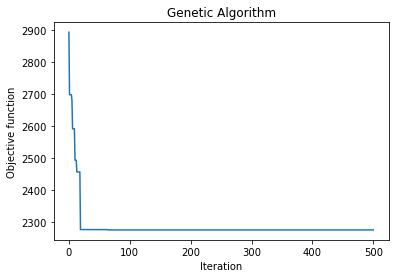

In [55]:
model_ga_t2 = geneticalgorithm(function=object_function_t2,
                               dimension=12,
                               variable_type='int',
                               variable_boundaries=varbound,
                               algorithm_parameters=algorithm_param)

model_ga_t2.run()

In [56]:
convergence_t2 = model_ga_t2.report
solution_t2 = model_ga_t2.output_dict

print(convergence_t2)
print(solution_t2)

[2892.144775117553, 2697.095533610919, 2697.095533610919, 2697.095533610919, 2697.095533610919, 2679.432630961183, 2590.8885972419585, 2590.8885972419585, 2590.8885972419585, 2590.8885972419585, 2492.6819619706707, 2492.6819619706707, 2492.6819619706707, 2455.9093110976582, 2455.9093110976582, 2455.9093110976582, 2455.9093110976582, 2455.9093110976582, 2455.9093110976582, 2275.9816701856407, 2275.9816701856407, 2275.9816701856407, 2275.9816701856407, 2275.9816701856407, 2275.9816701856407, 2275.9816701856407, 2275.9816701856407, 2275.9816701856407, 2275.9816701856407, 2275.9816701856407, 2275.9816701856407, 2275.9816701856407, 2275.9816701856407, 2275.9816701856407, 2275.9816701856407, 2275.9816701856407, 2275.9816701856407, 2275.9816701856407, 2275.9816701856407, 2275.9816701856407, 2275.9816701856407, 2275.9816701856407, 2275.9816701856407, 2275.9816701856407, 2275.9816701856407, 2275.9816701856407, 2275.9816701856407, 2275.9816701856407, 2275.9816701856407, 2275.9816701856407, 2275.

In [57]:
ga_solution = input_conversion(solution_t2['variable'])
ga_solution = np.array(ga_solution).reshape(1, -1)

ga_solution_df = pd.DataFrame(ga_solution, columns=features)
ga_solution_df

,G1,absences,goout,age,famrel,studytime,Medu,Walc,Mjob_mean_enc,freetime,Fedu,Fjob_mean_enc
0,19.0,75.0,5.0,22.0,1.0,1.0,0.0,1.0,9.152542,5.0,4.0,10.15


In [58]:
Fjob = Fjob_encode[Fjob_encode.isin(ga_solution_df['Fjob_mean_enc'])].index[0]
ga_solution_df['Fjob_mean_enc'] = Fjob
ga_solution_df = ga_solution_df.rename(columns={'Fjob_mean_enc': 'Fjob'})

Mjob = Mjob_encode[Mjob_encode.isin(ga_solution_df['Mjob_mean_enc'])].index[0]
ga_solution_df['Mjob_mean_enc'] = Mjob
ga_solution_df = ga_solution_df.rename(columns={'Mjob_mean_enc': 'Mjob'})
ga_solution_df

,G1,absences,goout,age,famrel,studytime,Medu,Walc,Mjob,freetime,Fedu,Fjob
0,19.0,75.0,5.0,22.0,1.0,1.0,0.0,1.0,at_home,5.0,4.0,at_home


In [59]:
prediction = voting_clf.predict(scaler.transform(ga_solution))
ga_solution_df['G3'] = prediction[0]
ga_solution_t2 = ga_solution_df
ga_solution_t2

,G1,absences,goout,age,famrel,studytime,Medu,Walc,Mjob,freetime,Fedu,Fjob,G3
0,19.0,75.0,5.0,22.0,1.0,1.0,0.0,1.0,at_home,5.0,4.0,at_home,13.151889


#**Task 3. 목표값 탐색 + MC 시뮬레이션**

In [60]:
# [GA 목표값 탐색 + MC 시뮬레이션]
# 중위권 학생 (G3=11)의 결석일수 (absences=0 or 75)에 따른 성적 차이는 어떠한가?

In [61]:
# 0: 'G1',
# 1: 'absences',
# 2: 'goout',
# 3: 'age',
# 4: 'famrel',
# 5: 'studytime',
# 6: 'Medu',
# 7: 'Walc',
# 8: 'Mjob_mean_enc',
# 9: 'freetime',
# 10: 'Fedu',
# 11: 'Fjob_mean_enc'

# varbound = np.array([[df['G1'].min(), df['G1'].max()],
#                      [df['absences'].min(), df['absences'].max()],
#                      [df['goout'].min(), df['goout'].max()],
#                      [df['age'].min(), df['age'].max()],
#                      [df['famrel'].min(), df['famrel'].max()],                     
#                      [df['studytime'].min(), df['studytime'].max()],
#                      [df['Medu'].min(), df['Medu'].max()],
#                      [df['Walc'].min(), df['Walc'].max()],
#                      [0, len(Mjob_encode) - 1],
#                      [df['freetime'].min(), df['freetime'].max()],
#                      [df['Fedu'].min(), df['Fedu'].max()],                     
#                      [0, len(Fjob_encode) - 1]])

varbound = np.array([[df['G1'].min(), df['G1'].max()],
                     [df['absences'].min(), df['absences'].max()],
                     [df['goout'].min(), df['goout'].max()],
                     [df['age'].min(), df['age'].max()],
                     [df['famrel'].min(), df['famrel'].max()],                     
                     [df['studytime'].min(), df['studytime'].max()],
                     [df['Medu'].min(), df['Medu'].max()],
                     [df['Walc'].min(), df['Walc'].max()],
                     [0, len(Mjob_encode) - 1],
                     [df['freetime'].min(), df['freetime'].max()],
                     [df['Fedu'].min(), df['Fedu'].max()],                     
                     [0, len(Fjob_encode) - 1]])

In [62]:
def object_function_t3(x_input, target_model=voting_clf):
    input_converted = input_conversion(x_input)
    input_converted = np.array(input_converted).reshape(1, -1)

    input_scaled = scaler.transform(input_converted)
    prediction = target_model.predict(input_scaled)

    target = 11.0
    print('Predicted views:', prediction[0], 'Difference from target:', prediction[0] - target)
    
    return math.log(abs(target - prediction[0])) 

Predicted views: 3.0254697247558773 Difference from target: -7.974530275244122
Predicted views: 6.35364230781024 Difference from target: -4.64635769218976
Predicted views: 16.615690054348576 Difference from target: 5.615690054348576
Predicted views: 3.463425150389606 Difference from target: -7.536574849610394
Predicted views: 8.202357753337813 Difference from target: -2.7976422466621873
Predicted views: 10.472849078310583 Difference from target: -0.527150921689417
Predicted views: 13.829320633898542 Difference from target: 2.8293206338985417
Predicted views: 9.094176937792746 Difference from target: -1.9058230622072543
Predicted views: 5.760181437298651 Difference from target: -5.239818562701349
Predicted views: 13.445996326896385 Difference from target: 2.4459963268963847
Predicted views: 11.779632865197305 Difference from target: 0.7796328651973052
Predicted views: 4.065433961311952 Difference from target: -6.934566038688048
Predicted views: 8.38699251323459 Difference from target: -

Predicted views: 15.041196977696572 Difference from target: 4.041196977696572
Predicted views: 14.128627718573336 Difference from target: 3.1286277185733358
Predicted views: 12.49046094836718 Difference from target: 1.4904609483671791
Predicted views: 10.655363151732297 Difference from target: -0.3446368482677027
Predicted views: 17.05708714944422 Difference from target: 6.0570871494442216
Predicted views: 11.455689720815599 Difference from target: 0.4556897208155988
Predicted views: 11.3260317819217 Difference from target: 0.32603178192169935
Predicted views: 14.589830463808022 Difference from target: 3.5898304638080223
Predicted views: 5.862980723292398 Difference from target: -5.137019276707602
Predicted views: 13.342522172362342 Difference from target: 2.342522172362342
Predicted views: 17.167165462579536 Difference from target: 6.167165462579536
Predicted views: 1.8647094390378893 Difference from target: -9.13529056096211
Predicted views: 8.216310882107132 Difference from target: 

Predicted views: 11.557795445558918 Difference from target: 0.5577954455589182
Predicted views: 3.455959028492772 Difference from target: -7.544040971507227
Predicted views: 11.678384878616725 Difference from target: 0.6783848786167255
Predicted views: 14.258347905786644 Difference from target: 3.2583479057866445
Predicted views: 10.152498974077313 Difference from target: -0.8475010259226874
Predicted views: 6.54206442025658 Difference from target: -4.45793557974342
Predicted views: 11.08568814560905 Difference from target: 0.08568814560904947
Predicted views: 11.136323554578235 Difference from target: 0.13632355457823486
Predicted views: 9.095000516548643 Difference from target: -1.9049994834513573
Predicted views: 7.687249862688939 Difference from target: -3.3127501373110606
Predicted views: 11.076670205897358 Difference from target: 0.07667020589735785
Predicted views: 8.165031273870449 Difference from target: -2.834968726129551
Predicted views: 11.948203746588606 Difference from ta

Predicted views: 10.967619053962721 Difference from target: -0.03238094603727859
Predicted views: 8.985865080205746 Difference from target: -2.0141349197942535
Predicted views: 8.974762478620084 Difference from target: -2.025237521379916
Predicted views: 11.205308841679255 Difference from target: 0.20530884167925478
Predicted views: 10.829076217952727 Difference from target: -0.17092378204727332
Predicted views: 12.145050468628826 Difference from target: 1.1450504686288259
Predicted views: 11.827228235787553 Difference from target: 0.8272282357875529
Predicted views: 11.227157415066527 Difference from target: 0.22715741506652698
Predicted views: 15.333691619704945 Difference from target: 4.333691619704945
Predicted views: 11.605291279065845 Difference from target: 0.6052912790658453
Predicted views: 8.436697783688194 Difference from target: -2.563302216311806
Predicted views: 7.956059832043486 Difference from target: -3.0439401679565137
Predicted views: 9.978215569932761 Difference fro

Predicted views: 10.434823523463592 Difference from target: -0.5651764765364078
Predicted views: 11.179442402980799 Difference from target: 0.17944240298079883
Predicted views: 11.236363356774831 Difference from target: 0.2363633567748309
Predicted views: 9.854622176718207 Difference from target: -1.1453778232817928
Predicted views: 13.811974092891456 Difference from target: 2.8119740928914556
Predicted views: 11.390243457830515 Difference from target: 0.39024345783051473
Predicted views: 11.198736250876614 Difference from target: 0.19873625087661395
Predicted views: 12.029703849878908 Difference from target: 1.0297038498789082
Predicted views: 14.554432354107362 Difference from target: 3.5544323541073624
Predicted views: 12.717970984223038 Difference from target: 1.7179709842230384
Predicted views: 10.691335542087474 Difference from target: -0.30866445791252595
Predicted views: 12.604098913090885 Difference from target: 1.6040989130908851
Predicted views: 5.900714498590927 Difference 

Predicted views: 10.576137312135776 Difference from target: -0.423862687864224
Predicted views: 10.319419730571935 Difference from target: -0.6805802694280647
Predicted views: 10.715688601002247 Difference from target: -0.2843113989977528
Predicted views: 11.106952616078297 Difference from target: 0.10695261607829742
Predicted views: 13.127481920593022 Difference from target: 2.1274819205930218
Predicted views: 13.245735237982522 Difference from target: 2.2457352379825224
Predicted views: 14.789543584380079 Difference from target: 3.7895435843800787
Predicted views: 6.398703942050744 Difference from target: -4.601296057949256
Predicted views: 11.138427755678748 Difference from target: 0.1384277556787481
Predicted views: 14.398400143818884 Difference from target: 3.3984001438188844
Predicted views: 10.91278528292907 Difference from target: -0.08721471707093009
Predicted views: 10.82536049020922 Difference from target: -0.17463950979077936
Predicted views: 11.67841168373974 Difference fr

Predicted views: 10.248203035530597 Difference from target: -0.7517969644694027
Predicted views: 8.163843945034072 Difference from target: -2.8361560549659277
Predicted views: 12.337637012001956 Difference from target: 1.3376370120019558
Predicted views: 11.51247993698235 Difference from target: 0.5124799369823503
Predicted views: 10.374008463544309 Difference from target: -0.6259915364556914
Predicted views: 10.995416435886469 Difference from target: -0.004583564113531224
__________________________________________________ 1.0% GA is running...Predicted views: 10.95073092811112 Difference from target: -0.04926907188887952
Predicted views: 10.948519707768654 Difference from target: -0.051480292231346425
Predicted views: 8.866193607071986 Difference from target: -2.1338063929280136
Predicted views: 12.085306330715747 Difference from target: 1.0853063307157473
Predicted views: 10.35544564355329 Difference from target: -0.6445543564467098
Predicted views: 11.016181893932407 Difference from

Predicted views: 13.213105166297675 Difference from target: 2.213105166297675
Predicted views: 10.558545491513394 Difference from target: -0.44145450848660595
Predicted views: 11.66377804122049 Difference from target: 0.6637780412204908
Predicted views: 11.80256763834038 Difference from target: 0.8025676383403795
Predicted views: 10.569052846503576 Difference from target: -0.4309471534964242
Predicted views: 7.466878478423069 Difference from target: -3.5331215215769314
Predicted views: 11.287750775611096 Difference from target: 0.2877507756110962
Predicted views: 5.092769972058696 Difference from target: -5.907230027941304
Predicted views: 12.059683231445666 Difference from target: 1.059683231445666
Predicted views: 16.52974663156945 Difference from target: 5.529746631569449
Predicted views: 10.906337594366446 Difference from target: -0.09366240563355355
Predicted views: 10.53316079651757 Difference from target: -0.46683920348242935
Predicted views: 10.822298183525456 Difference from t

Predicted views: 14.022618232428721 Difference from target: 3.022618232428721
Predicted views: 10.799578777963163 Difference from target: -0.20042122203683732
Predicted views: 11.03817627096005 Difference from target: 0.03817627096005083
Predicted views: 12.176412944532968 Difference from target: 1.1764129445329683
Predicted views: 12.697042901380442 Difference from target: 1.697042901380442
Predicted views: 10.491874898191737 Difference from target: -0.5081251018082629
Predicted views: 12.229088024822893 Difference from target: 1.229088024822893
Predicted views: 11.996966616433168 Difference from target: 0.9969666164331681
Predicted views: 10.645376666957574 Difference from target: -0.35462333304242577
Predicted views: 11.320880958463233 Difference from target: 0.32088095846323306
Predicted views: 10.397118336376524 Difference from target: -0.6028816636234762
Predicted views: 9.303017549760282 Difference from target: -1.6969824502397177
Predicted views: 6.701392017503562 Difference fr

Predicted views: 6.389730089138953 Difference from target: -4.610269910861047
Predicted views: 10.93140470780994 Difference from target: -0.06859529219006077
Predicted views: 10.827520850529107 Difference from target: -0.1724791494708935
Predicted views: 11.436275900870783 Difference from target: 0.4362759008707826
Predicted views: 10.143329097829753 Difference from target: -0.8566709021702472
Predicted views: 11.509169136138405 Difference from target: 0.5091691361384054
Predicted views: 11.299829897887157 Difference from target: 0.2998298978871574
Predicted views: 12.454554228555438 Difference from target: 1.4545542285554376
Predicted views: 17.56196337774454 Difference from target: 6.56196337774454
Predicted views: 10.777520106546953 Difference from target: -0.22247989345304653
Predicted views: 12.245521294775473 Difference from target: 1.2455212947754735
Predicted views: 11.16392186249467 Difference from target: 0.16392186249466967
Predicted views: 11.260623171564049 Difference from

Predicted views: 9.636795887364867 Difference from target: -1.3632041126351329
Predicted views: 12.978452592340517 Difference from target: 1.978452592340517
Predicted views: 12.806891854456737 Difference from target: 1.8068918544567367
Predicted views: 9.182218173083974 Difference from target: -1.8177818269160255
Predicted views: 12.44047481471148 Difference from target: 1.4404748147114805
Predicted views: 11.280385603655466 Difference from target: 0.28038560365546594
Predicted views: 10.56723625423758 Difference from target: -0.43276374576242027
Predicted views: 11.739947941739649 Difference from target: 0.7399479417396488
Predicted views: 11.722558167539347 Difference from target: 0.7225581675393471
Predicted views: 12.949121890118336 Difference from target: 1.9491218901183363
Predicted views: 11.541920213124785 Difference from target: 0.5419202131247847
Predicted views: 10.643935626609318 Difference from target: -0.35606437339068187
Predicted views: 10.421105697989448 Difference fro

Predicted views: 9.199405231350552 Difference from target: -1.8005947686494483
Predicted views: 11.812419320341965 Difference from target: 0.8124193203419647
Predicted views: 5.788843339617828 Difference from target: -5.211156660382172
Predicted views: 12.56520405955816 Difference from target: 1.5652040595581607
Predicted views: 10.962029046263702 Difference from target: -0.03797095373629844
Predicted views: 10.891141252061303 Difference from target: -0.10885874793869732
Predicted views: 12.341143070119275 Difference from target: 1.3411430701192746
Predicted views: 10.83907487258488 Difference from target: -0.16092512741512088
Predicted views: 11.406665077716143 Difference from target: 0.40666507771614313
Predicted views: 10.27441007255827 Difference from target: -0.7255899274417299
Predicted views: 15.846186741668964 Difference from target: 4.846186741668964
Predicted views: 10.975155140623059 Difference from target: -0.02484485937694103
Predicted views: 11.517738285651019 Difference 

Predicted views: 11.485010284878866 Difference from target: 0.4850102848788662
Predicted views: 10.701375085324722 Difference from target: -0.29862491467527796
Predicted views: 10.176595931205647 Difference from target: -0.8234040687943533
Predicted views: 11.897422112071169 Difference from target: 0.897422112071169
Predicted views: 14.258028698653272 Difference from target: 3.2580286986532716
Predicted views: 9.985714225654565 Difference from target: -1.014285774345435
Predicted views: 11.224889269919615 Difference from target: 0.22488926991961478
Predicted views: 11.742022509070226 Difference from target: 0.7420225090702264
Predicted views: 8.88856042400508 Difference from target: -2.11143957599492
Predicted views: 10.24222038380965 Difference from target: -0.7577796161903496
Predicted views: 11.901947263265553 Difference from target: 0.9019472632655532
Predicted views: 12.172851300821227 Difference from target: 1.1728513008212271
Predicted views: 10.363177198713245 Difference from t

Predicted views: 12.246805055648068 Difference from target: 1.2468050556480677
Predicted views: 11.05634425701639 Difference from target: 0.056344257016389676
Predicted views: 10.861131231027123 Difference from target: -0.13886876897287692
Predicted views: 9.108592545053668 Difference from target: -1.8914074549463322
Predicted views: 10.903641414779642 Difference from target: -0.0963585852203579
Predicted views: 11.072751813837824 Difference from target: 0.07275181383782403
Predicted views: 10.830529010227657 Difference from target: -0.16947098977234276
Predicted views: 11.138489917142222 Difference from target: 0.13848991714222159
Predicted views: 11.307720712101423 Difference from target: 0.30772071210142293
Predicted views: 9.490439148948056 Difference from target: -1.509560851051944
Predicted views: 4.8776742078968 Difference from target: -6.1223257921032
Predicted views: 10.979103728911658 Difference from target: -0.020896271088341578
Predicted views: 11.112603349187587 Difference

Predicted views: 10.264747262461341 Difference from target: -0.7352527375386586
Predicted views: 9.870468505077447 Difference from target: -1.1295314949225528
Predicted views: 10.833969226831945 Difference from target: -0.16603077316805503
Predicted views: 11.137227879561257 Difference from target: 0.13722787956125693
Predicted views: 9.53456748168161 Difference from target: -1.4654325183183907
Predicted views: 9.732650179054708 Difference from target: -1.2673498209452916
Predicted views: 9.141621218776836 Difference from target: -1.8583787812231645
Predicted views: 13.828752939372967 Difference from target: 2.8287529393729667
Predicted views: 10.12856151936068 Difference from target: -0.8714384806393198
Predicted views: 10.775607556196453 Difference from target: -0.22439244380354673
Predicted views: 8.25046717161085 Difference from target: -2.7495328283891496
Predicted views: 14.798280369390113 Difference from target: 3.7982803693901133
Predicted views: 10.947861710104704 Difference f

Predicted views: 8.677575769369232 Difference from target: -2.3224242306307676
Predicted views: 12.000901346062713 Difference from target: 1.0009013460627134
Predicted views: 13.180651621629885 Difference from target: 2.1806516216298846
Predicted views: 10.650654445431073 Difference from target: -0.34934555456892724
Predicted views: 11.813005798206776 Difference from target: 0.8130057982067758
Predicted views: 10.760928256413996 Difference from target: -0.23907174358600436
Predicted views: 11.027062395665103 Difference from target: 0.027062395665103267
Predicted views: 10.636847640232938 Difference from target: -0.36315235976706184
Predicted views: 8.785332799420274 Difference from target: -2.2146672005797257
Predicted views: 10.793461557148303 Difference from target: -0.20653844285169676
Predicted views: 9.972862516286126 Difference from target: -1.027137483713874
Predicted views: 16.514410885889344 Difference from target: 5.514410885889344
Predicted views: 9.709690872190068 Differenc

Predicted views: 9.976573183053526 Difference from target: -1.0234268169464737
Predicted views: 12.011294213818518 Difference from target: 1.011294213818518
Predicted views: 9.279184020166737 Difference from target: -1.7208159798332634
Predicted views: 11.13879272371311 Difference from target: 0.13879272371310947
Predicted views: 6.328734920800483 Difference from target: -4.671265079199517
Predicted views: 9.722240991606478 Difference from target: -1.277759008393522
Predicted views: 9.992405322603911 Difference from target: -1.0075946773960887
|_________________________________________________ 2.6% GA is running...Predicted views: 10.983986323329418 Difference from target: -0.016013676670581845
Predicted views: 9.25016027066962 Difference from target: -1.7498397293303807
Predicted views: 10.52915388133262 Difference from target: -0.4708461186673798
Predicted views: 10.839030559200042 Difference from target: -0.160969440799958
Predicted views: 11.219321384217816 Difference from target: 

Predicted views: 10.081634450442827 Difference from target: -0.9183655495571728
Predicted views: 10.13851521616383 Difference from target: -0.8614847838361701
Predicted views: 9.47082179645088 Difference from target: -1.5291782035491206
Predicted views: 11.392727012289244 Difference from target: 0.3927270122892441
Predicted views: 12.266358089321571 Difference from target: 1.266358089321571
Predicted views: 11.699520844196053 Difference from target: 0.6995208441960532
Predicted views: 10.224078807300574 Difference from target: -0.7759211926994265
Predicted views: 10.63361118504501 Difference from target: -0.36638881495498943
Predicted views: 10.462698340061399 Difference from target: -0.5373016599386009
Predicted views: 10.897743988579736 Difference from target: -0.10225601142026441
Predicted views: 11.127043648775242 Difference from target: 0.127043648775242
Predicted views: 10.355504431711116 Difference from target: -0.6444955682888835
Predicted views: 4.082116646930899 Difference fr

Predicted views: 11.823784974936112 Difference from target: 0.8237849749361121
Predicted views: 9.31147559568812 Difference from target: -1.6885244043118792
Predicted views: 10.882382401011242 Difference from target: -0.11761759898875823
Predicted views: 15.366559665532755 Difference from target: 4.366559665532755
Predicted views: 11.259064035986727 Difference from target: 0.2590640359867269
Predicted views: 10.947334653408978 Difference from target: -0.052665346591021844
Predicted views: 11.005664830252975 Difference from target: 0.00566483025297515
Predicted views: 10.663809333891258 Difference from target: -0.3361906661087417
Predicted views: 10.59363431875875 Difference from target: -0.4063656812412493
Predicted views: 15.336402129208745 Difference from target: 4.336402129208745
Predicted views: 10.943311947586855 Difference from target: -0.05668805241314523
Predicted views: 10.613819913668388 Difference from target: -0.3861800863316116
Predicted views: 11.034311417217879 Differenc

Predicted views: 13.6656007478069 Difference from target: 2.6656007478069004
Predicted views: 9.156522923099207 Difference from target: -1.8434770769007933
Predicted views: 11.01959764664961 Difference from target: 0.0195976466496095
Predicted views: 10.43192951335263 Difference from target: -0.56807048664737
Predicted views: 11.276980579193625 Difference from target: 0.2769805791936246
Predicted views: 10.078146769589441 Difference from target: -0.9218532304105587
Predicted views: 9.137529466006244 Difference from target: -1.862470533993756
Predicted views: 10.403855642058781 Difference from target: -0.5961443579412187
Predicted views: 10.67113564696786 Difference from target: -0.3288643530321398
Predicted views: 10.61153148054676 Difference from target: -0.3884685194532391
Predicted views: 10.734408535609179 Difference from target: -0.2655914643908215
Predicted views: 14.000255847287152 Difference from target: 3.0002558472871517
Predicted views: 9.886159797556516 Difference from targ

||________________________________________________ 3.2% GA is running...Predicted views: 10.642610711413033 Difference from target: -0.35738928858696717
Predicted views: 11.365897769160194 Difference from target: 0.3658977691601937
Predicted views: 10.351382873952565 Difference from target: -0.6486171260474354
Predicted views: 11.081630934425098 Difference from target: 0.08163093442509783
Predicted views: 9.759453081284603 Difference from target: -1.2405469187153972
Predicted views: 9.889390537005257 Difference from target: -1.1106094629947432
Predicted views: 9.920764932283738 Difference from target: -1.0792350677162617
Predicted views: 10.556722299769365 Difference from target: -0.4432777002306345
Predicted views: 15.076641345672314 Difference from target: 4.076641345672314
Predicted views: 10.051370567955336 Difference from target: -0.9486294320446635
Predicted views: 11.295270328129542 Difference from target: 0.2952703281295417
Predicted views: 10.08226533151768 Difference from tar

Predicted views: 11.39057464594263 Difference from target: 0.39057464594263
Predicted views: 9.478769245676 Difference from target: -1.5212307543239998
Predicted views: 10.434332904328873 Difference from target: -0.5656670956711274
Predicted views: 11.162633043709357 Difference from target: 0.1626330437093575
Predicted views: 8.922212045906344 Difference from target: -2.0777879540936564
Predicted views: 10.219329027254979 Difference from target: -0.7806709727450212
Predicted views: 10.3809474521848 Difference from target: -0.6190525478151994
Predicted views: 10.725303536557917 Difference from target: -0.2746964634420834
Predicted views: 10.919087886629818 Difference from target: -0.08091211337018223
Predicted views: 9.414184279243754 Difference from target: -1.585815720756246
Predicted views: 10.352465707818956 Difference from target: -0.6475342921810441
Predicted views: 10.50213799124171 Difference from target: -0.4978620087582897
Predicted views: 14.490408182638257 Difference from ta

Predicted views: 9.455428822734504 Difference from target: -1.544571177265496
Predicted views: 10.925282179278916 Difference from target: -0.07471782072108368
Predicted views: 14.770123424551635 Difference from target: 3.7701234245516346
Predicted views: 11.123897358040923 Difference from target: 0.12389735804092261
Predicted views: 9.335613369330646 Difference from target: -1.6643866306693536
Predicted views: 10.990786305017963 Difference from target: -0.009213694982037168
Predicted views: 10.479450577608597 Difference from target: -0.5205494223914027
Predicted views: 10.146297276178194 Difference from target: -0.8537027238218062
Predicted views: 10.662685892733887 Difference from target: -0.33731410726611344
Predicted views: 9.937671745451656 Difference from target: -1.0623282545483441
Predicted views: 10.179191009796972 Difference from target: -0.8208089902030284
Predicted views: 10.613615814102197 Difference from target: -0.38638418589780343
Predicted views: 11.16526320086704 Diffe

Predicted views: 11.132964132220538 Difference from target: 0.13296413222053793
Predicted views: 10.599168024126078 Difference from target: -0.4008319758739223
Predicted views: 10.267658218653573 Difference from target: -0.7323417813464275
Predicted views: 6.578668422947255 Difference from target: -4.421331577052745
Predicted views: 10.783247488442086 Difference from target: -0.21675251155791386
Predicted views: 10.10617160478233 Difference from target: -0.8938283952176693
Predicted views: 11.703988620529744 Difference from target: 0.7039886205297439
Predicted views: 14.209006057485093 Difference from target: 3.2090060574850927
Predicted views: 12.419691272461733 Difference from target: 1.4196912724617334
Predicted views: 7.5014095544270845 Difference from target: -3.4985904455729155
Predicted views: 16.542988521675877 Difference from target: 5.542988521675877
Predicted views: 10.818015055271886 Difference from target: -0.18198494472811433
Predicted views: 10.740396631689478 Difference

Predicted views: 11.207448169394668 Difference from target: 0.20744816939466837
Predicted views: 11.292009967787246 Difference from target: 0.2920099677872461
Predicted views: 10.528289629954145 Difference from target: -0.47171037004585514
Predicted views: 9.681426054647613 Difference from target: -1.3185739453523873
Predicted views: 9.791321373148847 Difference from target: -1.2086786268511531
Predicted views: 10.663591921728095 Difference from target: -0.336408078271905
Predicted views: 10.454033340082283 Difference from target: -0.5459666599177169
Predicted views: 10.497523592954378 Difference from target: -0.5024764070456218
Predicted views: 10.303971673590192 Difference from target: -0.6960283264098077
Predicted views: 9.979512923526398 Difference from target: -1.0204870764736018
Predicted views: 9.83339135853276 Difference from target: -1.1666086414672403
Predicted views: 10.262367745552531 Difference from target: -0.7376322544474689
Predicted views: 17.15576983115383 Difference 

Predicted views: 10.590810671469528 Difference from target: -0.40918932853047174
Predicted views: 11.10455482774347 Difference from target: 0.10455482774347047
Predicted views: 11.30776398269706 Difference from target: 0.3077639826970593
Predicted views: 10.721190796740933 Difference from target: -0.2788092032590672
Predicted views: 10.565070201264895 Difference from target: -0.43492979873510507
Predicted views: 11.40435547555728 Difference from target: 0.4043554755572796
Predicted views: 10.955989809884501 Difference from target: -0.04401019011549856
Predicted views: 12.164092841081525 Difference from target: 1.1640928410815246
Predicted views: 10.416693631088602 Difference from target: -0.5833063689113978
Predicted views: 10.417230693385866 Difference from target: -0.582769306614134
Predicted views: 11.865473564105258 Difference from target: 0.8654735641052582
Predicted views: 3.1160953062816024 Difference from target: -7.883904693718398
Predicted views: 11.49863081308127 Difference 

Predicted views: 11.166311094277821 Difference from target: 0.16631109427782143
Predicted views: 11.547289719264157 Difference from target: 0.5472897192641568
Predicted views: 11.198709001263529 Difference from target: 0.19870900126352886
Predicted views: 8.870787890613189 Difference from target: -2.1292121093868115
Predicted views: 10.66086376462169 Difference from target: -0.3391362353783105
Predicted views: 10.654228571752144 Difference from target: -0.3457714282478559
Predicted views: 10.368239195869526 Difference from target: -0.6317608041304741
Predicted views: 9.952593624233842 Difference from target: -1.0474063757661582
Predicted views: 11.113368472042724 Difference from target: 0.11336847204272438
Predicted views: 9.948730081794894 Difference from target: -1.0512699182051062
Predicted views: 9.776546929120018 Difference from target: -1.223453070879982
Predicted views: 10.043365013024182 Difference from target: -0.9566349869758177
Predicted views: 12.783179785641678 Difference 

Predicted views: 8.136672931410361 Difference from target: -2.863327068589639
Predicted views: 15.185652391584076 Difference from target: 4.185652391584076
Predicted views: 10.772849264884647 Difference from target: -0.22715073511535344
Predicted views: 11.225486822451339 Difference from target: 0.2254868224513391
Predicted views: 10.935765845042328 Difference from target: -0.06423415495767237
Predicted views: 11.36223623258906 Difference from target: 0.36223623258906024
Predicted views: 14.38038518432983 Difference from target: 3.38038518432983
Predicted views: 10.824841189486017 Difference from target: -0.17515881051398274
Predicted views: 11.059106138257846 Difference from target: 0.05910613825784594
Predicted views: 10.99115063282578 Difference from target: -0.00884936717421958
Predicted views: 9.960666894300124 Difference from target: -1.0393331056998765
Predicted views: 10.483292278094272 Difference from target: -0.5167077219057283
Predicted views: 10.829193111959654 Difference f

Predicted views: 11.071906341009361 Difference from target: 0.07190634100936144
Predicted views: 10.875531475396736 Difference from target: -0.12446852460326419
Predicted views: 11.248773193286212 Difference from target: 0.24877319328621184
Predicted views: 10.982749514551296 Difference from target: -0.01725048544870411
Predicted views: 11.32432599818821 Difference from target: 0.3243259981882094
Predicted views: 7.150938402346722 Difference from target: -3.849061597653278
Predicted views: 7.8887506206196685 Difference from target: -3.1112493793803315
Predicted views: 10.999816860117628 Difference from target: -0.00018313988237217416
Predicted views: 11.289140944133186 Difference from target: 0.2891409441331856
Predicted views: 11.299136708808541 Difference from target: 0.2991367088085415
Predicted views: 11.31740135076899 Difference from target: 0.31740135076898923
Predicted views: 11.354453551819526 Difference from target: 0.3544535518195264
Predicted views: 11.251965453715101 Differ

Predicted views: 10.925398930137456 Difference from target: -0.07460106986254367
Predicted views: 10.961055460008671 Difference from target: -0.03894453999132885
Predicted views: 11.054678494296667 Difference from target: 0.05467849429666671
Predicted views: 11.007851930242206 Difference from target: 0.00785193024220554
Predicted views: 11.113570307138893 Difference from target: 0.11357030713889316
Predicted views: 12.191302462026188 Difference from target: 1.1913024620261883
Predicted views: 9.713789947636906 Difference from target: -1.286210052363094
Predicted views: 10.832311751319041 Difference from target: -0.16768824868095855
Predicted views: 10.094008658868491 Difference from target: -0.905991341131509
Predicted views: 10.007984422302952 Difference from target: -0.9920155776970478
Predicted views: 11.11387630070739 Difference from target: 0.11387630070739085
Predicted views: 10.76596926859897 Difference from target: -0.23403073140102926
Predicted views: 11.30335610635767 Differe

Predicted views: 10.721948322430187 Difference from target: -0.2780516775698132
Predicted views: 11.779019725206766 Difference from target: 0.7790197252067657
Predicted views: 11.20299000792938 Difference from target: 0.2029900079293796
Predicted views: 9.901265779953937 Difference from target: -1.0987342200460635
Predicted views: 9.755390616370926 Difference from target: -1.244609383629074
Predicted views: 6.2779991738262915 Difference from target: -4.7220008261737085
Predicted views: 8.854346195397191 Difference from target: -2.1456538046028086
Predicted views: 8.875066951266705 Difference from target: -2.124933048733295
Predicted views: 11.312713551997769 Difference from target: 0.31271355199776885
Predicted views: 10.609243131755202 Difference from target: -0.3907568682447984
||________________________________________________ 4.8% GA is running...Predicted views: 10.971446791890079 Difference from target: -0.028553208109920902
Predicted views: 9.854559806202184 Difference from targ

Predicted views: 9.299598942772365 Difference from target: -1.7004010572276353
Predicted views: 11.192343040946616 Difference from target: 0.19234304094661603
Predicted views: 11.160445020851597 Difference from target: 0.16044502085159706
Predicted views: 10.544655496571393 Difference from target: -0.45534450342860744
Predicted views: 14.16761199191527 Difference from target: 3.1676119919152708
Predicted views: 11.22853867821587 Difference from target: 0.2285386782158696
Predicted views: 10.021917114115963 Difference from target: -0.9780828858840369
Predicted views: 10.218055757031381 Difference from target: -0.7819442429686188
Predicted views: 10.29964041227606 Difference from target: -0.7003595877239395
Predicted views: 10.94773829809076 Difference from target: -0.05226170190923973
Predicted views: 10.845621869987289 Difference from target: -0.15437813001271117
Predicted views: 10.039313016501069 Difference from target: -0.9606869834989311
Predicted views: 10.954374269166891 Differen

Predicted views: 10.330734801911833 Difference from target: -0.6692651980881674
Predicted views: 10.724470531005034 Difference from target: -0.2755294689949661
Predicted views: 8.858310177166146 Difference from target: -2.141689822833854
Predicted views: 11.003901527640425 Difference from target: 0.003901527640424618
Predicted views: 10.50071427756418 Difference from target: -0.49928572243582003
Predicted views: 10.76844190019096 Difference from target: -0.23155809980904074
Predicted views: 14.182319646758776 Difference from target: 3.182319646758776
Predicted views: 10.67263918257261 Difference from target: -0.3273608174273903
Predicted views: 10.699521419588928 Difference from target: -0.3004785804110721
Predicted views: 10.775774301226656 Difference from target: -0.22422569877334375
Predicted views: 10.48452694132503 Difference from target: -0.5154730586749707
Predicted views: 11.026589281409423 Difference from target: 0.026589281409423293
Predicted views: 12.418964498391462 Differe

Predicted views: 9.870323154950228 Difference from target: -1.1296768450497723
Predicted views: 9.977369436929427 Difference from target: -1.0226305630705728
Predicted views: 10.929858923552016 Difference from target: -0.07014107644798351
Predicted views: 5.604823696377878 Difference from target: -5.395176303622122
Predicted views: 10.398237613896903 Difference from target: -0.601762386103097
Predicted views: 10.774054617056777 Difference from target: -0.2259453829432232
Predicted views: 11.131672487534269 Difference from target: 0.13167248753426897
Predicted views: 11.105243063615504 Difference from target: 0.10524306361550373
Predicted views: 11.050335925427731 Difference from target: 0.050335925427731354
Predicted views: 10.810149075470123 Difference from target: -0.1898509245298765
Predicted views: 9.12667336919368 Difference from target: -1.8733266308063197
Predicted views: 11.054392446791823 Difference from target: 0.05439244679182309
Predicted views: 10.280633411251138 Differenc

|||_______________________________________________ 5.4% GA is running...Predicted views: 10.954636658311008 Difference from target: -0.04536334168899181
Predicted views: 10.993887297533924 Difference from target: -0.006112702466076314
Predicted views: 5.084088012142728 Difference from target: -5.915911987857272
Predicted views: 14.497752937324712 Difference from target: 3.4977529373247123
Predicted views: 10.079944188469995 Difference from target: -0.9200558115300055
Predicted views: 11.864252899769042 Difference from target: 0.864252899769042
Predicted views: 10.71153898841301 Difference from target: -0.2884610115869908
Predicted views: 10.98425996097424 Difference from target: -0.0157400390257596
Predicted views: 5.388427871416428 Difference from target: -5.611572128583572
Predicted views: 9.207962174146049 Difference from target: -1.792037825853951
Predicted views: 10.867936202653349 Difference from target: -0.1320637973466514
Predicted views: 15.951639155307925 Difference from targ

Predicted views: 10.870748835965687 Difference from target: -0.12925116403431325
Predicted views: 10.941526668410766 Difference from target: -0.058473331589233624
Predicted views: 10.366818207249457 Difference from target: -0.633181792750543
Predicted views: 10.191524489588586 Difference from target: -0.8084755104114141
Predicted views: 10.48265766203881 Difference from target: -0.5173423379611908
Predicted views: 10.651616381683105 Difference from target: -0.3483836183168947
Predicted views: 10.90461844826755 Difference from target: -0.09538155173244967
Predicted views: 11.142309416709738 Difference from target: 0.14230941670973785
Predicted views: 13.601395237557448 Difference from target: 2.6013952375574476
Predicted views: 10.73775194717264 Difference from target: -0.26224805282735986
Predicted views: 14.817594094125036 Difference from target: 3.8175940941250364
Predicted views: 10.875627889978169 Difference from target: -0.1243721100218309
Predicted views: 11.184321573663452 Diffe

Predicted views: 10.028336762898759 Difference from target: -0.9716632371012413
Predicted views: 10.479236560655506 Difference from target: -0.5207634393444938
Predicted views: 10.563673741923612 Difference from target: -0.43632625807638803
Predicted views: 10.655945373043055 Difference from target: -0.3440546269569449
Predicted views: 11.376169594632701 Difference from target: 0.3761695946327013
Predicted views: 9.96702749779631 Difference from target: -1.0329725022036893
Predicted views: 9.248066076179201 Difference from target: -1.7519339238207987
Predicted views: 10.594968828532467 Difference from target: -0.40503117146753276
Predicted views: 10.797908040136356 Difference from target: -0.20209195986364392
Predicted views: 10.732933310429132 Difference from target: -0.26706668957086777
Predicted views: 11.30353684484492 Difference from target: 0.3035368448449205
Predicted views: 11.17523679631424 Difference from target: 0.17523679631423938
Predicted views: 9.739333200631114 Differen

Predicted views: 9.936245369831946 Difference from target: -1.063754630168054
Predicted views: 11.021264139520795 Difference from target: 0.02126413952079531
Predicted views: 7.870117476708188 Difference from target: -3.129882523291812
Predicted views: 9.745931541993157 Difference from target: -1.2540684580068433
Predicted views: 10.869386964871916 Difference from target: -0.13061303512808387
Predicted views: 10.055443967407724 Difference from target: -0.9445560325922759
Predicted views: 11.505513549484997 Difference from target: 0.5055135494849967
Predicted views: 10.446905609866262 Difference from target: -0.5530943901337384
Predicted views: 10.814515561966724 Difference from target: -0.18548443803327608
Predicted views: 10.789269140620911 Difference from target: -0.21073085937908864
Predicted views: 10.495025458464687 Difference from target: -0.5049745415353133
Predicted views: 11.032573970174509 Difference from target: 0.032573970174508915
Predicted views: 10.918156569182353 Differ

|||_______________________________________________ 6.0% GA is running...Predicted views: 10.45653384136509 Difference from target: -0.5434661586349101
Predicted views: 11.110158146187471 Difference from target: 0.11015814618747122
Predicted views: 11.157496531797824 Difference from target: 0.15749653179782364
Predicted views: 11.0632524021755 Difference from target: 0.06325240217550032
Predicted views: 10.982085176951093 Difference from target: -0.01791482304890657
Predicted views: 4.90070849375635 Difference from target: -6.09929150624365
Predicted views: 11.063788177245025 Difference from target: 0.06378817724502461
Predicted views: 10.999875167818223 Difference from target: -0.00012483218177727906
Predicted views: 11.246405174101653 Difference from target: 0.2464051741016533
Predicted views: 10.47878056963423 Difference from target: -0.52121943036577
Predicted views: 10.795426235934935 Difference from target: -0.20457376406506533
Predicted views: 10.396455310577712 Difference from t

Predicted views: 11.020420885756627 Difference from target: 0.020420885756626816
Predicted views: 11.00455151471516 Difference from target: 0.004551514715160465
Predicted views: 10.903915994242228 Difference from target: -0.09608400575777232
Predicted views: 10.955666483312564 Difference from target: -0.0443335166874359
Predicted views: 10.982675726084507 Difference from target: -0.017324273915493293
Predicted views: 10.221239224936262 Difference from target: -0.7787607750637378
Predicted views: 10.518688836794702 Difference from target: -0.481311163205298
Predicted views: 10.526877006105199 Difference from target: -0.47312299389480117
Predicted views: 10.59857905324697 Difference from target: -0.40142094675302964
Predicted views: 9.767046116739335 Difference from target: -1.2329538832606648
Predicted views: 12.723510015451685 Difference from target: 1.7235100154516854
Predicted views: 11.19638902626796 Difference from target: 0.19638902626796018
Predicted views: 11.142309416709738 Dif

Predicted views: 11.093091625587064 Difference from target: 0.09309162558706419
Predicted views: 11.525636574686802 Difference from target: 0.5256365746868017
Predicted views: 11.253262902773232 Difference from target: 0.2532629027732316
Predicted views: 10.62433010274868 Difference from target: -0.3756698972513206
Predicted views: 9.889690750640197 Difference from target: -1.110309249359803
Predicted views: 11.084922005315818 Difference from target: 0.08492200531581773
Predicted views: 10.822457183861461 Difference from target: -0.17754281613853884
Predicted views: 10.440842794207567 Difference from target: -0.5591572057924328
Predicted views: 16.42408062962475 Difference from target: 5.424080629624751
Predicted views: 9.006507357734527 Difference from target: -1.9934926422654726
Predicted views: 9.923506759145953 Difference from target: -1.076493240854047
Predicted views: 9.939894345982978 Difference from target: -1.060105654017022
Predicted views: 13.310328232330088 Difference from 

Predicted views: 10.201266395496475 Difference from target: -0.7987336045035249
Predicted views: 10.628533310931664 Difference from target: -0.37146668906833646
Predicted views: 10.971152205322563 Difference from target: -0.028847794677437477
Predicted views: 10.306065797393272 Difference from target: -0.6939342026067283
Predicted views: 10.64134768128469 Difference from target: -0.35865231871530945
Predicted views: 10.681213623097179 Difference from target: -0.3187863769028212
Predicted views: 10.999875167818223 Difference from target: -0.00012483218177727906
Predicted views: 9.971124401358898 Difference from target: -1.0288755986411022
Predicted views: 13.989703720281597 Difference from target: 2.9897037202815966
Predicted views: 10.974129603448601 Difference from target: -0.02587039655139911
Predicted views: 7.397672961528886 Difference from target: -3.602327038471114
Predicted views: 10.483923131450753 Difference from target: -0.5160768685492467
Predicted views: 10.584975203009245 

|||_______________________________________________ 6.6% GA is running...Predicted views: 11.190893855590161 Difference from target: 0.19089385559016137
Predicted views: 10.519391879294808 Difference from target: -0.48060812070519177
Predicted views: 6.964721515224873 Difference from target: -4.035278484775127
Predicted views: 11.141398462494896 Difference from target: 0.1413984624948963
Predicted views: 13.18755348450911 Difference from target: 2.1875534845091096
Predicted views: 10.311472418371809 Difference from target: -0.6885275816281915
Predicted views: 8.748616507900417 Difference from target: -2.251383492099583
Predicted views: 11.161667412922695 Difference from target: 0.1616674129226947
Predicted views: 10.76338620936779 Difference from target: -0.23661379063221055
Predicted views: 10.96729335611578 Difference from target: -0.032706643884219844
Predicted views: 8.838097710965648 Difference from target: -2.1619022890343516
Predicted views: 10.873344864975389 Difference from tar

Predicted views: 11.073517303459349 Difference from target: 0.07351730345934904
Predicted views: 11.268374618715503 Difference from target: 0.2683746187155034
Predicted views: 11.339257814348995 Difference from target: 0.33925781434899527
Predicted views: 10.958861472789524 Difference from target: -0.04113852721047628
Predicted views: 13.393215540819417 Difference from target: 2.3932155408194173
Predicted views: 11.063644971821132 Difference from target: 0.06364497182113205
Predicted views: 11.484735502396097 Difference from target: 0.48473550239609686
Predicted views: 10.866729156132868 Difference from target: -0.13327084386713217
Predicted views: 10.431581046162163 Difference from target: -0.5684189538378366
Predicted views: 12.438322785896538 Difference from target: 1.4383227858965384
Predicted views: 10.940722272556956 Difference from target: -0.05927772744304427
Predicted views: 11.432231653380425 Difference from target: 0.43223165338042513
Predicted views: 10.624099041028899 Diff

Predicted views: 10.616873760686866 Difference from target: -0.3831262393131336
Predicted views: 10.550032441479738 Difference from target: -0.44996755852026205
Predicted views: 10.695189454743954 Difference from target: -0.30481054525604634
Predicted views: 11.238707613946568 Difference from target: 0.23870761394656803
Predicted views: 9.840059833690644 Difference from target: -1.1599401663093563
Predicted views: 8.877556643727152 Difference from target: -2.122443356272848
Predicted views: 17.10354904392592 Difference from target: 6.10354904392592
Predicted views: 5.980015996955797 Difference from target: -5.019984003044203
Predicted views: 9.058614508150384 Difference from target: -1.9413854918496156
Predicted views: 11.790623936977612 Difference from target: 0.790623936977612
Predicted views: 10.867847515570247 Difference from target: -0.1321524844297528
Predicted views: 11.580547772437896 Difference from target: 0.580547772437896
Predicted views: 11.013127681690342 Difference from 

Predicted views: 12.141388156102494 Difference from target: 1.1413881561024937
Predicted views: 10.809753519786048 Difference from target: -0.1902464802139523
Predicted views: 10.732565193486579 Difference from target: -0.2674348065134211
Predicted views: 15.339535163505785 Difference from target: 4.339535163505785
Predicted views: 10.690393674933688 Difference from target: -0.30960632506631214
Predicted views: 10.233014723249008 Difference from target: -0.7669852767509919
Predicted views: 9.744852799055666 Difference from target: -1.255147200944334
Predicted views: 8.808129271811175 Difference from target: -2.1918707281888246
Predicted views: 15.915162550852095 Difference from target: 4.915162550852095
Predicted views: 10.388750026034483 Difference from target: -0.6112499739655171
Predicted views: 9.489535734716771 Difference from target: -1.510464265283229
Predicted views: 10.966467681657926 Difference from target: -0.03353231834207371
Predicted views: 10.852882329137737 Difference f

Predicted views: 13.393582342627958 Difference from target: 2.3935823426279583
Predicted views: 10.253686306019416 Difference from target: -0.7463136939805839
Predicted views: 9.817188048384061 Difference from target: -1.182811951615939
Predicted views: 14.455816872428462 Difference from target: 3.4558168724284624
Predicted views: 13.316268793083177 Difference from target: 2.316268793083177
Predicted views: 9.133727119754035 Difference from target: -1.8662728802459654
Predicted views: 10.965311033122454 Difference from target: -0.03468896687754608
Predicted views: 12.897224688750503 Difference from target: 1.8972246887505033
Predicted views: 5.847355832728649 Difference from target: -5.152644167271351
Predicted views: 10.751030421710439 Difference from target: -0.2489695782895609
Predicted views: 15.58968859784145 Difference from target: 4.58968859784145
Predicted views: 6.154800372423728 Difference from target: -4.845199627576272
Predicted views: 11.084652193002839 Difference from tar

Predicted views: 10.416751104152741 Difference from target: -0.5832488958472588
Predicted views: 10.10524004118922 Difference from target: -0.8947599588107806
Predicted views: 10.891821382533815 Difference from target: -0.1081786174661854
Predicted views: 10.9724335235556 Difference from target: -0.02756647644440058
Predicted views: 10.85159408716389 Difference from target: -0.14840591283610927
Predicted views: 10.235657951776018 Difference from target: -0.7643420482239822
Predicted views: 5.376014564576212 Difference from target: -5.623985435423788
Predicted views: 10.961055460008671 Difference from target: -0.03894453999132885
Predicted views: 9.917116280807106 Difference from target: -1.0828837191928944
Predicted views: 10.836123253773144 Difference from target: -0.16387674622685644
Predicted views: 13.885776259256778 Difference from target: 2.8857762592567777
Predicted views: 13.964443995647981 Difference from target: 2.964443995647981
Predicted views: 11.318367129701132 Difference

Predicted views: 11.290270278231576 Difference from target: 0.29027027823157603
Predicted views: 15.07333300106035 Difference from target: 4.07333300106035
Predicted views: 9.583515140389592 Difference from target: -1.4164848596104083
Predicted views: 10.961055460008671 Difference from target: -0.03894453999132885
Predicted views: 11.346620643154926 Difference from target: 0.34662064315492636
Predicted views: 11.083541907032739 Difference from target: 0.083541907032739
Predicted views: 16.63897320587723 Difference from target: 5.638973205877232
Predicted views: 9.412714434622897 Difference from target: -1.587285565377103
Predicted views: 11.228042420432432 Difference from target: 0.22804242043243228
Predicted views: 10.535759812881306 Difference from target: -0.4642401871186941
Predicted views: 6.9703106167306395 Difference from target: -4.0296893832693605
Predicted views: 11.354269662517078 Difference from target: 0.35426966251707803
Predicted views: 11.079019341599562 Difference from

Predicted views: 11.671790641941982 Difference from target: 0.6717906419419819
Predicted views: 11.095766547890051 Difference from target: 0.0957665478900509
Predicted views: 11.037891829260277 Difference from target: 0.037891829260276566
Predicted views: 8.264683410151735 Difference from target: -2.7353165898482654
Predicted views: 8.879556733044247 Difference from target: -2.1204432669557534
Predicted views: 5.74627263881412 Difference from target: -5.25372736118588
Predicted views: 11.936617181801623 Difference from target: 0.9366171818016227
Predicted views: 13.667333816900873 Difference from target: 2.6673338169008733
Predicted views: 11.187944730967445 Difference from target: 0.18794473096744468
Predicted views: 9.444142112769242 Difference from target: -1.5558578872307578
Predicted views: 10.068747308077425 Difference from target: -0.931252691922575
Predicted views: 10.597407292346332 Difference from target: -0.4025927076536675
Predicted views: 5.546100226710699 Difference from 

Predicted views: 10.901130594649596 Difference from target: -0.09886940535040445
Predicted views: 10.968181994272745 Difference from target: -0.03181800572725457
Predicted views: 11.884268889155392 Difference from target: 0.8842688891553916
Predicted views: 10.94804374304006 Difference from target: -0.051956256959940106
Predicted views: 11.237626687940628 Difference from target: 0.2376266879406277
Predicted views: 11.061293299428149 Difference from target: 0.061293299428148984
Predicted views: 10.808167742204597 Difference from target: -0.19183225779540258
Predicted views: 10.897100582078552 Difference from target: -0.10289941792144752
Predicted views: 16.27844068674514 Difference from target: 5.278440686745139
Predicted views: 11.456703163856737 Difference from target: 0.45670316385673715
Predicted views: 11.70699127359486 Difference from target: 0.7069912735948591
Predicted views: 4.61763744600022 Difference from target: -6.38236255399978
Predicted views: 11.067206550348795 Differenc

Predicted views: 11.05258521354026 Difference from target: 0.0525852135402598
Predicted views: 10.931436592189703 Difference from target: -0.0685634078102968
Predicted views: 14.103270456842807 Difference from target: 3.1032704568428073
Predicted views: 11.410654200652132 Difference from target: 0.4106542006521323
Predicted views: 11.174167151978411 Difference from target: 0.17416715197841093
Predicted views: 11.104908015829153 Difference from target: 0.1049080158291531
Predicted views: 9.419998919538656 Difference from target: -1.5800010804613436
Predicted views: 7.727432254293639 Difference from target: -3.272567745706361
Predicted views: 10.592013885676428 Difference from target: -0.4079861143235721
Predicted views: 11.352168786879538 Difference from target: 0.35216878687953823
Predicted views: 11.095191713016915 Difference from target: 0.09519171301691465
Predicted views: 11.106836460587992 Difference from target: 0.10683646058799212
||||____________________________________________

Predicted views: 11.405947436526967 Difference from target: 0.40594743652696685
Predicted views: 5.853013009751437 Difference from target: -5.146986990248563
Predicted views: 12.607612186830076 Difference from target: 1.6076121868300763
Predicted views: 11.52764105983448 Difference from target: 0.5276410598344796
Predicted views: 11.100247504724555 Difference from target: 0.10024750472455501
Predicted views: 4.707267966724474 Difference from target: -6.292732033275526
Predicted views: 11.074588342630458 Difference from target: 0.07458834263045766
Predicted views: 10.11923518509261 Difference from target: -0.8807648149073906
Predicted views: 12.183792373189965 Difference from target: 1.1837923731899647
Predicted views: 11.010340135805327 Difference from target: 0.010340135805327222
Predicted views: 10.628778581850101 Difference from target: -0.37122141814989895
Predicted views: 8.627787366645078 Difference from target: -2.3722126333549216
Predicted views: 10.951462625837536 Difference f

Predicted views: 10.58745284613545 Difference from target: -0.41254715386454954
Predicted views: 11.163095611469112 Difference from target: 0.163095611469112
Predicted views: 9.623679072204903 Difference from target: -1.3763209277950974
Predicted views: 10.958116593090034 Difference from target: -0.041883406909965615
Predicted views: 14.884457030484214 Difference from target: 3.8844570304842136
Predicted views: 9.739407779792403 Difference from target: -1.260592220207597
Predicted views: 11.31025209722812 Difference from target: 0.31025209722812086
Predicted views: 10.64553820294106 Difference from target: -0.3544617970589403
Predicted views: 13.773364781985046 Difference from target: 2.7733647819850464
Predicted views: 10.93293177806749 Difference from target: -0.0670682219325105
Predicted views: 11.045328037313226 Difference from target: 0.04532803731322588
Predicted views: 15.533697969404948 Difference from target: 4.5336979694049475
Predicted views: 10.565625605995713 Difference fr

Predicted views: 10.743770169963605 Difference from target: -0.25622983003639455
Predicted views: 11.108087243441991 Difference from target: 0.10808724344199128
Predicted views: 11.028750745024597 Difference from target: 0.02875074502459718
Predicted views: 10.460287637374224 Difference from target: -0.5397123626257763
Predicted views: 10.533267968060214 Difference from target: -0.4667320319397863
Predicted views: 10.667167122709367 Difference from target: -0.3328328772906328
Predicted views: 11.081872847806004 Difference from target: 0.08187284780600379
Predicted views: 10.107582981910154 Difference from target: -0.8924170180898461
Predicted views: 11.038274916457576 Difference from target: 0.03827491645757597
Predicted views: 11.006008857066954 Difference from target: 0.0060088570669538655
Predicted views: 10.804613558872381 Difference from target: -0.19538644112761894
Predicted views: 10.999875167818223 Difference from target: -0.00012483218177727906
Predicted views: 15.723908933516

Predicted views: 11.037769155961746 Difference from target: 0.03776915596174568
Predicted views: 10.304896461406566 Difference from target: -0.6951035385934343
Predicted views: 9.544858513637484 Difference from target: -1.4551414863625158
Predicted views: 10.986149342778496 Difference from target: -0.013850657221503582
Predicted views: 10.954660549989526 Difference from target: -0.04533945001047357
Predicted views: 9.489730528507293 Difference from target: -1.5102694714927072
Predicted views: 8.79750147814922 Difference from target: -2.2024985218507798
Predicted views: 9.704989655281066 Difference from target: -1.2950103447189338
Predicted views: 10.178530922251737 Difference from target: -0.8214690777482634
Predicted views: 18.08722425674255 Difference from target: 7.087224256742552
Predicted views: 14.204652199198945 Difference from target: 3.2046521991989447
Predicted views: 11.237198575196082 Difference from target: 0.23719857519608212
Predicted views: 11.349430256707379 Difference

Predicted views: 9.70465076256105 Difference from target: -1.2953492374389501
Predicted views: 11.28312965610641 Difference from target: 0.2831296561064107
Predicted views: 11.024904038898613 Difference from target: 0.02490403889861348
Predicted views: 11.195641111497869 Difference from target: 0.1956411114978689
Predicted views: 10.705842344174934 Difference from target: -0.2941576558250656
Predicted views: 11.279044448313291 Difference from target: 0.2790444483132912
Predicted views: 9.890148101241726 Difference from target: -1.109851898758274
Predicted views: 10.246174683461023 Difference from target: -0.7538253165389772
Predicted views: 13.666288395193916 Difference from target: 2.6662883951939165
Predicted views: 10.977690002340985 Difference from target: -0.02230999765901487
Predicted views: 10.700354084261159 Difference from target: -0.29964591573884114
Predicted views: 11.066346738460792 Difference from target: 0.06634673846079231
Predicted views: 10.747172972801971 Difference 

Predicted views: 10.169616616411849 Difference from target: -0.8303833835881509
Predicted views: 8.855143055051803 Difference from target: -2.144856944948197
Predicted views: 10.990415666153448 Difference from target: -0.00958433384655244
Predicted views: 9.863542216301965 Difference from target: -1.1364577836980345
Predicted views: 14.903663696895528 Difference from target: 3.903663696895528
Predicted views: 10.86160078680796 Difference from target: -0.13839921319203974
Predicted views: 10.372500959474129 Difference from target: -0.6274990405258709
Predicted views: 9.903703902105976 Difference from target: -1.0962960978940242
Predicted views: 10.543841642948541 Difference from target: -0.4561583570514589
Predicted views: 15.752975869095474 Difference from target: 4.752975869095474
Predicted views: 9.2491179088248 Difference from target: -1.7508820911751997
Predicted views: 13.721578214139244 Difference from target: 2.721578214139244
Predicted views: 5.871547912838637 Difference from t

Predicted views: 9.621354990930408 Difference from target: -1.3786450090695919
Predicted views: 14.977323304958306 Difference from target: 3.977323304958306
Predicted views: 11.040096585009772 Difference from target: 0.04009658500977231
Predicted views: 10.655706277258007 Difference from target: -0.3442937227419929
Predicted views: 9.768316981414028 Difference from target: -1.2316830185859722
Predicted views: 11.478160299595393 Difference from target: 0.47816029959539286
Predicted views: 10.16652170023948 Difference from target: -0.8334782997605199
Predicted views: 10.654043407982108 Difference from target: -0.34595659201789175
Predicted views: 10.963299425785193 Difference from target: -0.03670057421480699
Predicted views: 10.64502731687952 Difference from target: -0.35497268312047936
Predicted views: 10.426995816890956 Difference from target: -0.5730041831090436
Predicted views: 15.19113505029472 Difference from target: 4.19113505029472
Predicted views: 11.023112485923415 Difference 

Predicted views: 10.56676456081567 Difference from target: -0.4332354391843296
Predicted views: 9.703772227693408 Difference from target: -1.296227772306592
Predicted views: 10.75503137364474 Difference from target: -0.2449686263552593
Predicted views: 11.280127637761495 Difference from target: 0.2801276377614954
Predicted views: 10.41681229298111 Difference from target: -0.5831877070188902
Predicted views: 9.700564444452437 Difference from target: -1.2994355555475625
Predicted views: 9.353101115298232 Difference from target: -1.646898884701768
Predicted views: 9.930983596340205 Difference from target: -1.069016403659795
Predicted views: 10.734984602355475 Difference from target: -0.2650153976445253
Predicted views: 12.997343091172837 Difference from target: 1.9973430911728371
Predicted views: 13.180074219301602 Difference from target: 2.180074219301602
Predicted views: 10.919868715526855 Difference from target: -0.08013128447314521
Predicted views: 10.589616305800579 Difference from t

Predicted views: 10.422616228644126 Difference from target: -0.5773837713558745
Predicted views: 10.634715147001868 Difference from target: -0.3652848529981316
Predicted views: 7.131417742407088 Difference from target: -3.8685822575929123
Predicted views: 6.963246621475882 Difference from target: -4.036753378524118
Predicted views: 11.271312808110485 Difference from target: 0.2713128081104852
Predicted views: 11.03790871555062 Difference from target: 0.037908715550619476
Predicted views: 14.874199694758872 Difference from target: 3.8741996947588717
Predicted views: 10.3744255834573 Difference from target: -0.6255744165426993
Predicted views: 10.749777134287053 Difference from target: -0.2502228657129475
Predicted views: 5.218887801226756 Difference from target: -5.781112198773244
Predicted views: 9.454629839413398 Difference from target: -1.545370160586602
|||||_____________________________________________ 9.4% GA is running...Predicted views: 10.74585002622991 Difference from target: 

Predicted views: 11.015829469504538 Difference from target: 0.01582946950453845
Predicted views: 10.015904266949653 Difference from target: -0.9840957330503475
Predicted views: 11.017071438613153 Difference from target: 0.017071438613152523
Predicted views: 10.309842161257297 Difference from target: -0.690157838742703
Predicted views: 7.860287821877118 Difference from target: -3.139712178122882
Predicted views: 10.906166602618034 Difference from target: -0.09383339738196561
Predicted views: 9.525030132141074 Difference from target: -1.4749698678589258
Predicted views: 10.733745460687807 Difference from target: -0.2662545393121931
Predicted views: 10.866167426912824 Difference from target: -0.1338325730871759
Predicted views: 10.010435592755703 Difference from target: -0.9895644072442966
Predicted views: 10.108575822265685 Difference from target: -0.891424177734315
Predicted views: 10.508568454976876 Difference from target: -0.4914315450231239
Predicted views: 5.185605429092529 Differen

Predicted views: 10.976890770332892 Difference from target: -0.023109229667108266
Predicted views: 8.813376959558134 Difference from target: -2.186623040441866
Predicted views: 16.06152932666238 Difference from target: 5.061529326662381
Predicted views: 10.544763852459369 Difference from target: -0.45523614754063146
Predicted views: 10.99285382941838 Difference from target: -0.007146170581620481
Predicted views: 9.318448141425899 Difference from target: -1.6815518585741014
Predicted views: 10.881536851052337 Difference from target: -0.1184631489476633
Predicted views: 12.719890304102117 Difference from target: 1.7198903041021172
Predicted views: 9.919723303786315 Difference from target: -1.0802766962136854
Predicted views: 10.9506189594575 Difference from target: -0.04938104054249948
Predicted views: 10.143267377745898 Difference from target: -0.8567326222541016
Predicted views: 10.14673160972289 Difference from target: -0.8532683902771101
Predicted views: 10.694368527431683 Difference

Predicted views: 8.600077122561862 Difference from target: -2.3999228774381383
Predicted views: 11.514535901884978 Difference from target: 0.5145359018849778
Predicted views: 3.602727728441947 Difference from target: -7.3972722715580534
Predicted views: 10.942382790934632 Difference from target: -0.05761720906536816
Predicted views: 17.274519266543177 Difference from target: 6.274519266543177
Predicted views: 10.901220557586894 Difference from target: -0.09877944241310566
Predicted views: 9.95387890280135 Difference from target: -1.0461210971986503
Predicted views: 9.772516941968425 Difference from target: -1.2274830580315754
Predicted views: 4.660784765522888 Difference from target: -6.339215234477112
Predicted views: 13.184014611780619 Difference from target: 2.1840146117806185
Predicted views: 11.183505057948475 Difference from target: 0.18350505794847471
Predicted views: 10.890217779799825 Difference from target: -0.10978222020017547
Predicted views: 10.932026268110688 Difference f

|||||_____________________________________________ 10.0% GA is running...Predicted views: 9.578069180499412 Difference from target: -1.421930819500588
Predicted views: 11.411512971248996 Difference from target: 0.411512971248996
Predicted views: 10.316515109043529 Difference from target: -0.6834848909564712
Predicted views: 11.080904751559958 Difference from target: 0.08090475155995769
Predicted views: 5.760632032546426 Difference from target: -5.239367967453574
Predicted views: 10.288207422804856 Difference from target: -0.7117925771951441
Predicted views: 16.644478583223407 Difference from target: 5.644478583223407
Predicted views: 8.838426344522896 Difference from target: -2.1615736554771043
Predicted views: 14.158008746523976 Difference from target: 3.1580087465239757
Predicted views: 11.368520195431103 Difference from target: 0.3685201954311026
Predicted views: 15.715549835200505 Difference from target: 4.715549835200505
Predicted views: 11.109951657311425 Difference from target: 

Predicted views: 10.407215480075639 Difference from target: -0.5927845199243613
Predicted views: 10.376027084453193 Difference from target: -0.6239729155468066
Predicted views: 10.6863832161413 Difference from target: -0.3136167838587003
Predicted views: 11.097729524097227 Difference from target: 0.09772952409722713
Predicted views: 5.8376180840047995 Difference from target: -5.1623819159952005
Predicted views: 4.813213079082062 Difference from target: -6.186786920917938
Predicted views: 11.263579824702033 Difference from target: 0.2635798247020329
Predicted views: 10.81599991585211 Difference from target: -0.1840000841478897
Predicted views: 11.232771579791057 Difference from target: 0.23277157979105745
Predicted views: 15.632382511772088 Difference from target: 4.632382511772088
Predicted views: 10.954352467549969 Difference from target: -0.04564753245003139
Predicted views: 6.508546520679737 Difference from target: -4.491453479320263
Predicted views: 11.017071438613153 Difference fr

Predicted views: 11.021268084720901 Difference from target: 0.02126808472090147
Predicted views: 10.994756113480085 Difference from target: -0.005243886519915364
Predicted views: 10.708079813903607 Difference from target: -0.2919201860963927
Predicted views: 10.636957746888884 Difference from target: -0.36304225311111615
Predicted views: 11.03491492571328 Difference from target: 0.03491492571328081
Predicted views: 17.879660974792078 Difference from target: 6.879660974792078
Predicted views: 11.114231625132527 Difference from target: 0.11423162513252727
Predicted views: 11.19330145384066 Difference from target: 0.19330145384065922
Predicted views: 10.92199001974423 Difference from target: -0.07800998025576966
Predicted views: 11.155649450827136 Difference from target: 0.155649450827136
Predicted views: 10.70950782925614 Difference from target: -0.29049217074386036
Predicted views: 8.347433666635961 Difference from target: -2.652566333364039
Predicted views: 11.391338950790592 Differenc

Predicted views: 9.620832114290424 Difference from target: -1.3791678857095757
Predicted views: 11.662946728486489 Difference from target: 0.6629467284864887
Predicted views: 11.048645563695842 Difference from target: 0.0486455636958425
Predicted views: 10.681668709379588 Difference from target: -0.3183312906204119
Predicted views: 10.922126277312904 Difference from target: -0.07787372268709625
Predicted views: 9.855289212323802 Difference from target: -1.144710787676198
Predicted views: 7.763526705399113 Difference from target: -3.236473294600887
Predicted views: 5.388974490699785 Difference from target: -5.611025509300215
Predicted views: 10.717825539499975 Difference from target: -0.28217446050002515
Predicted views: 9.010739835283584 Difference from target: -1.9892601647164163
Predicted views: 10.049687272367512 Difference from target: -0.9503127276324879
Predicted views: 10.697603007236564 Difference from target: -0.3023969927634358
Predicted views: 11.221446039069425 Difference f

|||||_____________________________________________ 10.6% GA is running...Predicted views: 10.96424143035958 Difference from target: -0.03575856964041968
Predicted views: 10.209065621916325 Difference from target: -0.7909343780836746
Predicted views: 11.345564342541019 Difference from target: 0.3455643425410191
Predicted views: 11.084999271783479 Difference from target: 0.0849992717834791
Predicted views: 10.385821529494407 Difference from target: -0.6141784705055926
Predicted views: 11.098377783727742 Difference from target: 0.09837778372774153
Predicted views: 12.61815046212544 Difference from target: 1.6181504621254401
Predicted views: 9.585831851177355 Difference from target: -1.414168148822645
Predicted views: 5.3652049141697775 Difference from target: -5.6347950858302225
Predicted views: 17.047807529548304 Difference from target: 6.0478075295483045
Predicted views: 10.270739610108995 Difference from target: -0.7292603898910048
Predicted views: 10.835832662653559 Difference from ta

Predicted views: 11.162084425683366 Difference from target: 0.162084425683366
Predicted views: 10.5998034182418 Difference from target: -0.40019658175820005
Predicted views: 12.75654598558325 Difference from target: 1.7565459855832497
Predicted views: 11.497340135169516 Difference from target: 0.4973401351695159
Predicted views: 11.16316251809423 Difference from target: 0.16316251809423044
Predicted views: 11.098988070526389 Difference from target: 0.09898807052638858
Predicted views: 10.290661525060427 Difference from target: -0.7093384749395728
Predicted views: 11.047822599234195 Difference from target: 0.04782259923419474
Predicted views: 14.836724856503912 Difference from target: 3.8367248565039116
Predicted views: 10.892692235877265 Difference from target: -0.10730776412273535
Predicted views: 11.1379422642849 Difference from target: 0.13794226428490042
Predicted views: 10.98790212310493 Difference from target: -0.012097876895069248
Predicted views: 10.610477623007494 Difference f

Predicted views: 10.411210833886795 Difference from target: -0.5887891661132052
Predicted views: 5.600242489149967 Difference from target: -5.399757510850033
Predicted views: 10.803479618913988 Difference from target: -0.1965203810860121
Predicted views: 16.25020113408131 Difference from target: 5.250201134081308
Predicted views: 12.012328962982338 Difference from target: 1.0123289629823375
Predicted views: 11.148624898497118 Difference from target: 0.14862489849711835
Predicted views: 11.158158844195901 Difference from target: 0.15815884419590098
Predicted views: 9.59839895694828 Difference from target: -1.4016010430517198
Predicted views: 10.91439559826137 Difference from target: -0.08560440173862993
Predicted views: 11.426216745286903 Difference from target: 0.42621674528690257
Predicted views: 10.6132605767412 Difference from target: -0.38673942325880084
Predicted views: 10.594332078477375 Difference from target: -0.40566792152262465
Predicted views: 12.308942386119666 Difference f

Predicted views: 5.744412746120315 Difference from target: -5.255587253879685
Predicted views: 10.158789384210271 Difference from target: -0.8412106157897288
Predicted views: 10.55875503217287 Difference from target: -0.44124496782712974
Predicted views: 10.37927983166761 Difference from target: -0.6207201683323902
Predicted views: 10.124142114898026 Difference from target: -0.8758578851019738
Predicted views: 6.538707755054446 Difference from target: -4.461292244945554
Predicted views: 11.090725432677516 Difference from target: 0.09072543267751598
Predicted views: 10.562807367420563 Difference from target: -0.4371926325794373
Predicted views: 10.683218785187478 Difference from target: -0.3167812148125222
Predicted views: 10.521367653702315 Difference from target: -0.4786323462976849
Predicted views: 4.093980043915637 Difference from target: -6.906019956084363
Predicted views: 10.791270040763118 Difference from target: -0.20872995923688187
Predicted views: 10.951462625837536 Difference

||||||____________________________________________ 11.2% GA is running...Predicted views: 9.220813997039926 Difference from target: -1.7791860029600741
Predicted views: 10.716662862255026 Difference from target: -0.28333713774497404
Predicted views: 11.176103709128219 Difference from target: 0.1761037091282187
Predicted views: 10.89858011985516 Difference from target: -0.10141988014484049
Predicted views: 10.546012172310933 Difference from target: -0.4539878276890672
Predicted views: 10.954302261344415 Difference from target: -0.04569773865558524
Predicted views: 11.074673650562012 Difference from target: 0.07467365056201203
Predicted views: 9.591907198931539 Difference from target: -1.4080928010684612
Predicted views: 9.197087860454888 Difference from target: -1.8029121395451124
Predicted views: 11.395126512964376 Difference from target: 0.3951265129643762
Predicted views: 10.728638973142054 Difference from target: -0.27136102685794583
Predicted views: 5.775369616573748 Difference fro

Predicted views: 15.800757279093345 Difference from target: 4.800757279093345
Predicted views: 11.066808949200388 Difference from target: 0.0668089492003876
Predicted views: 10.181178258073631 Difference from target: -0.818821741926369
Predicted views: 13.809536815834916 Difference from target: 2.8095368158349157
Predicted views: 15.49961145095462 Difference from target: 4.499611450954619
Predicted views: 11.010200695380732 Difference from target: 0.010200695380731872
Predicted views: 10.970121969610851 Difference from target: -0.029878030389149046
Predicted views: 10.883069216852974 Difference from target: -0.11693078314702632
Predicted views: 9.388678135524703 Difference from target: -1.611321864475297
Predicted views: 11.333717681806638 Difference from target: 0.33371768180663786
Predicted views: 10.656265584088784 Difference from target: -0.3437344159112161
Predicted views: 10.871750576190548 Difference from target: -0.1282494238094518
Predicted views: 10.146406338759656 Difference

Predicted views: 11.188869454100427 Difference from target: 0.188869454100427
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 10.546012172310933 Difference from target: -0.4539878276890672
Predicted views: 4.86686554188541 Difference from target: -6.13313445811459
Predicted views: 10.83218326581792 Difference from target: -0.16781673418208065
Predicted views: 12.572228408774526 Difference from target: 1.5722284087745262
Predicted views: 11.521096055311483 Difference from target: 0.5210960553114834
Predicted views: 9.924194941989152 Difference from target: -1.0758050580108485
Predicted views: 10.542133294633794 Difference from target: -0.45786670536620555
Predicted views: 10.78400734839802 Difference from target: -0.21599265160197945
Predicted views: 10.704319365179186 Difference from target: -0.29568063482081364
Predicted views: 10.813915558382377 Difference from target: -0.1860844416176235
Predicted views: 10.99763907433146 Differenc

Predicted views: 13.306464450727352 Difference from target: 2.3064644507273524
Predicted views: 11.558495574639435 Difference from target: 0.5584955746394353
Predicted views: 11.796568666590181 Difference from target: 0.796568666590181
Predicted views: 9.541199310842348 Difference from target: -1.458800689157652
Predicted views: 11.341548259607402 Difference from target: 0.34154825960740176
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 11.066808949200388 Difference from target: 0.0668089492003876
Predicted views: 10.00555496229962 Difference from target: -0.9944450377003804
Predicted views: 11.782356806641728 Difference from target: 0.7823568066417277
Predicted views: 11.960024976833248 Difference from target: 0.9600249768332478
Predicted views: 8.464048030062967 Difference from target: -2.5359519699370328
Predicted views: 10.402921869017021 Difference from target: -0.5970781309829789
Predicted views: 10.837057706942081 Difference f

||||||____________________________________________ 11.8% GA is running...Predicted views: 8.673546995523054 Difference from target: -2.326453004476946
Predicted views: 10.819077250279909 Difference from target: -0.18092274972009115
Predicted views: 9.276743482661079 Difference from target: -1.7232565173389212
Predicted views: 11.378012030164875 Difference from target: 0.37801203016487506
Predicted views: 10.711468840156451 Difference from target: -0.28853115984354893
Predicted views: 11.099686849855948 Difference from target: 0.09968684985594756
Predicted views: 13.88578725644446 Difference from target: 2.885787256444461
Predicted views: 9.844278631995039 Difference from target: -1.1557213680049614
Predicted views: 11.587098119154396 Difference from target: 0.5870981191543958
Predicted views: 3.068133587410928 Difference from target: -7.931866412589072
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 13.656386263794639 Difference from 

Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 4.785190508521361 Difference from target: -6.214809491478639
Predicted views: 11.423879234098544 Difference from target: 0.42387923409854444
Predicted views: 14.595212426765206 Difference from target: 3.5952124267652064
Predicted views: 9.23003861158659 Difference from target: -1.7699613884134102
Predicted views: 9.60581128421739 Difference from target: -1.3941887157826098
Predicted views: 5.306554997873236 Difference from target: -5.693445002126764
Predicted views: 11.51632411647939 Difference from target: 0.5163241164793906
Predicted views: 9.149461065794798 Difference from target: -1.8505389342052023
Predicted views: 10.604144359626735 Difference from target: -0.3958556403732647
Predicted views: 9.657539913279328 Difference from target: -1.3424600867206724
Predicted views: 14.00046741640908 Difference from target: 3.00046741640908
Predicted views: 9.515220676326345 Difference from tar

Predicted views: 10.818547243721582 Difference from target: -0.18145275627841784
Predicted views: 11.182700852894692 Difference from target: 0.1827008528946923
Predicted views: 11.29479767339402 Difference from target: 0.2947976733940205
Predicted views: 14.332873260154107 Difference from target: 3.3328732601541073
Predicted views: 15.121294582324353 Difference from target: 4.121294582324353
Predicted views: 11.090246286188803 Difference from target: 0.09024628618880293
Predicted views: 11.22990460825219 Difference from target: 0.2299046082521894
Predicted views: 9.973829247747588 Difference from target: -1.026170752252412
Predicted views: 16.326099875622514 Difference from target: 5.326099875622514
Predicted views: 10.099368913097273 Difference from target: -0.9006310869027274
Predicted views: 15.265136744571942 Difference from target: 4.265136744571942
Predicted views: 9.472049256108274 Difference from target: -1.5279507438917257
Predicted views: 11.163796632792632 Difference from ta

Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 11.073236142334723 Difference from target: 0.0732361423347232
Predicted views: 17.253413408191577 Difference from target: 6.253413408191577
Predicted views: 12.777804258474838 Difference from target: 1.7778042584748377
Predicted views: 9.658350552513822 Difference from target: -1.3416494474861782
Predicted views: 11.485409125013133 Difference from target: 0.48540912501313294
Predicted views: 9.816349286736662 Difference from target: -1.1836507132633383
Predicted views: 11.009365730587911 Difference from target: 0.009365730587910903
Predicted views: 8.475169317638594 Difference from target: -2.524830682361406
Predicted views: 11.115873141252095 Difference from target: 0.11587314125209502
Predicted views: 10.023331148803202 Difference from target: -0.9766688511967985
Predicted views: 9.710151400576558 Difference from target: -1.2898485994234417
Predicted views: 9.984885925015336 Difference

||||||____________________________________________ 12.4% GA is running...Predicted views: 11.036576773015723 Difference from target: 0.03657677301572271
Predicted views: 10.803479618913988 Difference from target: -0.1965203810860121
Predicted views: 13.769396373191354 Difference from target: 2.769396373191354
Predicted views: 10.930860484301041 Difference from target: -0.06913951569895893
Predicted views: 11.00400933038189 Difference from target: 0.004009330381890663
Predicted views: 11.134370935461837 Difference from target: 0.13437093546183654
Predicted views: 13.869929102813652 Difference from target: 2.8699291028136518
Predicted views: 13.414677502765338 Difference from target: 2.414677502765338
Predicted views: 11.294495854932853 Difference from target: 0.2944958549328529
Predicted views: 10.156748243731757 Difference from target: -0.8432517562682431
Predicted views: 6.2183950155330665 Difference from target: -4.7816049844669335
Predicted views: 11.135442829790932 Difference from 

Predicted views: 11.366607120106314 Difference from target: 0.36660712010631435
Predicted views: 11.039776940910807 Difference from target: 0.03977694091080686
Predicted views: 16.619596152198227 Difference from target: 5.619596152198227
Predicted views: 10.97471125782287 Difference from target: -0.025288742177130175
Predicted views: 11.137715773035259 Difference from target: 0.13771577303525895
Predicted views: 10.659613449919815 Difference from target: -0.3403865500801846
Predicted views: 10.89912141852298 Difference from target: -0.10087858147701922
Predicted views: 15.091330386063765 Difference from target: 4.091330386063765
Predicted views: 11.119752722210231 Difference from target: 0.11975272221023125
Predicted views: 16.84375571752435 Difference from target: 5.843755717524349
Predicted views: 7.279054367715587 Difference from target: -3.7209456322844128
Predicted views: 11.030097680430037 Difference from target: 0.030097680430037244
Predicted views: 10.927773864788136 Difference

Predicted views: 10.8848339392059 Difference from target: -0.11516606079410074
Predicted views: 10.305294763421298 Difference from target: -0.6947052365787023
Predicted views: 14.519863614587806 Difference from target: 3.5198636145878055
Predicted views: 11.292069482233229 Difference from target: 0.29206948223322904
Predicted views: 10.901482160129445 Difference from target: -0.09851783987055462
Predicted views: 11.259818226133111 Difference from target: 0.25981822613311145
Predicted views: 10.862040140851251 Difference from target: -0.13795985914874898
Predicted views: 11.112662135630616 Difference from target: 0.11266213563061633
Predicted views: 11.040870248175345 Difference from target: 0.040870248175345125
Predicted views: 10.116254635289971 Difference from target: -0.8837453647100286
Predicted views: 11.24078794975737 Difference from target: 0.2407879497573706
Predicted views: 9.87375954180014 Difference from target: -1.1262404581998595
Predicted views: 10.999971147069118 Differe

Predicted views: 11.789413547818357 Difference from target: 0.7894135478183575
Predicted views: 10.246201569557726 Difference from target: -0.7537984304422736
Predicted views: 10.475391011983206 Difference from target: -0.5246089880167943
Predicted views: 6.2954852674178055 Difference from target: -4.7045147325821945
Predicted views: 12.958761914803341 Difference from target: 1.9587619148033415
Predicted views: 11.019420084314277 Difference from target: 0.019420084314276664
Predicted views: 11.69596215770133 Difference from target: 0.6959621577013309
Predicted views: 11.350917205623213 Difference from target: 0.3509172056232135
Predicted views: 11.130723689053994 Difference from target: 0.130723689053994
Predicted views: 8.977704745734576 Difference from target: -2.0222952542654244
Predicted views: 9.455761270823883 Difference from target: -1.5442387291761168
Predicted views: 10.832417910866633 Difference from target: -0.1675820891333668
Predicted views: 11.852804211987369 Difference f

||||||____________________________________________ 13.0% GA is running...Predicted views: 12.990220464712584 Difference from target: 1.9902204647125838
Predicted views: 9.337650038323746 Difference from target: -1.662349961676254
Predicted views: 10.897045887224031 Difference from target: -0.10295411277596855
Predicted views: 11.588029391315184 Difference from target: 0.5880293913151835
Predicted views: 13.351444029263332 Difference from target: 2.351444029263332
Predicted views: 11.080976567491987 Difference from target: 0.08097656749198734
Predicted views: 11.249604943190507 Difference from target: 0.24960494319050675
Predicted views: 11.320997279830445 Difference from target: 0.32099727983044524
Predicted views: 11.391007381659628 Difference from target: 0.39100738165962845
Predicted views: 12.331976760935715 Difference from target: 1.3319767609357154
Predicted views: 11.223953198923573 Difference from target: 0.22395319892357257
Predicted views: 14.589881438342445 Difference from t

Predicted views: 11.227728212916384 Difference from target: 0.227728212916384
Predicted views: 5.695737885809135 Difference from target: -5.304262114190865
Predicted views: 10.97158172230298 Difference from target: -0.028418277697019434
Predicted views: 10.291431861769764 Difference from target: -0.7085681382302358
Predicted views: 9.694222022935277 Difference from target: -1.3057779770647233
Predicted views: 11.351110683622371 Difference from target: 0.3511106836223714
Predicted views: 10.733053725995026 Difference from target: -0.26694627400497417
Predicted views: 11.003167309080496 Difference from target: 0.0031673090804957837
Predicted views: 12.063973852646702 Difference from target: 1.0639738526467024
Predicted views: 10.686887581703703 Difference from target: -0.31311241829629743
Predicted views: 10.518746800196935 Difference from target: -0.48125319980306536
Predicted views: 11.061684106977603 Difference from target: 0.06168410697760329
Predicted views: 10.181199442397226 Diffe

Predicted views: 11.011196779927575 Difference from target: 0.011196779927574951
Predicted views: 10.405491288441103 Difference from target: -0.5945087115588965
Predicted views: 9.00757002779488 Difference from target: -1.9924299722051195
Predicted views: 10.295580406647263 Difference from target: -0.7044195933527373
Predicted views: 11.29251462791602 Difference from target: 0.29251462791602023
Predicted views: 10.700829825942256 Difference from target: -0.2991701740577444
Predicted views: 11.32811687581146 Difference from target: 0.3281168758114603
Predicted views: 11.06830834068437 Difference from target: 0.06830834068436964
Predicted views: 17.15976864157112 Difference from target: 6.1597686415711195
Predicted views: 10.892363748966494 Difference from target: -0.10763625103350627
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 10.896099480713781 Difference from target: -0.1039005192862188
Predicted views: 10.999971147069118 Differe

Predicted views: 10.212939442911667 Difference from target: -0.7870605570883331
Predicted views: 13.919728367422723 Difference from target: 2.9197283674227226
Predicted views: 9.573593302899898 Difference from target: -1.4264066971001021
Predicted views: 11.056459030947208 Difference from target: 0.05645903094720772
Predicted views: 17.233527563857333 Difference from target: 6.233527563857333
Predicted views: 10.227883713350074 Difference from target: -0.7721162866499256
Predicted views: 10.483026148686859 Difference from target: -0.516973851313141
Predicted views: 11.227304750139181 Difference from target: 0.22730475013918117
Predicted views: 5.116505480431871 Difference from target: -5.883494519568129
Predicted views: 11.044944474390974 Difference from target: 0.04494447439097371
Predicted views: 9.426227916288122 Difference from target: -1.5737720837118783
Predicted views: 8.531771189339535 Difference from target: -2.468228810660465
Predicted views: 10.970121969610851 Difference fro

Predicted views: 10.91529645539569 Difference from target: -0.0847035446043094
Predicted views: 11.017016755914371 Difference from target: 0.017016755914371018
Predicted views: 10.935047931186508 Difference from target: -0.06495206881349169
Predicted views: 5.6351432024622286 Difference from target: -5.3648567975377714
Predicted views: 5.553780193151624 Difference from target: -5.446219806848376
Predicted views: 10.970121969610851 Difference from target: -0.029878030389149046
Predicted views: 10.837995286653078 Difference from target: -0.16200471334692246
Predicted views: 9.074075871217529 Difference from target: -1.925924128782471
Predicted views: 10.827354820871733 Difference from target: -0.17264517912826705
Predicted views: 11.661204172473285 Difference from target: 0.6612041724732851
Predicted views: 9.094499032760234 Difference from target: -1.9055009672397656
Predicted views: 10.326518947980059 Difference from target: -0.673481052019941
Predicted views: 11.276966037155082 Differ

Predicted views: 11.407137408315501 Difference from target: 0.40713740831550105
Predicted views: 10.589537841155284 Difference from target: -0.41046215884471593
Predicted views: 6.441693873572956 Difference from target: -4.558306126427044
Predicted views: 10.95295487118608 Difference from target: -0.0470451288139202
Predicted views: 10.89000381372672 Difference from target: -0.10999618627328012
Predicted views: 11.26945071870376 Difference from target: 0.2694507187037605
Predicted views: 10.754924756142307 Difference from target: -0.24507524385769308
Predicted views: 10.153635016152213 Difference from target: -0.8463649838477867
Predicted views: 10.148184915465482 Difference from target: -0.8518150845345183
Predicted views: 11.085418888859197 Difference from target: 0.08541888885919668
Predicted views: 10.804099074746823 Difference from target: -0.19590092525317715
Predicted views: 9.745306584039218 Difference from target: -1.2546934159607819
Predicted views: 8.690102615755892 Differen

Predicted views: 10.642104708838108 Difference from target: -0.357895291161892
Predicted views: 10.759981592624184 Difference from target: -0.2400184073758158
Predicted views: 10.188669141390049 Difference from target: -0.811330858609951
Predicted views: 9.643382663385895 Difference from target: -1.3566173366141054
Predicted views: 9.238732021379112 Difference from target: -1.7612679786208876
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 11.002904013319236 Difference from target: 0.002904013319236398
Predicted views: 15.250116909031973 Difference from target: 4.2501169090319735
Predicted views: 10.883069216852974 Difference from target: -0.11693078314702632
Predicted views: 11.136497651592835 Difference from target: 0.1364976515928351
Predicted views: 16.174704758379622 Difference from target: 5.174704758379622
Predicted views: 10.683757226966549 Difference from target: -0.3162427730334514
Predicted views: 10.534538308103054 Differe

Predicted views: 10.972762649316536 Difference from target: -0.027237350683464
Predicted views: 11.128263124737591 Difference from target: 0.12826312473759138
Predicted views: 12.707937494316988 Difference from target: 1.7079374943169885
Predicted views: 11.079233958262769 Difference from target: 0.07923395826276902
Predicted views: 10.282788879783666 Difference from target: -0.7172111202163336
Predicted views: 10.760535457192496 Difference from target: -0.23946454280750373
Predicted views: 13.454416575273855 Difference from target: 2.4544165752738554
Predicted views: 11.056459030947208 Difference from target: 0.05645903094720772
Predicted views: 10.818685585186623 Difference from target: -0.18131441481337696
Predicted views: 9.818399205978254 Difference from target: -1.1816007940217457
Predicted views: 10.297186424164506 Difference from target: -0.7028135758354939
Predicted views: 10.754590321662704 Difference from target: -0.2454096783372961
Predicted views: 10.991969836874423 Differ

Predicted views: 10.854908719547398 Difference from target: -0.14509128045260233
Predicted views: 10.000384937246587 Difference from target: -0.9996150627534135
Predicted views: 13.318336482582191 Difference from target: 2.3183364825821915
Predicted views: 11.229094985763469 Difference from target: 0.22909498576346898
Predicted views: 9.692267317742226 Difference from target: -1.3077326822577735
Predicted views: 10.637290387035874 Difference from target: -0.3627096129641263
Predicted views: 9.485777171977052 Difference from target: -1.5142228280229482
Predicted views: 9.496272132482998 Difference from target: -1.5037278675170018
Predicted views: 10.4305395102829 Difference from target: -0.5694604897171001
Predicted views: 9.88361742691058 Difference from target: -1.1163825730894192
Predicted views: 6.3387112008069435 Difference from target: -4.6612887991930565
Predicted views: 10.006480705019278 Difference from target: -0.9935192949807217
Predicted views: 10.999971147069118 Difference 

Predicted views: 8.027424162674036 Difference from target: -2.972575837325964
Predicted views: 10.417034156361924 Difference from target: -0.5829658436380765
Predicted views: 11.159273701523903 Difference from target: 0.15927370152390274
Predicted views: 11.210261746903116 Difference from target: 0.21026174690311628
Predicted views: 10.465439691803661 Difference from target: -0.5345603081963386
Predicted views: 10.854928191154457 Difference from target: -0.14507180884554316
Predicted views: 13.547436011120146 Difference from target: 2.547436011120146
Predicted views: 5.679461476314697 Difference from target: -5.320538523685303
Predicted views: 10.131998483083798 Difference from target: -0.8680015169162019
Predicted views: 11.004409076021465 Difference from target: 0.004409076021465452
Predicted views: 11.054600375869798 Difference from target: 0.05460037586979816
Predicted views: 8.714376743930274 Difference from target: -2.2856232560697265
Predicted views: 9.987999024519045 Difference

Predicted views: 11.294495854932853 Difference from target: 0.2944958549328529
Predicted views: 11.667330913260477 Difference from target: 0.6673309132604768
Predicted views: 10.612878384143736 Difference from target: -0.38712161585626426
Predicted views: 10.985584640536516 Difference from target: -0.014415359463484378
Predicted views: 4.9759875389080905 Difference from target: -6.0240124610919095
Predicted views: 11.086788874492305 Difference from target: 0.08678887449230466
Predicted views: 10.46968477321474 Difference from target: -0.5303152267852607
Predicted views: 11.805782536475485 Difference from target: 0.8057825364754851
Predicted views: 10.638548285375682 Difference from target: -0.3614517146243177
Predicted views: 9.645862677908466 Difference from target: -1.3541373220915336
Predicted views: 8.589042500195594 Difference from target: -2.4109574998044057
Predicted views: 9.368757597898549 Difference from target: -1.631242402101451
Predicted views: 11.21742643291361 Difference

Predicted views: 10.153838202606762 Difference from target: -0.846161797393238
Predicted views: 10.961924470412692 Difference from target: -0.03807552958730831
Predicted views: 10.849651461348314 Difference from target: -0.15034853865168607
Predicted views: 10.001413669676525 Difference from target: -0.9985863303234748
Predicted views: 10.960274209622897 Difference from target: -0.03972579037710311
Predicted views: 10.969277019217094 Difference from target: -0.03072298078290636
Predicted views: 7.452345930526687 Difference from target: -3.547654069473313
Predicted views: 16.553365104263104 Difference from target: 5.553365104263104
Predicted views: 9.920431771519546 Difference from target: -1.0795682284804542
Predicted views: 10.852382950032412 Difference from target: -0.14761704996758773
Predicted views: 11.359772018290654 Difference from target: 0.35977201829065386
Predicted views: 11.241678083484246 Difference from target: 0.24167808348424558
Predicted views: 9.795841004130269 Differ

Predicted views: 6.931034228604559 Difference from target: -4.068965771395441
Predicted views: 11.052328183062238 Difference from target: 0.05232818306223841
Predicted views: 9.39784189958042 Difference from target: -1.6021581004195795
Predicted views: 9.915426962441815 Difference from target: -1.0845730375581848
Predicted views: 10.725798828535543 Difference from target: -0.27420117146445655
Predicted views: 11.331395413733391 Difference from target: 0.3313954137333912
Predicted views: 10.406765153654993 Difference from target: -0.5932348463450072
Predicted views: 11.073236142334723 Difference from target: 0.0732361423347232
Predicted views: 9.90106155102672 Difference from target: -1.0989384489732803
Predicted views: 10.931106701443971 Difference from target: -0.06889329855602888
Predicted views: 10.039802525404061 Difference from target: -0.9601974745959385
Predicted views: 11.205258122187699 Difference from target: 0.2052581221876988
Predicted views: 11.082336357970243 Difference f

Predicted views: 11.093155303973987 Difference from target: 0.09315530397398675
Predicted views: 10.81158469388158 Difference from target: -0.1884153061184204
Predicted views: 10.811976495599446 Difference from target: -0.1880235044005545
Predicted views: 10.313571612352606 Difference from target: -0.6864283876473944
Predicted views: 10.185126642595062 Difference from target: -0.814873357404938
Predicted views: 11.286927620619165 Difference from target: 0.2869276206191653
Predicted views: 10.89210861423249 Difference from target: -0.10789138576751078
Predicted views: 10.807131796365562 Difference from target: -0.19286820363443802
Predicted views: 11.328373482631234 Difference from target: 0.32837348263123367
Predicted views: 11.26958810694095 Difference from target: 0.26958810694094915
Predicted views: 9.997155113774868 Difference from target: -1.002844886225132
Predicted views: 10.664111031438665 Difference from target: -0.3358889685613349
Predicted views: 11.060502548409929 Differenc

Predicted views: 11.017016755914371 Difference from target: 0.017016755914371018
Predicted views: 14.510376533791332 Difference from target: 3.510376533791332
Predicted views: 10.617939725835235 Difference from target: -0.38206027416476473
Predicted views: 6.246877756728391 Difference from target: -4.753122243271609
Predicted views: 10.787399919856918 Difference from target: -0.21260008014308163
Predicted views: 11.003629274854113 Difference from target: 0.003629274854112907
Predicted views: 11.017016755914371 Difference from target: 0.017016755914371018
Predicted views: 10.269399778718146 Difference from target: -0.7306002212818541
Predicted views: 11.189713740849406 Difference from target: 0.18971374084940607
Predicted views: 11.025462948045574 Difference from target: 0.025462948045573697
Predicted views: 11.241678083484246 Difference from target: 0.24167808348424558
Predicted views: 11.047193306263212 Difference from target: 0.047193306263212165
Predicted views: 10.153537655419619 D

Predicted views: 11.685198702953173 Difference from target: 0.6851987029531728
Predicted views: 10.160998136610226 Difference from target: -0.8390018633897736
Predicted views: 16.98593062851113 Difference from target: 5.985930628511131
Predicted views: 10.64007326512003 Difference from target: -0.35992673487996996
Predicted views: 13.664203728600695 Difference from target: 2.664203728600695
Predicted views: 9.703380195966718 Difference from target: -1.2966198040332824
Predicted views: 9.499868015294682 Difference from target: -1.5001319847053178
Predicted views: 17.646917660994394 Difference from target: 6.646917660994394
Predicted views: 10.818366078799272 Difference from target: -0.18163392120072785
Predicted views: 10.812025663732557 Difference from target: -0.18797433626744287
Predicted views: 10.979537595469873 Difference from target: -0.020462404530126932
Predicted views: 6.9484007350313535 Difference from target: -4.0515992649686465
Predicted views: 10.859964457804475 Difference

Predicted views: 12.030290811002791 Difference from target: 1.030290811002791
Predicted views: 9.48582539034941 Difference from target: -1.5141746096505901
Predicted views: 11.655657818714701 Difference from target: 0.6556578187147011
Predicted views: 11.54737316683781 Difference from target: 0.5473731668378097
Predicted views: 11.16254079264344 Difference from target: 0.16254079264344057
Predicted views: 9.863324873808274 Difference from target: -1.1366751261917258
Predicted views: 16.36328585349819 Difference from target: 5.363285853498191
Predicted views: 11.402930446302252 Difference from target: 0.4029304463022516
Predicted views: 11.098996946320959 Difference from target: 0.09899694632095901
Predicted views: 10.671574165098226 Difference from target: -0.3284258349017737
Predicted views: 13.348067652597583 Difference from target: 2.3480676525975834
Predicted views: 11.306379118542234 Difference from target: 0.30637911854223354
Predicted views: 11.470140284797445 Difference from ta

Predicted views: 10.21833994604231 Difference from target: -0.7816600539576903
Predicted views: 11.510929379190268 Difference from target: 0.5109293791902676
Predicted views: 10.264928084056125 Difference from target: -0.735071915943875
||||||||__________________________________________ 15.6% GA is running...Predicted views: 10.334452084070803 Difference from target: -0.6655479159291975
Predicted views: 11.089567106074396 Difference from target: 0.08956710607439611
Predicted views: 9.535309347784583 Difference from target: -1.4646906522154168
Predicted views: 10.927218034897729 Difference from target: -0.07278196510227097
Predicted views: 6.15948272407937 Difference from target: -4.84051727592063
Predicted views: 9.558118771900405 Difference from target: -1.4418812280995947
Predicted views: 11.282961910828893 Difference from target: 0.28296191082889344
Predicted views: 11.47986316135403 Difference from target: 0.4798631613540305
Predicted views: 10.683327342162476 Difference from targe

Predicted views: 9.876045055579349 Difference from target: -1.1239549444206514
Predicted views: 11.110631535867201 Difference from target: 0.11063153586720098
Predicted views: 16.927157918090995 Difference from target: 5.927157918090995
Predicted views: 10.904394969562977 Difference from target: -0.09560503043702262
Predicted views: 11.094379026329712 Difference from target: 0.09437902632971173
Predicted views: 10.872788878685789 Difference from target: -0.12721112131421108
Predicted views: 10.40884723803296 Difference from target: -0.5911527619670398
Predicted views: 8.64739244432507 Difference from target: -2.352607555674931
Predicted views: 10.88554834890101 Difference from target: -0.11445165109899058
Predicted views: 10.486765438916787 Difference from target: -0.5132345610832125
Predicted views: 11.116554495698168 Difference from target: 0.11655449569816767
Predicted views: 11.219848512020747 Difference from target: 0.2198485120207465
Predicted views: 10.818547243721582 Difference

Predicted views: 10.197193217294446 Difference from target: -0.8028067827055541
Predicted views: 10.827349625206637 Difference from target: -0.17265037479336343
Predicted views: 10.532976396628834 Difference from target: -0.46702360337116566
Predicted views: 11.74920115493182 Difference from target: 0.7492011549318196
Predicted views: 10.909784807417394 Difference from target: -0.09021519258260646
Predicted views: 10.194957965817546 Difference from target: -0.8050420341824545
Predicted views: 10.645845173596614 Difference from target: -0.354154826403386
Predicted views: 15.354188398419877 Difference from target: 4.354188398419877
Predicted views: 10.456640936630578 Difference from target: -0.5433590633694223
Predicted views: 10.293268367848404 Difference from target: -0.7067316321515964
Predicted views: 11.219672840879367 Difference from target: 0.21967284087936712
Predicted views: 10.986863718812186 Difference from target: -0.013136281187813736
Predicted views: 11.166217337312885 Diff

Predicted views: 10.986863718812186 Difference from target: -0.013136281187813736
Predicted views: 9.902221212325392 Difference from target: -1.0977787876746081
Predicted views: 10.091865643600267 Difference from target: -0.9081343563997333
Predicted views: 11.389906771805252 Difference from target: 0.38990677180525246
Predicted views: 11.126253050285479 Difference from target: 0.12625305028547906
Predicted views: 11.01351049384788 Difference from target: 0.013510493847880056
Predicted views: 9.784992314947973 Difference from target: -1.2150076850520275
Predicted views: 11.213321250852616 Difference from target: 0.21332125085261566
Predicted views: 10.295580406647263 Difference from target: -0.7044195933527373
Predicted views: 5.328003052102243 Difference from target: -5.671996947897757
Predicted views: 11.37294310924952 Difference from target: 0.3729431092495208
Predicted views: 8.783034036433111 Difference from target: -2.2169659635668886
Predicted views: 9.330354819731205 Difference

Predicted views: 10.757051002597919 Difference from target: -0.2429489974020811
Predicted views: 10.223473895994234 Difference from target: -0.7765261040057663
Predicted views: 11.265517116003716 Difference from target: 0.26551711600371597
Predicted views: 16.09633872450621 Difference from target: 5.096338724506211
Predicted views: 10.051010844754902 Difference from target: -0.9489891552450977
Predicted views: 10.937430826211383 Difference from target: -0.06256917378861715
Predicted views: 11.001924637184132 Difference from target: 0.0019246371841319387
Predicted views: 10.841776129467563 Difference from target: -0.1582238705324368
Predicted views: 11.112652130995585 Difference from target: 0.1126521309955848
Predicted views: 10.83349215861997 Difference from target: -0.16650784138002983
Predicted views: 9.03603645826918 Difference from target: -1.9639635417308199
Predicted views: 5.844206765646757 Difference from target: -5.155793234353243
Predicted views: 13.407302576197248 Differenc

Predicted views: 10.499239333773842 Difference from target: -0.5007606662261583
Predicted views: 11.102725093389482 Difference from target: 0.10272509338948232
Predicted views: 11.507800709413738 Difference from target: 0.507800709413738
Predicted views: 8.262626622215404 Difference from target: -2.7373733777845963
Predicted views: 11.122237792177685 Difference from target: 0.12223779217768538
Predicted views: 10.33453310999334 Difference from target: -0.6654668900066607
Predicted views: 5.045538786577642 Difference from target: -5.954461213422358
Predicted views: 11.088072146243817 Difference from target: 0.08807214624381743
Predicted views: 10.873658967412615 Difference from target: -0.12634103258738527
Predicted views: 10.095383863926164 Difference from target: -0.9046161360738356
Predicted views: 8.398397826968656 Difference from target: -2.6016021730313437
Predicted views: 9.666078201193779 Difference from target: -1.3339217988062213
Predicted views: 16.996036558809152 Difference 

Predicted views: 11.173637048086087 Difference from target: 0.17363704808608738
Predicted views: 11.003629274854113 Difference from target: 0.003629274854112907
Predicted views: 11.267468985540367 Difference from target: 0.2674689855403667
Predicted views: 7.927105386118618 Difference from target: -3.072894613881382
Predicted views: 11.73787067011802 Difference from target: 0.7378706701180207
Predicted views: 11.097585029557179 Difference from target: 0.09758502955717852
Predicted views: 11.063285890276035 Difference from target: 0.0632858902760347
Predicted views: 11.037824303569955 Difference from target: 0.037824303569955475
Predicted views: 11.107787312965456 Difference from target: 0.1077873129654563
Predicted views: 11.06887318746358 Difference from target: 0.06887318746358062
Predicted views: 10.917025021832488 Difference from target: -0.08297497816751154
Predicted views: 11.017071438613153 Difference from target: 0.017071438613152523
Predicted views: 10.613027728774657 Differen

Predicted views: 9.692404731265915 Difference from target: -1.3075952687340848
Predicted views: 6.594417197909718 Difference from target: -4.405582802090282
Predicted views: 10.147355166542239 Difference from target: -0.8526448334577612
Predicted views: 8.757897276991018 Difference from target: -2.2421027230089816
Predicted views: 10.920822170229235 Difference from target: -0.07917782977076548
Predicted views: 10.419116501182225 Difference from target: -0.5808834988177747
Predicted views: 11.203675009200317 Difference from target: 0.20367500920031745
Predicted views: 12.332795498901596 Difference from target: 1.3327954989015964
Predicted views: 14.550768872550671 Difference from target: 3.5507688725506714
Predicted views: 17.284373025395414 Difference from target: 6.284373025395414
Predicted views: 10.404701889609624 Difference from target: -0.5952981103903756
Predicted views: 11.025783619512195 Difference from target: 0.02578361951219499
Predicted views: 11.424929207777657 Difference 

Predicted views: 11.341074339644571 Difference from target: 0.341074339644571
Predicted views: 9.966103034824668 Difference from target: -1.033896965175332
Predicted views: 10.700790119712371 Difference from target: -0.29920988028762885
Predicted views: 16.116286884411934 Difference from target: 5.1162868844119345
Predicted views: 16.309099825539437 Difference from target: 5.3090998255394375
Predicted views: 10.700065307409231 Difference from target: -0.2999346925907691
Predicted views: 8.654465991755723 Difference from target: -2.345534008244277
Predicted views: 10.897534440322238 Difference from target: -0.10246555967776239
Predicted views: 11.074512752370552 Difference from target: 0.074512752370552
Predicted views: 10.207723613113648 Difference from target: -0.7922763868863516
Predicted views: 14.241656501539628 Difference from target: 3.2416565015396284
Predicted views: 10.604811399222589 Difference from target: -0.395188600777411
Predicted views: 10.905530836517121 Difference fro

Predicted views: 10.755791360897591 Difference from target: -0.24420863910240875
Predicted views: 11.375463357792464 Difference from target: 0.375463357792464
Predicted views: 11.140895726477112 Difference from target: 0.1408957264771118
Predicted views: 11.177826031118443 Difference from target: 0.17782603111844253
Predicted views: 10.880034347139949 Difference from target: -0.11996565286005101
Predicted views: 11.163911298756977 Difference from target: 0.16391129875697708
Predicted views: 13.50168371440273 Difference from target: 2.5016837144027306
Predicted views: 10.844200111571531 Difference from target: -0.1557998884284686
Predicted views: 11.161406432549215 Difference from target: 0.1614064325492155
Predicted views: 9.532121856452875 Difference from target: -1.467878143547125
Predicted views: 9.226210053148131 Difference from target: -1.7737899468518687
Predicted views: 9.925921088931842 Difference from target: -1.074078911068158
Predicted views: 11.00393697689065 Difference fro

Predicted views: 5.333271793699219 Difference from target: -5.666728206300781
Predicted views: 10.592581833455695 Difference from target: -0.4074181665443053
Predicted views: 11.00360749008906 Difference from target: 0.003607490089059695
Predicted views: 11.575083527037895 Difference from target: 0.5750835270378953
Predicted views: 15.733437714596592 Difference from target: 4.733437714596592
Predicted views: 11.16707538425723 Difference from target: 0.16707538425722923
Predicted views: 11.310260270376043 Difference from target: 0.31026027037604287
Predicted views: 11.620503615718155 Difference from target: 0.6205036157181549
Predicted views: 11.004305088398175 Difference from target: 0.004305088398174561
Predicted views: 10.969044003915508 Difference from target: -0.030955996084491844
Predicted views: 10.859969203999166 Difference from target: -0.14003079600083446
Predicted views: 11.024367623012097 Difference from target: 0.02436762301209683
Predicted views: 10.999971147069118 Differe

Predicted views: 10.987379898259322 Difference from target: -0.01262010174067818
Predicted views: 10.99957566972462 Difference from target: -0.0004243302753792477
Predicted views: 11.036676406172868 Difference from target: 0.036676406172867715
Predicted views: 10.305971979383902 Difference from target: -0.6940280206160985
Predicted views: 10.78269221184973 Difference from target: -0.2173077881502703
Predicted views: 10.964855697677764 Difference from target: -0.03514430232223553
Predicted views: 10.938668138955416 Difference from target: -0.0613318610445841
Predicted views: 11.017016755914371 Difference from target: 0.017016755914371018
Predicted views: 6.842287027700042 Difference from target: -4.157712972299958
Predicted views: 11.121242198849458 Difference from target: 0.1212421988494583
Predicted views: 10.832842549007685 Difference from target: -0.16715745099231505
Predicted views: 10.533549052349406 Difference from target: -0.46645094765059447
Predicted views: 11.001924637184132 

Predicted views: 11.02334142113829 Difference from target: 0.02334142113829074
Predicted views: 10.860805629380453 Difference from target: -0.13919437061954731
Predicted views: 11.44102012872215 Difference from target: 0.44102012872214935
Predicted views: 4.214762393816412 Difference from target: -6.785237606183588
Predicted views: 10.819509358493747 Difference from target: -0.18049064150625327
Predicted views: 11.228679192951619 Difference from target: 0.22867919295161876
Predicted views: 9.466359212182345 Difference from target: -1.5336407878176548
Predicted views: 7.454798240476246 Difference from target: -3.5452017595237537
Predicted views: 10.165536910375355 Difference from target: -0.834463089624645
Predicted views: 10.926140562710975 Difference from target: -0.07385943728902511
Predicted views: 12.68752756287565 Difference from target: 1.6875275628756494
Predicted views: 13.981084025676358 Difference from target: 2.981084025676358
Predicted views: 10.44193636706621 Difference fr

Predicted views: 11.248769680723457 Difference from target: 0.2487696807234574
Predicted views: 10.693064652662764 Difference from target: -0.3069353473372356
|||||||||_________________________________________ 17.6% GA is running...Predicted views: 10.749530323665882 Difference from target: -0.2504696763341183
Predicted views: 9.654199637036028 Difference from target: -1.3458003629639723
Predicted views: 10.9936295423225 Difference from target: -0.0063704576774998856
Predicted views: 11.179878248515342 Difference from target: 0.17987824851534207
Predicted views: 14.042458269798159 Difference from target: 3.042458269798159
Predicted views: 11.180412248875244 Difference from target: 0.18041224887524443
Predicted views: 11.520598140645935 Difference from target: 0.5205981406459355
Predicted views: 14.9113092638212 Difference from target: 3.9113092638212006
Predicted views: 9.629235300594715 Difference from target: -1.3707646994052851
Predicted views: 10.737737176825199 Difference from tar

Predicted views: 11.00418486333813 Difference from target: 0.004184863338130285
Predicted views: 8.610770588166437 Difference from target: -2.389229411833563
Predicted views: 10.243027565810344 Difference from target: -0.756972434189656
Predicted views: 11.42749035909542 Difference from target: 0.42749035909542066
Predicted views: 10.966034328708881 Difference from target: -0.03396567129111894
Predicted views: 13.35188738112906 Difference from target: 2.3518873811290604
Predicted views: 11.158213740041981 Difference from target: 0.1582137400419814
Predicted views: 11.192429835427461 Difference from target: 0.19242983542746117
Predicted views: 11.50430771401958 Difference from target: 0.5043077140195802
Predicted views: 4.918629616390424 Difference from target: -6.081370383609576
Predicted views: 11.32493583084963 Difference from target: 0.32493583084963085
Predicted views: 11.007206967205512 Difference from target: 0.007206967205512171
Predicted views: 10.80173023495397 Difference from

Predicted views: 10.316776809880098 Difference from target: -0.683223190119902
Predicted views: 10.90280802110001 Difference from target: -0.09719197889999087
Predicted views: 16.33000923761035 Difference from target: 5.330009237610351
Predicted views: 10.492355853453361 Difference from target: -0.5076441465466388
Predicted views: 10.975631341362265 Difference from target: -0.024368658637735408
Predicted views: 10.993707089800017 Difference from target: -0.006292910199983126
Predicted views: 9.274449263275356 Difference from target: -1.725550736724644
Predicted views: 10.8890219929144 Difference from target: -0.1109780070856008
Predicted views: 10.187763001686948 Difference from target: -0.8122369983130522
Predicted views: 17.025265647859268 Difference from target: 6.025265647859268
Predicted views: 11.293445962398225 Difference from target: 0.2934459623982253
Predicted views: 14.326627017752918 Difference from target: 3.3266270177529176
Predicted views: 10.735822730282168 Difference f

Predicted views: 10.353476955310706 Difference from target: -0.6465230446892942
Predicted views: 10.39581753130553 Difference from target: -0.6041824686944697
Predicted views: 10.166634037278373 Difference from target: -0.8333659627216274
Predicted views: 6.81789638925823 Difference from target: -4.18210361074177
Predicted views: 10.897898325342359 Difference from target: -0.10210167465764108
Predicted views: 11.001924637184132 Difference from target: 0.0019246371841319387
Predicted views: 17.197496142720677 Difference from target: 6.197496142720677
Predicted views: 12.47102459999934 Difference from target: 1.4710245999993408
Predicted views: 11.223021977359593 Difference from target: 0.2230219773595934
Predicted views: 9.6578900357146 Difference from target: -1.3421099642854006
Predicted views: 11.591584500562638 Difference from target: 0.5915845005626377
Predicted views: 10.988481212644784 Difference from target: -0.011518787355216276
Predicted views: 11.002943654928751 Difference fr

Predicted views: 9.453582047918077 Difference from target: -1.5464179520819226
Predicted views: 10.738332074689358 Difference from target: -0.26166792531064154
Predicted views: 10.854908411128596 Difference from target: -0.14509158887140394
Predicted views: 10.651271667326139 Difference from target: -0.3487283326738613
Predicted views: 8.874147458990967 Difference from target: -2.125852541009033
Predicted views: 8.02207526254157 Difference from target: -2.97792473745843
Predicted views: 11.194998941641563 Difference from target: 0.19499894164156295
Predicted views: 10.762698805980165 Difference from target: -0.2373011940198353
Predicted views: 10.761208709960783 Difference from target: -0.23879129003921662
Predicted views: 10.442187497247145 Difference from target: -0.5578125027528547
Predicted views: 10.08269151086933 Difference from target: -0.9173084891306704
Predicted views: 11.142801468766018 Difference from target: 0.1428014687660184
Predicted views: 5.642165013755566 Difference 

Predicted views: 11.19966354850925 Difference from target: 0.19966354850924972
Predicted views: 11.318236033232921 Difference from target: 0.31823603323292105
Predicted views: 11.272793328873048 Difference from target: 0.27279332887304797
Predicted views: 6.258448589860005 Difference from target: -4.741551410139995
Predicted views: 11.019100631050227 Difference from target: 0.01910063105022708
Predicted views: 7.971800662050846 Difference from target: -3.028199337949154
Predicted views: 11.40715232402482 Difference from target: 0.4071523240248194
Predicted views: 10.227010322293857 Difference from target: -0.7729896777061427
Predicted views: 10.834617485280049 Difference from target: -0.16538251471995125
Predicted views: 8.109588363136156 Difference from target: -2.8904116368638437
Predicted views: 9.447480716360815 Difference from target: -1.5525192836391852
|||||||||_________________________________________ 18.4% GA is running...Predicted views: 9.308850998230467 Difference from targ

Predicted views: 9.308152247926138 Difference from target: -1.691847752073862
Predicted views: 11.167163104888564 Difference from target: 0.167163104888564
Predicted views: 10.896242692056918 Difference from target: -0.10375730794308247
Predicted views: 9.024564082431676 Difference from target: -1.9754359175683245
Predicted views: 15.40001445485729 Difference from target: 4.40001445485729
Predicted views: 11.165503410221822 Difference from target: 0.16550341022182202
Predicted views: 9.422177145485698 Difference from target: -1.5778228545143023
Predicted views: 12.51214956395687 Difference from target: 1.5121495639568696
Predicted views: 9.911714339613425 Difference from target: -1.0882856603865747
Predicted views: 13.94961109735622 Difference from target: 2.94961109735622
Predicted views: 9.475282493008711 Difference from target: -1.5247175069912888
Predicted views: 6.457680865558774 Difference from target: -4.542319134441226
Predicted views: 11.261837439552489 Difference from target:

Predicted views: 12.546364593668727 Difference from target: 1.5463645936687271
Predicted views: 11.194667392585215 Difference from target: 0.19466739258521493
Predicted views: 9.513524862526689 Difference from target: -1.4864751374733114
Predicted views: 9.007692799035429 Difference from target: -1.9923072009645715
Predicted views: 10.906879066134357 Difference from target: -0.09312093386564335
Predicted views: 10.805077844140548 Difference from target: -0.1949221558594516
Predicted views: 13.49442362131739 Difference from target: 2.49442362131739
Predicted views: 11.42103641957789 Difference from target: 0.42103641957788973
Predicted views: 10.793428908102854 Difference from target: -0.20657109189714618
Predicted views: 10.038106321637928 Difference from target: -0.9618936783620722
Predicted views: 11.118219577808738 Difference from target: 0.1182195778087376
Predicted views: 14.343111134577276 Difference from target: 3.343111134577276
Predicted views: 10.725606068574189 Difference fr

Predicted views: 10.86347156187905 Difference from target: -0.1365284381209495
Predicted views: 11.00682873609729 Difference from target: 0.006828736097290289
Predicted views: 14.168949420851012 Difference from target: 3.1689494208510123
Predicted views: 11.027039691103584 Difference from target: 0.027039691103583507
Predicted views: 10.855162778659219 Difference from target: -0.14483722134078114
Predicted views: 11.092053933126408 Difference from target: 0.09205393312640808
Predicted views: 11.031162056191164 Difference from target: 0.031162056191163856
Predicted views: 16.500696846439215 Difference from target: 5.500696846439215
Predicted views: 11.003419881174116 Difference from target: 0.0034198811741159574
Predicted views: 10.89912141852298 Difference from target: -0.10087858147701922
Predicted views: 9.973467225635659 Difference from target: -1.026532774364341
Predicted views: 10.835832662653559 Difference from target: -0.1641673373464414
Predicted views: 10.671405579159142 Diffe

||||||||||________________________________________ 19.0% GA is running...Predicted views: 9.667685110732501 Difference from target: -1.332314889267499
Predicted views: 10.44507630376541 Difference from target: -0.5549236962345905
Predicted views: 10.682800217382413 Difference from target: -0.3171997826175872
Predicted views: 11.27438561835924 Difference from target: 0.2743856183592399
Predicted views: 11.085418888859197 Difference from target: 0.08541888885919668
Predicted views: 11.274154527753964 Difference from target: 0.2741545277539643
Predicted views: 11.00400933038189 Difference from target: 0.004009330381890663
Predicted views: 10.937807980862251 Difference from target: -0.062192019137748744
Predicted views: 10.80294200268682 Difference from target: -0.19705799731318052
Predicted views: 10.945160135220723 Difference from target: -0.05483986477927694
Predicted views: 16.11635723945571 Difference from target: 5.116357239455709
Predicted views: 11.17846668704123 Difference from ta

Predicted views: 11.019594184309879 Difference from target: 0.019594184309879026
Predicted views: 9.45898174390357 Difference from target: -1.5410182560964305
Predicted views: 9.98620401490122 Difference from target: -1.0137959850987794
Predicted views: 15.194633728572606 Difference from target: 4.194633728572606
Predicted views: 7.398407863362472 Difference from target: -3.601592136637528
Predicted views: 11.151912832187584 Difference from target: 0.151912832187584
Predicted views: 10.858257054261935 Difference from target: -0.14174294573806456
Predicted views: 12.245760582244861 Difference from target: 1.245760582244861
Predicted views: 11.321722302803222 Difference from target: 0.3217223028032219
Predicted views: 7.748178550543131 Difference from target: -3.2518214494568687
Predicted views: 9.29146210954485 Difference from target: -1.7085378904551494
Predicted views: 10.153262232607844 Difference from target: -0.8467377673921561
Predicted views: 10.222939840742866 Difference from ta

Predicted views: 10.971669532371598 Difference from target: -0.02833046762840219
Predicted views: 9.389640995763033 Difference from target: -1.610359004236967
Predicted views: 11.126929227241805 Difference from target: 0.12692922724180455
Predicted views: 11.212917455343765 Difference from target: 0.21291745534376538
Predicted views: 11.39004295527811 Difference from target: 0.39004295527811017
Predicted views: 16.763965685506804 Difference from target: 5.763965685506804
Predicted views: 10.732527427863849 Difference from target: -0.2674725721361515
Predicted views: 9.835739992590149 Difference from target: -1.164260007409851
Predicted views: 11.192988647878474 Difference from target: 0.19298864787847414
Predicted views: 11.24751734436746 Difference from target: 0.2475173443674592
Predicted views: 11.083713828715423 Difference from target: 0.08371382871542288
Predicted views: 11.12943348436832 Difference from target: 0.12943348436832025
Predicted views: 14.551722768069629 Difference fr

Predicted views: 11.021421528137674 Difference from target: 0.021421528137674173
Predicted views: 11.161984110587612 Difference from target: 0.1619841105876123
Predicted views: 10.920595478749652 Difference from target: -0.07940452125034803
Predicted views: 11.609617596544771 Difference from target: 0.609617596544771
Predicted views: 10.315389849451762 Difference from target: -0.684610150548238
Predicted views: 11.222797420653215 Difference from target: 0.22279742065321528
Predicted views: 11.115422147600045 Difference from target: 0.11542214760004477
Predicted views: 11.886943682359957 Difference from target: 0.8869436823599575
Predicted views: 10.852196331364794 Difference from target: -0.14780366863520555
Predicted views: 11.04295064770529 Difference from target: 0.04295064770528967
Predicted views: 8.821243472704337 Difference from target: -2.178756527295663
Predicted views: 10.874931966902345 Difference from target: -0.12506803309765502
Predicted views: 9.073763184123461 Differenc

||||||||||________________________________________ 19.6% GA is running...Predicted views: 10.295591924519895 Difference from target: -0.7044080754801048
Predicted views: 10.60518072156383 Difference from target: -0.39481927843617015
Predicted views: 10.889537104912096 Difference from target: -0.1104628950879043
Predicted views: 10.50839603472289 Difference from target: -0.49160396527710937
Predicted views: 10.40747168425566 Difference from target: -0.5925283157443406
Predicted views: 9.629793675182235 Difference from target: -1.3702063248177652
Predicted views: 10.514977754889115 Difference from target: -0.4850222451108852
Predicted views: 9.198832143927364 Difference from target: -1.8011678560726363
Predicted views: 8.922656570444627 Difference from target: -2.0773434295553734
Predicted views: 10.599071231123647 Difference from target: -0.4009287688763532
Predicted views: 11.646657374563821 Difference from target: 0.6466573745638211
Predicted views: 10.826081801039598 Difference from 

Predicted views: 11.025686510661254 Difference from target: 0.025686510661254047
Predicted views: 10.154185114223736 Difference from target: -0.8458148857762637
Predicted views: 4.716594128169803 Difference from target: -6.283405871830197
Predicted views: 10.386116819292974 Difference from target: -0.6138831807070257
Predicted views: 11.272270785398291 Difference from target: 0.2722707853982911
Predicted views: 9.435836319952768 Difference from target: -1.5641636800472316
Predicted views: 11.003629274854113 Difference from target: 0.003629274854112907
Predicted views: 10.847354790003243 Difference from target: -0.15264520999675746
Predicted views: 10.922115628552246 Difference from target: -0.07788437144775351
Predicted views: 11.084782669054553 Difference from target: 0.08478266905455278
Predicted views: 10.858257054261935 Difference from target: -0.14174294573806456
Predicted views: 10.27361906232013 Difference from target: -0.7263809376798704
Predicted views: 10.596742382868541 Diff

Predicted views: 11.163955514906759 Difference from target: 0.16395551490675864
Predicted views: 11.055515645600662 Difference from target: 0.05551564560066247
Predicted views: 5.225862279673581 Difference from target: -5.774137720326419
Predicted views: 11.239177754378138 Difference from target: 0.23917775437813837
Predicted views: 8.751935740133343 Difference from target: -2.2480642598666574
Predicted views: 11.080647818605302 Difference from target: 0.08064781860530168
Predicted views: 10.117888889485327 Difference from target: -0.8821111105146731
Predicted views: 11.112448036831589 Difference from target: 0.112448036831589
Predicted views: 10.513204795475199 Difference from target: -0.4867952045248014
Predicted views: 10.622187722499064 Difference from target: -0.3778122775009365
Predicted views: 10.20141798928679 Difference from target: -0.7985820107132096
Predicted views: 10.471392015704936 Difference from target: -0.5286079842950642
Predicted views: 11.068697052764675 Difference

Predicted views: 10.961878230169093 Difference from target: -0.03812176983090687
Predicted views: 10.66061148449938 Difference from target: -0.33938851550061955
Predicted views: 4.871773995484323 Difference from target: -6.128226004515677
Predicted views: 11.192463676725183 Difference from target: 0.1924636767251826
Predicted views: 11.611456898996849 Difference from target: 0.611456898996849
Predicted views: 11.334662746942668 Difference from target: 0.3346627469426675
Predicted views: 10.125921401293416 Difference from target: -0.8740785987065838
Predicted views: 10.874693794204127 Difference from target: -0.12530620579587293
Predicted views: 10.051541913721282 Difference from target: -0.948458086278718
Predicted views: 10.713203497472088 Difference from target: -0.28679650252791156
Predicted views: 10.833831329309584 Difference from target: -0.16616867069041596
Predicted views: 14.139734456803117 Difference from target: 3.139734456803117
Predicted views: 11.591667630811237 Differenc

||||||||||________________________________________ 20.2% GA is running...Predicted views: 11.299910883662521 Difference from target: 0.2999108836625215
Predicted views: 10.54320721112587 Difference from target: -0.45679278887413055
Predicted views: 10.589850760819282 Difference from target: -0.41014923918071844
Predicted views: 11.162458733280625 Difference from target: 0.16245873328062466
Predicted views: 13.372525919316734 Difference from target: 2.3725259193167343
Predicted views: 10.947931922691089 Difference from target: -0.0520680773089115
Predicted views: 10.769660508646693 Difference from target: -0.23033949135330722
Predicted views: 10.680971312434451 Difference from target: -0.3190286875655488
Predicted views: 10.799654779166557 Difference from target: -0.20034522083344264
Predicted views: 9.789457478995581 Difference from target: -1.2105425210044185
Predicted views: 10.454134126143293 Difference from target: -0.545865873856707
Predicted views: 11.01791457521031 Difference fr

Predicted views: 10.315613831903827 Difference from target: -0.6843861680961734
Predicted views: 8.369662816280222 Difference from target: -2.630337183719778
Predicted views: 10.774544741371747 Difference from target: -0.22545525862825322
Predicted views: 10.365900158369412 Difference from target: -0.6340998416305883
Predicted views: 10.851103703350573 Difference from target: -0.14889629664942738
Predicted views: 10.437917416747476 Difference from target: -0.5620825832525238
Predicted views: 13.488438087628085 Difference from target: 2.4884380876280847
Predicted views: 11.310661443593746 Difference from target: 0.31066144359374626
Predicted views: 10.15384052937808 Difference from target: -0.8461594706219202
Predicted views: 5.849815692122374 Difference from target: -5.150184307877626
Predicted views: 11.005147213661724 Difference from target: 0.005147213661723882
Predicted views: 8.461976118667721 Difference from target: -2.538023881332279
Predicted views: 10.675652968128743 Differenc

Predicted views: 9.932315870706562 Difference from target: -1.067684129293438
Predicted views: 11.031174981592153 Difference from target: 0.031174981592153372
Predicted views: 10.231925917360417 Difference from target: -0.7680740826395827
Predicted views: 10.264213699667343 Difference from target: -0.7357863003326575
Predicted views: 11.369366493004947 Difference from target: 0.3693664930049465
Predicted views: 10.839605623001935 Difference from target: -0.1603943769980649
Predicted views: 11.454561722005996 Difference from target: 0.4545617220059963
Predicted views: 9.655555476335657 Difference from target: -1.3444445236643432
Predicted views: 11.342895983794383 Difference from target: 0.34289598379438324
Predicted views: 8.654474875538122 Difference from target: -2.3455251244618776
Predicted views: 10.97492113036138 Difference from target: -0.025078869638619494
Predicted views: 13.355133989994945 Difference from target: 2.355133989994945
Predicted views: 13.828808429570321 Difference

Predicted views: 10.912158699148279 Difference from target: -0.08784130085172137
Predicted views: 11.419709157741828 Difference from target: 0.4197091577418277
Predicted views: 11.017016755914371 Difference from target: 0.017016755914371018
Predicted views: 10.267950677834785 Difference from target: -0.7320493221652153
Predicted views: 11.09625931056073 Difference from target: 0.09625931056073078
Predicted views: 13.667060347998946 Difference from target: 2.6670603479989463
Predicted views: 11.327823213564963 Difference from target: 0.32782321356496347
Predicted views: 16.094657075569888 Difference from target: 5.094657075569888
Predicted views: 9.780003783481577 Difference from target: -1.2199962165184228
Predicted views: 10.772977804557565 Difference from target: -0.2270221954424354
Predicted views: 4.659428546392234 Difference from target: -6.340571453607766
Predicted views: 11.012329798918188 Difference from target: 0.012329798918187862
Predicted views: 11.008545608239038 Differenc

||||||||||________________________________________ 20.8% GA is running...Predicted views: 10.113309136312289 Difference from target: -0.8866908636877113
Predicted views: 10.250738711443377 Difference from target: -0.7492612885566228
Predicted views: 9.665957832018586 Difference from target: -1.3340421679814138
Predicted views: 11.056459030947208 Difference from target: 0.05645903094720772
Predicted views: 9.340511771357564 Difference from target: -1.6594882286424362
Predicted views: 10.695164285210339 Difference from target: -0.304835714789661
Predicted views: 10.982114005798591 Difference from target: -0.017885994201408906
Predicted views: 8.543778715166654 Difference from target: -2.4562212848333456
Predicted views: 13.86958752278587 Difference from target: 2.8695875227858707
Predicted views: 11.09608541276012 Difference from target: 0.09608541276011984
Predicted views: 12.582610651631768 Difference from target: 1.582610651631768
Predicted views: 9.640603531394175 Difference from tar

Predicted views: 10.55838681605976 Difference from target: -0.4416131839402393
Predicted views: 15.346878484077186 Difference from target: 4.346878484077186
Predicted views: 10.75198554797648 Difference from target: -0.24801445202352035
Predicted views: 11.33481378304736 Difference from target: 0.33481378304736076
Predicted views: 10.480563681998325 Difference from target: -0.5194363180016754
Predicted views: 9.898465287811787 Difference from target: -1.1015347121882133
Predicted views: 15.024683391202304 Difference from target: 4.024683391202304
Predicted views: 11.026696223070461 Difference from target: 0.026696223070461045
Predicted views: 14.768203991592019 Difference from target: 3.768203991592019
Predicted views: 9.802622482481635 Difference from target: -1.1973775175183654
Predicted views: 11.414146179979689 Difference from target: 0.4141461799796886
Predicted views: 10.843498231360407 Difference from target: -0.1565017686395933
Predicted views: 9.456318859656639 Difference from

Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 11.214134897528643 Difference from target: 0.214134897528643
Predicted views: 10.518830025725311 Difference from target: -0.4811699742746889
Predicted views: 8.638926072049449 Difference from target: -2.3610739279505513
Predicted views: 10.038723466636371 Difference from target: -0.9612765333636286
Predicted views: 11.483157430331374 Difference from target: 0.48315743033137437
Predicted views: 10.770370475601387 Difference from target: -0.22962952439861262
Predicted views: 11.166445472167759 Difference from target: 0.16644547216775862
Predicted views: 10.944859821555326 Difference from target: -0.05514017844467389
Predicted views: 11.164820340069433 Difference from target: 0.1648203400694328
Predicted views: 10.930066451288567 Difference from target: -0.06993354871143254
Predicted views: 11.590756173601696 Difference from target: 0.5907561736016955
Predicted views: 10.817762236751248 Dif

Predicted views: 6.78372328588376 Difference from target: -4.21627671411624
Predicted views: 8.39970997335825 Difference from target: -2.6002900266417495
Predicted views: 8.957210409440908 Difference from target: -2.0427895905590923
Predicted views: 10.706284404492175 Difference from target: -0.293715595507825
Predicted views: 11.085187858350501 Difference from target: 0.08518785835050124
Predicted views: 13.19758771810855 Difference from target: 2.197587718108551
Predicted views: 7.551016249882511 Difference from target: -3.448983750117489
Predicted views: 9.781357312558777 Difference from target: -1.218642687441223
Predicted views: 10.14140832885348 Difference from target: -0.8585916711465202
Predicted views: 16.145525639500438 Difference from target: 5.145525639500438
Predicted views: 10.40554204333056 Difference from target: -0.5944579566694408
Predicted views: 10.120384366318858 Difference from target: -0.8796156336811425
Predicted views: 10.3990741667037 Difference from target: -

Predicted views: 6.141835468458851 Difference from target: -4.858164531541149
Predicted views: 11.110881528322627 Difference from target: 0.11088152832262743
Predicted views: 10.704625311088341 Difference from target: -0.2953746889116591
Predicted views: 11.004305088398175 Difference from target: 0.004305088398174561
Predicted views: 10.869860193624632 Difference from target: -0.13013980637536804
Predicted views: 10.828501344547993 Difference from target: -0.17149865545200704
Predicted views: 17.07958917493123 Difference from target: 6.079589174931229
Predicted views: 11.33549395878299 Difference from target: 0.3354939587829904
Predicted views: 8.413499706225009 Difference from target: -2.586500293774991
Predicted views: 10.86824247476253 Difference from target: -0.13175752523746986
Predicted views: 9.858539122838359 Difference from target: -1.1414608771616415
Predicted views: 10.214481713351908 Difference from target: -0.7855182866480916
Predicted views: 10.459531503203308 Difference 

Predicted views: 8.32311482894996 Difference from target: -2.6768851710500403
Predicted views: 10.652955517381685 Difference from target: -0.34704448261831544
Predicted views: 11.203734119614474 Difference from target: 0.20373411961447374
Predicted views: 3.550086209901201 Difference from target: -7.449913790098799
Predicted views: 4.888766416280926 Difference from target: -6.111233583719074
Predicted views: 8.522148844822434 Difference from target: -2.477851155177566
Predicted views: 7.5148037277705955 Difference from target: -3.4851962722294045
Predicted views: 7.672907872374499 Difference from target: -3.3270921276255008
Predicted views: 6.899944112870073 Difference from target: -4.100055887129927
Predicted views: 9.592894808363253 Difference from target: -1.407105191636747
Predicted views: 10.160188885367582 Difference from target: -0.8398111146324183
Predicted views: 7.066776332555105 Difference from target: -3.933223667444895
Predicted views: 9.692273659110237 Difference from tar

Predicted views: 4.908257453334591 Difference from target: -6.091742546665409
Predicted views: 9.866142871778072 Difference from target: -1.133857128221928
Predicted views: 10.596895397399644 Difference from target: -0.4031046026003562
Predicted views: 13.34788321462405 Difference from target: 2.3478832146240496
Predicted views: 12.12332108036849 Difference from target: 1.1233210803684894
Predicted views: 5.951216406388671 Difference from target: -5.048783593611329
Predicted views: 9.913394092685865 Difference from target: -1.0866059073141354
Predicted views: 12.71592336396071 Difference from target: 1.7159233639607105
Predicted views: 10.729324484411633 Difference from target: -0.27067551558836733
Predicted views: 12.276039895902953 Difference from target: 1.2760398959029526
Predicted views: 12.678405346820549 Difference from target: 1.6784053468205489
Predicted views: 17.054849618752872 Difference from target: 6.054849618752872
Predicted views: 6.244104409617908 Difference from targe

Predicted views: 10.97467439926208 Difference from target: -0.02532560073792034
Predicted views: 12.62048305139976 Difference from target: 1.6204830513997592
Predicted views: 10.671231715260978 Difference from target: -0.32876828473902187
Predicted views: 10.883242716211418 Difference from target: -0.11675728378858174
Predicted views: 4.0107717766291175 Difference from target: -6.9892282233708825
Predicted views: 10.909316445411283 Difference from target: -0.09068355458871658
Predicted views: 10.458416079092132 Difference from target: -0.5415839209078683
Predicted views: 8.367818485940786 Difference from target: -2.632181514059214
Predicted views: 10.666022750838474 Difference from target: -0.33397724916152605
Predicted views: 10.505793876775634 Difference from target: -0.49420612322436597
Predicted views: 11.558779900657967 Difference from target: 0.5587799006579672
Predicted views: 13.385712853800632 Difference from target: 2.385712853800632
Predicted views: 15.003677647422892 Differ

Predicted views: 11.10509323912199 Difference from target: 0.10509323912198987
Predicted views: 11.668977305324553 Difference from target: 0.6689773053245531
Predicted views: 11.086783423854982 Difference from target: 0.08678342385498183
Predicted views: 11.769112209855658 Difference from target: 0.769112209855658
Predicted views: 15.587579443700648 Difference from target: 4.587579443700648
Predicted views: 11.228198661271128 Difference from target: 0.22819866127112753
Predicted views: 4.526957645831605 Difference from target: -6.473042354168395
Predicted views: 10.94440406486118 Difference from target: -0.055595935138819996
Predicted views: 11.056563791647136 Difference from target: 0.056563791647135986
Predicted views: 9.003718698351266 Difference from target: -1.9962813016487342
Predicted views: 11.221152187448245 Difference from target: 0.22115218744824539
Predicted views: 10.855161095296538 Difference from target: -0.1448389047034624
Predicted views: 10.792690027554412 Difference 

Predicted views: 10.95518554372947 Difference from target: -0.04481445627052949
Predicted views: 11.082336357970243 Difference from target: 0.08233635797024341
Predicted views: 17.796853174371336 Difference from target: 6.796853174371336
Predicted views: 9.09796921022264 Difference from target: -1.9020307897773598
Predicted views: 10.181199442397226 Difference from target: -0.8188005576027741
Predicted views: 11.656096562211927 Difference from target: 0.6560965622119266
Predicted views: 11.449410548363332 Difference from target: 0.44941054836333194
Predicted views: 10.34924559876363 Difference from target: -0.6507544012363695
Predicted views: 10.937081423208975 Difference from target: -0.06291857679102542
Predicted views: 11.143458454965687 Difference from target: 0.1434584549656872
|||||||||||_______________________________________ 22.2% GA is running...Predicted views: 10.61399433575115 Difference from target: -0.3860056642488505
Predicted views: 11.268427840339095 Difference from ta

Predicted views: 12.127081887499449 Difference from target: 1.1270818874994486
Predicted views: 13.332863459822862 Difference from target: 2.332863459822862
Predicted views: 11.341224044399857 Difference from target: 0.34122404439985665
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 10.753377992082115 Difference from target: -0.24662200791788536
Predicted views: 9.801902027310886 Difference from target: -1.1980979726891139
Predicted views: 11.225230009243168 Difference from target: 0.22523000924316783
Predicted views: 11.212382659579058 Difference from target: 0.2123826595790579
Predicted views: 10.59434733472921 Difference from target: -0.40565266527078947
Predicted views: 11.043404003163877 Difference from target: 0.043404003163876936
Predicted views: 11.18727510734481 Difference from target: 0.18727510734481
Predicted views: 11.556532777853102 Difference from target: 0.5565327778531017
Predicted views: 10.016040877347347 Differenc

Predicted views: 14.772398581532064 Difference from target: 3.772398581532064
Predicted views: 4.695572316883468 Difference from target: -6.304427683116532
Predicted views: 10.82695303881885 Difference from target: -0.17304696118115004
Predicted views: 14.41383802036186 Difference from target: 3.41383802036186
Predicted views: 6.33192691545873 Difference from target: -4.66807308454127
Predicted views: 5.091697960466381 Difference from target: -5.908302039533619
Predicted views: 12.750101540117063 Difference from target: 1.750101540117063
Predicted views: 11.20026390957419 Difference from target: 0.20026390957418982
Predicted views: 7.929852955261488 Difference from target: -3.070147044738512
Predicted views: 10.213651394929792 Difference from target: -0.7863486050702075
Predicted views: 9.825987153535685 Difference from target: -1.174012846464315
Predicted views: 10.058134080531833 Difference from target: -0.9418659194681673
Predicted views: 9.366222108413552 Difference from target: -1

Predicted views: 10.497206645423335 Difference from target: -0.5027933545766654
Predicted views: 11.329017528872749 Difference from target: 0.3290175288727486
Predicted views: 11.484582509138521 Difference from target: 0.4845825091385212
Predicted views: 9.919912019938705 Difference from target: -1.080087980061295
Predicted views: 10.413093551274638 Difference from target: -0.5869064487253617
Predicted views: 8.593028044931524 Difference from target: -2.4069719550684763
Predicted views: 10.621791117949646 Difference from target: -0.3782088820503535
Predicted views: 10.135298267236493 Difference from target: -0.8647017327635069
Predicted views: 10.453692013472667 Difference from target: -0.5463079865273333
Predicted views: 13.555094152173169 Difference from target: 2.5550941521731687
Predicted views: 10.257807155872593 Difference from target: -0.7421928441274073
Predicted views: 10.711468840156451 Difference from target: -0.28853115984354893
Predicted views: 9.535094474592766 Difference

Predicted views: 11.287062177569027 Difference from target: 0.28706217756902674
Predicted views: 7.123743364000062 Difference from target: -3.8762566359999377
Predicted views: 13.757249078296432 Difference from target: 2.7572490782964323
Predicted views: 9.764648902574388 Difference from target: -1.235351097425612
Predicted views: 10.635240648109493 Difference from target: -0.36475935189050723
Predicted views: 9.381204158009398 Difference from target: -1.6187958419906021
Predicted views: 14.175745825718097 Difference from target: 3.1757458257180975
Predicted views: 10.610627696133252 Difference from target: -0.3893723038667485
|||||||||||_______________________________________ 22.8% GA is running...Predicted views: 11.197031228028566 Difference from target: 0.19703122802856576
Predicted views: 10.703524628071767 Difference from target: -0.29647537192823314
Predicted views: 10.760074754887057 Difference from target: -0.23992524511294278
Predicted views: 11.074126999802658 Difference fro

Predicted views: 10.895027471925529 Difference from target: -0.10497252807447133
Predicted views: 4.850010728071043 Difference from target: -6.149989271928957
Predicted views: 10.616354514243818 Difference from target: -0.3836454857561815
Predicted views: 10.42303624190854 Difference from target: -0.5769637580914608
Predicted views: 11.29251462791602 Difference from target: 0.29251462791602023
Predicted views: 11.145595205928638 Difference from target: 0.14559520592863784
Predicted views: 11.402157081435206 Difference from target: 0.402157081435206
Predicted views: 9.544419609608452 Difference from target: -1.4555803903915479
Predicted views: 9.493817478812723 Difference from target: -1.5061825211872772
Predicted views: 10.627464479948838 Difference from target: -0.3725355200511622
Predicted views: 10.635456807167353 Difference from target: -0.364543192832647
Predicted views: 10.137114824670892 Difference from target: -0.862885175329108
Predicted views: 14.138781655847055 Difference fr

Predicted views: 10.855379378987399 Difference from target: -0.1446206210126011
Predicted views: 10.078427809124634 Difference from target: -0.9215721908753665
Predicted views: 11.20026390957419 Difference from target: 0.20026390957418982
Predicted views: 5.6447131204781185 Difference from target: -5.3552868795218815
Predicted views: 11.107664304945123 Difference from target: 0.10766430494512313
Predicted views: 10.308503783066932 Difference from target: -0.6914962169330678
Predicted views: 10.465048526355043 Difference from target: -0.5349514736449574
Predicted views: 9.376393895832132 Difference from target: -1.6236061041678678
Predicted views: 11.048668086366755 Difference from target: 0.04866808636675479
Predicted views: 11.214376200072033 Difference from target: 0.21437620007203328
Predicted views: 10.927218034897729 Difference from target: -0.07278196510227097
Predicted views: 9.368103078030376 Difference from target: -1.6318969219696235
Predicted views: 10.736233581876812 Differ

Predicted views: 5.7155403413285155 Difference from target: -5.2844596586714845
Predicted views: 11.001924637184132 Difference from target: 0.0019246371841319387
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 11.261388596345085 Difference from target: 0.2613885963450855
Predicted views: 10.38321167150219 Difference from target: -0.61678832849781
Predicted views: 10.918953361815008 Difference from target: -0.08104663818499169
Predicted views: 10.439970744748434 Difference from target: -0.5600292552515658
Predicted views: 10.095254854905617 Difference from target: -0.9047451450943829
Predicted views: 10.943454672137856 Difference from target: -0.05654532786214439
Predicted views: 8.389621426153289 Difference from target: -2.6103785738467113
Predicted views: 10.953564997551625 Difference from target: -0.04643500244837462
Predicted views: 11.444986077646476 Difference from target: 0.444986077646476
Predicted views: 11.295977229942322 Dif

Predicted views: 8.18998885619767 Difference from target: -2.8100111438023294
Predicted views: 10.722290526467921 Difference from target: -0.2777094735320791
Predicted views: 11.988941539380226 Difference from target: 0.9889415393802263
Predicted views: 10.532146401373337 Difference from target: -0.46785359862666276
Predicted views: 9.381816240317297 Difference from target: -1.6181837596827027
Predicted views: 11.290418605789936 Difference from target: 0.2904186057899363
Predicted views: 9.863387620004554 Difference from target: -1.1366123799954462
Predicted views: 10.904060648274287 Difference from target: -0.095939351725713
Predicted views: 6.039409930953951 Difference from target: -4.960590069046049
Predicted views: 11.04763765104473 Difference from target: 0.04763765104472917
Predicted views: 10.774675920907852 Difference from target: -0.22532407909214847
Predicted views: 10.602968436810343 Difference from target: -0.3970315631896568
Predicted views: 10.999971147069118 Difference f

Predicted views: 9.186318681407245 Difference from target: -1.8136813185927547
Predicted views: 11.110631535867201 Difference from target: 0.11063153586720098
Predicted views: 11.00141433427049 Difference from target: 0.001414334270490869
Predicted views: 13.660912130351896 Difference from target: 2.660912130351896
Predicted views: 9.274144173797792 Difference from target: -1.7258558262022081
Predicted views: 11.179878248515342 Difference from target: 0.17987824851534207
Predicted views: 11.28792039119468 Difference from target: 0.28792039119467994
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 10.50180044626107 Difference from target: -0.4981995537389299
Predicted views: 11.048545449480914 Difference from target: 0.04854544948091366
Predicted views: 15.212049519607028 Difference from target: 4.212049519607028
Predicted views: 10.46570288288175 Difference from target: -0.5342971171182498
Predicted views: 10.89184597741039 Difference 

Predicted views: 5.421049154185181 Difference from target: -5.578950845814819
Predicted views: 10.984800335580081 Difference from target: -0.015199664419919046
Predicted views: 11.218825320856268 Difference from target: 0.2188253208562685
Predicted views: 11.201501049463287 Difference from target: 0.20150104946328717
Predicted views: 9.172233913252041 Difference from target: -1.8277660867479586
Predicted views: 11.069261799111006 Difference from target: 0.06926179911100583
Predicted views: 10.806606121159783 Difference from target: -0.19339387884021697
Predicted views: 9.198912887335341 Difference from target: -1.8010871126646588
Predicted views: 8.57548215349262 Difference from target: -2.4245178465073796
Predicted views: 11.29479767339402 Difference from target: 0.2947976733940205
Predicted views: 10.99044858506286 Difference from target: -0.009551414937140734
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 4.956342408190458 Differe

Predicted views: 8.728385206918789 Difference from target: -2.271614793081211
Predicted views: 6.7637016078629175 Difference from target: -4.2362983921370825
Predicted views: 11.143504995380335 Difference from target: 0.14350499538033468
Predicted views: 10.640557406178218 Difference from target: -0.35944259382178245
Predicted views: 10.571000818575854 Difference from target: -0.42899918142414606
Predicted views: 9.348274649245939 Difference from target: -1.6517253507540612
Predicted views: 10.239113153866418 Difference from target: -0.760886846133582
Predicted views: 8.786256213930065 Difference from target: -2.2137437860699354
Predicted views: 11.137467344661765 Difference from target: 0.1374673446617649
Predicted views: 9.773706874606331 Difference from target: -1.2262931253936689
Predicted views: 8.158070245701984 Difference from target: -2.8419297542980164
Predicted views: 15.228687047892981 Difference from target: 4.228687047892981
Predicted views: 11.030097680430037 Difference f

Predicted views: 10.907349178422313 Difference from target: -0.09265082157768667
Predicted views: 11.268088518440493 Difference from target: 0.26808851844049286
Predicted views: 10.401693651561127 Difference from target: -0.5983063484388733
Predicted views: 8.330621951944508 Difference from target: -2.669378048055492
Predicted views: 11.073236142334723 Difference from target: 0.0732361423347232
Predicted views: 5.468345250741521 Difference from target: -5.531654749258479
Predicted views: 10.963553951238739 Difference from target: -0.03644604876126145
Predicted views: 10.791270040763118 Difference from target: -0.20872995923688187
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 10.780874154210084 Difference from target: -0.21912584578991634
Predicted views: 10.873495826628213 Difference from target: -0.12650417337178688
Predicted views: 11.224058386891732 Difference from target: 0.2240583868917323
Predicted views: 11.123372995264717 Di

Predicted views: 10.85069635015111 Difference from target: -0.14930364984889088
Predicted views: 13.140789928752708 Difference from target: 2.1407899287527083
Predicted views: 11.057488966786522 Difference from target: 0.057488966786522155
Predicted views: 10.14867402067869 Difference from target: -0.8513259793213095
Predicted views: 11.015722025849927 Difference from target: 0.01572202584992688
Predicted views: 9.055186253762892 Difference from target: -1.9448137462371076
Predicted views: 10.643718688322139 Difference from target: -0.35628131167786137
Predicted views: 10.634845916537815 Difference from target: -0.36515408346218514
Predicted views: 11.0809098626903 Difference from target: 0.08090986269029976
Predicted views: 10.276184660703906 Difference from target: -0.7238153392960935
Predicted views: 11.299193790004006 Difference from target: 0.29919379000400603
Predicted views: 5.72601957164794 Difference from target: -5.27398042835206
Predicted views: 10.979973657974943 Difference

Predicted views: 8.337254869310778 Difference from target: -2.6627451306892223
Predicted views: 5.685733503688264 Difference from target: -5.314266496311736
Predicted views: 11.350039452155677 Difference from target: 0.3500394521556771
Predicted views: 5.27018341947626 Difference from target: -5.72981658052374
Predicted views: 11.19275663488943 Difference from target: 0.19275663488942918
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 15.225272184914948 Difference from target: 4.225272184914948
Predicted views: 10.308782937483802 Difference from target: -0.6912170625161984
Predicted views: 9.875474335779893 Difference from target: -1.1245256642201067
Predicted views: 11.179140631289613 Difference from target: 0.17914063128961288
Predicted views: 17.13249661304339 Difference from target: 6.13249661304339
Predicted views: 14.538829915583811 Difference fro

Predicted views: 4.6729188677046425 Difference from target: -6.3270811322953575
Predicted views: 14.4423338338585 Difference from target: 3.4423338338585
Predicted views: 5.933387552566347 Difference from target: -5.066612447433653
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 10.528345579907842 Difference from target: -0.4716544200921575
Predicted views: 10.816162712090012 Difference from target: -0.18383728790998788
Predicted views: 9.620492403300934 Difference from target: -1.3795075966990655
Predicted views: 5.507703791070782 Difference from target: -5.492296208929218
Predicted views: 11.216350921102608 Difference from target: 0.21635092110260778
Predicted views: 11.237138712922572 Difference from target: 0.23713871292257238
Predicted views: 10.847354790003243 Difference from target: -0.15264520999675746
Predicted views: 10.791270040763118 Difference from target: -0.20872995923688187
Predicted views: 10.997323341161698 Differenc

Predicted views: 8.991753286293282 Difference from target: -2.0082467137067184
Predicted views: 9.340223678683023 Difference from target: -1.6597763213169774
Predicted views: 9.691708941600066 Difference from target: -1.3082910583999343
Predicted views: 9.301473677905447 Difference from target: -1.698526322094553
Predicted views: 11.699628790131085 Difference from target: 0.6996287901310847
Predicted views: 11.96992215614536 Difference from target: 0.9699221561453601
Predicted views: 10.996672804419385 Difference from target: -0.0033271955806153386
Predicted views: 9.781142801499321 Difference from target: -1.2188571985006789
Predicted views: 11.111220975000785 Difference from target: 0.11122097500078532
Predicted views: 10.02254161226254 Difference from target: -0.9774583877374603
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 11.240708443908007 Difference from target: 0.24070844390800694
Predicted views: 10.999971147069118 Differen

Predicted views: 9.72206488836206 Difference from target: -1.2779351116379392
Predicted views: 5.07964079150059 Difference from target: -5.92035920849941
Predicted views: 10.78395409232379 Difference from target: -0.21604590767620913
Predicted views: 11.152452864700074 Difference from target: 0.15245286470007358
Predicted views: 5.399243323666636 Difference from target: -5.600756676333364
Predicted views: 10.867473169043024 Difference from target: -0.13252683095697648
Predicted views: 10.00440988946986 Difference from target: -0.9955901105301397
Predicted views: 8.66597600246299 Difference from target: -2.3340239975370096
Predicted views: 11.093571267673953 Difference from target: 0.09357126767395307
Predicted views: 10.368483231525971 Difference from target: -0.6315167684740288
Predicted views: 11.300344719461263 Difference from target: 0.30034471946126295
Predicted views: 9.136301515421904 Difference from target: -1.8636984845780962
Predicted views: 10.167368134422322 Difference from

Predicted views: 10.929743154966097 Difference from target: -0.07025684503390295
Predicted views: 10.979550918921438 Difference from target: -0.020449081078561804
Predicted views: 10.685821969912304 Difference from target: -0.31417803008769596
Predicted views: 10.878163199667897 Difference from target: -0.12183680033210287
Predicted views: 7.03294892772125 Difference from target: -3.9670510722787498
Predicted views: 9.831672813522525 Difference from target: -1.168327186477475
Predicted views: 8.277882094931849 Difference from target: -2.722117905068151
Predicted views: 11.530575869261108 Difference from target: 0.5305758692611082
Predicted views: 9.820326596503447 Difference from target: -1.1796734034965528
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 10.914438564591578 Difference from target: -0.08556143540842243
Predicted views: 10.78558313240943 Difference from target: -0.21441686759057
Predicted views: 9.172080147725582 Differe

Predicted views: 10.861815116137004 Difference from target: -0.138184883862996
Predicted views: 12.740540313280803 Difference from target: 1.7405403132808033
Predicted views: 10.472583406140304 Difference from target: -0.5274165938596962
Predicted views: 10.897068742834056 Difference from target: -0.10293125716594353
Predicted views: 10.983587406098332 Difference from target: -0.01641259390166816
Predicted views: 10.634845916537815 Difference from target: -0.36515408346218514
Predicted views: 11.188650863590475 Difference from target: 0.18865086359047467
Predicted views: 9.574075353190329 Difference from target: -1.425924646809671
Predicted views: 11.108302824862049 Difference from target: 0.10830282486204901
Predicted views: 11.339662682958524 Difference from target: 0.3396626829585241
Predicted views: 10.072248702059753 Difference from target: -0.9277512979402474
Predicted views: 10.864549766826253 Difference from target: -0.1354502331737475
Predicted views: 10.223701569286227 Differ

Predicted views: 10.491944941021051 Difference from target: -0.5080550589789485
Predicted views: 10.755446377221231 Difference from target: -0.2445536227787688
Predicted views: 10.633095960081565 Difference from target: -0.3669040399184347
Predicted views: 10.765247141211452 Difference from target: -0.23475285878854812
Predicted views: 10.803369272817905 Difference from target: -0.19663072718209484
Predicted views: 16.476926490142322 Difference from target: 5.476926490142322
Predicted views: 10.791270040763118 Difference from target: -0.20872995923688187
Predicted views: 11.32744059890477 Difference from target: 0.3274405989047704
Predicted views: 10.321616996682378 Difference from target: -0.6783830033176219
Predicted views: 10.92814406322215 Difference from target: -0.0718559367778493
Predicted views: 10.920079380428119 Difference from target: -0.07992061957188135
Predicted views: 11.602708243672302 Difference from target: 0.6027082436723017
Predicted views: 10.217142196523927 Differ

Predicted views: 11.010587866898666 Difference from target: 0.010587866898665865
Predicted views: 10.730065171546636 Difference from target: -0.2699348284533638
Predicted views: 14.03714851697741 Difference from target: 3.0371485169774104
Predicted views: 11.148267356285293 Difference from target: 0.14826735628529342
Predicted views: 10.394338978760276 Difference from target: -0.6056610212397242
Predicted views: 9.851823965686128 Difference from target: -1.148176034313872
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 10.141211340351488 Difference from target: -0.8587886596485124
Predicted views: 15.009420617218353 Difference from target: 4.009420617218353
Predicted views: 9.993038491825468 Difference from target: -1.0069615081745322
Predicted views: 10.55877867761817 Difference from target: -0.4412213223818302
Predicted views: 11.29251462791602 Difference from target: 0.29251462791602023
|||||||||||||________________________________

Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 11.184239057261216 Difference from target: 0.18423905726121603
Predicted views: 10.544762788873738 Difference from target: -0.4552372111262617
Predicted views: 10.547851097612114 Difference from target: -0.4521489023878864
Predicted views: 9.62820127405473 Difference from target: -1.3717987259452702
Predicted views: 10.9441058822988 Difference from target: -0.05589411770120023
Predicted views: 10.947769011174742 Difference from target: -0.052230988825257896
Predicted views: 10.316181067603944 Difference from target: -0.683818932396056
Predicted views: 10.672672490373117 Difference from target: -0.3273275096268833
Predicted views: 11.054458804300296 Difference from target: 0.05445880430029604
Predicted views: 15.012390545024727 Difference from target: 4.0123905450247275
Predicted views: 10.921671962889151 Difference from target: -0.07832803711084857
Predicted views: 10.787403983883918 Dif

Predicted views: 10.932296908058527 Difference from target: -0.06770309194147295
Predicted views: 10.736936535811388 Difference from target: -0.2630634641886118
Predicted views: 10.977758813296097 Difference from target: -0.022241186703903182
Predicted views: 9.430409577359336 Difference from target: -1.5695904226406636
Predicted views: 11.091206475341641 Difference from target: 0.09120647534164128
Predicted views: 11.066808949200388 Difference from target: 0.0668089492003876
Predicted views: 10.448712805017967 Difference from target: -0.5512871949820326
Predicted views: 11.223579682295396 Difference from target: 0.22357968229539615
Predicted views: 11.613267063170895 Difference from target: 0.6132670631708947
Predicted views: 10.460433191493935 Difference from target: -0.5395668085060645
Predicted views: 5.034593190303912 Difference from target: -5.965406809696088
Predicted views: 10.41542641102635 Difference from target: -0.5845735889736492
Predicted views: 10.536760159888653 Differe

Predicted views: 15.440424721879076 Difference from target: 4.440424721879076
Predicted views: 11.266941263921915 Difference from target: 0.26694126392191464
Predicted views: 9.866134234331424 Difference from target: -1.1338657656685758
Predicted views: 10.788391196985685 Difference from target: -0.21160880301431462
Predicted views: 10.978055263254957 Difference from target: -0.02194473674504316
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 11.950565553749348 Difference from target: 0.9505655537493478
Predicted views: 10.841162233993048 Difference from target: -0.1588377660069522
Predicted views: 10.881966561013684 Difference from target: -0.11803343898631624
Predicted views: 10.993707089800017 Difference from target: -0.006292910199983126
Predicted views: 10.840661638115739 Difference from target: -0.1593383618842612
Predicted views: 10.791270040763118 Difference from target: -0.20872995923688187
Predicted views: 10.963765500176772

Predicted views: 10.969847078959537 Difference from target: -0.030152921040462743
Predicted views: 11.33310936367416 Difference from target: 0.33310936367415955
Predicted views: 10.159133954054791 Difference from target: -0.8408660459452086
Predicted views: 10.569556795945 Difference from target: -0.4304432040550008
Predicted views: 10.870655984276054 Difference from target: -0.12934401572394627
|||||||||||||_____________________________________ 26.0% GA is running...Predicted views: 11.208223181464986 Difference from target: 0.20822318146498553
Predicted views: 12.247714151290177 Difference from target: 1.247714151290177
Predicted views: 9.553439500287991 Difference from target: -1.4465604997120085
Predicted views: 10.04638797466332 Difference from target: -0.95361202533668
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 10.513412858953293 Difference from target: -0.48658714104670686
Predicted views: 10.42003833121681 Difference from

Predicted views: 11.461963440288889 Difference from target: 0.4619634402888888
Predicted views: 7.844308675773391 Difference from target: -3.155691324226609
Predicted views: 10.103995306455355 Difference from target: -0.8960046935446453
Predicted views: 10.868875364035622 Difference from target: -0.13112463596437784
Predicted views: 9.526693343179128 Difference from target: -1.4733066568208724
Predicted views: 14.666140659833815 Difference from target: 3.6661406598338147
Predicted views: 11.499666619461662 Difference from target: 0.4996666194616619
Predicted views: 10.83870202395669 Difference from target: -0.16129797604330953
Predicted views: 11.197394029675744 Difference from target: 0.1973940296757437
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 10.626682105987252 Difference from target: -0.3733178940127484
Predicted views: 16.013580644456248 Difference from target: 5.013580644456248
Predicted views: 10.219766760236832 Differenc

Predicted views: 9.848125827051375 Difference from target: -1.1518741729486255
Predicted views: 13.705519114108048 Difference from target: 2.705519114108048
Predicted views: 10.18868623562007 Difference from target: -0.8113137643799302
Predicted views: 9.325572220624526 Difference from target: -1.674427779375474
Predicted views: 7.225695829766965 Difference from target: -3.7743041702330347
Predicted views: 10.797091716872112 Difference from target: -0.2029082831278881
Predicted views: 11.028217446046108 Difference from target: 0.028217446046108208
Predicted views: 10.287178153856484 Difference from target: -0.7128218461435161
Predicted views: 11.017016755914371 Difference from target: 0.017016755914371018
Predicted views: 10.71582241527743 Difference from target: -0.2841775847225705
Predicted views: 9.388832887268409 Difference from target: -1.6111671127315912
Predicted views: 9.495225533752459 Difference from target: -1.5047744662475413
Predicted views: 10.902252483485869 Difference f

Predicted views: 9.198373799852098 Difference from target: -1.8016262001479024
Predicted views: 8.595539512384386 Difference from target: -2.404460487615614
Predicted views: 11.255068844961002 Difference from target: 0.25506884496100213
Predicted views: 7.038899506526655 Difference from target: -3.961100493473345
Predicted views: 10.789580729336572 Difference from target: -0.21041927066342758
Predicted views: 10.442187497247145 Difference from target: -0.5578125027528547
Predicted views: 11.03790871555062 Difference from target: 0.037908715550619476
Predicted views: 10.618830783723894 Difference from target: -0.3811692162761062
Predicted views: 9.509179125905936 Difference from target: -1.490820874094064
Predicted views: 11.005278510987269 Difference from target: 0.005278510987269058
Predicted views: 10.888351625400778 Difference from target: -0.11164837459922161
Predicted views: 10.704319365179186 Difference from target: -0.29568063482081364
Predicted views: 9.9335437620296 Difference

Predicted views: 11.056459030947208 Difference from target: 0.05645903094720772
Predicted views: 9.444113947276373 Difference from target: -1.5558860527236273
Predicted views: 10.018764212305156 Difference from target: -0.9812357876948443
Predicted views: 11.210911035313188 Difference from target: 0.21091103531318822
Predicted views: 8.97225983353666 Difference from target: -2.0277401664633405
Predicted views: 10.670249335205341 Difference from target: -0.3297506647946591
Predicted views: 7.871667419366605 Difference from target: -3.128332580633395
Predicted views: 10.578693882660732 Difference from target: -0.4213061173392685
Predicted views: 11.287062177569027 Difference from target: 0.28706217756902674
|||||||||||||_____________________________________ 26.6% GA is running...Predicted views: 11.003629274854113 Difference from target: 0.003629274854112907
Predicted views: 10.960758893471981 Difference from target: -0.03924110652801893
Predicted views: 15.171728683523254 Difference fro

Predicted views: 11.07089155295617 Difference from target: 0.07089155295616933
Predicted views: 10.887618653237254 Difference from target: -0.11238134676274569
Predicted views: 10.860805629380453 Difference from target: -0.13919437061954731
Predicted views: 11.168492032426274 Difference from target: 0.16849203242627375
Predicted views: 9.801699600940408 Difference from target: -1.1983003990595922
Predicted views: 11.39194292107628 Difference from target: 0.39194292107628037
Predicted views: 5.478802004253546 Difference from target: -5.521197995746454
Predicted views: 7.144715091045138 Difference from target: -3.8552849089548618
Predicted views: 10.487872653809825 Difference from target: -0.5121273461901747
Predicted views: 10.941807884206412 Difference from target: -0.05819211579358807
Predicted views: 7.991914663619917 Difference from target: -3.0080853363800832
Predicted views: 10.960037271298466 Difference from target: -0.039962728701533834
Predicted views: 12.485943351705005 Differ

Predicted views: 10.772301568951775 Difference from target: -0.22769843104822485
Predicted views: 16.00436465125723 Difference from target: 5.00436465125723
Predicted views: 10.822351837528464 Difference from target: -0.17764816247153625
Predicted views: 4.998506646836719 Difference from target: -6.001493353163281
Predicted views: 5.997178342084098 Difference from target: -5.002821657915902
Predicted views: 12.469401468416208 Difference from target: 1.4694014684162084
Predicted views: 10.827682999036398 Difference from target: -0.17231700096360214
Predicted views: 9.987342952829481 Difference from target: -1.012657047170519
Predicted views: 15.481980831643066 Difference from target: 4.481980831643066
Predicted views: 11.199808620370746 Difference from target: 0.19980862037074587
Predicted views: 11.05054371262922 Difference from target: 0.05054371262922075
Predicted views: 14.829025299070764 Difference from target: 3.8290252990707643
Predicted views: 14.068401264211824 Difference from 

Predicted views: 10.932730245146354 Difference from target: -0.06726975485364584
Predicted views: 10.928043235151009 Difference from target: -0.07195676484899138
Predicted views: 11.113451994292012 Difference from target: 0.1134519942920118
Predicted views: 9.657487846282482 Difference from target: -1.342512153717518
Predicted views: 11.774028987561055 Difference from target: 0.7740289875610546
Predicted views: 10.779310412317983 Difference from target: -0.22068958768201696
Predicted views: 10.900920478434111 Difference from target: -0.09907952156588884
Predicted views: 7.438892462407131 Difference from target: -3.5611075375928687
Predicted views: 11.486861234476054 Difference from target: 0.4868612344760539
Predicted views: 11.01195425885173 Difference from target: 0.011954258851730515
Predicted views: 11.275733448166923 Difference from target: 0.2757334481669229
Predicted views: 10.658485847854468 Difference from target: -0.3415141521455318
Predicted views: 9.553580891997667 Differen

Predicted views: 10.354486414130774 Difference from target: -0.6455135858692262
Predicted views: 11.342891939213429 Difference from target: 0.34289193921342864
Predicted views: 10.462601716272296 Difference from target: -0.537398283727704
Predicted views: 10.978059799896295 Difference from target: -0.02194020010370501
Predicted views: 11.131900246710027 Difference from target: 0.13190024671002654
||||||||||||||____________________________________ 27.2% GA is running...Predicted views: 10.864549766826253 Difference from target: -0.1354502331737475
Predicted views: 11.073587530469583 Difference from target: 0.07358753046958277
Predicted views: 9.895134938219691 Difference from target: -1.104865061780309
Predicted views: 10.669549169241096 Difference from target: -0.33045083075890425
Predicted views: 10.740669713897612 Difference from target: -0.2593302861023883
Predicted views: 10.685684965040366 Difference from target: -0.314315034959634
Predicted views: 10.603653818618941 Difference fr

Predicted views: 9.847748398605082 Difference from target: -1.1522516013949176
Predicted views: 11.847610437437183 Difference from target: 0.8476104374371829
Predicted views: 10.822538238850882 Difference from target: -0.17746176114911805
Predicted views: 11.061915951775843 Difference from target: 0.06191595177584297
Predicted views: 6.730938293613634 Difference from target: -4.269061706386366
Predicted views: 11.9198091414694 Difference from target: 0.9198091414694005
Predicted views: 11.26958810694095 Difference from target: 0.26958810694094915
Predicted views: 9.311162186434712 Difference from target: -1.6888378135652875
Predicted views: 11.062547958754417 Difference from target: 0.06254795875441665
Predicted views: 10.669001843270237 Difference from target: -0.3309981567297626
Predicted views: 10.79184652325723 Difference from target: -0.20815347674277085
Predicted views: 11.328393547288465 Difference from target: 0.32839354728846537
Predicted views: 10.832842549007685 Difference f

Predicted views: 10.74050876530957 Difference from target: -0.25949123469042945
Predicted views: 11.018154127409991 Difference from target: 0.018154127409991005
Predicted views: 11.028589887416155 Difference from target: 0.02858988741615498
Predicted views: 11.363889055329457 Difference from target: 0.3638890553294569
Predicted views: 11.30606987089164 Difference from target: 0.3060698708916405
Predicted views: 10.769125167370548 Difference from target: -0.23087483262945163
Predicted views: 9.589405061096594 Difference from target: -1.4105949389034063
Predicted views: 11.333135177801855 Difference from target: 0.3331351778018554
Predicted views: 6.765591688252504 Difference from target: -4.234408311747496
Predicted views: 11.190338501228068 Difference from target: 0.1903385012280676
Predicted views: 11.228097286400592 Difference from target: 0.22809728640059213
Predicted views: 11.784669017046506 Difference from target: 0.7846690170465056
Predicted views: 15.424496923994857 Difference 

Predicted views: 10.753723063368007 Difference from target: -0.24627693663199324
Predicted views: 9.980192767277815 Difference from target: -1.0198072327221848
Predicted views: 11.754156290003472 Difference from target: 0.754156290003472
Predicted views: 10.964345085759275 Difference from target: -0.03565491424072498
Predicted views: 10.90918076768711 Difference from target: -0.09081923231289046
Predicted views: 11.066808949200388 Difference from target: 0.0668089492003876
Predicted views: 11.068697052764675 Difference from target: 0.06869705276467464
Predicted views: 11.48731837261049 Difference from target: 0.48731837261049016
Predicted views: 10.793510513115635 Difference from target: -0.2064894868843652
Predicted views: 10.226714106904781 Difference from target: -0.7732858930952187
Predicted views: 10.995888360164814 Difference from target: -0.004111639835185699
Predicted views: 10.324342829364214 Difference from target: -0.6756571706357857
Predicted views: 11.062561467857776 Diffe

Predicted views: 5.826134161846315 Difference from target: -5.173865838153685
||||||||||||||____________________________________ 27.8% GA is running...Predicted views: 4.564438265095576 Difference from target: -6.435561734904424
Predicted views: 10.313579906008796 Difference from target: -0.6864200939912042
Predicted views: 5.50891861254181 Difference from target: -5.49108138745819
Predicted views: 10.541691669226557 Difference from target: -0.458308330773443
Predicted views: 10.014056065916519 Difference from target: -0.9859439340834815
Predicted views: 10.661478026192135 Difference from target: -0.33852197380786464
Predicted views: 11.110631535867201 Difference from target: 0.11063153586720098
Predicted views: 10.49460194925465 Difference from target: -0.5053980507453506
Predicted views: 10.982012261703874 Difference from target: -0.01798773829612621
Predicted views: 10.74580722078584 Difference from target: -0.2541927792141596
Predicted views: 9.541332255803653 Difference from targe

Predicted views: 9.116346023477229 Difference from target: -1.883653976522771
Predicted views: 11.249679052171295 Difference from target: 0.24967905217129527
Predicted views: 11.081487397917593 Difference from target: 0.08148739791759319
Predicted views: 11.394145995538826 Difference from target: 0.39414599553882645
Predicted views: 10.65566670913657 Difference from target: -0.34433329086343
Predicted views: 11.024367623012097 Difference from target: 0.02436762301209683
Predicted views: 11.024367623012097 Difference from target: 0.02436762301209683
Predicted views: 10.796972769580892 Difference from target: -0.2030272304191083
Predicted views: 9.172274068868285 Difference from target: -1.8277259311317149
Predicted views: 11.103128515181815 Difference from target: 0.10312851518181532
Predicted views: 12.042979459276966 Difference from target: 1.0429794592769657
Predicted views: 9.919381257426686 Difference from target: -1.0806187425733143
Predicted views: 12.982411151370817 Difference f

Predicted views: 11.404617312532245 Difference from target: 0.4046173125322454
Predicted views: 11.192292056770341 Difference from target: 0.19229205677034145
Predicted views: 7.8952779759969145 Difference from target: -3.1047220240030855
Predicted views: 10.672247306490954 Difference from target: -0.327752693509046
Predicted views: 11.143252476217498 Difference from target: 0.14325247621749782
Predicted views: 11.116990141045322 Difference from target: 0.11699014104532246
Predicted views: 11.391007381659628 Difference from target: 0.39100738165962845
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 11.108807657867578 Difference from target: 0.10880765786757784
Predicted views: 11.020775229578886 Difference from target: 0.020775229578886112
Predicted views: 10.889355831097063 Difference from target: -0.11064416890293671
Predicted views: 11.136272215058378 Difference from target: 0.13627221505837817
Predicted views: 14.057227521442547 D

Predicted views: 11.951400724341918 Difference from target: 0.9514007243419176
Predicted views: 10.860448337782083 Difference from target: -0.13955166221791693
Predicted views: 12.102958176163085 Difference from target: 1.1029581761630851
Predicted views: 10.814209368566148 Difference from target: -0.18579063143385177
Predicted views: 10.906129410457277 Difference from target: -0.09387058954272298
Predicted views: 11.038968781618935 Difference from target: 0.038968781618935466
Predicted views: 10.745264412891688 Difference from target: -0.25473558710831234
Predicted views: 11.462955039740985 Difference from target: 0.46295503974098473
Predicted views: 15.909651295215156 Difference from target: 4.909651295215156
Predicted views: 11.423202259328312 Difference from target: 0.42320225932831157
Predicted views: 10.76443258560949 Difference from target: -0.23556741439051088
Predicted views: 9.904444231636111 Difference from target: -1.095555768363889
Predicted views: 11.178404013895765 Diffe

Predicted views: 8.833988352787955 Difference from target: -2.166011647212045
Predicted views: 10.851876806150308 Difference from target: -0.14812319384969186
Predicted views: 11.388163288079143 Difference from target: 0.38816328807914324
Predicted views: 10.006931770159886 Difference from target: -0.9930682298401141
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 9.759877230533236 Difference from target: -1.2401227694667636
Predicted views: 9.45395707431083 Difference from target: -1.5460429256891697
Predicted views: 10.558221005400934 Difference from target: -0.44177899459906556
Predicted views: 7.865631737121988 Difference from target: -3.134368262878012
Predicted views: 12.041531475458468 Difference from target: 1.0415314754584681
Predicted views: 10.27572011637492 Difference from target: -0.7242798836250799
Predicted views: 11.386129926848204 Difference from target: 0.3861299268482039
Predicted views: 11.217781616655898 Differenc

Predicted views: 9.604448124732402 Difference from target: -1.3955518752675982
Predicted views: 10.947054796491386 Difference from target: -0.05294520350861376
Predicted views: 10.638783160494725 Difference from target: -0.36121683950527483
Predicted views: 10.677961538162455 Difference from target: -0.32203846183754514
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 10.59451390733773 Difference from target: -0.40548609266227054
Predicted views: 10.773280426765043 Difference from target: -0.2267195732349574
Predicted views: 10.958040865593148 Difference from target: -0.04195913440685217
Predicted views: 10.824272962400196 Difference from target: -0.17572703759980435
Predicted views: 11.084819139960388 Difference from target: 0.0848191399603877
Predicted views: 10.253767289744408 Difference from target: -0.7462327102555921
Predicted views: 11.228939552338806 Difference from target: 0.22893955233880625
Predicted views: 13.42245897869378

Predicted views: 10.119323509066612 Difference from target: -0.8806764909333875
Predicted views: 11.23800373919643 Difference from target: 0.23800373919642936
Predicted views: 10.846693032616828 Difference from target: -0.1533069673831715
Predicted views: 10.509264131699794 Difference from target: -0.4907358683002059
Predicted views: 11.741931029905466 Difference from target: 0.7419310299054658
Predicted views: 6.775223722809337 Difference from target: -4.224776277190663
Predicted views: 9.435688225079092 Difference from target: -1.564311774920908
Predicted views: 10.77320601079982 Difference from target: -0.22679398920018023
Predicted views: 3.743201775072686 Difference from target: -7.256798224927314
Predicted views: 10.742914337783228 Difference from target: -0.2570856622167721
Predicted views: 11.391333043033379 Difference from target: 0.391333043033379
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 11.722745177378997 Difference 

Predicted views: 11.024766196012658 Difference from target: 0.02476619601265817
Predicted views: 10.516490323024138 Difference from target: -0.4835096769758618
Predicted views: 11.356846568471441 Difference from target: 0.35684656847144147
Predicted views: 11.309085220714158 Difference from target: 0.30908522071415767
Predicted views: 10.413719559160599 Difference from target: -0.5862804408394009
Predicted views: 10.455706010613987 Difference from target: -0.5442939893860128
Predicted views: 11.018648496418775 Difference from target: 0.018648496418775196
Predicted views: 11.293813939298522 Difference from target: 0.29381393929852173
Predicted views: 11.453783834186238 Difference from target: 0.4537838341862379
Predicted views: 7.014591926122999 Difference from target: -3.985408073877001
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 11.192450043523914 Difference from target: 0.19245004352391426
Predicted views: 12.015368074991537 Dif

Predicted views: 10.99275736246841 Difference from target: -0.007242637531589935
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 11.066808949200388 Difference from target: 0.0668089492003876
Predicted views: 10.93142536589518 Difference from target: -0.06857463410482012
Predicted views: 10.508454022847497 Difference from target: -0.49154597715250326
Predicted views: 12.4355860846106 Difference from target: 1.4355860846106
Predicted views: 10.824084257840974 Difference from target: -0.1759157421590256
Predicted views: 10.42105952660763 Difference from target: -0.57894047339237
Predicted views: 10.23444572107803 Difference from target: -0.7655542789219698
Predicted views: 10.818547243721582 Difference from target: -0.18145275627841784
Predicted views: 9.766349053653897 Difference from target: -1.2336509463461027
Predicted views: 11.145318699495151 Difference from target: 0.1453186994951512
Predicted views: 10.313906298972201 Difference 

Predicted views: 10.236563406489584 Difference from target: -0.7634365935104164
Predicted views: 11.084155760368398 Difference from target: 0.08415576036839845
Predicted views: 11.374426256607258 Difference from target: 0.3744262566072578
Predicted views: 11.527983492699297 Difference from target: 0.5279834926992972
Predicted views: 17.42991603086928 Difference from target: 6.429916030869279
Predicted views: 11.782356806641728 Difference from target: 0.7823568066417277
Predicted views: 7.301128179735346 Difference from target: -3.698871820264654
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 10.797446053139595 Difference from target: -0.20255394686040518
Predicted views: 10.84528997683922 Difference from target: -0.15471002316077964
Predicted views: 9.44237938539054 Difference from target: -1.5576206146094602
Predicted views: 11.135062072202166 Difference from target: 0.1350620722021656
Predicted views: 11.274537762996813 Difference 

Predicted views: 9.280430571910323 Difference from target: -1.7195694280896774
Predicted views: 10.640200535471815 Difference from target: -0.35979946452818545
Predicted views: 11.203736017246973 Difference from target: 0.20373601724697288
Predicted views: 10.912626948572468 Difference from target: -0.08737305142753193
Predicted views: 10.912821060362418 Difference from target: -0.08717893963758172
Predicted views: 11.053209386474942 Difference from target: 0.05320938647494167
Predicted views: 12.591616977534885 Difference from target: 1.5916169775348852
Predicted views: 10.881741150538888 Difference from target: -0.11825884946111209
Predicted views: 10.20212242055946 Difference from target: -0.7978775794405397
Predicted views: 10.618232659964214 Difference from target: -0.38176734003578616
Predicted views: 10.297821935219654 Difference from target: -0.7021780647803464
Predicted views: 10.360100881450322 Difference from target: -0.6398991185496783
Predicted views: 8.22137517730074 Diff

Predicted views: 10.898926917708595 Difference from target: -0.10107308229140521
Predicted views: 10.967237396875325 Difference from target: -0.03276260312467549
Predicted views: 11.10221739046908 Difference from target: 0.10221739046908063
Predicted views: 10.527566231968157 Difference from target: -0.4724337680318431
Predicted views: 11.179878248515342 Difference from target: 0.17987824851534207
Predicted views: 10.901836787679668 Difference from target: -0.09816321232033154
Predicted views: 10.697859958307319 Difference from target: -0.30214004169268094
Predicted views: 10.638911568051233 Difference from target: -0.36108843194876705
Predicted views: 11.18546725163226 Difference from target: 0.18546725163226085
Predicted views: 11.068721307068301 Difference from target: 0.06872130706830148
Predicted views: 14.299877555168814 Difference from target: 3.2998775551688144
Predicted views: 10.960428543357772 Difference from target: -0.0395714566422285
Predicted views: 11.011229040557225 Di

Predicted views: 10.316776809880098 Difference from target: -0.683223190119902
Predicted views: 11.230639834609988 Difference from target: 0.23063983460998827
Predicted views: 11.04902239621516 Difference from target: 0.04902239621515925
Predicted views: 10.988848890750724 Difference from target: -0.011151109249276203
Predicted views: 17.038262034358983 Difference from target: 6.038262034358983
Predicted views: 10.883069216852974 Difference from target: -0.11693078314702632
Predicted views: 16.47849876552587 Difference from target: 5.47849876552587
Predicted views: 10.698164207908524 Difference from target: -0.3018357920914756
Predicted views: 10.951462625837536 Difference from target: -0.048537374162464175
Predicted views: 9.871260358042173 Difference from target: -1.1287396419578268
Predicted views: 8.713123940960303 Difference from target: -2.286876059039697
Predicted views: 10.625888778908394 Difference from target: -0.37411122109160644
Predicted views: 10.304789933008712 Differenc

Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 11.066319547848403 Difference from target: 0.0663195478484031
Predicted views: 11.028600828482647 Difference from target: 0.02860082848264689
Predicted views: 10.814326070272301 Difference from target: -0.1856739297276988
Predicted views: 10.651262893127209 Difference from target: -0.34873710687279136
Predicted views: 11.478231530572344 Difference from target: 0.47823153057234435
Predicted views: 10.495775634175933 Difference from target: -0.5042243658240668
Predicted views: 9.311503545700281 Difference from target: -1.6884964542997185
Predicted views: 11.09002603171696 Difference from target: 0.09002603171695966
Predicted views: 10.680635461648984 Difference from target: -0.3193645383510155
Predicted views: 10.624304564235564 Difference from target: -0.3756954357644364
Predicted views: 10.89184597741039 Difference from target: -0.10815402258960916
Predicted views: 10.666539043890312 Dif

Predicted views: 11.13903752884486 Difference from target: 0.13903752884485954
Predicted views: 10.625065962353778 Difference from target: -0.3749340376462218
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 11.033678658426618 Difference from target: 0.03367865842661821
Predicted views: 10.229612676048575 Difference from target: -0.7703873239514252
Predicted views: 11.082336357970243 Difference from target: 0.08233635797024341
Predicted views: 11.007828171871244 Difference from target: 0.007828171871244294
Predicted views: 10.436328410150049 Difference from target: -0.5636715898499514
Predicted views: 10.608486472441948 Difference from target: -0.39151352755805213
Predicted views: 10.268047297861461 Difference from target: -0.731952702138539
Predicted views: 10.765730201588369 Difference from target: -0.2342697984116313
Predicted views: 5.460313881847694 Difference from target: -5.539686118152306
Predicted views: 10.872407090051615 Dif

Predicted views: 14.925101923037383 Difference from target: 3.925101923037383
Predicted views: 12.716750568361425 Difference from target: 1.7167505683614248
Predicted views: 10.39459546437604 Difference from target: -0.6054045356239595
Predicted views: 10.982170626877016 Difference from target: -0.017829373122983938
Predicted views: 9.906584346672076 Difference from target: -1.0934156533279236
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 7.41385703504007 Difference from target: -3.5861429649599303
Predicted views: 10.476816587581192 Difference from target: -0.523183412418808
Predicted views: 10.966674693980176 Difference from target: -0.0333253060198242
Predicted views: 11.281103443531926 Difference from target: 0.28110344353192573
Predicted views: 9.303654654159418 Difference from target: -1.696345345840582
Predicted views: 11.005721415727526 Difference from target: 0.005721415727526491
Predicted views: 10.927642027128165 Differen

Predicted views: 11.016139486932081 Difference from target: 0.016139486932081226
Predicted views: 10.663620592102207 Difference from target: -0.33637940789779286
Predicted views: 15.67159109957385 Difference from target: 4.671591099573851
Predicted views: 11.92152893626816 Difference from target: 0.9215289362681602
Predicted views: 10.181199442397226 Difference from target: -0.8188005576027741
Predicted views: 9.27146820481272 Difference from target: -1.7285317951872798
Predicted views: 10.494723750890119 Difference from target: -0.5052762491098814
Predicted views: 10.930203093668219 Difference from target: -0.06979690633178137
Predicted views: 11.003629274854113 Difference from target: 0.003629274854112907
Predicted views: 9.571515515407468 Difference from target: -1.4284844845925324
Predicted views: 4.669596439316522 Difference from target: -6.330403560683478
Predicted views: 10.232894416980534 Difference from target: -0.7671055830194664
Predicted views: 5.781969602086339 Difference 

Predicted views: 10.090799258773455 Difference from target: -0.9092007412265453
Predicted views: 10.779318320455156 Difference from target: -0.2206816795448443
Predicted views: 10.729551816205484 Difference from target: -0.27044818379451563
Predicted views: 10.946266749082843 Difference from target: -0.05373325091715664
Predicted views: 14.925101923037383 Difference from target: 3.925101923037383
Predicted views: 11.053209386474942 Difference from target: 0.05320938647494167
Predicted views: 9.0005064397711 Difference from target: -1.9994935602289008
Predicted views: 11.084167026127991 Difference from target: 0.0841670261279912
Predicted views: 10.606026017659424 Difference from target: -0.3939739823405759
Predicted views: 11.053209386474942 Difference from target: 0.05320938647494167
Predicted views: 14.889044055940985 Difference from target: 3.8890440559409853
Predicted views: 7.744151981295187 Difference from target: -3.255848018704813
Predicted views: 11.001924637184132 Difference 

Predicted views: 10.859050875987572 Difference from target: -0.14094912401242787
Predicted views: 11.28507231565697 Difference from target: 0.28507231565697033
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 11.20026390957419 Difference from target: 0.20026390957418982
Predicted views: 10.599777909854623 Difference from target: -0.4002220901453768
Predicted views: 9.718541384371157 Difference from target: -1.2814586156288428
Predicted views: 9.899325601699262 Difference from target: -1.1006743983007379
Predicted views: 11.103474031190336 Difference from target: 0.10347403119033594
Predicted views: 11.017016755914371 Difference from target: 0.017016755914371018
Predicted views: 10.739733429699191 Difference from target: -0.2602665703008089
Predicted views: 15.677904874158875 Difference from target: 4.677904874158875
Predicted views: 10.925608517623191 Difference from target: -0.07439148237680904
Predicted views: 10.999971147069118 Diff

Predicted views: 11.062547958754417 Difference from target: 0.06254795875441665
Predicted views: 10.153733389985982 Difference from target: -0.8462666100140179
Predicted views: 10.713061461918429 Difference from target: -0.28693853808157144
Predicted views: 10.98084957297334 Difference from target: -0.019150427026659145
Predicted views: 10.07491906996435 Difference from target: -0.9250809300356497
Predicted views: 9.821050730164355 Difference from target: -1.1789492698356447
Predicted views: 13.2244950915533 Difference from target: 2.2244950915532993
Predicted views: 10.848985005779516 Difference from target: -0.1510149942204837
Predicted views: 10.955157847328925 Difference from target: -0.04484215267107494
Predicted views: 11.006304529107007 Difference from target: 0.006304529107007184
Predicted views: 9.282451140148508 Difference from target: -1.717548859851492
Predicted views: 15.002152460432098 Difference from target: 4.002152460432098
Predicted views: 11.044719498822568 Differenc

Predicted views: 11.012131698722413 Difference from target: 0.012131698722413375
Predicted views: 10.572355536807828 Difference from target: -0.42764446319217164
Predicted views: 6.013624051636282 Difference from target: -4.986375948363718
Predicted views: 11.077283046421469 Difference from target: 0.07728304642146888
Predicted views: 11.125450428068925 Difference from target: 0.12545042806892504
Predicted views: 10.376784866868654 Difference from target: -0.623215133131346
Predicted views: 11.103760733481115 Difference from target: 0.10376073348111525
Predicted views: 10.791270040763118 Difference from target: -0.20872995923688187
Predicted views: 10.933574100301945 Difference from target: -0.06642589969805535
Predicted views: 11.293977825199102 Difference from target: 0.29397782519910187
Predicted views: 11.034052265879579 Difference from target: 0.03405226587957877
Predicted views: 10.80663125586065 Difference from target: -0.19336874413935057
Predicted views: 11.565382171553502 Dif

Predicted views: 11.257822697581753 Difference from target: 0.25782269758175325
Predicted views: 10.405350056187622 Difference from target: -0.594649943812378
Predicted views: 10.459788118727312 Difference from target: -0.5402118812726879
Predicted views: 15.450183488722315 Difference from target: 4.450183488722315
Predicted views: 10.89184597741039 Difference from target: -0.10815402258960916
Predicted views: 10.957231219818771 Difference from target: -0.04276878018122865
Predicted views: 10.067516090928493 Difference from target: -0.9324839090715074
Predicted views: 11.007746515472133 Difference from target: 0.007746515472133453
Predicted views: 10.996686731707335 Difference from target: -0.0033132682926648727
Predicted views: 11.052328183062238 Difference from target: 0.05232818306223841
Predicted views: 11.059077502989267 Difference from target: 0.059077502989266506
Predicted views: 10.95619913787302 Difference from target: -0.04380086212698053
Predicted views: 10.947285956966633 D

Predicted views: 11.578732952893937 Difference from target: 0.5787329528939367
Predicted views: 11.016155041400078 Difference from target: 0.016155041400077508
Predicted views: 11.171775816466308 Difference from target: 0.17177581646630813
Predicted views: 10.887425084110447 Difference from target: -0.11257491588955304
Predicted views: 9.053216823031727 Difference from target: -1.9467831769682729
Predicted views: 14.401843895119727 Difference from target: 3.401843895119727
Predicted views: 4.514841277696708 Difference from target: -6.485158722303292
Predicted views: 7.141504942507882 Difference from target: -3.858495057492118
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 10.425706897738015 Difference from target: -0.5742931022619846
Predicted views: 10.741805250527326 Difference from target: -0.25819474947267373
Predicted views: 11.04857484702588 Difference from target: 0.048574847025880885
Predicted views: 4.67560398361227 Differen

Predicted views: 10.016710351246827 Difference from target: -0.983289648753173
Predicted views: 16.292567283932602 Difference from target: 5.292567283932602
Predicted views: 10.784876561833835 Difference from target: -0.21512343816616486
Predicted views: 12.211716036168353 Difference from target: 1.2117160361683528
Predicted views: 11.268982309079467 Difference from target: 0.2689823090794672
Predicted views: 9.545376682371598 Difference from target: -1.4546233176284016
Predicted views: 11.295854558700986 Difference from target: 0.2958545587009862
Predicted views: 10.994402755354736 Difference from target: -0.005597244645263899
Predicted views: 11.18417289725196 Difference from target: 0.18417289725196007
Predicted views: 11.25934453043567 Difference from target: 0.2593445304356692
Predicted views: 10.382208328494011 Difference from target: -0.617791671505989
Predicted views: 10.557970723289314 Difference from target: -0.44202927671068615
Predicted views: 10.954955678266268 Difference 

Predicted views: 5.987307975545992 Difference from target: -5.012692024454008
Predicted views: 11.218521286270581 Difference from target: 0.21852128627058143
Predicted views: 10.824929688340225 Difference from target: -0.17507031165977516
Predicted views: 10.860995703414007 Difference from target: -0.139004296585993
Predicted views: 10.844873302745638 Difference from target: -0.1551266972543619
Predicted views: 11.114535684912797 Difference from target: 0.11453568491279675
Predicted views: 16.707726136410322 Difference from target: 5.707726136410322
Predicted views: 11.324649543669972 Difference from target: 0.3246495436699721
Predicted views: 10.876874658520004 Difference from target: -0.12312534147999621
Predicted views: 11.049622349101618 Difference from target: 0.04962234910161811
Predicted views: 11.505725735812106 Difference from target: 0.5057257358121063
Predicted views: 10.551727103655766 Difference from target: -0.44827289634423373
Predicted views: 10.864950110127884 Differen

Predicted views: 10.338304123590678 Difference from target: -0.6616958764093219
Predicted views: 10.885170538449449 Difference from target: -0.11482946155055096
Predicted views: 10.9842706590459 Difference from target: -0.015729340954100834
Predicted views: 11.723292044300218 Difference from target: 0.7232920443002175
||||||||||||||||__________________________________ 31.6% GA is running...Predicted views: 11.110631535867201 Difference from target: 0.11063153586720098
Predicted views: 12.816024968463653 Difference from target: 1.816024968463653
Predicted views: 9.61901862138581 Difference from target: -1.3809813786141891
Predicted views: 12.857823609990092 Difference from target: 1.857823609990092
Predicted views: 11.330073934900183 Difference from target: 0.33007393490018266
Predicted views: 9.704273937817815 Difference from target: -1.295726062182185
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 11.179158061098306 Difference from 

Predicted views: 10.238447997245586 Difference from target: -0.7615520027544136
Predicted views: 10.78269221184973 Difference from target: -0.2173077881502703
Predicted views: 11.221074691562967 Difference from target: 0.22107469156296666
Predicted views: 11.145597709714972 Difference from target: 0.14559770971497166
Predicted views: 10.069276049978434 Difference from target: -0.9307239500215658
Predicted views: 14.675325136421206 Difference from target: 3.675325136421206
Predicted views: 10.878359718416368 Difference from target: -0.12164028158363216
Predicted views: 11.015722025849927 Difference from target: 0.01572202584992688
Predicted views: 15.22593145555364 Difference from target: 4.22593145555364
Predicted views: 11.583314093987426 Difference from target: 0.5833140939874255
Predicted views: 11.30315033112543 Difference from target: 0.3031503311254298
Predicted views: 9.323695507363913 Difference from target: -1.6763044926360866
Predicted views: 10.793317885985752 Difference fro

Predicted views: 10.918229692737823 Difference from target: -0.08177030726217716
Predicted views: 10.232985517253901 Difference from target: -0.7670144827460987
Predicted views: 17.50031546237441 Difference from target: 6.5003154623744095
Predicted views: 11.282927197017797 Difference from target: 0.28292719701779667
Predicted views: 10.92477038272081 Difference from target: -0.07522961727918975
Predicted views: 10.887618653237254 Difference from target: -0.11238134676274569
Predicted views: 10.634572430518581 Difference from target: -0.36542756948141886
Predicted views: 7.4065620435295125 Difference from target: -3.5934379564704875
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 10.918229692737823 Difference from target: -0.08177030726217716
Predicted views: 10.220466855923716 Difference from target: -0.779533144076284
Predicted views: 7.306321863985558 Difference from target: -3.6936781360144417
Predicted views: 14.17955044460421 Di

Predicted views: 11.10745713170108 Difference from target: 0.1074571317010804
Predicted views: 10.504025777579141 Difference from target: -0.495974222420859
Predicted views: 10.955430975251518 Difference from target: -0.04456902474848157
Predicted views: 9.947399933287668 Difference from target: -1.0526000667123316
Predicted views: 10.632833488949517 Difference from target: -0.3671665110504829
Predicted views: 9.705710492260213 Difference from target: -1.2942895077397871
Predicted views: 10.918229692737823 Difference from target: -0.08177030726217716
Predicted views: 10.527953291664195 Difference from target: -0.47204670833580487
Predicted views: 6.75223672595606 Difference from target: -4.24776327404394
Predicted views: 10.562242171617925 Difference from target: -0.43775782838207533
Predicted views: 11.052328183062238 Difference from target: 0.05232818306223841
Predicted views: 9.682085002783715 Difference from target: -1.3179149972162847
Predicted views: 10.927187221168827 Difference

||||||||||||||||__________________________________ 32.2% GA is running...Predicted views: 10.791270040763118 Difference from target: -0.20872995923688187
Predicted views: 8.892516832432273 Difference from target: -2.107483167567727
Predicted views: 10.690438988868053 Difference from target: -0.30956101113194734
Predicted views: 11.057141061641723 Difference from target: 0.0571410616417225
Predicted views: 10.993557743537073 Difference from target: -0.006442256462927176
Predicted views: 10.713529523571324 Difference from target: -0.2864704764286756
Predicted views: 11.423879234098544 Difference from target: 0.42387923409854444
Predicted views: 10.942936947710692 Difference from target: -0.0570630522893083
Predicted views: 11.029898482371804 Difference from target: 0.029898482371804036
Predicted views: 8.095615535705893 Difference from target: -2.9043844642941075
Predicted views: 8.806137650390342 Difference from target: -2.193862349609658
Predicted views: 10.555317935027094 Difference f

Predicted views: 10.746449173210628 Difference from target: -0.2535508267893718
Predicted views: 10.951462625837536 Difference from target: -0.048537374162464175
Predicted views: 10.186472030970132 Difference from target: -0.8135279690298685
Predicted views: 9.457037420615167 Difference from target: -1.5429625793848327
Predicted views: 9.61029420666363 Difference from target: -1.3897057933363701
Predicted views: 5.785270946472408 Difference from target: -5.214729053527592
Predicted views: 12.379202976132012 Difference from target: 1.379202976132012
Predicted views: 10.560094216362678 Difference from target: -0.4399057836373217
Predicted views: 11.326491225398483 Difference from target: 0.32649122539848285
Predicted views: 10.206947268868879 Difference from target: -0.7930527311311213
Predicted views: 11.014149771272335 Difference from target: 0.014149771272334632
Predicted views: 11.197119138206029 Difference from target: 0.19711913820602867
Predicted views: 9.958501913851196 Differenc

Predicted views: 12.084144223886112 Difference from target: 1.0841442238861116
Predicted views: 10.970121969610851 Difference from target: -0.029878030389149046
Predicted views: 10.761485237068564 Difference from target: -0.2385147629314357
Predicted views: 11.02416606882774 Difference from target: 0.024166068827739196
Predicted views: 11.016702932793473 Difference from target: 0.016702932793473124
Predicted views: 10.883069216852974 Difference from target: -0.11693078314702632
Predicted views: 10.820745159108661 Difference from target: -0.17925484089133903
Predicted views: 11.367678738670065 Difference from target: 0.3676787386700653
Predicted views: 10.868974633565616 Difference from target: -0.13102536643438434
Predicted views: 11.03790871555062 Difference from target: 0.037908715550619476
Predicted views: 5.559224920040403 Difference from target: -5.440775079959597
Predicted views: 10.293918228102335 Difference from target: -0.7060817718976651
Predicted views: 10.966504835284981 Di

Predicted views: 11.1172903275506 Difference from target: 0.11729032755060054
Predicted views: 10.44774890540644 Difference from target: -0.5522510945935597
Predicted views: 5.825024840367078 Difference from target: -5.174975159632922
Predicted views: 10.757962762358167 Difference from target: -0.24203723764183316
Predicted views: 9.565809817047993 Difference from target: -1.4341901829520065
Predicted views: 10.914438564591578 Difference from target: -0.08556143540842243
Predicted views: 10.817941776553345 Difference from target: -0.18205822344665457
Predicted views: 10.49586236462301 Difference from target: -0.5041376353769902
Predicted views: 11.110947704371155 Difference from target: 0.11094770437115464
Predicted views: 11.301187461108723 Difference from target: 0.3011874611087233
Predicted views: 10.250196175267154 Difference from target: -0.7498038247328456
Predicted views: 10.53533388474427 Difference from target: -0.46466611525572965
Predicted views: 11.169852973041822 Differenc

Predicted views: 10.918953361815008 Difference from target: -0.08104663818499169
Predicted views: 8.431518032294813 Difference from target: -2.5684819677051873
Predicted views: 5.723713053763529 Difference from target: -5.276286946236471
Predicted views: 10.323019138193542 Difference from target: -0.6769808618064577
Predicted views: 5.266830146715456 Difference from target: -5.733169853284544
Predicted views: 11.78513251615126 Difference from target: 0.7851325161512595
Predicted views: 10.811640883612869 Difference from target: -0.1883591163871312
Predicted views: 6.381981358910916 Difference from target: -4.618018641089084
Predicted views: 10.647033119196232 Difference from target: -0.35296688080376803
Predicted views: 11.005010237383644 Difference from target: 0.005010237383643812
Predicted views: 11.303592284381287 Difference from target: 0.3035922843812866
Predicted views: 10.943959350252898 Difference from target: -0.05604064974710177
Predicted views: 10.163976213877712 Difference

Predicted views: 11.209029721166123 Difference from target: 0.2090297211661234
Predicted views: 14.443909725719465 Difference from target: 3.4439097257194646
Predicted views: 11.02315052969687 Difference from target: 0.023150529696870592
Predicted views: 9.835800814493615 Difference from target: -1.1641991855063853
Predicted views: 5.114609236498025 Difference from target: -5.885390763501975
Predicted views: 11.066808949200388 Difference from target: 0.0668089492003876
Predicted views: 11.165242910054337 Difference from target: 0.1652429100543369
Predicted views: 10.941069666797768 Difference from target: -0.05893033320223218
Predicted views: 10.551564816420472 Difference from target: -0.4484351835795284
Predicted views: 11.235215869241744 Difference from target: 0.23521586924174365
Predicted views: 11.486485417498612 Difference from target: 0.48648541749861174
Predicted views: 11.067332004301585 Difference from target: 0.06733200430158526
Predicted views: 12.038153805372872 Difference

Predicted views: 9.664489961692148 Difference from target: -1.3355100383078522
Predicted views: 11.1635399068902 Difference from target: 0.16353990689020037
Predicted views: 11.05184724834917 Difference from target: 0.051847248349169206
Predicted views: 8.789576325606445 Difference from target: -2.210423674393555
Predicted views: 11.558264645354514 Difference from target: 0.5582646453545141
Predicted views: 14.303129335396768 Difference from target: 3.3031293353967683
Predicted views: 10.967209483782844 Difference from target: -0.03279051621715645
Predicted views: 10.240183523163017 Difference from target: -0.7598164768369831
Predicted views: 9.890026846859076 Difference from target: -1.109973153140924
Predicted views: 10.927666525458193 Difference from target: -0.07233347454180716
Predicted views: 10.784437693888423 Difference from target: -0.21556230611157723
Predicted views: 6.19323485474306 Difference from target: -4.80676514525694
Predicted views: 11.251063265533913 Difference fro

Predicted views: 10.974337126793936 Difference from target: -0.025662873206064418
Predicted views: 11.187985338532982 Difference from target: 0.18798533853298238
Predicted views: 10.681583529236372 Difference from target: -0.3184164707636281
Predicted views: 8.900182259643735 Difference from target: -2.099817740356265
Predicted views: 10.49805804828407 Difference from target: -0.5019419517159296
Predicted views: 11.195307990316381 Difference from target: 0.19530799031638146
Predicted views: 10.75109712625676 Difference from target: -0.2489028737432406
Predicted views: 8.305597667468211 Difference from target: -2.694402332531789
Predicted views: 14.502567288447421 Difference from target: 3.5025672884474215
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 13.288674793305395 Difference from target: 2.288674793305395
Predicted views: 10.753366367888178 Difference from target: -0.24663363211182165
Predicted views: 10.040851725835713 Differe

Predicted views: 14.577327467374557 Difference from target: 3.577327467374557
Predicted views: 10.5863572865654 Difference from target: -0.4136427134345997
Predicted views: 10.693135829051739 Difference from target: -0.3068641709482609
Predicted views: 9.763862168799088 Difference from target: -1.236137831200912
Predicted views: 11.289047152124866 Difference from target: 0.28904715212486565
Predicted views: 10.857436434481615 Difference from target: -0.142563565518385
Predicted views: 11.272563793045398 Difference from target: 0.27256379304539813
Predicted views: 10.185323591664943 Difference from target: -0.8146764083350568
Predicted views: 15.163811148985035 Difference from target: 4.163811148985035
Predicted views: 10.93168364724823 Difference from target: -0.06831635275177028
Predicted views: 10.681015182945776 Difference from target: -0.31898481705422377
Predicted views: 6.383110723958631 Difference from target: -4.616889276041369
Predicted views: 7.562069291855494 Difference from

Predicted views: 11.099511883981753 Difference from target: 0.09951188398175326
Predicted views: 10.721388504742393 Difference from target: -0.2786114952576071
Predicted views: 11.121407222616957 Difference from target: 0.12140722261695736
Predicted views: 15.524588088624547 Difference from target: 4.524588088624547
Predicted views: 10.799895218343087 Difference from target: -0.20010478165691303
Predicted views: 10.188500302117431 Difference from target: -0.811499697882569
Predicted views: 11.203109271599857 Difference from target: 0.2031092715998568
Predicted views: 9.479008745271196 Difference from target: -1.5209912547288038
Predicted views: 10.862952530711546 Difference from target: -0.13704746928845424
Predicted views: 16.845147355119874 Difference from target: 5.845147355119874
Predicted views: 10.536832050394338 Difference from target: -0.463167949605662
Predicted views: 10.347946142909844 Difference from target: -0.6520538570901557
Predicted views: 10.976705759272946 Difference

Predicted views: 10.756825830646205 Difference from target: -0.24317416935379477
Predicted views: 12.547847366881546 Difference from target: 1.5478473668815464
Predicted views: 10.66419330824956 Difference from target: -0.33580669175043987
Predicted views: 11.056459030947208 Difference from target: 0.05645903094720772
Predicted views: 10.831816998682106 Difference from target: -0.1681830013178942
Predicted views: 11.244285473225581 Difference from target: 0.24428547322558103
Predicted views: 11.040650458019876 Difference from target: 0.04065045801987566
Predicted views: 11.048338381672012 Difference from target: 0.04833838167201243
Predicted views: 10.998631723321742 Difference from target: -0.00136827667825834
Predicted views: 7.769798605383328 Difference from target: -3.230201394616672
Predicted views: 15.27437164961448 Difference from target: 4.27437164961448
Predicted views: 11.281299850996966 Difference from target: 0.28129985099696597
Predicted views: 10.501374687873447 Differenc

Predicted views: 10.896774142205892 Difference from target: -0.10322585779410787
Predicted views: 12.306899853364142 Difference from target: 1.3068998533641416
Predicted views: 5.004294833009925 Difference from target: -5.995705166990075
Predicted views: 11.108302824862049 Difference from target: 0.10830282486204901
Predicted views: 10.736048356643026 Difference from target: -0.2639516433569735
Predicted views: 11.01195425885173 Difference from target: 0.011954258851730515
Predicted views: 14.377957463304506 Difference from target: 3.377957463304506
Predicted views: 9.743035569031058 Difference from target: -1.2569644309689423
Predicted views: 10.683479870956736 Difference from target: -0.31652012904326376
Predicted views: 11.166119494948726 Difference from target: 0.1661194949487257
Predicted views: 11.141628648076724 Difference from target: 0.1416286480767237
Predicted views: 10.875287759125586 Difference from target: -0.12471224087441435
Predicted views: 11.073236142334723 Differenc

Predicted views: 8.500213695140483 Difference from target: -2.4997863048595175
Predicted views: 15.534816011033357 Difference from target: 4.534816011033357
Predicted views: 8.786740457792858 Difference from target: -2.213259542207142
Predicted views: 9.670082784196289 Difference from target: -1.329917215803711
Predicted views: 10.461869810310267 Difference from target: -0.538130189689733
Predicted views: 11.224257081503657 Difference from target: 0.22425708150365686
Predicted views: 4.721989217651932 Difference from target: -6.278010782348068
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 7.188381722189363 Difference from target: -3.811618277810637
Predicted views: 11.09811253172868 Difference from target: 0.09811253172867929
Predicted views: 12.064586128931182 Difference from target: 1.0645861289311824
Predicted views: 10.908431616952589 Difference from target: -0.09156838304741122
Predicted views: 9.966103034824668 Difference from

Predicted views: 10.547928040196785 Difference from target: -0.4520719598032148
Predicted views: 11.422822505788583 Difference from target: 0.4228225057885826
Predicted views: 10.933393585785273 Difference from target: -0.06660641421472668
Predicted views: 10.938220496610372 Difference from target: -0.06177950338962823
Predicted views: 11.015602025517088 Difference from target: 0.015602025517088336
Predicted views: 10.340829085848918 Difference from target: -0.6591709141510815
Predicted views: 6.071327780758684 Difference from target: -4.928672219241316
Predicted views: 7.856393535989415 Difference from target: -3.1436064640105847
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 10.951462625837536 Difference from target: -0.048537374162464175
Predicted views: 11.125167277541145 Difference from target: 0.12516727754114498
Predicted views: 10.558042058627484 Difference from target: -0.4419579413725163
Predicted views: 10.81845533733337 D

Predicted views: 10.796317048456745 Difference from target: -0.20368295154325544
Predicted views: 10.359306884084226 Difference from target: -0.6406931159157736
Predicted views: 10.816447684354443 Difference from target: -0.18355231564555652
Predicted views: 11.085418888859197 Difference from target: 0.08541888885919668
Predicted views: 9.471321094164063 Difference from target: -1.5286789058359371
Predicted views: 11.003629274854113 Difference from target: 0.003629274854112907
Predicted views: 10.68405280658988 Difference from target: -0.31594719341011945
Predicted views: 10.477885603154116 Difference from target: -0.5221143968458843
Predicted views: 11.017016755914371 Difference from target: 0.017016755914371018
Predicted views: 6.929710304219139 Difference from target: -4.070289695780861
Predicted views: 4.805338106874001 Difference from target: -6.194661893125999
|||||||||||||||||_________________________________ 34.4% GA is running...Predicted views: 10.918229692737823 Difference f

Predicted views: 7.241611221571031 Difference from target: -3.7583887784289693
Predicted views: 11.108994821416337 Difference from target: 0.10899482141633676
Predicted views: 16.33807337513622 Difference from target: 5.338073375136219
Predicted views: 16.970765137392004 Difference from target: 5.970765137392004
Predicted views: 11.10754575677489 Difference from target: 0.10754575677488987
Predicted views: 11.340373483733144 Difference from target: 0.3403734837331438
Predicted views: 10.362350658512891 Difference from target: -0.6376493414871085
Predicted views: 11.298046350632431 Difference from target: 0.2980463506324309
Predicted views: 10.656224773146368 Difference from target: -0.3437752268536318
Predicted views: 6.82946868554183 Difference from target: -4.17053131445817
Predicted views: 10.562430526510475 Difference from target: -0.4375694734895248
Predicted views: 10.06119939170894 Difference from target: -0.9388006082910607
Predicted views: 10.647151514504975 Difference from ta

Predicted views: 10.967277621589062 Difference from target: -0.032722378410937836
Predicted views: 10.752847712104204 Difference from target: -0.2471522878957959
Predicted views: 11.332830311735316 Difference from target: 0.3328303117353162
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 11.03790871555062 Difference from target: 0.037908715550619476
Predicted views: 10.818547243721582 Difference from target: -0.18145275627841784
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 10.74711789433332 Difference from target: -0.25288210566668035
Predicted views: 7.340545257856035 Difference from target: -3.659454742143965
Predicted views: 17.18244513325779 Difference from target: 6.18244513325779
Predicted views: 10.802601149487709 Difference from target: -0.19739885051229145
Predicted views: 15.465420854634322 Difference from target: 4.465420854634322
Predicted views: 11.13055999787444 Diff

Predicted views: 11.054369395164748 Difference from target: 0.05436939516474837
Predicted views: 10.991173979700415 Difference from target: -0.008826020299585124
Predicted views: 10.634845916537815 Difference from target: -0.36515408346218514
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 11.236503324015489 Difference from target: 0.236503324015489
Predicted views: 14.936380618645346 Difference from target: 3.9363806186453463
Predicted views: 10.779318320455156 Difference from target: -0.2206816795448443
Predicted views: 10.220138476351702 Difference from target: -0.7798615236482984
Predicted views: 10.932925782568248 Difference from target: -0.06707421743175246
Predicted views: 9.981752806890116 Difference from target: -1.0182471931098842
Predicted views: 9.835246460414625 Difference from target: -1.1647535395853748
Predicted views: 10.31316883616159 Difference from target: -0.6868311638384093
Predicted views: 9.639610915980063 Diff

Predicted views: 11.510807177328687 Difference from target: 0.5108071773286866
Predicted views: 15.99842119099619 Difference from target: 4.99842119099619
Predicted views: 9.86916961073103 Difference from target: -1.1308303892689704
Predicted views: 10.365604315083031 Difference from target: -0.634395684916969
Predicted views: 11.001924637184132 Difference from target: 0.0019246371841319387
Predicted views: 11.233447910420574 Difference from target: 0.23344791042057444
Predicted views: 10.960575911018012 Difference from target: -0.03942408898198835
Predicted views: 11.052328183062238 Difference from target: 0.05232818306223841
Predicted views: 9.402338918252957 Difference from target: -1.5976610817470434
Predicted views: 10.944306108250023 Difference from target: -0.05569389174997674
||||||||||||||||||________________________________ 35.0% GA is running...Predicted views: 10.781033768159743 Difference from target: -0.2189662318402572
Predicted views: 9.932957004557172 Difference from t

Predicted views: 10.725651185047836 Difference from target: -0.27434881495216423
Predicted views: 10.297520136898124 Difference from target: -0.7024798631018765
Predicted views: 10.671251120729892 Difference from target: -0.3287488792701083
Predicted views: 10.442906473890258 Difference from target: -0.5570935261097425
Predicted views: 10.856189238294357 Difference from target: -0.14381076170564278
Predicted views: 11.265517116003716 Difference from target: 0.26551711600371597
Predicted views: 9.07359222974125 Difference from target: -1.9264077702587503
Predicted views: 10.945848053641745 Difference from target: -0.05415194635825493
Predicted views: 9.573820477068091 Difference from target: -1.4261795229319087
Predicted views: 6.631505804425186 Difference from target: -4.368494195574814
Predicted views: 6.128476153631962 Difference from target: -4.871523846368038
Predicted views: 11.127926203373919 Difference from target: 0.12792620337391902
Predicted views: 11.005803283994718 Differen

Predicted views: 9.129864314869641 Difference from target: -1.870135685130359
Predicted views: 10.935756185500919 Difference from target: -0.0642438144990809
Predicted views: 8.365933842071975 Difference from target: -2.634066157928025
Predicted views: 11.101128207682379 Difference from target: 0.10112820768237896
Predicted views: 11.228782152286412 Difference from target: 0.22878215228641174
Predicted views: 11.172735165072487 Difference from target: 0.17273516507248665
Predicted views: 10.652812110463117 Difference from target: -0.3471878895368832
Predicted views: 10.806606121159783 Difference from target: -0.19339387884021697
Predicted views: 10.691631964914246 Difference from target: -0.3083680350857545
Predicted views: 8.680509937472829 Difference from target: -2.319490062527171
Predicted views: 9.482689936536323 Difference from target: -1.5173100634636771
Predicted views: 9.44040999079019 Difference from target: -1.5595900092098098
Predicted views: 11.029971091549905 Difference f

Predicted views: 10.602701684072743 Difference from target: -0.39729831592725695
Predicted views: 11.033678658426618 Difference from target: 0.03367865842661821
Predicted views: 10.939232248796865 Difference from target: -0.06076775120313549
Predicted views: 5.66970459860925 Difference from target: -5.33029540139075
Predicted views: 9.611524430716349 Difference from target: -1.388475569283651
Predicted views: 10.46548142392898 Difference from target: -0.5345185760710205
Predicted views: 11.20513938623201 Difference from target: 0.20513938623201078
Predicted views: 11.230432499071432 Difference from target: 0.2304324990714317
Predicted views: 12.517780662029836 Difference from target: 1.5177806620298355
Predicted views: 11.127101429375918 Difference from target: 0.12710142937591762
Predicted views: 10.962963369258249 Difference from target: -0.0370366307417509
Predicted views: 11.049375096234177 Difference from target: 0.04937509623417746
Predicted views: 10.821248961200576 Difference f

Predicted views: 9.790689495440969 Difference from target: -1.2093105045590313
Predicted views: 10.230237925968526 Difference from target: -0.7697620740314743
Predicted views: 11.081487397917593 Difference from target: 0.08148739791759319
Predicted views: 11.049442000580735 Difference from target: 0.04944200058073456
Predicted views: 10.30505628657867 Difference from target: -0.6949437134213294
Predicted views: 10.176877266286464 Difference from target: -0.8231227337135358
Predicted views: 10.813915558382377 Difference from target: -0.1860844416176235
Predicted views: 10.634845916537815 Difference from target: -0.36515408346218514
Predicted views: 5.487894039202515 Difference from target: -5.512105960797485
Predicted views: 15.126576893153235 Difference from target: 4.126576893153235
Predicted views: 9.928088235695874 Difference from target: -1.0719117643041258
Predicted views: 10.534524532610076 Difference from target: -0.46547546738992374
Predicted views: 10.783782946769376 Differenc

Predicted views: 15.251078147096797 Difference from target: 4.251078147096797
Predicted views: 9.623167182185188 Difference from target: -1.3768328178148117
Predicted views: 11.033077216564452 Difference from target: 0.03307721656445217
Predicted views: 14.823870978478169 Difference from target: 3.823870978478169
Predicted views: 10.717992294485365 Difference from target: -0.2820077055146353
Predicted views: 11.214826859385388 Difference from target: 0.21482685938538815
Predicted views: 11.093691484500676 Difference from target: 0.09369148450067577
Predicted views: 11.107650862804855 Difference from target: 0.1076508628048547
Predicted views: 9.203103900439528 Difference from target: -1.7968960995604721
Predicted views: 10.743966608080791 Difference from target: -0.2560333919192086
Predicted views: 7.738873148435462 Difference from target: -3.261126851564538
Predicted views: 10.576094139424173 Difference from target: -0.423905860575827
Predicted views: 9.777536719192298 Difference from

Predicted views: 10.942845431829577 Difference from target: -0.0571545681704233
Predicted views: 12.452237507882288 Difference from target: 1.4522375078822876
Predicted views: 10.16555748246392 Difference from target: -0.8344425175360808
Predicted views: 10.843945258828901 Difference from target: -0.15605474117109885
Predicted views: 11.613192245739759 Difference from target: 0.613192245739759
Predicted views: 8.42905468902716 Difference from target: -2.5709453109728404
Predicted views: 10.803479618913988 Difference from target: -0.1965203810860121
Predicted views: 10.87553667416934 Difference from target: -0.12446332583066066
Predicted views: 10.051107644996778 Difference from target: -0.9488923550032222
Predicted views: 11.616928311233373 Difference from target: 0.616928311233373
Predicted views: 11.083596066554797 Difference from target: 0.08359606655479723
Predicted views: 10.95607827225021 Difference from target: -0.04392172774979031
Predicted views: 11.091637499848408 Difference 

Predicted views: 10.991969836874423 Difference from target: -0.008030163125576806
Predicted views: 10.800649351650875 Difference from target: -0.19935064834912453
Predicted views: 10.972762649316536 Difference from target: -0.027237350683464
Predicted views: 9.98147918235805 Difference from target: -1.0185208176419493
Predicted views: 10.584055135825798 Difference from target: -0.41594486417420207
Predicted views: 10.92680743493353 Difference from target: -0.07319256506647065
Predicted views: 11.704219789519057 Difference from target: 0.7042197895190565
Predicted views: 11.527139346135295 Difference from target: 0.5271393461352947
Predicted views: 10.082069577419654 Difference from target: -0.917930422580346
Predicted views: 11.484111349356544 Difference from target: 0.4841113493565441
Predicted views: 11.355480898825666 Difference from target: 0.35548089882566636
Predicted views: 13.07990484941015 Difference from target: 2.07990484941015
Predicted views: 11.10775485363776 Difference f

Predicted views: 10.54593971205304 Difference from target: -0.45406028794696063
Predicted views: 16.813281827579164 Difference from target: 5.813281827579164
Predicted views: 10.54198566270678 Difference from target: -0.4580143372932195
Predicted views: 10.918315172821437 Difference from target: -0.08168482717856307
Predicted views: 9.441762253138021 Difference from target: -1.5582377468619786
Predicted views: 11.02025826119271 Difference from target: 0.020258261192710236
Predicted views: 6.453530289646706 Difference from target: -4.546469710353294
Predicted views: 9.461425728305361 Difference from target: -1.538574271694639
Predicted views: 11.298251353515942 Difference from target: 0.29825135351594234
Predicted views: 10.468269651515575 Difference from target: -0.5317303484844249
||||||||||||||||||________________________________ 36.2% GA is running...Predicted views: 11.46364809039803 Difference from target: 0.46364809039802957
Predicted views: 10.585105942904049 Difference from tar

Predicted views: 10.7817967575559 Difference from target: -0.2182032424440994
Predicted views: 7.730234181618488 Difference from target: -3.2697658183815124
Predicted views: 10.934475701015728 Difference from target: -0.06552429898427192
Predicted views: 11.062954799395134 Difference from target: 0.06295479939513449
Predicted views: 13.25456841974245 Difference from target: 2.2545684197424496
Predicted views: 11.476973898992284 Difference from target: 0.47697389899228426
Predicted views: 7.102407316157335 Difference from target: -3.8975926838426647
Predicted views: 11.276417094143369 Difference from target: 0.276417094143369
Predicted views: 11.468333482146548 Difference from target: 0.4683334821465479
Predicted views: 10.902927599993683 Difference from target: -0.09707240000631678
Predicted views: 11.432479790554249 Difference from target: 0.43247979055424857
Predicted views: 7.873796804268763 Difference from target: -3.126203195731237
Predicted views: 5.3630576955305385 Difference fr

Predicted views: 11.527969510179723 Difference from target: 0.527969510179723
Predicted views: 11.371097043221903 Difference from target: 0.3710970432219032
Predicted views: 12.690197844582222 Difference from target: 1.6901978445822223
Predicted views: 10.275475746603435 Difference from target: -0.7245242533965648
Predicted views: 10.114635911771463 Difference from target: -0.8853640882285365
Predicted views: 10.94573210108993 Difference from target: -0.054267898910069334
Predicted views: 11.062954799395134 Difference from target: 0.06295479939513449
Predicted views: 14.925101923037383 Difference from target: 3.925101923037383
Predicted views: 11.678322898240722 Difference from target: 0.6783228982407223
Predicted views: 10.885976500502474 Difference from target: -0.11402349949752555
Predicted views: 10.883929907773435 Difference from target: -0.11607009222656473
Predicted views: 8.824938563494344 Difference from target: -2.175061436505656
Predicted views: 11.04239555139677 Difference 

Predicted views: 10.324487248121285 Difference from target: -0.6755127518787152
Predicted views: 11.148257158667493 Difference from target: 0.14825715866749256
Predicted views: 10.266107600403236 Difference from target: -0.7338923995967637
Predicted views: 10.990667050060146 Difference from target: -0.009332949939853563
Predicted views: 11.392926252482923 Difference from target: 0.3929262524829227
Predicted views: 10.855417005886137 Difference from target: -0.144582994113863
Predicted views: 10.549114266594431 Difference from target: -0.4508857334055687
Predicted views: 6.7450120949042685 Difference from target: -4.2549879050957315
Predicted views: 8.027424162674036 Difference from target: -2.972575837325964
Predicted views: 11.168911697255853 Difference from target: 0.16891169725585264
Predicted views: 11.299674867294435 Difference from target: 0.29967486729443493
Predicted views: 11.21158017224654 Difference from target: 0.21158017224654024
Predicted views: 11.093699019428911 Differe

Predicted views: 10.860805629380453 Difference from target: -0.13919437061954731
Predicted views: 11.053209386474942 Difference from target: 0.05320938647494167
Predicted views: 8.722397682658897 Difference from target: -2.2776023173411026
Predicted views: 10.837733047930392 Difference from target: -0.16226695206960784
Predicted views: 10.645957004681255 Difference from target: -0.3540429953187445
Predicted views: 11.219745979622303 Difference from target: 0.2197459796223029
Predicted views: 11.00990230209593 Difference from target: 0.009902302095930793
Predicted views: 10.9681865809722 Difference from target: -0.03181341902780055
Predicted views: 10.223620169708544 Difference from target: -0.7763798302914555
Predicted views: 9.20845834432264 Difference from target: -1.79154165567736
Predicted views: 9.7363421291782 Difference from target: -1.2636578708218007
Predicted views: 10.667888713005079 Difference from target: -0.33211128699492143
Predicted views: 12.506074879515118 Difference 

Predicted views: 11.151507130222548 Difference from target: 0.15150713022254791
Predicted views: 10.59826093735021 Difference from target: -0.4017390626497903
Predicted views: 10.439749912453237 Difference from target: -0.5602500875467626
Predicted views: 11.15633134596345 Difference from target: 0.15633134596344966
Predicted views: 10.044601622209456 Difference from target: -0.9553983777905444
Predicted views: 11.090725432677516 Difference from target: 0.09072543267751598
Predicted views: 11.792222398284503 Difference from target: 0.7922223982845029
Predicted views: 11.494333389843169 Difference from target: 0.49433338984316855
Predicted views: 10.226636956953358 Difference from target: -0.7733630430466416
Predicted views: 9.871260358042173 Difference from target: -1.1287396419578268
Predicted views: 9.809206416188454 Difference from target: -1.190793583811546
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 11.037841746181067 Differe

Predicted views: 10.133839988830834 Difference from target: -0.8661600111691659
Predicted views: 10.451727796115648 Difference from target: -0.5482722038843519
Predicted views: 14.838220432061393 Difference from target: 3.8382204320613926
Predicted views: 9.841781994085958 Difference from target: -1.1582180059140423
Predicted views: 10.177220432011717 Difference from target: -0.8227795679882828
Predicted views: 12.719546258780108 Difference from target: 1.7195462587801078
Predicted views: 10.04446348207149 Difference from target: -0.9555365179285094
Predicted views: 10.905530836517121 Difference from target: -0.09446916348287893
Predicted views: 11.061915951775843 Difference from target: 0.06191595177584297
Predicted views: 11.28566154931474 Difference from target: 0.2856615493147405
Predicted views: 10.39965874828727 Difference from target: -0.6003412517127291
Predicted views: 11.438573508021586 Difference from target: 0.43857350802158557
Predicted views: 10.095473304202187 Difference

Predicted views: 7.835562784915069 Difference from target: -3.1644372150849307
Predicted views: 10.792204174621238 Difference from target: -0.20779582537876173
Predicted views: 11.643492277515515 Difference from target: 0.6434922775155147
Predicted views: 10.304961629432283 Difference from target: -0.6950383705677172
Predicted views: 10.18073590599389 Difference from target: -0.81926409400611
Predicted views: 10.746617712459186 Difference from target: -0.2533822875408145
Predicted views: 11.079917430176783 Difference from target: 0.0799174301767831
Predicted views: 10.681254358124392 Difference from target: -0.3187456418756085
Predicted views: 10.975631341362265 Difference from target: -0.024368658637735408
Predicted views: 14.073247939434992 Difference from target: 3.0732479394349923
Predicted views: 11.01195425885173 Difference from target: 0.011954258851730515
Predicted views: 11.057351775332405 Difference from target: 0.0573517753324051
Predicted views: 4.601176262237236 Difference

Predicted views: 10.84859977346133 Difference from target: -0.15140022653866936
Predicted views: 10.236693509517798 Difference from target: -0.7633064904822024
Predicted views: 11.143252476217498 Difference from target: 0.14325247621749782
Predicted views: 10.618732547592472 Difference from target: -0.3812674524075277
Predicted views: 11.179878248515342 Difference from target: 0.17987824851534207
Predicted views: 10.912821060362418 Difference from target: -0.08717893963758172
Predicted views: 9.592972964960305 Difference from target: -1.407027035039695
Predicted views: 11.02446104120043 Difference from target: 0.024461041200430245
Predicted views: 10.977131537495845 Difference from target: -0.022868462504154863
Predicted views: 10.31781707443499 Difference from target: -0.6821829255650105
Predicted views: 11.413593231446093 Difference from target: 0.41359323144609306
Predicted views: 11.139545526706472 Difference from target: 0.13954552670647224
Predicted views: 11.069912717942216 Diff

Predicted views: 10.563654272845026 Difference from target: -0.4363457271549738
Predicted views: 10.79421948109858 Difference from target: -0.20578051890142035
Predicted views: 4.438953311019239 Difference from target: -6.561046688980761
Predicted views: 10.996558212975659 Difference from target: -0.0034417870243412807
Predicted views: 11.033955839202706 Difference from target: 0.03395583920270617
Predicted views: 10.148687995561884 Difference from target: -0.8513120044381157
Predicted views: 10.856614272669162 Difference from target: -0.14338572733083765
Predicted views: 9.350717719060729 Difference from target: -1.6492822809392713
Predicted views: 10.796408455763222 Difference from target: -0.20359154423677772
Predicted views: 6.612756674844671 Difference from target: -4.387243325155329
Predicted views: 12.845779143813798 Difference from target: 1.8457791438137985
Predicted views: 10.791270040763118 Difference from target: -0.20872995923688187
Predicted views: 5.680175065857561 Diffe

Predicted views: 10.821256363709763 Difference from target: -0.17874363629023726
Predicted views: 11.191563573054276 Difference from target: 0.1915635730542764
Predicted views: 11.29479767339402 Difference from target: 0.2947976733940205
Predicted views: 10.420168805327847 Difference from target: -0.5798311946721526
Predicted views: 10.719020808315223 Difference from target: -0.2809791916847768
Predicted views: 10.838295187521545 Difference from target: -0.16170481247845458
Predicted views: 7.894958670625766 Difference from target: -3.1050413293742336
Predicted views: 11.819550047875481 Difference from target: 0.8195500478754809
Predicted views: 10.86471992603839 Difference from target: -0.13528007396161001
Predicted views: 11.923418586359452 Difference from target: 0.9234185863594515
Predicted views: 10.71140790413366 Difference from target: -0.28859209586634016
Predicted views: 10.842823113586384 Difference from target: -0.15717688641361605
Predicted views: 10.251446744308687 Differe

Predicted views: 10.379404843139707 Difference from target: -0.6205951568602934
Predicted views: 11.351267220678347 Difference from target: 0.3512672206783467
Predicted views: 5.891162297199062 Difference from target: -5.108837702800938
Predicted views: 11.085418888859197 Difference from target: 0.08541888885919668
Predicted views: 10.642050045583924 Difference from target: -0.35794995441607647
Predicted views: 11.191563573054276 Difference from target: 0.1915635730542764
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 6.782142012858293 Difference from target: -4.217857987141707
Predicted views: 11.020544357579693 Difference from target: 0.020544357579693084
Predicted views: 11.000839124173005 Difference from target: 0.0008391241730052457
Predicted views: 10.77427876259908 Difference from target: -0.22572123740092032
Predicted views: 10.182981576995525 Difference from target: -0.817018423004475
Predicted views: 5.6351432024622286 Diff

Predicted views: 9.528069863098127 Difference from target: -1.4719301369018734
Predicted views: 10.0029042775021 Difference from target: -0.9970957224978996
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 10.19929730946488 Difference from target: -0.80070269053512
Predicted views: 10.30690715428566 Difference from target: -0.6930928457143395
Predicted views: 10.818547243721582 Difference from target: -0.18145275627841784
Predicted views: 9.818927372063435 Difference from target: -1.1810726279365653
Predicted views: 17.26425958813712 Difference from target: 6.264259588137119
Predicted views: 10.148964869673028 Difference from target: -0.8510351303269719
Predicted views: 11.066689568238894 Difference from target: 0.06668956823889438
Predicted views: 11.83467425792034 Difference from target: 0.8346742579203408
Predicted views: 10.2494715291157 Difference from target: -0.7505284708842996
Predicted views: 10.344666477565184 Difference from

Predicted views: 11.056459030947208 Difference from target: 0.05645903094720772
Predicted views: 10.81973716193273 Difference from target: -0.18026283806726973
Predicted views: 7.867517321005327 Difference from target: -3.1324826789946734
Predicted views: 10.737765664855033 Difference from target: -0.2622343351449672
Predicted views: 10.412364911361012 Difference from target: -0.5876350886389883
Predicted views: 10.320208625039248 Difference from target: -0.679791374960752
Predicted views: 11.135086032927566 Difference from target: 0.13508603292756582
Predicted views: 10.806606121159783 Difference from target: -0.19339387884021697
Predicted views: 11.229139544405248 Difference from target: 0.22913954440524797
Predicted views: 10.978984645278024 Difference from target: -0.021015354721976465
Predicted views: 10.495775634175933 Difference from target: -0.5042243658240668
Predicted views: 11.024984482321601 Difference from target: 0.02498448232160122
Predicted views: 10.858542841051472 Dif

Predicted views: 11.03535288320974 Difference from target: 0.035352883209739616
Predicted views: 10.418431120711638 Difference from target: -0.581568879288362
Predicted views: 9.791048077435041 Difference from target: -1.2089519225649585
Predicted views: 11.101084406535087 Difference from target: 0.10108440653508666
Predicted views: 11.066808949200388 Difference from target: 0.0668089492003876
Predicted views: 10.935516200358498 Difference from target: -0.06448379964150242
Predicted views: 10.674406953659423 Difference from target: -0.3255930463405772
Predicted views: 9.759585870070728 Difference from target: -1.2404141299292721
Predicted views: 11.085418888859197 Difference from target: 0.08541888885919668
Predicted views: 11.132882834243054 Difference from target: 0.1328828342430537
Predicted views: 11.512368623462407 Difference from target: 0.5123686234624074
Predicted views: 6.168118505158859 Difference from target: -4.831881494841141
Predicted views: 10.999971147069118 Difference 

Predicted views: 17.30150928422506 Difference from target: 6.301509284225059
Predicted views: 14.113168699355576 Difference from target: 3.113168699355576
Predicted views: 11.228939552338806 Difference from target: 0.22893955233880625
Predicted views: 11.228939552338806 Difference from target: 0.22893955233880625
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 10.7401246825047 Difference from target: -0.25987531749530035
Predicted views: 10.306603222768045 Difference from target: -0.6933967772319551
Predicted views: 10.315097735783779 Difference from target: -0.6849022642162215
Predicted views: 10.901158882929366 Difference from target: -0.09884111707063425
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 10.915233357895879 Difference from target: -0.0847666421041211
Predicted views: 4.585492386175855 Difference from target: -6.414507613824145
Predicted views: 11.45640933778835 Differ

Predicted views: 9.370821294557528 Difference from target: -1.629178705442472
Predicted views: 10.848889120913972 Difference from target: -0.15111087908602805
Predicted views: 7.141504942507882 Difference from target: -3.858495057492118
Predicted views: 11.110631535867201 Difference from target: 0.11063153586720098
Predicted views: 11.391042911796832 Difference from target: 0.39104291179683237
Predicted views: 11.61347663050821 Difference from target: 0.6134766305082096
Predicted views: 9.72989907198344 Difference from target: -1.2701009280165607
Predicted views: 11.784319368922796 Difference from target: 0.7843193689227963
Predicted views: 11.118378752326194 Difference from target: 0.1183787523261941
Predicted views: 11.017071438613153 Difference from target: 0.017071438613152523
Predicted views: 10.971894311186936 Difference from target: -0.028105688813063523
Predicted views: 10.878683464105116 Difference from target: -0.12131653589488423
Predicted views: 10.967345398187776 Differenc

Predicted views: 11.097689008164394 Difference from target: 0.09768900816439441
Predicted views: 10.895352069204534 Difference from target: -0.10464793079546553
Predicted views: 12.180582706899608 Difference from target: 1.1805827068996084
Predicted views: 10.908048549473477 Difference from target: -0.09195145052652265
Predicted views: 10.401994007699459 Difference from target: -0.598005992300541
Predicted views: 10.180053074459325 Difference from target: -0.819946925540675
Predicted views: 10.461966240579128 Difference from target: -0.5380337594208715
Predicted views: 12.37998741550028 Difference from target: 1.3799874155002794
Predicted views: 10.750279609609256 Difference from target: -0.24972039039074367
Predicted views: 9.134441487991959 Difference from target: -1.8655585120080413
Predicted views: 12.56424829585842 Difference from target: 1.5642482958584196
Predicted views: 4.344170538181213 Difference from target: -6.655829461818787
Predicted views: 9.127436794990068 Difference f

Predicted views: 9.63183607601065 Difference from target: -1.36816392398935
Predicted views: 5.879030667254977 Difference from target: -5.120969332745023
Predicted views: 11.460207472011206 Difference from target: 0.4602074720112057
Predicted views: 11.823898761189556 Difference from target: 0.8238987611895556
Predicted views: 11.223909150270366 Difference from target: 0.22390915027036584
Predicted views: 9.875619676783428 Difference from target: -1.124380323216572
Predicted views: 10.372019203399192 Difference from target: -0.6279807966008075
Predicted views: 10.642600604827567 Difference from target: -0.3573993951724326
Predicted views: 10.584821130495053 Difference from target: -0.4151788695049472
Predicted views: 10.45704423972454 Difference from target: -0.5429557602754596
Predicted views: 11.289542051625006 Difference from target: 0.28954205162500557
Predicted views: 10.667035765876085 Difference from target: -0.3329642341239154
Predicted views: 10.1166774122169 Difference from t

Predicted views: 10.8101720313253 Difference from target: -0.18982796867470064
Predicted views: 9.368164443994855 Difference from target: -1.6318355560051447
Predicted views: 10.691631964914246 Difference from target: -0.3083680350857545
Predicted views: 9.897699513794327 Difference from target: -1.1023004862056727
Predicted views: 13.960809604199083 Difference from target: 2.960809604199083
Predicted views: 11.37648385468019 Difference from target: 0.3764838546801901
Predicted views: 11.121423291078463 Difference from target: 0.12142329107846273
Predicted views: 11.211324668622424 Difference from target: 0.21132466862242438
Predicted views: 9.574370710025294 Difference from target: -1.4256292899747063
Predicted views: 11.076107382283338 Difference from target: 0.0761073822833378
Predicted views: 11.287062177569027 Difference from target: 0.28706217756902674
Predicted views: 7.538475743100887 Difference from target: -3.4615242568991134
Predicted views: 9.885697117931324 Difference from

Predicted views: 10.797856964795038 Difference from target: -0.20214303520496202
Predicted views: 11.007442683298796 Difference from target: 0.007442683298796382
Predicted views: 4.984976517955642 Difference from target: -6.015023482044358
Predicted views: 11.02725291237742 Difference from target: 0.027252912377420557
Predicted views: 6.42281767280119 Difference from target: -4.57718232719881
Predicted views: 10.590467661770312 Difference from target: -0.40953233822968826
Predicted views: 10.919422981626218 Difference from target: -0.0805770183737824
Predicted views: 9.54720715035053 Difference from target: -1.4527928496494695
Predicted views: 11.255510762990395 Difference from target: 0.25551076299039543
Predicted views: 11.017016755914371 Difference from target: 0.017016755914371018
Predicted views: 10.938753140580637 Difference from target: -0.06124685941936292
Predicted views: 10.971626962614963 Difference from target: -0.02837303738503749
Predicted views: 10.853583192178023 Differ

Predicted views: 12.513665432252175 Difference from target: 1.513665432252175
Predicted views: 10.2121174108244 Difference from target: -0.7878825891756005
Predicted views: 10.73358306033881 Difference from target: -0.2664169396611893
Predicted views: 11.585862724477806 Difference from target: 0.5858627244778063
Predicted views: 10.780874154210084 Difference from target: -0.21912584578991634
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 14.750831030796041 Difference from target: 3.750831030796041
Predicted views: 10.4278610776949 Difference from target: -0.5721389223051006
Predicted views: 10.747808071790994 Difference from target: -0.2521919282090064
Predicted views: 10.029005067702291 Difference from target: -0.9709949322977085
Predicted views: 10.986094430192965 Difference from target: -0.013905569807034723
Predicted views: 16.52332653078382 Difference from target: 5.5233265307838195
Predicted views: 11.056459030947208 Difference

Predicted views: 10.495595432960506 Difference from target: -0.5044045670394937
Predicted views: 11.35741824172869 Difference from target: 0.3574182417286895
Predicted views: 9.997194554403828 Difference from target: -1.002805445596172
Predicted views: 11.123157726846722 Difference from target: 0.12315772684672233
Predicted views: 11.005664830252975 Difference from target: 0.00566483025297515
Predicted views: 10.084374156732457 Difference from target: -0.9156258432675433
Predicted views: 10.805994301910923 Difference from target: -0.19400569808907697
Predicted views: 10.856744160115518 Difference from target: -0.14325583988448187
Predicted views: 10.082460084656644 Difference from target: -0.9175399153433563
Predicted views: 11.36557589802588 Difference from target: 0.3655758980258792
Predicted views: 11.901512904056828 Difference from target: 0.9015129040568279
Predicted views: 11.86167032130792 Difference from target: 0.8616703213079209
Predicted views: 11.276417094143369 Difference 

Predicted views: 7.46274382945748 Difference from target: -3.53725617054252
Predicted views: 10.596895397399644 Difference from target: -0.4031046026003562
Predicted views: 14.551960152914262 Difference from target: 3.551960152914262
Predicted views: 11.291863075621656 Difference from target: 0.2918630756216558
Predicted views: 10.222936586698692 Difference from target: -0.7770634133013079
Predicted views: 11.354831958387992 Difference from target: 0.354831958387992
Predicted views: 11.276417094143369 Difference from target: 0.276417094143369
Predicted views: 12.548738618354436 Difference from target: 1.5487386183544363
Predicted views: 11.184179138033876 Difference from target: 0.1841791380338762
Predicted views: 10.792637106768884 Difference from target: -0.20736289323111556
Predicted views: 4.050800829459633 Difference from target: -6.949199170540367
Predicted views: 11.08565899955684 Difference from target: 0.08565899955683953
Predicted views: 6.383110723958631 Difference from targ

Predicted views: 10.721759463057687 Difference from target: -0.2782405369423131
Predicted views: 5.883371904350454 Difference from target: -5.116628095649546
Predicted views: 10.964664120212499 Difference from target: -0.03533587978750141
Predicted views: 11.841369484151619 Difference from target: 0.8413694841516186
Predicted views: 11.42192477704964 Difference from target: 0.4219247770496395
Predicted views: 10.28794187526571 Difference from target: -0.7120581247342894
Predicted views: 10.629064023554813 Difference from target: -0.37093597644518717
Predicted views: 11.057089266708386 Difference from target: 0.05708926670838643
Predicted views: 10.671592159794022 Difference from target: -0.328407840205978
Predicted views: 8.791228563301267 Difference from target: -2.2087714366987328
Predicted views: 10.925866974067796 Difference from target: -0.07413302593220372
Predicted views: 10.521920144459934 Difference from target: -0.4780798555400665
Predicted views: 10.911981782284462 Differenc

Predicted views: 10.044601622209456 Difference from target: -0.9553983777905444
Predicted views: 11.715727860302055 Difference from target: 0.7157278603020547
Predicted views: 10.025332186752188 Difference from target: -0.9746678132478124
Predicted views: 10.898172084434107 Difference from target: -0.10182791556589343
Predicted views: 10.991027170243235 Difference from target: -0.008972829756764611
Predicted views: 10.858033906708608 Difference from target: -0.14196609329139243
Predicted views: 7.481058922100444 Difference from target: -3.518941077899556
Predicted views: 10.930629954933622 Difference from target: -0.06937004506637834
Predicted views: 11.015479970884725 Difference from target: 0.015479970884724636
Predicted views: 10.912821060362418 Difference from target: -0.08717893963758172
Predicted views: 16.61694308556367 Difference from target: 5.616943085563669
Predicted views: 12.1242122145268 Difference from target: 1.1242122145267999
Predicted views: 10.979577800118419 Differ

Predicted views: 10.078964828252625 Difference from target: -0.9210351717473753
Predicted views: 11.43330870137442 Difference from target: 0.4333087013744201
Predicted views: 10.575777881051712 Difference from target: -0.424222118948288
Predicted views: 10.785346894009406 Difference from target: -0.21465310599059428
Predicted views: 11.99466329036801 Difference from target: 0.9946632903680097
Predicted views: 11.026307593859348 Difference from target: 0.026307593859348444
Predicted views: 11.285666536883802 Difference from target: 0.2856665368838023
Predicted views: 10.937807980862251 Difference from target: -0.062192019137748744
Predicted views: 11.319074838842257 Difference from target: 0.3190748388422566
Predicted views: 11.161121339622161 Difference from target: 0.16112133962216113
Predicted views: 11.086472906157747 Difference from target: 0.08647290615774672
Predicted views: 10.911981324865783 Difference from target: -0.0880186751342169
Predicted views: 11.521409865380226 Differe

Predicted views: 10.525329923655791 Difference from target: -0.4746700763442089
Predicted views: 11.177104581524224 Difference from target: 0.17710458152422426
Predicted views: 10.214963707921045 Difference from target: -0.7850362920789546
Predicted views: 4.143791512375498 Difference from target: -6.856208487624502
Predicted views: 10.764757316062875 Difference from target: -0.2352426839371251
Predicted views: 10.889758125098439 Difference from target: -0.11024187490156123
Predicted views: 11.083916829636314 Difference from target: 0.08391682963631375
Predicted views: 12.519382456984411 Difference from target: 1.5193824569844114
Predicted views: 10.98864152342071 Difference from target: -0.011358476579289345
Predicted views: 10.879583112947975 Difference from target: -0.12041688705202525
Predicted views: 10.747698732773939 Difference from target: -0.25230126722606094
Predicted views: 11.824803144892408 Difference from target: 0.8248031448924085
Predicted views: 12.040137912808566 Diff

Predicted views: 11.727663613076032 Difference from target: 0.7276636130760323
Predicted views: 10.114924572355962 Difference from target: -0.885075427644038
Predicted views: 10.736009896672456 Difference from target: -0.2639901033275436
Predicted views: 10.909360751969315 Difference from target: -0.09063924803068524
Predicted views: 11.776844923614151 Difference from target: 0.776844923614151
Predicted views: 10.006332285895326 Difference from target: -0.9936677141046744
Predicted views: 11.041284832068241 Difference from target: 0.04128483206824107
Predicted views: 10.389944857177209 Difference from target: -0.6100551428227909
Predicted views: 10.305163716853444 Difference from target: -0.6948362831465555
Predicted views: 11.093190262396213 Difference from target: 0.09319026239621309
Predicted views: 11.130956913772707 Difference from target: 0.13095691377270668
Predicted views: 5.68090912177226 Difference from target: -5.31909087822774
Predicted views: 10.915083540829913 Difference 

Predicted views: 10.480255465533656 Difference from target: -0.5197445344663443
Predicted views: 11.12488677033974 Difference from target: 0.1248867703397405
Predicted views: 11.824152177816524 Difference from target: 0.824152177816524
Predicted views: 10.721024080162605 Difference from target: -0.27897591983739467
Predicted views: 8.544899337045083 Difference from target: -2.4551006629549175
Predicted views: 9.832354852219643 Difference from target: -1.167645147780357
Predicted views: 10.136992172796223 Difference from target: -0.8630078272037771
Predicted views: 11.299398186768295 Difference from target: 0.2993981867682951
Predicted views: 11.136796740254582 Difference from target: 0.13679674025458155
Predicted views: 10.907341127348504 Difference from target: -0.09265887265149608
Predicted views: 11.015302146397204 Difference from target: 0.015302146397203842
Predicted views: 8.817143511810377 Difference from target: -2.182856488189623
Predicted views: 15.51761130728442 Difference f

Predicted views: 11.144730450690409 Difference from target: 0.14473045069040857
Predicted views: 13.214689888631858 Difference from target: 2.214689888631858
Predicted views: 11.358281778282068 Difference from target: 0.358281778282068
Predicted views: 11.159873757414118 Difference from target: 0.15987375741411824
Predicted views: 10.700171541339628 Difference from target: -0.29982845866037167
Predicted views: 11.14583538879109 Difference from target: 0.14583538879108993
Predicted views: 10.972620213693459 Difference from target: -0.027379786306541476
Predicted views: 10.897068742834056 Difference from target: -0.10293125716594353
Predicted views: 9.014618886318742 Difference from target: -1.9853811136812585
Predicted views: 11.160441651689903 Difference from target: 0.16044165168990254
Predicted views: 11.07216193069017 Difference from target: 0.07216193069016974
Predicted views: 12.272495127449275 Difference from target: 1.2724951274492753
Predicted views: 13.18829769962884 Differenc

Predicted views: 8.264261458499059 Difference from target: -2.7357385415009414
Predicted views: 10.899562424083939 Difference from target: -0.10043757591606095
Predicted views: 10.199110540471361 Difference from target: -0.8008894595286389
Predicted views: 10.805130387328893 Difference from target: -0.19486961267110736
Predicted views: 15.132209880171397 Difference from target: 4.132209880171397
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 9.208652671710016 Difference from target: -1.7913473282899837
Predicted views: 10.51009942929432 Difference from target: -0.4899005707056805
Predicted views: 10.470189041126584 Difference from target: -0.5298109588734157
Predicted views: 10.556486337397628 Difference from target: -0.44351366260237235
Predicted views: 8.897841533977399 Difference from target: -2.102158466022601
Predicted views: 9.256157154368376 Difference from target: -1.7438428456316242
Predicted views: 10.819003977550615 Differ

Predicted views: 11.021413169552071 Difference from target: 0.021413169552070954
Predicted views: 7.919933497342231 Difference from target: -3.080066502657769
Predicted views: 11.125117303771608 Difference from target: 0.12511730377160823
Predicted views: 10.692776183346398 Difference from target: -0.3072238166536021
Predicted views: 10.216820798334089 Difference from target: -0.7831792016659112
Predicted views: 10.972790773406643 Difference from target: -0.02720922659335656
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 10.597510240568491 Difference from target: -0.4024897594315089
Predicted views: 11.106914454131498 Difference from target: 0.10691445413149836
Predicted views: 10.872486910861719 Difference from target: -0.1275130891382812
Predicted views: 11.785938038353295 Difference from target: 0.7859380383532955
Predicted views: 10.085540929713913 Difference from target: -0.9144590702860871
Predicted views: 11.33135004552988 Dif

Predicted views: 10.294792275655622 Difference from target: -0.705207724344378
Predicted views: 12.249616886620394 Difference from target: 1.2496168866203945
Predicted views: 8.790005539492766 Difference from target: -2.209994460507234
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 9.730320862254443 Difference from target: -1.2696791377455572
Predicted views: 8.626477195413251 Difference from target: -2.3735228045867487
Predicted views: 10.74172315259086 Difference from target: -0.2582768474091406
|||||||||||||||||||||_____________________________ 41.2% GA is running...Predicted views: 11.25534112521064 Difference from target: 0.2553411252106397
Predicted views: 10.16764894265805 Difference from target: -0.8323510573419508
Predicted views: 11.744595371842323 Difference from target: 0.7445953718423226
Predicted views: 9.846573531207339 Difference from target: -1.1534264687926612
Predicted views: 11.003629274854113 Difference from targ

Predicted views: 10.771121650124025 Difference from target: -0.22887834987597522
Predicted views: 11.090131052232834 Difference from target: 0.09013105223283446
Predicted views: 9.909816512585307 Difference from target: -1.0901834874146932
Predicted views: 11.205687124347014 Difference from target: 0.20568712434701375
Predicted views: 10.02554037892719 Difference from target: -0.9744596210728105
Predicted views: 10.235782076072532 Difference from target: -0.7642179239274682
Predicted views: 11.449628842398427 Difference from target: 0.44962884239842715
Predicted views: 10.610826499895717 Difference from target: -0.38917350010428287
Predicted views: 10.006834370599245 Difference from target: -0.9931656294007549
Predicted views: 11.107732682824098 Difference from target: 0.10773268282409809
Predicted views: 9.80204216554789 Difference from target: -1.1979578344521098
Predicted views: 12.7723640858213 Difference from target: 1.7723640858213
Predicted views: 10.467955699163939 Difference f

Predicted views: 9.261881241729725 Difference from target: -1.738118758270275
Predicted views: 10.338305927098355 Difference from target: -0.6616940729016445
Predicted views: 8.682513985801593 Difference from target: -2.3174860141984066
Predicted views: 8.323997084120226 Difference from target: -2.6760029158797742
Predicted views: 11.172577510177549 Difference from target: 0.17257751017754863
Predicted views: 11.095253091036843 Difference from target: 0.09525309103684343
Predicted views: 5.388664897155941 Difference from target: -5.611335102844059
Predicted views: 9.81547560674568 Difference from target: -1.1845243932543195
Predicted views: 10.597013197261342 Difference from target: -0.40298680273865806
Predicted views: 10.644174179726578 Difference from target: -0.3558258202734219
Predicted views: 11.342445051819011 Difference from target: 0.34244505181901097
Predicted views: 8.886531055143701 Difference from target: -2.113468944856299
Predicted views: 16.858525352614397 Difference fr

Predicted views: 10.121962153912817 Difference from target: -0.8780378460871834
Predicted views: 10.723819001876299 Difference from target: -0.2761809981237011
Predicted views: 10.92235275956731 Difference from target: -0.07764724043268956
Predicted views: 10.878199320538393 Difference from target: -0.12180067946160733
Predicted views: 15.385730463817564 Difference from target: 4.3857304638175645
Predicted views: 8.931914537698619 Difference from target: -2.068085462301381
Predicted views: 10.615933620366043 Difference from target: -0.38406637963395696
Predicted views: 10.607183604892974 Difference from target: -0.39281639510702604
Predicted views: 4.709664988196867 Difference from target: -6.290335011803133
Predicted views: 10.967277621589062 Difference from target: -0.032722378410937836
Predicted views: 10.545559775276958 Difference from target: -0.4544402247230419
Predicted views: 4.657161289911771 Difference from target: -6.342838710088229
Predicted views: 11.418995066918862 Differ

Predicted views: 11.682631068164616 Difference from target: 0.6826310681646159
Predicted views: 6.552779532924991 Difference from target: -4.447220467075009
Predicted views: 5.128303544288991 Difference from target: -5.871696455711009
Predicted views: 10.06157121976003 Difference from target: -0.9384287802399705
Predicted views: 11.279028042100466 Difference from target: 0.2790280421004656
Predicted views: 10.916958841762854 Difference from target: -0.08304115823714575
Predicted views: 14.491142556897785 Difference from target: 3.4911425568977847
Predicted views: 11.267103421474161 Difference from target: 0.267103421474161
Predicted views: 9.05987407152624 Difference from target: -1.9401259284737602
Predicted views: 12.708489824742584 Difference from target: 1.7084898247425837
Predicted views: 11.137408224019632 Difference from target: 0.13740822401963193
Predicted views: 10.115262057780184 Difference from target: -0.8847379422198163
|||||||||||||||||||||_____________________________ 4

Predicted views: 8.954960981923941 Difference from target: -2.045039018076059
Predicted views: 10.362261755693366 Difference from target: -0.6377382443066342
Predicted views: 7.842590816980812 Difference from target: -3.1574091830191877
Predicted views: 10.210089927624002 Difference from target: -0.7899100723759975
Predicted views: 9.281351939237787 Difference from target: -1.718648060762213
Predicted views: 10.177186578050996 Difference from target: -0.8228134219490038
Predicted views: 10.100181580221879 Difference from target: -0.8998184197781214
Predicted views: 11.036438363805495 Difference from target: 0.03643836380549459
Predicted views: 15.071960299625383 Difference from target: 4.071960299625383
Predicted views: 11.221614127391438 Difference from target: 0.2216141273914385
Predicted views: 13.429959784472898 Difference from target: 2.4299597844728975
Predicted views: 11.624259484443328 Difference from target: 0.6242594844433285
Predicted views: 10.266769661029656 Difference fro

Predicted views: 11.317612249671399 Difference from target: 0.31761224967139867
Predicted views: 9.613980596245657 Difference from target: -1.386019403754343
Predicted views: 4.741182462271248 Difference from target: -6.258817537728752
Predicted views: 10.324803130574704 Difference from target: -0.6751968694252959
Predicted views: 10.897068742834056 Difference from target: -0.10293125716594353
Predicted views: 10.818685585186623 Difference from target: -0.18131441481337696
Predicted views: 11.208342435234345 Difference from target: 0.2083424352343446
Predicted views: 11.197848842501122 Difference from target: 0.19784884250112178
Predicted views: 8.000988123787424 Difference from target: -2.9990118762125757
Predicted views: 9.479393921329674 Difference from target: -1.5206060786703262
Predicted views: 10.929122034095414 Difference from target: -0.07087796590458595
Predicted views: 10.366363271779804 Difference from target: -0.6336367282201962
Predicted views: 9.88610850414644 Difference

Predicted views: 10.656314823857592 Difference from target: -0.343685176142408
Predicted views: 10.817168303808591 Difference from target: -0.1828316961914087
Predicted views: 9.58528438834997 Difference from target: -1.4147156116500295
Predicted views: 10.938551711646518 Difference from target: -0.06144828835348193
Predicted views: 7.06871588295331 Difference from target: -3.9312841170466903
Predicted views: 10.480136833375193 Difference from target: -0.5198631666248072
Predicted views: 11.299019353462475 Difference from target: 0.29901935346247477
Predicted views: 10.276522997659235 Difference from target: -0.7234770023407648
Predicted views: 8.993348633225196 Difference from target: -2.006651366774804
Predicted views: 9.295124882874074 Difference from target: -1.7048751171259262
Predicted views: 11.374575690815087 Difference from target: 0.374575690815087
Predicted views: 10.724929240278918 Difference from target: -0.27507075972108197
Predicted views: 7.147837388133385 Difference fr

Predicted views: 11.79902204524665 Difference from target: 0.7990220452466499
Predicted views: 11.681466650580683 Difference from target: 0.681466650580683
Predicted views: 10.330188727889881 Difference from target: -0.6698112721101186
|||||||||||||||||||||_____________________________ 42.4% GA is running...Predicted views: 10.15062779692677 Difference from target: -0.84937220307323
Predicted views: 11.4792331188662 Difference from target: 0.47923311886619935
Predicted views: 11.209215229835884 Difference from target: 0.20921522983588403
Predicted views: 9.526219745225069 Difference from target: -1.4737802547749315
Predicted views: 11.475229231734295 Difference from target: 0.47522923173429454
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 10.889286197048605 Difference from target: -0.11071380295139477
Predicted views: 11.111809405753442 Difference from target: 0.11180940575344245
Predicted views: 10.812953780115905 Difference from t

Predicted views: 15.877157137435866 Difference from target: 4.877157137435866
Predicted views: 9.600461369149594 Difference from target: -1.3995386308504063
Predicted views: 17.40703259743694 Difference from target: 6.407032597436942
Predicted views: 15.834017533820424 Difference from target: 4.834017533820424
Predicted views: 10.948023713858504 Difference from target: -0.051976286141496075
Predicted views: 5.579892594895573 Difference from target: -5.420107405104427
Predicted views: 10.707247317510843 Difference from target: -0.29275268248915687
Predicted views: 11.143252476217498 Difference from target: 0.14325247621749782
Predicted views: 10.800788225492928 Difference from target: -0.19921177450707184
Predicted views: 11.49323168990187 Difference from target: 0.4932316899018705
Predicted views: 10.957365765557839 Difference from target: -0.0426342344421613
Predicted views: 8.933297848899555 Difference from target: -2.0667021511004453
Predicted views: 13.309335166003956 Difference fr

Predicted views: 11.038632083432143 Difference from target: 0.03863208343214275
Predicted views: 10.389611761917047 Difference from target: -0.6103882380829528
Predicted views: 10.323954709813956 Difference from target: -0.6760452901860443
Predicted views: 8.425575541312012 Difference from target: -2.5744244586879876
Predicted views: 9.92227411941091 Difference from target: -1.0777258805890906
Predicted views: 16.90851090000743 Difference from target: 5.908510900007428
Predicted views: 11.202115392962432 Difference from target: 0.20211539296243153
Predicted views: 10.970121969610851 Difference from target: -0.029878030389149046
Predicted views: 11.024367623012097 Difference from target: 0.02436762301209683
Predicted views: 12.729566926731158 Difference from target: 1.7295669267311577
Predicted views: 10.100938234936175 Difference from target: -0.8990617650638253
Predicted views: 10.034732613060953 Difference from target: -0.9652673869390469
Predicted views: 10.898925049302797 Differenc

Predicted views: 10.870301335644598 Difference from target: -0.12969866435540212
Predicted views: 11.266179044628807 Difference from target: 0.2661790446288066
Predicted views: 8.440412545754242 Difference from target: -2.559587454245758
Predicted views: 8.809179725061407 Difference from target: -2.190820274938593
Predicted views: 9.479878706280731 Difference from target: -1.520121293719269
Predicted views: 11.519673722231653 Difference from target: 0.5196737222316532
Predicted views: 10.948078872804913 Difference from target: -0.05192112719508657
Predicted views: 16.80745237853196 Difference from target: 5.807452378531959
Predicted views: 5.591332315502371 Difference from target: -5.408667684497629
Predicted views: 11.210404031950704 Difference from target: 0.2104040319507039
Predicted views: 10.996001853046062 Difference from target: -0.003998146953938075
Predicted views: 10.073529993957514 Difference from target: -0.9264700060424857
Predicted views: 10.86153706935628 Difference from

Predicted views: 7.874464538049007 Difference from target: -3.125535461950993
Predicted views: 10.706478667797505 Difference from target: -0.293521332202495
Predicted views: 10.015924985582764 Difference from target: -0.9840750144172361
Predicted views: 10.859826163039388 Difference from target: -0.1401738369606118
Predicted views: 10.081810481519678 Difference from target: -0.9181895184803217
Predicted views: 10.94337005145025 Difference from target: -0.0566299485497499
Predicted views: 10.668379608580182 Difference from target: -0.33162039141981836
Predicted views: 11.219672840879367 Difference from target: 0.21967284087936712
Predicted views: 11.109352038138127 Difference from target: 0.10935203813812677
Predicted views: 11.023180628809017 Difference from target: 0.02318062880901728
Predicted views: 5.830699938782915 Difference from target: -5.169300061217085
Predicted views: 6.426535774096432 Difference from target: -4.573464225903568
Predicted views: 10.403503785883844 Difference 

Predicted views: 13.312359081765583 Difference from target: 2.3123590817655835
Predicted views: 10.651952736668369 Difference from target: -0.3480472633316314
Predicted views: 11.061077438509535 Difference from target: 0.0610774385095354
Predicted views: 10.98160053872798 Difference from target: -0.01839946127202019
Predicted views: 13.965306809220971 Difference from target: 2.965306809220971
Predicted views: 10.585216984726435 Difference from target: -0.4147830152735654
Predicted views: 10.478574555246771 Difference from target: -0.5214254447532287
Predicted views: 11.015683105461989 Difference from target: 0.01568310546198859
Predicted views: 11.000162820178204 Difference from target: 0.00016282017820401506
Predicted views: 9.633682896250546 Difference from target: -1.366317103749454
Predicted views: 11.079126794353533 Difference from target: 0.07912679435353276
Predicted views: 5.565971504319077 Difference from target: -5.434028495680923
Predicted views: 10.11350103522845 Difference

Predicted views: 11.291219219655062 Difference from target: 0.29121921965506203
Predicted views: 8.946359729337923 Difference from target: -2.0536402706620773
Predicted views: 9.444586548980237 Difference from target: -1.5554134510197635
Predicted views: 6.296605433534378 Difference from target: -4.703394566465622
Predicted views: 9.046548385731981 Difference from target: -1.953451614268019
Predicted views: 10.365556322919163 Difference from target: -0.6344436770808368
Predicted views: 10.900425086232351 Difference from target: -0.09957491376764871
Predicted views: 10.780874154210084 Difference from target: -0.21912584578991634
Predicted views: 10.95757417921366 Difference from target: -0.04242582078633994
Predicted views: 9.386588074489055 Difference from target: -1.6134119255109454
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 11.119526468264638 Difference from target: 0.1195264682646382
Predicted views: 10.999971147069118 Differe

Predicted views: 5.515702515588406 Difference from target: -5.484297484411594
Predicted views: 12.273240013817224 Difference from target: 1.2732400138172242
Predicted views: 8.608912961768745 Difference from target: -2.3910870382312552
Predicted views: 12.656038896071637 Difference from target: 1.656038896071637
Predicted views: 5.870966138679965 Difference from target: -5.129033861320035
Predicted views: 12.949922730120017 Difference from target: 1.9499227301200168
Predicted views: 14.361359062160403 Difference from target: 3.3613590621604033
Predicted views: 10.389395936686828 Difference from target: -0.610604063313172
Predicted views: 11.021976583664177 Difference from target: 0.021976583664176985
Predicted views: 11.035895227105849 Difference from target: 0.035895227105848804
Predicted views: 12.946572212431557 Difference from target: 1.9465722124315565
Predicted views: 11.64493563570008 Difference from target: 0.6449356357000795
Predicted views: 3.8491178502506416 Difference from 

Predicted views: 2.7443411813379566 Difference from target: -8.255658818662043
Predicted views: 11.265850318668955 Difference from target: 0.2658503186689547
Predicted views: 7.112317621252145 Difference from target: -3.887682378747855
Predicted views: 11.71941635908255 Difference from target: 0.7194163590825493
Predicted views: 11.487051829804194 Difference from target: 0.48705182980419437
Predicted views: 9.36148451780813 Difference from target: -1.6385154821918704
Predicted views: 10.651857175462098 Difference from target: -0.34814282453790213
Predicted views: 11.228939552338806 Difference from target: 0.22893955233880625
Predicted views: 14.942397044303073 Difference from target: 3.942397044303073
Predicted views: 11.001924637184132 Difference from target: 0.0019246371841319387
Predicted views: 10.168359412319617 Difference from target: -0.8316405876803827
Predicted views: 11.386654128102649 Difference from target: 0.38665412810264854
Predicted views: 9.748737345101725 Difference f

Predicted views: 8.932862355024694 Difference from target: -2.067137644975306
Predicted views: 10.341208920728105 Difference from target: -0.6587910792718947
Predicted views: 11.155962122615973 Difference from target: 0.1559621226159731
Predicted views: 15.20487120444028 Difference from target: 4.2048712044402805
Predicted views: 11.29868883925982 Difference from target: 0.29868883925981926
Predicted views: 5.182349867098375 Difference from target: -5.817650132901625
Predicted views: 9.650336412336607 Difference from target: -1.3496635876633931
Predicted views: 8.619310665070783 Difference from target: -2.380689334929217
Predicted views: 11.36382105747697 Difference from target: 0.36382105747697047
Predicted views: 10.38423182982656 Difference from target: -0.6157681701734408
Predicted views: 11.490844493662038 Difference from target: 0.4908444936620384
Predicted views: 7.021822498941844 Difference from target: -3.9781775010581564
Predicted views: 8.622455563966332 Difference from targ

Predicted views: 6.851324895476394 Difference from target: -4.148675104523606
Predicted views: 10.983876759974919 Difference from target: -0.01612324002508103
Predicted views: 10.826967506501402 Difference from target: -0.17303249349859762
Predicted views: 11.088439558253446 Difference from target: 0.0884395582534463
Predicted views: 10.813915558382377 Difference from target: -0.1860844416176235
Predicted views: 8.461045931992844 Difference from target: -2.538954068007156
Predicted views: 9.344065000191561 Difference from target: -1.655934999808439
Predicted views: 10.032943389365215 Difference from target: -0.9670566106347849
Predicted views: 10.517395900307248 Difference from target: -0.4826040996927521
Predicted views: 10.952222461774836 Difference from target: -0.04777753822516395
Predicted views: 9.459261195845734 Difference from target: -1.540738804154266
Predicted views: 10.65700666519992 Difference from target: -0.3429933348000809
Predicted views: 10.68001361178853 Difference f

Predicted views: 10.592625198610804 Difference from target: -0.4073748013891958
Predicted views: 13.051631470608477 Difference from target: 2.051631470608477
Predicted views: 11.16865108255115 Difference from target: 0.16865108255115047
Predicted views: 11.131870133253798 Difference from target: 0.13187013325379837
Predicted views: 10.557192476950139 Difference from target: -0.4428075230498614
Predicted views: 11.06788884840838 Difference from target: 0.06788884840837994
Predicted views: 11.085418888859197 Difference from target: 0.08541888885919668
Predicted views: 7.141504942507882 Difference from target: -3.858495057492118
Predicted views: 7.515967788738688 Difference from target: -3.4840322112613116
Predicted views: 9.162942260654306 Difference from target: -1.8370577393456937
Predicted views: 9.441381988184752 Difference from target: -1.5586180118152484
Predicted views: 14.21061791745357 Difference from target: 3.21061791745357
Predicted views: 11.165678190285059 Difference from t

Predicted views: 9.545971939689915 Difference from target: -1.454028060310085
Predicted views: 8.96972383657658 Difference from target: -2.0302761634234194
Predicted views: 11.230417341889636 Difference from target: 0.2304173418896358
Predicted views: 10.453918427017788 Difference from target: -0.5460815729822119
Predicted views: 10.744914017554507 Difference from target: -0.2550859824454932
Predicted views: 11.08813570909178 Difference from target: 0.08813570909178026
Predicted views: 11.61533491637698 Difference from target: 0.6153349163769803
Predicted views: 9.08110596516766 Difference from target: -1.9188940348323396
Predicted views: 11.228939552338806 Difference from target: 0.22893955233880625
Predicted views: 10.512898445056598 Difference from target: -0.48710155494340235
Predicted views: 7.006747412092662 Difference from target: -3.993252587907338
Predicted views: 10.216338006061607 Difference from target: -0.7836619939383933
Predicted views: 9.520853789212294 Difference from 

Predicted views: 14.716721743544978 Difference from target: 3.716721743544978
Predicted views: 12.580687001113239 Difference from target: 1.5806870011132386
Predicted views: 11.39626791021901 Difference from target: 0.3962679102190094
Predicted views: 10.200778227481406 Difference from target: -0.7992217725185942
Predicted views: 11.877030097203109 Difference from target: 0.8770300972031091
Predicted views: 9.837138157369816 Difference from target: -1.1628618426301838
||||||||||||||||||||||____________________________ 44.4% GA is running...Predicted views: 10.605953642502888 Difference from target: -0.39404635749711225
Predicted views: 11.289629387682941 Difference from target: 0.28962938768294144
Predicted views: 10.510417994930735 Difference from target: -0.4895820050692645
Predicted views: 10.811484897374458 Difference from target: -0.1885151026255425
Predicted views: 14.872361842968528 Difference from target: 3.8723618429685285
Predicted views: 16.739559731319527 Difference from ta

Predicted views: 11.707631355747969 Difference from target: 0.707631355747969
Predicted views: 10.859993833033194 Difference from target: -0.14000616696680623
Predicted views: 10.752877915285405 Difference from target: -0.2471220847145954
Predicted views: 10.410814297121918 Difference from target: -0.5891857028780816
Predicted views: 10.977455274691764 Difference from target: -0.02254472530823648
Predicted views: 13.649881038313609 Difference from target: 2.649881038313609
Predicted views: 11.143252476217498 Difference from target: 0.14325247621749782
Predicted views: 9.441762253138021 Difference from target: -1.5582377468619786
Predicted views: 11.179878248515342 Difference from target: 0.17987824851534207
Predicted views: 10.960983840936223 Difference from target: -0.03901615906377742
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 10.899223152460488 Difference from target: -0.1007768475395121
Predicted views: 10.388826890644408 Dif

Predicted views: 8.021086494086074 Difference from target: -2.9789135059139262
Predicted views: 9.275127947199698 Difference from target: -1.7248720528003023
Predicted views: 10.923502581315283 Difference from target: -0.07649741868471693
Predicted views: 10.790343054619257 Difference from target: -0.2096569453807433
Predicted views: 11.117182374087536 Difference from target: 0.11718237408753573
Predicted views: 10.040215781826403 Difference from target: -0.9597842181735974
Predicted views: 10.818456932582814 Difference from target: -0.18154306741718607
Predicted views: 9.294931617174974 Difference from target: -1.7050683828250257
Predicted views: 10.969234739911748 Difference from target: -0.030765260088251978
Predicted views: 10.425667100131554 Difference from target: -0.5743328998684465
Predicted views: 10.851428394649767 Difference from target: -0.14857160535023262
Predicted views: 9.438296728106321 Difference from target: -1.5617032718936787
Predicted views: 9.66985239370677 Diffe

Predicted views: 8.095290970985213 Difference from target: -2.9047090290147874
Predicted views: 9.45120430290531 Difference from target: -1.5487956970946897
Predicted views: 9.184529462885834 Difference from target: -1.815470537114166
Predicted views: 7.490053215638483 Difference from target: -3.5099467843615173
Predicted views: 11.300666348533712 Difference from target: 0.30066634853371177
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 10.43337128299987 Difference from target: -0.5666287170001301
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 9.608408020233977 Difference from target: -1.391591979766023
Predicted views: 10.542151840233286 Difference from target: -0.4578481597667139
Predicted views: 11.119526468264638 Difference from target: 0.1195264682646382
Predicted views: 10.970121969610851 Diffe

Predicted views: 11.001924637184132 Difference from target: 0.0019246371841319387
Predicted views: 10.352242257005978 Difference from target: -0.6477577429940222
||||||||||||||||||||||____________________________ 45.0% GA is running...Predicted views: 11.104377867515062 Difference from target: 0.10437786751506195
Predicted views: 11.216419918542996 Difference from target: 0.21641991854299647
Predicted views: 10.754387398733655 Difference from target: -0.24561260126634465
Predicted views: 17.284933027441948 Difference from target: 6.284933027441948
Predicted views: 10.23283015495832 Difference from target: -0.7671698450416802
Predicted views: 10.44427793764287 Difference from target: -0.5557220623571304
Predicted views: 10.83261475397611 Difference from target: -0.1673852460238905
Predicted views: 14.001459724230543 Difference from target: 3.0014597242305427
Predicted views: 11.18308024124571 Difference from target: 0.18308024124570998
Predicted views: 11.122067687839383 Difference from

Predicted views: 10.589612963595883 Difference from target: -0.4103870364041171
Predicted views: 11.227728212916384 Difference from target: 0.227728212916384
Predicted views: 8.896968357040949 Difference from target: -2.103031642959051
Predicted views: 10.288228566577427 Difference from target: -0.7117714334225731
Predicted views: 10.899147771385733 Difference from target: -0.10085222861426679
Predicted views: 11.053209386474942 Difference from target: 0.05320938647494167
Predicted views: 10.471610414569902 Difference from target: -0.528389585430098
Predicted views: 10.714604990166132 Difference from target: -0.28539500983386823
Predicted views: 10.663374991962169 Difference from target: -0.33662500803783146
Predicted views: 10.053551971290105 Difference from target: -0.9464480287098951
Predicted views: 9.950463105692684 Difference from target: -1.049536894307316
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 11.04103406771713 Differ

Predicted views: 10.862010849949863 Difference from target: -0.1379891500501369
Predicted views: 10.531918695625544 Difference from target: -0.46808130437445605
Predicted views: 3.719771651514829 Difference from target: -7.280228348485171
Predicted views: 11.054369395164748 Difference from target: 0.05436939516474837
Predicted views: 9.670124910991996 Difference from target: -1.329875089008004
Predicted views: 9.256112260791104 Difference from target: -1.7438877392088958
Predicted views: 12.051113536547183 Difference from target: 1.0511135365471826
Predicted views: 11.313638575364806 Difference from target: 0.31363857536480566
Predicted views: 16.338732920205235 Difference from target: 5.338732920205235
Predicted views: 9.341981329892509 Difference from target: -1.6580186701074915
Predicted views: 11.027830607024635 Difference from target: 0.0278306070246348
Predicted views: 8.966152269389221 Difference from target: -2.0338477306107787
Predicted views: 9.979237441306479 Difference from

Predicted views: 9.402820473437982 Difference from target: -1.5971795265620177
Predicted views: 9.406970885341478 Difference from target: -1.5930291146585223
Predicted views: 11.070191077749884 Difference from target: 0.0701910777498842
Predicted views: 8.9185577307224 Difference from target: -2.0814422692776002
Predicted views: 11.06806903961703 Difference from target: 0.06806903961702915
Predicted views: 11.526804297693802 Difference from target: 0.5268042976938023
Predicted views: 10.860805629380453 Difference from target: -0.13919437061954731
Predicted views: 10.894552421782345 Difference from target: -0.10544757821765494
Predicted views: 10.8329937402764 Difference from target: -0.16700625972359973
Predicted views: 11.24640604813703 Difference from target: 0.2464060481370307
Predicted views: 8.831499300819582 Difference from target: -2.1685006991804183
Predicted views: 5.475778440048674 Difference from target: -5.524221559951326
Predicted views: 11.277358032953984 Difference from 

Predicted views: 10.044091006011486 Difference from target: -0.9559089939885137
Predicted views: 15.263097180483877 Difference from target: 4.263097180483877
Predicted views: 10.098088281581914 Difference from target: -0.901911718418086
Predicted views: 11.045999853362765 Difference from target: 0.045999853362765464
Predicted views: 5.121908724507525 Difference from target: -5.878091275492475
Predicted views: 10.826959765922668 Difference from target: -0.17304023407733204
Predicted views: 5.066377253900536 Difference from target: -5.933622746099464
Predicted views: 10.992040591362318 Difference from target: -0.00795940863768152
Predicted views: 10.904460869913983 Difference from target: -0.09553913008601711
Predicted views: 8.528164820279974 Difference from target: -2.471835179720026
Predicted views: 10.702300568341224 Difference from target: -0.297699431658776
Predicted views: 10.882842365348685 Difference from target: -0.11715763465131523
Predicted views: 10.912684269087892 Differenc

Predicted views: 15.384595604351182 Difference from target: 4.384595604351182
Predicted views: 11.073236142334723 Difference from target: 0.0732361423347232
Predicted views: 10.0121332864039 Difference from target: -0.9878667135960999
Predicted views: 11.017952505163814 Difference from target: 0.01795250516381408
Predicted views: 11.433157956431364 Difference from target: 0.4331579564313639
Predicted views: 11.309460279834965 Difference from target: 0.3094602798349655
Predicted views: 10.682560032927022 Difference from target: -0.3174399670729784
Predicted views: 7.140136459638666 Difference from target: -3.859863540361334
Predicted views: 7.141504942507882 Difference from target: -3.858495057492118
Predicted views: 10.464873504660032 Difference from target: -0.5351264953399681
Predicted views: 10.563798492332689 Difference from target: -0.43620150766731136
Predicted views: 9.689906214085921 Difference from target: -1.3100937859140789
Predicted views: 10.38219597869692 Difference from 

Predicted views: 10.706824199002162 Difference from target: -0.29317580099783846
Predicted views: 11.003900401252954 Difference from target: 0.003900401252954211
Predicted views: 11.137408224019632 Difference from target: 0.13740822401963193
Predicted views: 11.47816702234168 Difference from target: 0.4781670223416796
Predicted views: 11.04917486367271 Difference from target: 0.04917486367270918
Predicted views: 10.398860032505183 Difference from target: -0.6011399674948166
Predicted views: 9.717764197622666 Difference from target: -1.2822358023773344
Predicted views: 10.89000381372672 Difference from target: -0.10999618627328012
Predicted views: 11.331259248507072 Difference from target: 0.331259248507072
Predicted views: 9.151892850953317 Difference from target: -1.8481071490466832
Predicted views: 11.184239057261216 Difference from target: 0.18423905726121603
Predicted views: 11.271047330517936 Difference from target: 0.27104733051793595
Predicted views: 11.132882834243054 Differenc

Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 10.978409419444938 Difference from target: -0.021590580555061578
Predicted views: 11.224296389922756 Difference from target: 0.22429638992275613
Predicted views: 11.039776940910807 Difference from target: 0.03977694091080686
Predicted views: 11.642243906054423 Difference from target: 0.6422439060544232
Predicted views: 11.308697447121581 Difference from target: 0.3086974471215811
Predicted views: 9.256129771036077 Difference from target: -1.7438702289639227
Predicted views: 11.244572122406012 Difference from target: 0.24457212240601223
Predicted views: 9.407697747928307 Difference from target: -1.5923022520716934
Predicted views: 8.809094678439678 Difference from target: -2.1909053215603222
Predicted views: 11.165180818750557 Difference from target: 0.16518081875055657
Predicted views: 11.031392077615282 Difference from target: 0.03139207761528162
Predicted views: 11.023184549504224 Diff

Predicted views: 11.127926203373919 Difference from target: 0.12792620337391902
Predicted views: 10.915302692843811 Difference from target: -0.08469730715618873
Predicted views: 17.041562029858767 Difference from target: 6.041562029858767
Predicted views: 9.136211666964071 Difference from target: -1.863788333035929
Predicted views: 10.300998440959592 Difference from target: -0.6990015590404077
Predicted views: 10.303970081612677 Difference from target: -0.6960299183873229
Predicted views: 10.866028549807831 Difference from target: -0.13397145019216872
Predicted views: 10.863083347424634 Difference from target: -0.13691665257536556
Predicted views: 11.198392767255038 Difference from target: 0.1983927672550383
Predicted views: 11.024367623012097 Difference from target: 0.02436762301209683
Predicted views: 11.227880670702175 Difference from target: 0.22788067070217544
Predicted views: 5.874614827150622 Difference from target: -5.125385172849378
Predicted views: 4.925564254060017 Differenc

Predicted views: 15.772844842940799 Difference from target: 4.772844842940799
Predicted views: 10.966411258357136 Difference from target: -0.033588741642864406
Predicted views: 11.374793510229877 Difference from target: 0.3747935102298765
Predicted views: 10.839922051974433 Difference from target: -0.16007794802556674
Predicted views: 10.268352785045797 Difference from target: -0.7316472149542026
Predicted views: 11.711913241920575 Difference from target: 0.7119132419205751
Predicted views: 9.386295779021822 Difference from target: -1.6137042209781782
Predicted views: 10.861299237182473 Difference from target: -0.13870076281752652
Predicted views: 10.942936947710692 Difference from target: -0.0570630522893083
Predicted views: 10.935073185378961 Difference from target: -0.06492681462103889
Predicted views: 11.073236142334723 Difference from target: 0.0732361423347232
Predicted views: 13.337370772868715 Difference from target: 2.3373707728687148
|||||||||||||||||||||||___________________

Predicted views: 10.933393585785273 Difference from target: -0.06660641421472668
Predicted views: 10.405228608924293 Difference from target: -0.5947713910757066
Predicted views: 14.125680235928883 Difference from target: 3.1256802359288827
Predicted views: 10.983174969495172 Difference from target: -0.016825030504827865
Predicted views: 10.835315271796665 Difference from target: -0.16468472820333524
Predicted views: 5.851626251628768 Difference from target: -5.148373748371232
Predicted views: 9.759033294051848 Difference from target: -1.2409667059481517
Predicted views: 11.160180381879096 Difference from target: 0.1601803818790959
Predicted views: 5.282553353132275 Difference from target: -5.717446646867725
Predicted views: 10.289716125363753 Difference from target: -0.7102838746362465
Predicted views: 10.229585007207964 Difference from target: -0.7704149927920358
Predicted views: 8.739492760299372 Difference from target: -2.260507239700628
Predicted views: 11.971770844251575 Differenc

Predicted views: 10.266769661029656 Difference from target: -0.7332303389703441
Predicted views: 10.338656650210291 Difference from target: -0.6613433497897088
Predicted views: 11.291219219655062 Difference from target: 0.29121921965506203
Predicted views: 7.682465315591244 Difference from target: -3.3175346844087557
Predicted views: 9.526961044444361 Difference from target: -1.473038955555639
Predicted views: 11.496945739127115 Difference from target: 0.49694573912711526
Predicted views: 11.042223670934867 Difference from target: 0.042223670934866675
Predicted views: 11.085992971558577 Difference from target: 0.08599297155857677
Predicted views: 10.37101834154027 Difference from target: -0.6289816584597308
Predicted views: 11.16589723778718 Difference from target: 0.16589723778717946
Predicted views: 10.999201483971547 Difference from target: -0.0007985160284533777
Predicted views: 11.096135576007567 Difference from target: 0.09613557600756728
Predicted views: 10.790678142441811 Diffe

Predicted views: 10.934339310932037 Difference from target: -0.06566068906796296
Predicted views: 9.968845830889437 Difference from target: -1.0311541691105628
Predicted views: 9.27008244936148 Difference from target: -1.72991755063852
Predicted views: 11.30333524657116 Difference from target: 0.3033352465711605
Predicted views: 8.66597600246299 Difference from target: -2.3340239975370096
Predicted views: 9.903183650849178 Difference from target: -1.0968163491508225
Predicted views: 10.065922217502754 Difference from target: -0.9340777824972459
Predicted views: 10.416477332935884 Difference from target: -0.5835226670641163
Predicted views: 10.98084957297334 Difference from target: -0.019150427026659145
Predicted views: 11.028012071036017 Difference from target: 0.02801207103601655
Predicted views: 10.888701418356417 Difference from target: -0.11129858164358275
Predicted views: 11.061679275850073 Difference from target: 0.06167927585007327
Predicted views: 8.254890907186322 Difference f

Predicted views: 9.968899982973985 Difference from target: -1.0311000170260147
Predicted views: 11.469319867236875 Difference from target: 0.4693198672368748
Predicted views: 14.527176069499054 Difference from target: 3.5271760694990544
Predicted views: 9.539839460437904 Difference from target: -1.4601605395620965
Predicted views: 12.902955742054507 Difference from target: 1.9029557420545071
Predicted views: 9.04950251029854 Difference from target: -1.9504974897014602
Predicted views: 10.695115678524827 Difference from target: -0.3048843214751731
Predicted views: 11.3284767826637 Difference from target: 0.3284767826636994
Predicted views: 15.606286327257928 Difference from target: 4.606286327257928
Predicted views: 10.424576185565197 Difference from target: -0.575423814434803
Predicted views: 10.929207261864207 Difference from target: -0.07079273813579334
Predicted views: 10.81351010025871 Difference from target: -0.18648989974128938
Predicted views: 10.390562561479252 Difference from 

Predicted views: 11.048698821274954 Difference from target: 0.04869882127495373
Predicted views: 11.20265419821387 Difference from target: 0.2026541982138692
Predicted views: 12.561932222013995 Difference from target: 1.5619322220139953
Predicted views: 8.324366950633367 Difference from target: -2.675633049366633
Predicted views: 10.219766760236832 Difference from target: -0.7802332397631684
Predicted views: 11.084999271783479 Difference from target: 0.0849992717834791
Predicted views: 10.222773639125895 Difference from target: -0.7772263608741046
Predicted views: 11.08968932410238 Difference from target: 0.0896893241023804
Predicted views: 9.758726092383206 Difference from target: -1.2412739076167938
Predicted views: 11.797613972945824 Difference from target: 0.7976139729458236
Predicted views: 11.010752002603075 Difference from target: 0.010752002603075184
Predicted views: 10.36518513445946 Difference from target: -0.6348148655405392
Predicted views: 11.546084800854615 Difference fro

Predicted views: 11.143252476217498 Difference from target: 0.14325247621749782
Predicted views: 9.497271526584575 Difference from target: -1.5027284734154254
Predicted views: 10.001562883818051 Difference from target: -0.9984371161819485
Predicted views: 10.735702796555552 Difference from target: -0.26429720344444796
Predicted views: 13.4187027972462 Difference from target: 2.4187027972461994
Predicted views: 5.272587986795205 Difference from target: -5.727412013204795
Predicted views: 11.13937256201858 Difference from target: 0.13937256201858084
Predicted views: 11.172456958852498 Difference from target: 0.17245695885249823
Predicted views: 10.125857225185918 Difference from target: -0.8741427748140822
Predicted views: 12.764395427094849 Difference from target: 1.7643954270948488
Predicted views: 10.398417565211107 Difference from target: -0.6015824347888934
Predicted views: 11.714421743797729 Difference from target: 0.7144217437977289
Predicted views: 6.08657560640011 Difference fro

Predicted views: 3.194415311294384 Difference from target: -7.805584688705617
Predicted views: 9.385859440861985 Difference from target: -1.614140559138015
Predicted views: 10.792204174621238 Difference from target: -0.20779582537876173
Predicted views: 11.053209386474942 Difference from target: 0.05320938647494167
Predicted views: 10.062215822106541 Difference from target: -0.9377841778934588
Predicted views: 10.635240648109493 Difference from target: -0.36475935189050723
Predicted views: 9.419360252683553 Difference from target: -1.5806397473164466
Predicted views: 11.338492866961028 Difference from target: 0.33849286696102787
Predicted views: 13.681271552731962 Difference from target: 2.681271552731962
Predicted views: 11.423879234098544 Difference from target: 0.42387923409854444
Predicted views: 14.245659141735361 Difference from target: 3.245659141735361
Predicted views: 3.7265016507701247 Difference from target: -7.273498349229875
Predicted views: 13.71023409846944 Difference fr

Predicted views: 12.367017402701856 Difference from target: 1.3670174027018565
Predicted views: 10.935670171166414 Difference from target: -0.06432982883358562
Predicted views: 11.12124860843051 Difference from target: 0.12124860843051088
Predicted views: 11.307499369127129 Difference from target: 0.30749936912712883
Predicted views: 10.755337873333628 Difference from target: -0.24466212666637155
Predicted views: 10.381841783297743 Difference from target: -0.6181582167022572
Predicted views: 11.343907558338637 Difference from target: 0.3439075583386373
Predicted views: 9.538956409008739 Difference from target: -1.4610435909912614
Predicted views: 5.637309226943283 Difference from target: -5.362690773056717
Predicted views: 9.764311927247581 Difference from target: -1.2356880727524189
Predicted views: 10.95055238774915 Difference from target: -0.049447612250849815
Predicted views: 11.187302772146667 Difference from target: 0.18730277214666735
Predicted views: 14.809016491698813 Differen

Predicted views: 11.426468714389545 Difference from target: 0.4264687143895447
Predicted views: 13.87128237318287 Difference from target: 2.8712823731828703
Predicted views: 10.536792591095884 Difference from target: -0.4632074089041165
Predicted views: 9.574305884089322 Difference from target: -1.4256941159106784
Predicted views: 11.021913955507502 Difference from target: 0.02191395550750208
Predicted views: 11.014966175992697 Difference from target: 0.014966175992697117
Predicted views: 10.684735218362581 Difference from target: -0.3152647816374188
Predicted views: 11.249652000264936 Difference from target: 0.24965200026493584
Predicted views: 10.268979625439497 Difference from target: -0.7310203745605026
Predicted views: 10.602203193312524 Difference from target: -0.3977968066874755
Predicted views: 12.463131700489859 Difference from target: 1.4631317004898587
Predicted views: 10.88704897403253 Difference from target: -0.11295102596747064
Predicted views: 11.057827344659964 Differen

Predicted views: 7.8943012220009905 Difference from target: -3.1056987779990095
Predicted views: 10.104276310825888 Difference from target: -0.8957236891741118
Predicted views: 11.052328183062238 Difference from target: 0.05232818306223841
Predicted views: 10.235839440110938 Difference from target: -0.7641605598890617
Predicted views: 10.423369279639317 Difference from target: -0.5766307203606829
Predicted views: 10.54350730744584 Difference from target: -0.4564926925541606
Predicted views: 10.87886092850429 Difference from target: -0.12113907149571013
Predicted views: 10.979577800118419 Difference from target: -0.02042219988158145
Predicted views: 10.815885725048007 Difference from target: -0.18411427495199284
Predicted views: 10.927090675999807 Difference from target: -0.07290932400019301
Predicted views: 10.01573108953408 Difference from target: -0.9842689104659197
Predicted views: 9.179839651699004 Difference from target: -1.8201603483009965
Predicted views: 10.129001506313713 Diff

Predicted views: 10.621286385829995 Difference from target: -0.37871361417000493
Predicted views: 8.06042052417643 Difference from target: -2.939579475823569
Predicted views: 11.052328183062238 Difference from target: 0.05232818306223841
Predicted views: 11.318686958095144 Difference from target: 0.31868695809514413
Predicted views: 10.853288030572344 Difference from target: -0.14671196942765619
Predicted views: 10.74050876530957 Difference from target: -0.25949123469042945
Predicted views: 9.967533880301605 Difference from target: -1.0324661196983946
Predicted views: 10.935084433717321 Difference from target: -0.06491556628267858
Predicted views: 11.349488213849417 Difference from target: 0.3494882138494173
Predicted views: 10.844241206893154 Difference from target: -0.15575879310684648
Predicted views: 10.900645399739588 Difference from target: -0.09935460026041198
Predicted views: 16.32727782749917 Difference from target: 5.32727782749917
Predicted views: 11.300348169290478 Differen

Predicted views: 10.830857827918829 Difference from target: -0.16914217208117144
Predicted views: 11.33310936367416 Difference from target: 0.33310936367415955
Predicted views: 11.176315364585555 Difference from target: 0.1763153645855553
Predicted views: 11.610921948469263 Difference from target: 0.6109219484692634
Predicted views: 8.032330541177044 Difference from target: -2.9676694588229555
Predicted views: 11.096404894450998 Difference from target: 0.09640489445099831
Predicted views: 10.777549294717934 Difference from target: -0.2224507052820659
Predicted views: 8.699506439467385 Difference from target: -2.3004935605326153
Predicted views: 9.555153978483963 Difference from target: -1.444846021516037
Predicted views: 10.40822389743681 Difference from target: -0.5917761025631894
Predicted views: 10.818547243721582 Difference from target: -0.18145275627841784
Predicted views: 9.689675506206953 Difference from target: -1.310324493793047
Predicted views: 10.264058419996074 Difference f

Predicted views: 9.752503468884058 Difference from target: -1.2474965311159423
Predicted views: 10.4570718815423 Difference from target: -0.5429281184577004
Predicted views: 8.912716039565687 Difference from target: -2.0872839604343127
Predicted views: 11.277679358128625 Difference from target: 0.27767935812862454
Predicted views: 11.036993225263169 Difference from target: 0.03699322526316884
Predicted views: 4.830478531228884 Difference from target: -6.169521468771116
Predicted views: 10.450196994744323 Difference from target: -0.5498030052556775
||||||||||||||||||||||||__________________________ 48.4% GA is running...Predicted views: 9.608513808540517 Difference from target: -1.3914861914594834
Predicted views: 10.774815167348075 Difference from target: -0.2251848326519248
Predicted views: 10.976023432484382 Difference from target: -0.02397656751561783
Predicted views: 9.606002806511771 Difference from target: -1.3939971934882287
Predicted views: 10.97135264884867 Difference from tar

Predicted views: 10.69044347582701 Difference from target: -0.30955652417299007
Predicted views: 12.529223497169511 Difference from target: 1.529223497169511
Predicted views: 11.138320621492264 Difference from target: 0.1383206214922641
Predicted views: 10.453848831619155 Difference from target: -0.5461511683808453
Predicted views: 10.446859177293243 Difference from target: -0.5531408227067569
Predicted views: 11.276383832672849 Difference from target: 0.27638383267284894
Predicted views: 4.174737122039076 Difference from target: -6.825262877960924
Predicted views: 10.720117354749897 Difference from target: -0.27988264525010287
Predicted views: 8.759910329655403 Difference from target: -2.240089670344597
Predicted views: 11.390409449673585 Difference from target: 0.3904094496735855
Predicted views: 10.323102173460112 Difference from target: -0.6768978265398875
Predicted views: 11.017601846717751 Difference from target: 0.017601846717751002
Predicted views: 4.659702974276539 Difference 

Predicted views: 10.568829171349876 Difference from target: -0.43117082865012435
Predicted views: 11.056275246154769 Difference from target: 0.056275246154768865
Predicted views: 11.084321571201059 Difference from target: 0.08432157120105899
Predicted views: 10.784792138096398 Difference from target: -0.2152078619036022
Predicted views: 11.374174540983828 Difference from target: 0.3741745409838284
Predicted views: 11.119902299124087 Difference from target: 0.11990229912408701
Predicted views: 5.169461405959536 Difference from target: -5.830538594040464
Predicted views: 11.189866462954603 Difference from target: 0.18986646295460297
Predicted views: 11.455125747639116 Difference from target: 0.45512574763911573
Predicted views: 10.917570467799086 Difference from target: -0.08242953220091387
Predicted views: 11.696590782730333 Difference from target: 0.6965907827303326
Predicted views: 11.723292044300218 Difference from target: 0.7232920443002175
Predicted views: 10.9489923706037 Differen

Predicted views: 11.449083575071063 Difference from target: 0.44908357507106267
Predicted views: 5.057523100001189 Difference from target: -5.942476899998811
Predicted views: 15.15269770951077 Difference from target: 4.15269770951077
Predicted views: 5.168272451581671 Difference from target: -5.831727548418329
Predicted views: 10.35236921400874 Difference from target: -0.6476307859912591
Predicted views: 11.356634286232008 Difference from target: 0.35663428623200844
Predicted views: 5.326833870147502 Difference from target: -5.673166129852498
Predicted views: 10.106962711234177 Difference from target: -0.8930372887658233
Predicted views: 10.583755658665522 Difference from target: -0.41624434133447785
Predicted views: 11.286450842241244 Difference from target: 0.2864508422412442
Predicted views: 10.030104869699018 Difference from target: -0.9698951303009817
Predicted views: 10.992701858942093 Difference from target: -0.007298141057907159
Predicted views: 9.159065697208028 Difference fro

||||||||||||||||||||||||__________________________ 49.0% GA is running...Predicted views: 12.946056182337594 Difference from target: 1.9460561823375944
Predicted views: 10.696903208064745 Difference from target: -0.3030967919352552
Predicted views: 10.154286570086581 Difference from target: -0.8457134299134186
Predicted views: 10.47105446648276 Difference from target: -0.5289455335172395
Predicted views: 10.369275257995662 Difference from target: -0.6307247420043378
Predicted views: 11.47416801096747 Difference from target: 0.4741680109674693
Predicted views: 10.941218836116747 Difference from target: -0.058781163883253384
Predicted views: 10.944360242925965 Difference from target: -0.05563975707403479
Predicted views: 5.008607430909757 Difference from target: -5.991392569090243
Predicted views: 11.039947593959846 Difference from target: 0.03994759395984637
Predicted views: 11.143252476217498 Difference from target: 0.14325247621749782
Predicted views: 11.399855363802041 Difference fro

Predicted views: 9.201717408185111 Difference from target: -1.798282591814889
Predicted views: 11.481593395407167 Difference from target: 0.4815933954071667
Predicted views: 10.424839358929816 Difference from target: -0.5751606410701839
Predicted views: 11.201734611924394 Difference from target: 0.2017346119243939
Predicted views: 10.422699218866532 Difference from target: -0.5773007811334683
Predicted views: 15.52446467368497 Difference from target: 4.524464673684969
Predicted views: 8.711307745123555 Difference from target: -2.2886922548764446
Predicted views: 11.110135467998903 Difference from target: 0.11013546799890328
Predicted views: 11.348563283770716 Difference from target: 0.34856328377071577
Predicted views: 11.590263487945132 Difference from target: 0.5902634879451316
Predicted views: 11.255217375794848 Difference from target: 0.2552173757948477
Predicted views: 13.658180957927547 Difference from target: 2.658180957927547
Predicted views: 10.363023797555103 Difference from 

Predicted views: 10.419770780480711 Difference from target: -0.5802292195192891
Predicted views: 10.897068742834056 Difference from target: -0.10293125716594353
Predicted views: 10.278559094655954 Difference from target: -0.7214409053440463
Predicted views: 11.521926349059518 Difference from target: 0.5219263490595178
Predicted views: 11.018265726152928 Difference from target: 0.01826572615292754
Predicted views: 10.682181235597449 Difference from target: -0.31781876440255097
Predicted views: 13.575924837159038 Difference from target: 2.5759248371590378
Predicted views: 10.123217006199548 Difference from target: -0.8767829938004521
Predicted views: 10.93293177806749 Difference from target: -0.0670682219325105
Predicted views: 10.780198649592643 Difference from target: -0.21980135040735682
Predicted views: 10.826954502130734 Difference from target: -0.17304549786926593
Predicted views: 10.89000381372672 Difference from target: -0.10999618627328012
Predicted views: 11.074573101434803 Dif

Predicted views: 11.133412289151025 Difference from target: 0.13341228915102477
Predicted views: 12.057583038741354 Difference from target: 1.0575830387413543
Predicted views: 10.446347761317279 Difference from target: -0.5536522386827212
Predicted views: 11.26945071870376 Difference from target: 0.2694507187037605
Predicted views: 10.028896491928242 Difference from target: -0.9711035080717583
Predicted views: 11.339984345439575 Difference from target: 0.339984345439575
Predicted views: 10.785207574565687 Difference from target: -0.21479242543431276
Predicted views: 10.96575569038709 Difference from target: -0.034244309612910584
Predicted views: 11.551860080292377 Difference from target: 0.5518600802923768
Predicted views: 9.49083695375623 Difference from target: -1.5091630462437706
Predicted views: 9.422119759370561 Difference from target: -1.5778802406294385
Predicted views: 10.236133140636653 Difference from target: -0.7638668593633469
Predicted views: 5.769651383063205 Difference f

|||||||||||||||||||||||||_________________________ 49.6% GA is running...Predicted views: 10.915233357895879 Difference from target: -0.0847666421041211
Predicted views: 16.422631881704113 Difference from target: 5.422631881704113
Predicted views: 10.68378731319971 Difference from target: -0.3162126868002897
Predicted views: 11.00874565363251 Difference from target: 0.008745653632509232
Predicted views: 17.25027971954404 Difference from target: 6.250279719544039
Predicted views: 11.017185500224747 Difference from target: 0.01718550022474652
Predicted views: 15.465420854634322 Difference from target: 4.465420854634322
Predicted views: 11.280126597630193 Difference from target: 0.28012659763019343
Predicted views: 9.308688665316238 Difference from target: -1.6913113346837623
Predicted views: 10.949967265426158 Difference from target: -0.05003273457384161
Predicted views: 10.966579407383563 Difference from target: -0.03342059261643726
Predicted views: 10.772278809005641 Difference from ta

Predicted views: 10.248951943220122 Difference from target: -0.7510480567798776
Predicted views: 10.818547243721582 Difference from target: -0.18145275627841784
Predicted views: 11.01424836107042 Difference from target: 0.014248361070420046
Predicted views: 10.931866844731445 Difference from target: -0.0681331552685549
Predicted views: 11.092109423476382 Difference from target: 0.09210942347638174
Predicted views: 11.196445250649804 Difference from target: 0.19644525064980378
Predicted views: 11.053209386474942 Difference from target: 0.05320938647494167
Predicted views: 16.680294601976303 Difference from target: 5.680294601976303
Predicted views: 11.33182911440908 Difference from target: 0.33182911440908036
Predicted views: 11.073378419507401 Difference from target: 0.0733784195074012
Predicted views: 11.066808949200388 Difference from target: 0.0668089492003876
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 16.800973487556625 Diffe

Predicted views: 10.40487480482921 Difference from target: -0.5951251951707892
Predicted views: 11.067332004301585 Difference from target: 0.06733200430158526
Predicted views: 11.012753445125492 Difference from target: 0.012753445125492036
Predicted views: 9.813259006144989 Difference from target: -1.186740993855011
Predicted views: 10.81698928765232 Difference from target: -0.18301071234768074
Predicted views: 11.214440136508015 Difference from target: 0.2144401365080153
Predicted views: 10.881909154346486 Difference from target: -0.11809084565351391
Predicted views: 9.049648270590774 Difference from target: -1.9503517294092259
Predicted views: 11.013409562705695 Difference from target: 0.013409562705694711
Predicted views: 9.708113167177357 Difference from target: -1.2918868328226427
Predicted views: 10.827132286941477 Difference from target: -0.17286771305852255
Predicted views: 11.26891126291374 Difference from target: 0.2689112629137398
Predicted views: 10.999971147069118 Differen

Predicted views: 11.11859122358741 Difference from target: 0.11859122358741025
Predicted views: 10.497754914400746 Difference from target: -0.5022450855992542
Predicted views: 10.62942224087243 Difference from target: -0.3705777591275705
Predicted views: 10.471735862080681 Difference from target: -0.5282641379193187
Predicted views: 10.672316165549256 Difference from target: -0.32768383445074356
Predicted views: 11.126091198264662 Difference from target: 0.1260911982646622
Predicted views: 10.932124960961247 Difference from target: -0.06787503903875347
Predicted views: 11.789426040583812 Difference from target: 0.7894260405838125
Predicted views: 8.542959945372973 Difference from target: -2.4570400546270275
Predicted views: 11.040699337094425 Difference from target: 0.0406993370944253
Predicted views: 10.970250329922342 Difference from target: -0.029749670077658052
Predicted views: 9.527848462353559 Difference from target: -1.4721515376464414
Predicted views: 11.8450272401614 Differenc

|||||||||||||||||||||||||_________________________ 50.2% GA is running...Predicted views: 11.643706594890451 Difference from target: 0.6437065948904515
Predicted views: 4.995026056679241 Difference from target: -6.004973943320759
Predicted views: 10.304250031116597 Difference from target: -0.695749968883403
Predicted views: 11.220342208136387 Difference from target: 0.22034220813638683
Predicted views: 10.799254699189909 Difference from target: -0.200745300810091
Predicted views: 9.564954111118645 Difference from target: -1.4350458888813549
Predicted views: 10.967943957323635 Difference from target: -0.03205604267636453
Predicted views: 11.152828190287531 Difference from target: 0.15282819028753103
Predicted views: 10.54644894112016 Difference from target: -0.4535510588798406
Predicted views: 10.109792021236132 Difference from target: -0.8902079787638684
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 10.7554645114139 Difference from 

Predicted views: 5.065776032182322 Difference from target: -5.934223967817678
Predicted views: 10.953483508234234 Difference from target: -0.04651649176576633
Predicted views: 10.885287269762765 Difference from target: -0.11471273023723505
Predicted views: 14.16545353021885 Difference from target: 3.1654535302188496
Predicted views: 11.17326885525498 Difference from target: 0.17326885525497993
Predicted views: 9.87677197910176 Difference from target: -1.1232280208982406
Predicted views: 9.37160571318032 Difference from target: -1.6283942868196792
Predicted views: 10.9197540861794 Difference from target: -0.08024591382059931
Predicted views: 10.517127663891456 Difference from target: -0.4828723361085441
Predicted views: 10.497754914400746 Difference from target: -0.5022450855992542
Predicted views: 10.954839454259409 Difference from target: -0.04516054574059147
Predicted views: 11.015083204997119 Difference from target: 0.015083204997118571
Predicted views: 9.596654567160527 Difference 

Predicted views: 5.808825981873649 Difference from target: -5.191174018126351
Predicted views: 16.149264550242755 Difference from target: 5.149264550242755
Predicted views: 10.490284257484824 Difference from target: -0.5097157425151764
Predicted views: 10.332350139950032 Difference from target: -0.6676498600499681
Predicted views: 11.316346314867902 Difference from target: 0.31634631486790177
Predicted views: 10.78180668263792 Difference from target: -0.21819331736207914
Predicted views: 10.519791633751366 Difference from target: -0.4802083662486343
Predicted views: 11.320845222811263 Difference from target: 0.32084522281126304
Predicted views: 9.051645191859913 Difference from target: -1.9483548081400865
Predicted views: 11.154046116150424 Difference from target: 0.15404611615042363
Predicted views: 5.6351749265101425 Difference from target: -5.3648250734898575
Predicted views: 10.244974644243015 Difference from target: -0.7550253557569846
Predicted views: 10.544902514431898 Differenc

Predicted views: 11.82579171285879 Difference from target: 0.8257917128587895
Predicted views: 11.119526468264638 Difference from target: 0.1195264682646382
Predicted views: 10.918400831121941 Difference from target: -0.08159916887805885
Predicted views: 11.177851923842296 Difference from target: 0.17785192384229553
Predicted views: 6.479452434249623 Difference from target: -4.520547565750377
Predicted views: 16.969250132729865 Difference from target: 5.969250132729865
Predicted views: 11.239847049715573 Difference from target: 0.23984704971557314
Predicted views: 5.65887717790132 Difference from target: -5.34112282209868
Predicted views: 10.903346335477906 Difference from target: -0.09665366452209412
Predicted views: 9.315544147063958 Difference from target: -1.6844558529360416
Predicted views: 10.683734087281168 Difference from target: -0.31626591271883164
Predicted views: 11.271826929981229 Difference from target: 0.2718269299812288
Predicted views: 10.999971147069118 Difference fro

|||||||||||||||||||||||||_________________________ 50.8% GA is running...Predicted views: 9.942776026924447 Difference from target: -1.057223973075553
Predicted views: 11.443960619312762 Difference from target: 0.44396061931276165
Predicted views: 8.284223344185206 Difference from target: -2.7157766558147944
Predicted views: 14.701393691455616 Difference from target: 3.701393691455616
Predicted views: 9.892025479203541 Difference from target: -1.1079745207964589
Predicted views: 11.00806093375945 Difference from target: 0.008060933759450606
Predicted views: 9.522074361050976 Difference from target: -1.4779256389490243
Predicted views: 7.838292578052215 Difference from target: -3.161707421947785
Predicted views: 11.434426557697014 Difference from target: 0.4344265576970141
Predicted views: 4.614426600372714 Difference from target: -6.385573399627286
Predicted views: 10.22751257355843 Difference from target: -0.77248742644157
Predicted views: 10.825123022432445 Difference from target: -0

Predicted views: 11.197418638182967 Difference from target: 0.1974186381829668
Predicted views: 11.094294343203828 Difference from target: 0.09429434320382768
Predicted views: 10.526634015465705 Difference from target: -0.47336598453429524
Predicted views: 10.269708777127684 Difference from target: -0.7302912228723155
Predicted views: 11.018783993481799 Difference from target: 0.018783993481799044
Predicted views: 9.653415559435933 Difference from target: -1.346584440564067
Predicted views: 11.228939552338806 Difference from target: 0.22893955233880625
Predicted views: 10.366561575443297 Difference from target: -0.6334384245567026
Predicted views: 9.571026728179742 Difference from target: -1.428973271820258
Predicted views: 11.353601455405544 Difference from target: 0.3536014554055438
Predicted views: 10.148055323835242 Difference from target: -0.8519446761647576
Predicted views: 10.804059647067355 Difference from target: -0.1959403529326451
Predicted views: 11.117139688560513 Differen

Predicted views: 10.495631609902722 Difference from target: -0.5043683900972784
Predicted views: 10.912821060362418 Difference from target: -0.08717893963758172
Predicted views: 11.52802837175019 Difference from target: 0.5280283717501906
Predicted views: 6.4065736709864565 Difference from target: -4.5934263290135435
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 10.261942511738965 Difference from target: -0.7380574882610347
Predicted views: 11.693869705087494 Difference from target: 0.6938697050874936
Predicted views: 15.892960881355974 Difference from target: 4.8929608813559735
Predicted views: 10.213282207801187 Difference from target: -0.7867177921988127
Predicted views: 11.024367623012097 Difference from target: 0.02436762301209683
Predicted views: 10.53378060142385 Difference from target: -0.46621939857615047
Predicted views: 11.14321580307484 Difference from target: 0.14321580307484005
Predicted views: 11.10983349978708 Differ

Predicted views: 11.164900768913471 Difference from target: 0.16490076891347094
Predicted views: 10.912821060362418 Difference from target: -0.08717893963758172
Predicted views: 11.017071438613153 Difference from target: 0.017071438613152523
Predicted views: 11.052328183062238 Difference from target: 0.05232818306223841
Predicted views: 5.639583890260997 Difference from target: -5.360416109739003
Predicted views: 10.803642965289049 Difference from target: -0.19635703471095134
Predicted views: 10.472551271798457 Difference from target: -0.5274487282015432
Predicted views: 10.84020938783218 Difference from target: -0.15979061216781965
Predicted views: 11.131993642634896 Difference from target: 0.131993642634896
Predicted views: 10.884183067067655 Difference from target: -0.1158169329323453
Predicted views: 10.604398344366297 Difference from target: -0.395601655633703
Predicted views: 11.012284180401842 Difference from target: 0.012284180401842093
Predicted views: 9.983607006346006 Differ

||||||||||||||||||||||||||________________________ 51.4% GA is running...Predicted views: 11.076154160939069 Difference from target: 0.07615416093906902
Predicted views: 11.164820340069433 Difference from target: 0.1648203400694328
Predicted views: 10.805354768424566 Difference from target: -0.1946452315754339
Predicted views: 11.192280277807754 Difference from target: 0.19228027780775392
Predicted views: 11.467432910520557 Difference from target: 0.46743291052055724
Predicted views: 7.9507965886466465 Difference from target: -3.0492034113533535
Predicted views: 11.153912080371654 Difference from target: 0.15391208037165427
Predicted views: 11.092627512488654 Difference from target: 0.09262751248865442
Predicted views: 10.883335663162434 Difference from target: -0.11666433683756594
Predicted views: 10.872712751205732 Difference from target: -0.12728724879426778
Predicted views: 9.617795661816656 Difference from target: -1.3822043381833442
Predicted views: 11.126427106224758 Difference 

Predicted views: 11.404965718772303 Difference from target: 0.4049657187723028
Predicted views: 7.210527728204414 Difference from target: -3.789472271795586
Predicted views: 11.182760456915934 Difference from target: 0.18276045691593445
Predicted views: 11.491658129614711 Difference from target: 0.4916581296147111
Predicted views: 11.04857484702588 Difference from target: 0.048574847025880885
Predicted views: 11.003154568548245 Difference from target: 0.0031545685482452512
Predicted views: 9.915960364429559 Difference from target: -1.0840396355704414
Predicted views: 10.582446784652975 Difference from target: -0.4175532153470254
Predicted views: 11.131900246710027 Difference from target: 0.13190024671002654
Predicted views: 14.435876635629208 Difference from target: 3.4358766356292083
Predicted views: 10.541295102908101 Difference from target: -0.45870489709189854
Predicted views: 4.811104134404056 Difference from target: -6.188895865595944
Predicted views: 9.830300401532474 Difference

Predicted views: 11.119526468264638 Difference from target: 0.1195264682646382
Predicted views: 4.796061230639302 Difference from target: -6.203938769360698
Predicted views: 10.92951205937726 Difference from target: -0.07048794062274055
Predicted views: 10.847354790003243 Difference from target: -0.15264520999675746
Predicted views: 10.801816742112726 Difference from target: -0.19818325788727442
Predicted views: 9.267369013081131 Difference from target: -1.7326309869188687
Predicted views: 11.249366790354303 Difference from target: 0.2493667903543031
Predicted views: 12.555349012517057 Difference from target: 1.5553490125170573
Predicted views: 9.694020328017139 Difference from target: -1.3059796719828611
Predicted views: 11.782356806641728 Difference from target: 0.7823568066417277
Predicted views: 11.13903752884486 Difference from target: 0.13903752884485954
Predicted views: 15.646277398781043 Difference from target: 4.646277398781043
Predicted views: 12.0300081005034 Difference from

Predicted views: 10.885287269762765 Difference from target: -0.11471273023723505
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 7.25085431131928 Difference from target: -3.74914568868072
Predicted views: 11.052328183062238 Difference from target: 0.05232818306223841
Predicted views: 10.818319200496383 Difference from target: -0.18168079950361715
Predicted views: 5.388626163871611 Difference from target: -5.611373836128389
Predicted views: 7.497175489744208 Difference from target: -3.502824510255792
Predicted views: 10.995289122997676 Difference from target: -0.00471087700232431
Predicted views: 9.739164800590038 Difference from target: -1.2608351994099625
Predicted views: 11.013111854516927 Difference from target: 0.013111854516926869
Predicted views: 11.082360022705794 Difference from target: 0.08236002270579412
Predicted views: 9.891780879507696 Difference from target: -1.1082191204923042
Predicted views: 5.6351432024622286 Differe

Predicted views: 17.522343387066314 Difference from target: 6.522343387066314
Predicted views: 12.495553763940919 Difference from target: 1.4955537639409187
Predicted views: 11.412759498013088 Difference from target: 0.412759498013088
Predicted views: 11.228939552338806 Difference from target: 0.22893955233880625
||||||||||||||||||||||||||________________________ 52.0% GA is running...Predicted views: 11.355272458468022 Difference from target: 0.355272458468022
Predicted views: 11.405567933355728 Difference from target: 0.40556793335572827
Predicted views: 11.00141433427049 Difference from target: 0.001414334270490869
Predicted views: 8.494873686602268 Difference from target: -2.5051263133977315
Predicted views: 10.879137574054626 Difference from target: -0.12086242594537389
Predicted views: 10.818547243721582 Difference from target: -0.18145275627841784
Predicted views: 11.995298811924632 Difference from target: 0.9952988119246324
Predicted views: 10.855314021776271 Difference from ta

Predicted views: 10.170640842154578 Difference from target: -0.8293591578454222
Predicted views: 9.212062434073657 Difference from target: -1.7879375659263435
Predicted views: 10.549918943589466 Difference from target: -0.450081056410534
Predicted views: 10.601992436407672 Difference from target: -0.39800756359232814
Predicted views: 8.351891412674822 Difference from target: -2.6481085873251775
Predicted views: 14.06955598407678 Difference from target: 3.0695559840767803
Predicted views: 11.258557169002243 Difference from target: 0.258557169002243
Predicted views: 10.301806181445277 Difference from target: -0.6981938185547225
Predicted views: 11.099394049105612 Difference from target: 0.09939404910561223
Predicted views: 11.313752074881812 Difference from target: 0.3137520748818119
Predicted views: 10.91940893202206 Difference from target: -0.0805910679779398
Predicted views: 15.083019086846074 Difference from target: 4.083019086846074
Predicted views: 10.732562127322362 Difference fro

Predicted views: 11.502475305872034 Difference from target: 0.5024753058720339
Predicted views: 11.061625170902266 Difference from target: 0.061625170902265936
Predicted views: 12.247936902203504 Difference from target: 1.247936902203504
Predicted views: 9.891424025513102 Difference from target: -1.1085759744868984
Predicted views: 10.867020770252106 Difference from target: -0.13297922974789422
Predicted views: 10.776113118166423 Difference from target: -0.22388688183357708
Predicted views: 12.412037095363642 Difference from target: 1.412037095363642
Predicted views: 11.411642739523023 Difference from target: 0.4116427395230229
Predicted views: 10.373690318324192 Difference from target: -0.6263096816758082
Predicted views: 10.210496544246096 Difference from target: -0.7895034557539038
Predicted views: 11.320266284721876 Difference from target: 0.32026628472187646
Predicted views: 8.973586703031723 Difference from target: -2.0264132969682773
Predicted views: 5.78600179302956 Difference 

Predicted views: 8.900079651025763 Difference from target: -2.099920348974237
Predicted views: 10.721431030439476 Difference from target: -0.27856896956052424
Predicted views: 11.11225961337991 Difference from target: 0.1122596133799103
Predicted views: 8.561705880873324 Difference from target: -2.4382941191266756
Predicted views: 6.807419561118479 Difference from target: -4.192580438881521
Predicted views: 9.571487569096835 Difference from target: -1.4285124309031652
Predicted views: 9.853741135533259 Difference from target: -1.1462588644667413
Predicted views: 10.706525067382588 Difference from target: -0.2934749326174124
Predicted views: 5.637822062365854 Difference from target: -5.362177937634146
Predicted views: 11.49358670808305 Difference from target: 0.4935867080830505
Predicted views: 11.134735402591039 Difference from target: 0.13473540259103878
Predicted views: 4.991622045356725 Difference from target: -6.008377954643275
Predicted views: 6.968329450027312 Difference from tar

||||||||||||||||||||||||||________________________ 52.6% GA is running...Predicted views: 10.963982372280315 Difference from target: -0.03601762771968531
Predicted views: 10.245256408905803 Difference from target: -0.7547435910941971
Predicted views: 9.80168883896838 Difference from target: -1.1983111610316204
Predicted views: 14.182417200118179 Difference from target: 3.182417200118179
Predicted views: 11.347904870039779 Difference from target: 0.34790487003977866
Predicted views: 11.005730362940467 Difference from target: 0.005730362940466804
Predicted views: 10.880410099629566 Difference from target: -0.11958990037043371
Predicted views: 11.215813738508025 Difference from target: 0.2158137385080252
Predicted views: 10.90749309199735 Difference from target: -0.09250690800264927
Predicted views: 5.3502276120972025 Difference from target: -5.6497723879027975
Predicted views: 11.084338284803062 Difference from target: 0.08433828480306182
Predicted views: 11.073236142334723 Difference fr

Predicted views: 11.195895700436319 Difference from target: 0.19589570043631888
Predicted views: 6.791230945712393 Difference from target: -4.208769054287607
Predicted views: 12.392862833742983 Difference from target: 1.3928628337429831
Predicted views: 9.870576297885457 Difference from target: -1.1294237021145435
Predicted views: 10.990553232896096 Difference from target: -0.009446767103904463
Predicted views: 11.913757098758806 Difference from target: 0.913757098758806
Predicted views: 7.128011783695335 Difference from target: -3.871988216304665
Predicted views: 10.32951546131937 Difference from target: -0.6704845386806308
Predicted views: 9.91292163327584 Difference from target: -1.0870783667241604
Predicted views: 10.25101770033868 Difference from target: -0.7489822996613196
Predicted views: 9.934773452463785 Difference from target: -1.0652265475362146
Predicted views: 9.49025244972958 Difference from target: -1.5097475502704203
Predicted views: 10.365643020622139 Difference from t

Predicted views: 7.057512856282848 Difference from target: -3.942487143717152
Predicted views: 10.224972566210042 Difference from target: -0.7750274337899583
Predicted views: 10.743647777501332 Difference from target: -0.25635222249866807
Predicted views: 13.982503848467536 Difference from target: 2.9825038484675357
Predicted views: 10.490615271770382 Difference from target: -0.5093847282296178
Predicted views: 15.242273098885745 Difference from target: 4.242273098885745
Predicted views: 11.456241557699235 Difference from target: 0.4562415576992347
Predicted views: 7.141504942507882 Difference from target: -3.858495057492118
Predicted views: 10.958040865593148 Difference from target: -0.04195913440685217
Predicted views: 11.133957266301408 Difference from target: 0.13395726630140814
Predicted views: 10.671455005838567 Difference from target: -0.3285449941614331
Predicted views: 10.930817312720043 Difference from target: -0.06918268727995702
Predicted views: 10.996672804419385 Differenc

Predicted views: 11.143252476217498 Difference from target: 0.14325247621749782
Predicted views: 10.840667771575644 Difference from target: -0.1593322284243559
Predicted views: 10.223048189622846 Difference from target: -0.7769518103771542
Predicted views: 9.71585154792526 Difference from target: -1.2841484520747404
Predicted views: 10.856679922536957 Difference from target: -0.1433200774630432
Predicted views: 10.752630016265547 Difference from target: -0.24736998373445296
Predicted views: 11.184239057261216 Difference from target: 0.18423905726121603
Predicted views: 10.296390853648546 Difference from target: -0.7036091463514538
Predicted views: 10.002267193164757 Difference from target: -0.9977328068352431
Predicted views: 10.783782946769376 Difference from target: -0.2162170532306238
Predicted views: 10.348749273771565 Difference from target: -0.6512507262284348
Predicted views: 11.305622424661363 Difference from target: 0.30562242466136347
Predicted views: 10.646174625013256 Diffe

|||||||||||||||||||||||||||_______________________ 53.2% GA is running...Predicted views: 10.008668374525788 Difference from target: -0.9913316254742117
Predicted views: 10.357171435954129 Difference from target: -0.6428285640458711
Predicted views: 10.789291025494151 Difference from target: -0.2107089745058488
Predicted views: 9.678775520669038 Difference from target: -1.3212244793309615
Predicted views: 10.812912938382595 Difference from target: -0.18708706161740452
Predicted views: 9.154895634909522 Difference from target: -1.845104365090478
Predicted views: 10.177091632767274 Difference from target: -0.822908367232726
Predicted views: 14.758542926949298 Difference from target: 3.758542926949298
Predicted views: 11.654976777190656 Difference from target: 0.6549767771906563
Predicted views: 9.574712604223388 Difference from target: -1.4252873957766123
Predicted views: 10.924145127612626 Difference from target: -0.07585487238737443
Predicted views: 10.99763907433146 Difference from ta

Predicted views: 10.40143867948375 Difference from target: -0.5985613205162501
Predicted views: 10.933574100301945 Difference from target: -0.06642589969805535
Predicted views: 11.532183088371811 Difference from target: 0.532183088371811
Predicted views: 10.399742215380192 Difference from target: -0.6002577846198083
Predicted views: 9.18088814197251 Difference from target: -1.8191118580274903
Predicted views: 12.542236398772687 Difference from target: 1.5422363987726868
Predicted views: 9.435841137246351 Difference from target: -1.564158862753649
Predicted views: 11.136432622700019 Difference from target: 0.13643262270001877
Predicted views: 9.868989870838918 Difference from target: -1.1310101291610817
Predicted views: 8.86966773909986 Difference from target: -2.13033226090014
Predicted views: 9.206009714248689 Difference from target: -1.7939902857513115
Predicted views: 9.212432855711697 Difference from target: -1.7875671442883032
Predicted views: 11.063370555786605 Difference from ta

Predicted views: 10.000988885069292 Difference from target: -0.9990111149307079
Predicted views: 11.027163544624786 Difference from target: 0.027163544624785985
Predicted views: 10.68292166901505 Difference from target: -0.3170783309849501
Predicted views: 11.366222467836097 Difference from target: 0.36622246783609747
Predicted views: 9.945954409612515 Difference from target: -1.054045590387485
Predicted views: 11.324112408810217 Difference from target: 0.3241124088102172
Predicted views: 8.786142707459224 Difference from target: -2.2138572925407765
Predicted views: 10.621865840314458 Difference from target: -0.3781341596855423
Predicted views: 9.464756428035182 Difference from target: -1.535243571964818
Predicted views: 10.818547243721582 Difference from target: -0.18145275627841784
Predicted views: 10.19849110233658 Difference from target: -0.8015088976634193
Predicted views: 9.628119868630973 Difference from target: -1.3718801313690268
Predicted views: 11.752793024588511 Difference 

Predicted views: 9.266616342766191 Difference from target: -1.7333836572338086
Predicted views: 8.668495667146079 Difference from target: -2.331504332853921
Predicted views: 10.389339164873977 Difference from target: -0.6106608351260228
Predicted views: 11.19098161022979 Difference from target: 0.1909816102297892
Predicted views: 6.524083911295503 Difference from target: -4.475916088704497
Predicted views: 9.676322238407131 Difference from target: -1.3236777615928688
Predicted views: 9.281570973808076 Difference from target: -1.7184290261919237
Predicted views: 12.630785364583312 Difference from target: 1.6307853645833124
Predicted views: 10.85087665143138 Difference from target: -0.14912334856862053
Predicted views: 11.626368208996416 Difference from target: 0.626368208996416
Predicted views: 11.459642366657215 Difference from target: 0.45964236665721536
Predicted views: 10.525150052740893 Difference from target: -0.47484994725910745
Predicted views: 10.587270111742624 Difference from

Predicted views: 10.824686482417262 Difference from target: -0.1753135175827385
|||||||||||||||||||||||||||_______________________ 53.8% GA is running...Predicted views: 7.056663781514081 Difference from target: -3.9433362184859186
Predicted views: 9.489994541424473 Difference from target: -1.5100054585755274
Predicted views: 15.821422349997933 Difference from target: 4.821422349997933
Predicted views: 10.760116902169647 Difference from target: -0.23988309783035255
Predicted views: 10.60414096544626 Difference from target: -0.39585903455373916
Predicted views: 9.474416029164049 Difference from target: -1.5255839708359513
Predicted views: 10.904711342907001 Difference from target: -0.09528865709299872
Predicted views: 10.700065307409231 Difference from target: -0.2999346925907691
Predicted views: 11.107640424674893 Difference from target: 0.10764042467489254
Predicted views: 10.326886125665338 Difference from target: -0.6731138743346623
Predicted views: 11.326557407756601 Difference fro

Predicted views: 7.274262952342361 Difference from target: -3.7257370476576392
Predicted views: 10.034502863844887 Difference from target: -0.965497136155113
Predicted views: 13.12427113185903 Difference from target: 2.1242711318590306
Predicted views: 13.296264675137428 Difference from target: 2.2962646751374276
Predicted views: 9.459557518622544 Difference from target: -1.5404424813774558
Predicted views: 10.954109684200013 Difference from target: -0.045890315799987036
Predicted views: 10.210687573127244 Difference from target: -0.7893124268727565
Predicted views: 11.307673826202892 Difference from target: 0.3076738262028922
Predicted views: 10.949048896676695 Difference from target: -0.05095110332330499
Predicted views: 11.012050702976515 Difference from target: 0.012050702976514671
Predicted views: 10.592009667883719 Difference from target: -0.407990332116281
Predicted views: 10.396174575816438 Difference from target: -0.6038254241835617
Predicted views: 5.587416001236318 Differenc

Predicted views: 10.880134841285473 Difference from target: -0.11986515871452674
Predicted views: 10.803479618913988 Difference from target: -0.1965203810860121
Predicted views: 14.151787717522588 Difference from target: 3.1517877175225877
Predicted views: 11.182966987303985 Difference from target: 0.18296698730398475
Predicted views: 11.424199676216402 Difference from target: 0.42419967621640176
Predicted views: 11.052328183062238 Difference from target: 0.05232818306223841
Predicted views: 6.221699306863947 Difference from target: -4.778300693136053
Predicted views: 10.87657598032399 Difference from target: -0.12342401967601013
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 11.179878248515342 Difference from target: 0.17987824851534207
Predicted views: 10.46570288288175 Difference from target: -0.5342971171182498
Predicted views: 10.37827463095214 Difference from target: -0.6217253690478604
Predicted views: 10.93472007959452 Differ

Predicted views: 10.063008999072595 Difference from target: -0.9369910009274047
Predicted views: 11.285357222254989 Difference from target: 0.28535722225498894
Predicted views: 10.859342704864325 Difference from target: -0.14065729513567504
Predicted views: 10.518221744322398 Difference from target: -0.481778255677602
Predicted views: 10.5047246095193 Difference from target: -0.4952753904806997
Predicted views: 14.815074349947238 Difference from target: 3.8150743499472384
Predicted views: 12.945391720767352 Difference from target: 1.9453917207673523
Predicted views: 10.831350396126775 Difference from target: -0.16864960387322547
Predicted views: 11.366613548914039 Difference from target: 0.36661354891403874
Predicted views: 10.614578373746097 Difference from target: -0.38542162625390297
Predicted views: 11.141520292637148 Difference from target: 0.14152029263714816
Predicted views: 5.737756631344749 Difference from target: -5.262243368655251
Predicted views: 11.428931129344546 Differen

Predicted views: 11.313866209199238 Difference from target: 0.31386620919923836
Predicted views: 10.832306066857884 Difference from target: -0.16769393314211634
Predicted views: 9.236385349980742 Difference from target: -1.7636146500192584
Predicted views: 9.302795860167157 Difference from target: -1.6972041398328432
Predicted views: 11.381503557475554 Difference from target: 0.3815035574755541
Predicted views: 9.856164672288294 Difference from target: -1.143835327711706
Predicted views: 9.694746606653297 Difference from target: -1.3052533933467032
Predicted views: 10.949048896676695 Difference from target: -0.05095110332330499
Predicted views: 11.07066620828631 Difference from target: 0.0706662082863101
Predicted views: 15.773265705919949 Difference from target: 4.773265705919949
Predicted views: 11.103555373872638 Difference from target: 0.1035553738726378
Predicted views: 15.209978276538749 Difference from target: 4.209978276538749
Predicted views: 11.280754819611786 Difference from

Predicted views: 11.023859760687223 Difference from target: 0.023859760687223286
Predicted views: 10.89522039760081 Difference from target: -0.10477960239919071
Predicted views: 10.818427973680286 Difference from target: -0.1815720263197136
Predicted views: 11.024367623012097 Difference from target: 0.02436762301209683
Predicted views: 9.681753391825856 Difference from target: -1.3182466081741442
Predicted views: 10.758625202725876 Difference from target: -0.24137479727412448
Predicted views: 8.278425076740852 Difference from target: -2.7215749232591477
Predicted views: 12.826667505243842 Difference from target: 1.826667505243842
Predicted views: 12.779110798516152 Difference from target: 1.779110798516152
Predicted views: 11.101897299764422 Difference from target: 0.1018972997644223
Predicted views: 7.68368624388732 Difference from target: -3.31631375611268
Predicted views: 10.875372963997913 Difference from target: -0.12462703600208691
Predicted views: 5.866572678487969 Difference fr

Predicted views: 15.703237815818447 Difference from target: 4.703237815818447
Predicted views: 10.930203093668219 Difference from target: -0.06979690633178137
Predicted views: 10.605107626787213 Difference from target: -0.39489237321278736
Predicted views: 17.367648434565027 Difference from target: 6.367648434565027
Predicted views: 11.299947265860832 Difference from target: 0.29994726586083154
Predicted views: 9.908098607986457 Difference from target: -1.0919013920135434
Predicted views: 11.38078716010027 Difference from target: 0.3807871601002706
Predicted views: 9.637223885563918 Difference from target: -1.3627761144360822
Predicted views: 15.489284726737532 Difference from target: 4.489284726737532
Predicted views: 11.546008849739293 Difference from target: 0.5460088497392928
Predicted views: 15.550957189341565 Difference from target: 4.550957189341565
Predicted views: 10.963583051743235 Difference from target: -0.03641694825676467
Predicted views: 10.641995980801747 Difference fro

Predicted views: 11.361716791172661 Difference from target: 0.3617167911726611
Predicted views: 16.419558078772937 Difference from target: 5.419558078772937
Predicted views: 11.081487397917593 Difference from target: 0.08148739791759319
Predicted views: 10.055702779734544 Difference from target: -0.9442972202654563
Predicted views: 10.928251488149948 Difference from target: -0.0717485118500516
Predicted views: 11.070246333963484 Difference from target: 0.07024633396348356
Predicted views: 9.981271579342751 Difference from target: -1.018728420657249
Predicted views: 10.72004725222488 Difference from target: -0.2799527477751198
Predicted views: 10.527566231968157 Difference from target: -0.4724337680318431
Predicted views: 10.887798931892151 Difference from target: -0.11220106810784891
Predicted views: 10.91809452300774 Difference from target: -0.0819054769922598
Predicted views: 10.90043292858673 Difference from target: -0.09956707141327037
Predicted views: 10.809442490679205 Difference

Predicted views: 10.925051601437266 Difference from target: -0.07494839856273394
Predicted views: 11.337455482307249 Difference from target: 0.33745548230724864
Predicted views: 11.07743507215244 Difference from target: 0.07743507215243994
Predicted views: 10.530072522103637 Difference from target: -0.4699274778963627
Predicted views: 12.747994619632559 Difference from target: 1.7479946196325589
Predicted views: 4.733018412543756 Difference from target: -6.266981587456244
Predicted views: 4.435154419228376 Difference from target: -6.564845580771624
Predicted views: 9.662665584355896 Difference from target: -1.3373344156441043
Predicted views: 11.17669828067721 Difference from target: 0.1766982806772095
Predicted views: 10.887888062562313 Difference from target: -0.1121119374376871
Predicted views: 16.895550026607477 Difference from target: 5.895550026607477
Predicted views: 10.749633161924026 Difference from target: -0.2503668380759745
Predicted views: 11.365796594621358 Difference fro

Predicted views: 11.3357163394031 Difference from target: 0.33571633940310086
Predicted views: 9.610285932685839 Difference from target: -1.389714067314161
Predicted views: 11.344164668789148 Difference from target: 0.34416466878914775
Predicted views: 11.628436635723716 Difference from target: 0.6284366357237161
Predicted views: 9.266201624627742 Difference from target: -1.733798375372258
Predicted views: 5.032598274373123 Difference from target: -5.967401725626877
Predicted views: 10.41107229643782 Difference from target: -0.5889277035621792
Predicted views: 10.979493335560448 Difference from target: -0.020506664439551514
||||||||||||||||||||||||||||______________________ 55.2% GA is running...Predicted views: 13.12150765924875 Difference from target: 2.121507659248749
Predicted views: 11.13706701510234 Difference from target: 0.13706701510234076
Predicted views: 10.181199442397226 Difference from target: -0.8188005576027741
Predicted views: 9.837112825530843 Difference from target: 

Predicted views: 10.681232263994174 Difference from target: -0.3187677360058263
Predicted views: 17.29941612964772 Difference from target: 6.299416129647721
Predicted views: 6.9615855731848875 Difference from target: -4.0384144268151125
Predicted views: 10.18532425201761 Difference from target: -0.8146757479823901
Predicted views: 9.823971491602641 Difference from target: -1.1760285083973585
Predicted views: 15.096320357332758 Difference from target: 4.096320357332758
Predicted views: 9.398458968826851 Difference from target: -1.6015410311731486
Predicted views: 11.153024742098403 Difference from target: 0.15302474209840256
Predicted views: 10.629905288802036 Difference from target: -0.37009471119796444
Predicted views: 11.154230868411757 Difference from target: 0.15423086841175682
Predicted views: 10.772757397549356 Difference from target: -0.22724260245064443
Predicted views: 12.034480056110047 Difference from target: 1.0344800561100467
Predicted views: 12.70206253987859 Difference f

Predicted views: 12.676694270138507 Difference from target: 1.6766942701385066
Predicted views: 10.612941711572038 Difference from target: -0.3870582884279621
Predicted views: 7.984024151124051 Difference from target: -3.015975848875949
Predicted views: 15.168612149676036 Difference from target: 4.168612149676036
Predicted views: 9.349291733790576 Difference from target: -1.6507082662094241
Predicted views: 10.512624751765015 Difference from target: -0.4873752482349847
Predicted views: 9.556804285616025 Difference from target: -1.4431957143839753
Predicted views: 10.79403588907079 Difference from target: -0.20596411092921052
Predicted views: 11.101084406535087 Difference from target: 0.10108440653508666
Predicted views: 10.783588770052836 Difference from target: -0.21641122994716433
Predicted views: 10.05726958955129 Difference from target: -0.9427304104487106
Predicted views: 10.864068544896568 Difference from target: -0.13593145510343163
Predicted views: 10.887798931892151 Difference

Predicted views: 11.479815720847084 Difference from target: 0.4798157208470837
Predicted views: 10.725857387234262 Difference from target: -0.27414261276573804
Predicted views: 9.807681984002853 Difference from target: -1.192318015997147
Predicted views: 10.83729792573581 Difference from target: -0.1627020742641907
Predicted views: 10.878773811949308 Difference from target: -0.12122618805069152
Predicted views: 10.330084316818072 Difference from target: -0.6699156831819284
Predicted views: 10.933837079880417 Difference from target: -0.06616292011958258
Predicted views: 11.602685665019024 Difference from target: 0.602685665019024
Predicted views: 7.056515408770415 Difference from target: -3.943484591229585
Predicted views: 11.085187858350501 Difference from target: 0.08518785835050124
Predicted views: 15.220522290897526 Difference from target: 4.2205222908975255
Predicted views: 9.56787539111882 Difference from target: -1.43212460888118
Predicted views: 12.912390778584706 Difference fro

Predicted views: 10.747073479295336 Difference from target: -0.2529265207046638
Predicted views: 10.453918427017788 Difference from target: -0.5460815729822119
Predicted views: 11.136086937624276 Difference from target: 0.1360869376242757
Predicted views: 11.395126512964376 Difference from target: 0.3951265129643762
Predicted views: 9.986078247479147 Difference from target: -1.0139217525208526
Predicted views: 13.39437386491158 Difference from target: 2.3943738649115804
Predicted views: 6.168779846634656 Difference from target: -4.831220153365344
Predicted views: 10.964683902794803 Difference from target: -0.035316097205196684
Predicted views: 15.897285341556815 Difference from target: 4.897285341556815
Predicted views: 10.703802073447479 Difference from target: -0.2961979265525212
Predicted views: 11.014029555883724 Difference from target: 0.014029555883723788
Predicted views: 5.971604055305645 Difference from target: -5.028395944694355
||||||||||||||||||||||||||||____________________

Predicted views: 10.95728136111292 Difference from target: -0.04271863888708083
Predicted views: 10.240269890117496 Difference from target: -0.7597301098825042
Predicted views: 9.812617644166787 Difference from target: -1.187382355833213
Predicted views: 10.848090176590626 Difference from target: -0.1519098234093743
Predicted views: 9.959369593297605 Difference from target: -1.0406304067023946
Predicted views: 11.064635343665287 Difference from target: 0.06463534366528734
Predicted views: 10.181199442397226 Difference from target: -0.8188005576027741
Predicted views: 10.907102814237254 Difference from target: -0.0928971857627463
Predicted views: 10.49059872052696 Difference from target: -0.5094012794730407
Predicted views: 10.07671669371206 Difference from target: -0.9232833062879404
Predicted views: 10.456208073431425 Difference from target: -0.5437919265685753
Predicted views: 11.803573392760093 Difference from target: 0.803573392760093
Predicted views: 9.883475214340649 Difference f

Predicted views: 10.73272754906822 Difference from target: -0.2672724509317792
Predicted views: 10.215705606600881 Difference from target: -0.7842943933991187
Predicted views: 10.564880025745804 Difference from target: -0.4351199742541958
Predicted views: 10.780874154210084 Difference from target: -0.21912584578991634
Predicted views: 13.482275834229185 Difference from target: 2.482275834229185
Predicted views: 14.679893064580106 Difference from target: 3.6798930645801065
Predicted views: 10.100021041313063 Difference from target: -0.8999789586869369
Predicted views: 10.602613702394644 Difference from target: -0.3973862976053564
Predicted views: 9.813418480739447 Difference from target: -1.186581519260553
Predicted views: 11.157272029748688 Difference from target: 0.1572720297486878
Predicted views: 10.4365610420968 Difference from target: -0.5634389579032
Predicted views: 7.515677613543534 Difference from target: -3.4843223864564656
Predicted views: 10.86512040745302 Difference from t

Predicted views: 9.480013870348628 Difference from target: -1.5199861296513717
Predicted views: 10.921517177368125 Difference from target: -0.07848282263187478
Predicted views: 10.604832515738774 Difference from target: -0.3951674842612256
Predicted views: 8.873215852787546 Difference from target: -2.1267841472124545
Predicted views: 8.978847633970044 Difference from target: -2.0211523660299555
Predicted views: 11.156577522119642 Difference from target: 0.15657752211964215
Predicted views: 10.918229692737823 Difference from target: -0.08177030726217716
Predicted views: 10.625507830833287 Difference from target: -0.3744921691667127
Predicted views: 10.454741874113585 Difference from target: -0.5452581258864146
Predicted views: 14.034703833133058 Difference from target: 3.034703833133058
Predicted views: 9.642718652985101 Difference from target: -1.357281347014899
Predicted views: 14.351216415908388 Difference from target: 3.3512164159083877
Predicted views: 8.257398659318525 Difference 

Predicted views: 11.21630115131994 Difference from target: 0.21630115131993932
Predicted views: 10.345991306439744 Difference from target: -0.6540086935602556
Predicted views: 10.338011682150919 Difference from target: -0.6619883178490813
Predicted views: 9.988749765316621 Difference from target: -1.011250234683379
Predicted views: 11.21255174689653 Difference from target: 0.2125517468965299
Predicted views: 9.769802942387075 Difference from target: -1.2301970576129246
Predicted views: 9.880653560115519 Difference from target: -1.119346439884481
Predicted views: 12.511169823597646 Difference from target: 1.5111698235976458
Predicted views: 10.538712607068605 Difference from target: -0.46128739293139454
Predicted views: 11.52912913501074 Difference from target: 0.5291291350107397
Predicted views: 12.729664801657647 Difference from target: 1.7296648016576466
||||||||||||||||||||||||||||______________________ 56.4% GA is running...Predicted views: 10.796922015273992 Difference from target

Predicted views: 10.439617262828305 Difference from target: -0.560382737171695
Predicted views: 6.992977819897537 Difference from target: -4.007022180102463
Predicted views: 15.716806830914706 Difference from target: 4.716806830914706
Predicted views: 11.29479767339402 Difference from target: 0.2947976733940205
Predicted views: 11.289763284927595 Difference from target: 0.28976328492759507
Predicted views: 11.110631535867201 Difference from target: 0.11063153586720098
Predicted views: 10.813782280666585 Difference from target: -0.18621771933341513
Predicted views: 10.946481594064553 Difference from target: -0.05351840593544743
Predicted views: 11.973794319004412 Difference from target: 0.973794319004412
Predicted views: 10.82026044190979 Difference from target: -0.17973955809021014
Predicted views: 10.936912106741422 Difference from target: -0.06308789325857767
Predicted views: 11.131534810050297 Difference from target: 0.13153481005029732
Predicted views: 11.426102055083518 Difference

Predicted views: 9.985875893105556 Difference from target: -1.0141241068944442
Predicted views: 9.759569606882488 Difference from target: -1.2404303931175118
Predicted views: 10.832976145173104 Difference from target: -0.16702385482689586
Predicted views: 10.916598844010075 Difference from target: -0.08340115598992526
Predicted views: 11.017016755914371 Difference from target: 0.017016755914371018
Predicted views: 10.892579305623649 Difference from target: -0.10742069437635138
Predicted views: 10.621985795025632 Difference from target: -0.37801420497436844
Predicted views: 9.527140647217243 Difference from target: -1.4728593527827574
Predicted views: 10.734624942832012 Difference from target: -0.26537505716798826
Predicted views: 10.502838030556278 Difference from target: -0.49716196944372193
Predicted views: 10.097133063649718 Difference from target: -0.9028669363502821
Predicted views: 10.818547243721582 Difference from target: -0.18145275627841784
Predicted views: 11.704270139026264

Predicted views: 10.51695028863273 Difference from target: -0.48304971136727026
Predicted views: 9.513835466978769 Difference from target: -1.4861645330212312
Predicted views: 4.523496575945093 Difference from target: -6.476503424054907
Predicted views: 11.428569705258084 Difference from target: 0.42856970525808435
Predicted views: 10.865297557718188 Difference from target: -0.13470244228181194
Predicted views: 11.20509163923343 Difference from target: 0.2050916392334301
Predicted views: 4.739871357936512 Difference from target: -6.260128642063488
Predicted views: 8.33641884602845 Difference from target: -2.663581153971551
Predicted views: 10.50407844112795 Difference from target: -0.49592155887205003
Predicted views: 8.960171532859972 Difference from target: -2.039828467140028
Predicted views: 9.692113839297168 Difference from target: -1.3078861607028323
Predicted views: 11.678854476020712 Difference from target: 0.678854476020712
Predicted views: 11.226226364333288 Difference from ta

||||||||||||||||||||||||||||______________________ 57.0% GA is running...Predicted views: 10.377053512394221 Difference from target: -0.6229464876057786
Predicted views: 11.102582818302068 Difference from target: 0.10258281830206784
Predicted views: 11.240594577145734 Difference from target: 0.24059457714573362
Predicted views: 11.162060186189208 Difference from target: 0.16206018618920837
Predicted views: 10.075267401654637 Difference from target: -0.9247325983453631
Predicted views: 11.039782183288324 Difference from target: 0.039782183288323836
Predicted views: 9.848880205892554 Difference from target: -1.151119794107446
Predicted views: 7.452894625514506 Difference from target: -3.5471053744854943
Predicted views: 11.28792039119468 Difference from target: 0.28792039119467994
Predicted views: 11.084999271783479 Difference from target: 0.0849992717834791
Predicted views: 10.863114043751386 Difference from target: -0.136885956248614
Predicted views: 11.433016487489814 Difference from 

Predicted views: 10.74711789433332 Difference from target: -0.25288210566668035
Predicted views: 14.111968116002236 Difference from target: 3.1119681160022363
Predicted views: 11.226330254670705 Difference from target: 0.2263302546707049
Predicted views: 11.179204524736406 Difference from target: 0.1792045247364058
Predicted views: 11.183736541802729 Difference from target: 0.18373654180272858
Predicted views: 11.798029245018546 Difference from target: 0.7980292450185456
Predicted views: 11.42954317190546 Difference from target: 0.42954317190545943
Predicted views: 8.946833792315298 Difference from target: -2.0531662076847024
Predicted views: 10.478188038709353 Difference from target: -0.5218119612906467
Predicted views: 10.974337341919826 Difference from target: -0.025662658080173983
Predicted views: 11.622144036987137 Difference from target: 0.6221440369871374
Predicted views: 6.029849172684618 Difference from target: -4.970150827315382
Predicted views: 8.448558156199066 Difference f

Predicted views: 11.663446563813174 Difference from target: 0.6634465638131744
Predicted views: 10.562788835768924 Difference from target: -0.4372111642310763
Predicted views: 10.232253234774157 Difference from target: -0.7677467652258425
Predicted views: 10.59694858366546 Difference from target: -0.4030514163345398
Predicted views: 11.356784859794772 Difference from target: 0.3567848597947716
Predicted views: 10.267255785529796 Difference from target: -0.7327442144702037
Predicted views: 11.143252476217498 Difference from target: 0.14325247621749782
Predicted views: 9.439976375293261 Difference from target: -1.560023624706739
Predicted views: 11.012821277741857 Difference from target: 0.012821277741856818
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 10.644170089307417 Difference from target: -0.35582991069258263
Predicted views: 11.024963744158883 Difference from target: 0.024963744158883472
Predicted views: 11.073236142334723 Dif

Predicted views: 10.897068742834056 Difference from target: -0.10293125716594353
Predicted views: 11.216350921102608 Difference from target: 0.21635092110260778
Predicted views: 10.469588628951966 Difference from target: -0.530411371048034
Predicted views: 10.83507835938254 Difference from target: -0.16492164061745918
Predicted views: 11.098990605677578 Difference from target: 0.098990605677578
Predicted views: 10.391632777875582 Difference from target: -0.6083672221244179
Predicted views: 10.957770139972927 Difference from target: -0.04222986002707252
Predicted views: 15.83428634628469 Difference from target: 4.83428634628469
Predicted views: 13.237941965496573 Difference from target: 2.2379419654965726
Predicted views: 10.115754137225528 Difference from target: -0.8842458627744723
Predicted views: 10.680998382974503 Difference from target: -0.31900161702549745
Predicted views: 11.271204906737287 Difference from target: 0.27120490673728703
Predicted views: 10.066064821822833 Differenc

Predicted views: 9.20688709559137 Difference from target: -1.7931129044086305
Predicted views: 11.367520069921516 Difference from target: 0.3675200699215164
Predicted views: 10.471542726083248 Difference from target: -0.5284572739167519
Predicted views: 3.7415429071759516 Difference from target: -7.258457092824049
Predicted views: 11.224007629905879 Difference from target: 0.22400762990587886
Predicted views: 11.077329196188126 Difference from target: 0.07732919618812595
Predicted views: 10.116885647467619 Difference from target: -0.883114352532381
Predicted views: 11.066808949200388 Difference from target: 0.0668089492003876
Predicted views: 11.140082915466088 Difference from target: 0.1400829154660883
Predicted views: 11.30879442674769 Difference from target: 0.3087944267476903
Predicted views: 10.75084757071527 Difference from target: -0.24915242928472914
Predicted views: 10.970121969610851 Difference from target: -0.029878030389149046
Predicted views: 10.951050488907834 Difference 

Predicted views: 13.63188884748847 Difference from target: 2.6318888474884705
Predicted views: 11.145881688509766 Difference from target: 0.1458816885097658
Predicted views: 11.412113414349884 Difference from target: 0.4121134143498839
Predicted views: 11.046444712003693 Difference from target: 0.0464447120036926
Predicted views: 7.6387209331854296 Difference from target: -3.3612790668145704
Predicted views: 11.382441501543665 Difference from target: 0.3824415015436653
Predicted views: 5.236200553190383 Difference from target: -5.763799446809617
Predicted views: 11.240821310249205 Difference from target: 0.2408213102492045
Predicted views: 9.80843484970734 Difference from target: -1.1915651502926607
Predicted views: 10.833227243340167 Difference from target: -0.16677275665983338
Predicted views: 10.399128586737227 Difference from target: -0.600871413262773
Predicted views: 5.155029019801628 Difference from target: -5.844970980198372
Predicted views: 10.49325107359722 Difference from ta

Predicted views: 8.429782966255734 Difference from target: -2.5702170337442656
Predicted views: 10.860868157039013 Difference from target: -0.13913184296098713
Predicted views: 11.180006031791493 Difference from target: 0.18000603179149266
Predicted views: 11.1283725177907 Difference from target: 0.1283725177906998
Predicted views: 7.0730920842520275 Difference from target: -3.9269079157479725
Predicted views: 10.901005715547134 Difference from target: -0.09899428445286595
Predicted views: 11.274603116733928 Difference from target: 0.27460311673392823
Predicted views: 10.036010310508438 Difference from target: -0.9639896894915623
Predicted views: 10.970121969610851 Difference from target: -0.029878030389149046
Predicted views: 9.680667656303745 Difference from target: -1.3193323436962547
Predicted views: 5.732079469543372 Difference from target: -5.267920530456628
Predicted views: 10.906389844736637 Difference from target: -0.09361015526336303
Predicted views: 10.853171060085614 Differ

Predicted views: 13.194303053315556 Difference from target: 2.194303053315556
Predicted views: 11.007334808254207 Difference from target: 0.007334808254206848
Predicted views: 10.982773426965325 Difference from target: -0.017226573034674786
Predicted views: 6.914545405492389 Difference from target: -4.085454594507611
Predicted views: 10.973623218828635 Difference from target: -0.026376781171364883
Predicted views: 10.642677843008933 Difference from target: -0.3573221569910672
Predicted views: 10.62507987353719 Difference from target: -0.3749201264628095
Predicted views: 11.269973802402149 Difference from target: 0.2699738024021485
Predicted views: 9.15160570935519 Difference from target: -1.8483942906448103
Predicted views: 10.057337039435101 Difference from target: -0.9426629605648991
Predicted views: 11.27818475974133 Difference from target: 0.2781847597413307
Predicted views: 10.823606589179738 Difference from target: -0.17639341082026228
Predicted views: 10.832752034608774 Differen

Predicted views: 7.215742715446144 Difference from target: -3.7842572845538562
Predicted views: 10.810877318974903 Difference from target: -0.189122681025097
Predicted views: 11.116874821922087 Difference from target: 0.11687482192208698
Predicted views: 8.785177543286403 Difference from target: -2.2148224567135966
Predicted views: 11.140223815807941 Difference from target: 0.14022381580794097
Predicted views: 10.758891971804045 Difference from target: -0.24110802819595456
Predicted views: 11.1592122867676 Difference from target: 0.15921228676760002
Predicted views: 9.79396083363843 Difference from target: -1.2060391663615704
Predicted views: 10.347042971638464 Difference from target: -0.652957028361536
Predicted views: 10.855009907147869 Difference from target: -0.14499009285213127
Predicted views: 11.183558141848428 Difference from target: 0.18355814184842778
Predicted views: 16.46890692074532 Difference from target: 5.468906920745319
Predicted views: 9.84889819806934 Difference from

Predicted views: 10.874564573183582 Difference from target: -0.12543542681641817
Predicted views: 11.079839791487098 Difference from target: 0.07983979148709786
Predicted views: 10.468037139369272 Difference from target: -0.5319628606307276
Predicted views: 9.777217366328111 Difference from target: -1.2227826336718888
Predicted views: 13.663661345528455 Difference from target: 2.663661345528455
Predicted views: 11.711568312892998 Difference from target: 0.7115683128929984
Predicted views: 8.424125553999671 Difference from target: -2.575874446000329
Predicted views: 11.246302018946727 Difference from target: 0.24630201894672688
Predicted views: 9.366407997306181 Difference from target: -1.6335920026938187
Predicted views: 10.057337039435101 Difference from target: -0.9426629605648991
Predicted views: 10.970121969610851 Difference from target: -0.029878030389149046
Predicted views: 10.855867833447789 Difference from target: -0.14413216655221106
Predicted views: 10.80138565833728 Differen

Predicted views: 10.448472683388006 Difference from target: -0.5515273166119936
Predicted views: 10.149767613299566 Difference from target: -0.8502323867004336
Predicted views: 11.137715773035259 Difference from target: 0.13771577303525895
Predicted views: 10.72471297384375 Difference from target: -0.2752870261562492
Predicted views: 11.071728214142533 Difference from target: 0.07172821414253328
Predicted views: 10.809406527896577 Difference from target: -0.1905934721034228
Predicted views: 11.030530478944847 Difference from target: 0.03053047894484706
Predicted views: 8.457156540812539 Difference from target: -2.542843459187461
Predicted views: 8.131219265669577 Difference from target: -2.8687807343304232
Predicted views: 8.19468179489274 Difference from target: -2.8053182051072607
Predicted views: 9.203525836299514 Difference from target: -1.796474163700486
Predicted views: 10.963969059545533 Difference from target: -0.03603094045446653
Predicted views: 10.981996874561924 Difference 

Predicted views: 9.50094818946072 Difference from target: -1.4990518105392798
Predicted views: 4.536517271598176 Difference from target: -6.463482728401824
Predicted views: 11.033678658426618 Difference from target: 0.03367865842661821
Predicted views: 11.018624080622546 Difference from target: 0.018624080622545947
Predicted views: 11.283019419976148 Difference from target: 0.28301941997614755
Predicted views: 10.99275736246841 Difference from target: -0.007242637531589935
Predicted views: 10.52298985371318 Difference from target: -0.4770101462868208
Predicted views: 11.108994821416337 Difference from target: 0.10899482141633676
Predicted views: 16.738516973372136 Difference from target: 5.7385169733721355
Predicted views: 13.081874858645014 Difference from target: 2.0818748586450138
Predicted views: 3.9328667026007005 Difference from target: -7.0671332973993
Predicted views: 10.815348023388061 Difference from target: -0.18465197661193855
Predicted views: 9.995528377785519 Difference f

Predicted views: 10.620669473679499 Difference from target: -0.37933052632050135
Predicted views: 10.508176631588945 Difference from target: -0.4918233684110547
Predicted views: 10.910977789104443 Difference from target: -0.08902221089555695
Predicted views: 10.993583835606168 Difference from target: -0.006416164393831636
Predicted views: 11.083491749094739 Difference from target: 0.08349174909473867
Predicted views: 10.373312817906159 Difference from target: -0.6266871820938409
Predicted views: 11.474277924521772 Difference from target: 0.47427792452177187
Predicted views: 10.279229460213536 Difference from target: -0.7207705397864643
Predicted views: 9.9003734843458 Difference from target: -1.0996265156542009
Predicted views: 11.129562862957819 Difference from target: 0.12956286295781894
Predicted views: 11.074673650562012 Difference from target: 0.07467365056201203
Predicted views: 10.260814432975573 Difference from target: -0.7391855670244265
Predicted views: 6.426844216645935 Diff

Predicted views: 11.06011316467215 Difference from target: 0.06011316467215089
Predicted views: 11.287062177569027 Difference from target: 0.28706217756902674
Predicted views: 10.369680670123023 Difference from target: -0.6303193298769774
Predicted views: 10.37479271432427 Difference from target: -0.6252072856757298
Predicted views: 4.439325417590019 Difference from target: -6.560674582409981
||||||||||||||||||||||||||||||____________________ 59.0% GA is running...Predicted views: 9.716766004048296 Difference from target: -1.2832339959517043
Predicted views: 8.515299010035482 Difference from target: -2.4847009899645176
Predicted views: 11.096746989045306 Difference from target: 0.09674698904530565
Predicted views: 10.79344978528207 Difference from target: -0.20655021471793056
Predicted views: 10.36859688832265 Difference from target: -0.6314031116773506
Predicted views: 10.846693032616828 Difference from target: -0.1533069673831715
Predicted views: 10.644170210529031 Difference from ta

Predicted views: 10.894394015689016 Difference from target: -0.10560598431098356
Predicted views: 12.31526705467769 Difference from target: 1.3152670546776903
Predicted views: 9.137776606301792 Difference from target: -1.8622233936982084
Predicted views: 10.32555044735335 Difference from target: -0.6744495526466494
Predicted views: 9.655022733528462 Difference from target: -1.3449772664715383
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 11.261697095732474 Difference from target: 0.26169709573247424
Predicted views: 10.041812706217593 Difference from target: -0.958187293782407
Predicted views: 10.752284644051159 Difference from target: -0.24771535594884142
Predicted views: 10.145194499789024 Difference from target: -0.8548055002109756
Predicted views: 11.110631535867201 Difference from target: 0.11063153586720098
Predicted views: 10.290249029705054 Difference from target: -0.7097509702949463
Predicted views: 11.900602820800138 Diffe

Predicted views: 6.117447737563912 Difference from target: -4.882552262436088
Predicted views: 6.598896967379598 Difference from target: -4.401103032620402
Predicted views: 10.586562201620863 Difference from target: -0.4134377983791371
Predicted views: 9.64878080401354 Difference from target: -1.3512191959864595
Predicted views: 11.21585288100708 Difference from target: 0.21585288100708055
Predicted views: 10.945208969385531 Difference from target: -0.054791030614468994
Predicted views: 11.096451042435314 Difference from target: 0.096451042435314
Predicted views: 11.611379118847466 Difference from target: 0.6113791188474664
Predicted views: 16.770702102387812 Difference from target: 5.770702102387812
Predicted views: 10.93422837793843 Difference from target: -0.06577162206157006
Predicted views: 9.632523495747789 Difference from target: -1.3674765042522115
Predicted views: 11.948477724304915 Difference from target: 0.9484777243049152
Predicted views: 10.644849187223594 Difference from 

Predicted views: 10.79848370693506 Difference from target: -0.20151629306493923
Predicted views: 14.80201982608145 Difference from target: 3.80201982608145
Predicted views: 15.96810947602338 Difference from target: 4.968109476023381
Predicted views: 13.240467438590123 Difference from target: 2.240467438590123
Predicted views: 11.46180584644784 Difference from target: 0.46180584644783984
Predicted views: 10.89000836759674 Difference from target: -0.10999163240325949
Predicted views: 9.577320933370478 Difference from target: -1.422679066629522
Predicted views: 5.463781531238663 Difference from target: -5.536218468761337
Predicted views: 17.35863316735043 Difference from target: 6.35863316735043
Predicted views: 8.812016407260115 Difference from target: -2.1879835927398847
Predicted views: 10.88297150224949 Difference from target: -0.1170284977505105
Predicted views: 11.252912507972999 Difference from target: 0.252912507972999
Predicted views: 11.355238462451021 Difference from target: 0.

Predicted views: 10.785109830680057 Difference from target: -0.21489016931994342
Predicted views: 10.626100368550832 Difference from target: -0.37389963144916827
Predicted views: 10.760426665884728 Difference from target: -0.23957333411527237
Predicted views: 11.480550013928756 Difference from target: 0.48055001392875596
||||||||||||||||||||||||||||||____________________ 59.6% GA is running...Predicted views: 9.889159878042683 Difference from target: -1.1108401219573167
Predicted views: 11.644855647790706 Difference from target: 0.6448556477907061
Predicted views: 6.4543508419172575 Difference from target: -4.5456491580827425
Predicted views: 11.236264184677397 Difference from target: 0.23626418467739718
Predicted views: 10.604923351017561 Difference from target: -0.3950766489824389
Predicted views: 11.41880488046101 Difference from target: 0.4188048804610105
Predicted views: 9.28155519993234 Difference from target: -1.71844480006766
Predicted views: 10.578693882660732 Difference from 

Predicted views: 8.768678192073665 Difference from target: -2.231321807926335
Predicted views: 13.906780687251379 Difference from target: 2.906780687251379
Predicted views: 10.950216464559752 Difference from target: -0.04978353544024827
Predicted views: 8.648528071611041 Difference from target: -2.3514719283889587
Predicted views: 11.048071244691679 Difference from target: 0.04807124469167867
Predicted views: 8.240190494105098 Difference from target: -2.7598095058949017
Predicted views: 11.039749560626191 Difference from target: 0.03974956062619128
Predicted views: 11.489202070529913 Difference from target: 0.48920207052991316
Predicted views: 10.95097367805612 Difference from target: -0.049026321943879125
Predicted views: 11.053209386474942 Difference from target: 0.05320938647494167
Predicted views: 9.590190789856726 Difference from target: -1.4098092101432744
Predicted views: 11.261270161279425 Difference from target: 0.26127016127942504
Predicted views: 11.778641777944484 Differenc

Predicted views: 11.839866904140962 Difference from target: 0.8398669041409619
Predicted views: 6.876703039748572 Difference from target: -4.123296960251428
Predicted views: 11.10811814011815 Difference from target: 0.10811814011814924
Predicted views: 11.265401161643487 Difference from target: 0.2654011616434868
Predicted views: 8.915047298778914 Difference from target: -2.084952701221086
Predicted views: 10.039057653891374 Difference from target: -0.9609423461086255
Predicted views: 9.769538659647706 Difference from target: -1.230461340352294
Predicted views: 6.918133791129544 Difference from target: -4.081866208870456
Predicted views: 10.714358468128355 Difference from target: -0.2856415318716454
Predicted views: 10.654919247847126 Difference from target: -0.3450807521528745
Predicted views: 10.99661406957064 Difference from target: -0.0033859304293599735
Predicted views: 12.361526604134639 Difference from target: 1.3615266041346388
Predicted views: 10.80713599692587 Difference from

Predicted views: 10.590814865241748 Difference from target: -0.4091851347582516
Predicted views: 9.494667698512801 Difference from target: -1.5053323014871989
Predicted views: 10.67830982296155 Difference from target: -0.32169017703844993
Predicted views: 13.94940916683729 Difference from target: 2.94940916683729
Predicted views: 11.29324735633895 Difference from target: 0.2932473563389504
Predicted views: 6.919692376408069 Difference from target: -4.080307623591931
Predicted views: 10.875315161811384 Difference from target: -0.12468483818861564
Predicted views: 10.155178647676234 Difference from target: -0.8448213523237662
Predicted views: 12.266364176141048 Difference from target: 1.2663641761410478
Predicted views: 13.296342325610368 Difference from target: 2.296342325610368
Predicted views: 10.620968723881502 Difference from target: -0.3790312761184982
Predicted views: 10.557441154824629 Difference from target: -0.4425588451753715
Predicted views: 10.883069216852974 Difference from

||||||||||||||||||||||||||||||____________________ 60.2% GA is running...Predicted views: 9.239603660470932 Difference from target: -1.760396339529068
Predicted views: 10.996023831656254 Difference from target: -0.003976168343745812
Predicted views: 10.22235545352116 Difference from target: -0.7776445464788395
Predicted views: 11.12189516989188 Difference from target: 0.12189516989188043
Predicted views: 10.983445357262639 Difference from target: -0.01655464273736129
Predicted views: 10.490806480936067 Difference from target: -0.509193519063933
Predicted views: 9.556679439727015 Difference from target: -1.4433205602729853
Predicted views: 17.037042396654254 Difference from target: 6.037042396654254
Predicted views: 10.442187497247145 Difference from target: -0.5578125027528547
Predicted views: 16.9137215039725 Difference from target: 5.9137215039725
Predicted views: 11.13758957542589 Difference from target: 0.13758957542589023
Predicted views: 11.399712675074175 Difference from target:

Predicted views: 11.229047632570541 Difference from target: 0.22904763257054128
Predicted views: 11.116713486220391 Difference from target: 0.1167134862203909
Predicted views: 10.965815142831294 Difference from target: -0.03418485716870556
Predicted views: 10.790958058359207 Difference from target: -0.20904194164079293
Predicted views: 11.01026509794464 Difference from target: 0.010265097944639479
Predicted views: 11.246486038873073 Difference from target: 0.24648603887307274
Predicted views: 10.845662570562181 Difference from target: -0.15433742943781859
Predicted views: 10.943808395641488 Difference from target: -0.05619160435851178
Predicted views: 16.589582355750313 Difference from target: 5.589582355750313
Predicted views: 9.871718447103257 Difference from target: -1.128281552896743
Predicted views: 8.642165771686733 Difference from target: -2.3578342283132674
Predicted views: 10.003237447195941 Difference from target: -0.9967625528040589
Predicted views: 11.320245899213196 Differ

Predicted views: 6.724214947075814 Difference from target: -4.275785052924186
Predicted views: 10.683165693439177 Difference from target: -0.316834306560823
Predicted views: 5.638864717328566 Difference from target: -5.361135282671434
Predicted views: 6.092039351524242 Difference from target: -4.907960648475758
Predicted views: 4.346230100725857 Difference from target: -6.653769899274143
Predicted views: 11.339959161795129 Difference from target: 0.33995916179512875
Predicted views: 11.776374199011281 Difference from target: 0.7763741990112809
Predicted views: 10.660847505408293 Difference from target: -0.3391524945917066
Predicted views: 10.81843173951192 Difference from target: -0.1815682604880795
Predicted views: 10.530540093230677 Difference from target: -0.46945990676932325
Predicted views: 17.412042350209788 Difference from target: 6.412042350209788
Predicted views: 10.594909562199666 Difference from target: -0.40509043780033416
Predicted views: 10.917905760324745 Difference from

Predicted views: 11.763282502621019 Difference from target: 0.7632825026210188
Predicted views: 10.367103201010822 Difference from target: -0.6328967989891776
Predicted views: 9.83799958607647 Difference from target: -1.1620004139235292
Predicted views: 11.006729470242071 Difference from target: 0.006729470242071045
Predicted views: 17.10638667100658 Difference from target: 6.106386671006579
Predicted views: 14.867153122790043 Difference from target: 3.867153122790043
Predicted views: 10.992253365375044 Difference from target: -0.007746634624956172
Predicted views: 11.241156290470231 Difference from target: 0.24115629047023113
Predicted views: 10.840827139761926 Difference from target: -0.15917286023807442
Predicted views: 11.163795249441113 Difference from target: 0.16379524944111346
Predicted views: 10.83145543919335 Difference from target: -0.1685445608066498
Predicted views: 10.031460494487268 Difference from target: -0.9685395055127319
Predicted views: 11.048375537016666 Differenc

Predicted views: 10.775604018501438 Difference from target: -0.22439598149856188
Predicted views: 10.852568379914791 Difference from target: -0.14743162008520905
Predicted views: 7.164752907099559 Difference from target: -3.835247092900441
Predicted views: 11.178407561137144 Difference from target: 0.17840756113714384
Predicted views: 11.046953803663877 Difference from target: 0.046953803663877025
Predicted views: 11.039005896703172 Difference from target: 0.03900589670317167
Predicted views: 11.231203145090811 Difference from target: 0.2312031450908112
Predicted views: 9.165720331130556 Difference from target: -1.8342796688694438
Predicted views: 11.072673687858464 Difference from target: 0.07267368785846351
Predicted views: 9.79626953882839 Difference from target: -1.2037304611716095
Predicted views: 10.585267707925844 Difference from target: -0.41473229207415585
Predicted views: 10.841776129467563 Difference from target: -0.1582238705324368
Predicted views: 10.126429578547983 Differ

Predicted views: 9.369916065559499 Difference from target: -1.630083934440501
Predicted views: 14.334190733166366 Difference from target: 3.3341907331663663
Predicted views: 10.919781470548799 Difference from target: -0.08021852945120145
Predicted views: 10.890119369895878 Difference from target: -0.10988063010412219
Predicted views: 9.7057402859544 Difference from target: -1.2942597140455998
Predicted views: 11.02806658351377 Difference from target: 0.028066583513769672
Predicted views: 10.148964869673028 Difference from target: -0.8510351303269719
Predicted views: 10.795861549249345 Difference from target: -0.20413845075065495
Predicted views: 8.19147789981156 Difference from target: -2.8085221001884406
Predicted views: 7.067063093603245 Difference from target: -3.9329369063967548
Predicted views: 10.232028154332141 Difference from target: -0.7679718456678586
Predicted views: 11.37602756102116 Difference from target: 0.37602756102116075
Predicted views: 10.910019349905946 Difference 

Predicted views: 9.830392532402273 Difference from target: -1.1696074675977268
Predicted views: 10.39416795404302 Difference from target: -0.6058320459569799
Predicted views: 10.90985322046179 Difference from target: -0.09014677953821071
Predicted views: 10.322349817692169 Difference from target: -0.6776501823078309
Predicted views: 10.373801808683693 Difference from target: -0.6261981913163073
Predicted views: 8.634929507755773 Difference from target: -2.365070492244227
Predicted views: 10.351704964705812 Difference from target: -0.6482950352941881
Predicted views: 9.470771854368328 Difference from target: -1.5292281456316719
Predicted views: 5.922542523472248 Difference from target: -5.077457476527752
Predicted views: 8.223580824615746 Difference from target: -2.7764191753842535
Predicted views: 7.864968272557274 Difference from target: -3.135031727442726
Predicted views: 11.320707902231616 Difference from target: 0.32070790223161616
Predicted views: 11.051413174735808 Difference fro

Predicted views: 10.988753446764441 Difference from target: -0.011246553235558565
Predicted views: 10.547430790833902 Difference from target: -0.4525692091660982
Predicted views: 6.468574331542144 Difference from target: -4.531425668457856
Predicted views: 9.80016337328241 Difference from target: -1.1998366267175893
Predicted views: 10.243208102555565 Difference from target: -0.756791897444435
Predicted views: 10.832842549007685 Difference from target: -0.16715745099231505
Predicted views: 11.342445051819011 Difference from target: 0.34244505181901097
Predicted views: 9.812999943503678 Difference from target: -1.1870000564963217
Predicted views: 17.081588495332323 Difference from target: 6.081588495332323
Predicted views: 6.467358466172471 Difference from target: -4.532641533827529
Predicted views: 11.375622276279907 Difference from target: 0.3756222762799073
Predicted views: 10.527679056582448 Difference from target: -0.47232094341755193
Predicted views: 16.35114084132658 Difference f

Predicted views: 9.414626403118532 Difference from target: -1.5853735968814675
Predicted views: 10.99763907433146 Difference from target: -0.0023609256685404034
Predicted views: 10.16226544483073 Difference from target: -0.8377345551692699
Predicted views: 11.965578659022967 Difference from target: 0.9655786590229667
Predicted views: 9.809918728871073 Difference from target: -1.1900812711289266
Predicted views: 10.127340776310847 Difference from target: -0.872659223689153
Predicted views: 10.922126277312904 Difference from target: -0.07787372268709625
Predicted views: 10.316776809880098 Difference from target: -0.683223190119902
Predicted views: 10.66005572022589 Difference from target: -0.33994427977411057
Predicted views: 11.183849364964791 Difference from target: 0.1838493649647912
Predicted views: 10.768413959649507 Difference from target: -0.2315860403504928
Predicted views: 10.861279165456233 Difference from target: -0.1387208345437667
Predicted views: 11.206688072013904 Differen

Predicted views: 10.808673968038084 Difference from target: -0.1913260319619159
Predicted views: 5.979945455232048 Difference from target: -5.020054544767952
Predicted views: 10.610250192375682 Difference from target: -0.38974980762431777
Predicted views: 10.879030562742576 Difference from target: -0.1209694372574237
Predicted views: 10.659717777981712 Difference from target: -0.3402822220182884
Predicted views: 10.815766484922406 Difference from target: -0.18423351507759378
Predicted views: 10.548442651616776 Difference from target: -0.4515573483832238
Predicted views: 10.721191111269677 Difference from target: -0.27880888873032283
Predicted views: 10.373253170523673 Difference from target: -0.6267468294763265
Predicted views: 11.108994821416337 Difference from target: 0.10899482141633676
Predicted views: 10.518636367979534 Difference from target: -0.48136363202046617
|||||||||||||||||||||||||||||||___________________ 61.6% GA is running...Predicted views: 9.33291548487213 Difference 

Predicted views: 10.79625089036194 Difference from target: -0.2037491096380606
Predicted views: 11.20676774775209 Difference from target: 0.2067677477520906
Predicted views: 10.315135544538355 Difference from target: -0.6848644554616445
Predicted views: 10.930457997989071 Difference from target: -0.06954200201092853
Predicted views: 15.779479315626949 Difference from target: 4.779479315626949
Predicted views: 16.839198021709617 Difference from target: 5.839198021709617
Predicted views: 9.547962866876793 Difference from target: -1.4520371331232074
Predicted views: 11.27804705701204 Difference from target: 0.27804705701204036
Predicted views: 11.119526468264638 Difference from target: 0.1195264682646382
Predicted views: 17.10026415333949 Difference from target: 6.1002641533394915
Predicted views: 10.83867585910879 Difference from target: -0.16132414089121028
Predicted views: 12.680006469892527 Difference from target: 1.6800064698925272
Predicted views: 10.874981001239584 Difference from 

Predicted views: 9.81117684721436 Difference from target: -1.1888231527856394
Predicted views: 12.513125124626463 Difference from target: 1.5131251246264625
Predicted views: 11.152228639575698 Difference from target: 0.1522286395756982
Predicted views: 7.968828057237815 Difference from target: -3.0311719427621853
Predicted views: 6.937065481530509 Difference from target: -4.062934518469491
Predicted views: 10.635287125911992 Difference from target: -0.3647128740880081
Predicted views: 10.853462959564657 Difference from target: -0.14653704043534255
Predicted views: 8.309505371111563 Difference from target: -2.6904946288884375
Predicted views: 10.440659358758209 Difference from target: -0.559340641241791
Predicted views: 11.127440363258183 Difference from target: 0.12744036325818264
Predicted views: 11.295480921890343 Difference from target: 0.29548092189034314
Predicted views: 8.625659883157082 Difference from target: -2.3743401168429177
Predicted views: 10.100487874373043 Difference fr

Predicted views: 10.854132743325538 Difference from target: -0.1458672566744621
Predicted views: 11.259208668251583 Difference from target: 0.25920866825158306
Predicted views: 5.452311613130586 Difference from target: -5.547688386869414
Predicted views: 11.079917430176783 Difference from target: 0.0799174301767831
Predicted views: 10.55244602317152 Difference from target: -0.4475539768284804
Predicted views: 11.130773302650022 Difference from target: 0.13077330265002196
Predicted views: 14.109384590044861 Difference from target: 3.1093845900448613
Predicted views: 10.669568370117323 Difference from target: -0.3304316298826766
Predicted views: 11.17623543983485 Difference from target: 0.17623543983484957
Predicted views: 13.48009922769709 Difference from target: 2.4800992276970906
Predicted views: 11.123923143410872 Difference from target: 0.12392314341087207
Predicted views: 10.851917658958163 Difference from target: -0.14808234104183704
Predicted views: 10.710358755801167 Difference 

Predicted views: 11.97507647695013 Difference from target: 0.9750764769501306
Predicted views: 10.414336698414242 Difference from target: -0.5856633015857575
Predicted views: 10.347002286889952 Difference from target: -0.6529977131100484
Predicted views: 10.276492688476644 Difference from target: -0.7235073115233561
Predicted views: 7.90563333273514 Difference from target: -3.09436666726486
Predicted views: 11.423879234098544 Difference from target: 0.42387923409854444
Predicted views: 10.23606569540427 Difference from target: -0.7639343045957308
Predicted views: 11.054946610055184 Difference from target: 0.05494661005518431
|||||||||||||||||||||||||||||||___________________ 62.2% GA is running...Predicted views: 10.832842549007685 Difference from target: -0.16715745099231505
Predicted views: 10.879771088749209 Difference from target: -0.12022891125079127
Predicted views: 10.516675737034765 Difference from target: -0.483324262965235
Predicted views: 11.10805512364157 Difference from ta

Predicted views: 11.087960083186623 Difference from target: 0.08796008318662274
Predicted views: 8.424319202918374 Difference from target: -2.575680797081626
Predicted views: 11.111977411471466 Difference from target: 0.11197741147146623
Predicted views: 10.990347692143885 Difference from target: -0.009652307856114817
Predicted views: 10.1163561398034 Difference from target: -0.8836438601965995
Predicted views: 11.259208668251583 Difference from target: 0.25920866825158306
Predicted views: 13.979356828576604 Difference from target: 2.979356828576604
Predicted views: 10.591416828327835 Difference from target: -0.4085831716721646
Predicted views: 10.242221225794703 Difference from target: -0.7577787742052973
Predicted views: 10.536736888457156 Difference from target: -0.46326311154284383
Predicted views: 7.084056977352709 Difference from target: -3.9159430226472907
Predicted views: 8.468344107962452 Difference from target: -2.5316558920375485
Predicted views: 5.921710253560104 Difference

Predicted views: 10.779318320455156 Difference from target: -0.2206816795448443
Predicted views: 14.058197955586161 Difference from target: 3.058197955586161
Predicted views: 9.41283142120244 Difference from target: -1.5871685787975593
Predicted views: 10.920201280976903 Difference from target: -0.07979871902309732
Predicted views: 10.074462460541133 Difference from target: -0.9255375394588672
Predicted views: 11.100950767857107 Difference from target: 0.10095076785710688
Predicted views: 3.746087351342284 Difference from target: -7.253912648657716
Predicted views: 15.410870764119258 Difference from target: 4.410870764119258
Predicted views: 17.52487728616675 Difference from target: 6.524877286166749
Predicted views: 10.951462625837536 Difference from target: -0.048537374162464175
Predicted views: 10.042975103584782 Difference from target: -0.9570248964152182
Predicted views: 10.825722470469886 Difference from target: -0.174277529530114
Predicted views: 9.495870796253625 Difference fro

Predicted views: 10.470189041126584 Difference from target: -0.5298109588734157
Predicted views: 9.61740293887208 Difference from target: -1.3825970611279192
Predicted views: 5.403745622262252 Difference from target: -5.596254377737748
Predicted views: 9.075445813366533 Difference from target: -1.9245541866334666
Predicted views: 10.963456422943365 Difference from target: -0.03654357705663536
Predicted views: 11.024367623012097 Difference from target: 0.02436762301209683
Predicted views: 10.573611067379819 Difference from target: -0.4263889326201813
Predicted views: 8.905707700960123 Difference from target: -2.0942922990398767
Predicted views: 10.310996734512386 Difference from target: -0.6890032654876137
Predicted views: 11.052328183062238 Difference from target: 0.05232818306223841
Predicted views: 10.104316133400442 Difference from target: -0.8956838665995583
Predicted views: 8.905355582258982 Difference from target: -2.0946444177410175
Predicted views: 10.95518554372947 Difference 

Predicted views: 11.540911381627291 Difference from target: 0.540911381627291
Predicted views: 11.057089266708386 Difference from target: 0.05708926670838643
Predicted views: 13.892249476091417 Difference from target: 2.8922494760914166
Predicted views: 10.120416752643317 Difference from target: -0.8795832473566829
Predicted views: 11.697447688777695 Difference from target: 0.6974476887776948
|||||||||||||||||||||||||||||||___________________ 62.8% GA is running...Predicted views: 9.179694515103561 Difference from target: -1.8203054848964388
Predicted views: 11.078543196716572 Difference from target: 0.07854319671657173
Predicted views: 10.832842549007685 Difference from target: -0.16715745099231505
Predicted views: 11.638769211267244 Difference from target: 0.6387692112672436
Predicted views: 9.603277274266793 Difference from target: -1.3967227257332073
Predicted views: 10.996672804419385 Difference from target: -0.0033271955806153386
Predicted views: 9.691817568494983 Difference from

Predicted views: 11.062547958754417 Difference from target: 0.06254795875441665
Predicted views: 9.509784428102966 Difference from target: -1.4902155718970338
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 9.899845566255232 Difference from target: -1.100154433744768
Predicted views: 10.497739764554812 Difference from target: -0.5022602354451884
Predicted views: 10.181199442397226 Difference from target: -0.8188005576027741
Predicted views: 11.098657095547255 Difference from target: 0.09865709554725477
Predicted views: 11.69380112926951 Difference from target: 0.6938011292695094
Predicted views: 10.936528584254352 Difference from target: -0.06347141574564752
Predicted views: 11.227728212916384 Difference from target: 0.227728212916384
Predicted views: 10.833405255680722 Difference from target: -0.16659474431927812
Predicted views: 10.223345054197216 Difference from target: -0.7766549458027843
Predicted views: 10.31316883616159 Differe

Predicted views: 10.516287312355562 Difference from target: -0.483712687644438
Predicted views: 11.179878248515342 Difference from target: 0.17987824851534207
Predicted views: 10.02828852804438 Difference from target: -0.9717114719556204
Predicted views: 11.37083691837997 Difference from target: 0.37083691837997
Predicted views: 10.802652968723919 Difference from target: -0.197347031276081
Predicted views: 11.216350921102608 Difference from target: 0.21635092110260778
Predicted views: 11.066808949200388 Difference from target: 0.0668089492003876
Predicted views: 11.100975497958535 Difference from target: 0.10097549795853489
Predicted views: 11.275386422900127 Difference from target: 0.2753864229001266
Predicted views: 10.992801092018496 Difference from target: -0.007198907981504021
Predicted views: 11.190502896313307 Difference from target: 0.19050289631330664
Predicted views: 10.24705464049979 Difference from target: -0.7529453595002096
Predicted views: 11.110631535867201 Difference f

Predicted views: 10.673676527171791 Difference from target: -0.32632347282820895
Predicted views: 11.14970746469726 Difference from target: 0.1497074646972596
Predicted views: 5.6246473751191886 Difference from target: -5.3753526248808114
Predicted views: 10.928110710282718 Difference from target: -0.07188928971728181
Predicted views: 10.783552670174771 Difference from target: -0.21644732982522896
Predicted views: 9.710481531114876 Difference from target: -1.2895184688851238
Predicted views: 9.887747878515198 Difference from target: -1.1122521214848025
Predicted views: 9.496768922584153 Difference from target: -1.5032310774158475
Predicted views: 4.666413789103507 Difference from target: -6.333586210896493
Predicted views: 10.983587406098332 Difference from target: -0.01641259390166816
Predicted views: 10.487645134568917 Difference from target: -0.5123548654310834
Predicted views: 5.132068490160242 Difference from target: -5.867931509839758
Predicted views: 11.1777312144745 Difference 

||||||||||||||||||||||||||||||||__________________ 63.4% GA is running...Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 10.949048896676695 Difference from target: -0.05095110332330499
Predicted views: 17.42144475713472 Difference from target: 6.421444757134719
Predicted views: 10.652924734798 Difference from target: -0.3470752652019993
Predicted views: 14.217548212538082 Difference from target: 3.217548212538082
Predicted views: 10.827945948529354 Difference from target: -0.17205405147064567
Predicted views: 11.037872189573818 Difference from target: 0.037872189573818105
Predicted views: 10.985937010629343 Difference from target: -0.01406298937065742
Predicted views: 3.312454635801306 Difference from target: -7.687545364198694
Predicted views: 11.191527098684253 Difference from target: 0.19152709868425255
Predicted views: 10.973736411745067 Difference from target: -0.026263588254932912
Predicted views: 11.135960497864138 Difference f

Predicted views: 10.349390016313412 Difference from target: -0.6506099836865875
Predicted views: 4.323749066101052 Difference from target: -6.676250933898948
Predicted views: 5.6351432024622286 Difference from target: -5.3648567975377714
Predicted views: 11.103114828327051 Difference from target: 0.1031148283270511
Predicted views: 10.541090188295069 Difference from target: -0.45890981170493106
Predicted views: 11.053209386474942 Difference from target: 0.05320938647494167
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 4.4576096745248135 Difference from target: -6.5423903254751865
Predicted views: 11.413313697490262 Difference from target: 0.4133136974902616
Predicted views: 4.542437815574318 Difference from target: -6.457562184425682
Predicted views: 11.29479767339402 Difference from target: 0.2947976733940205
Predicted views: 8.984582510214958 Difference from target: -2.015417489785042
Predicted views: 10.543472217101586 Difference

Predicted views: 11.190719893851261 Difference from target: 0.1907198938512611
Predicted views: 9.844616914953727 Difference from target: -1.1553830850462727
Predicted views: 11.135779485273133 Difference from target: 0.1357794852731331
Predicted views: 10.46570288288175 Difference from target: -0.5342971171182498
Predicted views: 9.674600278830646 Difference from target: -1.3253997211693545
Predicted views: 9.297075258996935 Difference from target: -1.7029247410030646
Predicted views: 10.791270040763118 Difference from target: -0.20872995923688187
Predicted views: 10.714310788228067 Difference from target: -0.28568921177193296
Predicted views: 10.867065137726739 Difference from target: -0.13293486227326134
Predicted views: 9.368952779437246 Difference from target: -1.6310472205627544
Predicted views: 8.933920837158617 Difference from target: -2.0660791628413833
Predicted views: 11.119526468264638 Difference from target: 0.1195264682646382
Predicted views: 10.994571916211337 Difference

Predicted views: 10.387750710435379 Difference from target: -0.6122492895646214
Predicted views: 10.586579077817994 Difference from target: -0.41342092218200577
Predicted views: 11.493579896553216 Difference from target: 0.4935798965532161
Predicted views: 10.5998034182418 Difference from target: -0.40019658175820005
Predicted views: 10.519382666684914 Difference from target: -0.48061733331508627
Predicted views: 4.3093553828305575 Difference from target: -6.6906446171694425
Predicted views: 11.707866427000354 Difference from target: 0.7078664270003543
Predicted views: 10.83507835938254 Difference from target: -0.16492164061745918
Predicted views: 11.368315432582245 Difference from target: 0.36831543258224464
Predicted views: 11.019955466370604 Difference from target: 0.019955466370603858
Predicted views: 10.792204174621238 Difference from target: -0.20779582537876173
Predicted views: 11.275630500958776 Difference from target: 0.2756305009587763
Predicted views: 10.843439002524187 Diff

Predicted views: 7.819138010482265 Difference from target: -3.1808619895177346
Predicted views: 9.747808221207862 Difference from target: -1.2521917787921382
Predicted views: 11.068428895671163 Difference from target: 0.06842889567116295
Predicted views: 11.605058678412902 Difference from target: 0.6050586784129024
Predicted views: 11.085418888859197 Difference from target: 0.08541888885919668
Predicted views: 7.508258831895115 Difference from target: -3.491741168104885
Predicted views: 10.03027738615065 Difference from target: -0.9697226138493509
Predicted views: 10.725804878532019 Difference from target: -0.2741951214679812
Predicted views: 11.085418888859197 Difference from target: 0.08541888885919668
Predicted views: 10.571539978176816 Difference from target: -0.42846002182318443
Predicted views: 10.406833627798436 Difference from target: -0.5931663722015639
Predicted views: 9.130561770531408 Difference from target: -1.8694382294685923
Predicted views: 11.04358053362157 Difference 

Predicted views: 10.40910057288139 Difference from target: -0.5908994271186092
Predicted views: 10.570276440394112 Difference from target: -0.42972355960588793
Predicted views: 16.273769553497996 Difference from target: 5.273769553497996
Predicted views: 10.181199442397226 Difference from target: -0.8188005576027741
Predicted views: 10.832842549007685 Difference from target: -0.16715745099231505
Predicted views: 9.533709891707234 Difference from target: -1.4662901082927657
Predicted views: 5.379685701261399 Difference from target: -5.620314298738601
Predicted views: 9.6958763298148 Difference from target: -1.3041236701852004
Predicted views: 8.89118198168119 Difference from target: -2.1088180183188108
Predicted views: 10.791270040763118 Difference from target: -0.20872995923688187
Predicted views: 7.941865944148031 Difference from target: -3.058134055851969
Predicted views: 10.508481654973737 Difference from target: -0.4915183450262628
Predicted views: 10.95518554372947 Difference from

Predicted views: 10.090173342226121 Difference from target: -0.9098266577738787
Predicted views: 11.585052443151364 Difference from target: 0.5850524431513637
Predicted views: 10.121163111884515 Difference from target: -0.8788368881154849
Predicted views: 10.028888464806327 Difference from target: -0.971111535193673
Predicted views: 10.153738852650863 Difference from target: -0.8462611473491375
Predicted views: 11.085418888859197 Difference from target: 0.08541888885919668
Predicted views: 10.564444037556454 Difference from target: -0.4355559624435461
Predicted views: 11.30969897448449 Difference from target: 0.30969897448449046
Predicted views: 11.086342471415923 Difference from target: 0.08634247141592333
Predicted views: 10.901130594649596 Difference from target: -0.09886940535040445
Predicted views: 10.797444307800362 Difference from target: -0.20255569219963832
Predicted views: 10.871342698027844 Difference from target: -0.1286573019721562
Predicted views: 10.329901317134096 Diffe

Predicted views: 10.984230280641333 Difference from target: -0.015769719358667444
Predicted views: 9.945063771297939 Difference from target: -1.0549362287020614
Predicted views: 10.161381132041319 Difference from target: -0.8386188679586812
Predicted views: 11.228939552338806 Difference from target: 0.22893955233880625
Predicted views: 10.942845431829577 Difference from target: -0.0571545681704233
Predicted views: 10.589212030587186 Difference from target: -0.41078796941281404
Predicted views: 11.825753982969479 Difference from target: 0.8257539829694789
Predicted views: 11.896733649772804 Difference from target: 0.8967336497728038
Predicted views: 11.003629274854113 Difference from target: 0.003629274854112907
Predicted views: 11.23761661047277 Difference from target: 0.23761661047277016
Predicted views: 11.419260594857382 Difference from target: 0.41926059485738243
Predicted views: 10.302380131758921 Difference from target: -0.6976198682410786
Predicted views: 10.970112689271119 Diff

Predicted views: 13.215948970684442 Difference from target: 2.215948970684442
Predicted views: 10.823295328957947 Difference from target: -0.176704671042053
Predicted views: 11.18536843995775 Difference from target: 0.18536843995775065
Predicted views: 10.82789426375618 Difference from target: -0.17210573624381986
Predicted views: 11.168559843578072 Difference from target: 0.16855984357807152
Predicted views: 12.350973418843088 Difference from target: 1.350973418843088
Predicted views: 10.90867331387365 Difference from target: -0.09132668612635086
Predicted views: 10.80228906197974 Difference from target: -0.19771093802025952
Predicted views: 10.664605974893151 Difference from target: -0.335394025106849
Predicted views: 10.965815142831294 Difference from target: -0.03418485716870556
Predicted views: 10.659613449919815 Difference from target: -0.3403865500801846
Predicted views: 10.645204720140148 Difference from target: -0.35479527985985193
Predicted views: 14.946074696617723 Differenc

Predicted views: 6.56401273639851 Difference from target: -4.43598726360149
Predicted views: 10.788247185916573 Difference from target: -0.21175281408342705
Predicted views: 11.100676935149762 Difference from target: 0.10067693514976206
Predicted views: 10.88394538429072 Difference from target: -0.11605461570927922
Predicted views: 15.35239540575958 Difference from target: 4.35239540575958
Predicted views: 10.041232888701476 Difference from target: -0.9587671112985241
Predicted views: 11.239282635066422 Difference from target: 0.2392826350664219
Predicted views: 10.861410061685431 Difference from target: -0.13858993831456878
Predicted views: 9.869067390211752 Difference from target: -1.130932609788248
Predicted views: 10.825219833643665 Difference from target: -0.1747801663563351
Predicted views: 11.069612535735468 Difference from target: 0.06961253573546777
Predicted views: 11.019669565621795 Difference from target: 0.019669565621795115
Predicted views: 11.351733002542554 Difference f

Predicted views: 9.260282983258994 Difference from target: -1.7397170167410057
Predicted views: 5.136870471595597 Difference from target: -5.863129528404403
Predicted views: 11.334725598924535 Difference from target: 0.33472559892453546
Predicted views: 10.540612282041117 Difference from target: -0.459387717958883
Predicted views: 9.969731932691579 Difference from target: -1.0302680673084215
Predicted views: 10.960758893471981 Difference from target: -0.03924110652801893
Predicted views: 12.148354429921815 Difference from target: 1.148354429921815
Predicted views: 11.39538969917841 Difference from target: 0.39538969917840916
Predicted views: 10.745035273641543 Difference from target: -0.2549647263584571
Predicted views: 6.174545843263009 Difference from target: -4.825454156736991
Predicted views: 13.947975160964383 Difference from target: 2.9479751609643827
Predicted views: 6.386255687664828 Difference from target: -4.613744312335172
Predicted views: 11.052328183062238 Difference from 

Predicted views: 11.74605972155854 Difference from target: 0.7460597215585398
Predicted views: 10.183351898126801 Difference from target: -0.8166481018731986
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 10.89039281477533 Difference from target: -0.10960718522466983
Predicted views: 9.937366551423946 Difference from target: -1.0626334485760545
Predicted views: 11.106228375446046 Difference from target: 0.10622837544604558
Predicted views: 9.031398974543905 Difference from target: -1.9686010254560955
Predicted views: 12.756409456245573 Difference from target: 1.7564094562455725
Predicted views: 15.055548621948981 Difference from target: 4.055548621948981
Predicted views: 10.906976741845769 Difference from target: -0.09302325815423096
Predicted views: 7.711969381123079 Difference from target: -3.2880306188769213
Predicted views: 16.773518586061396 Difference from target: 5.773518586061396
Predicted views: 10.23819781059153 Difference 

|||||||||||||||||||||||||||||||||_________________ 65.2% GA is running...Predicted views: 13.154730546827656 Difference from target: 2.154730546827656
Predicted views: 10.607126559569538 Difference from target: -0.3928734404304617
Predicted views: 10.262777750920344 Difference from target: -0.7372222490796556
Predicted views: 10.80914291166898 Difference from target: -0.1908570883310201
Predicted views: 4.630971347052376 Difference from target: -6.369028652947624
Predicted views: 10.46570288288175 Difference from target: -0.5342971171182498
Predicted views: 10.640440651734707 Difference from target: -0.359559348265293
Predicted views: 9.098092633477696 Difference from target: -1.9019073665223036
Predicted views: 9.413775866541238 Difference from target: -1.586224133458762
Predicted views: 11.143252476217498 Difference from target: 0.14325247621749782
Predicted views: 10.249413048315674 Difference from target: -0.7505869516843262
Predicted views: 10.310322150061925 Difference from targe

Predicted views: 9.539043427348549 Difference from target: -1.460956572651451
Predicted views: 10.833102410319563 Difference from target: -0.16689758968043655
Predicted views: 10.912424626790182 Difference from target: -0.0875753732098179
Predicted views: 10.497611399555405 Difference from target: -0.5023886004445952
Predicted views: 10.757196479440495 Difference from target: -0.24280352055950516
Predicted views: 10.594318506769534 Difference from target: -0.40568149323046576
Predicted views: 9.651385582501366 Difference from target: -1.3486144174986343
Predicted views: 11.017016755914371 Difference from target: 0.017016755914371018
Predicted views: 15.996840922098807 Difference from target: 4.996840922098807
Predicted views: 10.88568777764605 Difference from target: -0.11431222235395033
Predicted views: 9.360682899548062 Difference from target: -1.6393171004519385
Predicted views: 7.818698666279711 Difference from target: -3.181301333720289
Predicted views: 10.731542366834494 Differen

Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 11.089578955845598 Difference from target: 0.08957895584559772
Predicted views: 10.521978192979294 Difference from target: -0.4780218070207063
Predicted views: 11.079637196076284 Difference from target: 0.07963719607628406
Predicted views: 10.703581223417245 Difference from target: -0.2964187765827546
Predicted views: 10.912337714238305 Difference from target: -0.0876622857616951
Predicted views: 11.032776074645417 Difference from target: 0.0327760746454171
Predicted views: 10.987915213523815 Difference from target: -0.012084786476185272
Predicted views: 10.478003692812356 Difference from target: -0.5219963071876439
Predicted views: 10.930203093668219 Difference from target: -0.06979690633178137
Predicted views: 10.970121969610851 Difference from target: -0.029878030389149046
Predicted views: 10.375520651891167 Difference from target: -0.6244793481088333
Predicted views: 11.3434072348031

Predicted views: 7.706170040826418 Difference from target: -3.293829959173582
Predicted views: 11.465654139439424 Difference from target: 0.46565413943942424
Predicted views: 9.092876697375528 Difference from target: -1.9071233026244716
Predicted views: 10.889104441417038 Difference from target: -0.1108955585829623
Predicted views: 10.393837169736516 Difference from target: -0.606162830263484
Predicted views: 10.96584796352316 Difference from target: -0.03415203647683995
Predicted views: 10.411752017520424 Difference from target: -0.5882479824795759
Predicted views: 11.136432622700019 Difference from target: 0.13643262270001877
Predicted views: 4.607590826414786 Difference from target: -6.392409173585214
Predicted views: 11.828625011344995 Difference from target: 0.8286250113449949
Predicted views: 10.743585480980094 Difference from target: -0.25641451901990564
Predicted views: 10.928016122868883 Difference from target: -0.07198387713111742
Predicted views: 11.194810479727655 Differenc

|||||||||||||||||||||||||||||||||_________________ 65.8% GA is running...Predicted views: 11.024367623012097 Difference from target: 0.02436762301209683
Predicted views: 12.646472860822888 Difference from target: 1.6464728608228878
Predicted views: 10.175096370061349 Difference from target: -0.8249036299386514
Predicted views: 11.016006895914131 Difference from target: 0.01600689591413129
Predicted views: 11.287062177569027 Difference from target: 0.28706217756902674
Predicted views: 10.847354790003243 Difference from target: -0.15264520999675746
Predicted views: 11.024367623012097 Difference from target: 0.02436762301209683
Predicted views: 10.867168041002865 Difference from target: -0.1328319589971354
Predicted views: 10.872486910861719 Difference from target: -0.1275130891382812
Predicted views: 11.158225792638307 Difference from target: 0.15822579263830683
Predicted views: 12.397015426245417 Difference from target: 1.3970154262454173
Predicted views: 9.530232053592417 Difference fr

Predicted views: 10.879480965280116 Difference from target: -0.12051903471988368
Predicted views: 8.836949496016958 Difference from target: -2.163050503983042
Predicted views: 11.216904281966402 Difference from target: 0.21690428196640177
Predicted views: 11.425648579989677 Difference from target: 0.42564857998967653
Predicted views: 11.226437452838669 Difference from target: 0.22643745283866856
Predicted views: 9.652937293883575 Difference from target: -1.347062706116425
Predicted views: 11.147824261249204 Difference from target: 0.14782426124920356
Predicted views: 10.901041969860026 Difference from target: -0.09895803013997373
Predicted views: 6.455467269297903 Difference from target: -4.544532730702097
Predicted views: 11.042162675431499 Difference from target: 0.04216267543149854
Predicted views: 9.928751040985192 Difference from target: -1.0712489590148078
Predicted views: 11.210387655614674 Difference from target: 0.21038765561467443
Predicted views: 15.85337741489785 Difference

Predicted views: 10.152918011603672 Difference from target: -0.8470819883963276
Predicted views: 11.30779033522211 Difference from target: 0.3077903352221103
Predicted views: 10.467573094336908 Difference from target: -0.5324269056630921
Predicted views: 10.870743414053422 Difference from target: -0.12925658594657818
Predicted views: 11.048203605469007 Difference from target: 0.04820360546900737
Predicted views: 11.48462638151417 Difference from target: 0.48462638151417003
Predicted views: 15.575263448640298 Difference from target: 4.575263448640298
Predicted views: 13.777443522666212 Difference from target: 2.7774435226662124
Predicted views: 10.205107055855425 Difference from target: -0.7948929441445749
Predicted views: 7.408849260923904 Difference from target: -3.591150739076096
Predicted views: 7.6325439769293055 Difference from target: -3.3674560230706945
Predicted views: 11.057873230928775 Difference from target: 0.0578732309287755
Predicted views: 9.651875232754053 Difference fr

Predicted views: 10.930203093668219 Difference from target: -0.06979690633178137
Predicted views: 10.917171460617714 Difference from target: -0.08282853938228563
Predicted views: 11.400664909282355 Difference from target: 0.4006649092823551
Predicted views: 10.505568335805654 Difference from target: -0.49443166419434625
Predicted views: 11.187241687528632 Difference from target: 0.18724168752863157
Predicted views: 5.57502589535207 Difference from target: -5.42497410464793
Predicted views: 10.878719458779306 Difference from target: -0.12128054122069365
Predicted views: 11.265652396115344 Difference from target: 0.2656523961153443
Predicted views: 10.63361602162017 Difference from target: -0.3663839783798295
Predicted views: 8.66597600246299 Difference from target: -2.3340239975370096
Predicted views: 10.856907670825592 Difference from target: -0.14309232917440795
Predicted views: 10.38446538690704 Difference from target: -0.6155346130929598
Predicted views: 11.093939791661006 Differenc

|||||||||||||||||||||||||||||||||_________________ 66.4% GA is running...Predicted views: 10.290065632638852 Difference from target: -0.7099343673611482
Predicted views: 10.557728226971717 Difference from target: -0.442271773028283
Predicted views: 8.043333499190853 Difference from target: -2.9566665008091473
Predicted views: 9.349234099309333 Difference from target: -1.6507659006906668
Predicted views: 17.17069902871702 Difference from target: 6.170699028717021
Predicted views: 10.541217303835316 Difference from target: -0.45878269616468437
Predicted views: 10.04633983187343 Difference from target: -0.9536601681265697
Predicted views: 9.548261506142534 Difference from target: -1.4517384938574658
Predicted views: 11.049616407228273 Difference from target: 0.04961640722827276
Predicted views: 10.092142089757962 Difference from target: -0.9078579102420381
Predicted views: 11.283295117243924 Difference from target: 0.28329511724392376
Predicted views: 10.83847818026819 Difference from tar

|||||||||||||||||||||||||||||||||_________________ 66.6% GA is running...Predicted views: 8.129381865688782 Difference from target: -2.8706181343112185
Predicted views: 10.14298054472152 Difference from target: -0.8570194552784791
Predicted views: 11.113364658011527 Difference from target: 0.11336465801152684
Predicted views: 9.199270708352346 Difference from target: -1.800729291647654
Predicted views: 10.81504780668269 Difference from target: -0.18495219331730972
Predicted views: 10.761374306066543 Difference from target: -0.23862569393345723
Predicted views: 10.24522957304092 Difference from target: -0.7547704269590803
Predicted views: 7.820589901385049 Difference from target: -3.1794100986149507
Predicted views: 16.876859792169068 Difference from target: 5.876859792169068
Predicted views: 10.82394561160738 Difference from target: -0.17605438839262
Predicted views: 10.149496898438196 Difference from target: -0.8505031015618041
Predicted views: 12.748770775911929 Difference from targe

Predicted views: 11.467667515402686 Difference from target: 0.46766751540268636
Predicted views: 10.634214819806445 Difference from target: -0.365785180193555
Predicted views: 11.802462243485508 Difference from target: 0.8024622434855075
Predicted views: 10.982726285679407 Difference from target: -0.017273714320593214
Predicted views: 10.15959823483243 Difference from target: -0.8404017651675701
Predicted views: 10.323019223656122 Difference from target: -0.6769807763438784
Predicted views: 11.41958844939652 Difference from target: 0.4195884493965192
Predicted views: 11.013447440746981 Difference from target: 0.013447440746981343
Predicted views: 6.60001360489964 Difference from target: -4.39998639510036
Predicted views: 10.83218326581792 Difference from target: -0.16781673418208065
Predicted views: 10.957767412560536 Difference from target: -0.04223258743946445
Predicted views: 11.448078648779441 Difference from target: 0.4480786487794415
Predicted views: 6.3705429849219755 Difference

Predicted views: 11.782356806641728 Difference from target: 0.7823568066417277
Predicted views: 8.93525340864968 Difference from target: -2.0647465913503193
Predicted views: 9.377851829066822 Difference from target: -1.622148170933178
Predicted views: 10.726574574708899 Difference from target: -0.2734254252911015
Predicted views: 4.562997521719519 Difference from target: -6.437002478280481
Predicted views: 10.376621320035605 Difference from target: -0.6233786799643948
Predicted views: 6.522267278397936 Difference from target: -4.477732721602064
Predicted views: 10.70371155890742 Difference from target: -0.2962884410925799
Predicted views: 10.743338183454698 Difference from target: -0.25666181654530185
Predicted views: 11.118378752326194 Difference from target: 0.1183787523261941
Predicted views: 9.832930136684574 Difference from target: -1.167069863315426
Predicted views: 5.078559628084722 Difference from target: -5.921440371915278
Predicted views: 15.697827524879564 Difference from ta

Predicted views: 11.335867097551011 Difference from target: 0.3358670975510112
Predicted views: 12.639046502311436 Difference from target: 1.6390465023114356
Predicted views: 10.12119306585753 Difference from target: -0.8788069341424691
Predicted views: 11.033118468755305 Difference from target: 0.033118468755304775
Predicted views: 11.404818853391776 Difference from target: 0.4048188533917756
Predicted views: 11.321852767345717 Difference from target: 0.32185276734571744
Predicted views: 11.196684467093348 Difference from target: 0.1966844670933483
Predicted views: 12.296742155570902 Difference from target: 1.296742155570902
Predicted views: 10.811178588355176 Difference from target: -0.1888214116448239
Predicted views: 10.826854798303993 Difference from target: -0.17314520169600733
Predicted views: 11.353938712344851 Difference from target: 0.35393871234485097
Predicted views: 11.339972739160089 Difference from target: 0.3399727391600891
Predicted views: 9.134596682514957 Difference 

Predicted views: 11.115300358604786 Difference from target: 0.11530035860478627
Predicted views: 15.045499144790691 Difference from target: 4.045499144790691
Predicted views: 11.138376305372871 Difference from target: 0.13837630537287104
Predicted views: 11.241678083484246 Difference from target: 0.24167808348424558
Predicted views: 12.259286614364683 Difference from target: 1.259286614364683
Predicted views: 9.048251115595164 Difference from target: -1.9517488844048358
Predicted views: 5.756791948256159 Difference from target: -5.243208051743841
Predicted views: 11.129940387831283 Difference from target: 0.12994038783128303
Predicted views: 10.908146135613995 Difference from target: -0.09185386438600496
Predicted views: 9.953902562791741 Difference from target: -1.0460974372082585
Predicted views: 12.546160707795599 Difference from target: 1.5461607077955986
Predicted views: 10.763552513284232 Difference from target: -0.2364474867157682
Predicted views: 4.720523683880777 Difference fr

Predicted views: 11.23208715098479 Difference from target: 0.23208715098479082
||||||||||||||||||||||||||||||||||________________ 67.4% GA is running...Predicted views: 11.279154476917505 Difference from target: 0.2791544769175047
Predicted views: 11.658961472534527 Difference from target: 0.6589614725345267
Predicted views: 10.254044485318127 Difference from target: -0.7459555146818726
Predicted views: 16.174704758379622 Difference from target: 5.174704758379622
Predicted views: 11.196702826023397 Difference from target: 0.1967028260233974
Predicted views: 9.902432968366368 Difference from target: -1.0975670316336323
Predicted views: 13.398709979864128 Difference from target: 2.398709979864128
Predicted views: 11.202353793429145 Difference from target: 0.20235379342914506
Predicted views: 13.63511977685178 Difference from target: 2.6351197768517807
Predicted views: 9.808368821041299 Difference from target: -1.1916311789587013
Predicted views: 8.17755501727745 Difference from target: -

Predicted views: 10.928415331612591 Difference from target: -0.07158466838740907
Predicted views: 10.323504481988847 Difference from target: -0.6764955180111532
Predicted views: 13.83979732562206 Difference from target: 2.83979732562206
Predicted views: 13.560647752237037 Difference from target: 2.5606477522370366
Predicted views: 11.378066087202006 Difference from target: 0.3780660872020061
Predicted views: 10.857016605925686 Difference from target: -0.1429833940743137
Predicted views: 11.042786127227254 Difference from target: 0.042786127227254056
Predicted views: 11.326017527582485 Difference from target: 0.3260175275824846
Predicted views: 12.450905846202199 Difference from target: 1.4509058462021986
Predicted views: 11.796263906287564 Difference from target: 0.7962639062875638
Predicted views: 10.590794392907718 Difference from target: -0.40920560709228226
Predicted views: 11.082011334127428 Difference from target: 0.08201133412742756
Predicted views: 9.654951165811484 Difference 

Predicted views: 10.804359656960925 Difference from target: -0.1956403430390754
Predicted views: 11.395222625757768 Difference from target: 0.3952226257577678
Predicted views: 10.952601858090455 Difference from target: -0.04739814190954483
Predicted views: 11.094294343203828 Difference from target: 0.09429434320382768
Predicted views: 14.809777592134525 Difference from target: 3.809777592134525
Predicted views: 10.2959606356256 Difference from target: -0.7040393643744007
Predicted views: 11.267351454755755 Difference from target: 0.2673514547557545
Predicted views: 11.179878248515342 Difference from target: 0.17987824851534207
Predicted views: 11.59804561552845 Difference from target: 0.5980456155284504
Predicted views: 13.751505773927788 Difference from target: 2.7515057739277875
Predicted views: 6.345314217445694 Difference from target: -4.654685782554306
Predicted views: 14.038298692047766 Difference from target: 3.038298692047766
Predicted views: 14.734077595507445 Difference from 

Predicted views: 14.60474456129973 Difference from target: 3.6047445612997304
Predicted views: 11.215508402845927 Difference from target: 0.2155084028459271
Predicted views: 15.38070203025841 Difference from target: 4.38070203025841
Predicted views: 11.311068541264666 Difference from target: 0.31106854126466565
Predicted views: 16.931285142192547 Difference from target: 5.9312851421925465
Predicted views: 10.716136012419929 Difference from target: -0.28386398758007125
Predicted views: 11.047493116374993 Difference from target: 0.04749311637499254
Predicted views: 11.020820431685266 Difference from target: 0.020820431685265817
Predicted views: 11.327414806803404 Difference from target: 0.32741480680340374
Predicted views: 9.334117225096948 Difference from target: -1.6658827749030518
Predicted views: 10.068667105567991 Difference from target: -0.9313328944320087
Predicted views: 10.933169286528795 Difference from target: -0.06683071347120517
Predicted views: 11.123412612225719 Difference

Predicted views: 10.903191249660734 Difference from target: -0.09680875033926561
Predicted views: 10.621432170063686 Difference from target: -0.37856782993631377
Predicted views: 9.267052284679709 Difference from target: -1.7329477153202912
Predicted views: 11.35497198558901 Difference from target: 0.35497198558901033
Predicted views: 9.18353794876221 Difference from target: -1.8164620512377905
Predicted views: 10.987105727680477 Difference from target: -0.01289427231952267
Predicted views: 11.141639184004609 Difference from target: 0.1416391840046085
Predicted views: 11.011296216219703 Difference from target: 0.011296216219703226
Predicted views: 9.1916452772728 Difference from target: -1.8083547227272003
Predicted views: 11.380213291743273 Difference from target: 0.38021329174327256
Predicted views: 11.053010378390567 Difference from target: 0.053010378390567325
Predicted views: 11.203696124918602 Difference from target: 0.20369612491860245
Predicted views: 11.183079208975599 Differe

Predicted views: 9.962294469274676 Difference from target: -1.037705530725324
Predicted views: 11.091064768838677 Difference from target: 0.09106476883867742
Predicted views: 10.06629135634284 Difference from target: -0.9337086436571607
||||||||||||||||||||||||||||||||||________________ 68.2% GA is running...Predicted views: 10.14918519363066 Difference from target: -0.8508148063693408
Predicted views: 13.527817684794632 Difference from target: 2.5278176847946323
Predicted views: 16.174704758379622 Difference from target: 5.174704758379622
Predicted views: 9.955612508336452 Difference from target: -1.0443874916635476
Predicted views: 11.765207917367482 Difference from target: 0.7652079173674817
Predicted views: 10.353731878869388 Difference from target: -0.6462681211306123
Predicted views: 10.776200542852406 Difference from target: -0.22379945714759408
Predicted views: 10.934781816100875 Difference from target: -0.06521818389912504
Predicted views: 11.715769031437498 Difference from ta

Predicted views: 11.428840164684123 Difference from target: 0.42884016468412334
Predicted views: 10.642132198860464 Difference from target: -0.35786780113953576
Predicted views: 11.19848472293692 Difference from target: 0.19848472293691977
Predicted views: 9.217508793656568 Difference from target: -1.7824912063434315
Predicted views: 11.042089337129015 Difference from target: 0.04208933712901519
Predicted views: 10.135754640899394 Difference from target: -0.8642453591006056
Predicted views: 14.585271458768181 Difference from target: 3.5852714587681813
Predicted views: 10.879607325736742 Difference from target: -0.1203926742632575
Predicted views: 9.926075108769943 Difference from target: -1.0739248912300567
Predicted views: 11.039951261549012 Difference from target: 0.039951261549012074
Predicted views: 10.774116890656522 Difference from target: -0.22588310934347788
Predicted views: 10.930203093668219 Difference from target: -0.06979690633178137
Predicted views: 9.928681627144401 Diffe

Predicted views: 11.179878248515342 Difference from target: 0.17987824851534207
Predicted views: 11.085418888859197 Difference from target: 0.08541888885919668
Predicted views: 13.103961442556129 Difference from target: 2.1039614425561286
Predicted views: 9.553984193775563 Difference from target: -1.4460158062244375
Predicted views: 9.732751309971531 Difference from target: -1.2672486900284685
Predicted views: 9.54720715035053 Difference from target: -1.4527928496494695
Predicted views: 10.896104322778116 Difference from target: -0.10389567722188353
Predicted views: 5.327468375994811 Difference from target: -5.672531624005189
Predicted views: 10.645787026558915 Difference from target: -0.3542129734410846
Predicted views: 8.963163822206367 Difference from target: -2.0368361777936332
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 10.290105480937262 Diffe

Predicted views: 10.376919348374663 Difference from target: -0.6230806516253367
Predicted views: 11.115140536288505 Difference from target: 0.1151405362885054
Predicted views: 11.066522645839333 Difference from target: 0.0665226458393331
Predicted views: 11.382041824237406 Difference from target: 0.3820418242374064
Predicted views: 11.141823215543193 Difference from target: 0.14182321554319266
Predicted views: 9.973540994796801 Difference from target: -1.0264590052031988
Predicted views: 11.112456386039646 Difference from target: 0.11245638603964636
Predicted views: 10.888792585105483 Difference from target: -0.11120741489451724
Predicted views: 9.800020485320047 Difference from target: -1.1999795146799528
Predicted views: 6.466071194388872 Difference from target: -4.533928805611128
Predicted views: 10.66455792946248 Difference from target: -0.3354420705375194
Predicted views: 15.999466546204829 Difference from target: 4.999466546204829
Predicted views: 11.19885024329263 Difference fro

Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 10.350051366703726 Difference from target: -0.6499486332962743
Predicted views: 11.43338354567438 Difference from target: 0.43338354567437953
Predicted views: 10.93478255769559 Difference from target: -0.06521744230441051
Predicted views: 13.119407949749863 Difference from target: 2.1194079497498635
Predicted views: 10.01606058246217 Difference from target: -0.9839394175378295
Predicted views: 9.411267814638416 Difference from target: -1.5887321853615841
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 10.85952675703434 Difference from target: -0.1404732429656601
Predicted views: 11.017016755914371 Difference from target: 0.017016755914371018
Predicted views: 10.23444572107803 Difference from target: -0.7655542789219698
Predicted views: 11.113451994292012 Difference from target: 0.1134519942920118
Predicted views: 11.212235535546695 Diff

Predicted views: 12.28482125132551 Difference from target: 1.2848212513255106
Predicted views: 3.9534337714255794 Difference from target: -7.04656622857442
Predicted views: 10.918229692737823 Difference from target: -0.08177030726217716
Predicted views: 10.039879071327581 Difference from target: -0.9601209286724188
Predicted views: 10.152723248545636 Difference from target: -0.8472767514543644
Predicted views: 11.190432043133663 Difference from target: 0.19043204313366324
Predicted views: 9.864633956027992 Difference from target: -1.1353660439720077
Predicted views: 10.753898490007643 Difference from target: -0.24610150999235714
Predicted views: 10.009079740218935 Difference from target: -0.9909202597810651
Predicted views: 10.339051098938233 Difference from target: -0.6609489010617668
Predicted views: 10.912821060362418 Difference from target: -0.08717893963758172
Predicted views: 11.115873141252095 Difference from target: 0.11587314125209502
Predicted views: 11.256756620476049 Differ

Predicted views: 10.803479618913988 Difference from target: -0.1965203810860121
Predicted views: 10.83261475397611 Difference from target: -0.1673852460238905
Predicted views: 10.031521189089052 Difference from target: -0.9684788109109483
Predicted views: 17.057822656920916 Difference from target: 6.057822656920916
Predicted views: 17.07418902164974 Difference from target: 6.07418902164974
Predicted views: 10.98016733508454 Difference from target: -0.01983266491546054
Predicted views: 10.694564697781024 Difference from target: -0.3054353022189762
Predicted views: 16.67185969372252 Difference from target: 5.671859693722521
Predicted views: 6.96856057571452 Difference from target: -4.03143942428548
Predicted views: 9.000644396526633 Difference from target: -1.9993556034733668
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 10.902981887617466 Difference from target: -0.09701811238253377
Predicted views: 11.235725275619728 Difference from

Predicted views: 11.508739845367666 Difference from target: 0.5087398453676659
Predicted views: 9.596054434995104 Difference from target: -1.4039455650048964
Predicted views: 16.14321198693318 Difference from target: 5.143211986933181
Predicted views: 9.990537905558993 Difference from target: -1.009462094441007
Predicted views: 11.017071438613153 Difference from target: 0.017071438613152523
Predicted views: 10.860001255451918 Difference from target: -0.13999874454808214
Predicted views: 11.215240561528061 Difference from target: 0.21524056152806104
Predicted views: 9.374541876182494 Difference from target: -1.6254581238175057
Predicted views: 10.307637970196799 Difference from target: -0.6923620298032009
Predicted views: 11.02269258447936 Difference from target: 0.02269258447936018
Predicted views: 10.946345042475931 Difference from target: -0.05365495752406879
Predicted views: 10.80663125586065 Difference from target: -0.19336874413935057
Predicted views: 5.01057847607568 Difference f

Predicted views: 9.632336316719698 Difference from target: -1.367663683280302
Predicted views: 10.567882240960138 Difference from target: -0.43211775903986194
Predicted views: 10.594220871740895 Difference from target: -0.40577912825910545
Predicted views: 16.685736844019562 Difference from target: 5.685736844019562
Predicted views: 11.119526468264638 Difference from target: 0.1195264682646382
Predicted views: 10.996026514713165 Difference from target: -0.0039734852868349435
Predicted views: 10.91753053611545 Difference from target: -0.08246946388455001
Predicted views: 10.741155449522637 Difference from target: -0.2588445504773631
Predicted views: 11.26285885887369 Difference from target: 0.26285885887369
Predicted views: 5.718039345375673 Difference from target: -5.281960654624327
Predicted views: 10.662295631099196 Difference from target: -0.3377043689008037
Predicted views: 11.006304529107007 Difference from target: 0.006304529107007184
Predicted views: 11.299215467633696 Differenc

Predicted views: 10.949048896676695 Difference from target: -0.05095110332330499
Predicted views: 10.6930869246617 Difference from target: -0.3069130753383007
Predicted views: 11.202733104949166 Difference from target: 0.20273310494916608
Predicted views: 11.167494627829448 Difference from target: 0.16749462782944846
Predicted views: 5.437858483560018 Difference from target: -5.562141516439982
Predicted views: 10.775145276166468 Difference from target: -0.22485472383353233
Predicted views: 10.116337768190476 Difference from target: -0.8836622318095237
Predicted views: 10.643669142226981 Difference from target: -0.35633085777301865
Predicted views: 11.484455872622199 Difference from target: 0.484455872622199
Predicted views: 11.00437465393953 Difference from target: 0.004374653939530404
Predicted views: 11.140140496663834 Difference from target: 0.1401404966638342
Predicted views: 9.73899117162796 Difference from target: -1.2610088283720398
Predicted views: 10.26895412413874 Difference 

Predicted views: 10.185990210740181 Difference from target: -0.8140097892598188
Predicted views: 10.300787497902702 Difference from target: -0.6992125020972981
Predicted views: 11.228803491922646 Difference from target: 0.22880349192264582
Predicted views: 11.233283395891826 Difference from target: 0.23328339589182612
Predicted views: 5.4388350792240745 Difference from target: -5.5611649207759255
Predicted views: 9.820440228057363 Difference from target: -1.1795597719426372
Predicted views: 10.488540463487736 Difference from target: -0.5114595365122643
Predicted views: 10.10039418753673 Difference from target: -0.8996058124632693
Predicted views: 10.930203093668219 Difference from target: -0.06979690633178137
Predicted views: 11.073236142334723 Difference from target: 0.0732361423347232
Predicted views: 10.245136157520767 Difference from target: -0.7548638424792333
Predicted views: 11.119526468264638 Difference from target: 0.1195264682646382
Predicted views: 11.309392859755668 Differe

Predicted views: 10.88446145332062 Difference from target: -0.1155385466793799
Predicted views: 14.179402038724879 Difference from target: 3.179402038724879
Predicted views: 10.618256089668678 Difference from target: -0.3817439103313216
Predicted views: 9.806292899308959 Difference from target: -1.1937071006910411
Predicted views: 10.955430975251518 Difference from target: -0.04456902474848157
Predicted views: 10.46570288288175 Difference from target: -0.5342971171182498
Predicted views: 11.223878296093497 Difference from target: 0.2238782960934973
Predicted views: 17.524542357961717 Difference from target: 6.524542357961717
Predicted views: 8.300464891957267 Difference from target: -2.699535108042733
Predicted views: 7.978375479231851 Difference from target: -3.0216245207681487
Predicted views: 9.585824448360944 Difference from target: -1.4141755516390564
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 13.374179974187703 Difference f

Predicted views: 10.800274344373284 Difference from target: -0.1997256556267164
Predicted views: 7.937586422179238 Difference from target: -3.062413577820762
Predicted views: 7.430161370158828 Difference from target: -3.569838629841172
Predicted views: 10.803479618913988 Difference from target: -0.1965203810860121
Predicted views: 10.970922059964181 Difference from target: -0.029077940035818983
Predicted views: 11.87207311795659 Difference from target: 0.8720731179565906
Predicted views: 11.020481141245236 Difference from target: 0.020481141245236145
Predicted views: 11.380708422872104 Difference from target: 0.3807084228721038
Predicted views: 9.980366256914285 Difference from target: -1.0196337430857145
Predicted views: 10.755386888450454 Difference from target: -0.2446131115495458
Predicted views: 10.806606121159783 Difference from target: -0.19339387884021697
Predicted views: 9.376407805207043 Difference from target: -1.6235921947929572
Predicted views: 13.870465564301895 Differenc

Predicted views: 10.26368155270013 Difference from target: -0.7363184472998707
Predicted views: 11.513553401755493 Difference from target: 0.5135534017554928
Predicted views: 10.871903534667224 Difference from target: -0.12809646533277608
Predicted views: 10.438039881258288 Difference from target: -0.5619601187417125
Predicted views: 10.88446145332062 Difference from target: -0.1155385466793799
Predicted views: 10.867835513822063 Difference from target: -0.13216448617793652
Predicted views: 10.967388475905736 Difference from target: -0.032611524094264155
Predicted views: 11.300959384296247 Difference from target: 0.300959384296247
Predicted views: 10.92235275956731 Difference from target: -0.07764724043268956
Predicted views: 11.004025256838295 Difference from target: 0.004025256838295022
Predicted views: 10.897068742834056 Difference from target: -0.10293125716594353
Predicted views: 10.347667912336831 Difference from target: -0.6523320876631686
Predicted views: 10.860177219581757 Dif

Predicted views: 7.861439429995527 Difference from target: -3.138560570004473
Predicted views: 10.215195909719645 Difference from target: -0.784804090280355
Predicted views: 9.138799748660459 Difference from target: -1.8612002513395414
Predicted views: 8.63261115035836 Difference from target: -2.3673888496416406
Predicted views: 10.940595998101907 Difference from target: -0.05940400189809303
Predicted views: 11.221200213617678 Difference from target: 0.22120021361767783
Predicted views: 10.414786667860065 Difference from target: -0.5852133321399346
Predicted views: 12.788383152807839 Difference from target: 1.7883831528078389
Predicted views: 9.594471992539999 Difference from target: -1.405528007460001
Predicted views: 11.036883069780979 Difference from target: 0.03688306978097877
Predicted views: 10.2289380469872 Difference from target: -0.7710619530128007
Predicted views: 9.433497749698335 Difference from target: -1.5665022503016655
Predicted views: 10.295522493451534 Difference from

Predicted views: 11.694006815586922 Difference from target: 0.6940068155869223
Predicted views: 10.908451591199798 Difference from target: -0.0915484088002021
Predicted views: 5.50251045774453 Difference from target: -5.49748954225547
Predicted views: 9.27356832369537 Difference from target: -1.72643167630463
Predicted views: 10.833291961803601 Difference from target: -0.1667080381963988
Predicted views: 9.37687977381123 Difference from target: -1.6231202261887692
Predicted views: 10.952055840294719 Difference from target: -0.04794415970528121
Predicted views: 10.694078057379462 Difference from target: -0.30592194262053773
Predicted views: 11.608451245164154 Difference from target: 0.6084512451641544
Predicted views: 9.822552660674583 Difference from target: -1.1774473393254166
Predicted views: 11.001924637184132 Difference from target: 0.0019246371841319387
Predicted views: 11.08678938508026 Difference from target: 0.08678938508026057
Predicted views: 4.301851173382186 Difference from

Predicted views: 9.876802595647636 Difference from target: -1.1231974043523643
Predicted views: 9.955452819969977 Difference from target: -1.0445471800300226
Predicted views: 10.367343559194717 Difference from target: -0.6326564408052828
Predicted views: 10.942623944386531 Difference from target: -0.057376055613469035
Predicted views: 10.901270046482182 Difference from target: -0.0987299535178181
Predicted views: 11.50111936121076 Difference from target: 0.5011193612107601
Predicted views: 10.2178300493245 Difference from target: -0.7821699506755007
Predicted views: 9.271673138108554 Difference from target: -1.7283268618914462
Predicted views: 2.5159956923100095 Difference from target: -8.48400430768999
Predicted views: 10.818547243721582 Difference from target: -0.18145275627841784
Predicted views: 11.284802849935197 Difference from target: 0.2848028499351969
Predicted views: 9.459213540886202 Difference from target: -1.5407864591137983
Predicted views: 9.55329143569139 Difference fro

Predicted views: 11.164820340069433 Difference from target: 0.1648203400694328
Predicted views: 12.747292658508831 Difference from target: 1.7472926585088313
Predicted views: 11.135960497864138 Difference from target: 0.13596049786413822
Predicted views: 10.931001674438063 Difference from target: -0.06899832556193708
Predicted views: 14.91540120975435 Difference from target: 3.91540120975435
Predicted views: 11.06197658025979 Difference from target: 0.061976580259790026
Predicted views: 10.806552829399251 Difference from target: -0.19344717060074856
Predicted views: 11.296205385299318 Difference from target: 0.2962053852993183
|||||||||||||||||||||||||||||||||||_______________ 70.8% GA is running...Predicted views: 10.505721745341091 Difference from target: -0.4942782546589086
Predicted views: 9.705510936633752 Difference from target: -1.2944890633662478
Predicted views: 11.172815275497632 Difference from target: 0.17281527549763176
Predicted views: 11.31421758582339 Difference from ta

Predicted views: 11.501449115447334 Difference from target: 0.5014491154473344
Predicted views: 9.069359675745423 Difference from target: -1.9306403242545773
Predicted views: 11.186913432365325 Difference from target: 0.18691343236532454
Predicted views: 15.120210169812381 Difference from target: 4.120210169812381
Predicted views: 10.871816747534588 Difference from target: -0.12818325246541207
Predicted views: 9.83325404952099 Difference from target: -1.1667459504790099
Predicted views: 11.074906381991573 Difference from target: 0.07490638199157296
Predicted views: 11.961773270165969 Difference from target: 0.9617732701659687
Predicted views: 9.707123338395293 Difference from target: -1.2928766616047067
Predicted views: 11.896530313168531 Difference from target: 0.8965303131685314
Predicted views: 14.096923404469697 Difference from target: 3.096923404469697
Predicted views: 11.01424836107042 Difference from target: 0.014248361070420046
Predicted views: 10.904490520742891 Difference fro

Predicted views: 10.599763214571018 Difference from target: -0.4002367854289819
Predicted views: 10.932268382651072 Difference from target: -0.06773161734892774
Predicted views: 11.469695005855337 Difference from target: 0.4696950058553373
Predicted views: 10.537504150770575 Difference from target: -0.4624958492294251
Predicted views: 11.266543757697422 Difference from target: 0.26654375769742167
Predicted views: 10.625214997361253 Difference from target: -0.37478500263874714
Predicted views: 10.953417901376516 Difference from target: -0.0465820986234835
Predicted views: 12.68206772810633 Difference from target: 1.6820677281063308
Predicted views: 11.346788215405837 Difference from target: 0.34678821540583726
Predicted views: 11.332601947246692 Difference from target: 0.3326019472466921
Predicted views: 10.845800814136524 Difference from target: -0.15419918586347592
Predicted views: 10.87553667416934 Difference from target: -0.12446332583066066
Predicted views: 11.899054700394663 Diffe

Predicted views: 13.974121127474648 Difference from target: 2.974121127474648
Predicted views: 11.056459030947208 Difference from target: 0.05645903094720772
Predicted views: 11.10065508043742 Difference from target: 0.10065508043742
Predicted views: 10.5374507160308 Difference from target: -0.46254928396919937
Predicted views: 11.370014770616805 Difference from target: 0.3700147706168053
Predicted views: 13.326480444264247 Difference from target: 2.326480444264247
Predicted views: 16.34018017389894 Difference from target: 5.34018017389894
Predicted views: 11.044809187533412 Difference from target: 0.04480918753341179
Predicted views: 10.294792275655622 Difference from target: -0.705207724344378
Predicted views: 10.898198331238355 Difference from target: -0.1018016687616452
Predicted views: 11.365000552328972 Difference from target: 0.3650005523289721
Predicted views: 10.940376572198682 Difference from target: -0.05962342780131813
Predicted views: 16.39283781057216 Difference from targ

Predicted views: 10.92722698841186 Difference from target: -0.07277301158813998
Predicted views: 10.618924000398708 Difference from target: -0.38107599960129157
Predicted views: 11.010660340255916 Difference from target: 0.010660340255915557
Predicted views: 10.70776026117008 Difference from target: -0.29223973882992027
Predicted views: 11.240475665603967 Difference from target: 0.2404756656039666
||||||||||||||||||||||||||||||||||||______________ 71.4% GA is running...Predicted views: 14.049892698124376 Difference from target: 3.049892698124376
Predicted views: 11.002135340924298 Difference from target: 0.0021353409242976795
Predicted views: 11.787729054048143 Difference from target: 0.7877290540481425
Predicted views: 11.267927256880734 Difference from target: 0.2679272568807338
Predicted views: 10.360443811917076 Difference from target: -0.6395561880829241
Predicted views: 10.156611161469835 Difference from target: -0.8433888385301653
Predicted views: 10.994603556160106 Difference f

Predicted views: 10.946954196277455 Difference from target: -0.053045803722545415
Predicted views: 9.579216098168322 Difference from target: -1.420783901831678
Predicted views: 11.032260114356335 Difference from target: 0.03226011435633502
Predicted views: 11.875435470852414 Difference from target: 0.8754354708524144
Predicted views: 8.960425000495327 Difference from target: -2.039574999504673
Predicted views: 4.547807488701758 Difference from target: -6.452192511298242
Predicted views: 11.050468278414064 Difference from target: 0.05046827841406376
Predicted views: 10.947680451223418 Difference from target: -0.05231954877658218
Predicted views: 10.105979664104597 Difference from target: -0.8940203358954033
Predicted views: 9.960327622523982 Difference from target: -1.039672377476018
Predicted views: 11.00443731428588 Difference from target: 0.004437314285880234
Predicted views: 9.329559863427626 Difference from target: -1.670440136572374
Predicted views: 11.033678658426618 Difference f

Predicted views: 10.089798902474515 Difference from target: -0.9102010975254853
Predicted views: 10.159608216069818 Difference from target: -0.8403917839301815
Predicted views: 11.872234910721625 Difference from target: 0.872234910721625
Predicted views: 10.998571470538591 Difference from target: -0.0014285294614087007
Predicted views: 11.719962106844166 Difference from target: 0.7199621068441662
Predicted views: 11.001924637184132 Difference from target: 0.0019246371841319387
Predicted views: 9.80208944187747 Difference from target: -1.1979105581225298
Predicted views: 8.496272301591663 Difference from target: -2.503727698408337
Predicted views: 10.231844923869824 Difference from target: -0.7681550761301761
Predicted views: 15.508051801024711 Difference from target: 4.5080518010247115
Predicted views: 13.905929281570598 Difference from target: 2.9059292815705984
Predicted views: 10.534126953639985 Difference from target: -0.4658730463600147
Predicted views: 9.420608844762157 Differenc

Predicted views: 10.698551024947987 Difference from target: -0.30144897505201307
Predicted views: 11.300258681232757 Difference from target: 0.3002586812327568
Predicted views: 11.037115656144941 Difference from target: 0.037115656144941056
Predicted views: 10.248497601870742 Difference from target: -0.7515023981292579
Predicted views: 11.073236142334723 Difference from target: 0.0732361423347232
Predicted views: 11.281588195682774 Difference from target: 0.28158819568277416
Predicted views: 7.900917666776533 Difference from target: -3.0990823332234667
Predicted views: 10.95527988013661 Difference from target: -0.044720119863390195
Predicted views: 10.78269221184973 Difference from target: -0.2173077881502703
Predicted views: 16.115058233815656 Difference from target: 5.115058233815656
Predicted views: 11.2027688704763 Difference from target: 0.20276887047629977
Predicted views: 11.087137304869591 Difference from target: 0.08713730486959115
Predicted views: 10.97158075613447 Difference

Predicted views: 11.261372425107353 Difference from target: 0.2613724251073535
||||||||||||||||||||||||||||||||||||______________ 72.0% GA is running...Predicted views: 10.563313044360905 Difference from target: -0.4366869556390949
Predicted views: 10.226977395754515 Difference from target: -0.7730226042454849
Predicted views: 10.51836662636149 Difference from target: -0.4816333736385108
Predicted views: 10.828440477017152 Difference from target: -0.17155952298284838
Predicted views: 11.10567216554304 Difference from target: 0.10567216554304082
Predicted views: 10.321106137015528 Difference from target: -0.6788938629844719
Predicted views: 11.917572341448604 Difference from target: 0.9175723414486043
Predicted views: 10.159324229010997 Difference from target: -0.8406757709890034
Predicted views: 9.500643030059928 Difference from target: -1.499356969940072
Predicted views: 11.066808949200388 Difference from target: 0.0668089492003876
Predicted views: 11.396205593505933 Difference from t

Predicted views: 11.785246667600441 Difference from target: 0.7852466676004415
Predicted views: 10.93899627079596 Difference from target: -0.061003729204040624
Predicted views: 9.581373248085741 Difference from target: -1.4186267519142586
Predicted views: 10.729551816205484 Difference from target: -0.27044818379451563
Predicted views: 10.316776809880098 Difference from target: -0.683223190119902
Predicted views: 13.217793197757585 Difference from target: 2.217793197757585
Predicted views: 10.636563140838296 Difference from target: -0.36343685916170365
Predicted views: 10.923735316347662 Difference from target: -0.0762646836523384
Predicted views: 10.211514580461333 Difference from target: -0.7884854195386666
Predicted views: 9.38754351657406 Difference from target: -1.6124564834259392
Predicted views: 10.285403461076093 Difference from target: -0.7145965389239066
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 10.857352514131948 Diffe

Predicted views: 9.020146671914167 Difference from target: -1.9798533280858326
Predicted views: 10.503936738347143 Difference from target: -0.4960632616528571
Predicted views: 5.7510945826618896 Difference from target: -5.2489054173381104
Predicted views: 11.036676406172868 Difference from target: 0.036676406172867715
Predicted views: 11.096159337151576 Difference from target: 0.0961593371515761
Predicted views: 10.99763907433146 Difference from target: -0.0023609256685404034
Predicted views: 11.143678945983163 Difference from target: 0.14367894598316333
Predicted views: 6.758195623827439 Difference from target: -4.241804376172561
Predicted views: 7.863459248173361 Difference from target: -3.1365407518266393
Predicted views: 10.994881748526216 Difference from target: -0.0051182514737835305
Predicted views: 4.7217179109480805 Difference from target: -6.2782820890519195
Predicted views: 11.03790871555062 Difference from target: 0.037908715550619476
Predicted views: 10.372019203399192 Dif

Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 11.12081634646912 Difference from target: 0.12081634646911965
Predicted views: 10.915585695215166 Difference from target: -0.08441430478483447
Predicted views: 10.212209710680956 Difference from target: -0.7877902893190445
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 10.480374379331096 Difference from target: -0.5196256206689043
Predicted views: 10.293588222925413 Difference from target: -0.706411777074587
Predicted views: 14.21851238817838 Difference from target: 3.2185123881783806
Predicted views: 7.442630273813091 Difference from target: -3.5573697261869093
Predicted views: 11.079468245522959 Difference from target: 0.07946824552295872
Predicted views: 10.834246938175049 Difference from target: -0.16575306182495098
Predicted views: 10.842910622830464 Difference from target: -0.15708937716953564
Predicted views: 10.721486690144715 

||||||||||||||||||||||||||||||||||||______________ 72.6% GA is running...Predicted views: 11.0549826324712 Difference from target: 0.05498263247119972
Predicted views: 11.060031138510007 Difference from target: 0.06003113851000741
Predicted views: 10.511579251999905 Difference from target: -0.4884207480000953
Predicted views: 5.63436069843145 Difference from target: -5.36563930156855
Predicted views: 12.201001654416514 Difference from target: 1.2010016544165136
Predicted views: 11.368315432582245 Difference from target: 0.36831543258224464
Predicted views: 10.762264922685986 Difference from target: -0.23773507731401367
Predicted views: 11.662162051910967 Difference from target: 0.6621620519109666
Predicted views: 9.286175276657024 Difference from target: -1.7138247233429755
Predicted views: 10.295580406647263 Difference from target: -0.7044195933527373
Predicted views: 11.08195695075163 Difference from target: 0.08195695075163023
Predicted views: 11.087041385706412 Difference from targ

Predicted views: 9.326669346259328 Difference from target: -1.6733306537406722
Predicted views: 11.085418888859197 Difference from target: 0.08541888885919668
Predicted views: 11.109116537488532 Difference from target: 0.10911653748853212
Predicted views: 10.990510374128041 Difference from target: -0.009489625871959007
Predicted views: 10.812104223342368 Difference from target: -0.18789577665763169
Predicted views: 15.306228586267174 Difference from target: 4.306228586267174
Predicted views: 10.966765601648907 Difference from target: -0.033234398351092764
Predicted views: 11.091857608367741 Difference from target: 0.09185760836774115
Predicted views: 9.057063982043031 Difference from target: -1.9429360179569688
Predicted views: 11.179743446701735 Difference from target: 0.17974344670173537
Predicted views: 10.55692802649544 Difference from target: -0.4430719735045603
Predicted views: 10.475879746779158 Difference from target: -0.5241202532208415
Predicted views: 9.769480365146789 Diffe

Predicted views: 16.414281178860236 Difference from target: 5.414281178860236
Predicted views: 11.165503410221822 Difference from target: 0.16550341022182202
Predicted views: 10.328526356166998 Difference from target: -0.6714736438330018
Predicted views: 9.968802950887001 Difference from target: -1.0311970491129987
Predicted views: 10.284851677418848 Difference from target: -0.7151483225811521
Predicted views: 11.010892540949362 Difference from target: 0.010892540949361873
Predicted views: 3.2225157572682694 Difference from target: -7.777484242731731
Predicted views: 6.990575601295945 Difference from target: -4.009424398704055
Predicted views: 4.785190508521361 Difference from target: -6.214809491478639
Predicted views: 11.140307942925839 Difference from target: 0.1403079429258387
Predicted views: 10.558029649437115 Difference from target: -0.4419703505628849
Predicted views: 10.062767773629258 Difference from target: -0.9372322263707424
Predicted views: 10.861128453762504 Difference f

Predicted views: 11.010892540949362 Difference from target: 0.010892540949361873
Predicted views: 9.932881190016685 Difference from target: -1.0671188099833149
Predicted views: 15.463168609655233 Difference from target: 4.4631686096552325
Predicted views: 9.474416029164049 Difference from target: -1.5255839708359513
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 10.307637970196799 Difference from target: -0.6923620298032009
Predicted views: 4.362103214889471 Difference from target: -6.637896785110529
Predicted views: 15.636434570852288 Difference from target: 4.636434570852288
Predicted views: 11.15451886269873 Difference from target: 0.15451886269872972
Predicted views: 11.29479767339402 Difference from target: 0.2947976733940205
Predicted views: 8.645966751396301 Difference from target: -2.354033248603699
Predicted views: 10.832842549007685 Difference from target: -0.16715745099231505
Predicted views: 11.179878248515342 Difference 

|||||||||||||||||||||||||||||||||||||_____________ 73.2% GA is running...Predicted views: 9.812063549567265 Difference from target: -1.1879364504327352
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 15.759319540468235 Difference from target: 4.759319540468235
Predicted views: 9.566957539724473 Difference from target: -1.4330424602755265
Predicted views: 10.44042395231401 Difference from target: -0.5595760476859901
Predicted views: 11.189913826143757 Difference from target: 0.18991382614375674
Predicted views: 10.306587145536762 Difference from target: -0.6934128544632383
Predicted views: 11.181564023697879 Difference from target: 0.18156402369787905
Predicted views: 16.80246418296492 Difference from target: 5.802464182964918
Predicted views: 8.004563661505665 Difference from target: -2.9954363384943345
Predicted views: 10.527305816918238 Difference from target: -0.4726941830817619
Predicted views: 11.413649561012852 Difference from t

Predicted views: 10.99200405572162 Difference from target: -0.007995944278379241
Predicted views: 10.837307488807141 Difference from target: -0.16269251119285855
Predicted views: 10.980906262776159 Difference from target: -0.01909373722384089
Predicted views: 10.10992367799587 Difference from target: -0.8900763220041306
Predicted views: 10.951462625837536 Difference from target: -0.048537374162464175
Predicted views: 9.37763509187392 Difference from target: -1.6223649081260803
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 15.465420854634322 Difference from target: 4.465420854634322
Predicted views: 10.970610307489169 Difference from target: -0.02938969251083101
Predicted views: 11.228093374044745 Difference from target: 0.22809337404474483
Predicted views: 10.785571057628312 Difference from target: -0.21442894237168808
Predicted views: 8.952243810948291 Difference from target: -2.047756189051709
Predicted views: 11.004305088398175 D

Predicted views: 16.883806678294643 Difference from target: 5.883806678294643
Predicted views: 9.64759997442188 Difference from target: -1.3524000255781203
Predicted views: 11.037124859768916 Difference from target: 0.037124859768915996
Predicted views: 10.21861680026384 Difference from target: -0.78138319973616
Predicted views: 12.024275141350117 Difference from target: 1.0242751413501168
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 10.497739764554812 Difference from target: -0.5022602354451884
Predicted views: 10.82569443106093 Difference from target: -0.17430556893907045
Predicted views: 9.917993567515152 Difference from target: -1.0820064324848477
Predicted views: 10.611849394540519 Difference from target: -0.3881506054594812
Predicted views: 11.191563573054276 Difference from target: 0.1915635730542764
Predicted views: 9.300970109385867 Difference from target: -1.699029890614133
Predicted views: 10.539634902167903 Difference f

Predicted views: 11.066808949200388 Difference from target: 0.0668089492003876
Predicted views: 12.059903242505314 Difference from target: 1.0599032425053139
Predicted views: 9.919765799759903 Difference from target: -1.0802342002400973
Predicted views: 7.2147500732354715 Difference from target: -3.7852499267645285
Predicted views: 11.016155041400078 Difference from target: 0.016155041400077508
Predicted views: 11.17252032899304 Difference from target: 0.17252032899303948
Predicted views: 10.960328209671394 Difference from target: -0.03967179032860635
Predicted views: 6.915675671808702 Difference from target: -4.084324328191298
Predicted views: 10.027200599479585 Difference from target: -0.9727994005204152
Predicted views: 10.807665384484908 Difference from target: -0.192334615515092
Predicted views: 10.360846125034348 Difference from target: -0.6391538749656522
Predicted views: 9.80401507701738 Difference from target: -1.1959849229826194
Predicted views: 10.819681985115821 Difference 

Predicted views: 10.984633315258312 Difference from target: -0.015366684741687564
Predicted views: 13.40990006381075 Difference from target: 2.409900063810751
Predicted views: 8.905104255717271 Difference from target: -2.094895744282729
Predicted views: 9.803680395275055 Difference from target: -1.1963196047249447
Predicted views: 11.24078794975737 Difference from target: 0.2407879497573706
|||||||||||||||||||||||||||||||||||||_____________ 73.8% GA is running...Predicted views: 11.07089155295617 Difference from target: 0.07089155295616933
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 10.761462431901 Difference from target: -0.23853756809899984
Predicted views: 9.56307105621326 Difference from target: -1.4369289437867394
Predicted views: 10.73004046083007 Difference from target: -0.2699595391699301
Predicted views: 11.019100631050227 Difference from target: 0.01910063105022708
Predicted views: 11.023133919557798 Difference from targ

Predicted views: 10.928016122868883 Difference from target: -0.07198387713111742
Predicted views: 10.179134863667905 Difference from target: -0.8208651363320953
Predicted views: 9.78203847232182 Difference from target: -1.2179615276781792
Predicted views: 10.790038098200952 Difference from target: -0.20996190179904772
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 11.664789618486035 Difference from target: 0.6647896184860347
Predicted views: 9.020191939343015 Difference from target: -1.9798080606569854
Predicted views: 10.966706378855642 Difference from target: -0.03329362114435774
Predicted views: 9.232247143628726 Difference from target: -1.767752856371274
Predicted views: 11.466997210536988 Difference from target: 0.46699721053698795
Predicted views: 10.832842549007685 Difference from target: -0.16715745099231505
Predicted views: 11.26945071870376 Difference from target: 0.2694507187037605
Predicted views: 10.81777753605703 Differ

Predicted views: 10.700065307409231 Difference from target: -0.2999346925907691
Predicted views: 10.453918427017788 Difference from target: -0.5460815729822119
Predicted views: 4.682476609759877 Difference from target: -6.317523390240123
Predicted views: 15.94669857364318 Difference from target: 4.9466985736431806
Predicted views: 10.786420774602197 Difference from target: -0.21357922539780283
Predicted views: 14.28608896936804 Difference from target: 3.2860889693680395
Predicted views: 11.001924637184132 Difference from target: 0.0019246371841319387
Predicted views: 11.00141433427049 Difference from target: 0.001414334270490869
Predicted views: 10.801581359273753 Difference from target: -0.19841864072624738
Predicted views: 11.54664521703031 Difference from target: 0.54664521703031
Predicted views: 10.864708305852412 Difference from target: -0.1352916941475879
Predicted views: 13.939777743661587 Difference from target: 2.939777743661587
Predicted views: 11.486158555707659 Difference f

Predicted views: 11.59072509461317 Difference from target: 0.5907250946131697
Predicted views: 9.562013773952996 Difference from target: -1.4379862260470038
Predicted views: 8.033556062422484 Difference from target: -2.966443937577516
Predicted views: 11.336462301506984 Difference from target: 0.33646230150698386
Predicted views: 11.003629274854113 Difference from target: 0.003629274854112907
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 11.696790942068807 Difference from target: 0.696790942068807
Predicted views: 10.299297066313931 Difference from target: -0.7007029336860686
Predicted views: 10.689833398382852 Difference from target: -0.3101666016171478
Predicted views: 10.787765236320253 Difference from target: -0.21223476367974747
Predicted views: 9.907069651487127 Difference from target: -1.0929303485128727
Predicted views: 10.737120407060592 Difference from target: -0.26287959293940766
Predicted views: 10.768531750751876 Differ

|||||||||||||||||||||||||||||||||||||_____________ 74.4% GA is running...Predicted views: 9.728843140643336 Difference from target: -1.2711568593566636
Predicted views: 11.05058577430446 Difference from target: 0.05058577430446043
Predicted views: 11.937547772365837 Difference from target: 0.9375477723658374
Predicted views: 13.282829728149606 Difference from target: 2.282829728149606
Predicted views: 9.847555478693216 Difference from target: -1.1524445213067835
Predicted views: 7.734943951697801 Difference from target: -3.265056048302199
Predicted views: 11.06741062543715 Difference from target: 0.06741062543714982
Predicted views: 11.41438831036031 Difference from target: 0.41438831036031054
Predicted views: 10.795972770024022 Difference from target: -0.20402722997597778
Predicted views: 10.198518056666153 Difference from target: -0.8014819433338474
Predicted views: 11.118332529967873 Difference from target: 0.1183325299678728
Predicted views: 13.471747708911996 Difference from targe

Predicted views: 10.271986846365605 Difference from target: -0.7280131536343948
Predicted views: 15.57014084977935 Difference from target: 4.570140849779349
Predicted views: 7.857288949880869 Difference from target: -3.1427110501191313
Predicted views: 10.857910935829999 Difference from target: -0.14208906417000122
Predicted views: 11.451393600452521 Difference from target: 0.45139360045252097
Predicted views: 10.807069317445027 Difference from target: -0.19293068255497303
Predicted views: 11.28307110812363 Difference from target: 0.28307110812363057
Predicted views: 7.206744099956083 Difference from target: -3.793255900043917
Predicted views: 10.214894721930944 Difference from target: -0.7851052780690555
Predicted views: 8.844632646271535 Difference from target: -2.155367353728465
Predicted views: 9.32384964192127 Difference from target: -1.6761503580787291
Predicted views: 11.286265874429452 Difference from target: 0.2862658744294517
Predicted views: 11.123923143410872 Difference fro

Predicted views: 10.021350941242309 Difference from target: -0.978649058757691
Predicted views: 11.166406300206738 Difference from target: 0.16640630020673797
Predicted views: 11.082336357970243 Difference from target: 0.08233635797024341
Predicted views: 17.227466442549495 Difference from target: 6.227466442549495
Predicted views: 15.671442383407035 Difference from target: 4.671442383407035
Predicted views: 11.024083392755548 Difference from target: 0.02408339275554816
Predicted views: 10.686628527523084 Difference from target: -0.3133714724769163
Predicted views: 11.054876995379638 Difference from target: 0.054876995379638416
Predicted views: 7.621993774139333 Difference from target: -3.378006225860667
Predicted views: 11.096272836753494 Difference from target: 0.09627283675349396
Predicted views: 10.954550927822845 Difference from target: -0.04544907217715455
Predicted views: 10.147668306250772 Difference from target: -0.8523316937492282
Predicted views: 10.917613152519328 Differenc

Predicted views: 10.784322789218384 Difference from target: -0.2156772107816156
Predicted views: 10.910030393270128 Difference from target: -0.08996960672987164
Predicted views: 11.119526468264638 Difference from target: 0.1195264682646382
Predicted views: 10.929207261864207 Difference from target: -0.07079273813579334
Predicted views: 14.416031594647635 Difference from target: 3.4160315946476345
Predicted views: 11.21517315885543 Difference from target: 0.2151731588554302
Predicted views: 6.188911873655804 Difference from target: -4.811088126344196
Predicted views: 10.82982958398751 Difference from target: -0.17017041601249083
Predicted views: 3.81206513107828 Difference from target: -7.187934868921721
Predicted views: 11.284769224360888 Difference from target: 0.2847692243608879
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 10.6491462212746 Difference from target: -0.3508537787253996
Predicted views: 10.506322697257866 Difference 

Predicted views: 11.283008504115783 Difference from target: 0.2830085041157826
Predicted views: 3.879968949365704 Difference from target: -7.120031050634296
Predicted views: 11.10437312869522 Difference from target: 0.10437312869522053
Predicted views: 10.685626171870444 Difference from target: -0.31437382812955583
Predicted views: 11.465509976769921 Difference from target: 0.4655099767699209
Predicted views: 10.821101726244839 Difference from target: -0.17889827375516099
Predicted views: 10.651408892647858 Difference from target: -0.34859110735214216
Predicted views: 9.510648291508764 Difference from target: -1.4893517084912364
Predicted views: 10.87696927732212 Difference from target: -0.12303072267788018
Predicted views: 9.882237407514245 Difference from target: -1.1177625924857555
Predicted views: 11.0269930802994 Difference from target: 0.026993080299400063
Predicted views: 7.362916422728923 Difference from target: -3.637083577271077
Predicted views: 11.514575639706857 Difference 

Predicted views: 10.836685963015931 Difference from target: -0.16331403698406888
Predicted views: 9.65136113245424 Difference from target: -1.3486388675457608
Predicted views: 10.608303409074452 Difference from target: -0.3916965909255481
Predicted views: 11.426578119969335 Difference from target: 0.42657811996933503
Predicted views: 10.818685585186623 Difference from target: -0.18131441481337696
Predicted views: 16.587354262007825 Difference from target: 5.587354262007825
Predicted views: 10.323591814005193 Difference from target: -0.6764081859948075
Predicted views: 10.97662713311515 Difference from target: -0.023372866884850296
Predicted views: 11.498967292517621 Difference from target: 0.4989672925176212
Predicted views: 15.424686475702407 Difference from target: 4.424686475702407
Predicted views: 10.172025982508984 Difference from target: -0.827974017491016
Predicted views: 10.846469476204911 Difference from target: -0.15353052379508902
Predicted views: 10.999971147069118 Differen

Predicted views: 11.34571389395173 Difference from target: 0.34571389395173036
Predicted views: 11.003629274854113 Difference from target: 0.003629274854112907
Predicted views: 11.10377897489144 Difference from target: 0.10377897489144061
Predicted views: 10.951462625837536 Difference from target: -0.048537374162464175
Predicted views: 11.201170115666349 Difference from target: 0.2011701156663488
Predicted views: 4.718974491088027 Difference from target: -6.281025508911973
Predicted views: 10.845591700482402 Difference from target: -0.15440829951759838
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 10.8317215567153 Difference from target: -0.16827844328470043
Predicted views: 11.169336072901432 Difference from target: 0.16933607290143193
Predicted views: 10.59839822181242 Difference from target: -0.4016017781875796
Predicted views: 10.83218326581792 Difference from target: -0.16781673418208065
Predicted views: 11.052855601364193 Diff

Predicted views: 11.367535298753475 Difference from target: 0.36753529875347546
Predicted views: 10.06477823896835 Difference from target: -0.9352217610316504
Predicted views: 11.003629274854113 Difference from target: 0.003629274854112907
Predicted views: 11.073236142334723 Difference from target: 0.0732361423347232
Predicted views: 10.974337341919826 Difference from target: -0.025662658080173983
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 10.708708733931259 Difference from target: -0.29129126606874145
Predicted views: 12.76320057167211 Difference from target: 1.76320057167211
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 9.900093699154155 Difference from target: -1.099906300845845
Predicted views: 13.385957013647472 Difference from target: 2.385957013647472
Predicted views: 11.233283395891826 Difference from target: 0.23328339589182612
Predicted views: 8.60454826092053 Differ

||||||||||||||||||||||||||||||||||||||____________ 75.6% GA is running...Predicted views: 11.423879234098544 Difference from target: 0.42387923409854444
Predicted views: 10.918229692737823 Difference from target: -0.08177030726217716
Predicted views: 10.29894704731691 Difference from target: -0.7010529526830904
Predicted views: 10.377534247438858 Difference from target: -0.6224657525611423
Predicted views: 10.766464589622984 Difference from target: -0.23353541037701575
Predicted views: 15.126044127718636 Difference from target: 4.126044127718636
Predicted views: 11.837938561956518 Difference from target: 0.8379385619565181
Predicted views: 10.512552783838084 Difference from target: -0.48744721616191633
Predicted views: 10.997078798264198 Difference from target: -0.002921201735802015
Predicted views: 9.30082338905039 Difference from target: -1.6991766109496105
Predicted views: 10.951462625837536 Difference from target: -0.048537374162464175
Predicted views: 11.086342471415923 Difference

Predicted views: 9.913394092685865 Difference from target: -1.0866059073141354
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 11.248500145120119 Difference from target: 0.24850014512011853
Predicted views: 10.605262214127862 Difference from target: -0.39473778587213815
Predicted views: 9.53098749645636 Difference from target: -1.4690125035436399
Predicted views: 10.818547243721582 Difference from target: -0.18145275627841784
Predicted views: 10.362991080797693 Difference from target: -0.637008919202307
Predicted views: 10.529869983736068 Difference from target: -0.4701300162639317
Predicted views: 11.291547365896998 Difference from target: 0.2915473658969976
Predicted views: 12.209318910142102 Difference from target: 1.2093189101421018
Predicted views: 17.149113378278216 Difference from target: 6.149113378278216
Predicted views: 10.99763907433146 Difference from target: -0.0023609256685404034
Predicted views: 10.78269221184973 Differ

Predicted views: 11.53304503541334 Difference from target: 0.5330450354133394
Predicted views: 12.52795437918227 Difference from target: 1.5279543791822707
Predicted views: 13.814386010609278 Difference from target: 2.8143860106092777
Predicted views: 10.406765153654993 Difference from target: -0.5932348463450072
Predicted views: 10.806393535397945 Difference from target: -0.19360646460205544
Predicted views: 4.842091542597394 Difference from target: -6.157908457402606
Predicted views: 10.791299265406565 Difference from target: -0.2087007345934353
Predicted views: 4.360702278699325 Difference from target: -6.639297721300675
Predicted views: 10.915233357895879 Difference from target: -0.0847666421041211
Predicted views: 11.58712653117963 Difference from target: 0.5871265311796297
Predicted views: 5.673590744795469 Difference from target: -5.326409255204531
Predicted views: 10.908451591199798 Difference from target: -0.0915484088002021
Predicted views: 4.91762832840607 Difference from ta

Predicted views: 10.678306750151279 Difference from target: -0.32169324984872105
Predicted views: 10.873321355635262 Difference from target: -0.12667864436473764
Predicted views: 15.53267655842694 Difference from target: 4.532676558426941
Predicted views: 11.005825849238569 Difference from target: 0.005825849238568992
Predicted views: 5.051044212871623 Difference from target: -5.948955787128377
Predicted views: 10.878847369560958 Difference from target: -0.12115263043904179
Predicted views: 11.39844679626883 Difference from target: 0.3984467962688303
Predicted views: 11.04773152410185 Difference from target: 0.04773152410185055
Predicted views: 10.926098051419844 Difference from target: -0.07390194858015597
Predicted views: 11.528459739611572 Difference from target: 0.5284597396115718
Predicted views: 4.274089883496811 Difference from target: -6.725910116503189
Predicted views: 11.311376419939824 Difference from target: 0.31137641993982434
Predicted views: 10.913831737355101 Difference

Predicted views: 9.597191334240316 Difference from target: -1.402808665759684
Predicted views: 11.76912610749975 Difference from target: 0.7691261074997495
Predicted views: 10.817863624003545 Difference from target: -0.18213637599645516
Predicted views: 12.827394469355541 Difference from target: 1.827394469355541
Predicted views: 12.944561679413694 Difference from target: 1.9445616794136935
Predicted views: 11.492177998110387 Difference from target: 0.4921779981103871
Predicted views: 11.4327459001601 Difference from target: 0.43274590016009995
Predicted views: 14.756954581576863 Difference from target: 3.7569545815768635
Predicted views: 10.630298046983667 Difference from target: -0.36970195301633346
Predicted views: 12.483434749185859 Difference from target: 1.483434749185859
Predicted views: 9.751920239876469 Difference from target: -1.248079760123531
Predicted views: 14.796071680143433 Difference from target: 3.7960716801434327
Predicted views: 10.837167731741209 Difference from ta

Predicted views: 10.336083012900966 Difference from target: -0.663916987099034
Predicted views: 11.742127963873996 Difference from target: 0.7421279638739957
Predicted views: 11.337936203687653 Difference from target: 0.33793620368765254
Predicted views: 9.898155031009061 Difference from target: -1.1018449689909389
Predicted views: 6.255607257689509 Difference from target: -4.744392742310491
Predicted views: 10.279956581851478 Difference from target: -0.7200434181485225
Predicted views: 9.65088712826477 Difference from target: -1.3491128717352296
Predicted views: 11.098657095547255 Difference from target: 0.09865709554725477
Predicted views: 13.195224235277491 Difference from target: 2.1952242352774913
Predicted views: 10.914260283366117 Difference from target: -0.08573971663388313
Predicted views: 11.353826727445147 Difference from target: 0.3538267274451474
Predicted views: 9.464886774999622 Difference from target: -1.5351132250003783
Predicted views: 11.196229104583352 Difference fr

Predicted views: 15.075365014150767 Difference from target: 4.075365014150767
Predicted views: 10.524622854636233 Difference from target: -0.4753771453637672
Predicted views: 9.584241834243654 Difference from target: -1.4157581657563458
Predicted views: 10.50454621441814 Difference from target: -0.4954537855818604
Predicted views: 10.891937138548512 Difference from target: -0.10806286145148825
Predicted views: 10.490221212119112 Difference from target: -0.5097787878808884
Predicted views: 5.47949348390964 Difference from target: -5.52050651609036
Predicted views: 11.436595106858453 Difference from target: 0.43659510685845326
Predicted views: 10.989814970916052 Difference from target: -0.010185029083947583
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 10.669408924709705 Difference from target: -0.33059107529029497
Predicted views: 10.468554967420468 Difference from target: -0.5314450325795317
Predicted views: 11.817849104912293 Diffe

Predicted views: 10.81016635769504 Difference from target: -0.18983364230495958
Predicted views: 14.455748843657497 Difference from target: 3.4557488436574975
Predicted views: 9.723366790288557 Difference from target: -1.2766332097114432
Predicted views: 8.903924835780435 Difference from target: -2.096075164219565
Predicted views: 9.445265057290518 Difference from target: -1.5547349427094819
Predicted views: 10.398609855209669 Difference from target: -0.6013901447903311
Predicted views: 14.224447869221427 Difference from target: 3.224447869221427
Predicted views: 10.447248925296853 Difference from target: -0.5527510747031474
Predicted views: 11.384571265695115 Difference from target: 0.384571265695115
Predicted views: 10.737356040556449 Difference from target: -0.262643959443551
Predicted views: 10.46570288288175 Difference from target: -0.5342971171182498
Predicted views: 10.107145328578651 Difference from target: -0.8928546714213486
Predicted views: 15.728634248898965 Difference from

Predicted views: 11.119819612025717 Difference from target: 0.11981961202571689
Predicted views: 15.999466546204829 Difference from target: 4.999466546204829
Predicted views: 10.336548020403917 Difference from target: -0.6634519795960827
Predicted views: 17.343380324162407 Difference from target: 6.343380324162407
Predicted views: 11.056459030947208 Difference from target: 0.05645903094720772
Predicted views: 5.637309226943283 Difference from target: -5.362690773056717
Predicted views: 9.090839220831034 Difference from target: -1.9091607791689658
Predicted views: 10.930586286057265 Difference from target: -0.0694137139427351
Predicted views: 11.267938475867899 Difference from target: 0.2679384758678989
Predicted views: 11.267938475867899 Difference from target: 0.2679384758678989
Predicted views: 9.935491059343212 Difference from target: -1.064508940656788
Predicted views: 11.302741920525852 Difference from target: 0.30274192052585214
Predicted views: 10.953738866000746 Difference from

Predicted views: 11.22942716257237 Difference from target: 0.22942716257236917
Predicted views: 7.188481673605838 Difference from target: -3.811518326394162
Predicted views: 10.590883623332152 Difference from target: -0.40911637666784806
Predicted views: 9.255790945370231 Difference from target: -1.7442090546297688
Predicted views: 11.058452741286196 Difference from target: 0.05845274128619593
Predicted views: 11.053209386474942 Difference from target: 0.05320938647494167
Predicted views: 10.975602833202366 Difference from target: -0.02439716679763393
Predicted views: 11.802817254500319 Difference from target: 0.8028172545003187
Predicted views: 5.236038519653952 Difference from target: -5.763961480346048
Predicted views: 10.864549766826253 Difference from target: -0.1354502331737475
Predicted views: 11.076686025711341 Difference from target: 0.07668602571134109
Predicted views: 10.396924013415811 Difference from target: -0.603075986584189
Predicted views: 15.1962142469293 Difference f

Predicted views: 10.444687101541353 Difference from target: -0.5553128984586468
Predicted views: 10.461895708061983 Difference from target: -0.5381042919380175
Predicted views: 10.611216325275707 Difference from target: -0.38878367472429254
Predicted views: 10.033244314971945 Difference from target: -0.9667556850280548
Predicted views: 11.371724140808993 Difference from target: 0.3717241408089933
Predicted views: 11.570559620994322 Difference from target: 0.570559620994322
Predicted views: 11.573637068709383 Difference from target: 0.5736370687093828
Predicted views: 10.945757679907201 Difference from target: -0.054242320092798835
Predicted views: 11.030492464088075 Difference from target: 0.030492464088075266
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 10.39452417142573 Difference from target: -0.6054758285742707
Predicted views: 10.967277621589062 Difference from target: -0.032722378410937836
Predicted views: 10.360118573946103 

Predicted views: 10.912821060362418 Difference from target: -0.08717893963758172
Predicted views: 9.175719996837929 Difference from target: -1.8242800031620714
Predicted views: 10.791270040763118 Difference from target: -0.20872995923688187
Predicted views: 10.971207895465014 Difference from target: -0.02879210453498615
Predicted views: 10.324732942896562 Difference from target: -0.6752670571034383
Predicted views: 10.13610177658361 Difference from target: -0.8638982234163901
Predicted views: 9.772989896850056 Difference from target: -1.2270101031499436
Predicted views: 9.981182163667366 Difference from target: -1.0188178363326337
Predicted views: 10.180411465682878 Difference from target: -0.8195885343171216
Predicted views: 10.884338632247976 Difference from target: -0.11566136775202374
Predicted views: 11.213104878127744 Difference from target: 0.21310487812774426
Predicted views: 10.884446101258675 Difference from target: -0.11555389874132516
Predicted views: 10.351366878219034 Dif

Predicted views: 11.581357187739036 Difference from target: 0.5813571877390356
Predicted views: 10.158439468777809 Difference from target: -0.841560531222191
Predicted views: 11.151598288631055 Difference from target: 0.15159828863105496
Predicted views: 4.876380322372868 Difference from target: -6.123619677627132
Predicted views: 11.385683936026872 Difference from target: 0.38568393602687223
Predicted views: 10.331543938935932 Difference from target: -0.6684560610640684
Predicted views: 9.850338611140284 Difference from target: -1.149661388859716
Predicted views: 15.481753376766717 Difference from target: 4.481753376766717
Predicted views: 10.785032701809783 Difference from target: -0.2149672981902171
Predicted views: 10.654455862240633 Difference from target: -0.3455441377593669
Predicted views: 10.349174285027384 Difference from target: -0.6508257149726155
Predicted views: 10.837307488807141 Difference from target: -0.16269251119285855
Predicted views: 6.841839943009557 Difference f

|||||||||||||||||||||||||||||||||||||||___________ 77.6% GA is running...Predicted views: 4.355136173000223 Difference from target: -6.644863826999777
Predicted views: 4.43637113492183 Difference from target: -6.56362886507817
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 11.024367623012097 Difference from target: 0.02436762301209683
Predicted views: 14.620641582283085 Difference from target: 3.620641582283085
Predicted views: 7.537602103743072 Difference from target: -3.4623978962569284
Predicted views: 5.4519180711359185 Difference from target: -5.5480819288640815
Predicted views: 11.056459030947208 Difference from target: 0.05645903094720772
Predicted views: 11.481706079057533 Difference from target: 0.48170607905753293
Predicted views: 10.969148950194338 Difference from target: -0.030851049805662
Predicted views: 8.010834417800842 Difference from target: -2.989165582199158
Predicted views: 10.641796960756208 Difference from targ

Predicted views: 10.84530289063168 Difference from target: -0.15469710936831937
Predicted views: 10.958659792292096 Difference from target: -0.04134020770790414
Predicted views: 10.963764298135532 Difference from target: -0.03623570186446834
Predicted views: 10.435680422801253 Difference from target: -0.5643195771987468
Predicted views: 10.815165178303038 Difference from target: -0.18483482169696153
Predicted views: 11.312318760573211 Difference from target: 0.31231876057321095
Predicted views: 10.791270040763118 Difference from target: -0.20872995923688187
Predicted views: 10.25540463962113 Difference from target: -0.7445953603788702
Predicted views: 9.207165269738733 Difference from target: -1.7928347302612675
Predicted views: 7.838877474548454 Difference from target: -3.161122525451546
Predicted views: 11.49766386394185 Difference from target: 0.4976638639418507
Predicted views: 10.901130594649596 Difference from target: -0.09886940535040445
Predicted views: 10.14981898492731 Differ

Predicted views: 11.283672814869869 Difference from target: 0.2836728148698686
Predicted views: 9.298726960106055 Difference from target: -1.7012730398939446
Predicted views: 10.743554619874454 Difference from target: -0.2564453801255464
Predicted views: 11.08408176429674 Difference from target: 0.08408176429674086
Predicted views: 10.122554577206936 Difference from target: -0.8774454227930644
Predicted views: 10.06078670949735 Difference from target: -0.93921329050265
Predicted views: 10.64502731687952 Difference from target: -0.35497268312047936
Predicted views: 9.042673998930942 Difference from target: -1.9573260010690579
Predicted views: 11.086567990025694 Difference from target: 0.08656799002569393
Predicted views: 11.730510508964066 Difference from target: 0.7305105089640662
Predicted views: 10.708131660595818 Difference from target: -0.2918683394041821
Predicted views: 11.003629274854113 Difference from target: 0.003629274854112907
Predicted views: 10.884435553003563 Difference 

Predicted views: 10.863274010542042 Difference from target: -0.13672598945795755
Predicted views: 10.1834259165491 Difference from target: -0.8165740834509005
Predicted views: 12.38287079155586 Difference from target: 1.3828707915558596
Predicted views: 9.790385920439 Difference from target: -1.2096140795609998
Predicted views: 16.476524995518712 Difference from target: 5.476524995518712
Predicted views: 10.672604202697476 Difference from target: -0.32739579730252366
Predicted views: 11.67046942266922 Difference from target: 0.6704694226692194
Predicted views: 11.126861177060121 Difference from target: 0.12686117706012112
Predicted views: 7.858879077231641 Difference from target: -3.1411209227683594
Predicted views: 11.273365137872469 Difference from target: 0.2733651378724691
Predicted views: 10.408020274899984 Difference from target: -0.5919797251000158
Predicted views: 10.347575039851234 Difference from target: -0.6524249601487657
Predicted views: 11.197479630760094 Difference from 

Predicted views: 11.465957446064893 Difference from target: 0.465957446064893
Predicted views: 10.82133277015911 Difference from target: -0.17866722984089023
Predicted views: 10.351366878219034 Difference from target: -0.648633121780966
Predicted views: 10.586561645839762 Difference from target: -0.4134383541602382
Predicted views: 11.103973467688727 Difference from target: 0.10397346768872673
Predicted views: 10.811093398733194 Difference from target: -0.18890660126680636
Predicted views: 10.713598135434301 Difference from target: -0.2864018645656987
Predicted views: 9.394082632610067 Difference from target: -1.6059173673899334
Predicted views: 10.71708084504639 Difference from target: -0.28291915495361053
Predicted views: 10.753137858143901 Difference from target: -0.24686214185609856
Predicted views: 15.755542532878364 Difference from target: 4.755542532878364
Predicted views: 11.317838102564673 Difference from target: 0.31783810256467326
Predicted views: 15.766313470166693 Differen

Predicted views: 11.288991702752407 Difference from target: 0.2889917027524067
Predicted views: 7.799196377165082 Difference from target: -3.2008036228349184
Predicted views: 11.030904718372712 Difference from target: 0.030904718372712026
Predicted views: 11.212951067098837 Difference from target: 0.21295106709883704
Predicted views: 16.801726879518707 Difference from target: 5.801726879518707
Predicted views: 10.504727215365783 Difference from target: -0.4952727846342171
Predicted views: 9.373880984859461 Difference from target: -1.6261190151405387
Predicted views: 11.047601399081131 Difference from target: 0.047601399081131035
Predicted views: 11.088826811992222 Difference from target: 0.08882681199222198
Predicted views: 11.155184295685865 Difference from target: 0.15518429568586534
Predicted views: 10.931239172089342 Difference from target: -0.0687608279106584
Predicted views: 10.813915558382377 Difference from target: -0.1860844416176235
Predicted views: 10.892208260592163 Differe

Predicted views: 11.20301700039864 Difference from target: 0.20301700039864023
Predicted views: 11.016636704072544 Difference from target: 0.01663670407254436
Predicted views: 10.80940370890446 Difference from target: -0.19059629109553988
Predicted views: 10.843522279273857 Difference from target: -0.15647772072614252
Predicted views: 10.31081041626799 Difference from target: -0.6891895837320092
Predicted views: 9.77136132898928 Difference from target: -1.2286386710107209
Predicted views: 10.848646007244264 Difference from target: -0.1513539927557357
Predicted views: 11.018995258234787 Difference from target: 0.01899525823478676
Predicted views: 10.987446518058865 Difference from target: -0.012553481941134592
Predicted views: 11.691367839772331 Difference from target: 0.6913678397723313
Predicted views: 12.674547317363343 Difference from target: 1.6745473173633432
Predicted views: 8.161605863136586 Difference from target: -2.838394136863414
Predicted views: 7.877522504538703 Difference

Predicted views: 16.778538549027378 Difference from target: 5.7785385490273775
Predicted views: 13.31301875097329 Difference from target: 2.3130187509732902
Predicted views: 10.618274075016423 Difference from target: -0.38172592498357716
Predicted views: 8.014133087913903 Difference from target: -2.985866912086097
Predicted views: 11.031154709057446 Difference from target: 0.03115470905744644
Predicted views: 6.994256435472697 Difference from target: -4.005743564527303
Predicted views: 11.304358562059065 Difference from target: 0.30435856205906475
Predicted views: 15.515673283293852 Difference from target: 4.515673283293852
Predicted views: 10.778391362401912 Difference from target: -0.2216086375980879
Predicted views: 4.692218966419072 Difference from target: -6.307781033580928
Predicted views: 10.75019235544712 Difference from target: -0.24980764455287918
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 10.873287142650808 Difference 

Predicted views: 13.480842908829812 Difference from target: 2.4808429088298123
Predicted views: 15.04703688058467 Difference from target: 4.04703688058467
Predicted views: 10.927101401159852 Difference from target: -0.0728985988401476
Predicted views: 10.83261475397611 Difference from target: -0.1673852460238905
Predicted views: 10.700065307409231 Difference from target: -0.2999346925907691
Predicted views: 11.096950359131041 Difference from target: 0.096950359131041
Predicted views: 10.07775941100133 Difference from target: -0.9222405889986707
Predicted views: 10.803479618913988 Difference from target: -0.1965203810860121
Predicted views: 11.031154709057446 Difference from target: 0.03115470905744644
Predicted views: 9.969383258747152 Difference from target: -1.0306167412528477
Predicted views: 10.66168471385795 Difference from target: -0.3383152861420502
Predicted views: 10.68563000030948 Difference from target: -0.3143699996905198
Predicted views: 11.111675716795004 Difference from 

Predicted views: 10.248948458629721 Difference from target: -0.7510515413702787
Predicted views: 6.596944899229581 Difference from target: -4.403055100770419
Predicted views: 11.179878248515342 Difference from target: 0.17987824851534207
Predicted views: 11.003963591464805 Difference from target: 0.00396359146480485
Predicted views: 9.009211858038789 Difference from target: -1.990788141961211
Predicted views: 6.9957014605005305 Difference from target: -4.0042985394994695
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 10.617330364714293 Difference from target: -0.38266963528570663
Predicted views: 10.88297150224949 Difference from target: -0.1170284977505105
Predicted views: 10.951462625837536 Difference from target: -0.048537374162464175
Predicted views: 11.017071438613153 Difference from target: 0.017071438613152523
Predicted views: 12.100068671854595

Predicted views: 9.920785353924678 Difference from target: -1.0792146460753216
Predicted views: 17.688382414519356 Difference from target: 6.6883824145193564
Predicted views: 10.85373499127275 Difference from target: -0.14626500872724968
Predicted views: 10.777721725291576 Difference from target: -0.2222782747084242
Predicted views: 13.215771537479009 Difference from target: 2.215771537479009
Predicted views: 8.73007215085405 Difference from target: -2.269927849145949
Predicted views: 9.28407186523409 Difference from target: -1.7159281347659103
Predicted views: 10.27179745233659 Difference from target: -0.7282025476634093
Predicted views: 14.750831030796041 Difference from target: 3.750831030796041
Predicted views: 4.166061304074563 Difference from target: -6.833938695925437
Predicted views: 10.978059799896295 Difference from target: -0.02194020010370501
Predicted views: 9.662194073715169 Difference from target: -1.3378059262848314
Predicted views: 10.951462625837536 Difference from ta

Predicted views: 11.792411635302647 Difference from target: 0.7924116353026474
Predicted views: 10.098694400702096 Difference from target: -0.9013055992979044
Predicted views: 10.780874154210084 Difference from target: -0.21912584578991634
Predicted views: 9.53937038524144 Difference from target: -1.4606296147585596
Predicted views: 7.664852681859447 Difference from target: -3.335147318140553
Predicted views: 11.846252294778305 Difference from target: 0.8462522947783047
Predicted views: 11.006649226225619 Difference from target: 0.0066492262256190315
Predicted views: 10.85373499127275 Difference from target: -0.14626500872724968
Predicted views: 10.964853052300137 Difference from target: -0.03514694769986271
Predicted views: 9.480194727245959 Difference from target: -1.5198052727540414
Predicted views: 10.957065271044177 Difference from target: -0.04293472895582262
Predicted views: 14.824757915268654 Difference from target: 3.8247579152686537
Predicted views: 11.42678488136599 Differen

Predicted views: 11.115140536288505 Difference from target: 0.1151405362885054
Predicted views: 3.630243793025483 Difference from target: -7.369756206974516
Predicted views: 11.056459030947208 Difference from target: 0.05645903094720772
Predicted views: 10.45094618022276 Difference from target: -0.5490538197772405
Predicted views: 10.818547243721582 Difference from target: -0.18145275627841784
Predicted views: 10.998030814258291 Difference from target: -0.001969185741709012
Predicted views: 13.024121488099142 Difference from target: 2.0241214880991425
Predicted views: 11.41438831036031 Difference from target: 0.41438831036031054
Predicted views: 7.8426146799819465 Difference from target: -3.1573853200180535
Predicted views: 10.929743154966097 Difference from target: -0.07025684503390295
Predicted views: 11.042568951536055 Difference from target: 0.042568951536054556
Predicted views: 10.880266971907865 Difference from target: -0.11973302809213493
Predicted views: 11.196745479194215 Diff

Predicted views: 10.978059799896295 Difference from target: -0.02194020010370501
Predicted views: 11.085418888859197 Difference from target: 0.08541888885919668
Predicted views: 15.718027162430857 Difference from target: 4.718027162430857
Predicted views: 11.119526468264638 Difference from target: 0.1195264682646382
Predicted views: 7.098236728061842 Difference from target: -3.901763271938158
Predicted views: 11.007746515472133 Difference from target: 0.007746515472133453
Predicted views: 9.163947534894325 Difference from target: -1.8360524651056753
Predicted views: 10.579057440870931 Difference from target: -0.4209425591290685
Predicted views: 11.116362407749904 Difference from target: 0.1163624077499037
Predicted views: 9.185045117910073 Difference from target: -1.8149548820899266
Predicted views: 10.717379512149877 Difference from target: -0.2826204878501226
Predicted views: 11.081487397917593 Difference from target: 0.08148739791759319
Predicted views: 10.999760753852705 Difference

Predicted views: 10.052694895417757 Difference from target: -0.9473051045822434
Predicted views: 8.94971621940315 Difference from target: -2.0502837805968497
Predicted views: 10.716886026560113 Difference from target: -0.2831139734398871
Predicted views: 10.580994348597118 Difference from target: -0.41900565140288215
Predicted views: 10.75395567848524 Difference from target: -0.2460443215147592
Predicted views: 12.805345664788128 Difference from target: 1.8053456647881276
Predicted views: 11.392658897716851 Difference from target: 0.39265889771685103
Predicted views: 10.957688305821558 Difference from target: -0.042311694178442494
Predicted views: 11.495929752948967 Difference from target: 0.49592975294896746
Predicted views: 9.16127883131038 Difference from target: -1.83872116868962
Predicted views: 11.246424038813108 Difference from target: 0.24642403881310848
Predicted views: 10.592898081183703 Difference from target: -0.40710191881629676
Predicted views: 14.254846568583263 Differen

Predicted views: 15.003516543267542 Difference from target: 4.003516543267542
Predicted views: 10.912821060362418 Difference from target: -0.08717893963758172
Predicted views: 9.903076430173265 Difference from target: -1.0969235698267354
Predicted views: 10.952710309530929 Difference from target: -0.04728969046907139
Predicted views: 10.623045961880718 Difference from target: -0.3769540381192815
Predicted views: 11.179743446701735 Difference from target: 0.17974344670173537
Predicted views: 11.29479767339402 Difference from target: 0.2947976733940205
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 10.932635701046548 Difference from target: -0.06736429895345175
Predicted views: 11.330411629116503 Difference from target: 0.3304116291165027
Predicted views: 17.242867453625234 Difference from target: 6.242867453625234
Predicted views: 10.394138363779417 Difference from target: -0.6058616362205829
Predicted views: 11.111555912708495 Differ

Predicted views: 15.513023827172645 Difference from target: 4.5130238271726455
Predicted views: 9.902650107729324 Difference from target: -1.0973498922706764
Predicted views: 3.3319719754563386 Difference from target: -7.668028024543661
Predicted views: 10.86637220068718 Difference from target: -0.1336277993128192
Predicted views: 15.373299319068161 Difference from target: 4.3732993190681615
Predicted views: 10.681555228094496 Difference from target: -0.31844477190550435
Predicted views: 3.4414536662594917 Difference from target: -7.558546333740509
Predicted views: 11.39004295527811 Difference from target: 0.39004295527811017
Predicted views: 10.963149376702418 Difference from target: -0.03685062329758182
Predicted views: 10.779181474375086 Difference from target: -0.22081852562491378
Predicted views: 9.178429552095716 Difference from target: -1.8215704479042838
Predicted views: 6.527717751420323 Difference from target: -4.472282248579677
Predicted views: 14.804301842516415 Difference 

Predicted views: 17.394549852360385 Difference from target: 6.3945498523603845
Predicted views: 9.390835814368181 Difference from target: -1.609164185631819
Predicted views: 11.27649176069358 Difference from target: 0.2764917606935793
Predicted views: 10.975602833202366 Difference from target: -0.02439716679763393
Predicted views: 11.015167599031154 Difference from target: 0.0151675990311535
Predicted views: 10.44913290228309 Difference from target: -0.5508670977169103
Predicted views: 12.62048305139976 Difference from target: 1.6204830513997592
Predicted views: 10.779105466941692 Difference from target: -0.22089453305830808
Predicted views: 10.40910057288139 Difference from target: -0.5908994271186092
Predicted views: 11.099595484371859 Difference from target: 0.09959548437185894
Predicted views: 9.196819200643562 Difference from target: -1.8031807993564382
Predicted views: 9.538561198350283 Difference from target: -1.4614388016497166
Predicted views: 4.64651681730258 Difference from 

Predicted views: 11.262637106969294 Difference from target: 0.26263710696929365
Predicted views: 9.626587096432381 Difference from target: -1.373412903567619
Predicted views: 10.665347589415596 Difference from target: -0.334652410584404
Predicted views: 10.835107159065535 Difference from target: -0.1648928409344652
Predicted views: 10.143864421077277 Difference from target: -0.8561355789227232
Predicted views: 10.932366552165213 Difference from target: -0.06763344783478686
Predicted views: 11.21400475632769 Difference from target: 0.21400475632768945
Predicted views: 11.037962708898647 Difference from target: 0.037962708898646724
Predicted views: 9.707705687627879 Difference from target: -1.2922943123721211
Predicted views: 10.584821130495053 Difference from target: -0.4151788695049472
Predicted views: 11.001793588337556 Difference from target: 0.0017935883375557182
Predicted views: 11.03790871555062 Difference from target: 0.037908715550619476
Predicted views: 10.976974989522594 Diffe

Predicted views: 11.290834727781785 Difference from target: 0.2908347277817853
Predicted views: 11.064620351756448 Difference from target: 0.06462035175644765
Predicted views: 5.691592443390022 Difference from target: -5.308407556609978
Predicted views: 11.135014055356002 Difference from target: 0.13501405535600242
Predicted views: 14.614281142008425 Difference from target: 3.6142811420084247
Predicted views: 6.304026286310804 Difference from target: -4.695973713689196
Predicted views: 11.46815785120441 Difference from target: 0.4681578512044098
Predicted views: 3.017975224888435 Difference from target: -7.982024775111565
Predicted views: 11.464376082818129 Difference from target: 0.4643760828181289
Predicted views: 15.561201160732415 Difference from target: 4.5612011607324146
Predicted views: 4.002705474339031 Difference from target: -6.997294525660969
Predicted views: 11.019320934443371 Difference from target: 0.01932093444337113
Predicted views: 10.242896965445437 Difference from ta

Predicted views: 10.460168325553008 Difference from target: -0.539831674446992
Predicted views: 10.389758869762852 Difference from target: -0.6102411302371475
Predicted views: 16.346376207143866 Difference from target: 5.346376207143866
Predicted views: 9.540386056589332 Difference from target: -1.4596139434106679
Predicted views: 12.066088528587708 Difference from target: 1.0660885285877075
Predicted views: 9.42159585600601 Difference from target: -1.5784041439939909
Predicted views: 11.205144959209406 Difference from target: 0.2051449592094059
Predicted views: 11.440763299483834 Difference from target: 0.44076329948383375
Predicted views: 11.118112964776946 Difference from target: 0.11811296477694633
Predicted views: 11.124466689199608 Difference from target: 0.12446668919960757
Predicted views: 11.035120799323414 Difference from target: 0.03512079932341372
Predicted views: 8.757749228514244 Difference from target: -2.2422507714857556
Predicted views: 14.616477786018349 Difference fr

||||||||||||||||||||||||||||||||||||||||__________ 80.8% GA is running...Predicted views: 11.40008474908702 Difference from target: 0.40008474908701963
Predicted views: 11.357715497120518 Difference from target: 0.35771549712051787
Predicted views: 10.83676238496868 Difference from target: -0.16323761503132062
Predicted views: 16.791152767313907 Difference from target: 5.791152767313907
Predicted views: 11.496761068701332 Difference from target: 0.49676106870133196
Predicted views: 11.085418888859197 Difference from target: 0.08541888885919668
Predicted views: 5.563872375869498 Difference from target: -5.436127624130502
Predicted views: 10.672548740210559 Difference from target: -0.32745125978944145
Predicted views: 10.737350475128338 Difference from target: -0.26264952487166227
Predicted views: 10.793503279877214 Difference from target: -0.20649672012278586
Predicted views: 11.001924637184132 Difference from target: 0.0019246371841319387
Predicted views: 10.161839040744011 Difference 

Predicted views: 10.663817689705045 Difference from target: -0.33618231029495504
Predicted views: 11.415555218319142 Difference from target: 0.4155552183191418
Predicted views: 10.118003438951124 Difference from target: -0.8819965610488758
Predicted views: 10.333501137132489 Difference from target: -0.6664988628675115
Predicted views: 9.555412205447825 Difference from target: -1.4445877945521755
Predicted views: 16.65448968581987 Difference from target: 5.654489685819868
Predicted views: 11.07089155295617 Difference from target: 0.07089155295616933
Predicted views: 11.23378399746204 Difference from target: 0.23378399746204082
Predicted views: 9.370690067170523 Difference from target: -1.629309932829477
Predicted views: 11.413482032219116 Difference from target: 0.4134820322191164
Predicted views: 8.548682506279647 Difference from target: -2.451317493720353
Predicted views: 11.176768642701541 Difference from target: 0.1767686427015409
Predicted views: 10.208419837934587 Difference from 

Predicted views: 9.810311563488773 Difference from target: -1.1896884365112275
Predicted views: 6.1403803518608955 Difference from target: -4.8596196481391045
Predicted views: 10.832842549007685 Difference from target: -0.16715745099231505
Predicted views: 9.270932488021586 Difference from target: -1.729067511978414
Predicted views: 9.72752023230098 Difference from target: -1.2724797676990196
Predicted views: 12.7230357437217 Difference from target: 1.7230357437217005
Predicted views: 6.2734200625757355 Difference from target: -4.7265799374242645
Predicted views: 10.98249934673524 Difference from target: -0.01750065326475969
Predicted views: 10.447354256623553 Difference from target: -0.5526457433764467
Predicted views: 10.838550965670976 Difference from target: -0.16144903432902424
Predicted views: 10.23271358947589 Difference from target: -0.7672864105241093
Predicted views: 9.756606661134002 Difference from target: -1.2433933388659977
Predicted views: 10.151179919105138 Difference f

Predicted views: 9.802838911879586 Difference from target: -1.1971610881204136
Predicted views: 9.882377173696726 Difference from target: -1.1176228263032737
Predicted views: 17.111034806665884 Difference from target: 6.111034806665884
Predicted views: 10.458229246313008 Difference from target: -0.5417707536869916
Predicted views: 10.221913930649722 Difference from target: -0.7780860693502785
Predicted views: 11.29185775542957 Difference from target: 0.2918577554295698
Predicted views: 10.63737754158141 Difference from target: -0.3626224584185902
Predicted views: 10.074159748714164 Difference from target: -0.9258402512858357
Predicted views: 11.105709422016652 Difference from target: 0.1057094220166519
Predicted views: 10.359451659104211 Difference from target: -0.6405483408957888
Predicted views: 9.810311563488773 Difference from target: -1.1896884365112275
Predicted views: 9.899546962957771 Difference from target: -1.1004530370422287
Predicted views: 10.03054677500243 Difference from

Predicted views: 13.83235479893136 Difference from target: 2.8323547989313607
Predicted views: 10.9764463432725 Difference from target: -0.023553656727500538
Predicted views: 11.07576955907268 Difference from target: 0.07576955907268079
Predicted views: 10.101604467079477 Difference from target: -0.8983955329205227
Predicted views: 12.13382849890811 Difference from target: 1.1338284989081107
Predicted views: 11.515607070309542 Difference from target: 0.5156070703095423
Predicted views: 10.68152397524809 Difference from target: -0.3184760247519094
Predicted views: 10.700063391039619 Difference from target: -0.29993660896038143
Predicted views: 11.17376440127744 Difference from target: 0.17376440127743997
Predicted views: 10.82613105241588 Difference from target: -0.1738689475841202
Predicted views: 16.745347671763877 Difference from target: 5.745347671763877
Predicted views: 11.04464853891893 Difference from target: 0.0446485389189295
Predicted views: 10.523895995533927 Difference from 

Predicted views: 9.825897393963107 Difference from target: -1.174102606036893
Predicted views: 10.33390993760515 Difference from target: -0.6660900623948507
Predicted views: 7.657154712515516 Difference from target: -3.342845287484484
Predicted views: 11.191726309216236 Difference from target: 0.1917263092162358
Predicted views: 10.744849529096008 Difference from target: -0.2551504709039918
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 11.185837188806806 Difference from target: 0.185837188806806
Predicted views: 10.570367632741785 Difference from target: -0.42963236725821474
Predicted views: 10.097008064839285 Difference from target: -0.9029919351607152
Predicted views: 10.418120867495249 Difference from target: -0.581879132504751
Predicted views: 10.44437121620985 Difference from target: -0.5556287837901497
Predicted views: 9.662195321833627 Difference from target: -1.337804678166373
Predicted views: 11.143252476217498 Difference f

Predicted views: 8.854493618116866 Difference from target: -2.145506381883134
Predicted views: 8.642347508367132 Difference from target: -2.3576524916328676
Predicted views: 10.747312210527069 Difference from target: -0.25268778947293136
Predicted views: 9.50478791227002 Difference from target: -1.4952120877299802
Predicted views: 9.693207079421093 Difference from target: -1.306792920578907
Predicted views: 9.885395867979188 Difference from target: -1.114604132020812
Predicted views: 10.861612686779834 Difference from target: -0.13838731322016606
Predicted views: 10.380093744063716 Difference from target: -0.619906255936284
Predicted views: 15.046786154737035 Difference from target: 4.046786154737035
Predicted views: 10.212128486224039 Difference from target: -0.7878715137759613
Predicted views: 10.929743154966097 Difference from target: -0.07025684503390295
Predicted views: 10.732622134722945 Difference from target: -0.2673778652770551
Predicted views: 14.73196562723509 Difference fro

Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 9.773904015351617 Difference from target: -1.2260959846483832
Predicted views: 11.074481234719878 Difference from target: 0.07448123471987778
Predicted views: 11.043729734623218 Difference from target: 0.043729734623218164
Predicted views: 9.62897909779618 Difference from target: -1.3710209022038207
Predicted views: 14.056090735022778 Difference from target: 3.056090735022778
Predicted views: 4.4421895138096135 Difference from target: -6.5578104861903865
Predicted views: 10.666248800274824 Difference from target: -0.3337511997251763
Predicted views: 10.411491487170522 Difference from target: -0.5885085128294776
Predicted views: 10.969870659531205 Difference from target: -0.030129340468795007
Predicted views: 11.03608418774583 Difference from target: 0.03608418774583022
Predicted views: 10.768969083451822 Difference from target: -0.2310309165481783
Predicted views: 17.010353736448295 Diff

Predicted views: 11.073267821886759 Difference from target: 0.07326782188675907
Predicted views: 11.028956941462882 Difference from target: 0.028956941462881858
Predicted views: 17.225561553451268 Difference from target: 6.225561553451268
Predicted views: 11.179878248515342 Difference from target: 0.17987824851534207
Predicted views: 9.118996609349935 Difference from target: -1.881003390650065
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 11.071915248829375 Difference from target: 0.0719152488293755
Predicted views: 9.939562124183675 Difference from target: -1.0604378758163246
Predicted views: 10.13411184689343 Difference from target: -0.8658881531065692
Predicted views: 11.07089155295617 Difference from target: 0.07089155295616933
Predicted views: 10.942845431829577 Difference from target: -0.0571545681704233
Predicted views: 13.330748135810438 Difference from target: 2.3307481358104383
Predicted views: 10.781928607403318 Differenc

Predicted views: 11.223535526171025 Difference from target: 0.223535526171025
Predicted views: 11.196745479194215 Difference from target: 0.19674547919421492
Predicted views: 9.91654218749572 Difference from target: -1.08345781250428
Predicted views: 5.602832154541794 Difference from target: -5.397167845458206
Predicted views: 9.474885300078805 Difference from target: -1.525114699921195
Predicted views: 10.427969550835298 Difference from target: -0.5720304491647017
Predicted views: 11.02048480518539 Difference from target: 0.020484805185390087
Predicted views: 9.908938110614747 Difference from target: -1.0910618893852533
Predicted views: 14.97121386923166 Difference from target: 3.9712138692316596
Predicted views: 8.895039471381464 Difference from target: -2.1049605286185358
Predicted views: 12.561776619605597 Difference from target: 1.561776619605597
Predicted views: 10.938245729864013 Difference from target: -0.061754270135987
Predicted views: 10.706180279863984 Difference from targe

Predicted views: 10.949379363683825 Difference from target: -0.050620636316175194
Predicted views: 9.174220663805919 Difference from target: -1.8257793361940813
Predicted views: 8.877379474258758 Difference from target: -2.122620525741242
Predicted views: 11.222491870223601 Difference from target: 0.2224918702236014
Predicted views: 12.191805745302284 Difference from target: 1.1918057453022843
Predicted views: 10.132538880291964 Difference from target: -0.867461119708036
Predicted views: 11.228939552338806 Difference from target: 0.22893955233880625
Predicted views: 10.964345085759275 Difference from target: -0.03565491424072498
Predicted views: 10.076184185914267 Difference from target: -0.9238158140857333
Predicted views: 10.827933067549735 Difference from target: -0.1720669324502655
Predicted views: 10.988001946761822 Difference from target: -0.011998053238178485
Predicted views: 11.168784902468344 Difference from target: 0.1687849024683441
Predicted views: 9.604394624661612 Differe

Predicted views: 11.098657095547255 Difference from target: 0.09865709554725477
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 12.835295189074676 Difference from target: 1.8352951890746763
Predicted views: 10.406194520931775 Difference from target: -0.5938054790682248
Predicted views: 5.386332819659014 Difference from target: -5.613667180340986
Predicted views: 11.423879234098544 Difference from target: 0.42387923409854444
Predicted views: 11.127343586453463 Difference from target: 0.12734358645346333
Predicted views: 10.205091400414615 Difference from target: -0.7949085995853853
Predicted views: 5.887135390952056 Difference from target: -5.112864609047944
Predicted views: 7.791922427859355 Difference from target: -3.2080775721406454
Predicted views: 10.316776809880098 Difference from target: -0.683223190119902
Predicted views: 7.351786920743661 Difference from target: -3.6482130792563394
Predicted views: 10.96394491305996 Difference

Predicted views: 10.166829354445346 Difference from target: -0.8331706455546541
Predicted views: 13.610736662859253 Difference from target: 2.610736662859253
Predicted views: 9.446048006371386 Difference from target: -1.5539519936286137
Predicted views: 11.528470497709767 Difference from target: 0.5284704977097672
Predicted views: 9.989332200279952 Difference from target: -1.0106677997200482
Predicted views: 12.106246915595003 Difference from target: 1.106246915595003
Predicted views: 10.349606220035279 Difference from target: -0.6503937799647215
Predicted views: 13.866889125054115 Difference from target: 2.866889125054115
Predicted views: 10.202188821943873 Difference from target: -0.7978111780561274
Predicted views: 11.150960874080845 Difference from target: 0.15096087408084458
Predicted views: 11.265636253565594 Difference from target: 0.26563625356559406
Predicted views: 10.377425564985826 Difference from target: -0.6225744350141742
Predicted views: 11.56738200117942 Difference fro

Predicted views: 11.02307285514732 Difference from target: 0.02307285514731916
|||||||||||||||||||||||||||||||||||||||||_________ 82.8% GA is running...Predicted views: 10.739694387512209 Difference from target: -0.26030561248779094
Predicted views: 10.918407076107192 Difference from target: -0.08159292389280814
Predicted views: 10.912821060362418 Difference from target: -0.08717893963758172
Predicted views: 11.756483142872389 Difference from target: 0.7564831428723888
Predicted views: 11.071185892201532 Difference from target: 0.07118589220153204
Predicted views: 11.087041025684739 Difference from target: 0.08704102568473893
Predicted views: 10.912360904329168 Difference from target: -0.08763909567083239
Predicted views: 9.860800728301472 Difference from target: -1.1391992716985282
Predicted views: 13.165572352896794 Difference from target: 2.1655723528967936
Predicted views: 11.140034389249648 Difference from target: 0.14003438924964762
Predicted views: 10.544944777508904 Difference 

Predicted views: 10.928918235236146 Difference from target: -0.07108176476385353
Predicted views: 10.709738859220565 Difference from target: -0.2902611407794353
Predicted views: 11.124022242558402 Difference from target: 0.12402224255840189
Predicted views: 11.110444813291567 Difference from target: 0.11044481329156675
Predicted views: 10.349903441853309 Difference from target: -0.6500965581466911
Predicted views: 11.77516109279987 Difference from target: 0.7751610927998698
Predicted views: 10.46570288288175 Difference from target: -0.5342971171182498
Predicted views: 11.553685787495981 Difference from target: 0.5536857874959811
Predicted views: 11.114932844098037 Difference from target: 0.11493284409803728
Predicted views: 11.351887804799427 Difference from target: 0.3518878047994267
Predicted views: 7.203310548110051 Difference from target: -3.796689451889949
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 10.208863626471192 Differe

Predicted views: 10.393392909880204 Difference from target: -0.6066070901197964
Predicted views: 9.150402253819435 Difference from target: -1.8495977461805655
Predicted views: 11.597432045540442 Difference from target: 0.597432045540442
Predicted views: 11.024367623012097 Difference from target: 0.02436762301209683
Predicted views: 10.405527468819868 Difference from target: -0.5944725311801324
Predicted views: 11.122641856596593 Difference from target: 0.12264185659659255
Predicted views: 11.053209386474942 Difference from target: 0.05320938647494167
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 10.804274344622536 Difference from target: -0.19572565537746378
Predicted views: 7.178939275488612 Difference from target: -3.821060724511388
Predicted views: 10.818746881289615 Difference from target: -0.1812531187103854
Predicted views: 10.70277865396875 Difference from target: -0.2972213460312503
Predicted views: 11.358290618123656 Differ

Predicted views: 9.420959028109003 Difference from target: -1.579040971890997
Predicted views: 10.805504265069487 Difference from target: -0.19449573493051275
Predicted views: 11.90094107714966 Difference from target: 0.9009410771496604
Predicted views: 11.26958347498711 Difference from target: 0.26958347498711
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 11.275630500958776 Difference from target: 0.2756305009587763
Predicted views: 10.331061860431499 Difference from target: -0.6689381395685015
Predicted views: 9.271218986650572 Difference from target: -1.728781013349428
Predicted views: 10.963969059545533 Difference from target: -0.03603094045446653
Predicted views: 10.824272962400196 Difference from target: -0.17572703759980435
Predicted views: 11.355800638005425 Difference from target: 0.35580063800542483
Predicted views: 10.808268560832397 Difference from target: -0.1917314391676026
Predicted views: 10.418291472910935 Differenc

Predicted views: 15.877918199398508 Difference from target: 4.877918199398508
Predicted views: 11.222491870223601 Difference from target: 0.2224918702236014
Predicted views: 4.991221791193599 Difference from target: -6.008778208806401
Predicted views: 15.465420854634322 Difference from target: 4.465420854634322
Predicted views: 14.321384223188582 Difference from target: 3.3213842231885824
Predicted views: 10.879915899791472 Difference from target: -0.120084100208528
Predicted views: 10.659463223569391 Difference from target: -0.34053677643060887
Predicted views: 11.053209386474942 Difference from target: 0.05320938647494167
Predicted views: 5.453426900338779 Difference from target: -5.546573099661221
Predicted views: 10.02847900701476 Difference from target: -0.9715209929852406
Predicted views: 10.92235275956731 Difference from target: -0.07764724043268956
Predicted views: 15.816520264517159 Difference from target: 4.816520264517159
Predicted views: 11.433109669176764 Difference from t

Predicted views: 11.274877598199124 Difference from target: 0.27487759819912405
Predicted views: 9.361420566986615 Difference from target: -1.6385794330133852
Predicted views: 9.51141719970532 Difference from target: -1.4885828002946795
Predicted views: 10.719484121664317 Difference from target: -0.2805158783356827
Predicted views: 11.119563526175073 Difference from target: 0.11956352617507271
Predicted views: 9.306656772878226 Difference from target: -1.6933432271217743
Predicted views: 15.670330834368182 Difference from target: 4.6703308343681815
Predicted views: 11.11065391378937 Difference from target: 0.1106539137893705
Predicted views: 10.951485804249652 Difference from target: -0.04851419575034832
Predicted views: 10.910503229108562 Difference from target: -0.08949677089143826
Predicted views: 9.567234818227297 Difference from target: -1.4327651817727034
Predicted views: 11.089578955845598 Difference from target: 0.08957895584559772
Predicted views: 11.199980635692688 Difference

Predicted views: 9.962659258869186 Difference from target: -1.037340741130814
Predicted views: 11.214226834360502 Difference from target: 0.2142268343605025
Predicted views: 9.040570021109549 Difference from target: -1.9594299788904515
Predicted views: 14.919781567371315 Difference from target: 3.919781567371315
Predicted views: 12.62048305139976 Difference from target: 1.6204830513997592
Predicted views: 9.968346840108184 Difference from target: -1.0316531598918157
Predicted views: 14.619233573633887 Difference from target: 3.6192335736338865
Predicted views: 12.28717535073565 Difference from target: 1.2871753507356498
Predicted views: 10.92814406322215 Difference from target: -0.0718559367778493
Predicted views: 11.24078794975737 Difference from target: 0.2407879497573706
Predicted views: 10.892966970765515 Difference from target: -0.10703302923448454
Predicted views: 15.150619061600906 Difference from target: 4.150619061600906
Predicted views: 11.667410243263445 Difference from targ

Predicted views: 9.392152474003845 Difference from target: -1.6078475259961547
Predicted views: 10.210074151304449 Difference from target: -0.7899258486955514
Predicted views: 11.03259727418065 Difference from target: 0.032597274180650615
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 9.664826950470122 Difference from target: -1.3351730495298781
Predicted views: 8.84761648378198 Difference from target: -2.15238351621802
Predicted views: 9.90424298445397 Difference from target: -1.0957570155460292
Predicted views: 11.039776940910807 Difference from target: 0.03977694091080686
Predicted views: 11.152399428729057 Difference from target: 0.15239942872905665
Predicted views: 10.987818115932278 Difference from target: -0.012181884067722137
Predicted views: 15.450183488722315 Difference from target: 4.450183488722315
Predicted views: 16.119272993547447 Difference from target: 5.1192729935474475
Predicted views: 10.895352069204534 Difference

Predicted views: 9.175836187862586 Difference from target: -1.8241638121374137
Predicted views: 10.933574100301945 Difference from target: -0.06642589969805535
Predicted views: 10.912821060362418 Difference from target: -0.08717893963758172
Predicted views: 10.381155746473679 Difference from target: -0.618844253526321
Predicted views: 10.775145276166468 Difference from target: -0.22485472383353233
Predicted views: 10.883069216852974 Difference from target: -0.11693078314702632
Predicted views: 5.054671424269787 Difference from target: -5.945328575730213
Predicted views: 10.792204174621238 Difference from target: -0.20779582537876173
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 11.275808736906884 Difference from target: 0.27580873690688357
Predicted views: 7.0464414972840315 Difference from target: -3.9535585027159685
Predicted views: 10.715972724023844 Difference from target: -0.28402727597615574
Predicted views: 10.838342795455029

Predicted views: 10.325769149460955 Difference from target: -0.6742308505390451
Predicted views: 11.140057052332557 Difference from target: 0.1400570523325566
Predicted views: 10.720621052012703 Difference from target: -0.279378947987297
Predicted views: 11.17669828067721 Difference from target: 0.1766982806772095
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 12.56245933719782 Difference from target: 1.5624593371978204
Predicted views: 10.809152233938713 Difference from target: -0.19084776606128706
Predicted views: 10.572528949546708 Difference from target: -0.4274710504532919
Predicted views: 11.123144258433475 Difference from target: 0.12314425843347543
Predicted views: 14.332726945859898 Difference from target: 3.332726945859898
Predicted views: 11.060917769073512 Difference from target: 0.06091776907351232
Predicted views: 10.99763907433146 Difference from target: -0.0023609256685404034
Predicted views: 10.210087279891345 Differ

Predicted views: 9.92409721592381 Difference from target: -1.0759027840761899
Predicted views: 13.309335166003956 Difference from target: 2.3093351660039563
Predicted views: 9.584124407756411 Difference from target: -1.415875592243589
Predicted views: 10.582546338324704 Difference from target: -0.41745366167529596
Predicted views: 10.980190821812505 Difference from target: -0.01980917818749539
Predicted views: 10.784541600635306 Difference from target: -0.21545839936469413
Predicted views: 10.899532742083993 Difference from target: -0.10046725791600686
Predicted views: 10.513142692991716 Difference from target: -0.4868573070082842
Predicted views: 14.450909364147622 Difference from target: 3.4509093641476216
Predicted views: 10.57086221204222 Difference from target: -0.4291377879577798
Predicted views: 14.868965205415469 Difference from target: 3.868965205415469
Predicted views: 10.959501810632203 Difference from target: -0.040498189367797366
Predicted views: 10.999971147069118 Differe

Predicted views: 10.634256828879852 Difference from target: -0.36574317112014754
Predicted views: 11.509117744545003 Difference from target: 0.5091177445450032
Predicted views: 11.183079208975599 Difference from target: 0.18307920897559882
Predicted views: 10.619517370257222 Difference from target: -0.3804826297427777
Predicted views: 6.509152942953743 Difference from target: -4.490847057046257
Predicted views: 10.712925573606427 Difference from target: -0.2870744263935734
Predicted views: 13.700506771148204 Difference from target: 2.700506771148204
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 11.04222539813874 Difference from target: 0.042225398138739934
Predicted views: 11.035401849109803 Difference from target: 0.03540184910980315
Predicted views: 11.066808949200388 Difference from target: 0.0668089492003876
Predicted views: 10.172190860902107 Difference from target: -0.8278091390978926
Predicted views: 9.891330642500977 Differe

Predicted views: 11.141764443027787 Difference from target: 0.14176444302778712
Predicted views: 10.43892109874733 Difference from target: -0.5610789012526691
Predicted views: 11.320289786556794 Difference from target: 0.32028978655679374
Predicted views: 10.847354790003243 Difference from target: -0.15264520999675746
Predicted views: 10.884417842774482 Difference from target: -0.11558215722551779
Predicted views: 11.918213337858447 Difference from target: 0.9182133378584467
Predicted views: 10.680997995628793 Difference from target: -0.31900200437120674
Predicted views: 10.82133277015911 Difference from target: -0.17866722984089023
Predicted views: 10.247029469596725 Difference from target: -0.7529705304032746
Predicted views: 10.960018119817377 Difference from target: -0.03998188018262283
Predicted views: 7.357134738837139 Difference from target: -3.6428652611628607
Predicted views: 11.345346724340978 Difference from target: 0.3453467243409776
Predicted views: 10.78269221184973 Diffe

Predicted views: 10.945394712063182 Difference from target: -0.05460528793681796
Predicted views: 10.930203093668219 Difference from target: -0.06979690633178137
Predicted views: 16.094333115786018 Difference from target: 5.094333115786018
Predicted views: 10.562214967766318 Difference from target: -0.43778503223368226
Predicted views: 10.83218326581792 Difference from target: -0.16781673418208065
Predicted views: 11.827872515111386 Difference from target: 0.8278725151113857
Predicted views: 11.143252476217498 Difference from target: 0.14325247621749782
Predicted views: 10.859993833033194 Difference from target: -0.14000616696680623
Predicted views: 5.580033366883981 Difference from target: -5.419966633116019
Predicted views: 10.925608517623191 Difference from target: -0.07439148237680904
Predicted views: 10.679558369402628 Difference from target: -0.3204416305973723
Predicted views: 5.683048524063687 Difference from target: -5.316951475936313
Predicted views: 10.899223152460488 Differ

Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 10.888536049046388 Difference from target: -0.1114639509536115
Predicted views: 10.918422054266678 Difference from target: -0.08157794573332211
Predicted views: 9.639575488030873 Difference from target: -1.3604245119691267
Predicted views: 11.22770685404671 Difference from target: 0.2277068540467102
Predicted views: 15.465420854634322 Difference from target: 4.465420854634322
Predicted views: 9.333001114785072 Difference from target: -1.6669988852149284
Predicted views: 10.122189012355252 Difference from target: -0.8778109876447484
Predicted views: 10.360764102939351 Difference from target: -0.6392358970606491
Predicted views: 10.749172462255663 Difference from target: -0.2508275377443372
Predicted views: 16.883806678294643 Difference from target: 5.883806678294643
Predicted views: 12.303327918663863 Difference from target: 1.3033279186638627
Predicted views: 10.949858492877475 Differenc

Predicted views: 13.568503030745125 Difference from target: 2.5685030307451253
Predicted views: 9.135651858556395 Difference from target: -1.864348141443605
Predicted views: 10.960770038090772 Difference from target: -0.03922996190922845
Predicted views: 13.225108508981021 Difference from target: 2.2251085089810214
Predicted views: 10.52638513855223 Difference from target: -0.47361486144776954
Predicted views: 14.934903659353324 Difference from target: 3.934903659353324
Predicted views: 5.542810673223767 Difference from target: -5.457189326776233
Predicted views: 11.643936888979267 Difference from target: 0.6439368889792672
Predicted views: 11.04059434344999 Difference from target: 0.04059434344999069
Predicted views: 13.618869117485568 Difference from target: 2.618869117485568
Predicted views: 10.109467384498926 Difference from target: -0.8905326155010744
Predicted views: 10.306603222768045 Difference from target: -0.6933967772319551
Predicted views: 9.952543845837107 Difference from 

Predicted views: 10.820759634731358 Difference from target: -0.17924036526864207
Predicted views: 10.25963606480989 Difference from target: -0.7403639351901106
Predicted views: 10.796090625278401 Difference from target: -0.20390937472159898
Predicted views: 16.56963183528587 Difference from target: 5.569631835285868
Predicted views: 15.00165397990002 Difference from target: 4.00165397990002
Predicted views: 11.102895166149588 Difference from target: 0.10289516614958849
Predicted views: 10.78426869245812 Difference from target: -0.21573130754187986
Predicted views: 11.066808949200388 Difference from target: 0.0668089492003876
Predicted views: 6.709067221501606 Difference from target: -4.290932778498394
Predicted views: 11.285121149885853 Difference from target: 0.28512114988585324
Predicted views: 9.820585077314265 Difference from target: -1.1794149226857353
Predicted views: 10.860025717561804 Difference from target: -0.13997428243819598
Predicted views: 11.17858134736145 Difference fro

|||||||||||||||||||||||||||||||||||||||||||_______ 85.4% GA is running...Predicted views: 11.453622201605901 Difference from target: 0.45362220160590105
Predicted views: 14.332346100810243 Difference from target: 3.332346100810243
Predicted views: 12.994640128551064 Difference from target: 1.9946401285510635
Predicted views: 11.052328183062238 Difference from target: 0.05232818306223841
Predicted views: 8.989723616488591 Difference from target: -2.0102763835114086
Predicted views: 10.920395287056541 Difference from target: -0.07960471294345872
Predicted views: 10.017539467871288 Difference from target: -0.9824605321287123
Predicted views: 11.955621280930991 Difference from target: 0.9556212809309912
Predicted views: 10.989046084738005 Difference from target: -0.010953915261994851
Predicted views: 10.984230280641333 Difference from target: -0.015769719358667444
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 9.781500005449347 Differenc

Predicted views: 11.099446149486702 Difference from target: 0.0994461494867025
Predicted views: 11.030492464088075 Difference from target: 0.030492464088075266
Predicted views: 9.085756205973423 Difference from target: -1.9142437940265769
Predicted views: 6.919615802206515 Difference from target: -4.080384197793485
Predicted views: 10.799818654367144 Difference from target: -0.20018134563285628
Predicted views: 9.454143696133665 Difference from target: -1.5458563038663353
Predicted views: 12.464572525923606 Difference from target: 1.4645725259236055
Predicted views: 10.310760667695176 Difference from target: -0.6892393323048243
Predicted views: 10.04658173225574 Difference from target: -0.9534182677442598
Predicted views: 15.33142159648832 Difference from target: 4.331421596488321
Predicted views: 9.923822576887853 Difference from target: -1.0761774231121475
Predicted views: 10.334380812411839 Difference from target: -0.6656191875881614
Predicted views: 12.469258653140228 Difference fr

Predicted views: 15.148711079710774 Difference from target: 4.148711079710774
Predicted views: 14.288143576039966 Difference from target: 3.2881435760399658
Predicted views: 15.180859242022285 Difference from target: 4.180859242022285
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 11.69550969610219 Difference from target: 0.6955096961021905
Predicted views: 10.44162265443817 Difference from target: -0.5583773455618299
Predicted views: 10.818319200496383 Difference from target: -0.18168079950361715
Predicted views: 10.883277898049728 Difference from target: -0.11672210195027155
Predicted views: 10.273138386886863 Difference from target: -0.7268616131131367
Predicted views: 11.93789941014042 Difference from target: 0.9378994101404192
Predicted views: 10.476819263836427 Difference from target: -0.5231807361635727
Predicted views: 8.663710282838373 Difference from target: -2.336289717161627
Predicted views: 10.725806030719141 Difference 

Predicted views: 11.017071438613153 Difference from target: 0.017071438613152523
Predicted views: 10.662904650126412 Difference from target: -0.3370953498735876
Predicted views: 11.015973320942129 Difference from target: 0.015973320942128666
Predicted views: 16.181609116730385 Difference from target: 5.181609116730385
Predicted views: 10.682698012046714 Difference from target: -0.3173019879532859
Predicted views: 11.081487397917593 Difference from target: 0.08148739791759319
Predicted views: 9.56543158097424 Difference from target: -1.4345684190257604
Predicted views: 10.672672490373117 Difference from target: -0.3273275096268833
Predicted views: 11.024367623012097 Difference from target: 0.02436762301209683
Predicted views: 9.752503468884058 Difference from target: -1.2474965311159423
Predicted views: 11.017016755914371 Difference from target: 0.017016755914371018
Predicted views: 10.803949659349662 Difference from target: -0.19605034065033777
Predicted views: 10.720645922559802 Diffe

Predicted views: 10.98065319485355 Difference from target: -0.019346805146449597
Predicted views: 6.84667887727992 Difference from target: -4.15332112272008
Predicted views: 15.729494445353927 Difference from target: 4.729494445353927
Predicted views: 9.54692442452559 Difference from target: -1.4530755754744096
Predicted views: 11.908200449488888 Difference from target: 0.9082004494888878
Predicted views: 10.907102814237254 Difference from target: -0.0928971857627463
Predicted views: 11.186039859694427 Difference from target: 0.18603985969442682
Predicted views: 8.900190713695464 Difference from target: -2.099809286304536
Predicted views: 5.764052912079779 Difference from target: -5.235947087920221
Predicted views: 14.814830926262273 Difference from target: 3.814830926262273
Predicted views: 9.469564767193527 Difference from target: -1.5304352328064734
Predicted views: 9.359636917076157 Difference from target: -1.6403630829238427
Predicted views: 10.268175534025778 Difference from targ

Predicted views: 11.196745479194215 Difference from target: 0.19674547919421492
Predicted views: 8.984320928675904 Difference from target: -2.0156790713240955
Predicted views: 10.86250540276153 Difference from target: -0.13749459723847046
Predicted views: 11.178545518022007 Difference from target: 0.17854551802200724
Predicted views: 10.72932419846641 Difference from target: -0.2706758015335904
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 8.919815698068861 Difference from target: -2.080184301931139
Predicted views: 10.316095496563316 Difference from target: -0.6839045034366844
Predicted views: 15.851068917118491 Difference from target: 4.851068917118491
Predicted views: 11.07469101903505 Difference from target: 0.07469101903505049
Predicted views: 6.981913318218713 Difference from target: -4.018086681781287
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 11.241318902488567 Differe

Predicted views: 11.085418888859197 Difference from target: 0.08541888885919668
Predicted views: 10.99763907433146 Difference from target: -0.0023609256685404034
Predicted views: 11.809591304658811 Difference from target: 0.8095913046588112
Predicted views: 10.898015916279505 Difference from target: -0.10198408372049528
Predicted views: 10.168319877554106 Difference from target: -0.8316801224458938
Predicted views: 9.672257117239825 Difference from target: -1.327742882760175
Predicted views: 11.19702104791161 Difference from target: 0.19702104791161013
Predicted views: 11.085418888859197 Difference from target: 0.08541888885919668
Predicted views: 13.274264343368756 Difference from target: 2.274264343368756
Predicted views: 9.543278999296968 Difference from target: -1.4567210007030322
Predicted views: 11.395126512964376 Difference from target: 0.3951265129643762
Predicted views: 11.351887804799427 Difference from target: 0.3518878047994267
Predicted views: 11.251469992746408 Difference

Predicted views: 10.052694895417757 Difference from target: -0.9473051045822434
Predicted views: 9.279990592897057 Difference from target: -1.7200094071029426
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 10.403644909155803 Difference from target: -0.596355090844197
Predicted views: 10.822701936617074 Difference from target: -0.17729806338292597
Predicted views: 13.763498372797478 Difference from target: 2.7634983727974785
Predicted views: 10.323112249528274 Difference from target: -0.6768877504717263
Predicted views: 11.757416140802187 Difference from target: 0.7574161408021869
Predicted views: 10.832842549007685 Difference from target: -0.16715745099231505
Predicted views: 10.351366878219034 Difference from target: -0.648633121780966
Predicted views: 10.481403583071035 Difference from target: -0.5185964169289647
Predicted views: 11.467349142056856 Difference from target: 0.4673491420568556
Predicted views: 10.515453798793937 Diffe

Predicted views: 10.120416752643317 Difference from target: -0.8795832473566829
Predicted views: 10.904504696597181 Difference from target: -0.09549530340281898
Predicted views: 9.55467642316737 Difference from target: -1.4453235768326298
Predicted views: 10.942024546249726 Difference from target: -0.05797545375027369
Predicted views: 11.0978852186236 Difference from target: 0.09788521862360078
Predicted views: 11.013203811313367 Difference from target: 0.013203811313367453
Predicted views: 11.93524798109695 Difference from target: 0.9352479810969498
Predicted views: 11.052328183062238 Difference from target: 0.05232818306223841
Predicted views: 10.323275819994608 Difference from target: -0.676724180005392
Predicted views: 10.975631341362265 Difference from target: -0.024368658637735408
Predicted views: 10.934307568903861 Difference from target: -0.06569243109613865
Predicted views: 9.996940635100392 Difference from target: -1.0030593648996078
Predicted views: 11.368513721265458 Differ

Predicted views: 10.998571470538591 Difference from target: -0.0014285294614087007
Predicted views: 10.204701446624318 Difference from target: -0.795298553375682
Predicted views: 10.818579983484119 Difference from target: -0.18142001651588124
Predicted views: 10.768578634452757 Difference from target: -0.23142136554724324
Predicted views: 9.860061078620545 Difference from target: -1.1399389213794553
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 10.918229692737823 Difference from target: -0.08177030726217716
Predicted views: 8.93220040074045 Difference from target: -2.0677995992595495
Predicted views: 10.762352477299943 Difference from target: -0.2376475227000565
Predicted views: 10.907138384596413 Difference from target: -0.09286161540358684
|||||||||||||||||||||||||||||||||||||||||||_______ 86.8% GA is running...Predicted views: 10.846878369169673 Difference from target: -0.15312163083032715
Predicted views: 11.085418888859197 Diff

Predicted views: 10.832842549007685 Difference from target: -0.16715745099231505
Predicted views: 11.15571596771161 Difference from target: 0.15571596771160934
Predicted views: 11.402010966414474 Difference from target: 0.4020109664144744
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 11.686367957965901 Difference from target: 0.686367957965901
Predicted views: 11.001924637184132 Difference from target: 0.0019246371841319387
Predicted views: 11.120396389481575 Difference from target: 0.12039638948157538
Predicted views: 10.44009963815774 Difference from target: -0.55990036184226
Predicted views: 10.90029712451659 Difference from target: -0.09970287548341084
Predicted views: 11.03894928003721 Difference from target: 0.03894928003720999
Predicted views: 16.59087636295585 Difference from target: 5.59087636295585
Predicted views: 10.403912843687612 Difference from target: -0.5960871563123877
Predicted views: 11.001924637184132 Difference

Predicted views: 11.380178165213794 Difference from target: 0.38017816521379366
Predicted views: 10.564115834010428 Difference from target: -0.435884165989572
Predicted views: 10.091654200890803 Difference from target: -0.9083457991091972
Predicted views: 10.797832598641696 Difference from target: -0.20216740135830413
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 9.421004899021208 Difference from target: -1.5789951009787924
Predicted views: 10.918229692737823 Difference from target: -0.08177030726217716
Predicted views: 10.864708305852412 Difference from target: -0.1352916941475879
Predicted views: 10.929750875650342 Difference from target: -0.07024912434965813
Predicted views: 10.546012172310933 Difference from target: -0.4539878276890672
Predicted views: 11.16723522349749 Difference from target: 0.16723522349749054
Predicted views: 11.191563573054276 Difference from target: 0.1915635730542764
Predicted views: 11.262871939092406 Di

Predicted views: 12.384908367368723 Difference from target: 1.3849083673687232
Predicted views: 11.228939552338806 Difference from target: 0.22893955233880625
Predicted views: 10.791270040763118 Difference from target: -0.20872995923688187
Predicted views: 15.465420854634322 Difference from target: 4.465420854634322
Predicted views: 7.027988865325837 Difference from target: -3.9720111346741627
Predicted views: 10.910315878850176 Difference from target: -0.08968412114982449
Predicted views: 15.130254677470504 Difference from target: 4.130254677470504
Predicted views: 9.785659664095874 Difference from target: -1.2143403359041258
Predicted views: 9.422956273243651 Difference from target: -1.577043726756349
Predicted views: 11.017016755914371 Difference from target: 0.017016755914371018
Predicted views: 9.930119954264958 Difference from target: -1.069880045735042
Predicted views: 11.119526468264638 Difference from target: 0.1195264682646382
Predicted views: 9.764891700948287 Difference fro

Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 16.308941103866307 Difference from target: 5.308941103866307
Predicted views: 9.99269490326956 Difference from target: -1.0073050967304393
Predicted views: 11.112288622970382 Difference from target: 0.11228862297038233
||||||||||||||||||||||||||||||||||||||||||||______ 87.4% GA is running...Predicted views: 11.001924637184132 Difference from target: 0.0019246371841319387
Predicted views: 10.734615332420212 Difference from target: -0.26538466757978796
Predicted views: 4.310568897917601 Difference from target: -6.689431102082399
Predicted views: 15.51660025970869 Difference from target: 4.5166002597086905
Predicted views: 10.97814010005416 Difference from target: -0.0218598999458397
Predicted views: 15.343944171640302 Difference from target: 4.343944171640302
Predicted views: 10.94770484196289 Difference from target: -0.0522951580371096
Predicted views: 12.704879679078521 Difference from t

Predicted views: 9.985164377914417 Difference from target: -1.0148356220855828
Predicted views: 10.634845916537815 Difference from target: -0.36515408346218514
Predicted views: 15.165532922416402 Difference from target: 4.165532922416402
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 11.153132379570373 Difference from target: 0.15313237957037273
Predicted views: 10.604832515738774 Difference from target: -0.3951674842612256
Predicted views: 10.206091645063657 Difference from target: -0.7939083549363435
Predicted views: 14.271585072817324 Difference from target: 3.2715850728173237
Predicted views: 9.996051238763357 Difference from target: -1.003948761236643
Predicted views: 10.853649545290716 Difference from target: -0.14635045470928354
Predicted views: 10.277816492628745 Difference from target: -0.7221835073712555
Predicted views: 11.094600687807159 Difference from target: 0.09460068780715858
Predicted views: 10.832842549007685 Diffe

Predicted views: 9.550248801083734 Difference from target: -1.4497511989162657
Predicted views: 10.8173217847962 Difference from target: -0.18267821520380068
Predicted views: 12.52902461788545 Difference from target: 1.5290246178854492
Predicted views: 11.805507763858381 Difference from target: 0.8055077638583814
Predicted views: 10.680037281100928 Difference from target: -0.31996271889907213
Predicted views: 11.018385588727776 Difference from target: 0.01838558872777618
Predicted views: 9.68010746482265 Difference from target: -1.3198925351773507
Predicted views: 4.659936541227032 Difference from target: -6.340063458772968
Predicted views: 11.052328183062238 Difference from target: 0.05232818306223841
Predicted views: 11.461865483563896 Difference from target: 0.461865483563896
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 8.796757516259973 Difference from target: -2.203242483740027
Predicted views: 11.022721744625448 Difference fr

Predicted views: 10.930203093668219 Difference from target: -0.06979690633178137
Predicted views: 10.913915061858754 Difference from target: -0.08608493814124607
Predicted views: 10.55041760489147 Difference from target: -0.44958239510853026
Predicted views: 8.893775628207969 Difference from target: -2.106224371792031
Predicted views: 10.832842549007685 Difference from target: -0.16715745099231505
Predicted views: 9.928335257419675 Difference from target: -1.0716647425803245
Predicted views: 11.245982413472314 Difference from target: 0.24598241347231387
Predicted views: 12.548832412057115 Difference from target: 1.5488324120571146
Predicted views: 10.78269221184973 Difference from target: -0.2173077881502703
Predicted views: 11.4327459001601 Difference from target: 0.43274590016009995
Predicted views: 8.25587622734092 Difference from target: -2.74412377265908
Predicted views: 10.957832266649525 Difference from target: -0.042167733350474634
Predicted views: 11.143252476217498 Difference

Predicted views: 11.19205765249861 Difference from target: 0.19205765249860995
Predicted views: 11.176768642701541 Difference from target: 0.1767686427015409
Predicted views: 12.945305549209323 Difference from target: 1.9453055492093227
Predicted views: 11.174104304475975 Difference from target: 0.1741043044759749
Predicted views: 10.450966164827394 Difference from target: -0.5490338351726063
Predicted views: 14.895177619994472 Difference from target: 3.895177619994472
Predicted views: 8.51569359460238 Difference from target: -2.4843064053976196
Predicted views: 9.25382214921922 Difference from target: -1.7461778507807804
Predicted views: 10.55041760489147 Difference from target: -0.44958239510853026
Predicted views: 10.67852670894095 Difference from target: -0.32147329105904987
Predicted views: 10.42456993051627 Difference from target: -0.5754300694837298
Predicted views: 12.349937563598777 Difference from target: 1.3499375635987771
Predicted views: 11.199854419944694 Difference from 

Predicted views: 10.569974478558795 Difference from target: -0.4300255214412054
Predicted views: 9.199937875139176 Difference from target: -1.8000621248608244
Predicted views: 11.024367623012097 Difference from target: 0.02436762301209683
Predicted views: 10.872407090051615 Difference from target: -0.127592909948385
Predicted views: 11.066808949200388 Difference from target: 0.0668089492003876
Predicted views: 10.86859652456281 Difference from target: -0.13140347543719066
Predicted views: 11.749829214208864 Difference from target: 0.7498292142088641
Predicted views: 10.34652558775309 Difference from target: -0.6534744122469096
Predicted views: 5.5251863312529 Difference from target: -5.4748136687471
Predicted views: 10.522987501378243 Difference from target: -0.47701249862175743
Predicted views: 11.191563573054276 Difference from target: 0.1915635730542764
Predicted views: 10.468909824209904 Difference from target: -0.5310901757900961
Predicted views: 13.093447917344008 Difference from

Predicted views: 10.723353061289373 Difference from target: -0.27664693871062696
Predicted views: 7.987697489448497 Difference from target: -3.0123025105515033
Predicted views: 8.414964515181365 Difference from target: -2.5850354848186345
Predicted views: 11.002206011984242 Difference from target: 0.0022060119842421955
Predicted views: 10.294243638861674 Difference from target: -0.7057563611383255
Predicted views: 8.598789945330688 Difference from target: -2.4012100546693116
Predicted views: 11.05514910784584 Difference from target: 0.05514910784584082
Predicted views: 9.36626888849331 Difference from target: -1.6337311115066893
Predicted views: 16.620615881156144 Difference from target: 5.620615881156144
Predicted views: 11.001924637184132 Difference from target: 0.0019246371841319387
Predicted views: 11.040138056371724 Difference from target: 0.04013805637172396
Predicted views: 15.862266151175339 Difference from target: 4.862266151175339
Predicted views: 8.261511360699357 Difference

Predicted views: 11.018205266308499 Difference from target: 0.018205266308498835
Predicted views: 11.107524619238122 Difference from target: 0.10752461923812184
Predicted views: 10.843968192932968 Difference from target: -0.15603180706703235
Predicted views: 10.024277881342654 Difference from target: -0.9757221186573464
Predicted views: 10.39699532531084 Difference from target: -0.60300467468916
Predicted views: 10.682200469402863 Difference from target: -0.31779953059713684
Predicted views: 10.164893801777149 Difference from target: -0.8351061982228511
Predicted views: 10.470189041126584 Difference from target: -0.5298109588734157
Predicted views: 9.850932012269773 Difference from target: -1.149067987730227
Predicted views: 11.270207699262905 Difference from target: 0.27020769926290455
Predicted views: 10.824959211895338 Difference from target: -0.17504078810466162
Predicted views: 4.67327712329065 Difference from target: -6.32672287670935
Predicted views: 9.150198830157878 Difference

Predicted views: 12.728222754964065 Difference from target: 1.7282227549640652
Predicted views: 10.80663125586065 Difference from target: -0.19336874413935057
Predicted views: 10.90432733250887 Difference from target: -0.09567266749112946
Predicted views: 10.985546043713716 Difference from target: -0.014453956286283542
Predicted views: 11.120885539299666 Difference from target: 0.12088553929966572
Predicted views: 10.849366780348086 Difference from target: -0.15063321965191356
Predicted views: 10.934917979158778 Difference from target: -0.06508202084122239
Predicted views: 10.39806480431609 Difference from target: -0.6019351956839092
Predicted views: 11.40646327473303 Difference from target: 0.4064632747330297
Predicted views: 5.6545596350731335 Difference from target: -5.3454403649268665
Predicted views: 11.119461855551352 Difference from target: 0.1194618555513518
Predicted views: 8.247601452755305 Difference from target: -2.7523985472446952
Predicted views: 11.14782162610097 Differe

Predicted views: 17.351619083644895 Difference from target: 6.351619083644895
Predicted views: 10.173109928078556 Difference from target: -0.8268900719214436
Predicted views: 14.050873261879905 Difference from target: 3.0508732618799055
Predicted views: 10.176866213953323 Difference from target: -0.823133786046677
Predicted views: 10.863089814565079 Difference from target: -0.13691018543492106
Predicted views: 4.511304688995506 Difference from target: -6.488695311004494
Predicted views: 6.613175238925327 Difference from target: -4.386824761074673
Predicted views: 11.067484180510112 Difference from target: 0.06748418051011207
Predicted views: 11.139797142185794 Difference from target: 0.13979714218579353
Predicted views: 10.704473075088176 Difference from target: -0.2955269249118242
Predicted views: 3.507724886717425 Difference from target: -7.492275113282576
Predicted views: 10.207455861331304 Difference from target: -0.7925441386686956
Predicted views: 10.897068742834056 Difference fr

Predicted views: 10.807719113611961 Difference from target: -0.19228088638803875
Predicted views: 10.019464166689668 Difference from target: -0.9805358333103324
Predicted views: 10.876871191103481 Difference from target: -0.123128808896519
Predicted views: 10.93469139161158 Difference from target: -0.06530860838842045
Predicted views: 5.525331311093876 Difference from target: -5.474668688906124
Predicted views: 11.143252476217498 Difference from target: 0.14325247621749782
Predicted views: 11.332106988752498 Difference from target: 0.3321069887524981
Predicted views: 11.033678658426618 Difference from target: 0.03367865842661821
Predicted views: 9.24300927146071 Difference from target: -1.7569907285392894
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 11.244587333628678 Difference from target: 0.24458733362867768
Predicted views: 10.682200469402863 Difference from target: -0.31779953059713684
Predicted views: 5.645895157343571 Differ

Predicted views: 10.78269221184973 Difference from target: -0.2173077881502703
Predicted views: 7.72712106318216 Difference from target: -3.2728789368178397
Predicted views: 10.022811256961544 Difference from target: -0.9771887430384556
Predicted views: 5.377303337566055 Difference from target: -5.622696662433945
Predicted views: 10.824461056837729 Difference from target: -0.17553894316227137
Predicted views: 9.30415938108616 Difference from target: -1.6958406189138397
Predicted views: 12.666934070662748 Difference from target: 1.666934070662748
Predicted views: 6.179016539564572 Difference from target: -4.820983460435428
Predicted views: 13.04095110842031 Difference from target: 2.0409511084203107
Predicted views: 9.838158375704877 Difference from target: -1.161841624295123
Predicted views: 10.098539883399475 Difference from target: -0.9014601166005249
Predicted views: 10.929743154966097 Difference from target: -0.07025684503390295
Predicted views: 8.905409385446015 Difference from ta

Predicted views: 12.9236525335172 Difference from target: 1.9236525335172008
Predicted views: 11.093929801035666 Difference from target: 0.0939298010356655
Predicted views: 10.944246870020782 Difference from target: -0.055753129979217775
Predicted views: 10.642664158001649 Difference from target: -0.357335841998351
Predicted views: 10.85446499886703 Difference from target: -0.1455350011329699
Predicted views: 9.07950452198465 Difference from target: -1.9204954780153507
Predicted views: 11.017016755914371 Difference from target: 0.017016755914371018
Predicted views: 10.59686314082483 Difference from target: -0.40313685917517006
Predicted views: 10.66489432751194 Difference from target: -0.33510567248806034
Predicted views: 9.776873489833767 Difference from target: -1.2231265101662334
Predicted views: 10.391243271478478 Difference from target: -0.6087567285215219
Predicted views: 8.642876664966739 Difference from target: -2.357123335033261
Predicted views: 9.411536162039345 Difference fr

Predicted views: 13.441610432360315 Difference from target: 2.4416104323603154
Predicted views: 9.327046079929795 Difference from target: -1.6729539200702046
Predicted views: 13.191483848070385 Difference from target: 2.1914838480703853
Predicted views: 10.393529296221148 Difference from target: -0.6064707037788519
Predicted views: 10.579228930263215 Difference from target: -0.42077106973678546
Predicted views: 10.580184124271431 Difference from target: -0.4198158757285686
Predicted views: 10.676571129347737 Difference from target: -0.323428870652263
Predicted views: 10.876207845796737 Difference from target: -0.1237921542032634
|||||||||||||||||||||||||||||||||||||||||||||_____ 89.4% GA is running...Predicted views: 16.279270431807443 Difference from target: 5.2792704318074435
Predicted views: 4.692775244027416 Difference from target: -6.307224755972584
Predicted views: 14.70799197967377 Difference from target: 3.7079919796737695
Predicted views: 11.235635712302843 Difference from tar

Predicted views: 10.869415615218285 Difference from target: -0.13058438478171475
Predicted views: 10.14776503666114 Difference from target: -0.8522349633388604
Predicted views: 6.92364861662042 Difference from target: -4.07635138337958
Predicted views: 4.5644787076160425 Difference from target: -6.4355212923839575
Predicted views: 10.309861784261455 Difference from target: -0.6901382157385445
Predicted views: 14.800629594598028 Difference from target: 3.8006295945980284
Predicted views: 9.759980629183453 Difference from target: -1.2400193708165475
Predicted views: 9.452329141568176 Difference from target: -1.5476708584318235
Predicted views: 11.275630500958776 Difference from target: 0.2756305009587763
Predicted views: 11.768449828496392 Difference from target: 0.7684498284963919
Predicted views: 13.112014757424634 Difference from target: 2.1120147574246335
Predicted views: 17.18396099524696 Difference from target: 6.183960995246959
Predicted views: 11.323792410944272 Difference from t

Predicted views: 14.755906488974752 Difference from target: 3.7559064889747518
Predicted views: 10.226068294300985 Difference from target: -0.7739317056990149
Predicted views: 10.89000381372672 Difference from target: -0.10999618627328012
Predicted views: 10.366580771047579 Difference from target: -0.6334192289524214
Predicted views: 11.00759600736914 Difference from target: 0.007596007369139457
Predicted views: 10.406932261675893 Difference from target: -0.5930677383241072
Predicted views: 9.4606217597572 Difference from target: -1.5393782402427991
Predicted views: 4.294813218696343 Difference from target: -6.705186781303657
Predicted views: 9.775360371129613 Difference from target: -1.2246396288703867
Predicted views: 8.449074246105907 Difference from target: -2.5509257538940933
Predicted views: 11.005387675043378 Difference from target: 0.005387675043378337
Predicted views: 11.411575254016435 Difference from target: 0.41157525401643547
Predicted views: 10.999971147069118 Difference 

Predicted views: 13.682574978472692 Difference from target: 2.682574978472692
Predicted views: 11.683363401308137 Difference from target: 0.6833634013081369
Predicted views: 4.862269834689037 Difference from target: -6.137730165310963
Predicted views: 8.080673094970246 Difference from target: -2.919326905029754
Predicted views: 10.79435779184134 Difference from target: -0.2056422081586593
Predicted views: 10.56913073297611 Difference from target: -0.4308692670238905
Predicted views: 11.148032442025785 Difference from target: 0.14803244202578547
Predicted views: 5.761961501211655 Difference from target: -5.238038498788345
Predicted views: 14.984600201111512 Difference from target: 3.984600201111512
Predicted views: 11.471019610969378 Difference from target: 0.4710196109693783
Predicted views: 11.066808949200388 Difference from target: 0.0668089492003876
Predicted views: 4.8032445045044545 Difference from target: -6.1967554954955455
Predicted views: 10.877815634069906 Difference from tar

|||||||||||||||||||||||||||||||||||||||||||||_____ 90.0% GA is running...Predicted views: 10.090799258773455 Difference from target: -0.9092007412265453
Predicted views: 10.571935610174652 Difference from target: -0.428064389825348
Predicted views: 11.23106620247102 Difference from target: 0.23106620247101972
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 11.103973467688727 Difference from target: 0.10397346768872673
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 11.056459030947208 Difference from target: 0.05645903094720772
Predicted views: 11.056459030947208 Difference from target: 0.05645903094720772
Predicted views: 11.29251462791602 Difference from target: 0.29251462791602023
Predicted views: 11.081487397917593 Difference from target: 0.08148739791759319
Predicted views: 10.125764095158658 Difference from target: -0.874235904841342
Predicted views: 7.947703227941733 Difference

Predicted views: 11.787990870680886 Difference from target: 0.7879908706808862
Predicted views: 11.782356806641728 Difference from target: 0.7823568066417277
Predicted views: 10.2538794172954 Difference from target: -0.7461205827046005
Predicted views: 9.359092844392517 Difference from target: -1.6409071556074828
Predicted views: 12.827318323223194 Difference from target: 1.827318323223194
Predicted views: 10.773004370787554 Difference from target: -0.2269956292124462
Predicted views: 10.692586272971063 Difference from target: -0.307413727028937
Predicted views: 15.447778758493875 Difference from target: 4.447778758493875
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 16.796538805348543 Difference from target: 5.796538805348543
Predicted views: 10.508070401257177 Difference from target: -0.49192959874282316
Predicted views: 11.020481141245236 Difference from target: 0.020481141245236145
Predicted views: 10.365900158369412 Difference 

Predicted views: 10.797389877003676 Difference from target: -0.2026101229963242
Predicted views: 11.19330145384066 Difference from target: 0.19330145384065922
Predicted views: 10.845505277557978 Difference from target: -0.15449472244202234
Predicted views: 10.881688492653716 Difference from target: -0.11831150734628437
Predicted views: 11.286414992258797 Difference from target: 0.28641499225879663
Predicted views: 11.137410140664413 Difference from target: 0.1374101406644126
Predicted views: 11.062547958754417 Difference from target: 0.06254795875441665
Predicted views: 8.824626119562367 Difference from target: -2.1753738804376326
Predicted views: 10.930203093668219 Difference from target: -0.06979690633178137
Predicted views: 11.075122042028726 Difference from target: 0.07512204202872574
Predicted views: 11.0629731524508 Difference from target: 0.06297315245079993
Predicted views: 10.86690245995146 Difference from target: -0.13309754004854035
Predicted views: 11.228426756574152 Differ

Predicted views: 10.708708733931259 Difference from target: -0.29129126606874145
Predicted views: 11.217756638563587 Difference from target: 0.2177566385635874
Predicted views: 11.291219219655062 Difference from target: 0.29121921965506203
Predicted views: 10.847354790003243 Difference from target: -0.15264520999675746
Predicted views: 11.054369395164748 Difference from target: 0.05436939516474837
Predicted views: 10.706927807527535 Difference from target: -0.2930721924724651
Predicted views: 11.542828003483455 Difference from target: 0.5428280034834554
Predicted views: 10.378331903794612 Difference from target: -0.6216680962053882
Predicted views: 10.976023229081818 Difference from target: -0.023976770918181955
Predicted views: 7.065275036334987 Difference from target: -3.934724963665013
Predicted views: 13.748667622234194 Difference from target: 2.748667622234194
Predicted views: 11.054202953510327 Difference from target: 0.05420295351032678
Predicted views: 10.999971147069118 Differ

|||||||||||||||||||||||||||||||||||||||||||||_____ 90.6% GA is running...Predicted views: 10.515323627761768 Difference from target: -0.4846763722382317
Predicted views: 10.926550589235626 Difference from target: -0.07344941076437372
Predicted views: 10.218991822376548 Difference from target: -0.7810081776234519
Predicted views: 11.056459030947208 Difference from target: 0.05645903094720772
Predicted views: 11.028626090611866 Difference from target: 0.028626090611865607
Predicted views: 10.188450536804005 Difference from target: -0.8115494631959947
Predicted views: 4.8604492201890865 Difference from target: -6.1395507798109135
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 8.857396891945143 Difference from target: -2.142603108054857
Predicted views: 11.08408176429674 Difference from target: 0.08408176429674086
Predicted views: 8.654162256315525 Difference from target: -2.3458377436844753
Predicted views: 10.37860180832717 Difference 

Predicted views: 10.11748052783692 Difference from target: -0.8825194721630805
Predicted views: 11.039951261549012 Difference from target: 0.039951261549012074
Predicted views: 11.03790871555062 Difference from target: 0.037908715550619476
Predicted views: 11.053209386474942 Difference from target: 0.05320938647494167
Predicted views: 11.021015823568854 Difference from target: 0.02101582356885423
Predicted views: 10.887814688567616 Difference from target: -0.11218531143238408
Predicted views: 10.782792100346176 Difference from target: -0.2172078996538236
Predicted views: 10.707345489403806 Difference from target: -0.2926545105961935
Predicted views: 11.163548171280908 Difference from target: 0.16354817128090815
Predicted views: 10.932730245146354 Difference from target: -0.06726975485364584
Predicted views: 11.016006895914131 Difference from target: 0.01600689591413129
Predicted views: 10.71089473933715 Difference from target: -0.2891052606628506
Predicted views: 10.03407829451164 Diff

Predicted views: 9.565484130114914 Difference from target: -1.434515869885086
Predicted views: 11.143687039891816 Difference from target: 0.14368703989181597
Predicted views: 10.994063316296893 Difference from target: -0.005936683703106738
Predicted views: 15.767670169873085 Difference from target: 4.767670169873085
Predicted views: 10.933988517534504 Difference from target: -0.06601148246549648
Predicted views: 10.838582066524422 Difference from target: -0.16141793347557787
Predicted views: 11.143687039891816 Difference from target: 0.14368703989181597
Predicted views: 10.957832266649525 Difference from target: -0.042167733350474634
Predicted views: 8.81115403492339 Difference from target: -2.1888459650766094
Predicted views: 11.047593732713205 Difference from target: 0.04759373271320477
Predicted views: 9.979042731687395 Difference from target: -1.0209572683126051
Predicted views: 10.199784900726849 Difference from target: -0.8002150992731512
Predicted views: 13.532558795402032 Diffe

Predicted views: 6.050316017150036 Difference from target: -4.949683982849964
Predicted views: 10.61416695137035 Difference from target: -0.3858330486296495
Predicted views: 12.56100592238076 Difference from target: 1.56100592238076
Predicted views: 10.810723695464702 Difference from target: -0.18927630453529787
Predicted views: 10.147241596900784 Difference from target: -0.8527584030992159
Predicted views: 10.417132513297426 Difference from target: -0.5828674867025736
Predicted views: 9.78438812989556 Difference from target: -1.2156118701044392
Predicted views: 10.954709812283804 Difference from target: -0.04529018771619597
Predicted views: 9.293337418873636 Difference from target: -1.7066625811263645
Predicted views: 8.490219912062836 Difference from target: -2.5097800879371643
Predicted views: 3.7606890323741986 Difference from target: -7.239310967625801
Predicted views: 5.236582379690492 Difference from target: -5.763417620309508
Predicted views: 10.866380826684614 Difference from 

Predicted views: 10.800273715622682 Difference from target: -0.1997262843773182
Predicted views: 10.487450848637302 Difference from target: -0.5125491513626983
Predicted views: 9.87007420429232 Difference from target: -1.1299257957076794
Predicted views: 8.57497370742303 Difference from target: -2.4250262925769697
Predicted views: 10.990345247737302 Difference from target: -0.009654752262697741
Predicted views: 10.199989176463076 Difference from target: -0.8000108235369243
Predicted views: 11.088170238584617 Difference from target: 0.08817023858461681
Predicted views: 10.479045748595006 Difference from target: -0.5209542514049943
Predicted views: 10.403230820165298 Difference from target: -0.5967691798347019
Predicted views: 10.672672490373117 Difference from target: -0.3273275096268833
Predicted views: 9.778375489498254 Difference from target: -1.221624510501746
Predicted views: 10.632623731139356 Difference from target: -0.3673762688606441
Predicted views: 10.501053233211648 Differen

Predicted views: 10.626885249891652 Difference from target: -0.37311475010834805
Predicted views: 9.847182124944354 Difference from target: -1.1528178750556464
Predicted views: 11.855470675466526 Difference from target: 0.8554706754665258
Predicted views: 7.787007505794424 Difference from target: -3.212992494205576
Predicted views: 11.281216937479494 Difference from target: 0.2812169374794937
Predicted views: 6.370477045399672 Difference from target: -4.629522954600328
Predicted views: 9.835829865895382 Difference from target: -1.1641701341046176
Predicted views: 10.15686788414269 Difference from target: -0.8431321158573102
Predicted views: 9.96215300730447 Difference from target: -1.0378469926955294
Predicted views: 10.329752038619914 Difference from target: -0.6702479613800865
Predicted views: 12.343903720564553 Difference from target: 1.343903720564553
Predicted views: 8.45294125741043 Difference from target: -2.54705874258957
Predicted views: 10.301329682864138 Difference from targ

Predicted views: 12.07899307419621 Difference from target: 1.0789930741962106
Predicted views: 10.465434199336888 Difference from target: -0.5345658006631115
Predicted views: 11.004071233288151 Difference from target: 0.004071233288151177
Predicted views: 8.00976811567616 Difference from target: -2.9902318843238405
Predicted views: 10.954709812283804 Difference from target: -0.04529018771619597
Predicted views: 10.017417370914343 Difference from target: -0.9825826290856572
Predicted views: 11.233447910420574 Difference from target: 0.23344791042057444
Predicted views: 10.861815116137004 Difference from target: -0.138184883862996
Predicted views: 7.310440389719034 Difference from target: -3.6895596102809662
Predicted views: 9.041313788591077 Difference from target: -1.9586862114089225
Predicted views: 11.061915951775843 Difference from target: 0.06191595177584297
Predicted views: 11.179878248515342 Difference from target: 0.17987824851534207
Predicted views: 10.426692118601197 Differenc

Predicted views: 4.542369293740198 Difference from target: -6.457630706259802
Predicted views: 11.2252061245672 Difference from target: 0.22520612456719924
Predicted views: 11.07409073778502 Difference from target: 0.07409073778502062
Predicted views: 16.147132463829603 Difference from target: 5.147132463829603
Predicted views: 9.981087028267963 Difference from target: -1.0189129717320373
Predicted views: 11.066808949200388 Difference from target: 0.0668089492003876
Predicted views: 8.295420931653258 Difference from target: -2.7045790683467423
Predicted views: 15.739245014074925 Difference from target: 4.739245014074925
Predicted views: 10.896745125074753 Difference from target: -0.10325487492524665
Predicted views: 10.472454865713244 Difference from target: -0.5275451342867559
Predicted views: 11.127219778948401 Difference from target: 0.12721977894840109
Predicted views: 11.00393697689065 Difference from target: 0.003936976890649646
Predicted views: 9.462925022375607 Difference from 

Predicted views: 13.432636160904627 Difference from target: 2.432636160904627
Predicted views: 10.781865699705707 Difference from target: -0.21813430029429348
Predicted views: 10.225645842073378 Difference from target: -0.7743541579266218
Predicted views: 12.552614128929605 Difference from target: 1.552614128929605
Predicted views: 10.652356568475605 Difference from target: -0.3476434315243946
Predicted views: 10.87987011114653 Difference from target: -0.12012988885346942
Predicted views: 10.279956581851478 Difference from target: -0.7200434181485225
Predicted views: 11.407871720179537 Difference from target: 0.40787172017953743
Predicted views: 10.848914737954514 Difference from target: -0.1510852620454859
Predicted views: 5.438106160524345 Difference from target: -5.561893839475655
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 10.818547243721582 Difference from target: -0.18145275627841784
Predicted views: 9.3089394647667 Differen

Predicted views: 10.933574100301945 Difference from target: -0.06642589969805535
Predicted views: 10.785571057628312 Difference from target: -0.21442894237168808
Predicted views: 7.2650845882466015 Difference from target: -3.7349154117533985
Predicted views: 10.965913622702493 Difference from target: -0.0340863772975073
Predicted views: 10.339557902035798 Difference from target: -0.6604420979642018
Predicted views: 10.589320807395085 Difference from target: -0.41067919260491514
Predicted views: 10.064499305397135 Difference from target: -0.9355006946028652
Predicted views: 10.601163374026328 Difference from target: -0.3988366259736722
Predicted views: 15.9702302823622 Difference from target: 4.9702302823622
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 11.276417094143369 Difference from target: 0.276417094143369
Predicted views: 12.292266592314485 Dif

Predicted views: 12.030643425592666 Difference from target: 1.0306434255926664
Predicted views: 11.03298926348385 Difference from target: 0.03298926348385045
Predicted views: 10.790343054619257 Difference from target: -0.2096569453807433
Predicted views: 9.952192313270396 Difference from target: -1.0478076867296036
Predicted views: 10.819833837750176 Difference from target: -0.18016616224982407
Predicted views: 11.470661781776856 Difference from target: 0.47066178177685636
Predicted views: 10.757945272470478 Difference from target: -0.2420547275295224
Predicted views: 10.88682557554288 Difference from target: -0.11317442445711912
Predicted views: 10.309909102881948 Difference from target: -0.6900908971180524
Predicted views: 10.863980772627457 Difference from target: -0.13601922737254313
Predicted views: 10.969011159691677 Difference from target: -0.030988840308323162
Predicted views: 9.630576180957737 Difference from target: -1.3694238190422627
Predicted views: 10.911030402181753 Diff

Predicted views: 10.681233492578079 Difference from target: -0.3187665074219215
Predicted views: 10.031892363620365 Difference from target: -0.968107636379635
Predicted views: 4.595729786268644 Difference from target: -6.404270213731356
Predicted views: 10.96527219273951 Difference from target: -0.03472780726048974
Predicted views: 10.4090208792226 Difference from target: -0.5909791207773996
Predicted views: 6.9972142045303585 Difference from target: -4.0027857954696415
Predicted views: 16.35062082351736 Difference from target: 5.35062082351736
Predicted views: 10.679221576954665 Difference from target: -0.32077842304533455
Predicted views: 11.143396944313814 Difference from target: 0.1433969443138139
Predicted views: 10.637260205081022 Difference from target: -0.3627397949189781
Predicted views: 5.553438463966887 Difference from target: -5.446561536033113
Predicted views: 10.85069635015111 Difference from target: -0.14930364984889088
Predicted views: 11.11523258033012 Difference from 

Predicted views: 11.31367544973106 Difference from target: 0.31367544973105943
Predicted views: 9.47553788270512 Difference from target: -1.5244621172948793
Predicted views: 11.072312340720691 Difference from target: 0.07231234072069093
Predicted views: 11.168227621261016 Difference from target: 0.16822762126101587
Predicted views: 6.668205224415803 Difference from target: -4.331794775584197
Predicted views: 11.07089155295617 Difference from target: 0.07089155295616933
Predicted views: 10.161349906804848 Difference from target: -0.8386500931951524
Predicted views: 10.881099833707951 Difference from target: -0.11890016629204858
Predicted views: 10.144484091804484 Difference from target: -0.8555159081955157
Predicted views: 15.981568211318255 Difference from target: 4.981568211318255
Predicted views: 11.002904013319236 Difference from target: 0.002904013319236398
Predicted views: 10.693972208544052 Difference from target: -0.30602779145594816
Predicted views: 10.351374565463836 Differenc

Predicted views: 10.80919740049849 Difference from target: -0.19080259950150946
Predicted views: 10.965913622702493 Difference from target: -0.0340863772975073
Predicted views: 11.074258448391872 Difference from target: 0.07425844839187157
Predicted views: 9.714290770315165 Difference from target: -1.2857092296848354
Predicted views: 10.027211096152143 Difference from target: -0.9727889038478565
Predicted views: 11.110631535867201 Difference from target: 0.11063153586720098
Predicted views: 10.836286319995201 Difference from target: -0.1637136800047987
Predicted views: 10.582278787115799 Difference from target: -0.41772121288420117
Predicted views: 10.206578420900227 Difference from target: -0.793421579099773
Predicted views: 10.626512478096275 Difference from target: -0.3734875219037246
Predicted views: 10.83967526481546 Difference from target: -0.16032473518454005
Predicted views: 11.122627757773985 Difference from target: 0.12262775777398538
Predicted views: 9.928830454426254 Differ

Predicted views: 9.44001806848107 Difference from target: -1.55998193151893
Predicted views: 10.18123461057921 Difference from target: -0.8187653894207898
Predicted views: 15.129415124567203 Difference from target: 4.129415124567203
Predicted views: 10.741816208159433 Difference from target: -0.25818379184056717
Predicted views: 10.973895432826822 Difference from target: -0.026104567173177884
Predicted views: 9.00036472963219 Difference from target: -1.9996352703678095
Predicted views: 11.008068311690527 Difference from target: 0.008068311690527352
Predicted views: 10.731242229920673 Difference from target: -0.26875777007932733
Predicted views: 10.238685237916737 Difference from target: -0.7613147620832628
Predicted views: 10.058562409224168 Difference from target: -0.9414375907758323
Predicted views: 10.013570765678262 Difference from target: -0.9864292343217382
Predicted views: 9.806759112226509 Difference from target: -1.1932408877734915
Predicted views: 10.169609919067836 Differenc

Predicted views: 11.136432622700019 Difference from target: 0.13643262270001877
Predicted views: 10.92235275956731 Difference from target: -0.07764724043268956
Predicted views: 10.811492206711277 Difference from target: -0.18850779328872314
Predicted views: 11.066808949200388 Difference from target: 0.0668089492003876
Predicted views: 12.126022125471772 Difference from target: 1.1260221254717724
Predicted views: 10.35918665030159 Difference from target: -0.6408133496984103
Predicted views: 12.965004697069432 Difference from target: 1.965004697069432
Predicted views: 12.449348318559666 Difference from target: 1.4493483185596663
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 12.566019590895884 Difference from target: 1.566019590895884
Predicted views: 12.546221415544546 Difference from target: 1.5462214155445455
Predicted views: 12.380024502331802 Difference from target: 1.3800245023318016
Predicted views: 6.206895065803415 Difference 

Predicted views: 10.71146074135468 Difference from target: -0.2885392586453204
Predicted views: 11.421415968781924 Difference from target: 0.42141596878192367
Predicted views: 11.163576492145909 Difference from target: 0.16357649214590886
Predicted views: 12.773771914949549 Difference from target: 1.773771914949549
Predicted views: 10.328214741206141 Difference from target: -0.6717852587938591
Predicted views: 5.768695439749617 Difference from target: -5.231304560250383
Predicted views: 11.475489191587542 Difference from target: 0.4754891915875419
Predicted views: 11.421090629174586 Difference from target: 0.42109062917458573
Predicted views: 10.458193883407628 Difference from target: -0.5418061165923724
Predicted views: 12.641210358624965 Difference from target: 1.6412103586249653
Predicted views: 10.54794334199812 Difference from target: -0.45205665800187944
Predicted views: 12.860396551080791 Difference from target: 1.8603965510807914
Predicted views: 10.307066634801867 Difference f

Predicted views: 7.380661042573162 Difference from target: -3.619338957426838
Predicted views: 10.607987903274564 Difference from target: -0.3920120967254359
Predicted views: 9.560298433298586 Difference from target: -1.4397015667014141
Predicted views: 11.284172304202968 Difference from target: 0.28417230420296846
Predicted views: 11.943362693056068 Difference from target: 0.9433626930560681
Predicted views: 9.907339319295012 Difference from target: -1.092660680704988
Predicted views: 12.760025256764353 Difference from target: 1.7600252567643526
Predicted views: 10.95713993643632 Difference from target: -0.04286006356367977
Predicted views: 11.188573653990673 Difference from target: 0.18857365399067305
Predicted views: 10.74423131146248 Difference from target: -0.2557686885375201
Predicted views: 14.697029176160177 Difference from target: 3.697029176160177
Predicted views: 10.976821208389339 Difference from target: -0.023178791610661165
|||||||||||||||||||||||||||||||||||||||||||||||_

Predicted views: 10.497035038911811 Difference from target: -0.502964961088189
Predicted views: 14.050873261879905 Difference from target: 3.0508732618799055
Predicted views: 10.792696375530328 Difference from target: -0.207303624469672
Predicted views: 10.982779190012474 Difference from target: -0.017220809987525953
Predicted views: 11.18593222245583 Difference from target: 0.18593222245583085
Predicted views: 9.089555727765175 Difference from target: -1.910444272234825
Predicted views: 11.553608017416323 Difference from target: 0.5536080174163232
Predicted views: 11.39005167923907 Difference from target: 0.39005167923907
Predicted views: 11.654856325343536 Difference from target: 0.6548563253435358
Predicted views: 11.090990361833827 Difference from target: 0.09099036183382658
Predicted views: 10.37974449978987 Difference from target: -0.6202555002101295
Predicted views: 10.904419255747571 Difference from target: -0.09558074425242857
Predicted views: 13.156629157689567 Difference fro

Predicted views: 10.250329725459851 Difference from target: -0.7496702745401489
Predicted views: 10.7318013931038 Difference from target: -0.2681986068962008
Predicted views: 10.997767721177988 Difference from target: -0.002232278822011935
Predicted views: 9.341177258250683 Difference from target: -1.6588227417493169
Predicted views: 10.23424573445251 Difference from target: -0.7657542655474892
Predicted views: 9.956234173334542 Difference from target: -1.0437658266654584
Predicted views: 10.197931070668552 Difference from target: -0.8020689293314476
Predicted views: 11.20445055352765 Difference from target: 0.20445055352764996
Predicted views: 10.781952007027337 Difference from target: -0.21804799297266264
Predicted views: 9.646607172530446 Difference from target: -1.3533928274695537
Predicted views: 10.15009929229611 Difference from target: -0.84990070770389
Predicted views: 11.363749718248092 Difference from target: 0.36374971824809244
Predicted views: 7.716740284219999 Difference f

Predicted views: 10.920321306294163 Difference from target: -0.07967869370583713
Predicted views: 14.519148465703635 Difference from target: 3.519148465703635
Predicted views: 10.078531007267705 Difference from target: -0.9214689927322954
Predicted views: 11.110076425567847 Difference from target: 0.11007642556784702
Predicted views: 10.607126559569538 Difference from target: -0.3928734404304617
Predicted views: 10.032138751030253 Difference from target: -0.9678612489697471
Predicted views: 11.062325213184375 Difference from target: 0.06232521318437456
Predicted views: 6.095585557581518 Difference from target: -4.904414442418482
Predicted views: 10.912821060362418 Difference from target: -0.08717893963758172
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 11.304186548296377 Difference from target: 0.3041865482963768
Predicted views: 12.934195463199673 Difference from target: 1.9341954631996732
Predicted views: 12.13435973083608 Differ

Predicted views: 14.677596518981595 Difference from target: 3.677596518981595
|||||||||||||||||||||||||||||||||||||||||||||||___ 93.8% GA is running...Predicted views: 11.782356806641728 Difference from target: 0.7823568066417277
Predicted views: 11.001924637184132 Difference from target: 0.0019246371841319387
Predicted views: 12.69969297949755 Difference from target: 1.6996929794975504
Predicted views: 10.826367690084473 Difference from target: -0.17363230991552747
Predicted views: 10.2858979912562 Difference from target: -0.7141020087438008
Predicted views: 14.487019282177583 Difference from target: 3.4870192821775827
Predicted views: 11.017016755914371 Difference from target: 0.017016755914371018
Predicted views: 9.85534623705057 Difference from target: -1.1446537629494298
Predicted views: 10.684527716359007 Difference from target: -0.3154722836409931
Predicted views: 11.267899859347283 Difference from target: 0.267899859347283
Predicted views: 10.417867020653008 Difference from tar

Predicted views: 9.908575918106386 Difference from target: -1.0914240818936136
Predicted views: 9.840498616931873 Difference from target: -1.1595013830681271
Predicted views: 10.400898186431037 Difference from target: -0.5991018135689625
Predicted views: 11.142514459357193 Difference from target: 0.14251445935719254
Predicted views: 10.561395574810932 Difference from target: -0.4386044251890677
Predicted views: 11.066808949200388 Difference from target: 0.0668089492003876
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 11.240657596364647 Difference from target: 0.24065759636464712
Predicted views: 11.010892540949362 Difference from target: 0.010892540949361873
Predicted views: 10.438277735191946 Difference from target: -0.5617222648080542
Predicted views: 10.176877266286464 Difference from target: -0.8231227337135358
Predicted views: 10.031778618254753 Difference from target: -0.9682213817452467
Predicted views: 11.233522222865647 Dif

Predicted views: 13.615084150047508 Difference from target: 2.615084150047508
Predicted views: 10.61771922513082 Difference from target: -0.3822807748691801
Predicted views: 9.944417823427312 Difference from target: -1.0555821765726883
Predicted views: 9.958332929716576 Difference from target: -1.0416670702834239
Predicted views: 10.015598450781749 Difference from target: -0.9844015492182514
Predicted views: 10.983722023754291 Difference from target: -0.016277976245708814
Predicted views: 10.756029743112768 Difference from target: -0.2439702568872324
Predicted views: 9.881746095720164 Difference from target: -1.118253904279836
Predicted views: 11.257406286195495 Difference from target: 0.2574062861954953
Predicted views: 10.835832662653559 Difference from target: -0.1641673373464414
Predicted views: 10.857317230109137 Difference from target: -0.14268276989086282
Predicted views: 10.556298379538488 Difference from target: -0.4437016204615123
Predicted views: 11.124634885743 Difference f

Predicted views: 8.202511799335083 Difference from target: -2.797488200664917
Predicted views: 6.319444860450666 Difference from target: -4.680555139549334
Predicted views: 10.081139404894596 Difference from target: -0.9188605951054036
Predicted views: 10.837179382541128 Difference from target: -0.16282061745887155
Predicted views: 10.88309215530522 Difference from target: -0.11690784469477933
Predicted views: 10.832842549007685 Difference from target: -0.16715745099231505
Predicted views: 9.847891491928683 Difference from target: -1.1521085080713167
Predicted views: 10.92715199246314 Difference from target: -0.07284800753686049
Predicted views: 10.724600554553044 Difference from target: -0.27539944544695594
Predicted views: 11.003629274854113 Difference from target: 0.003629274854112907
Predicted views: 12.975053389136312 Difference from target: 1.9750533891363116
Predicted views: 11.137818048386592 Difference from target: 0.13781804838659184
Predicted views: 11.365812139731508 Differ

Predicted views: 10.659046322890985 Difference from target: -0.3409536771090149
Predicted views: 9.658965598866132 Difference from target: -1.341034401133868
Predicted views: 10.725692152274462 Difference from target: -0.27430784772553807
Predicted views: 11.026344087769047 Difference from target: 0.026344087769047064
Predicted views: 9.127327967001316 Difference from target: -1.8726720329986843
Predicted views: 11.127101429375918 Difference from target: 0.12710142937591762
Predicted views: 10.999971147069118 Difference from target: -2.885293088183971e-05
Predicted views: 10.136110125149392 Difference from target: -0.8638898748506083
Predicted views: 10.580906914949786 Difference from target: -0.41909308505021414
Predicted views: 11.073236142334723 Difference from target: 0.0732361423347232
Predicted views: 11.011333463316191 Difference from target: 0.011333463316191228
Predicted views: 10.411080081645844 Difference from target: -0.588919918354156
Predicted views: 10.474169812832729 Di

Predicted views: 11.455992801702306 Difference from target: 0.4559928017023065
Predicted views: 10.110088283503075 Difference from target: -0.8899117164969255
Predicted views: 11.266179044628807 Difference from target: 0.2661790446288066
Predicted views: 11.554681019048077 Difference from target: 0.5546810190480773
Predicted views: 10.895322972366154 Difference from target: -0.10467702763384601
Predicted views: 10.934475701015728 Difference from target: -0.06552429898427192
Predicted views: 13.116795022210704 Difference from target: 2.116795022210704
Predicted views: 11.543329945349171 Difference from target: 0.5433299453491713
Predicted views: 11.358330853695861 Difference from target: 0.35833085369586115
Predicted views: 14.913064283786385 Difference from target: 3.913064283786385
Predicted views: 15.414574609463392 Difference from target: 4.414574609463392
Predicted views: 11.130720552199227 Difference from target: 0.13072055219922696
Predicted views: 16.740674585842218 Difference f

Predicted views: 11.094118678201689 Difference from target: 0.09411867820168851
Predicted views: 10.861040874401056 Difference from target: -0.1389591255989444
Predicted views: 14.551931560843485 Difference from target: 3.551931560843485
Predicted views: 10.83507835938254 Difference from target: -0.16492164061745918
Predicted views: 9.01294748997445 Difference from target: -1.9870525100255492
Predicted views: 10.74017218291545 Difference from target: -0.2598278170845507
Predicted views: 10.810186633594546 Difference from target: -0.18981336640545443
Predicted views: 11.207387555779567 Difference from target: 0.20738755577956702
Predicted views: 8.615874112118755 Difference from target: -2.384125887881245
Predicted views: 10.103896967097342 Difference from target: -0.8961030329026585
Predicted views: 11.119526468264638 Difference from target: 0.1195264682646382
Predicted views: 11.119526468264638 Difference from target: 0.1195264682646382
Predicted views: 9.585532498954064 Difference fr

Predicted views: 10.809223495524222 Difference from target: -0.1907765044757781
Predicted views: 10.764462907586113 Difference from target: -0.2355370924138871
Predicted views: 10.764716020253191 Difference from target: -0.23528397974680892
Predicted views: 7.111546531678442 Difference from target: -3.8884534683215577
Predicted views: 11.175137800711573 Difference from target: 0.17513780071157292
Predicted views: 11.094294343203828 Difference from target: 0.09429434320382768
Predicted views: 10.876693226212767 Difference from target: -0.12330677378723287
Predicted views: 11.211298560009908 Difference from target: 0.211298560009908
Predicted views: 10.347900646036887 Difference from target: -0.6520993539631128
Predicted views: 10.611754233160754 Difference from target: -0.38824576683924583
Predicted views: 10.853882417090938 Difference from target: -0.14611758290906174
Predicted views: 4.6191579741072095 Difference from target: -6.3808420258927905
Predicted views: 10.902236790745386 Dif

Predicted views: 10.173417382580219 Difference from target: -0.8265826174197812
Predicted views: 5.55484594886624 Difference from target: -5.44515405113376
Predicted views: 8.940658775778166 Difference from target: -2.059341224221834
Predicted views: 11.374986401826236 Difference from target: 0.3749864018262361
Predicted views: 11.02402755590478 Difference from target: 0.02402755590478023
Predicted views: 10.779696852120878 Difference from target: -0.22030314787912175
Predicted views: 10.929823449804365 Difference from target: -0.07017655019563485
Predicted views: 8.50949073746276 Difference from target: -2.4905092625372394
Predicted views: 6.604582967931279 Difference from target: -4.395417032068721
Predicted views: 9.84160505311018 Difference from target: -1.1583949468898194
Predicted views: 9.149685584990728 Difference from target: -1.8503144150092723
Predicted views: 11.56484672051203 Difference from target: 0.5648467205120298
Predicted views: 10.297196693924162 Difference from tar

Predicted views: 11.081487397917593 Difference from target: 0.08148739791759319
Predicted views: 10.108304130149445 Difference from target: -0.8916958698505546
Predicted views: 11.806145681281812 Difference from target: 0.8061456812818122
Predicted views: 10.526267723910756 Difference from target: -0.47373227608924395
||||||||||||||||||||||||||||||||||||||||||||||||__ 95.2% GA is running...Predicted views: 11.018193378386565 Difference from target: 0.018193378386564873
Predicted views: 11.418001685764503 Difference from target: 0.41800168576450325
Predicted views: 10.260763993936608 Difference from target: -0.7392360060633916
Predicted views: 10.03190600822707 Difference from target: -0.9680939917729301
Predicted views: 9.745769393015173 Difference from target: -1.2542306069848266
Predicted views: 11.019068317134986 Difference from target: 0.01906831713498569
Predicted views: 9.726354346963351 Difference from target: -1.273645653036649
Predicted views: 9.90903352089156 Difference from 

Predicted views: 10.82840691171603 Difference from target: -0.17159308828397002
Predicted views: 9.47080215208408 Difference from target: -1.5291978479159205
Predicted views: 10.631301531554017 Difference from target: -0.36869846844598264
Predicted views: 9.6576910982804 Difference from target: -1.3423089017195995
Predicted views: 10.354055380865226 Difference from target: -0.6459446191347737
Predicted views: 9.84751867723405 Difference from target: -1.1524813227659507
Predicted views: 10.267163480861107 Difference from target: -0.7328365191388926
Predicted views: 9.990435691009848 Difference from target: -1.0095643089901518
Predicted views: 11.042450497280612 Difference from target: 0.0424504972806119
Predicted views: 12.942605113069812 Difference from target: 1.9426051130698117
Predicted views: 10.51879344069683 Difference from target: -0.48120655930316936
Predicted views: 10.751192232164591 Difference from target: -0.2488077678354088
Predicted views: 11.506753435234545 Difference fr

Predicted views: 10.558187588030881 Difference from target: -0.4418124119691189
Predicted views: 9.195811811817277 Difference from target: -1.8041881881827226
Predicted views: 10.861329868623969 Difference from target: -0.13867013137603124
Predicted views: 10.741305354621574 Difference from target: -0.25869464537842646
Predicted views: 10.640200535471815 Difference from target: -0.35979946452818545
Predicted views: 9.504894882350925 Difference from target: -1.495105117649075
Predicted views: 11.956734709297004 Difference from target: 0.9567347092970042
Predicted views: 7.295641081956101 Difference from target: -3.7043589180438987
Predicted views: 6.860391148313732 Difference from target: -4.139608851686268
Predicted views: 10.717312369287493 Difference from target: -0.28268763071250724
Predicted views: 10.617505496566807 Difference from target: -0.38249450343319324
Predicted views: 11.523277136549899 Difference from target: 0.5232771365498987
Predicted views: 11.11649301097217 Differen

Predicted views: 10.461040893534577 Difference from target: -0.5389591064654233
Predicted views: 9.446272228835783 Difference from target: -1.5537277711642172
Predicted views: 11.017544521520454 Difference from target: 0.01754452152045438
Predicted views: 15.208736152246297 Difference from target: 4.208736152246297
Predicted views: 10.688582628239763 Difference from target: -0.3114173717602373
Predicted views: 10.999991052417448 Difference from target: -8.947582552210065e-06
Predicted views: 11.035708697205566 Difference from target: 0.0357086972055658
Predicted views: 10.369788046856629 Difference from target: -0.6302119531433714
Predicted views: 10.308916109501702 Difference from target: -0.6910838904982981
Predicted views: 10.213298293457326 Difference from target: -0.786701706542674
Predicted views: 10.921749803135183 Difference from target: -0.0782501968648166
Predicted views: 11.003629274854113 Difference from target: 0.003629274854112907
Predicted views: 11.061915951775843 Diffe

||||||||||||||||||||||||||||||||||||||||||||||||__ 95.8% GA is running...Predicted views: 5.288167717871154 Difference from target: -5.711832282128846
Predicted views: 10.571751884672054 Difference from target: -0.42824811532794627
Predicted views: 13.141169483228174 Difference from target: 2.1411694832281736
Predicted views: 10.09868856328305 Difference from target: -0.9013114367169504
Predicted views: 9.555739808988774 Difference from target: -1.4442601910112263
Predicted views: 10.78269221184973 Difference from target: -0.2173077881502703
Predicted views: 10.902791111114515 Difference from target: -0.09720888888548451
Predicted views: 10.50730255724796 Difference from target: -0.4926974427520392
Predicted views: 14.158059067714051 Difference from target: 3.158059067714051
Predicted views: 10.5916440381703 Difference from target: -0.4083559618297006
Predicted views: 10.687343800553052 Difference from target: -0.31265619944694834
Predicted views: 10.630545195105617 Difference from tar

Predicted views: 9.827456772658499 Difference from target: -1.1725432273415013
Predicted views: 9.2310766010128 Difference from target: -1.7689233989871997
Predicted views: 6.604144591547534 Difference from target: -4.395855408452466
Predicted views: 10.409966732558907 Difference from target: -0.5900332674410933
Predicted views: 10.921828060073969 Difference from target: -0.07817193992603144
Predicted views: 11.06830834068437 Difference from target: 0.06830834068436964
Predicted views: 10.786391129366093 Difference from target: -0.213608870633907
Predicted views: 10.946306714429335 Difference from target: -0.053693285570664884
Predicted views: 15.562733952712072 Difference from target: 4.5627339527120725
Predicted views: 11.220173128086477 Difference from target: 0.22017312808647738
Predicted views: 10.752147959303919 Difference from target: -0.24785204069608113
Predicted views: 9.671423876640022 Difference from target: -1.3285761233599782
Predicted views: 10.889508659284326 Difference

Predicted views: 10.946391761299973 Difference from target: -0.0536082387000274
Predicted views: 11.204628805967973 Difference from target: 0.20462880596797284
Predicted views: 9.84512779116598 Difference from target: -1.1548722088340195
Predicted views: 6.564680112833931 Difference from target: -4.435319887166069
Predicted views: 11.103656755915884 Difference from target: 0.10365675591588364
Predicted views: 11.298799173681822 Difference from target: 0.29879917368182163
Predicted views: 10.44878949727292 Difference from target: -0.5512105027270806
Predicted views: 10.012528622904828 Difference from target: -0.9874713770951722
Predicted views: 9.912116310440238 Difference from target: -1.087883689559762
Predicted views: 12.078848075909477 Difference from target: 1.0788480759094767
Predicted views: 9.113534830095505 Difference from target: -1.8864651699044952
Predicted views: 12.099251363111671 Difference from target: 1.0992513631116712
Predicted views: 10.098001946180672 Difference fro

Predicted views: 11.37198199751792 Difference from target: 0.3719819975179206
Predicted views: 9.565691675392314 Difference from target: -1.4343083246076862
Predicted views: 11.692137625758136 Difference from target: 0.6921376257581358
Predicted views: 10.040735986325695 Difference from target: -0.9592640136743054
Predicted views: 11.849088415609623 Difference from target: 0.8490884156096232
Predicted views: 10.369251855424325 Difference from target: -0.6307481445756746
Predicted views: 16.11893415435441 Difference from target: 5.11893415435441
Predicted views: 10.743760071928586 Difference from target: -0.25623992807141427
Predicted views: 12.317020695202558 Difference from target: 1.317020695202558
Predicted views: 9.47193271148137 Difference from target: -1.5280672885186295
Predicted views: 10.630035432765428 Difference from target: -0.3699645672345717
Predicted views: 11.16811728588195 Difference from target: 0.16811728588194974
Predicted views: 11.239382634103238 Difference from t

Predicted views: 10.912821060362418 Difference from target: -0.08717893963758172
Predicted views: 8.972614126508443 Difference from target: -2.027385873491557
Predicted views: 8.748861805582743 Difference from target: -2.2511381944172566
Predicted views: 16.533523221650444 Difference from target: 5.533523221650444
Predicted views: 7.925411296734357 Difference from target: -3.0745887032656434
Predicted views: 9.82155650364752 Difference from target: -1.1784434963524806
Predicted views: 11.231907432544276 Difference from target: 0.2319074325442756
Predicted views: 14.565611423552738 Difference from target: 3.5656114235527383
Predicted views: 11.10380818394493 Difference from target: 0.10380818394492941
Predicted views: 10.960000130484852 Difference from target: -0.03999986951514778
Predicted views: 11.544101101885019 Difference from target: 0.544101101885019
Predicted views: 11.154151428003617 Difference from target: 0.15415142800361714
Predicted views: 11.098087565885493 Difference from

Predicted views: 16.544499786534764 Difference from target: 5.5444997865347645
Predicted views: 10.891480715698782 Difference from target: -0.10851928430121838
Predicted views: 12.795755239371067 Difference from target: 1.7957552393710667
Predicted views: 11.273046772947728 Difference from target: 0.27304677294772794
Predicted views: 11.003629274854113 Difference from target: 0.003629274854112907
Predicted views: 10.807875604823835 Difference from target: -0.1921243951761653
Predicted views: 10.999701388105857 Difference from target: -0.0002986118941432636
Predicted views: 11.942513460353547 Difference from target: 0.9425134603535472
Predicted views: 10.647879683357457 Difference from target: -0.3521203166425426
Predicted views: 11.017016755914371 Difference from target: 0.017016755914371018
Predicted views: 10.092277998844494 Difference from target: -0.9077220011555056
Predicted views: 11.066808949200388 Difference from target: 0.0668089492003876
Predicted views: 10.728405266657282 Di

Predicted views: 10.740853166480653 Difference from target: -0.2591468335193472
Predicted views: 14.098637067084729 Difference from target: 3.098637067084729
Predicted views: 10.259943067062528 Difference from target: -0.7400569329374722
Predicted views: 11.048808475834315 Difference from target: 0.048808475834315246
Predicted views: 8.042740914167686 Difference from target: -2.9572590858323142
Predicted views: 10.788768680532064 Difference from target: -0.21123131946793627
Predicted views: 9.884522236796782 Difference from target: -1.1154777632032182
Predicted views: 10.549388882315808 Difference from target: -0.4506111176841916
Predicted views: 14.32415713815008 Difference from target: 3.3241571381500794
Predicted views: 6.813676466663371 Difference from target: -4.186323533336629
Predicted views: 11.145502584852219 Difference from target: 0.14550258485221867
Predicted views: 11.717414716166608 Difference from target: 0.7174147161666085
Predicted views: 10.31795864335876 Difference f

Predicted views: 10.94675082371107 Difference from target: -0.053249176288929334
Predicted views: 10.114670742683417 Difference from target: -0.8853292573165827
Predicted views: 11.227771380387916 Difference from target: 0.22777138038791556
Predicted views: 11.017016755914371 Difference from target: 0.017016755914371018
Predicted views: 9.58454238545759 Difference from target: -1.4154576145424098
Predicted views: 12.348613586439015 Difference from target: 1.348613586439015
Predicted views: 10.214558617299659 Difference from target: -0.7854413827003413
Predicted views: 10.894913941333492 Difference from target: -0.10508605866650811
Predicted views: 10.962011870680234 Difference from target: -0.03798812931976592
Predicted views: 11.143252476217498 Difference from target: 0.14325247621749782
Predicted views: 16.633946682621477 Difference from target: 5.6339466826214775
Predicted views: 9.233599669750918 Difference from target: -1.7664003302490823
Predicted views: 10.421817794243866 Differ

Predicted views: 11.339984345439575 Difference from target: 0.339984345439575
Predicted views: 10.915462292490481 Difference from target: -0.08453770750951861
Predicted views: 11.035864387577325 Difference from target: 0.03586438757732502
Predicted views: 10.80532509824305 Difference from target: -0.19467490175694913
Predicted views: 10.798446728107033 Difference from target: -0.20155327189296735
Predicted views: 16.681754645891594 Difference from target: 5.681754645891594
Predicted views: 10.920072787110023 Difference from target: -0.07992721288997728
Predicted views: 11.396795212191991 Difference from target: 0.3967952121919911
Predicted views: 11.128228230602872 Difference from target: 0.12822823060287192
Predicted views: 13.286337402983406 Difference from target: 2.2863374029834063
Predicted views: 14.735782573230601 Difference from target: 3.735782573230601
Predicted views: 11.439273659520685 Difference from target: 0.4392736595206852
Predicted views: 10.831417981766807 Difference

Predicted views: 10.14366128877174 Difference from target: -0.8563387112282594
Predicted views: 10.913951037842162 Difference from target: -0.08604896215783775
Predicted views: 10.76091518417222 Difference from target: -0.23908481582778052
Predicted views: 8.69546914312426 Difference from target: -2.30453085687574
Predicted views: 11.299510285787383 Difference from target: 0.2995102857873828
Predicted views: 7.141504942507882 Difference from target: -3.858495057492118
Predicted views: 16.174704758379622 Difference from target: 5.174704758379622
Predicted views: 11.28792039119468 Difference from target: 0.28792039119467994
Predicted views: 10.0505660892836 Difference from target: -0.9494339107163992
Predicted views: 10.256052619724025 Difference from target: -0.7439473802759746
Predicted views: 10.93370065901334 Difference from target: -0.06629934098666013
Predicted views: 10.032805756990578 Difference from target: -0.9671942430094216
Predicted views: 12.905018534617895 Difference from 

Predicted views: 11.066808949200388 Difference from target: 0.0668089492003876
Predicted views: 12.544713902758607 Difference from target: 1.5447139027586072
Predicted views: 11.053778411988 Difference from target: 0.053778411988000485
Predicted views: 11.101132899190594 Difference from target: 0.10113289919059376
Predicted views: 10.983553064572726 Difference from target: -0.0164469354272736
Predicted views: 8.913819119434718 Difference from target: -2.0861808805652817
Predicted views: 11.16378214773671 Difference from target: 0.1637821477367094
Predicted views: 10.694580703377843 Difference from target: -0.3054192966221567
Predicted views: 11.044164866065929 Difference from target: 0.04416486606592862
Predicted views: 8.429770199174992 Difference from target: -2.5702298008250075
Predicted views: 10.902957155803259 Difference from target: -0.09704284419674103
Predicted views: 8.586372264660108 Difference from target: -2.413627735339892
Predicted views: 10.212694414329405 Difference fr

Predicted views: 10.823586204599343 Difference from target: -0.1764137954006575
Predicted views: 10.069361435164593 Difference from target: -0.930638564835407
Predicted views: 10.313889264412934 Difference from target: -0.6861107355870661
Predicted views: 11.084516870929173 Difference from target: 0.08451687092917304
Predicted views: 10.67018295102046 Difference from target: -0.3298170489795407
Predicted views: 17.955878525893436 Difference from target: 6.955878525893436
Predicted views: 10.999991052417448 Difference from target: -8.947582552210065e-06
Predicted views: 9.729581602438019 Difference from target: -1.270418397561981
Predicted views: 10.883242716211418 Difference from target: -0.11675728378858174
Predicted views: 16.0196633254183 Difference from target: 5.0196633254183
Predicted views: 9.727810157439185 Difference from target: -1.272189842560815
Predicted views: 10.760147787988757 Difference from target: -0.23985221201124318
Predicted views: 9.555294649964575 Difference fro

Predicted views: 9.309547756880526 Difference from target: -1.6904522431194735
Predicted views: 11.154151428003617 Difference from target: 0.15415142800361714
Predicted views: 9.301174093730523 Difference from target: -1.6988259062694766
Predicted views: 12.038934836183971 Difference from target: 1.0389348361839712
Predicted views: 12.381867155477138 Difference from target: 1.3818671554771385
Predicted views: 10.361451882836871 Difference from target: -0.6385481171631291
Predicted views: 10.992934174481903 Difference from target: -0.007065825518097313
Predicted views: 11.216554317923501 Difference from target: 0.21655431792350122
Predicted views: 10.890839912940061 Difference from target: -0.10916008705993896
Predicted views: 11.15049716451344 Difference from target: 0.15049716451344075
Predicted views: 11.018935152289602 Difference from target: 0.018935152289602186
Predicted views: 12.92947506449291 Difference from target: 1.9294750644929106
Predicted views: 9.972206730797451 Differen

Predicted views: 10.910873770314296 Difference from target: -0.0891262296857036
Predicted views: 10.827096163392298 Difference from target: -0.17290383660770203
Predicted views: 12.265931294429882 Difference from target: 1.2659312944298815
Predicted views: 12.436194970677144 Difference from target: 1.4361949706771444
Predicted views: 12.219584608175515 Difference from target: 1.2195846081755146
Predicted views: 10.999991052417448 Difference from target: -8.947582552210065e-06
Predicted views: 11.197953757465802 Difference from target: 0.19795375746580213
Predicted views: 9.4030341952864 Difference from target: -1.5969658047135997
Predicted views: 11.387552476990246 Difference from target: 0.38755247699024586
Predicted views: 4.927863930235268 Difference from target: -6.072136069764732
Predicted views: 11.264106305686724 Difference from target: 0.2641063056867239
Predicted views: 11.823065516583261 Difference from target: 0.8230655165832612
Predicted views: 9.986233773249674 Difference 

Predicted views: 10.78649286334155 Difference from target: -0.21350713665844978
Predicted views: 9.45813980821421 Difference from target: -1.5418601917857906
Predicted views: 11.247277897516446 Difference from target: 0.24727789751644558
Predicted views: 10.909260490854345 Difference from target: -0.09073950914565465
Predicted views: 12.348053986464668 Difference from target: 1.3480539864646683
Predicted views: 11.679179035799052 Difference from target: 0.6791790357990521
Predicted views: 11.395243307107558 Difference from target: 0.39524330710755784
Predicted views: 11.077312660573797 Difference from target: 0.07731266057379749
Predicted views: 10.61560271506304 Difference from target: -0.38439728493695924
Predicted views: 11.296491631931387 Difference from target: 0.29649163193138683
Predicted views: 11.061944273510681 Difference from target: 0.061944273510681214
Predicted views: 10.812164483421725 Difference from target: -0.18783551657827502
Predicted views: 9.967715845979951 Differ

Predicted views: 11.076834850151565 Difference from target: 0.07683485015156499
Predicted views: 4.826428625638022 Difference from target: -6.173571374361978
Predicted views: 10.321259531436583 Difference from target: -0.6787404685634169
Predicted views: 11.274279955309884 Difference from target: 0.27427995530988447
Predicted views: 15.96732164161078 Difference from target: 4.967321641610781
Predicted views: 11.047687103127517 Difference from target: 0.047687103127517005
Predicted views: 11.152847364255441 Difference from target: 0.15284736425544132
Predicted views: 7.216126282180873 Difference from target: -3.7838737178191266
Predicted views: 11.870731716794465 Difference from target: 0.8707317167944648
Predicted views: 11.995368723248072 Difference from target: 0.9953687232480721
Predicted views: 11.458581331190175 Difference from target: 0.4585813311901745
Predicted views: 10.874986140692847 Difference from target: -0.12501385930715259
Predicted views: 11.071405001387626 Difference 

Predicted views: 10.31348189993441 Difference from target: -0.6865181000655909
Predicted views: 9.77295735204182 Difference from target: -1.2270426479581804
Predicted views: 11.181747098874768 Difference from target: 0.1817470988747676
Predicted views: 10.748190835399692 Difference from target: -0.2518091646003082
Predicted views: 9.626155875079784 Difference from target: -1.3738441249202165
Predicted views: 15.70267045261708 Difference from target: 4.702670452617079
Predicted views: 8.974078501938164 Difference from target: -2.0259214980618356
Predicted views: 11.16252224387293 Difference from target: 0.1625222438729299
Predicted views: 11.091528862129488 Difference from target: 0.09152886212948808
Predicted views: 10.69726926049563 Difference from target: -0.30273073950436924
Predicted views: 9.78894533971578 Difference from target: -1.2110546602842192
Predicted views: 4.725787367721333 Difference from target: -6.274212632278667
Predicted views: 11.593760509499413 Difference from tar

Predicted views: 9.858549736306022 Difference from target: -1.1414502636939776
Predicted views: 14.23345081390191 Difference from target: 3.2334508139019107
Predicted views: 10.867118641345483 Difference from target: -0.132881358654517
Predicted views: 10.531882431929903 Difference from target: -0.4681175680700971
Predicted views: 10.999991052417448 Difference from target: -8.947582552210065e-06
Predicted views: 10.954795635957188 Difference from target: -0.04520436404281192
Predicted views: 11.378364222399204 Difference from target: 0.3783642223992043
Predicted views: 10.201987842429574 Difference from target: -0.798012157570426
Predicted views: 11.123220338481053 Difference from target: 0.12322033848105285
|||||||||||||||||||||||||||||||||||||||||||||||||_ 98.4% GA is running...Predicted views: 11.035645607349997 Difference from target: 0.035645607349996666
Predicted views: 8.62380030714125 Difference from target: -2.3761996928587497
Predicted views: 9.956505323997092 Difference from

Predicted views: 10.768583203424056 Difference from target: -0.23141679657594416
Predicted views: 10.717028488597558 Difference from target: -0.28297151140244203
Predicted views: 10.685783258268659 Difference from target: -0.3142167417313413
Predicted views: 9.346331179881576 Difference from target: -1.6536688201184244
Predicted views: 10.885108387633414 Difference from target: -0.11489161236658596
Predicted views: 4.86946500269816 Difference from target: -6.13053499730184
Predicted views: 8.499746666261196 Difference from target: -2.5002533337388044
Predicted views: 11.171537689580646 Difference from target: 0.17153768958064575
Predicted views: 10.999991052417448 Difference from target: -8.947582552210065e-06
Predicted views: 10.200929811611768 Difference from target: -0.7990701883882316
Predicted views: 9.423103083948414 Difference from target: -1.5768969160515862
Predicted views: 11.058062223419592 Difference from target: 0.058062223419591774
Predicted views: 15.153612378071003 Diff

Predicted views: 16.19220970193124 Difference from target: 5.19220970193124
Predicted views: 9.780535061798965 Difference from target: -1.2194649382010354
Predicted views: 11.143931308508746 Difference from target: 0.14393130850874591
Predicted views: 10.882254346912028 Difference from target: -0.11774565308797236
Predicted views: 10.774530358789624 Difference from target: -0.22546964121037583
Predicted views: 10.830395827284306 Difference from target: -0.16960417271569384
Predicted views: 9.809673066479197 Difference from target: -1.1903269335208027
Predicted views: 11.184794498715307 Difference from target: 0.1847944987153074
Predicted views: 10.883209789773531 Difference from target: -0.11679021022646907
Predicted views: 11.188369007190618 Difference from target: 0.18836900719061767
Predicted views: 10.48381237268247 Difference from target: -0.5161876273175299
Predicted views: 10.800194500210997 Difference from target: -0.19980549978900264
Predicted views: 10.467220157819677 Differe

Predicted views: 10.78089071268483 Difference from target: -0.21910928731517032
Predicted views: 10.749099724383917 Difference from target: -0.2509002756160825
Predicted views: 10.999991052417448 Difference from target: -8.947582552210065e-06
Predicted views: 10.608552901507567 Difference from target: -0.3914470984924332
Predicted views: 11.597354326867624 Difference from target: 0.5973543268676238
Predicted views: 10.931903210330118 Difference from target: -0.06809678966988209
Predicted views: 11.01515933002914 Difference from target: 0.015159330029140605
Predicted views: 10.274873175410717 Difference from target: -0.7251268245892835
Predicted views: 15.392792789267611 Difference from target: 4.392792789267611
Predicted views: 11.329254810005564 Difference from target: 0.32925481000556367
Predicted views: 11.22320319693145 Difference from target: 0.22320319693145052
Predicted views: 11.03615545469719 Difference from target: 0.03615545469718917
Predicted views: 9.310909142442076 Differ

|||||||||||||||||||||||||||||||||||||||||||||||||| 99.0% GA is running...Predicted views: 10.582635798028473 Difference from target: -0.4173642019715267
Predicted views: 11.154151428003617 Difference from target: 0.15415142800361714
Predicted views: 11.252692020539214 Difference from target: 0.25269202053921447
Predicted views: 11.527839426608807 Difference from target: 0.5278394266088071
Predicted views: 12.355193067842933 Difference from target: 1.355193067842933
Predicted views: 9.997011335358005 Difference from target: -1.002988664641995
Predicted views: 10.767196167560092 Difference from target: -0.23280383243990777
Predicted views: 10.997314203054602 Difference from target: -0.0026857969453981667
Predicted views: 13.88347296495767 Difference from target: 2.8834729649576705
Predicted views: 10.388766265302186 Difference from target: -0.6112337346978141
Predicted views: 10.29230387623817 Difference from target: -0.7076961237618296
Predicted views: 10.412880343617221 Difference from

Predicted views: 11.396370896986468 Difference from target: 0.3963708969864683
Predicted views: 2.1323566014933424 Difference from target: -8.867643398506658
Predicted views: 10.857258657922918 Difference from target: -0.14274134207708222
Predicted views: 10.618967378726168 Difference from target: -0.38103262127383175
Predicted views: 11.148106929863241 Difference from target: 0.14810692986324092
Predicted views: 9.520869863961723 Difference from target: -1.4791301360382771
Predicted views: 10.999991052417448 Difference from target: -8.947582552210065e-06
Predicted views: 10.972731276643705 Difference from target: -0.027268723356295155
Predicted views: 11.156498659410422 Difference from target: 0.1564986594104223
Predicted views: 11.024227307570536 Difference from target: 0.024227307570535928
Predicted views: 11.22386480069858 Difference from target: 0.22386480069858017
Predicted views: 17.06308615311092 Difference from target: 6.06308615311092
Predicted views: 11.145717221088695 Diffe

Predicted views: 10.793556244168535 Difference from target: -0.20644375583146513
Predicted views: 11.206049703768707 Difference from target: 0.20604970376870746
Predicted views: 10.56748069143572 Difference from target: -0.4325193085642791
Predicted views: 11.55511392319591 Difference from target: 0.5551139231959095
Predicted views: 9.081152187125072 Difference from target: -1.9188478128749278
Predicted views: 11.123336500138784 Difference from target: 0.12333650013878383
Predicted views: 16.153760325464635 Difference from target: 5.153760325464635
Predicted views: 10.887334891698913 Difference from target: -0.112665108301087
Predicted views: 9.852005164818147 Difference from target: -1.1479948351818532
Predicted views: 11.008254269121679 Difference from target: 0.008254269121678703
Predicted views: 11.193412077424638 Difference from target: 0.19341207742463773
Predicted views: 8.789175811822162 Difference from target: -2.2108241881778383
Predicted views: 10.55477709520388 Difference f

Predicted views: 13.458040401843414 Difference from target: 2.458040401843414
Predicted views: 11.111827637379596 Difference from target: 0.11182763737959611
Predicted views: 8.392709271643872 Difference from target: -2.607290728356128
Predicted views: 11.019163841952057 Difference from target: 0.019163841952057226
Predicted views: 10.305155804335064 Difference from target: -0.6948441956649365
Predicted views: 11.028374184818484 Difference from target: 0.028374184818483528
Predicted views: 7.070347090661792 Difference from target: -3.929652909338208
Predicted views: 10.999991052417448 Difference from target: -8.947582552210065e-06
Predicted views: 13.704918145173162 Difference from target: 2.7049181451731616
Predicted views: 10.553821350655562 Difference from target: -0.4461786493444375
Predicted views: 10.1687946016543 Difference from target: -0.8312053983457002
Predicted views: 10.775568358592059 Difference from target: -0.22443164140794103
Predicted views: 11.254322506335109 Differe

Predicted views: 10.731725949537287 Difference from target: -0.268274050462713
Predicted views: 11.120091477318509 Difference from target: 0.12009147731850867
Predicted views: 11.246885629382342 Difference from target: 0.2468856293823425
Predicted views: 10.328942574918893 Difference from target: -0.6710574250811074
Predicted views: 10.028290626532879 Difference from target: -0.9717093734671209
Predicted views: 10.966091752209076 Difference from target: -0.03390824779092405
Predicted views: 11.091360224995398 Difference from target: 0.0913602249953982
Predicted views: 10.282192987037234 Difference from target: -0.7178070129627656
Predicted views: 11.04461717588982 Difference from target: 0.044617175889820615
Predicted views: 10.427648077637754 Difference from target: -0.5723519223622464
Predicted views: 11.435926191044752 Difference from target: 0.43592619104475183
Predicted views: 2.550414236458758 Difference from target: -8.449585763541242
Predicted views: 10.720183518173073 Differen

Predicted views: 10.889819866773259 Difference from target: -0.11018013322674136
Predicted views: 10.721826716085223 Difference from target: -0.2781732839147768
Predicted views: 11.123220338481053 Difference from target: 0.12322033848105285
Predicted views: 11.017205298812726 Difference from target: 0.017205298812726255
Predicted views: 11.154151428003617 Difference from target: 0.15415142800361714
Predicted views: 12.259235778569362 Difference from target: 1.2592357785693622
Predicted views: 11.515895497899114 Difference from target: 0.5158954978991144
Predicted views: 9.762937739316364 Difference from target: -1.2370622606836363
Predicted views: 11.016366218885693 Difference from target: 0.01636621888569323
Predicted views: 11.123220338481053 Difference from target: 0.12322033848105285
Predicted views: 10.311743588198839 Difference from target: -0.6882564118011611
Predicted views: 5.448466129413142 Difference from target: -5.551533870586858
Predicted views: 10.943084200822618 Differe

Predicted views: 17.281236963577797 Difference from target: 6.281236963577797
Predicted views: 10.808005175974712 Difference from target: -0.19199482402528822
Predicted views: 11.652537947965428 Difference from target: 0.6525379479654276
Predicted views: 9.645611899346221 Difference from target: -1.3543881006537788
Predicted views: 10.788780784580219 Difference from target: -0.2112192154197814
Predicted views: 11.356628547370667 Difference from target: 0.35662854737066674
Predicted views: 10.243343219235285 Difference from target: -0.7566567807647147
Predicted views: 10.32004443251207 Difference from target: -0.6799555674879301
Predicted views: 11.057133853916918 Difference from target: 0.05713385391691794
Predicted views: 10.680011257500164 Difference from target: -0.3199887424998362
Predicted views: 9.79063198460865 Difference from target: -1.20936801539135
Predicted views: 9.952022529959804 Difference from target: -1.0479774700401965
Predicted views: 8.334929138444538 Difference fro

Predicted views: 11.27593925393576 Difference from target: 0.2759392539357606
Predicted views: 10.496504032849804 Difference from target: -0.5034959671501955
Predicted views: 10.690739386713636 Difference from target: -0.309260613286364
Predicted views: 10.934938219182419 Difference from target: -0.0650617808175813
Predicted views: 5.3520837360275975 Difference from target: -5.6479162639724025
Predicted views: 10.892211564291122 Difference from target: -0.10778843570887808
Predicted views: 13.14071051208339 Difference from target: 2.1407105120833894
Predicted views: 11.074110750659637 Difference from target: 0.07411075065963679
Predicted views: 11.116384715035977 Difference from target: 0.11638471503597714
Predicted views: 16.79144779674949 Difference from target: 5.791447796749491
Predicted views: 11.116866353333876 Difference from target: 0.11686635333387585
Predicted views: 11.023624330088346 Difference from target: 0.023624330088345857
Predicted views: 11.031022585542802 Difference

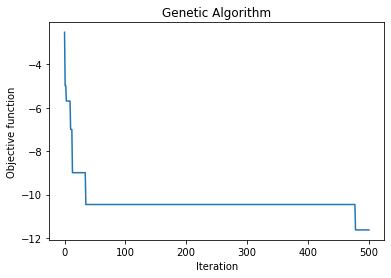

In [63]:
model_ga_t3 = geneticalgorithm(function=object_function_t3,
                               dimension=12,
                               variable_type='int',
                               variable_boundaries=varbound,
                               algorithm_parameters=algorithm_param)

model_ga_t3.run()

In [64]:
convergence_t3 = model_ga_t3.report
solution_t3 = model_ga_t3.output_dict

print(convergence_t3)
print(solution_t3)

[-2.518447695602515, -4.975472243981613, -4.975472243981613, -5.68607298286069, -5.68607298286069, -5.68607298286069, -5.68607298286069, -5.68607298286069, -5.68607298286069, -5.68607298286069, -6.994903361628726, -6.994903361628726, -6.994903361628726, -8.988540268465757, -8.988540268465757, -8.988540268465757, -8.988540268465757, -8.988540268465757, -8.988540268465757, -8.988540268465757, -8.988540268465757, -8.988540268465757, -8.988540268465757, -8.988540268465757, -8.988540268465757, -8.988540268465757, -8.988540268465757, -8.988540268465757, -8.988540268465757, -8.988540268465757, -8.988540268465757, -8.988540268465757, -8.988540268465757, -8.988540268465757, -8.988540268465757, -10.453298979811722, -10.453298979811722, -10.453298979811722, -10.453298979811722, -10.453298979811722, -10.453298979811722, -10.453298979811722, -10.453298979811722, -10.453298979811722, -10.453298979811722, -10.453298979811722, -10.453298979811722, -10.453298979811722, -10.453298979811722, -10.45329897

In [65]:
ga_solution = input_conversion(solution_t3['variable'])
ga_solution = np.array(ga_solution).reshape(1, -1)

ga_solution_df = pd.DataFrame(ga_solution, columns=features)
ga_solution_df

,G1,absences,goout,age,famrel,studytime,Medu,Walc,Mjob_mean_enc,freetime,Fedu,Fjob_mean_enc
0,11.0,16.0,2.0,16.0,5.0,3.0,0.0,5.0,9.822695,3.0,2.0,11.965517


In [66]:
Fjob = Fjob_encode[Fjob_encode.isin(ga_solution_df['Fjob_mean_enc'])].index[0]
ga_solution_df['Fjob_mean_enc'] = Fjob
ga_solution_df = ga_solution_df.rename(columns={'Fjob_mean_enc': 'Fjob'})

Mjob = Mjob_encode[Mjob_encode.isin(ga_solution_df['Mjob_mean_enc'])].index[0]
ga_solution_df['Mjob_mean_enc'] = Mjob
ga_solution_df = ga_solution_df.rename(columns={'Mjob_mean_enc': 'Mjob'})
ga_solution_df

,G1,absences,goout,age,famrel,studytime,Medu,Walc,Mjob,freetime,Fedu,Fjob
0,11.0,16.0,2.0,16.0,5.0,3.0,0.0,5.0,other,3.0,2.0,teacher


In [67]:
prediction = voting_clf.predict(scaler.transform(ga_solution))
ga_solution_df['G3'] = prediction[0]
ga_solution_t3 = ga_solution_df
ga_solution_t3

,G1,absences,goout,age,famrel,studytime,Medu,Walc,Mjob,freetime,Fedu,Fjob,G3
0,11.0,16.0,2.0,16.0,5.0,3.0,0.0,5.0,other,3.0,2.0,teacher,10.999991


In [68]:
inf_input = copy.deepcopy(model_ga_t3)

absence_min = []

for i in tqdm.tqdm(range(10000)):   
    inf_input.output_dict['variable'][0] = 12
    inf_input.output_dict['variable'][1] = 0
    inf_input.output_dict['variable'][2] = randint(df['goout'].min(), df['goout'].max())
    inf_input.output_dict['variable'][3] = randint(df['age'].min(), df['age'].max())
    inf_input.output_dict['variable'][4] = randint(df['famrel'].min(), df['famrel'].max())
    inf_input.output_dict['variable'][5] = randint(df['studytime'].min(), df['studytime'].max())
    inf_input.output_dict['variable'][6] = randint(df['Medu'].min(), df['Medu'].max())
    inf_input.output_dict['variable'][7] = randint(df['Walc'].min(), df['Walc'].max())
    inf_input.output_dict['variable'][8] = randint(0, len(Mjob_encode) - 1)
    inf_input.output_dict['variable'][9] = randint(df['freetime'].min(), df['freetime'].max())
    inf_input.output_dict['variable'][10] = randint(df['Fedu'].min(), df['Fedu'].max())
    inf_input.output_dict['variable'][11] = randint(0, len(Fjob_encode) - 1)

    input_converted = input_conversion(inf_input.output_dict['variable'])
    input_converted = np.array(input_converted).reshape(1, -1)

    input_scaled = scaler.transform(input_converted)
    prediction = voting_clf.predict(input_scaled)    
    absence_min.append([i, prediction[0]])

100%|██████████████████████████████████████████████████████████████████████████| 10000/10000 [00:09<00:00, 1060.35it/s]


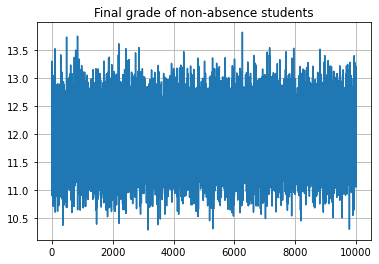

In [69]:
absence_min_df = pd.DataFrame(absence_min, columns=['trials', 'final_grade'])

plt.grid()
plt.title('Final grade of non-absence students')
plt.plot(absence_min_df['trials'], absence_min_df['final_grade'])

Average views: 11.92083985033865
Median views: 11.90949471554845
Standard deviation of views [count]: 0.5444209379991329
Standard deviation of views     [%]: 4.566967972341873


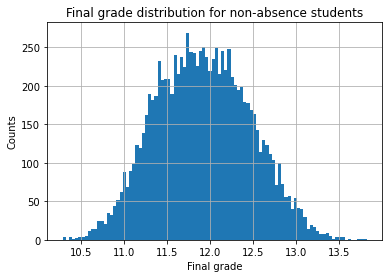

In [70]:
plt.grid()
plt.title('Final grade distribution for non-absence students')
plt.xlabel('Final grade')
plt.ylabel('Counts')
plt.hist(absence_min_df['final_grade'], bins=96)

print('Average views:', absence_min_df['final_grade'].mean())
print('Median views:', absence_min_df['final_grade'].median())
print('Standard deviation of views [count]:', absence_min_df['final_grade'].std())
print('Standard deviation of views     [%]:', absence_min_df['final_grade'].std()*100 / absence_min_df['final_grade'].mean())

In [71]:
inf_input = copy.deepcopy(model_ga_t3)

absence_max = []

for i in tqdm.tqdm(range(10000)):   
    inf_input.output_dict['variable'][0] = 12
    inf_input.output_dict['variable'][1] = 75
    inf_input.output_dict['variable'][2] = randint(df['goout'].min(), df['goout'].max())
    inf_input.output_dict['variable'][3] = randint(df['age'].min(), df['age'].max())
    inf_input.output_dict['variable'][4] = randint(df['famrel'].min(), df['famrel'].max())
    inf_input.output_dict['variable'][5] = randint(df['studytime'].min(), df['studytime'].max())
    inf_input.output_dict['variable'][6] = randint(df['Medu'].min(), df['Medu'].max())
    inf_input.output_dict['variable'][7] = randint(df['Walc'].min(), df['Walc'].max())
    inf_input.output_dict['variable'][8] = randint(0, len(Mjob_encode) - 1)
    inf_input.output_dict['variable'][9] = randint(df['freetime'].min(), df['freetime'].max())
    inf_input.output_dict['variable'][10] = randint(df['Fedu'].min(), df['Fedu'].max())
    inf_input.output_dict['variable'][11] = randint(0, len(Fjob_encode) - 1)

    input_converted = input_conversion(inf_input.output_dict['variable'])
    input_converted = np.array(input_converted).reshape(1, -1)

    input_scaled = scaler.transform(input_converted)
    prediction = voting_clf.predict(input_scaled)    
    absence_max.append([i, prediction[0]])

100%|██████████████████████████████████████████████████████████████████████████| 10000/10000 [00:05<00:00, 1941.37it/s]


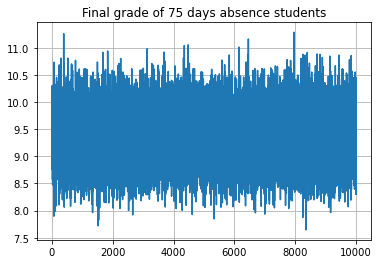

In [72]:
absence_max_df = pd.DataFrame(absence_max, columns=['trials', 'final_grade'])

plt.grid()
plt.title('Final grade of 75 days absence students')
plt.plot(absence_max_df['trials'], absence_max_df['final_grade'])

Average views: 9.389721915927813
Median views: 9.379758588662266
Standard deviation of views [count]: 0.5344258595115495
Standard deviation of views     [%]: 5.691604759934385


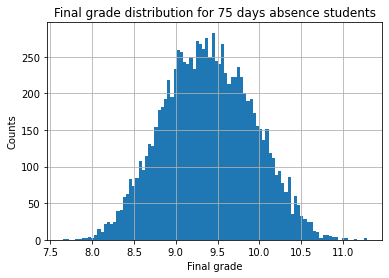

In [73]:
plt.grid()
plt.title('Final grade distribution for 75 days absence students')
plt.xlabel('Final grade')
plt.ylabel('Counts')
plt.hist(absence_max_df['final_grade'], bins=96)

print('Average views:', absence_max_df['final_grade'].mean())
print('Median views:', absence_max_df['final_grade'].median())
print('Standard deviation of views [count]:', absence_max_df['final_grade'].std())
print('Standard deviation of views     [%]:', absence_max_df['final_grade'].std()*100 / absence_max_df['final_grade'].mean())

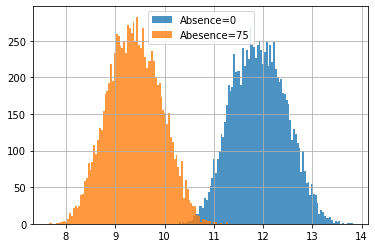

In [74]:
plt.hist(absence_min_df['final_grade'], bins=96, label='Absence=0', alpha=0.8)
plt.hist(absence_max_df['final_grade'], bins=96, label='Abesence=75', alpha=0.8)
plt.grid()
plt.legend()

#**Task 4. 목표값 탐색 + MC 시뮬레이션**

In [75]:
# [GA 목표값 탐색 + MC 시뮬레이션]
# 부모가 모두 대졸 (Medu = Fedu = 4)인 상위 25% (G3=14) 학생의 최종 등급 기대 분포를 구하라.

In [76]:
# 0: 'G1',
# 1: 'absences',
# 2: 'goout',
# 3: 'age',
# 4: 'famrel',
# 5: 'studytime',
# 6: 'Medu',
# 7: 'Walc',
# 8: 'Mjob_mean_enc',
# 9: 'freetime',
# 10: 'Fedu',
# 11: 'Fjob_mean_enc'

# varbound = np.array([[df['G1'].min(), df['G1'].max()],
#                      [df['absences'].min(), df['absences'].max()],
#                      [df['goout'].min(), df['goout'].max()],
#                      [df['age'].min(), df['age'].max()],
#                      [df['famrel'].min(), df['famrel'].max()],                     
#                      [df['studytime'].min(), df['studytime'].max()],
#                      [df['Medu'].min(), df['Medu'].max()],
#                      [df['Walc'].min(), df['Walc'].max()],
#                      [0, len(Mjob_encode) - 1],
#                      [df['freetime'].min(), df['freetime'].max()],
#                      [df['Fedu'].min(), df['Fedu'].max()],                     
#                      [0, len(Fjob_encode) - 1]])

varbound = np.array([[df['G1'].min(), df['G1'].max()],
                     [df['absences'].min(), df['absences'].max()],
                     [df['goout'].min(), df['goout'].max()],
                     [df['age'].min(), df['age'].max()],
                     [df['famrel'].min(), df['famrel'].max()],                     
                     [df['studytime'].min(), df['studytime'].max()],
                     [4, 4],
                     [df['Walc'].min(), df['Walc'].max()],
                     [0, len(Mjob_encode) - 1],
                     [df['freetime'].min(), df['freetime'].max()],
                     [4, 4],                     
                     [0, len(Fjob_encode) - 1]])

In [77]:
def object_function_t4(x_input, target_model=voting_clf):
    input_converted = input_conversion(x_input)
    input_converted = np.array(input_converted).reshape(1, -1)

    input_scaled = scaler.transform(input_converted)
    prediction = target_model.predict(input_scaled)

    target = 14.0
    print('Predicted views:', prediction[0], 'Difference from target:', prediction[0] - target)
    
    return math.log(abs(target - prediction[0])) 

Predicted views: 15.018112725690733 Difference from target: 1.0181127256907327
Predicted views: 10.968274420557128 Difference from target: -3.031725579442872
Predicted views: 9.019647777786654 Difference from target: -4.980352222213346
Predicted views: 8.784233307889544 Difference from target: -5.215766692110456
Predicted views: 12.958087519813006 Difference from target: -1.0419124801869941
Predicted views: 17.906200925548404 Difference from target: 3.9062009255484043
Predicted views: 4.563045003864009 Difference from target: -9.436954996135992
Predicted views: 6.668618129948768 Difference from target: -7.331381870051232
Predicted views: 14.729846133936851 Difference from target: 0.7298461339368512
Predicted views: 11.559960889208812 Difference from target: -2.4400391107911883
Predicted views: 14.33403377539373 Difference from target: 0.33403377539372947
Predicted views: 12.606005680574205 Difference from target: -1.3939943194257953
Predicted views: 6.459912555157679 Difference from ta

__________________________________________________ 0.2% GA is running...Predicted views: 9.191302092277605 Difference from target: -4.8086979077223955
Predicted views: 9.090744979864938 Difference from target: -4.9092550201350615
Predicted views: 13.892083523869369 Difference from target: -0.10791647613063127
Predicted views: 9.495887920133617 Difference from target: -4.504112079866383
Predicted views: 7.839221869802543 Difference from target: -6.160778130197457
Predicted views: 9.995566115194299 Difference from target: -4.004433884805701
Predicted views: 13.056137036596851 Difference from target: -0.9438629634031486
Predicted views: 13.902513068126956 Difference from target: -0.09748693187304447
Predicted views: 2.859445044976127 Difference from target: -11.140554955023873
Predicted views: 9.388251174525701 Difference from target: -4.611748825474299
Predicted views: 13.019761393344183 Difference from target: -0.9802386066558171
Predicted views: 12.130589200554377 Difference from targe

Predicted views: 13.124663702094757 Difference from target: -0.8753362979052426
Predicted views: 10.55432553909146 Difference from target: -3.44567446090854
Predicted views: 14.139558950887851 Difference from target: 0.1395589508878512
Predicted views: 17.45570484331019 Difference from target: 3.4557048433101905
Predicted views: 14.885682714553985 Difference from target: 0.885682714553985
Predicted views: 13.851890351459742 Difference from target: -0.14810964854025777
Predicted views: 16.528728451394226 Difference from target: 2.528728451394226
Predicted views: 11.875397736359197 Difference from target: -2.124602263640803
Predicted views: 13.31967079897923 Difference from target: -0.6803292010207702
Predicted views: 4.668380206606974 Difference from target: -9.331619793393026
Predicted views: 7.329125287698798 Difference from target: -6.670874712301202
Predicted views: 7.45843523339052 Difference from target: -6.54156476660948
Predicted views: 15.05505576708623 Difference from target: 

Predicted views: 8.692908903160037 Difference from target: -5.307091096839963
Predicted views: 12.247837785225427 Difference from target: -1.7521622147745735
Predicted views: 15.286919757867688 Difference from target: 1.2869197578676879
Predicted views: 12.370584625788211 Difference from target: -1.6294153742117885
Predicted views: 14.566677945749419 Difference from target: 0.5666779457494187
Predicted views: 14.668470624613613 Difference from target: 0.6684706246136134
Predicted views: 11.667947785054489 Difference from target: -2.332052214945511
Predicted views: 14.063499566820818 Difference from target: 0.06349956682081803
Predicted views: 7.730818317637521 Difference from target: -6.269181682362479
Predicted views: 10.887703386442155 Difference from target: -3.112296613557845
Predicted views: 12.280276658636097 Difference from target: -1.7197233413639026
Predicted views: 12.60519851714966 Difference from target: -1.3948014828503403
Predicted views: 13.658361544959703 Difference fro

Predicted views: 15.252223356708521 Difference from target: 1.2522233567085213
Predicted views: 14.78890383068235 Difference from target: 0.7889038306823508
Predicted views: 12.976135963578278 Difference from target: -1.0238640364217222
Predicted views: 15.389967825253976 Difference from target: 1.3899678252539758
Predicted views: 11.387277316259272 Difference from target: -2.612722683740728
Predicted views: 10.291536222646423 Difference from target: -3.708463777353577
Predicted views: 13.909432574055144 Difference from target: -0.09056742594485634
Predicted views: 16.153690190588097 Difference from target: 2.1536901905880974
Predicted views: 12.692699678214986 Difference from target: -1.3073003217850143
Predicted views: 14.524142730945153 Difference from target: 0.5241427309451527
Predicted views: 13.268624124605026 Difference from target: -0.7313758753949742
Predicted views: 12.045017033997595 Difference from target: -1.9549829660024045
Predicted views: 15.413289697422192 Difference 

Predicted views: 15.429722381931539 Difference from target: 1.4297223819315388
Predicted views: 14.12844956787258 Difference from target: 0.12844956787258077
Predicted views: 8.998455009662237 Difference from target: -5.001544990337763
Predicted views: 13.824774484535636 Difference from target: -0.17522551546436382
Predicted views: 14.223914324490403 Difference from target: 0.22391432449040316
Predicted views: 11.43540002771811 Difference from target: -2.56459997228189
Predicted views: 15.469419140026046 Difference from target: 1.4694191400260461
Predicted views: 11.324413039269777 Difference from target: -2.6755869607302234
Predicted views: 13.57691873196716 Difference from target: -0.4230812680328402
Predicted views: 14.137876221739303 Difference from target: 0.1378762217393028
Predicted views: 14.057632145207874 Difference from target: 0.057632145207874075
Predicted views: 13.86927861605767 Difference from target: -0.1307213839423298
Predicted views: 15.01939712085307 Difference fro

Predicted views: 13.293127308034487 Difference from target: -0.7068726919655131
Predicted views: 14.818722283012198 Difference from target: 0.8187222830121978
Predicted views: 13.550888458113585 Difference from target: -0.4491115418864151
Predicted views: 3.757393218746676 Difference from target: -10.242606781253324
Predicted views: 14.319961474737317 Difference from target: 0.3199614747373172
Predicted views: 14.964105763342394 Difference from target: 0.9641057633423937
Predicted views: 13.11775118257116 Difference from target: -0.8822488174288399
Predicted views: 13.431824407422914 Difference from target: -0.5681755925770862
Predicted views: 14.534178531394202 Difference from target: 0.5341785313942022
Predicted views: 14.361630480291666 Difference from target: 0.3616304802916659
Predicted views: 14.076189182042755 Difference from target: 0.07618918204275538
Predicted views: 15.332929752619487 Difference from target: 1.3329297526194868
Predicted views: 14.56341713458707 Difference fr

|_________________________________________________ 1.2% GA is running...Predicted views: 13.505763881042641 Difference from target: -0.49423611895735853
Predicted views: 6.805407550440626 Difference from target: -7.194592449559374
Predicted views: 14.407572681444888 Difference from target: 0.4075726814448881
Predicted views: 13.311141022631526 Difference from target: -0.6888589773684739
Predicted views: 13.329400219210369 Difference from target: -0.6705997807896313
Predicted views: 13.923289536889754 Difference from target: -0.07671046311024554
Predicted views: 13.228463105410084 Difference from target: -0.7715368945899161
Predicted views: 14.31247128496924 Difference from target: 0.3124712849692397
Predicted views: 15.588313009535236 Difference from target: 1.588313009535236
Predicted views: 8.734098712896989 Difference from target: -5.265901287103011
Predicted views: 14.09623147269121 Difference from target: 0.09623147269121013
Predicted views: 13.421519129195483 Difference from targ

|_________________________________________________ 1.4% GA is running...Predicted views: 13.56742640079918 Difference from target: -0.43257359920082017
Predicted views: 13.756084251692371 Difference from target: -0.24391574830762863
Predicted views: 14.300381220795785 Difference from target: 0.300381220795785
Predicted views: 9.887175789224818 Difference from target: -4.112824210775182
Predicted views: 10.16714516319739 Difference from target: -3.8328548368026105
Predicted views: 13.035324202699833 Difference from target: -0.964675797300167
Predicted views: 5.729730137628219 Difference from target: -8.27026986237178
Predicted views: 14.037348488629123 Difference from target: 0.037348488629122656
Predicted views: 13.20643793240153 Difference from target: -0.7935620675984705
Predicted views: 15.061383644926858 Difference from target: 1.0613836449268579
Predicted views: 7.841701874963898 Difference from target: -6.158298125036102
Predicted views: 13.790079437353521 Difference from target:

Predicted views: 13.406946992564853 Difference from target: -0.593053007435147
Predicted views: 11.99399886921352 Difference from target: -2.00600113078648
Predicted views: 14.091813127735586 Difference from target: 0.09181312773558581
Predicted views: 15.799287415876208 Difference from target: 1.7992874158762078
Predicted views: 11.728949887506511 Difference from target: -2.271050112493489
Predicted views: 12.29577537430361 Difference from target: -1.7042246256963907
Predicted views: 14.659763714332342 Difference from target: 0.6597637143323425
Predicted views: 13.644431857005067 Difference from target: -0.3555681429949331
Predicted views: 14.040962771188367 Difference from target: 0.04096277118836689
Predicted views: 13.346421793483477 Difference from target: -0.6535782065165225
Predicted views: 13.14520783658388 Difference from target: -0.8547921634161195
Predicted views: 3.2599060951363477 Difference from target: -10.740093904863652
Predicted views: 13.192925481582094 Difference fr

Predicted views: 13.837876686625131 Difference from target: -0.16212331337486852
Predicted views: 15.141589774245324 Difference from target: 1.1415897742453236
Predicted views: 14.169099309712186 Difference from target: 0.16909930971218579
Predicted views: 13.121527751539475 Difference from target: -0.8784722484605254
Predicted views: 14.716112645382998 Difference from target: 0.7161126453829976
Predicted views: 13.253859681640103 Difference from target: -0.7461403183598971
Predicted views: 13.740111375804348 Difference from target: -0.25988862419565173
Predicted views: 14.236080085199262 Difference from target: 0.23608008519926216
Predicted views: 15.320391771910083 Difference from target: 1.3203917719100833
Predicted views: 15.598107232803523 Difference from target: 1.5981072328035228
Predicted views: 12.932471380534897 Difference from target: -1.0675286194651026
Predicted views: 14.006268004705761 Difference from target: 0.0062680047057614985
Predicted views: 13.512484796821544 Diff

Predicted views: 13.628392049546477 Difference from target: -0.371607950453523
Predicted views: 14.017066313665348 Difference from target: 0.01706631366534772
Predicted views: 9.760489280514923 Difference from target: -4.239510719485077
Predicted views: 15.386236919908848 Difference from target: 1.386236919908848
Predicted views: 13.79196429239474 Difference from target: -0.20803570760526036
Predicted views: 14.523013885669725 Difference from target: 0.5230138856697248
Predicted views: 2.8920323293699077 Difference from target: -11.107967670630092
Predicted views: 12.480284601699376 Difference from target: -1.5197153983006242
Predicted views: 14.509178324412389 Difference from target: 0.5091783244123889
Predicted views: 14.211604070829742 Difference from target: 0.21160407082974153
Predicted views: 14.032825059417467 Difference from target: 0.03282505941746727
Predicted views: 3.9867668286551585 Difference from target: -10.013233171344842
Predicted views: 15.83706015700171 Difference f

Predicted views: 13.769982222378454 Difference from target: -0.23001777762154596
Predicted views: 13.707795984009351 Difference from target: -0.2922040159906487
Predicted views: 14.590725851626312 Difference from target: 0.5907258516263116
Predicted views: 12.942082757299508 Difference from target: -1.0579172427004924
|_________________________________________________ 2.0% GA is running...Predicted views: 15.105420154160006 Difference from target: 1.1054201541600062
Predicted views: 13.49974226151582 Difference from target: -0.50025773848418
Predicted views: 13.384931176011454 Difference from target: -0.6150688239885458
Predicted views: 15.146513884616242 Difference from target: 1.1465138846162422
Predicted views: 13.372076242539725 Difference from target: -0.627923757460275
Predicted views: 15.03725248000975 Difference from target: 1.0372524800097498
Predicted views: 13.862099036270564 Difference from target: -0.13790096372943594
Predicted views: 13.843767691767445 Difference from tar

Predicted views: 14.260457263617825 Difference from target: 0.26045726361782506
Predicted views: 10.35564249873337 Difference from target: -3.6443575012666294
Predicted views: 14.661259759658165 Difference from target: 0.6612597596581651
Predicted views: 13.645942681997418 Difference from target: -0.35405731800258167
Predicted views: 13.146557330190896 Difference from target: -0.8534426698091035
Predicted views: 8.387069955867652 Difference from target: -5.612930044132348
Predicted views: 14.579988696994468 Difference from target: 0.5799886969944676
Predicted views: 4.825697391559895 Difference from target: -9.174302608440104
Predicted views: 11.273704251785697 Difference from target: -2.7262957482143033
Predicted views: 13.875739965916514 Difference from target: -0.12426003408348585
Predicted views: 13.551078263005044 Difference from target: -0.4489217369949561
Predicted views: 13.767427202835137 Difference from target: -0.23257279716486323
Predicted views: 14.205844532617869 Differen

Predicted views: 16.623149588639468 Difference from target: 2.6231495886394676
Predicted views: 13.589320197101879 Difference from target: -0.41067980289812134
Predicted views: 14.209488034384469 Difference from target: 0.20948803438446895
Predicted views: 13.512526462839213 Difference from target: -0.48747353716078656
Predicted views: 12.787798992618365 Difference from target: -1.2122010073816352
Predicted views: 13.725671894666698 Difference from target: -0.27432810533330176
Predicted views: 14.55600591171301 Difference from target: 0.5560059117130098
Predicted views: 12.7997469566617 Difference from target: -1.2002530433383
Predicted views: 12.917926993002398 Difference from target: -1.082073006997602
Predicted views: 12.115898187488973 Difference from target: -1.8841018125110267
Predicted views: 14.592345773556758 Difference from target: 0.5923457735567581
Predicted views: 14.310518653209193 Difference from target: 0.3105186532091935
Predicted views: 14.540682367168813 Difference f

Predicted views: 14.426210410942451 Difference from target: 0.42621041094245093
Predicted views: 13.53311708844032 Difference from target: -0.4668829115596793
Predicted views: 14.384357544583159 Difference from target: 0.38435754458315863
Predicted views: 14.645086093890832 Difference from target: 0.645086093890832
Predicted views: 14.57978730120314 Difference from target: 0.5797873012031403
Predicted views: 12.801976363491365 Difference from target: -1.1980236365086352
Predicted views: 13.512573628291305 Difference from target: -0.48742637170869507
Predicted views: 14.234328577218397 Difference from target: 0.23432857721839717
Predicted views: 13.614499961927024 Difference from target: -0.3855000380729763
Predicted views: 13.301570184941385 Difference from target: -0.6984298150586152
Predicted views: 14.671553919375887 Difference from target: 0.6715539193758868
Predicted views: 15.205372447730896 Difference from target: 1.2053724477308965
Predicted views: 14.743270024583621 Difference

Predicted views: 12.36290191587237 Difference from target: -1.6370980841276292
Predicted views: 13.124581106141013 Difference from target: -0.8754188938589866
Predicted views: 4.766621505002714 Difference from target: -9.233378494997286
Predicted views: 13.855170970910748 Difference from target: -0.14482902908925155
Predicted views: 12.879800395935826 Difference from target: -1.1201996040641742
Predicted views: 12.520677753315638 Difference from target: -1.4793222466843616
Predicted views: 14.4847462985121 Difference from target: 0.4847462985120998
Predicted views: 13.33179300183646 Difference from target: -0.6682069981635408
Predicted views: 15.31251619903469 Difference from target: 1.3125161990346896
Predicted views: 14.544197458434153 Difference from target: 0.5441974584341533
Predicted views: 14.00430401601872 Difference from target: 0.004304016018719992
Predicted views: 13.822492122807594 Difference from target: -0.17750787719240613
Predicted views: 13.221205116565315 Difference f

Predicted views: 13.457052928382426 Difference from target: -0.5429470716175739
Predicted views: 14.268585759718128 Difference from target: 0.26858575971812826
Predicted views: 12.458931978145998 Difference from target: -1.5410680218540023
Predicted views: 10.254037240342667 Difference from target: -3.745962759657333
Predicted views: 13.943694849460023 Difference from target: -0.05630515053997698
Predicted views: 14.29934120593902 Difference from target: 0.2993412059390206
Predicted views: 12.59919159736486 Difference from target: -1.4008084026351408
Predicted views: 15.234049804459943 Difference from target: 1.2340498044599428
Predicted views: 13.91315298775185 Difference from target: -0.08684701224814972
Predicted views: 13.05675863635802 Difference from target: -0.9432413636419792
Predicted views: 16.84356717276705 Difference from target: 2.843567172767049
Predicted views: 13.61943239624429 Difference from target: -0.3805676037557095
Predicted views: 13.71086406985585 Difference fro

Predicted views: 14.378654485943757 Difference from target: 0.3786544859437573
Predicted views: 14.191503726932943 Difference from target: 0.19150372693294315
Predicted views: 13.442993693245464 Difference from target: -0.5570063067545359
Predicted views: 13.655737871343836 Difference from target: -0.34426212865616357
Predicted views: 11.460191650622525 Difference from target: -2.5398083493774752
Predicted views: 14.752970075730516 Difference from target: 0.7529700757305164
Predicted views: 3.9019405482815714 Difference from target: -10.098059451718429
Predicted views: 14.148699507328649 Difference from target: 0.148699507328649
Predicted views: 17.128649182052687 Difference from target: 3.128649182052687
Predicted views: 14.043843438940923 Difference from target: 0.04384343894092346
Predicted views: 13.812233381307474 Difference from target: -0.18776661869252642
Predicted views: 14.469071032761045 Difference from target: 0.469071032761045
Predicted views: 14.287529476178696 Difference

Predicted views: 13.97798928279341 Difference from target: -0.02201071720659087
Predicted views: 14.306033097210701 Difference from target: 0.30603309721070104
Predicted views: 13.190339988589065 Difference from target: -0.8096600114109354
Predicted views: 14.130445478740201 Difference from target: 0.13044547874020118
Predicted views: 14.464678103530732 Difference from target: 0.4646781035307317
Predicted views: 15.234769270726234 Difference from target: 1.2347692707262343
Predicted views: 13.80013035264247 Difference from target: -0.19986964735753077
Predicted views: 14.84091862823786 Difference from target: 0.8409186282378602
Predicted views: 16.357413113013084 Difference from target: 2.3574131130130844
Predicted views: 14.096030488433309 Difference from target: 0.09603048843330875
Predicted views: 13.963174421329411 Difference from target: -0.03682557867058911
Predicted views: 14.446213046588253 Difference from target: 0.44621304658825345
Predicted views: 14.221406674697143 Differen

Predicted views: 12.339377508500476 Difference from target: -1.6606224914995238
Predicted views: 13.872741574448225 Difference from target: -0.12725842555177458
Predicted views: 15.738842894071967 Difference from target: 1.7388428940719667
Predicted views: 14.969916273113617 Difference from target: 0.9699162731136166
Predicted views: 13.101530344897109 Difference from target: -0.8984696551028915
Predicted views: 15.091516437240216 Difference from target: 1.091516437240216
Predicted views: 13.879342566677716 Difference from target: -0.12065743332228429
Predicted views: 5.228299875871397 Difference from target: -8.771700124128603
Predicted views: 13.57739266681218 Difference from target: -0.42260733318781973
Predicted views: 14.541981300486798 Difference from target: 0.5419813004867979
Predicted views: 13.746616216740444 Difference from target: -0.25338378325955624
Predicted views: 13.079078596312755 Difference from target: -0.9209214036872453
Predicted views: 13.928665435808583 Differen

Predicted views: 11.31382091256093 Difference from target: -2.6861790874390703
Predicted views: 14.355294855680874 Difference from target: 0.3552948556808744
Predicted views: 14.330005172799938 Difference from target: 0.3300051727999378
Predicted views: 15.60040362414933 Difference from target: 1.6004036241493296
Predicted views: 13.237144533854995 Difference from target: -0.7628554661450053
Predicted views: 14.11808520880066 Difference from target: 0.1180852088006592
Predicted views: 8.325408339553341 Difference from target: -5.674591660446659
Predicted views: 11.746643757677953 Difference from target: -2.253356242322047
Predicted views: 9.274562790401264 Difference from target: -4.725437209598736
Predicted views: 14.020985004457232 Difference from target: 0.020985004457232392
Predicted views: 16.14380073911556 Difference from target: 2.1438007391155587
Predicted views: 13.132404429424128 Difference from target: -0.8675955705758724
Predicted views: 4.6557203805737775 Difference from t

Predicted views: 14.17304069593518 Difference from target: 0.17304069593518
Predicted views: 14.230893894427949 Difference from target: 0.2308938944279486
Predicted views: 13.92728507967842 Difference from target: -0.07271492032158022
Predicted views: 13.784738048688439 Difference from target: -0.215261951311561
Predicted views: 12.936678739629818 Difference from target: -1.0633212603701825
Predicted views: 12.802144101681096 Difference from target: -1.1978558983189043
Predicted views: 14.076717633097479 Difference from target: 0.07671763309747881
Predicted views: 4.550007135930638 Difference from target: -9.449992864069362
Predicted views: 13.121647986530766 Difference from target: -0.8783520134692342
Predicted views: 13.692137414863724 Difference from target: -0.3078625851362755
Predicted views: 13.743536636284043 Difference from target: -0.256463363715957
Predicted views: 8.217517823337142 Difference from target: -5.7824821766628585
Predicted views: 13.507926963929846 Difference fro

Predicted views: 13.994854870223193 Difference from target: -0.005145129776806812
Predicted views: 13.211357846525033 Difference from target: -0.7886421534749672
Predicted views: 13.167446739560956 Difference from target: -0.8325532604390435
Predicted views: 13.907827032839299 Difference from target: -0.09217296716070145
Predicted views: 7.581199870063613 Difference from target: -6.418800129936387
Predicted views: 6.364309211607906 Difference from target: -7.635690788392094
Predicted views: 12.69414573068461 Difference from target: -1.3058542693153896
Predicted views: 14.220559857135626 Difference from target: 0.2205598571356262
Predicted views: 13.349985230792782 Difference from target: -0.6500147692072176
Predicted views: 14.54276836061267 Difference from target: 0.5427683606126692
Predicted views: 13.645942244918702 Difference from target: -0.354057755081298
Predicted views: 13.042049190235005 Difference from target: -0.9579508097649949
Predicted views: 14.961534728966932 Difference

Predicted views: 13.975249454491781 Difference from target: -0.02475054550821909
Predicted views: 8.138409829771765 Difference from target: -5.861590170228235
Predicted views: 14.345276368363523 Difference from target: 0.34527636836352293
Predicted views: 13.631302326794641 Difference from target: -0.36869767320535907
Predicted views: 13.90882597509143 Difference from target: -0.09117402490856996
Predicted views: 13.21856684617543 Difference from target: -0.7814331538245707
Predicted views: 14.227802509099334 Difference from target: 0.22780250909933386
Predicted views: 14.29990185416443 Difference from target: 0.29990185416443005
Predicted views: 9.036120382668303 Difference from target: -4.963879617331697
Predicted views: 11.526886332654234 Difference from target: -2.473113667345766
Predicted views: 14.300694120817184 Difference from target: 0.30069412081718383
Predicted views: 13.935445073272904 Difference from target: -0.06455492672709617
Predicted views: 6.616354298883958 Differenc

Predicted views: 14.7614280794838 Difference from target: 0.7614280794837995
Predicted views: 12.57110523999153 Difference from target: -1.42889476000847
Predicted views: 13.571398152205694 Difference from target: -0.4286018477943063
Predicted views: 13.852532357169347 Difference from target: -0.1474676428306534
Predicted views: 8.772456795322475 Difference from target: -5.227543204677525
Predicted views: 14.521358282398865 Difference from target: 0.5213582823988645
Predicted views: 14.049306091807344 Difference from target: 0.04930609180734358
Predicted views: 13.903927208531874 Difference from target: -0.09607279146812608
Predicted views: 12.498787613904447 Difference from target: -1.5012123860955526
Predicted views: 15.489916954468606 Difference from target: 1.4899169544686064
Predicted views: 14.555979612840787 Difference from target: 0.5559796128407868
Predicted views: 14.617387541434761 Difference from target: 0.6173875414347609
Predicted views: 7.409955119212839 Difference from 

Predicted views: 13.605321301977455 Difference from target: -0.3946786980225454
Predicted views: 15.167087235002967 Difference from target: 1.1670872350029668
Predicted views: 14.96033526388707 Difference from target: 0.9603352638870692
Predicted views: 12.600898606282309 Difference from target: -1.3991013937176913
Predicted views: 14.650091918404192 Difference from target: 0.6500919184041916
Predicted views: 14.092589139041879 Difference from target: 0.09258913904187871
Predicted views: 14.898294438636421 Difference from target: 0.8982944386364213
Predicted views: 14.80340133524168 Difference from target: 0.8034013352416807
Predicted views: 12.762058369337828 Difference from target: -1.2379416306621724
Predicted views: 15.76769955378127 Difference from target: 1.76769955378127
Predicted views: 13.676109694798123 Difference from target: -0.32389030520187667
Predicted views: 13.51548638920679 Difference from target: -0.48451361079320954
Predicted views: 13.479696918793314 Difference fro

Predicted views: 14.538970148446902 Difference from target: 0.5389701484469018
Predicted views: 14.582566075502013 Difference from target: 0.5825660755020134
Predicted views: 13.004766896039188 Difference from target: -0.9952331039608122
Predicted views: 13.721604646668103 Difference from target: -0.2783953533318968
Predicted views: 14.455342564334517 Difference from target: 0.4553425643345168
Predicted views: 13.87427122300487 Difference from target: -0.12572877699513008
Predicted views: 12.842062904465692 Difference from target: -1.157937095534308
Predicted views: 3.906137552539532 Difference from target: -10.093862447460468
Predicted views: 13.023740125144379 Difference from target: -0.9762598748556215
Predicted views: 15.434909108605984 Difference from target: 1.434909108605984
Predicted views: 8.920670735216918 Difference from target: -5.079329264783082
Predicted views: 15.42151386959762 Difference from target: 1.4215138695976197
Predicted views: 14.293418874104004 Difference from

Predicted views: 14.209576089080516 Difference from target: 0.20957608908051562
Predicted views: 14.25210310169075 Difference from target: 0.25210310169075
Predicted views: 12.209677045632636 Difference from target: -1.7903229543673636
Predicted views: 3.412660595892468 Difference from target: -10.587339404107531
Predicted views: 14.275515389244958 Difference from target: 0.27551538924495844
Predicted views: 12.512953430529832 Difference from target: -1.4870465694701682
Predicted views: 13.577492007654548 Difference from target: -0.42250799234545156
Predicted views: 13.050373988001182 Difference from target: -0.9496260119988182
Predicted views: 14.379922449684075 Difference from target: 0.3799224496840754
Predicted views: 13.506250953303152 Difference from target: -0.4937490466968484
Predicted views: 14.100846457489697 Difference from target: 0.10084645748969656
Predicted views: 13.443854895792478 Difference from target: -0.5561451042075216
Predicted views: 6.9884697375727365 Differenc

Predicted views: 9.511361338069849 Difference from target: -4.4886386619301515
Predicted views: 14.194514608455862 Difference from target: 0.19451460845586155
Predicted views: 13.432721868815499 Difference from target: -0.5672781311845014
Predicted views: 13.318708487596808 Difference from target: -0.6812915124031917
Predicted views: 13.78457308020198 Difference from target: -0.21542691979801987
Predicted views: 14.243618200890547 Difference from target: 0.24361820089054653
Predicted views: 13.391196767553152 Difference from target: -0.6088032324468475
Predicted views: 14.179358827479765 Difference from target: 0.17935882747976528
Predicted views: 15.288990771745517 Difference from target: 1.2889907717455173
Predicted views: 13.952190776693877 Difference from target: -0.04780922330612292
Predicted views: 14.410265631355458 Difference from target: 0.41026563135545757
Predicted views: 13.646270724493169 Difference from target: -0.3537292755068311
Predicted views: 14.11839951156854 Differ

Predicted views: 14.875822669794175 Difference from target: 0.8758226697941751
Predicted views: 14.003354259217465 Difference from target: 0.0033542592174651276
Predicted views: 4.0331960560813105 Difference from target: -9.96680394391869
Predicted views: 14.007474927451161 Difference from target: 0.007474927451161406
Predicted views: 13.788182232812074 Difference from target: -0.21181776718792555
Predicted views: 14.145104052298004 Difference from target: 0.14510405229800405
Predicted views: 14.006420921777783 Difference from target: 0.006420921777783306
Predicted views: 13.342038316637206 Difference from target: -0.6579616833627941
Predicted views: 15.229348344331214 Difference from target: 1.229348344331214
Predicted views: 14.521358282398865 Difference from target: 0.5213582823988645
Predicted views: 14.011026389188567 Difference from target: 0.01102638918856691
Predicted views: 13.907175497106559 Difference from target: -0.09282450289344091
Predicted views: 13.651997073396748 Diff

Predicted views: 8.12802629244613 Difference from target: -5.87197370755387
Predicted views: 11.891882772163983 Difference from target: -2.1081172278360167
Predicted views: 14.189704064334613 Difference from target: 0.18970406433461307
Predicted views: 15.033458277976285 Difference from target: 1.033458277976285
Predicted views: 12.408081176179058 Difference from target: -1.5919188238209419
Predicted views: 15.340750232006656 Difference from target: 1.3407502320066556
Predicted views: 13.781400761261507 Difference from target: -0.21859923873849318
Predicted views: 14.491136950977015 Difference from target: 0.4911369509770154
Predicted views: 14.315967298790659 Difference from target: 0.31596729879065855
Predicted views: 13.41666910823148 Difference from target: -0.5833308917685205
Predicted views: 13.821483560230078 Difference from target: -0.17851643976992193
Predicted views: 13.946816366608005 Difference from target: -0.0531836333919955
Predicted views: 13.115973001597652 Difference 

Predicted views: 13.64099588294018 Difference from target: -0.35900411705982016
Predicted views: 11.097892951277423 Difference from target: -2.902107048722577
Predicted views: 14.680018037746686 Difference from target: 0.6800180377466862
Predicted views: 13.74465037012006 Difference from target: -0.25534962987993914
Predicted views: 15.092772748641964 Difference from target: 1.0927727486419645
Predicted views: 13.325743796357658 Difference from target: -0.6742562036423418
Predicted views: 13.347113793071737 Difference from target: -0.6528862069282635
Predicted views: 13.604971656974186 Difference from target: -0.3950283430258139
Predicted views: 12.757639771729535 Difference from target: -1.2423602282704653
Predicted views: 14.573910161714101 Difference from target: 0.5739101617141014
Predicted views: 13.223727551143249 Difference from target: -0.7762724488567514
Predicted views: 13.7021465982342 Difference from target: -0.2978534017657992
Predicted views: 13.35922782636712 Difference 

Predicted views: 12.00358754712389 Difference from target: -1.9964124528761094
Predicted views: 7.412597556717022 Difference from target: -6.587402443282978
Predicted views: 12.466489173212834 Difference from target: -1.5335108267871664
Predicted views: 14.850247182767061 Difference from target: 0.8502471827670615
Predicted views: 13.188738470461201 Difference from target: -0.8112615295387986
Predicted views: 15.068381185991521 Difference from target: 1.0683811859915213
Predicted views: 13.669967680293864 Difference from target: -0.33003231970613633
Predicted views: 13.459498929041283 Difference from target: -0.540501070958717
Predicted views: 5.5829448369202455 Difference from target: -8.417055163079755
Predicted views: 13.572814186713854 Difference from target: -0.4271858132861457
Predicted views: 13.74067136560071 Difference from target: -0.25932863439929044
Predicted views: 14.01082381182254 Difference from target: 0.010823811822540108
Predicted views: 8.31636459536639 Difference f

Predicted views: 13.95974955988894 Difference from target: -0.040250440111060826
Predicted views: 13.597492025284074 Difference from target: -0.4025079747159257
Predicted views: 14.104504494681999 Difference from target: 0.10450449468199885
Predicted views: 14.536036335898217 Difference from target: 0.536036335898217
Predicted views: 12.810175576426685 Difference from target: -1.1898244235733149
Predicted views: 12.657560950105642 Difference from target: -1.3424390498943577
Predicted views: 15.68001326610497 Difference from target: 1.6800132661049698
Predicted views: 14.443721938679746 Difference from target: 0.4437219386797455
Predicted views: 15.213714886836001 Difference from target: 1.2137148868360015
Predicted views: 13.736128869761933 Difference from target: -0.2638711302380674
Predicted views: 6.879464542844333 Difference from target: -7.120535457155667
Predicted views: 14.760868665909342 Difference from target: 0.7608686659093422
Predicted views: 13.056752110901229 Difference f

|||_______________________________________________ 5.6% GA is running...Predicted views: 14.653252657062977 Difference from target: 0.6532526570629766
Predicted views: 13.51046491275705 Difference from target: -0.4895350872429507
Predicted views: 15.776847275755776 Difference from target: 1.7768472757557756
Predicted views: 6.974767368935045 Difference from target: -7.025232631064955
Predicted views: 11.930016842201567 Difference from target: -2.0699831577984327
Predicted views: 13.829237564193194 Difference from target: -0.1707624358068056
Predicted views: 9.606772056710826 Difference from target: -4.393227943289174
Predicted views: 13.74096096492674 Difference from target: -0.2590390350732594
Predicted views: 13.796374016691509 Difference from target: -0.20362598330849124
Predicted views: 13.863823901910223 Difference from target: -0.13617609808977704
Predicted views: 6.4226920267863425 Difference from target: -7.5773079732136575
Predicted views: 13.854768316776358 Difference from ta

Predicted views: 14.870606701501428 Difference from target: 0.870606701501428
Predicted views: 13.66651345018816 Difference from target: -0.33348654981183934
Predicted views: 13.237021726688935 Difference from target: -0.7629782733110648
Predicted views: 13.929511357937926 Difference from target: -0.07048864206207384
Predicted views: 14.836783540430917 Difference from target: 0.8367835404309165
Predicted views: 13.432676456556033 Difference from target: -0.5673235434439672
Predicted views: 5.907768366081529 Difference from target: -8.09223163391847
Predicted views: 13.769051573592444 Difference from target: -0.23094842640755608
Predicted views: 14.000302163157244 Difference from target: 0.00030216315724374
Predicted views: 14.360061048327927 Difference from target: 0.3600610483279265
Predicted views: 14.006579167002775 Difference from target: 0.006579167002774611
Predicted views: 14.976395460745415 Difference from target: 0.9763954607454153
Predicted views: 13.420345765347568 Differenc

Predicted views: 13.707061897541493 Difference from target: -0.29293810245850693
Predicted views: 8.410381816926693 Difference from target: -5.589618183073307
Predicted views: 14.096045799580322 Difference from target: 0.09604579958032211
Predicted views: 9.570869639655951 Difference from target: -4.429130360344049
Predicted views: 14.552827494646925 Difference from target: 0.5528274946469249
Predicted views: 14.287452684598405 Difference from target: 0.2874526845984047
Predicted views: 12.85122158743579 Difference from target: -1.1487784125642104
Predicted views: 11.319769272201668 Difference from target: -2.6802307277983317
Predicted views: 14.297829986622423 Difference from target: 0.297829986622423
Predicted views: 14.040373068311458 Difference from target: 0.04037306831145848
Predicted views: 13.678780415086338 Difference from target: -0.32121958491366165
Predicted views: 13.638582846736087 Difference from target: -0.361417153263913
Predicted views: 13.242704743882378 Difference f

Predicted views: 9.097998165628637 Difference from target: -4.902001834371363
Predicted views: 13.675291311360317 Difference from target: -0.3247086886396833
Predicted views: 15.121455614816815 Difference from target: 1.1214556148168153
Predicted views: 13.483745930749942 Difference from target: -0.5162540692500581
Predicted views: 13.98803017833127 Difference from target: -0.011969821668730063
Predicted views: 13.662714952932271 Difference from target: -0.3372850470677289
Predicted views: 14.173691769087833 Difference from target: 0.17369176908783324
Predicted views: 13.69066088715205 Difference from target: -0.30933911284794924
Predicted views: 13.935445073272904 Difference from target: -0.06455492672709617
Predicted views: 8.951350728154745 Difference from target: -5.048649271845255
Predicted views: 11.197192070622883 Difference from target: -2.802807929377117
Predicted views: 14.068953534607937 Difference from target: 0.06895353460793707
Predicted views: 13.40895804326685 Differenc

Predicted views: 14.693286605790552 Difference from target: 0.6932866057905525
Predicted views: 13.178084895984776 Difference from target: -0.8219151040152237
Predicted views: 13.898384816226349 Difference from target: -0.1016151837736512
Predicted views: 14.35930353425752 Difference from target: 0.3593035342575206
Predicted views: 13.551775726440681 Difference from target: -0.44822427355931893
Predicted views: 13.112885262520692 Difference from target: -0.8871147374793082
Predicted views: 14.239687319350926 Difference from target: 0.23968731935092613
Predicted views: 14.288477546517143 Difference from target: 0.28847754651714297
Predicted views: 14.673824167813065 Difference from target: 0.6738241678130645
Predicted views: 14.006579167002775 Difference from target: 0.006579167002774611
Predicted views: 13.44364379959334 Difference from target: -0.5563562004066593
Predicted views: 12.25575594807313 Difference from target: -1.74424405192687
Predicted views: 13.512597789444387 Difference

Predicted views: 14.2926908612507 Difference from target: 0.29269086125069954
Predicted views: 13.970218780597776 Difference from target: -0.029781219402224224
Predicted views: 14.345206941964046 Difference from target: 0.34520694196404555
Predicted views: 6.577773017074331 Difference from target: -7.422226982925669
Predicted views: 13.99613049747895 Difference from target: -0.0038695025210504497
Predicted views: 6.492139115497781 Difference from target: -7.507860884502219
Predicted views: 13.679838870060708 Difference from target: -0.3201611299392919
Predicted views: 13.428578259953838 Difference from target: -0.5714217400461621
Predicted views: 17.18934572233766 Difference from target: 3.1893457223376593
Predicted views: 13.859222889703751 Difference from target: -0.1407771102962485
Predicted views: 9.876128744591878 Difference from target: -4.1238712554081225
Predicted views: 14.000302163157244 Difference from target: 0.00030216315724374
Predicted views: 13.975882551532855 Differenc

Predicted views: 13.656625371354972 Difference from target: -0.3433746286450283
Predicted views: 7.532629119617458 Difference from target: -6.467370880382542
Predicted views: 13.647439051530762 Difference from target: -0.3525609484692378
Predicted views: 4.3989624480518295 Difference from target: -9.60103755194817
Predicted views: 9.67691821487986 Difference from target: -4.32308178512014
Predicted views: 16.079432833755476 Difference from target: 2.079432833755476
Predicted views: 13.850668318857336 Difference from target: -0.14933168114266415
Predicted views: 13.506800922693282 Difference from target: -0.4931990773067181
Predicted views: 13.810339566936475 Difference from target: -0.18966043306352454
Predicted views: 13.510263068337359 Difference from target: -0.489736931662641
Predicted views: 15.723507611568138 Difference from target: 1.723507611568138
Predicted views: 13.2699804026808 Difference from target: -0.7300195973192007
Predicted views: 13.932890312882593 Difference from t

Predicted views: 13.277099215671981 Difference from target: -0.7229007843280186
Predicted views: 14.1578280626373 Difference from target: 0.1578280626373001
Predicted views: 14.067966217897117 Difference from target: 0.06796621789711743
Predicted views: 13.641302795608402 Difference from target: -0.35869720439159813
Predicted views: 13.086597447236935 Difference from target: -0.9134025527630651
Predicted views: 12.892842214927725 Difference from target: -1.1071577850722747
Predicted views: 3.8702848829776335 Difference from target: -10.129715117022366
Predicted views: 13.710133485919778 Difference from target: -0.2898665140802219
Predicted views: 14.206025723415019 Difference from target: 0.2060257234150189
Predicted views: 14.318398405861844 Difference from target: 0.31839840586184387
Predicted views: 14.000302163157244 Difference from target: 0.00030216315724374
Predicted views: 16.6188246879113 Difference from target: 2.6188246879112995
Predicted views: 13.389278166347802 Difference

Predicted views: 14.585589432420775 Difference from target: 0.5855894324207753
Predicted views: 13.71770829463317 Difference from target: -0.28229170536683057
Predicted views: 13.86427874410631 Difference from target: -0.13572125589369044
Predicted views: 13.228777236601742 Difference from target: -0.7712227633982582
Predicted views: 12.272110807079146 Difference from target: -1.7278891929208537
Predicted views: 11.823832265368916 Difference from target: -2.1761677346310844
Predicted views: 13.698355452310288 Difference from target: -0.30164454768971183
Predicted views: 13.7553444160775 Difference from target: -0.24465558392249953
Predicted views: 13.898384816226349 Difference from target: -0.1016151837736512
Predicted views: 13.65406516443794 Difference from target: -0.3459348355620602
Predicted views: 13.47321840142422 Difference from target: -0.5267815985757807
Predicted views: 13.89634874357432 Difference from target: -0.10365125642567996
Predicted views: 13.060544299769361 Differe

Predicted views: 13.893490336563893 Difference from target: -0.1065096634361069
Predicted views: 13.7091653842951 Difference from target: -0.29083461570490066
Predicted views: 14.068018784021584 Difference from target: 0.06801878402158401
Predicted views: 13.749350596857015 Difference from target: -0.2506494031429849
Predicted views: 17.222053284830043 Difference from target: 3.222053284830043
Predicted views: 13.33471487591899 Difference from target: -0.6652851240810094
Predicted views: 13.637898164974539 Difference from target: -0.3621018350254612
Predicted views: 13.681473441363368 Difference from target: -0.3185265586366324
Predicted views: 6.015652765546982 Difference from target: -7.984347234453018
Predicted views: 13.706779150043603 Difference from target: -0.29322084995639663
Predicted views: 14.000302163157244 Difference from target: 0.00030216315724374
Predicted views: 14.139374767053061 Difference from target: 0.13937476705306118
Predicted views: 13.57592342870872 Difference

Predicted views: 13.236168298336002 Difference from target: -0.7638317016639977
Predicted views: 13.95974955988894 Difference from target: -0.040250440111060826
Predicted views: 13.425207365685255 Difference from target: -0.5747926343147451
Predicted views: 13.854134620123768 Difference from target: -0.14586537987623238
Predicted views: 14.058970021415737 Difference from target: 0.05897002141573715
Predicted views: 6.774754297470856 Difference from target: -7.225245702529144
Predicted views: 6.718097697725845 Difference from target: -7.281902302274155
Predicted views: 14.57014648768105 Difference from target: 0.5701464876810505
Predicted views: 14.616536156367353 Difference from target: 0.6165361563673528
Predicted views: 13.257212624320614 Difference from target: -0.7427873756793861
Predicted views: 13.83651898423065 Difference from target: -0.16348101576934937
Predicted views: 14.878529416322115 Difference from target: 0.8785294163221149
Predicted views: 9.102899433046941 Difference 

Predicted views: 14.206285839836262 Difference from target: 0.20628583983626214
Predicted views: 16.712658463596323 Difference from target: 2.7126584635963233
Predicted views: 12.60848902324318 Difference from target: -1.3915109767568197
Predicted views: 16.030999159251362 Difference from target: 2.030999159251362
Predicted views: 13.961701677402921 Difference from target: -0.03829832259707899
Predicted views: 12.01875239603322 Difference from target: -1.9812476039667803
Predicted views: 7.6058409562954745 Difference from target: -6.3941590437045255
Predicted views: 14.096081356862527 Difference from target: 0.09608135686252695
Predicted views: 14.149001948627012 Difference from target: 0.14900194862701177
Predicted views: 15.894030104536574 Difference from target: 1.894030104536574
Predicted views: 14.485016779493856 Difference from target: 0.485016779493856
Predicted views: 17.43704788964605 Difference from target: 3.437047889646049
Predicted views: 14.360781004415855 Difference from

Predicted views: 14.000302163157244 Difference from target: 0.00030216315724374
Predicted views: 13.630004369657163 Difference from target: -0.3699956303428369
Predicted views: 14.542987481990556 Difference from target: 0.542987481990556
Predicted views: 13.140367673649664 Difference from target: -0.8596323263503365
Predicted views: 12.985142165796569 Difference from target: -1.014857834203431
Predicted views: 13.642417685005702 Difference from target: -0.35758231499429805
Predicted views: 13.71111185802267 Difference from target: -0.2888881419773295
Predicted views: 7.314245625045001 Difference from target: -6.685754374954999
Predicted views: 5.584394230005963 Difference from target: -8.415605769994038
Predicted views: 13.946487374195897 Difference from target: -0.05351262580410321
Predicted views: 13.665622604676543 Difference from target: -0.33437739532345745
Predicted views: 13.581593171821575 Difference from target: -0.41840682817842456
Predicted views: 13.178893178735194 Differen

Predicted views: 10.384242696815244 Difference from target: -3.615757303184756
Predicted views: 13.30972708844241 Difference from target: -0.6902729115575905
Predicted views: 13.932890312882593 Difference from target: -0.06710968711740684
Predicted views: 13.900104536819645 Difference from target: -0.09989546318035458
Predicted views: 15.901907313335 Difference from target: 1.9019073133350002
Predicted views: 13.813778894993085 Difference from target: -0.1862211050069149
Predicted views: 14.035676349465328 Difference from target: 0.03567634946532827
Predicted views: 13.936915571222945 Difference from target: -0.06308442877705467
Predicted views: 13.41408765956169 Difference from target: -0.5859123404383109
Predicted views: 8.823863285376058 Difference from target: -5.176136714623942
Predicted views: 12.308646645360328 Difference from target: -1.6913533546396717
Predicted views: 13.375739767904982 Difference from target: -0.6242602320950184
Predicted views: 13.017742377136665 Difference

Predicted views: 13.51821096912488 Difference from target: -0.48178903087512026
Predicted views: 14.123075113700173 Difference from target: 0.12307511370017288
Predicted views: 6.298073559008699 Difference from target: -7.701926440991301
Predicted views: 13.941359077873097 Difference from target: -0.058640922126903305
Predicted views: 13.978396936506394 Difference from target: -0.021603063493605745
Predicted views: 12.995968173544107 Difference from target: -1.0040318264558934
Predicted views: 13.932621019444099 Difference from target: -0.06737898055590108
Predicted views: 13.677546648931278 Difference from target: -0.32245335106872197
Predicted views: 15.751831569669832 Difference from target: 1.7518315696698323
Predicted views: 3.0077966752408116 Difference from target: -10.992203324759188
Predicted views: 14.095350519505795 Difference from target: 0.09535051950579465
Predicted views: 12.527680742571043 Difference from target: -1.472319257428957
Predicted views: 14.208990697320738 Di

Predicted views: 13.694746231586691 Difference from target: -0.30525376841330853
Predicted views: 13.857903660495053 Difference from target: -0.14209633950494727
Predicted views: 13.350877346194741 Difference from target: -0.649122653805259
Predicted views: 14.94289467164372 Difference from target: 0.9428946716437192
Predicted views: 13.514273537546984 Difference from target: -0.485726462453016
Predicted views: 13.932890312882593 Difference from target: -0.06710968711740684
Predicted views: 14.101934619090024 Difference from target: 0.10193461909002366
Predicted views: 13.331599879592853 Difference from target: -0.6684001204071475
Predicted views: 14.932626803345308 Difference from target: 0.9326268033453076
Predicted views: 11.216172055768517 Difference from target: -2.783827944231483
Predicted views: 14.264949398261294 Difference from target: 0.2649493982612938
Predicted views: 15.599404922121375 Difference from target: 1.5994049221213746
Predicted views: 13.621270015727916 Differenc

Predicted views: 12.775452405460735 Difference from target: -1.2245475945392652
Predicted views: 13.020774701367548 Difference from target: -0.9792252986324517
Predicted views: 12.748077466250622 Difference from target: -1.2519225337493776
Predicted views: 14.159132188363268 Difference from target: 0.1591321883632677
Predicted views: 13.730867406155035 Difference from target: -0.26913259384496513
Predicted views: 13.391280538304036 Difference from target: -0.6087194616959639
Predicted views: 11.417504933900853 Difference from target: -2.5824950660991473
Predicted views: 13.961322241748663 Difference from target: -0.038677758251337124
Predicted views: 13.857903660495053 Difference from target: -0.14209633950494727
Predicted views: 10.573501577791253 Difference from target: -3.4264984222087467
Predicted views: 12.837046623330854 Difference from target: -1.1629533766691456
Predicted views: 11.290681833705008 Difference from target: -2.7093181662949917
Predicted views: 10.940331265883112 D

Predicted views: 13.164014212476225 Difference from target: -0.8359857875237751
Predicted views: 13.710470681420324 Difference from target: -0.28952931857967634
Predicted views: 14.060741308648856 Difference from target: 0.06074130864885596
Predicted views: 12.967156828482388 Difference from target: -1.0328431715176123
Predicted views: 14.472621682690116 Difference from target: 0.4726216826901162
Predicted views: 14.36747638261148 Difference from target: 0.3674763826114802
Predicted views: 12.77197818900399 Difference from target: -1.22802181099601
Predicted views: 11.673139158564728 Difference from target: -2.3268608414352716
Predicted views: 12.977945779597462 Difference from target: -1.0220542204025378
Predicted views: 11.394930830097621 Difference from target: -2.6050691699023787
Predicted views: 12.764873064673603 Difference from target: -1.235126935326397
Predicted views: 14.436008844281416 Difference from target: 0.4360088442814156
Predicted views: 8.197306710335297 Difference f

Predicted views: 12.83072828856662 Difference from target: -1.16927171143338
Predicted views: 12.827825102598952 Difference from target: -1.1721748974010477
Predicted views: 13.936915571222945 Difference from target: -0.06308442877705467
Predicted views: 13.888034753286414 Difference from target: -0.1119652467135861
Predicted views: 13.815202136321618 Difference from target: -0.1847978636783818
Predicted views: 13.642628594549379 Difference from target: -0.3573714054506212
Predicted views: 13.582578703292995 Difference from target: -0.4174212967070048
Predicted views: 7.66613642768237 Difference from target: -6.33386357231763
Predicted views: 12.992432165893012 Difference from target: -1.0075678341069878
Predicted views: 14.627886699024709 Difference from target: 0.6278866990247085
Predicted views: 13.650319300698603 Difference from target: -0.34968069930139656
Predicted views: 14.292104411825036 Difference from target: 0.29210441182503644
Predicted views: 15.654402357909175 Difference

Predicted views: 6.074401368960558 Difference from target: -7.925598631039442
Predicted views: 7.793678212513586 Difference from target: -6.206321787486414
Predicted views: 14.094734660160604 Difference from target: 0.09473466016060428
Predicted views: 13.761748342468849 Difference from target: -0.2382516575311513
Predicted views: 14.320629181823309 Difference from target: 0.3206291818233087
Predicted views: 12.95763603070413 Difference from target: -1.0423639692958702
Predicted views: 14.157181166554624 Difference from target: 0.15718116655462389
Predicted views: 14.739762931092917 Difference from target: 0.7397629310929172
Predicted views: 13.735579019942248 Difference from target: -0.2644209800577517
Predicted views: 13.98280792823583 Difference from target: -0.01719207176416937
Predicted views: 15.350328823973712 Difference from target: 1.3503288239737117
Predicted views: 11.624282053489218 Difference from target: -2.3757179465107825
Predicted views: 13.453186800355715 Difference f

Predicted views: 13.321684070865176 Difference from target: -0.6783159291348237
Predicted views: 13.67664771686602 Difference from target: -0.3233522831339801
Predicted views: 6.64415060693099 Difference from target: -7.35584939306901
Predicted views: 6.236219574518735 Difference from target: -7.763780425481265
Predicted views: 14.357497488838339 Difference from target: 0.3574974888383391
Predicted views: 13.924459187652753 Difference from target: -0.07554081234724741
Predicted views: 13.147126998060296 Difference from target: -0.8528730019397042
Predicted views: 13.884916123431852 Difference from target: -0.11508387656814811
Predicted views: 12.747280185566991 Difference from target: -1.252719814433009
Predicted views: 14.000302163157244 Difference from target: 0.00030216315724374
Predicted views: 16.273248309576644 Difference from target: 2.273248309576644
Predicted views: 13.590759747933426 Difference from target: -0.40924025206657433
Predicted views: 14.000302163157244 Difference f

Predicted views: 14.000302163157244 Difference from target: 0.00030216315724374
Predicted views: 14.209576089080516 Difference from target: 0.20957608908051562
Predicted views: 12.197368507718812 Difference from target: -1.8026314922811881
Predicted views: 13.995263810795818 Difference from target: -0.004736189204182395
Predicted views: 13.724824596251787 Difference from target: -0.2751754037482126
Predicted views: 13.15326996978117 Difference from target: -0.8467300302188292
Predicted views: 17.783004050553682 Difference from target: 3.783004050553682
Predicted views: 4.4475581532003625 Difference from target: -9.552441846799638
Predicted views: 6.891463921605625 Difference from target: -7.108536078394375
Predicted views: 13.615643913427961 Difference from target: -0.3843560865720388
||||______________________________________________ 8.8% GA is running...Predicted views: 13.976707951430107 Difference from target: -0.023292048569892643
Predicted views: 14.085228397215609 Difference fro

Predicted views: 13.412010530741673 Difference from target: -0.5879894692583267
Predicted views: 13.911884745924754 Difference from target: -0.08811525407524634
Predicted views: 13.935445073272904 Difference from target: -0.06455492672709617
Predicted views: 14.220956010182249 Difference from target: 0.22095601018224897
Predicted views: 14.555865160337556 Difference from target: 0.5558651603375555
Predicted views: 13.717421764544056 Difference from target: -0.2825782354559436
Predicted views: 13.81326082210127 Difference from target: -0.18673917789872974
Predicted views: 13.535015915812044 Difference from target: -0.46498408418795556
Predicted views: 4.242793467359036 Difference from target: -9.757206532640964
Predicted views: 15.846963434278743 Difference from target: 1.8469634342787433
Predicted views: 13.590632891200007 Difference from target: -0.4093671087999926
Predicted views: 13.553259670507956 Difference from target: -0.44674032949204445
Predicted views: 5.10500070764176 Differ

Predicted views: 12.956014308634932 Difference from target: -1.0439856913650676
Predicted views: 13.785237165768981 Difference from target: -0.21476283423101883
Predicted views: 13.263644178427166 Difference from target: -0.7363558215728343
Predicted views: 13.320928274942554 Difference from target: -0.6790717250574456
Predicted views: 14.097660338279601 Difference from target: 0.09766033827960108
Predicted views: 13.056505563912546 Difference from target: -0.9434944360874535
Predicted views: 12.881962721586516 Difference from target: -1.1180372784134835
Predicted views: 14.19832662491241 Difference from target: 0.1983266249124096
Predicted views: 13.505811805932316 Difference from target: -0.494188194067684
Predicted views: 13.843676426359735 Difference from target: -0.1563235736402646
Predicted views: 13.20130862356786 Difference from target: -0.7986913764321404
Predicted views: 14.076737349218098 Difference from target: 0.0767373492180976
Predicted views: 13.620452002174956 Differen

Predicted views: 10.182646849355498 Difference from target: -3.817353150644502
Predicted views: 14.089811437858101 Difference from target: 0.08981143785810097
Predicted views: 8.380931479416477 Difference from target: -5.619068520583523
Predicted views: 11.081460542189426 Difference from target: -2.9185394578105743
Predicted views: 13.967469033227694 Difference from target: -0.03253096677230616
Predicted views: 14.074933746838871 Difference from target: 0.07493374683887133
Predicted views: 13.177417760958798 Difference from target: -0.8225822390412016
Predicted views: 14.03244615219937 Difference from target: 0.03244615219936975
Predicted views: 14.310090514521159 Difference from target: 0.31009051452115877
Predicted views: 13.750491581102514 Difference from target: -0.2495084188974861
Predicted views: 10.002456908337065 Difference from target: -3.9975430916629353
Predicted views: 13.966589741571378 Difference from target: -0.03341025842862244
Predicted views: 12.985442055772523 Differ

Predicted views: 6.14045133454933 Difference from target: -7.85954866545067
Predicted views: 13.863525442677409 Difference from target: -0.1364745573225914
Predicted views: 13.4935732131103 Difference from target: -0.5064267868896994
Predicted views: 12.592087126573327 Difference from target: -1.4079128734266728
Predicted views: 9.67691821487986 Difference from target: -4.32308178512014
Predicted views: 14.223401034106631 Difference from target: 0.22340103410663126
Predicted views: 12.344157974406167 Difference from target: -1.6558420255938326
|||||_____________________________________________ 9.4% GA is running...Predicted views: 12.223943577747514 Difference from target: -1.776056422252486
Predicted views: 11.988212187479549 Difference from target: -2.011787812520451
Predicted views: 13.902261887070543 Difference from target: -0.09773811292945744
Predicted views: 6.109593686231341 Difference from target: -7.890406313768659
Predicted views: 13.885610742362005 Difference from target: -

Predicted views: 13.577761480808284 Difference from target: -0.4222385191917155
Predicted views: 14.356932920645017 Difference from target: 0.3569329206450167
Predicted views: 13.59841373994881 Difference from target: -0.40158626005118947
Predicted views: 15.866820187341178 Difference from target: 1.8668201873411778
Predicted views: 13.463402722398596 Difference from target: -0.5365972776014036
Predicted views: 14.097660338279601 Difference from target: 0.09766033827960108
Predicted views: 13.3204750996117 Difference from target: -0.6795249003882997
Predicted views: 13.505811805932316 Difference from target: -0.494188194067684
Predicted views: 14.22094983653993 Difference from target: 0.22094983653992983
Predicted views: 13.826847838907897 Difference from target: -0.17315216109210319
Predicted views: 13.638064427853687 Difference from target: -0.36193557214631333
Predicted views: 5.748860110318806 Difference from target: -8.251139889681195
Predicted views: 13.476455616458273 Difference

Predicted views: 14.17304069593518 Difference from target: 0.17304069593518
Predicted views: 13.98912513279354 Difference from target: -0.010874867206460692
Predicted views: 12.932313290289043 Difference from target: -1.0676867097109568
Predicted views: 14.006579167002775 Difference from target: 0.006579167002774611
Predicted views: 8.439108602170409 Difference from target: -5.560891397829591
Predicted views: 7.789774021454057 Difference from target: -6.210225978545943
Predicted views: 13.785977685610286 Difference from target: -0.2140223143897142
Predicted views: 6.577773017074331 Difference from target: -7.422226982925669
Predicted views: 14.340028739206659 Difference from target: 0.34002873920665877
Predicted views: 14.690248714177796 Difference from target: 0.6902487141777964
Predicted views: 11.01421494715772 Difference from target: -2.98578505284228
Predicted views: 12.633815338153473 Difference from target: -1.3661846618465265
Predicted views: 13.504322662073237 Difference from 

Predicted views: 13.778170155032578 Difference from target: -0.22182984496742186
Predicted views: 14.000302163157244 Difference from target: 0.00030216315724374
Predicted views: 13.753302524722889 Difference from target: -0.24669747527711117
Predicted views: 10.808395093378829 Difference from target: -3.191604906621171
Predicted views: 13.878165631214317 Difference from target: -0.12183436878568266
Predicted views: 13.879698241545618 Difference from target: -0.12030175845438151
Predicted views: 11.319965572989785 Difference from target: -2.6800344270102148
Predicted views: 13.79117042402344 Difference from target: -0.20882957597656038
Predicted views: 14.968751741944798 Difference from target: 0.9687517419447982
Predicted views: 13.373279984760744 Difference from target: -0.6267200152392558
Predicted views: 7.419946825089691 Difference from target: -6.580053174910309
Predicted views: 12.797908859703213 Difference from target: -1.2020911402967869
Predicted views: 13.768949318272684 Diff

Predicted views: 14.179358827479765 Difference from target: 0.17935882747976528
Predicted views: 12.911789897039048 Difference from target: -1.0882101029609519
|||||_____________________________________________ 10.0% GA is running...Predicted views: 13.718683666735933 Difference from target: -0.28131633326406735
Predicted views: 13.029427339866338 Difference from target: -0.9705726601336622
Predicted views: 4.935065237408243 Difference from target: -9.064934762591758
Predicted views: 14.787461428029326 Difference from target: 0.7874614280293262
Predicted views: 14.290831068283383 Difference from target: 0.29083106828338323
Predicted views: 14.232101336346759 Difference from target: 0.23210133634675856
Predicted views: 12.506587310688902 Difference from target: -1.4934126893110982
Predicted views: 8.256924423715217 Difference from target: -5.743075576284783
Predicted views: 13.513851348872544 Difference from target: -0.486148651127456
Predicted views: 15.727138087252234 Difference from 

Predicted views: 14.398425564387315 Difference from target: 0.39842556438731513
Predicted views: 13.045492696101698 Difference from target: -0.9545073038983016
Predicted views: 13.58010898884641 Difference from target: -0.41989101115358984
Predicted views: 14.099933118702973 Difference from target: 0.09993311870297283
Predicted views: 14.12216245425133 Difference from target: 0.12216245425132932
Predicted views: 13.140300882401954 Difference from target: -0.859699117598046
Predicted views: 16.373869725289293 Difference from target: 2.3738697252892926
Predicted views: 11.83592471931324 Difference from target: -2.1640752806867596
Predicted views: 13.966242611597972 Difference from target: -0.033757388402028354
Predicted views: 13.98892090949699 Difference from target: -0.011079090503010036
Predicted views: 13.904537787933414 Difference from target: -0.095462212066586
Predicted views: 15.326544129947147 Difference from target: 1.3265441299471465
Predicted views: 14.234565862337206 Differe

Predicted views: 15.096133224639772 Difference from target: 1.0961332246397717
Predicted views: 12.676790589434328 Difference from target: -1.3232094105656724
Predicted views: 10.467306972911265 Difference from target: -3.532693027088735
Predicted views: 14.097660338279601 Difference from target: 0.09766033827960108
Predicted views: 13.57708353212579 Difference from target: -0.42291646787420945
Predicted views: 14.04698431865639 Difference from target: 0.0469843186563903
Predicted views: 11.827172744768966 Difference from target: -2.1728272552310344
Predicted views: 14.479408306125421 Difference from target: 0.4794083061254213
Predicted views: 13.594684527714174 Difference from target: -0.4053154722858263
Predicted views: 13.846710170450896 Difference from target: -0.15328982954910408
Predicted views: 12.214839555861026 Difference from target: -1.785160444138974
Predicted views: 14.156783412692432 Difference from target: 0.15678341269243212
Predicted views: 14.019406992868602 Differenc

Predicted views: 12.488749210003013 Difference from target: -1.5112507899969874
Predicted views: 11.326779062612317 Difference from target: -2.6732209373876827
Predicted views: 9.514711692685504 Difference from target: -4.485288307314496
Predicted views: 13.793970676923621 Difference from target: -0.206029323076379
Predicted views: 14.394143182296586 Difference from target: 0.3941431822965864
Predicted views: 13.97895833706986 Difference from target: -0.021041662930139537
Predicted views: 13.56181336645781 Difference from target: -0.43818663354218934
Predicted views: 13.954445827197041 Difference from target: -0.0455541728029587
Predicted views: 13.54651783306376 Difference from target: -0.4534821669362401
Predicted views: 14.243703737936244 Difference from target: 0.24370373793624367
Predicted views: 12.399309932651867 Difference from target: -1.6006900673481326
Predicted views: 13.856175798805305 Difference from target: -0.14382420119469508
Predicted views: 14.020068773929415 Differe

Predicted views: 13.501552086439238 Difference from target: -0.4984479135607618
Predicted views: 11.579685608127349 Difference from target: -2.420314391872651
Predicted views: 7.5699026983498285 Difference from target: -6.4300973016501715
Predicted views: 12.405625844755315 Difference from target: -1.5943741552446848
Predicted views: 13.534206829498748 Difference from target: -0.4657931705012519
Predicted views: 13.25411007296534 Difference from target: -0.7458899270346606
Predicted views: 12.001666318121172 Difference from target: -1.9983336818788278
Predicted views: 14.396935750622598 Difference from target: 0.3969357506225979
Predicted views: 13.935445073272904 Difference from target: -0.06455492672709617
Predicted views: 13.908621029698798 Difference from target: -0.09137897030120179
Predicted views: 14.117585545666964 Difference from target: 0.11758554566696411
Predicted views: 14.135949022486605 Difference from target: 0.13594902248660468
Predicted views: 13.842220969104842 Diffe

Predicted views: 9.89204832354295 Difference from target: -4.10795167645705
Predicted views: 12.944346929337065 Difference from target: -1.0556530706629346
Predicted views: 14.000302163157244 Difference from target: 0.00030216315724374
Predicted views: 13.727481077117213 Difference from target: -0.2725189228827869
Predicted views: 12.984608601403556 Difference from target: -1.015391398596444
Predicted views: 12.034937638299802 Difference from target: -1.9650623617001983
Predicted views: 8.512214828532114 Difference from target: -5.487785171467886
Predicted views: 13.813662401287303 Difference from target: -0.18633759871269717
Predicted views: 4.503570774267492 Difference from target: -9.49642922573251
Predicted views: 13.450890514800008 Difference from target: -0.5491094851999918
Predicted views: 13.306397631775994 Difference from target: -0.6936023682240062
Predicted views: 13.42779031989452 Difference from target: -0.5722096801054803
Predicted views: 13.135184218790357 Difference fro

Predicted views: 13.860587979196717 Difference from target: -0.13941202080328274
Predicted views: 13.445608462661957 Difference from target: -0.5543915373380432
Predicted views: 14.329599661962247 Difference from target: 0.32959966196224677
Predicted views: 14.29553960563682 Difference from target: 0.29553960563682047
Predicted views: 13.863823901910223 Difference from target: -0.13617609808977704
Predicted views: 13.241162438527633 Difference from target: -0.758837561472367
Predicted views: 13.740363408798636 Difference from target: -0.25963659120136384
Predicted views: 14.475819313529177 Difference from target: 0.4758193135291773
Predicted views: 12.172816017398558 Difference from target: -1.8271839826014418
Predicted views: 13.876515140321203 Difference from target: -0.12348485967879697
Predicted views: 15.699762222411366 Difference from target: 1.6997622224113655
Predicted views: 13.831927988021391 Difference from target: -0.16807201197860877
Predicted views: 14.07222805479973 Diff

Predicted views: 13.298698229576871 Difference from target: -0.7013017704231288
Predicted views: 14.67429659647687 Difference from target: 0.6742965964768697
Predicted views: 13.49241985102367 Difference from target: -0.5075801489763307
Predicted views: 12.472072373460671 Difference from target: -1.527927626539329
Predicted views: 12.287642081030237 Difference from target: -1.7123579189697633
Predicted views: 7.338351065620512 Difference from target: -6.661648934379488
Predicted views: 15.22266490608333 Difference from target: 1.2226649060833292
Predicted views: 13.83663697423336 Difference from target: -0.16336302576664075
Predicted views: 14.450774039606424 Difference from target: 0.4507740396064239
Predicted views: 13.181486646137735 Difference from target: -0.8185133538622651
Predicted views: 13.269265084814483 Difference from target: -0.7307349151855167
Predicted views: 13.397731120118126 Difference from target: -0.6022688798818745
Predicted views: 13.67465809958374 Difference fro

Predicted views: 12.434776241483688 Difference from target: -1.5652237585163125
Predicted views: 13.6899983751263 Difference from target: -0.3100016248736992
Predicted views: 13.423720943485753 Difference from target: -0.576279056514247
Predicted views: 14.260671020749811 Difference from target: 0.2606710207498111
Predicted views: 13.674011532434887 Difference from target: -0.32598846756511257
Predicted views: 13.404228951291913 Difference from target: -0.5957710487080874
Predicted views: 13.532278878816618 Difference from target: -0.4677211211833825
Predicted views: 13.826624247013557 Difference from target: -0.17337575298644303
Predicted views: 10.97773577192578 Difference from target: -3.0222642280742207
Predicted views: 5.031834345381719 Difference from target: -8.968165654618282
Predicted views: 4.102610803182082 Difference from target: -9.897389196817919
Predicted views: 14.130000984608747 Difference from target: 0.13000098460874732
Predicted views: 14.098347613957486 Difference 

Predicted views: 13.50732839166245 Difference from target: -0.49267160833755064
Predicted views: 12.948471196125409 Difference from target: -1.0515288038745911
Predicted views: 14.149001948627012 Difference from target: 0.14900194862701177
Predicted views: 14.21759254792385 Difference from target: 0.21759254792385008
Predicted views: 13.799509213773021 Difference from target: -0.2004907862269789
Predicted views: 14.355895667558515 Difference from target: 0.3558956675585154
Predicted views: 13.006020645129519 Difference from target: -0.993979354870481
Predicted views: 13.84149250637399 Difference from target: -0.15850749362600958
Predicted views: 14.404118625832156 Difference from target: 0.4041186258321563
Predicted views: 13.66062166936723 Difference from target: -0.3393783306327691
Predicted views: 13.913220986618404 Difference from target: -0.08677901338159622
Predicted views: 14.092548351363646 Difference from target: 0.09254835136364647
Predicted views: 12.519287862378349 Differen

Predicted views: 5.443607779528386 Difference from target: -8.556392220471615
Predicted views: 13.817450739347827 Difference from target: -0.18254926065217347
Predicted views: 13.879646137178398 Difference from target: -0.12035386282160232
Predicted views: 13.401572958057201 Difference from target: -0.5984270419427986
Predicted views: 12.056152352541273 Difference from target: -1.9438476474587265
Predicted views: 13.644852405726224 Difference from target: -0.3551475942737756
Predicted views: 13.60886199876632 Difference from target: -0.3911380012336796
Predicted views: 13.517166751574672 Difference from target: -0.4828332484253277
Predicted views: 7.211473918466237 Difference from target: -6.788526081533763
Predicted views: 13.730393328387763 Difference from target: -0.2696066716122374
Predicted views: 13.804145509598024 Difference from target: -0.19585449040197567
Predicted views: 14.003263264538079 Difference from target: 0.0032632645380790137
Predicted views: 14.795430261970688 Diff

Predicted views: 9.1922991168741 Difference from target: -4.8077008831259
Predicted views: 13.963188656850457 Difference from target: -0.03681134314954271
Predicted views: 14.618340514596023 Difference from target: 0.6183405145960226
Predicted views: 13.496396925928439 Difference from target: -0.5036030740715614
Predicted views: 8.197583077473524 Difference from target: -5.802416922526476
Predicted views: 13.740830548874785 Difference from target: -0.2591694511252154
Predicted views: 13.856165333462911 Difference from target: -0.14383466653708865
Predicted views: 13.64032025889638 Difference from target: -0.3596797411036192
Predicted views: 12.961631134356333 Difference from target: -1.0383688656436671
Predicted views: 14.166663936005321 Difference from target: 0.16666393600532103
Predicted views: 13.646252934008272 Difference from target: -0.3537470659917279
Predicted views: 13.673775637908635 Difference from target: -0.32622436209136474
Predicted views: 14.1316237146728 Difference fr

Predicted views: 13.610882995765921 Difference from target: -0.3891170042340786
Predicted views: 13.480821385437515 Difference from target: -0.5191786145624846
Predicted views: 13.448479797258265 Difference from target: -0.5515202027417345
Predicted views: 8.278951034234575 Difference from target: -5.721048965765425
Predicted views: 15.900755180751863 Difference from target: 1.9007551807518634
Predicted views: 14.305007345115692 Difference from target: 0.3050073451156923
Predicted views: 12.096712540534762 Difference from target: -1.903287459465238
Predicted views: 14.831547568469075 Difference from target: 0.831547568469075
Predicted views: 14.223892157278753 Difference from target: 0.2238921572787529
Predicted views: 13.839034652745307 Difference from target: -0.16096534725469347
Predicted views: 8.470630764195436 Difference from target: -5.529369235804564
Predicted views: 6.78149031505862 Difference from target: -7.21850968494138
Predicted views: 14.023635921778896 Difference from t

Predicted views: 13.842457775518008 Difference from target: -0.1575422244819915
Predicted views: 14.286149736877363 Difference from target: 0.28614973687736267
Predicted views: 12.252360861668464 Difference from target: -1.747639138331536
Predicted views: 13.791572857360293 Difference from target: -0.20842714263970663
Predicted views: 16.143346264638193 Difference from target: 2.1433462646381933
Predicted views: 13.132141386595423 Difference from target: -0.8678586134045769
||||||____________________________________________ 12.0% GA is running...Predicted views: 13.753246221240644 Difference from target: -0.24675377875935567
Predicted views: 10.771376916043552 Difference from target: -3.228623083956448
Predicted views: 5.706964767236157 Difference from target: -8.293035232763842
Predicted views: 13.702874866617414 Difference from target: -0.29712513338258617
Predicted views: 13.591850504512495 Difference from target: -0.4081494954875051
Predicted views: 13.056506255523104 Difference fr

Predicted views: 13.750805704982382 Difference from target: -0.24919429501761847
Predicted views: 14.275920769495476 Difference from target: 0.2759207694954764
Predicted views: 14.643070356364673 Difference from target: 0.6430703563646727
Predicted views: 14.679873782954816 Difference from target: 0.6798737829548163
Predicted views: 14.089166766993609 Difference from target: 0.0891667669936087
Predicted views: 14.000302163157244 Difference from target: 0.00030216315724374
Predicted views: 12.737424129990027 Difference from target: -1.2625758700099734
Predicted views: 13.806838524998577 Difference from target: -0.193161475001423
Predicted views: 7.650891155642394 Difference from target: -6.349108844357606
Predicted views: 14.097660338279601 Difference from target: 0.09766033827960108
Predicted views: 9.647773272303157 Difference from target: -4.352226727696843
Predicted views: 12.82398331352372 Difference from target: -1.1760166864762809
Predicted views: 13.633019647622064 Difference fr

Predicted views: 14.206527688439948 Difference from target: 0.20652768843994807
Predicted views: 13.850869079720354 Difference from target: -0.1491309202796458
Predicted views: 13.99613049747895 Difference from target: -0.0038695025210504497
Predicted views: 14.082687028083479 Difference from target: 0.08268702808347861
Predicted views: 13.999175838417917 Difference from target: -0.0008241615820825388
Predicted views: 14.540010451098878 Difference from target: 0.5400104510988779
Predicted views: 13.505861210848082 Difference from target: -0.49413878915191844
Predicted views: 14.3963855780042 Difference from target: 0.3963855780041996
Predicted views: 13.817996043922486 Difference from target: -0.18200395607751396
Predicted views: 12.942868299164765 Difference from target: -1.0571317008352352
Predicted views: 3.8073232222913798 Difference from target: -10.19267677770862
Predicted views: 14.251634193033638 Difference from target: 0.2516341930336381
Predicted views: 14.361170551237185 Dif

Predicted views: 14.050092858002818 Difference from target: 0.050092858002818375
Predicted views: 14.526242297235612 Difference from target: 0.526242297235612
Predicted views: 16.154528556924426 Difference from target: 2.1545285569244257
Predicted views: 13.589000593683567 Difference from target: -0.4109994063164333
Predicted views: 13.957145312192921 Difference from target: -0.04285468780707902
Predicted views: 9.768647230414066 Difference from target: -4.231352769585934
Predicted views: 13.51306429586545 Difference from target: -0.48693570413455056
Predicted views: 13.84052795351523 Difference from target: -0.15947204648477076
Predicted views: 13.817131390467873 Difference from target: -0.18286860953212702
Predicted views: 5.15212874977588 Difference from target: -8.84787125022412
Predicted views: 12.409385895450256 Difference from target: -1.5906141045497435
Predicted views: 14.171196765513997 Difference from target: 0.1711967655139972
Predicted views: 14.142109483064965 Difference 

Predicted views: 13.905919556750527 Difference from target: -0.09408044324947262
Predicted views: 13.681848086374814 Difference from target: -0.31815191362518647
Predicted views: 14.118433952976297 Difference from target: 0.11843395297629655
Predicted views: 13.33556399826177 Difference from target: -0.6644360017382294
Predicted views: 13.449990394538338 Difference from target: -0.5500096054616623
Predicted views: 17.758868136590536 Difference from target: 3.758868136590536
Predicted views: 13.942378322495736 Difference from target: -0.0576216775042635
Predicted views: 16.40755754792501 Difference from target: 2.407557547925009
Predicted views: 13.429114939587478 Difference from target: -0.5708850604125217
Predicted views: 14.034874084467527 Difference from target: 0.0348740844675266
Predicted views: 14.149001948627012 Difference from target: 0.14900194862701177
Predicted views: 12.65153719660357 Difference from target: -1.3484628033964299
Predicted views: 13.414936426933531 Difference

Predicted views: 16.31658124226519 Difference from target: 2.3165812422651904
Predicted views: 13.932890312882593 Difference from target: -0.06710968711740684
Predicted views: 11.579461802812874 Difference from target: -2.420538197187126
Predicted views: 14.000302163157244 Difference from target: 0.00030216315724374
Predicted views: 13.844749121519783 Difference from target: -0.15525087848021712
Predicted views: 13.884916123431852 Difference from target: -0.11508387656814811
Predicted views: 13.815202136321618 Difference from target: -0.1847978636783818
Predicted views: 14.197457378042486 Difference from target: 0.1974573780424862
Predicted views: 15.746400729503954 Difference from target: 1.7464007295039536
Predicted views: 13.957145312192921 Difference from target: -0.04285468780707902
Predicted views: 13.849274104357848 Difference from target: -0.150725895642152
Predicted views: 13.530538235049791 Difference from target: -0.46946176495020886
Predicted views: 15.41667251031321 Differ

Predicted views: 14.752047771984865 Difference from target: 0.7520477719848646
Predicted views: 14.876395513722523 Difference from target: 0.8763955137225228
Predicted views: 13.659646058934598 Difference from target: -0.34035394106540195
Predicted views: 7.247583898809606 Difference from target: -6.752416101190394
Predicted views: 13.664659327329021 Difference from target: -0.3353406726709789
Predicted views: 13.384560492655638 Difference from target: -0.6154395073443624
Predicted views: 13.986108542248358 Difference from target: -0.013891457751642022
Predicted views: 9.513831370355172 Difference from target: -4.486168629644828
Predicted views: 13.955261298100078 Difference from target: -0.04473870189992191
Predicted views: 13.87960008185948 Difference from target: -0.12039991814052087
Predicted views: 14.718981955443986 Difference from target: 0.7189819554439865
Predicted views: 13.859222889703751 Difference from target: -0.1407771102962485
Predicted views: 13.513301374598262 Differe

Predicted views: 12.9566366756481 Difference from target: -1.0433633243518994
Predicted views: 13.82007550884458 Difference from target: -0.17992449115542009
Predicted views: 15.009158798250105 Difference from target: 1.0091587982501053
Predicted views: 14.1316237146728 Difference from target: 0.13162371467280032
Predicted views: 13.919231802546241 Difference from target: -0.08076819745375907
Predicted views: 15.491270853027137 Difference from target: 1.491270853027137
Predicted views: 13.94757780978298 Difference from target: -0.05242219021702077
Predicted views: 13.710470681420324 Difference from target: -0.28952931857967634
Predicted views: 13.172678947942847 Difference from target: -0.8273210520571528
Predicted views: 11.625141379129028 Difference from target: -2.374858620870972
Predicted views: 13.462528577338576 Difference from target: -0.5374714226614241
Predicted views: 13.599417522380369 Difference from target: -0.40058247761963095
Predicted views: 13.911884745924754 Differenc

Predicted views: 13.844749121519783 Difference from target: -0.15525087848021712
Predicted views: 13.451445839961671 Difference from target: -0.5485541600383286
Predicted views: 13.588200347545401 Difference from target: -0.41179965245459904
Predicted views: 13.497529771400034 Difference from target: -0.5024702285999663
Predicted views: 12.345318151619788 Difference from target: -1.6546818483802124
Predicted views: 14.060005587302049 Difference from target: 0.06000558730204908
Predicted views: 12.67840824170095 Difference from target: -1.32159175829905
Predicted views: 16.21818428059702 Difference from target: 2.2181842805970184
Predicted views: 10.915241152924358 Difference from target: -3.0847588470756424
Predicted views: 13.073609567900846 Difference from target: -0.9263904320991543
Predicted views: 8.638791692077413 Difference from target: -5.3612083079225865
Predicted views: 12.892852750409096 Difference from target: -1.1071472495909038
Predicted views: 13.832757554499986 Differen

Predicted views: 10.638186387742161 Difference from target: -3.361813612257839
Predicted views: 15.137250382808375 Difference from target: 1.137250382808375
Predicted views: 13.954851523049003 Difference from target: -0.04514847695099711
Predicted views: 4.28827666331281 Difference from target: -9.71172333668719
Predicted views: 13.533086352369248 Difference from target: -0.4669136476307525
Predicted views: 14.687594077711752 Difference from target: 0.6875940777117524
Predicted views: 14.392372456319023 Difference from target: 0.3923724563190234
Predicted views: 12.539748487341688 Difference from target: -1.4602515126583118
Predicted views: 4.034486282723091 Difference from target: -9.96551371727691
Predicted views: 8.044794452366354 Difference from target: -5.955205547633646
Predicted views: 12.454186741337798 Difference from target: -1.5458132586622018
Predicted views: 14.234565862337206 Difference from target: 0.234565862337206
Predicted views: 13.591648508632332 Difference from tar

Predicted views: 13.685021177785728 Difference from target: -0.31497882221427176
Predicted views: 13.514106199446354 Difference from target: -0.4858938005536455
Predicted views: 13.938781961534845 Difference from target: -0.061218038465154834
Predicted views: 13.362284641578718 Difference from target: -0.637715358421282
Predicted views: 13.400761657800855 Difference from target: -0.5992383421991452
Predicted views: 13.201557085021841 Difference from target: -0.7984429149781587
Predicted views: 12.850229992484211 Difference from target: -1.149770007515789
Predicted views: 12.90840905779637 Difference from target: -1.0915909422036307
Predicted views: 14.131554206418508 Difference from target: 0.13155420641850846
Predicted views: 13.873212953744565 Difference from target: -0.12678704625543524
Predicted views: 5.337463016734382 Difference from target: -8.662536983265618
Predicted views: 13.671867997538039 Difference from target: -0.3281320024619614
Predicted views: 13.357043823500712 Diffe

Predicted views: 14.531569638461724 Difference from target: 0.5315696384617237
Predicted views: 13.646270724493169 Difference from target: -0.3537292755068311
Predicted views: 14.000302163157244 Difference from target: 0.00030216315724374
Predicted views: 12.477286860283058 Difference from target: -1.5227131397169416
Predicted views: 12.762116055045345 Difference from target: -1.237883944954655
Predicted views: 14.410379917153572 Difference from target: 0.4103799171535716
Predicted views: 17.002984599097697 Difference from target: 3.0029845990976973
Predicted views: 13.215671922910708 Difference from target: -0.7843280770892918
Predicted views: 13.467593194963577 Difference from target: -0.5324068050364232
Predicted views: 14.725994557475241 Difference from target: 0.7259945574752411
Predicted views: 13.352663654809112 Difference from target: -0.6473363451908885
Predicted views: 10.659937675893975 Difference from target: -3.340062324106025
Predicted views: 14.354677518704378 Difference

Predicted views: 14.976325303531327 Difference from target: 0.9763253035313273
Predicted views: 14.222549933462304 Difference from target: 0.22254993346230378
Predicted views: 14.400207480625147 Difference from target: 0.40020748062514677
Predicted views: 13.724590659524027 Difference from target: -0.27540934047597254
Predicted views: 14.191027878975538 Difference from target: 0.19102787897553775
Predicted views: 12.584609074706925 Difference from target: -1.4153909252930745
Predicted views: 12.810754916552744 Difference from target: -1.1892450834472559
Predicted views: 13.796835208975693 Difference from target: -0.20316479102430662
Predicted views: 13.090497554513073 Difference from target: -0.9095024454869272
Predicted views: 13.960652550680166 Difference from target: -0.03934744931983403
Predicted views: 13.449828960950029 Difference from target: -0.550171039049971
Predicted views: 14.503908093288949 Difference from target: 0.503908093288949
Predicted views: 11.585459294099948 Diffe

Predicted views: 13.648550164070862 Difference from target: -0.35144983592913803
Predicted views: 15.434439032156526 Difference from target: 1.4344390321565257
Predicted views: 14.463715744874657 Difference from target: 0.4637157448746567
Predicted views: 13.345352651951467 Difference from target: -0.6546473480485329
Predicted views: 16.7382109537929 Difference from target: 2.738210953792901
|||||||___________________________________________ 14.0% GA is running...Predicted views: 9.759802720957635 Difference from target: -4.2401972790423645
Predicted views: 13.77691768117357 Difference from target: -0.22308231882642993
Predicted views: 15.397876288888313 Difference from target: 1.3978762888883125
Predicted views: 14.134577220808362 Difference from target: 0.13457722080836199
Predicted views: 14.45882554564142 Difference from target: 0.4588255456414192
Predicted views: 14.560834146994353 Difference from target: 0.5608341469943525
Predicted views: 8.998079703923167 Difference from target

Predicted views: 13.384306804669857 Difference from target: -0.6156931953301434
Predicted views: 14.068912243237966 Difference from target: 0.06891224323796585
Predicted views: 13.020318237711292 Difference from target: -0.979681762288708
Predicted views: 13.681318419409493 Difference from target: -0.318681580590507
Predicted views: 13.350414285094686 Difference from target: -0.6495857149053137
Predicted views: 14.5856727274881 Difference from target: 0.5856727274881006
Predicted views: 13.052841740449042 Difference from target: -0.9471582595509584
Predicted views: 14.352596797673078 Difference from target: 0.35259679767307794
Predicted views: 13.708400264916895 Difference from target: -0.2915997350831052
Predicted views: 13.38410964231714 Difference from target: -0.6158903576828596
Predicted views: 14.487299321095326 Difference from target: 0.4872993210953265
Predicted views: 14.742244781452191 Difference from target: 0.7422447814521913
Predicted views: 13.81296319903864 Difference fr

Predicted views: 13.806285002151398 Difference from target: -0.1937149978486019
Predicted views: 14.3432082803389 Difference from target: 0.3432082803388994
Predicted views: 12.828099094757908 Difference from target: -1.171900905242092
Predicted views: 16.818207619663045 Difference from target: 2.8182076196630454
Predicted views: 7.266773402140335 Difference from target: -6.733226597859665
Predicted views: 9.219926420211413 Difference from target: -4.780073579788587
Predicted views: 13.724387095756235 Difference from target: -0.27561290424376494
Predicted views: 14.815995580380942 Difference from target: 0.8159955803809424
Predicted views: 13.755701257377579 Difference from target: -0.24429874262242102
Predicted views: 14.215649789907062 Difference from target: 0.21564978990706152
Predicted views: 13.911884745924754 Difference from target: -0.08811525407524634
Predicted views: 13.991918430887978 Difference from target: -0.00808156911202218
Predicted views: 12.44371430206652 Difference 

Predicted views: 13.71949571648434 Difference from target: -0.2805042835156595
Predicted views: 13.935445073272904 Difference from target: -0.06455492672709617
Predicted views: 14.726636503933442 Difference from target: 0.7266365039334417
Predicted views: 7.367912435243306 Difference from target: -6.632087564756694
Predicted views: 15.261155554198 Difference from target: 1.261155554198
Predicted views: 8.048754212867278 Difference from target: -5.951245787132722
Predicted views: 14.24650156978779 Difference from target: 0.2465015697877906
Predicted views: 13.98745798889812 Difference from target: -0.012542011101880135
Predicted views: 14.054861221987787 Difference from target: 0.05486122198778709
Predicted views: 14.151107063774221 Difference from target: 0.15110706377422112
Predicted views: 14.114218116249853 Difference from target: 0.11421811624985345
Predicted views: 9.357595617822254 Difference from target: -4.642404382177746
Predicted views: 13.902375711314733 Difference from targ

Predicted views: 14.388009194825012 Difference from target: 0.3880091948250115
Predicted views: 14.037515636129681 Difference from target: 0.03751563612968134
Predicted views: 13.992979065675152 Difference from target: -0.0070209343248475165
Predicted views: 13.895093906782733 Difference from target: -0.10490609321726652
Predicted views: 6.557351130447333 Difference from target: -7.442648869552667
Predicted views: 13.88027065453034 Difference from target: -0.11972934546965952
Predicted views: 14.09799623650264 Difference from target: 0.09799623650263989
Predicted views: 13.26439161199231 Difference from target: -0.7356083880076891
Predicted views: 13.871049583984961 Difference from target: -0.12895041601503898
Predicted views: 13.799043153403394 Difference from target: -0.20095684659660584
Predicted views: 8.553619591396327 Difference from target: -5.446380408603673
Predicted views: 14.445809511172655 Difference from target: 0.445809511172655
Predicted views: 16.896554232215625 Differe

Predicted views: 4.458000827011335 Difference from target: -9.541999172988664
Predicted views: 13.844749121519783 Difference from target: -0.15525087848021712
Predicted views: 13.20108417991191 Difference from target: -0.7989158200880908
Predicted views: 14.412908287621784 Difference from target: 0.412908287621784
Predicted views: 14.117388836767399 Difference from target: 0.11738883676739853
Predicted views: 12.301442959888407 Difference from target: -1.6985570401115933
Predicted views: 13.991918430887978 Difference from target: -0.00808156911202218
Predicted views: 9.842308997239716 Difference from target: -4.157691002760284
Predicted views: 9.268749050703628 Difference from target: -4.731250949296372
Predicted views: 7.207553221903946 Difference from target: -6.792446778096054
Predicted views: 13.722076314957306 Difference from target: -0.27792368504269405
Predicted views: 14.13817903880932 Difference from target: 0.13817903880931937
|||||||__________________________________________

Predicted views: 14.090222719083426 Difference from target: 0.09022271908342638
Predicted views: 13.675689082645912 Difference from target: -0.32431091735408835
Predicted views: 14.209576089080516 Difference from target: 0.20957608908051562
Predicted views: 13.538267460014623 Difference from target: -0.4617325399853769
Predicted views: 13.936915571222945 Difference from target: -0.06308442877705467
Predicted views: 13.12195228073211 Difference from target: -0.8780477192678902
Predicted views: 14.55342013086963 Difference from target: 0.5534201308696307
Predicted views: 14.019182293651696 Difference from target: 0.01918229365169566
Predicted views: 13.991918430887978 Difference from target: -0.00808156911202218
Predicted views: 13.920128071845669 Difference from target: -0.07987192815433097
Predicted views: 8.558751103910373 Difference from target: -5.441248896089627
Predicted views: 14.998795031516194 Difference from target: 0.9987950315161935
Predicted views: 14.49345177118119 Differe

Predicted views: 3.5450532287589547 Difference from target: -10.454946771241046
Predicted views: 5.125244067515518 Difference from target: -8.874755932484483
Predicted views: 13.495802188906728 Difference from target: -0.5041978110932721
Predicted views: 12.777054470363325 Difference from target: -1.2229455296366751
Predicted views: 7.069004867486837 Difference from target: -6.930995132513163
Predicted views: 14.037507101865145 Difference from target: 0.03750710186514539
Predicted views: 4.0336019730443455 Difference from target: -9.966398026955655
Predicted views: 13.864907066542365 Difference from target: -0.13509293345763496
Predicted views: 13.496539994047902 Difference from target: -0.5034600059520979
Predicted views: 16.497911585793375 Difference from target: 2.497911585793375
Predicted views: 13.343716573217401 Difference from target: -0.6562834267825988
Predicted views: 14.097660338279601 Difference from target: 0.09766033827960108
Predicted views: 14.21107910900347 Difference 

Predicted views: 14.683835735002921 Difference from target: 0.6838357350029209
Predicted views: 13.400761657800855 Difference from target: -0.5992383421991452
Predicted views: 11.951600799149269 Difference from target: -2.0483992008507315
Predicted views: 3.1790307635313546 Difference from target: -10.820969236468645
Predicted views: 13.58897530220248 Difference from target: -0.4110246977975205
Predicted views: 11.706668907854555 Difference from target: -2.2933310921454453
Predicted views: 14.35052873047435 Difference from target: 0.35052873047435007
Predicted views: 17.065629477863546 Difference from target: 3.0656294778635456
Predicted views: 14.049646651778653 Difference from target: 0.04964665177865335
Predicted views: 14.000302163157244 Difference from target: 0.00030216315724374
Predicted views: 12.26243796799839 Difference from target: -1.7375620320016107
Predicted views: 3.65560692023143 Difference from target: -10.34439307976857
Predicted views: 13.858354703637078 Difference f

Predicted views: 13.141000933044749 Difference from target: -0.858999066955251
Predicted views: 13.884916123431852 Difference from target: -0.11508387656814811
Predicted views: 14.290487309915767 Difference from target: 0.29048730991576655
||||||||__________________________________________ 15.4% GA is running...Predicted views: 12.862454394297124 Difference from target: -1.1375456057028757
Predicted views: 13.089537911892007 Difference from target: -0.9104620881079928
Predicted views: 11.693099230416168 Difference from target: -2.306900769583832
Predicted views: 12.952306461005483 Difference from target: -1.0476935389945172
Predicted views: 13.888770851677217 Difference from target: -0.11122914832278319
Predicted views: 5.781257513709648 Difference from target: -8.218742486290353
Predicted views: 12.601176478358132 Difference from target: -1.3988235216418676
Predicted views: 8.015107400624274 Difference from target: -5.984892599375726
Predicted views: 12.292803479911996 Difference from

Predicted views: 13.738920602672023 Difference from target: -0.26107939732797725
Predicted views: 15.480653798333563 Difference from target: 1.480653798333563
Predicted views: 13.189416512654114 Difference from target: -0.8105834873458857
Predicted views: 14.333556509755857 Difference from target: 0.3335565097558568
Predicted views: 13.365735010246732 Difference from target: -0.6342649897532677
Predicted views: 12.169360197412539 Difference from target: -1.830639802587461
Predicted views: 13.197796673457853 Difference from target: -0.8022033265421467
Predicted views: 14.602110592318168 Difference from target: 0.6021105923181675
Predicted views: 12.623937721482951 Difference from target: -1.3760622785170487
Predicted views: 14.91106183295802 Difference from target: 0.9110618329580191
Predicted views: 13.576119126414335 Difference from target: -0.42388087358566473
Predicted views: 15.553351132812983 Difference from target: 1.553351132812983
Predicted views: 14.358643366479123 Difference 

Predicted views: 14.098272214073887 Difference from target: 0.0982722140738872
Predicted views: 9.21805593718998 Difference from target: -4.78194406281002
Predicted views: 14.111305600506952 Difference from target: 0.11130560050695237
Predicted views: 9.457091890070709 Difference from target: -4.542908109929291
Predicted views: 13.654962743328069 Difference from target: -0.3450372566719313
Predicted views: 12.606321318006456 Difference from target: -1.3936786819935438
Predicted views: 13.471463884448298 Difference from target: -0.5285361155517023
Predicted views: 14.6398390307357 Difference from target: 0.6398390307357005
Predicted views: 13.386520090589007 Difference from target: -0.6134799094109926
Predicted views: 14.342696817867209 Difference from target: 0.34269681786720874
Predicted views: 15.11447490563407 Difference from target: 1.1144749056340704
Predicted views: 14.588109433916678 Difference from target: 0.5881094339166779
Predicted views: 14.605844137151514 Difference from t

Predicted views: 13.951062482719072 Difference from target: -0.04893751728092788
Predicted views: 13.25880567877048 Difference from target: -0.7411943212295196
Predicted views: 13.833921391674997 Difference from target: -0.16607860832500343
Predicted views: 14.682591173047152 Difference from target: 0.6825911730471521
Predicted views: 13.831439847821981 Difference from target: -0.1685601521780189
Predicted views: 14.620732493313767 Difference from target: 0.620732493313767
Predicted views: 13.367727307605401 Difference from target: -0.6322726923945989
Predicted views: 8.239110725589304 Difference from target: -5.760889274410696
Predicted views: 8.780237376015377 Difference from target: -5.219762623984623
Predicted views: 14.389488666016542 Difference from target: 0.38948866601654153
Predicted views: 13.517373702266994 Difference from target: -0.482626297733006
Predicted views: 5.43883504237397 Difference from target: -8.56116495762603
Predicted views: 8.966207181764071 Difference from 

||||||||__________________________________________ 16.0% GA is running...Predicted views: 13.377344121358805 Difference from target: -0.6226558786411953
Predicted views: 14.313697797628699 Difference from target: 0.31369779762869854
Predicted views: 13.256916918009843 Difference from target: -0.7430830819901573
Predicted views: 14.017016500404877 Difference from target: 0.017016500404876567
Predicted views: 14.355028186034067 Difference from target: 0.35502818603406716
Predicted views: 13.924047890078299 Difference from target: -0.0759521099217011
Predicted views: 15.004429385760721 Difference from target: 1.0044293857607212
Predicted views: 14.254321839664229 Difference from target: 0.25432183966422883
Predicted views: 12.889117351928595 Difference from target: -1.1108826480714047
Predicted views: 13.926435178850696 Difference from target: -0.0735648211493043
Predicted views: 14.330679881215639 Difference from target: 0.33067988121563907
Predicted views: 13.430956659521376 Difference 

Predicted views: 16.71507253083016 Difference from target: 2.7150725308301595
Predicted views: 14.649768161268751 Difference from target: 0.6497681612687511
Predicted views: 14.055116715481835 Difference from target: 0.0551167154818355
Predicted views: 13.76358509951198 Difference from target: -0.23641490048802005
Predicted views: 13.824227590226158 Difference from target: -0.1757724097738418
Predicted views: 15.816455931048429 Difference from target: 1.816455931048429
Predicted views: 9.331435367808972 Difference from target: -4.668564632191028
Predicted views: 11.292667645381968 Difference from target: -2.707332354618032
Predicted views: 13.413831997792704 Difference from target: -0.5861680022072964
Predicted views: 13.580651938070794 Difference from target: -0.41934806192920604
Predicted views: 13.044143683170708 Difference from target: -0.9558563168292924
Predicted views: 14.429372106903338 Difference from target: 0.4293721069033385
Predicted views: 7.215516702024935 Difference fro

Predicted views: 13.985407305061662 Difference from target: -0.014592694938338369
Predicted views: 9.919769192372646 Difference from target: -4.080230807627354
Predicted views: 13.724824596251787 Difference from target: -0.2751754037482126
Predicted views: 13.857875469856985 Difference from target: -0.14212453014301474
Predicted views: 9.515833518290917 Difference from target: -4.484166481709083
Predicted views: 12.426904597744462 Difference from target: -1.5730954022555377
Predicted views: 9.134565173785575 Difference from target: -4.865434826214425
Predicted views: 4.996658870268425 Difference from target: -9.003341129731574
Predicted views: 13.616101737568798 Difference from target: -0.3838982624312024
Predicted views: 13.884314739775723 Difference from target: -0.11568526022427683
Predicted views: 14.215261491009949 Difference from target: 0.21526149100994907
Predicted views: 14.348889391837972 Difference from target: 0.34888939183797163
Predicted views: 9.876128744591878 Differenc

Predicted views: 13.229862615734675 Difference from target: -0.7701373842653254
Predicted views: 14.26344930718633 Difference from target: 0.2634493071863293
Predicted views: 7.664613119175303 Difference from target: -6.335386880824697
Predicted views: 15.402126521663376 Difference from target: 1.4021265216633765
Predicted views: 16.6188246879113 Difference from target: 2.6188246879112995
Predicted views: 13.77814113380814 Difference from target: -0.22185886619186057
Predicted views: 13.716095512193482 Difference from target: -0.28390448780651845
Predicted views: 14.000302163157244 Difference from target: 0.00030216315724374
Predicted views: 12.897452811063152 Difference from target: -1.1025471889368479
Predicted views: 15.607505946749674 Difference from target: 1.607505946749674
Predicted views: 14.045155365693324 Difference from target: 0.0451553656933239
Predicted views: 16.609721691983932 Difference from target: 2.609721691983932
Predicted views: 13.791248234645858 Difference from 

Predicted views: 13.531040236264408 Difference from target: -0.468959763735592
Predicted views: 13.273079860489505 Difference from target: -0.7269201395104954
Predicted views: 12.952092300218856 Difference from target: -1.0479076997811436
Predicted views: 16.91338431589001 Difference from target: 2.91338431589001
Predicted views: 14.768064098049088 Difference from target: 0.7680640980490878
Predicted views: 16.494753746287532 Difference from target: 2.4947537462875324
Predicted views: 13.85004868091543 Difference from target: -0.14995131908457004
Predicted views: 13.733632711208381 Difference from target: -0.26636728879161886
Predicted views: 13.555310343667124 Difference from target: -0.4446896563328764
Predicted views: 11.181605060709986 Difference from target: -2.8183949392900143
Predicted views: 13.622423346145906 Difference from target: -0.3775766538540939
Predicted views: 13.776551399301814 Difference from target: -0.22344860069818573
Predicted views: 15.277030552287806 Differenc

Predicted views: 14.199984948852117 Difference from target: 0.19998494885211748
Predicted views: 13.537610848131465 Difference from target: -0.46238915186853546
Predicted views: 13.397344883897448 Difference from target: -0.602655116102552
Predicted views: 16.371308672683043 Difference from target: 2.3713086726830426
Predicted views: 13.900104536819645 Difference from target: -0.09989546318035458
Predicted views: 12.098732640448484 Difference from target: -1.9012673595515164
Predicted views: 13.41442131217852 Difference from target: -0.5855786878214797
Predicted views: 13.62474370267003 Difference from target: -0.3752562973299707
Predicted views: 13.571867078748994 Difference from target: -0.4281329212510059
Predicted views: 9.322745268155197 Difference from target: -4.677254731844803
Predicted views: 14.397868995497667 Difference from target: 0.3978689954976673
Predicted views: 13.534420432652837 Difference from target: -0.465579567347163
Predicted views: 13.44254890426722 Difference 

Predicted views: 13.948019253430866 Difference from target: -0.051980746569133984
Predicted views: 14.936165507825857 Difference from target: 0.9361655078258568
Predicted views: 14.000302163157244 Difference from target: 0.00030216315724374
Predicted views: 13.507831274410337 Difference from target: -0.4921687255896625
Predicted views: 13.318348901275888 Difference from target: -0.681651098724112
Predicted views: 13.855240021857446 Difference from target: -0.14475997814255415
Predicted views: 14.000302163157244 Difference from target: 0.00030216315724374
Predicted views: 14.209576089080516 Difference from target: 0.20957608908051562
Predicted views: 9.00927487560201 Difference from target: -4.99072512439799
Predicted views: 14.000302163157244 Difference from target: 0.00030216315724374
Predicted views: 13.826669534686332 Difference from target: -0.17333046531366847
Predicted views: 14.69711421841897 Difference from target: 0.6971142184189691
Predicted views: 13.646907062659396 Differen

Predicted views: 14.789143648947205 Difference from target: 0.7891436489472046
Predicted views: 14.072423335499257 Difference from target: 0.07242333549925739
Predicted views: 13.75882887373892 Difference from target: -0.2411711262610794
Predicted views: 13.494410387805408 Difference from target: -0.5055896121945924
Predicted views: 14.730820840068953 Difference from target: 0.7308208400689526
Predicted views: 14.82851259307496 Difference from target: 0.8285125930749597
Predicted views: 10.365401727956767 Difference from target: -3.634598272043233
Predicted views: 13.20788173468447 Difference from target: -0.7921182653155299
Predicted views: 14.5909927380553 Difference from target: 0.5909927380553004
Predicted views: 12.808658538114864 Difference from target: -1.191341461885136
Predicted views: 13.552272101049084 Difference from target: -0.4477278989509159
Predicted views: 14.004877467046711 Difference from target: 0.004877467046711104
Predicted views: 13.992762869601528 Difference fro

Predicted views: 14.497994560855188 Difference from target: 0.49799456085518834
Predicted views: 14.019372219761488 Difference from target: 0.01937221976148784
Predicted views: 14.240706412510528 Difference from target: 0.24070641251052827
Predicted views: 13.525734939315248 Difference from target: -0.47426506068475227
Predicted views: 14.244578733705788 Difference from target: 0.2445787337057883
Predicted views: 13.063691042712433 Difference from target: -0.9363089572875669
Predicted views: 13.68343600374777 Difference from target: -0.31656399625222953
Predicted views: 13.34923408777882 Difference from target: -0.6507659122211802
Predicted views: 9.018480368762086 Difference from target: -4.981519631237914
Predicted views: 12.632875009150618 Difference from target: -1.3671249908493817
Predicted views: 13.851643250665447 Difference from target: -0.14835674933455323
Predicted views: 13.30468377353994 Difference from target: -0.6953162264600596
Predicted views: 13.07914827515125 Differen

Predicted views: 12.450187872110154 Difference from target: -1.5498121278898456
Predicted views: 13.894855955141091 Difference from target: -0.10514404485890871
Predicted views: 14.146704353716103 Difference from target: 0.14670435371610324
Predicted views: 11.848192197719234 Difference from target: -2.151807802280766
Predicted views: 13.538800900411792 Difference from target: -0.4611990995882085
Predicted views: 14.601206338504083 Difference from target: 0.6012063385040829
Predicted views: 8.280547212461222 Difference from target: -5.719452787538778
Predicted views: 13.322379285972152 Difference from target: -0.6776207140278476
Predicted views: 13.616086921401303 Difference from target: -0.38391307859869706
Predicted views: 13.997741799813426 Difference from target: -0.0022582001865742996
Predicted views: 13.418700214754457 Difference from target: -0.5812997852455428
Predicted views: 7.726900723132917 Difference from target: -6.273099276867083
Predicted views: 13.932890312882593 Diffe

Predicted views: 13.434717774535798 Difference from target: -0.5652822254642018
Predicted views: 12.769694374897298 Difference from target: -1.2303056251027016
Predicted views: 13.913498563272958 Difference from target: -0.08650143672704225
Predicted views: 14.70354278951316 Difference from target: 0.7035427895131594
Predicted views: 10.318915231102016 Difference from target: -3.6810847688979837
Predicted views: 12.89801361263639 Difference from target: -1.1019863873636098
Predicted views: 13.938781961534845 Difference from target: -0.061218038465154834
Predicted views: 13.485693714456474 Difference from target: -0.5143062855435261
Predicted views: 13.682690326940682 Difference from target: -0.31730967305931834
Predicted views: 13.723409241033089 Difference from target: -0.2765907589669112
Predicted views: 13.710470681420324 Difference from target: -0.28952931857967634
Predicted views: 10.187444485374325 Difference from target: -3.812555514625675
Predicted views: 13.74928556431616 Diff

Predicted views: 14.033315576463488 Difference from target: 0.03331557646348848
Predicted views: 12.976070379886382 Difference from target: -1.023929620113618
Predicted views: 14.24324189729986 Difference from target: 0.24324189729986045
Predicted views: 14.710901863469223 Difference from target: 0.710901863469223
Predicted views: 13.369889124787996 Difference from target: -0.6301108752120044
Predicted views: 13.171165102072166 Difference from target: -0.8288348979278339
Predicted views: 13.213076987174242 Difference from target: -0.786923012825758
Predicted views: 11.962105432002033 Difference from target: -2.0378945679979665
Predicted views: 13.867221118751596 Difference from target: -0.1327788812484041
Predicted views: 14.806197471814935 Difference from target: 0.8061974718149347
Predicted views: 14.092288815347047 Difference from target: 0.0922888153470467
Predicted views: 13.731947695230936 Difference from target: -0.26805230476906416
Predicted views: 14.132195041585907 Difference

Predicted views: 14.246567654702815 Difference from target: 0.24656765470281528
Predicted views: 12.916641159247371 Difference from target: -1.083358840752629
Predicted views: 14.421034801267679 Difference from target: 0.42103480126767856
Predicted views: 13.686402041422676 Difference from target: -0.31359795857732387
Predicted views: 12.79983930426213 Difference from target: -1.2001606957378694
Predicted views: 13.563539432291783 Difference from target: -0.43646056770821673
Predicted views: 13.821686151106347 Difference from target: -0.17831384889365332
Predicted views: 14.276649270796765 Difference from target: 0.2766492707967654
Predicted views: 14.048003856427533 Difference from target: 0.04800385642753291
Predicted views: 14.822990323196345 Difference from target: 0.8229903231963451
Predicted views: 13.97477647661069 Difference from target: -0.02522352338930922
Predicted views: 14.078384561252681 Difference from target: 0.07838456125268145
Predicted views: 5.418918639111386 Differ

Predicted views: 14.45047894195046 Difference from target: 0.45047894195045934
Predicted views: 4.308767822583791 Difference from target: -9.69123217741621
Predicted views: 13.991481586270941 Difference from target: -0.008518413729058594
Predicted views: 13.787435556272397 Difference from target: -0.21256444372760264
Predicted views: 13.785964822742637 Difference from target: -0.21403517725736343
Predicted views: 12.798969088034779 Difference from target: -1.201030911965221
Predicted views: 14.902689430993066 Difference from target: 0.9026894309930658
Predicted views: 13.203360260926745 Difference from target: -0.7966397390732549
Predicted views: 13.520113857283356 Difference from target: -0.4798861427166443
Predicted views: 12.83521241157763 Difference from target: -1.1647875884223708
Predicted views: 14.739120816271926 Difference from target: 0.7391208162719263
Predicted views: 14.241910728135204 Difference from target: 0.24191072813520442
Predicted views: 12.213170271009846 Differen

Predicted views: 13.883235027844222 Difference from target: -0.11676497215577797
Predicted views: 15.861485036823476 Difference from target: 1.8614850368234759
Predicted views: 13.619416074566308 Difference from target: -0.380583925433692
Predicted views: 12.750608315883374 Difference from target: -1.2493916841166257
Predicted views: 13.981382751176689 Difference from target: -0.018617248823311172
Predicted views: 13.685652306110493 Difference from target: -0.31434769388950734
Predicted views: 14.154380205586913 Difference from target: 0.15438020558691257
Predicted views: 12.596185855013488 Difference from target: -1.4038141449865122
Predicted views: 17.306234765932732 Difference from target: 3.3062347659327322
Predicted views: 9.925431677404445 Difference from target: -4.074568322595555
Predicted views: 12.77015787682364 Difference from target: -1.2298421231763594
Predicted views: 13.315346405608821 Difference from target: -0.6846535943911789
Predicted views: 13.294276859727306 Differ

Predicted views: 13.517413094457106 Difference from target: -0.4825869055428935
Predicted views: 14.076060298894363 Difference from target: 0.0760602988943635
Predicted views: 16.24589500500578 Difference from target: 2.2458950050057815
Predicted views: 12.64235399477076 Difference from target: -1.35764600522924
Predicted views: 13.884372131522214 Difference from target: -0.11562786847778561
Predicted views: 13.4736618354412 Difference from target: -0.5263381645587994
Predicted views: 13.542629693656798 Difference from target: -0.4573703063432024
Predicted views: 13.440825336821312 Difference from target: -0.5591746631786876
Predicted views: 14.482382316765532 Difference from target: 0.48238231676553234
Predicted views: 13.932890312882593 Difference from target: -0.06710968711740684
Predicted views: 16.85350492679011 Difference from target: 2.8535049267901087
Predicted views: 13.872082521319115 Difference from target: -0.1279174786808852
Predicted views: 14.198199135229581 Difference f

Predicted views: 13.597922902594846 Difference from target: -0.4020770974051544
Predicted views: 13.062318307635364 Difference from target: -0.9376816923646363
Predicted views: 14.531970469672837 Difference from target: 0.5319704696728369
Predicted views: 13.749937728275839 Difference from target: -0.2500622717241612
Predicted views: 9.527754709311708 Difference from target: -4.472245290688292
Predicted views: 13.681473441363368 Difference from target: -0.3185265586366324
Predicted views: 14.1751042729841 Difference from target: 0.17510427298410036
Predicted views: 14.538527265488705 Difference from target: 0.538527265488705
Predicted views: 6.487675617317585 Difference from target: -7.512324382682415
Predicted views: 13.879646137178398 Difference from target: -0.12035386282160232
Predicted views: 12.894463873387187 Difference from target: -1.1055361266128134
Predicted views: 13.292860004860364 Difference from target: -0.7071399951396362
Predicted views: 10.345143392436226 Difference f

Predicted views: 13.542887324832838 Difference from target: -0.4571126751671617
Predicted views: 13.486355659284975 Difference from target: -0.5136443407150253
Predicted views: 14.000302163157244 Difference from target: 0.00030216315724374
Predicted views: 14.000302163157244 Difference from target: 0.00030216315724374
Predicted views: 12.557620737201228 Difference from target: -1.442379262798772
Predicted views: 13.932890312882593 Difference from target: -0.06710968711740684
Predicted views: 14.000302163157244 Difference from target: 0.00030216315724374
Predicted views: 13.966529874498514 Difference from target: -0.03347012550148598
Predicted views: 13.083640667704122 Difference from target: -0.9163593322958778
Predicted views: 15.302350344661207 Difference from target: 1.3023503446612068
Predicted views: 13.171165102072166 Difference from target: -0.8288348979278339
Predicted views: 6.492576004806669 Difference from target: -7.507423995193331
Predicted views: 12.14535372985059 Differe

Predicted views: 14.781866730469547 Difference from target: 0.781866730469547
Predicted views: 10.6966187655701 Difference from target: -3.3033812344298994
Predicted views: 13.991918430887978 Difference from target: -0.00808156911202218
Predicted views: 13.195979486066571 Difference from target: -0.8040205139334287
Predicted views: 13.9444030567006 Difference from target: -0.05559694329940079
Predicted views: 14.376996279359284 Difference from target: 0.37699627935928426
Predicted views: 12.32152363821524 Difference from target: -1.6784763617847602
Predicted views: 14.702508918291365 Difference from target: 0.7025089182913646
Predicted views: 11.868879751981984 Difference from target: -2.131120248018016
Predicted views: 7.7310494555017 Difference from target: -6.2689505444983
Predicted views: 14.845766798294312 Difference from target: 0.8457667982943118
Predicted views: 13.796822510927393 Difference from target: -0.20317748907260658
Predicted views: 13.876255990521996 Difference from t

Predicted views: 14.135206361117932 Difference from target: 0.13520636111793216
Predicted views: 14.37470212614428 Difference from target: 0.37470212614428
Predicted views: 13.816124525213501 Difference from target: -0.18387547478649857
Predicted views: 13.936915571222945 Difference from target: -0.06308442877705467
Predicted views: 14.116754043997462 Difference from target: 0.11675404399746192
Predicted views: 12.854763925914853 Difference from target: -1.1452360740851475
Predicted views: 9.759901377219466 Difference from target: -4.240098622780534
Predicted views: 12.791863444988502 Difference from target: -1.2081365550114977
Predicted views: 14.808559499955654 Difference from target: 0.8085594999556545
Predicted views: 12.677277138373944 Difference from target: -1.3227228616260565
Predicted views: 13.747358821624223 Difference from target: -0.25264117837577693
Predicted views: 13.310932282171846 Difference from target: -0.6890677178281539
Predicted views: 12.941591625537166 Differen

Predicted views: 12.37383791640302 Difference from target: -1.6261620835969808
Predicted views: 12.490691656691647 Difference from target: -1.5093083433083532
Predicted views: 13.672891141638488 Difference from target: -0.3271088583615125
Predicted views: 14.74959485146053 Difference from target: 0.7495948514605306
Predicted views: 12.965453390788497 Difference from target: -1.0345466092115032
Predicted views: 4.51636698996928 Difference from target: -9.483633010030719
Predicted views: 13.684522263740087 Difference from target: -0.31547773625991304
Predicted views: 13.917607449058396 Difference from target: -0.08239255094160391
Predicted views: 13.515743283618141 Difference from target: -0.48425671638185896
Predicted views: 13.677273109303178 Difference from target: -0.32272689069682237
Predicted views: 13.760901427030499 Difference from target: -0.23909857296950143
Predicted views: 13.995689178035326 Difference from target: -0.004310821964674361
Predicted views: 13.642151539824711 Dif

Predicted views: 12.894688684248829 Difference from target: -1.1053113157511714
Predicted views: 14.19149672649079 Difference from target: 0.19149672649079008
Predicted views: 12.740983067107228 Difference from target: -1.2590169328927718
Predicted views: 14.104201854826528 Difference from target: 0.10420185482652755
Predicted views: 13.737637617930263 Difference from target: -0.26236238206973717
Predicted views: 13.66173096293924 Difference from target: -0.33826903706076017
Predicted views: 13.316112743965329 Difference from target: -0.6838872560346712
Predicted views: 14.040117196256203 Difference from target: 0.0401171962562028
Predicted views: 14.214395313026502 Difference from target: 0.21439531302650217
Predicted views: 12.631788474941336 Difference from target: -1.3682115250586637
Predicted views: 12.341131374242302 Difference from target: -1.6588686257576981
Predicted views: 14.381774169143261 Difference from target: 0.38177416914326123
Predicted views: 13.931456438040748 Diffe

Predicted views: 13.520789643605875 Difference from target: -0.479210356394125
Predicted views: 10.6966187655701 Difference from target: -3.3033812344298994
Predicted views: 13.909205037650372 Difference from target: -0.09079496234962825
Predicted views: 13.52529605597176 Difference from target: -0.47470394402824034
Predicted views: 13.240335144122193 Difference from target: -0.7596648558778067
Predicted views: 6.642242723809834 Difference from target: -7.357757276190166
Predicted views: 13.886524685833637 Difference from target: -0.11347531416636336
Predicted views: 14.413595293690364 Difference from target: 0.4135952936903635
Predicted views: 11.379041551599547 Difference from target: -2.6209584484004527
Predicted views: 13.123075681728423 Difference from target: -0.8769243182715769
Predicted views: 14.186585965540587 Difference from target: 0.18658596554058704
Predicted views: 6.17763571197082 Difference from target: -7.82236428802918
Predicted views: 13.900104536819645 Difference f

Predicted views: 13.936915571222945 Difference from target: -0.06308442877705467
Predicted views: 13.190576112498839 Difference from target: -0.8094238875011612
Predicted views: 12.897999308026321 Difference from target: -1.1020006919736787
Predicted views: 7.319506219833535 Difference from target: -6.680493780166465
Predicted views: 14.034951678044054 Difference from target: 0.03495167804405419
Predicted views: 14.293040148265638 Difference from target: 0.2930401482656375
Predicted views: 14.11808520880066 Difference from target: 0.1180852088006592
Predicted views: 13.986775981656862 Difference from target: -0.0132240183431378
Predicted views: 14.78067567801538 Difference from target: 0.7806756780153794
Predicted views: 14.553711420039775 Difference from target: 0.5537114200397752
Predicted views: 14.124893197462042 Difference from target: 0.12489319746204153
Predicted views: 13.298648192177497 Difference from target: -0.701351807822503
Predicted views: 13.626569762977669 Difference f

Predicted views: 13.826786749076964 Difference from target: -0.17321325092303574
Predicted views: 13.662082132230926 Difference from target: -0.3379178677690735
Predicted views: 13.59084421913426 Difference from target: -0.4091557808657402
Predicted views: 12.170638191147267 Difference from target: -1.8293618088527328
Predicted views: 13.873592676644668 Difference from target: -0.12640732335533222
Predicted views: 12.948325758754377 Difference from target: -1.0516742412456228
Predicted views: 14.311267245639714 Difference from target: 0.31126724563971386
Predicted views: 11.986511765326803 Difference from target: -2.013488234673197
Predicted views: 13.968795050297274 Difference from target: -0.031204949702726026
Predicted views: 14.8577144847252 Difference from target: 0.8577144847252001
Predicted views: 13.986267313830306 Difference from target: -0.013732686169694475
Predicted views: 13.524819646737262 Difference from target: -0.4751803532627381
Predicted views: 13.187566320727877 Dif

Predicted views: 13.427872342866957 Difference from target: -0.5721276571330431
Predicted views: 13.717232771406044 Difference from target: -0.282767228593956
Predicted views: 4.601182376738333 Difference from target: -9.398817623261667
Predicted views: 13.933741806652279 Difference from target: -0.06625819334772132
Predicted views: 14.11808520880066 Difference from target: 0.1180852088006592
Predicted views: 14.11808520880066 Difference from target: 0.1180852088006592
||||||||||________________________________________ 19.8% GA is running...Predicted views: 16.172692807822106 Difference from target: 2.1726928078221057
Predicted views: 13.299267562710456 Difference from target: -0.7007324372895436
Predicted views: 15.492329454186759 Difference from target: 1.492329454186759
Predicted views: 14.012450224939826 Difference from target: 0.012450224939826171
Predicted views: 16.48295867042089 Difference from target: 2.4829586704208886
Predicted views: 13.818917449279477 Difference from targe

Predicted views: 13.809181877798258 Difference from target: -0.1908181222017422
Predicted views: 13.674509749922867 Difference from target: -0.3254902500771326
Predicted views: 14.202514540592915 Difference from target: 0.20251454059291518
Predicted views: 14.192879383520873 Difference from target: 0.1928793835208733
Predicted views: 14.565010474712238 Difference from target: 0.5650104747122384
Predicted views: 14.034813619385384 Difference from target: 0.03481361938538363
Predicted views: 3.84236235195655 Difference from target: -10.15763764804345
Predicted views: 13.84871912208555 Difference from target: -0.15128087791445033
Predicted views: 14.006556396507861 Difference from target: 0.006556396507860995
Predicted views: 4.345170671756088 Difference from target: -9.654829328243913
Predicted views: 13.46874046576597 Difference from target: -0.5312595342340298
Predicted views: 15.853735743163568 Difference from target: 1.8537357431635684
Predicted views: 14.547279980477756 Difference f

Predicted views: 13.426478241541426 Difference from target: -0.5735217584585737
Predicted views: 13.107891521954324 Difference from target: -0.8921084780456763
Predicted views: 13.850155306079827 Difference from target: -0.14984469392017274
Predicted views: 13.943729516298966 Difference from target: -0.05627048370103438
Predicted views: 13.271166649420342 Difference from target: -0.7288333505796576
Predicted views: 13.85116128712915 Difference from target: -0.14883871287084993
Predicted views: 14.878529416322115 Difference from target: 0.8785294163221149
Predicted views: 13.575963259032315 Difference from target: -0.4240367409676846
Predicted views: 14.566441897656361 Difference from target: 0.566441897656361
Predicted views: 13.910408765818355 Difference from target: -0.08959123418164516
Predicted views: 12.992764715143059 Difference from target: -1.0072352848569412
Predicted views: 14.117504075434354 Difference from target: 0.11750407543435415
Predicted views: 13.472241375281525 Diff

Predicted views: 13.311534440096779 Difference from target: -0.6884655599032214
Predicted views: 14.152341423823458 Difference from target: 0.15234142382345794
Predicted views: 13.594039323357558 Difference from target: -0.40596067664244195
Predicted views: 13.412826522624409 Difference from target: -0.5871734773755914
Predicted views: 8.1234615076955 Difference from target: -5.876538492304499
Predicted views: 14.080440254833443 Difference from target: 0.08044025483344264
Predicted views: 13.937692098556342 Difference from target: -0.062307901443658054
Predicted views: 15.8770390145572 Difference from target: 1.8770390145571998
Predicted views: 13.99668631294677 Difference from target: -0.0033136870532306517
Predicted views: 7.619318046949448 Difference from target: -6.380681953050552
Predicted views: 14.168080693500457 Difference from target: 0.16808069350045685
Predicted views: 14.101736660927365 Difference from target: 0.10173666092736511
Predicted views: 10.152448867210895 Differen

Predicted views: 11.506307225357185 Difference from target: -2.493692774642815
Predicted views: 14.318006685788772 Difference from target: 0.318006685788772
Predicted views: 9.513292950741844 Difference from target: -4.486707049258156
Predicted views: 8.448729769985242 Difference from target: -5.551270230014758
Predicted views: 12.967753014017708 Difference from target: -1.032246985982292
Predicted views: 13.424202530850579 Difference from target: -0.5757974691494212
Predicted views: 14.094723041263615 Difference from target: 0.09472304126361486
Predicted views: 13.952826489369151 Difference from target: -0.047173510630848625
Predicted views: 11.116397416696978 Difference from target: -2.8836025833030217
Predicted views: 13.338724391952445 Difference from target: -0.6612756080475553
Predicted views: 14.105322068396966 Difference from target: 0.10532206839696556
Predicted views: 13.04942963578756 Difference from target: -0.9505703642124406
Predicted views: 12.562899682797157 Difference 

Predicted views: 12.94092776148407 Difference from target: -1.0590722385159292
Predicted views: 14.176068657536097 Difference from target: 0.17606865753609746
Predicted views: 5.943812324832378 Difference from target: -8.056187675167621
Predicted views: 13.710200186846842 Difference from target: -0.2897998131531576
Predicted views: 12.920033529021799 Difference from target: -1.079966470978201
Predicted views: 13.24270077815016 Difference from target: -0.7572992218498396
Predicted views: 15.054017189453761 Difference from target: 1.054017189453761
Predicted views: 7.088425478287973 Difference from target: -6.911574521712027
Predicted views: 12.408587784330336 Difference from target: -1.5914122156696635
Predicted views: 14.443874900864794 Difference from target: 0.44387490086479353
Predicted views: 14.95789540328031 Difference from target: 0.9578954032803093
Predicted views: 12.993257188999868 Difference from target: -1.006742811000132
Predicted views: 13.630542659495424 Difference from 

Predicted views: 13.968817220764743 Difference from target: -0.03118277923525703
Predicted views: 9.502732409327267 Difference from target: -4.497267590672733
Predicted views: 11.814276845366956 Difference from target: -2.1857231546330436
Predicted views: 13.678053304172868 Difference from target: -0.32194669582713153
Predicted views: 14.444521380771759 Difference from target: 0.44452138077175896
Predicted views: 12.857486897364188 Difference from target: -1.142513102635812
Predicted views: 13.536334600783702 Difference from target: -0.463665399216298
Predicted views: 14.19664691449447 Difference from target: 0.1966469144944707
Predicted views: 14.30814264476028 Difference from target: 0.30814264476028086
Predicted views: 13.693124079772977 Difference from target: -0.30687592022702326
Predicted views: 13.596592989521817 Difference from target: -0.4034070104781833
Predicted views: 14.565377446568881 Difference from target: 0.5653774465688812
Predicted views: 12.776845931794872 Differenc

Predicted views: 12.927757958791213 Difference from target: -1.0722420412087867
Predicted views: 13.83742060948525 Difference from target: -0.16257939051475034
Predicted views: 13.936915571222945 Difference from target: -0.06308442877705467
Predicted views: 14.208959053567675 Difference from target: 0.20895905356767486
Predicted views: 12.046833874346042 Difference from target: -1.9531661256539579
Predicted views: 17.823432518409618 Difference from target: 3.823432518409618
Predicted views: 14.116999200146978 Difference from target: 0.11699920014697796
Predicted views: 11.731408188041456 Difference from target: -2.2685918119585438
Predicted views: 13.188701075493904 Difference from target: -0.8112989245060955
Predicted views: 14.768029319145873 Difference from target: 0.7680293191458727
Predicted views: 13.380211875542969 Difference from target: -0.6197881244570311
Predicted views: 13.182216751981718 Difference from target: -0.8177832480182818
Predicted views: 14.028436198193111 Differ

Predicted views: 13.859222889703751 Difference from target: -0.1407771102962485
Predicted views: 12.015013287458117 Difference from target: -1.9849867125418825
Predicted views: 13.698355452310288 Difference from target: -0.30164454768971183
Predicted views: 14.063260377179025 Difference from target: 0.06326037717902544
Predicted views: 14.020303208742204 Difference from target: 0.02030320874220415
Predicted views: 14.138310887080658 Difference from target: 0.13831088708065842
Predicted views: 13.997727135402718 Difference from target: -0.0022728645972822648
Predicted views: 12.496785618075398 Difference from target: -1.503214381924602
Predicted views: 13.942394521377034 Difference from target: -0.05760547862296583
Predicted views: 14.092468630907163 Difference from target: 0.09246863090716317
Predicted views: 15.56855846139475 Difference from target: 1.5685584613947494
Predicted views: 13.987780651304249 Difference from target: -0.012219348695751364
Predicted views: 14.170361816087715 

Predicted views: 13.725573104016922 Difference from target: -0.274426895983078
Predicted views: 12.288785760187404 Difference from target: -1.7112142398125965
Predicted views: 15.240090001777018 Difference from target: 1.240090001777018
Predicted views: 14.164041750148334 Difference from target: 0.16404175014833378
Predicted views: 13.334598200471566 Difference from target: -0.6654017995284338
Predicted views: 17.481257874484736 Difference from target: 3.4812578744847364
Predicted views: 12.369615616507266 Difference from target: -1.6303843834927338
Predicted views: 13.28333700800374 Difference from target: -0.7166629919962606
Predicted views: 13.010747666516972 Difference from target: -0.9892523334830283
Predicted views: 12.953939011047353 Difference from target: -1.0460609889526467
Predicted views: 11.782469100597057 Difference from target: -2.2175308994029432
Predicted views: 13.37137527862639 Difference from target: -0.62862472137361
Predicted views: 12.724162135930106 Difference f

Predicted views: 12.916112582739013 Difference from target: -1.0838874172609874
Predicted views: 14.597437435581194 Difference from target: 0.5974374355811936
Predicted views: 13.898988194828775 Difference from target: -0.10101180517122543
Predicted views: 13.219785706485121 Difference from target: -0.780214293514879
Predicted views: 13.417157392759696 Difference from target: -0.5828426072403037
Predicted views: 13.442932669612285 Difference from target: -0.5570673303877154
Predicted views: 9.19359485285421 Difference from target: -4.8064051471457905
Predicted views: 4.1055737687068765 Difference from target: -9.894426231293124
Predicted views: 12.943329670874796 Difference from target: -1.056670329125204
Predicted views: 12.839932948518259 Difference from target: -1.1600670514817413
Predicted views: 13.682690326940682 Difference from target: -0.31730967305931834
Predicted views: 13.57661729220235 Difference from target: -0.42338270779764997
Predicted views: 13.373674362656445 Differen

Predicted views: 14.103790007891256 Difference from target: 0.1037900078912557
Predicted views: 12.538981278553635 Difference from target: -1.461018721446365
Predicted views: 14.209576089080516 Difference from target: 0.20957608908051562
Predicted views: 12.496948477118233 Difference from target: -1.5030515228817674
Predicted views: 14.549018715033855 Difference from target: 0.5490187150338546
Predicted views: 15.037220131546434 Difference from target: 1.0372201315464338
Predicted views: 11.989655350108547 Difference from target: -2.0103446498914526
Predicted views: 12.438125685546614 Difference from target: -1.5618743144533855
Predicted views: 14.146324986143915 Difference from target: 0.14632498614391487
Predicted views: 14.245881512575224 Difference from target: 0.24588151257522384
Predicted views: 12.943473295588056 Difference from target: -1.0565267044119437
Predicted views: 13.516829029440062 Difference from target: -0.48317097055993763
Predicted views: 14.188887899546089 Differe

Predicted views: 16.289477469095484 Difference from target: 2.289477469095484
Predicted views: 15.002359820793624 Difference from target: 1.0023598207936235
Predicted views: 13.813486563829718 Difference from target: -0.18651343617028182
Predicted views: 14.294837667968016 Difference from target: 0.29483766796801625
Predicted views: 14.006579167002775 Difference from target: 0.006579167002774611
Predicted views: 14.097204941913382 Difference from target: 0.09720494191338247
Predicted views: 11.451598356063888 Difference from target: -2.5484016439361117
Predicted views: 14.081511856995059 Difference from target: 0.0815118569950588
Predicted views: 5.4333834781879675 Difference from target: -8.566616521812033
Predicted views: 14.479942147803934 Difference from target: 0.47994214780393385
Predicted views: 12.958598996197495 Difference from target: -1.0414010038025054
Predicted views: 13.828118728435461 Difference from target: -0.1718812715645388
Predicted views: 12.741619668434419 Differe

Predicted views: 15.72169897987179 Difference from target: 1.7216989798717908
Predicted views: 17.044378119143147 Difference from target: 3.044378119143147
Predicted views: 14.940880036913889 Difference from target: 0.9408800369138888
Predicted views: 13.681715848677264 Difference from target: -0.3182841513227359
Predicted views: 13.820682686702852 Difference from target: -0.1793173132971475
Predicted views: 14.013819507946826 Difference from target: 0.013819507946825738
Predicted views: 13.353991250179911 Difference from target: -0.6460087498200888
Predicted views: 13.848078338950247 Difference from target: -0.15192166104975335
Predicted views: 13.977471670741009 Difference from target: -0.022528329258991064
Predicted views: 14.006491345831321 Difference from target: 0.006491345831321382
|||||||||||_______________________________________ 21.8% GA is running...Predicted views: 4.216068227703095 Difference from target: -9.783931772296905
Predicted views: 13.753799463083036 Difference fr

Predicted views: 14.020303208742204 Difference from target: 0.02030320874220415
Predicted views: 13.80500624592318 Difference from target: -0.19499375407682074
Predicted views: 12.748884108690987 Difference from target: -1.2511158913090128
Predicted views: 13.998805488439693 Difference from target: -0.0011945115603069212
Predicted views: 13.50162171094351 Difference from target: -0.4983782890564896
Predicted views: 14.267134924650358 Difference from target: 0.2671349246503585
Predicted views: 14.10878831427592 Difference from target: 0.10878831427591962
Predicted views: 13.65595368752377 Difference from target: -0.3440463124762303
Predicted views: 14.336591935209983 Difference from target: 0.33659193520998265
Predicted views: 14.404764040238236 Difference from target: 0.404764040238236
Predicted views: 14.48687232728397 Difference from target: 0.48687232728397056
Predicted views: 14.17352682498904 Difference from target: 0.1735268249890396
Predicted views: 14.639520437084947 Difference

Predicted views: 14.414443495398558 Difference from target: 0.41444349539855807
Predicted views: 13.678131291904366 Difference from target: -0.32186870809563395
Predicted views: 14.10988311504049 Difference from target: 0.10988311504049086
Predicted views: 14.01607804157426 Difference from target: 0.016078041574260737
Predicted views: 15.444353195524542 Difference from target: 1.4443531955245419
Predicted views: 14.292877549062185 Difference from target: 0.2928775490621849
Predicted views: 4.466777900309783 Difference from target: -9.533222099690217
Predicted views: 14.171228433574901 Difference from target: 0.17122843357490147
Predicted views: 6.95464167467737 Difference from target: -7.04535832532263
Predicted views: 13.885335149618072 Difference from target: -0.11466485038192786
Predicted views: 13.868311652825668 Difference from target: -0.13168834717433242
Predicted views: 13.95395404705524 Difference from target: -0.04604595294476077
Predicted views: 14.184582324820743 Difference

Predicted views: 14.351043827881378 Difference from target: 0.35104382788137833
Predicted views: 14.150746594083296 Difference from target: 0.15074659408329616
Predicted views: 13.585155251448896 Difference from target: -0.4148447485511042
Predicted views: 14.051755083359014 Difference from target: 0.05175508335901391
Predicted views: 10.093221680270895 Difference from target: -3.9067783197291046
Predicted views: 13.727531348619507 Difference from target: -0.2724686513804926
Predicted views: 14.2555541140504 Difference from target: 0.2555541140503994
Predicted views: 14.107242659560432 Difference from target: 0.10724265956043233
Predicted views: 13.585350563931827 Difference from target: -0.4146494360681725
Predicted views: 14.100991826448483 Difference from target: 0.10099182644848348
Predicted views: 13.67615624792962 Difference from target: -0.3238437520703794
Predicted views: 14.168388734807886 Difference from target: 0.16838873480788585
Predicted views: 13.789799650281175 Differen

Predicted views: 13.59730504385597 Difference from target: -0.40269495614403006
Predicted views: 13.40608332987143 Difference from target: -0.5939166701285696
Predicted views: 17.669527746509306 Difference from target: 3.6695277465093064
Predicted views: 13.71705758978374 Difference from target: -0.28294241021625943
Predicted views: 14.136386082556745 Difference from target: 0.13638608255674534
Predicted views: 14.120181453731497 Difference from target: 0.12018145373149736
Predicted views: 14.143271013475738 Difference from target: 0.14327101347573823
Predicted views: 9.021533047168875 Difference from target: -4.978466952831125
Predicted views: 10.593786137922416 Difference from target: -3.4062138620775837
Predicted views: 13.859222889703751 Difference from target: -0.1407771102962485
|||||||||||_______________________________________ 22.4% GA is running...Predicted views: 14.10351127396749 Difference from target: 0.10351127396748971
Predicted views: 9.890791315753772 Difference from t

Predicted views: 16.665391825187452 Difference from target: 2.665391825187452
Predicted views: 13.835836154001967 Difference from target: -0.1641638459980328
Predicted views: 14.937380062782958 Difference from target: 0.9373800627829585
Predicted views: 13.434111825042336 Difference from target: -0.5658881749576636
Predicted views: 13.110906051958219 Difference from target: -0.889093948041781
Predicted views: 14.327145261198647 Difference from target: 0.3271452611986465
Predicted views: 14.15422100718853 Difference from target: 0.15422100718853038
Predicted views: 13.24514801952998 Difference from target: -0.7548519804700202
Predicted views: 15.285243960830082 Difference from target: 1.2852439608300816
Predicted views: 13.962112518788174 Difference from target: -0.0378874812118255
Predicted views: 13.77729162475835 Difference from target: -0.2227083752416501
Predicted views: 15.220650731478429 Difference from target: 1.220650731478429
Predicted views: 13.526480317983498 Difference from

Predicted views: 12.573335000843528 Difference from target: -1.426664999156472
Predicted views: 5.084550842262403 Difference from target: -8.915449157737598
Predicted views: 13.723936926814767 Difference from target: -0.2760630731852327
Predicted views: 11.672955676005088 Difference from target: -2.3270443239949117
Predicted views: 14.170059880042524 Difference from target: 0.17005988004252437
Predicted views: 13.838829108844488 Difference from target: -0.1611708911555123
Predicted views: 6.175849212387469 Difference from target: -7.824150787612531
Predicted views: 13.824387461427234 Difference from target: -0.17561253857276604
Predicted views: 14.684475776614 Difference from target: 0.6844757766140006
Predicted views: 17.33082817542039 Difference from target: 3.3308281754203897
Predicted views: 13.86545762402874 Difference from target: -0.13454237597125918
Predicted views: 12.633583650759237 Difference from target: -1.3664163492407635
Predicted views: 14.223761687927562 Difference fro

Predicted views: 6.22231074873918 Difference from target: -7.77768925126082
Predicted views: 13.743216613112338 Difference from target: -0.2567833868876619
Predicted views: 14.943477432090289 Difference from target: 0.9434774320902886
Predicted views: 13.656625371354972 Difference from target: -0.3433746286450283
Predicted views: 13.218882777932274 Difference from target: -0.781117222067726
Predicted views: 13.790759087873026 Difference from target: -0.20924091212697427
Predicted views: 14.919097033108068 Difference from target: 0.9190970331080681
Predicted views: 13.18906077388768 Difference from target: -0.8109392261123194
Predicted views: 13.433166092814503 Difference from target: -0.5668339071854973
Predicted views: 14.207520711416457 Difference from target: 0.207520711416457
Predicted views: 13.372408192018051 Difference from target: -0.6275918079819487
Predicted views: 7.065668626009479 Difference from target: -6.934331373990521
Predicted views: 5.266007079805742 Difference from 

Predicted views: 13.879006439025128 Difference from target: -0.12099356097487224
Predicted views: 13.081222755545939 Difference from target: -0.918777244454061
Predicted views: 14.121723390279376 Difference from target: 0.12172339027937618
Predicted views: 12.826212605233257 Difference from target: -1.1737873947667428
Predicted views: 14.372626040091555 Difference from target: 0.3726260400915553
Predicted views: 7.496387517809651 Difference from target: -6.503612482190349
Predicted views: 13.035603344322324 Difference from target: -0.9643966556776764
Predicted views: 13.810927120182711 Difference from target: -0.1890728798172887
Predicted views: 8.185560022288145 Difference from target: -5.814439977711855
Predicted views: 14.118252934188286 Difference from target: 0.11825293418828586
Predicted views: 12.880917657043037 Difference from target: -1.119082342956963
Predicted views: 12.228337762609778 Difference from target: -1.7716622373902222
Predicted views: 13.901131967660062 Difference

Predicted views: 13.582061297591617 Difference from target: -0.4179387024083834
Predicted views: 13.935445073272904 Difference from target: -0.06455492672709617
Predicted views: 13.220713579315152 Difference from target: -0.7792864206848478
Predicted views: 13.486363159513848 Difference from target: -0.5136368404861518
Predicted views: 13.517569344056213 Difference from target: -0.4824306559437872
Predicted views: 13.66931545138999 Difference from target: -0.3306845486100105
Predicted views: 13.556519992005382 Difference from target: -0.4434800079946175
Predicted views: 13.766605363399092 Difference from target: -0.23339463660090765
Predicted views: 15.324293015183025 Difference from target: 1.3242930151830254
Predicted views: 8.144673217603021 Difference from target: -5.855326782396979
Predicted views: 13.368088939817655 Difference from target: -0.631911060182345
Predicted views: 14.27304067116202 Difference from target: 0.27304067116202013
Predicted views: 11.117942334118704 Differen

Predicted views: 13.09826680191747 Difference from target: -0.90173319808253
Predicted views: 13.859222889703751 Difference from target: -0.1407771102962485
Predicted views: 14.157445562423545 Difference from target: 0.15744556242354513
Predicted views: 13.690788022568947 Difference from target: -0.3092119774310529
Predicted views: 13.90917309114419 Difference from target: -0.09082690885581002
Predicted views: 5.959900564142458 Difference from target: -8.040099435857542
Predicted views: 13.953626827541171 Difference from target: -0.04637317245882855
Predicted views: 17.72126151957787 Difference from target: 3.721261519577869
Predicted views: 13.791436457311029 Difference from target: -0.20856354268897093
Predicted views: 13.183036699101558 Difference from target: -0.8169633008984416
Predicted views: 15.063852122900407 Difference from target: 1.063852122900407
Predicted views: 14.282212672383286 Difference from target: 0.2822126723832863
Predicted views: 15.005219138129076 Difference fr

Predicted views: 13.650132073412124 Difference from target: -0.34986792658787635
Predicted views: 14.135326541773487 Difference from target: 0.13532654177348746
Predicted views: 14.568169753632352 Difference from target: 0.5681697536323522
Predicted views: 13.445929894988263 Difference from target: -0.5540701050117374
Predicted views: 14.141425187160886 Difference from target: 0.1414251871608858
Predicted views: 13.98757158691005 Difference from target: -0.012428413089949686
Predicted views: 13.341557131266583 Difference from target: -0.6584428687334167
Predicted views: 13.785964822742637 Difference from target: -0.21403517725736343
Predicted views: 14.06758658980945 Difference from target: 0.06758658980944965
Predicted views: 13.533716332703499 Difference from target: -0.4662836672965014
Predicted views: 13.102473209683197 Difference from target: -0.8975267903168032
Predicted views: 6.710287042690978 Difference from target: -7.289712957309022
Predicted views: 13.084609238575197 Differ

Predicted views: 13.815475878329636 Difference from target: -0.18452412167036414
Predicted views: 14.160435599310274 Difference from target: 0.16043559931027396
Predicted views: 14.18628437022169 Difference from target: 0.1862843702216903
Predicted views: 13.963216653522773 Difference from target: -0.03678334647722714
Predicted views: 15.460387503472454 Difference from target: 1.4603875034724538
Predicted views: 9.253039253921719 Difference from target: -4.7469607460782814
Predicted views: 13.894564524081991 Difference from target: -0.10543547591800895
Predicted views: 12.98534266377919 Difference from target: -1.0146573362208091
Predicted views: 13.935445073272904 Difference from target: -0.06455492672709617
Predicted views: 8.241811303802718 Difference from target: -5.758188696197282
Predicted views: 13.857875469856985 Difference from target: -0.14212453014301474
Predicted views: 13.012938582613797 Difference from target: -0.9870614173862027
Predicted views: 14.957072715396173 Differ

Predicted views: 13.103984235372863 Difference from target: -0.896015764627137
Predicted views: 13.877484199981625 Difference from target: -0.12251580001837503
Predicted views: 6.367113902962832 Difference from target: -7.632886097037168
Predicted views: 13.636972510245576 Difference from target: -0.36302748975442434
Predicted views: 13.854335815599129 Difference from target: -0.14566418440087148
Predicted views: 13.585008965796076 Difference from target: -0.4149910342039238
||||||||||||______________________________________ 23.8% GA is running...Predicted views: 13.985851567925451 Difference from target: -0.014148432074549078
Predicted views: 14.047182086173422 Difference from target: 0.04718208617342157
Predicted views: 14.106850794895555 Difference from target: 0.10685079489555527
Predicted views: 12.611161556173736 Difference from target: -1.3888384438262644
Predicted views: 14.490945440247847 Difference from target: 0.49094544024784703
Predicted views: 14.15577603379638 Difference

Predicted views: 7.781171700194754 Difference from target: -6.218828299805246
Predicted views: 15.793688273700974 Difference from target: 1.7936882737009743
Predicted views: 12.495513435625957 Difference from target: -1.5044865643740426
Predicted views: 12.927666270929999 Difference from target: -1.0723337290700012
Predicted views: 13.62446430108931 Difference from target: -0.3755356989106904
Predicted views: 13.76365002425671 Difference from target: -0.23634997574328942
Predicted views: 13.62771463214961 Difference from target: -0.3722853678503899
Predicted views: 14.178272938102959 Difference from target: 0.17827293810295863
Predicted views: 15.797375990960072 Difference from target: 1.797375990960072
Predicted views: 15.21046572201382 Difference from target: 1.2104657220138204
Predicted views: 13.846563752016758 Difference from target: -0.15343624798324207
Predicted views: 13.84172119437651 Difference from target: -0.15827880562349073
Predicted views: 8.63555158131727 Difference fro

Predicted views: 13.985851567925451 Difference from target: -0.014148432074549078
Predicted views: 12.806561877728756 Difference from target: -1.1934381222712442
Predicted views: 12.678402921141886 Difference from target: -1.3215970788581135
Predicted views: 13.108106329818748 Difference from target: -0.8918936701812523
Predicted views: 13.071010478992571 Difference from target: -0.9289895210074288
Predicted views: 11.513059678860069 Difference from target: -2.4869403211399312
Predicted views: 13.742523909609686 Difference from target: -0.2574760903903144
Predicted views: 14.085064706867982 Difference from target: 0.08506470686798195
Predicted views: 12.922574710663818 Difference from target: -1.0774252893361815
Predicted views: 13.408054547919683 Difference from target: -0.5919454520803171
Predicted views: 12.284203270008007 Difference from target: -1.7157967299919932
Predicted views: 12.672615627401697 Difference from target: -1.3273843725983028
Predicted views: 14.44192438618054 Dif

Predicted views: 12.55482248875367 Difference from target: -1.4451775112463299
Predicted views: 14.607845077317839 Difference from target: 0.6078450773178385
Predicted views: 9.950338768042752 Difference from target: -4.0496612319572485
Predicted views: 13.54528435688767 Difference from target: -0.4547156431123298
Predicted views: 13.686179163132621 Difference from target: -0.3138208368673787
Predicted views: 13.892718820316594 Difference from target: -0.10728117968340634
Predicted views: 14.148253283278484 Difference from target: 0.14825328327848375
Predicted views: 11.836409244798402 Difference from target: -2.1635907552015983
Predicted views: 11.260478259347321 Difference from target: -2.7395217406526786
Predicted views: 12.488888190095814 Difference from target: -1.511111809904186
Predicted views: 12.11068608712352 Difference from target: -1.8893139128764798
Predicted views: 7.375486488108936 Difference from target: -6.624513511891064
Predicted views: 12.282131572658443 Difference 

||||||||||||______________________________________ 24.4% GA is running...Predicted views: 11.594642294206636 Difference from target: -2.4053577057933637
Predicted views: 14.454165998852924 Difference from target: 0.45416599885292364
Predicted views: 5.647232201358364 Difference from target: -8.352767798641636
Predicted views: 9.442262566602134 Difference from target: -4.557737433397866
Predicted views: 13.42566983365491 Difference from target: -0.5743301663450904
Predicted views: 14.048198528786699 Difference from target: 0.04819852878669906
Predicted views: 12.001245966649728 Difference from target: -1.9987540333502718
Predicted views: 14.46820434989648 Difference from target: 0.46820434989647985
Predicted views: 13.727080201577541 Difference from target: -0.2729197984224587
Predicted views: 14.405801679924345 Difference from target: 0.4058016799243447
Predicted views: 13.809232473728422 Difference from target: -0.19076752627157845
Predicted views: 13.863279990910295 Difference from t

Predicted views: 11.027573959164217 Difference from target: -2.972426040835783
Predicted views: 14.220120665136912 Difference from target: 0.2201206651369123
Predicted views: 14.416701944605384 Difference from target: 0.4167019446053839
Predicted views: 12.643458327769489 Difference from target: -1.3565416722305113
Predicted views: 14.177561236681782 Difference from target: 0.17756123668178247
Predicted views: 14.061249699090014 Difference from target: 0.06124969909001443
Predicted views: 14.650438331960503 Difference from target: 0.6504383319605029
Predicted views: 4.9781284853312995 Difference from target: -9.0218715146687
Predicted views: 4.4675558996355305 Difference from target: -9.532444100364469
Predicted views: 4.640425836870002 Difference from target: -9.359574163129999
Predicted views: 16.676695290516353 Difference from target: 2.676695290516353
Predicted views: 12.481182910059553 Difference from target: -1.5188170899404465
Predicted views: 13.009844756169903 Difference from 

Predicted views: 13.768398754062865 Difference from target: -0.23160124593713505
Predicted views: 13.516508968681952 Difference from target: -0.4834910313180476
Predicted views: 10.093209233610526 Difference from target: -3.9067907663894736
Predicted views: 9.133676262990646 Difference from target: -4.866323737009354
Predicted views: 13.795860464116572 Difference from target: -0.20413953588342793
Predicted views: 12.326457651018297 Difference from target: -1.6735423489817034
Predicted views: 14.172081180626973 Difference from target: 0.1720811806269733
Predicted views: 13.807303816724641 Difference from target: -0.1926961832753591
Predicted views: 8.915888335023313 Difference from target: -5.084111664976687
Predicted views: 13.035146945773853 Difference from target: -0.9648530542261469
Predicted views: 13.772746412497066 Difference from target: -0.22725358750293445
Predicted views: 12.210458126878736 Difference from target: -1.789541873121264
Predicted views: 14.041555660638531 Differe

Predicted views: 13.648057812569014 Difference from target: -0.3519421874309856
Predicted views: 14.000302163157244 Difference from target: 0.00030216315724374
Predicted views: 13.708209322847978 Difference from target: -0.2917906771520222
Predicted views: 13.630992731867165 Difference from target: -0.3690072681328349
Predicted views: 14.333982575926385 Difference from target: 0.3339825759263846
Predicted views: 13.322237614758423 Difference from target: -0.6777623852415768
Predicted views: 8.247544262832752 Difference from target: -5.752455737167248
Predicted views: 14.156639516510332 Difference from target: 0.1566395165103316
Predicted views: 11.328160262477624 Difference from target: -2.671839737522376
Predicted views: 14.065150771498162 Difference from target: 0.06515077149816229
Predicted views: 14.657421488431089 Difference from target: 0.6574214884310887
Predicted views: 12.409695629051578 Difference from target: -1.590304370948422
Predicted views: 14.064271457944676 Difference 

Predicted views: 13.83271812278609 Difference from target: -0.16728187721390952
Predicted views: 13.966137830796379 Difference from target: -0.03386216920362095
Predicted views: 13.09712514878945 Difference from target: -0.9028748512105498
Predicted views: 13.411552458849002 Difference from target: -0.5884475411509982
Predicted views: 14.10878072804679 Difference from target: 0.10878072804679029
Predicted views: 14.990930575979235 Difference from target: 0.9909305759792346
Predicted views: 12.50685722982927 Difference from target: -1.4931427701707296
Predicted views: 13.794458295918785 Difference from target: -0.20554170408121486
Predicted views: 13.866197206961589 Difference from target: -0.13380279303841114
Predicted views: 13.990561155661306 Difference from target: -0.009438844338694352
Predicted views: 14.107220596126831 Difference from target: 0.10722059612683132
Predicted views: 13.12647195915369 Difference from target: -0.8735280408463098
Predicted views: 13.80339298932472 Diffe

Predicted views: 12.742875684827624 Difference from target: -1.2571243151723763
Predicted views: 13.540989371779665 Difference from target: -0.45901062822033545
Predicted views: 7.4935380954910356 Difference from target: -6.5064619045089644
Predicted views: 11.372471463669923 Difference from target: -2.627528536330077
Predicted views: 11.86959554035319 Difference from target: -2.13040445964681
Predicted views: 14.808806526807134 Difference from target: 0.8088065268071336
Predicted views: 13.546896846728858 Difference from target: -0.45310315327114203
Predicted views: 14.15787072279421 Difference from target: 0.15787072279420933
Predicted views: 13.833333417955272 Difference from target: -0.16666658204472817
Predicted views: 15.110425363991284 Difference from target: 1.1104253639912844
Predicted views: 13.39376554935034 Difference from target: -0.6062344506496604
Predicted views: 13.18199746996539 Difference from target: -0.8180025300346099
Predicted views: 13.597492025284074 Difference

Predicted views: 13.930861479874606 Difference from target: -0.06913852012539401
Predicted views: 13.718947188779497 Difference from target: -0.2810528112205031
Predicted views: 13.868861625956606 Difference from target: -0.13113837404339357
Predicted views: 14.127458220651077 Difference from target: 0.12745822065107681
Predicted views: 5.280857636179839 Difference from target: -8.719142363820161
Predicted views: 15.969437533057935 Difference from target: 1.9694375330579348
Predicted views: 13.791524984283688 Difference from target: -0.20847501571631177
Predicted views: 13.851753134215436 Difference from target: -0.14824686578456436
Predicted views: 14.114070948152275 Difference from target: 0.11407094815227481
Predicted views: 13.973690200855865 Difference from target: -0.026309799144135226
Predicted views: 14.156419276022055 Difference from target: 0.15641927602205463
Predicted views: 13.857350037241089 Difference from target: -0.1426499627589113
Predicted views: 13.938324071829792 D

Predicted views: 14.654639986466805 Difference from target: 0.6546399864668047
Predicted views: 10.910398747155833 Difference from target: -3.089601252844167
Predicted views: 13.982519383621133 Difference from target: -0.017480616378866998
Predicted views: 14.000302163157244 Difference from target: 0.00030216315724374
Predicted views: 14.567192829138348 Difference from target: 0.5671928291383477
Predicted views: 13.120463328559927 Difference from target: -0.8795366714400732
Predicted views: 13.467831545835125 Difference from target: -0.532168454164875
Predicted views: 13.844428716894647 Difference from target: -0.15557128310535262
Predicted views: 13.761410973935 Difference from target: -0.2385890260650001
Predicted views: 13.817479257055126 Difference from target: -0.18252074294487386
Predicted views: 13.159704306888555 Difference from target: -0.8402956931114449
Predicted views: 14.089367094117897 Difference from target: 0.08936709411789678
Predicted views: 14.452097175509271 Differe

Predicted views: 16.024958239938098 Difference from target: 2.0249582399380976
Predicted views: 14.337854172869342 Difference from target: 0.33785417286934205
Predicted views: 14.566869909680578 Difference from target: 0.5668699096805785
Predicted views: 13.698806392683755 Difference from target: -0.3011936073162449
Predicted views: 14.175899973100549 Difference from target: 0.17589997310054883
Predicted views: 13.723202139603368 Difference from target: -0.27679786039663234
Predicted views: 13.964062242668845 Difference from target: -0.035937757331154785
Predicted views: 14.16928508371061 Difference from target: 0.16928508371061035
Predicted views: 13.48833689934787 Difference from target: -0.5116631006521306
Predicted views: 14.000302163157244 Difference from target: 0.00030216315724374
Predicted views: 16.76687285351604 Difference from target: 2.766872853516041
Predicted views: 14.080753856448007 Difference from target: 0.08075385644800726
Predicted views: 12.715519479550215 Differen

Predicted views: 12.844105948790789 Difference from target: -1.155894051209211
Predicted views: 13.20787678463445 Difference from target: -0.7921232153655495
Predicted views: 13.613757705534631 Difference from target: -0.38624229446536873
Predicted views: 13.380456578411346 Difference from target: -0.6195434215886539
Predicted views: 13.502209717753104 Difference from target: -0.49779028224689625
Predicted views: 13.549106268338923 Difference from target: -0.45089373166107727
Predicted views: 13.81136025716428 Difference from target: -0.18863974283572027
Predicted views: 14.25051902127836 Difference from target: 0.25051902127835923
Predicted views: 13.764838171302088 Difference from target: -0.2351618286979118
Predicted views: 14.0536974876912 Difference from target: 0.05369748769120086
Predicted views: 13.44049760733707 Difference from target: -0.5595023926629299
Predicted views: 14.074368793893612 Difference from target: 0.07436879389361195
|||||||||||||______________________________

Predicted views: 14.231420035174068 Difference from target: 0.23142003517406806
Predicted views: 14.080150642727576 Difference from target: 0.08015064272757577
Predicted views: 13.737623261554724 Difference from target: -0.2623767384452762
Predicted views: 4.415554370251711 Difference from target: -9.584445629748288
Predicted views: 13.788482853870326 Difference from target: -0.21151714612967432
Predicted views: 14.814665638959312 Difference from target: 0.8146656389593119
Predicted views: 4.986444931173626 Difference from target: -9.013555068826374
Predicted views: 13.746276065662874 Difference from target: -0.2537239343371258
Predicted views: 13.946250535018635 Difference from target: -0.053749464981365236
Predicted views: 13.791248234645858 Difference from target: -0.2087517653541422
Predicted views: 12.707809122229065 Difference from target: -1.2921908777709348
Predicted views: 14.305478928197182 Difference from target: 0.30547892819718214
Predicted views: 14.205748690324542 Differ

Predicted views: 14.465626443354045 Difference from target: 0.46562644335404535
Predicted views: 14.253319274268593 Difference from target: 0.253319274268593
Predicted views: 13.840023309875683 Difference from target: -0.15997669012431714
Predicted views: 13.72705351653139 Difference from target: -0.27294648346861017
Predicted views: 12.503635474931535 Difference from target: -1.496364525068465
Predicted views: 12.479222728660083 Difference from target: -1.5207772713399166
Predicted views: 9.735329364942244 Difference from target: -4.264670635057756
Predicted views: 13.60986412396822 Difference from target: -0.39013587603177946
Predicted views: 13.990301210199476 Difference from target: -0.009698789800523855
Predicted views: 14.620628588919885 Difference from target: 0.6206285889198853
Predicted views: 13.779191861660527 Difference from target: -0.2208081383394731
Predicted views: 13.282672612547863 Difference from target: -0.7173273874521371
Predicted views: 14.751577534748796 Differe

Predicted views: 14.080150642727576 Difference from target: 0.08015064272757577
Predicted views: 13.188756420265287 Difference from target: -0.8112435797347128
Predicted views: 12.244916812701184 Difference from target: -1.7550831872988155
Predicted views: 13.884916123431852 Difference from target: -0.11508387656814811
Predicted views: 13.400136304441835 Difference from target: -0.5998636955581649
Predicted views: 14.000302163157244 Difference from target: 0.00030216315724374
Predicted views: 12.618295910857178 Difference from target: -1.381704089142822
Predicted views: 8.875725640182262 Difference from target: -5.124274359817738
Predicted views: 13.325642799245388 Difference from target: -0.6743572007546117
Predicted views: 13.792044890181517 Difference from target: -0.2079551098184833
Predicted views: 14.795661115899913 Difference from target: 0.7956611158999127
Predicted views: 13.98286216101277 Difference from target: -0.01713783898722987
Predicted views: 10.889255870408268 Differe

Predicted views: 14.28495484134722 Difference from target: 0.28495484134722027
Predicted views: 13.61201517965565 Difference from target: -0.3879848203443501
Predicted views: 13.797942459163616 Difference from target: -0.2020575408363836
Predicted views: 14.000302163157244 Difference from target: 0.00030216315724374
Predicted views: 13.869983292124493 Difference from target: -0.130016707875507
Predicted views: 14.607230766064156 Difference from target: 0.6072307660641556
Predicted views: 14.683164413015605 Difference from target: 0.6831644130156054
Predicted views: 14.397735783657916 Difference from target: 0.3977357836579163
Predicted views: 14.000302163157244 Difference from target: 0.00030216315724374
Predicted views: 4.928334789260451 Difference from target: -9.07166521073955
Predicted views: 13.457868941460893 Difference from target: -0.5421310585391073
Predicted views: 14.045155365693324 Difference from target: 0.0451553656933239
Predicted views: 13.117256902147146 Difference fro

Predicted views: 13.920907877313775 Difference from target: -0.0790921226862249
Predicted views: 13.749350596857015 Difference from target: -0.2506494031429849
Predicted views: 14.794593356087058 Difference from target: 0.7945933560870575
Predicted views: 12.668839274053104 Difference from target: -1.331160725946896
Predicted views: 12.735392821322245 Difference from target: -1.264607178677755
Predicted views: 14.021702897594762 Difference from target: 0.021702897594762405
Predicted views: 14.083095595876836 Difference from target: 0.08309559587683601
Predicted views: 13.25565564433794 Difference from target: -0.7443443556620597
Predicted views: 13.732863077906643 Difference from target: -0.26713692209335704
Predicted views: 12.742062929746448 Difference from target: -1.2579370702535524
Predicted views: 12.222043575904005 Difference from target: -1.7779564240959953
Predicted views: 13.966589741571378 Difference from target: -0.03341025842862244
Predicted views: 13.816500343710521 Diffe

Predicted views: 13.581677277496917 Difference from target: -0.418322722503083
Predicted views: 13.764931501749635 Difference from target: -0.23506849825036547
Predicted views: 14.44956386951205 Difference from target: 0.4495638695120494
Predicted views: 14.229817305949448 Difference from target: 0.22981730594944771
Predicted views: 14.72294544598168 Difference from target: 0.7229454459816793
Predicted views: 15.07863780928622 Difference from target: 1.0786378092862208
Predicted views: 14.186926705051535 Difference from target: 0.18692670505153508
Predicted views: 13.05512855862124 Difference from target: -0.9448714413787602
Predicted views: 4.769184231087635 Difference from target: -9.230815768912365
Predicted views: 13.828784802687524 Difference from target: -0.1712151973124758
Predicted views: 12.12951591522824 Difference from target: -1.8704840847717605
Predicted views: 13.05020791401416 Difference from target: -0.9497920859858393
Predicted views: 10.70258537722873 Difference from 

Predicted views: 12.755461804396425 Difference from target: -1.2445381956035746
Predicted views: 14.414416597478228 Difference from target: 0.4144165974782279
Predicted views: 13.777170523435194 Difference from target: -0.22282947656480623
Predicted views: 14.080054714886387 Difference from target: 0.08005471488638705
Predicted views: 9.988769763545212 Difference from target: -4.011230236454788
Predicted views: 5.4254664023363794 Difference from target: -8.57453359766362
Predicted views: 13.765943939336466 Difference from target: -0.23405606066353357
Predicted views: 16.221294869020227 Difference from target: 2.2212948690202268
Predicted views: 14.859110106226936 Difference from target: 0.859110106226936
Predicted views: 11.85157578007898 Difference from target: -2.1484242199210204
Predicted views: 13.495893784594637 Difference from target: -0.504106215405363
Predicted views: 13.98892090949699 Difference from target: -0.011079090503010036
Predicted views: 13.575963259032315 Difference 

Predicted views: 13.615918540864868 Difference from target: -0.3840814591351318
Predicted views: 16.10081951505972 Difference from target: 2.100819515059719
||||||||||||||____________________________________ 27.0% GA is running...Predicted views: 6.821225920056296 Difference from target: -7.178774079943704
Predicted views: 14.225349146549265 Difference from target: 0.22534914654926474
Predicted views: 12.344157974406167 Difference from target: -1.6558420255938326
Predicted views: 13.05512855862124 Difference from target: -0.9448714413787602
Predicted views: 13.314368109608738 Difference from target: -0.6856318903912619
Predicted views: 13.585575316613742 Difference from target: -0.41442468338625815
Predicted views: 12.997222345987653 Difference from target: -1.0027776540123465
Predicted views: 14.750549978974668 Difference from target: 0.7505499789746679
Predicted views: 12.361322843307116 Difference from target: -1.638677156692884
Predicted views: 12.903582664658714 Difference from ta

Predicted views: 13.5274897758539 Difference from target: -0.47251022414610055
Predicted views: 13.801509978207333 Difference from target: -0.19849002179266684
Predicted views: 13.687484724958102 Difference from target: -0.312515275041898
Predicted views: 11.319607302729963 Difference from target: -2.6803926972700367
Predicted views: 5.580501069861913 Difference from target: -8.419498930138086
Predicted views: 14.000302163157244 Difference from target: 0.00030216315724374
Predicted views: 16.67363579475942 Difference from target: 2.67363579475942
Predicted views: 13.84871912208555 Difference from target: -0.15128087791445033
Predicted views: 7.508670010428958 Difference from target: -6.491329989571042
Predicted views: 14.420907964252109 Difference from target: 0.42090796425210897
Predicted views: 12.681977639317154 Difference from target: -1.3180223606828463
Predicted views: 13.171165102072166 Difference from target: -0.8288348979278339
Predicted views: 5.514841346173905 Difference fro

Predicted views: 14.204250333272677 Difference from target: 0.20425033327267705
Predicted views: 13.445814441276449 Difference from target: -0.5541855587235514
Predicted views: 14.62779400920004 Difference from target: 0.6277940092000396
Predicted views: 12.109924568896766 Difference from target: -1.8900754311032344
Predicted views: 12.32576582617331 Difference from target: -1.6742341738266902
Predicted views: 13.876484083901019 Difference from target: -0.12351591609898094
Predicted views: 14.03796455318443 Difference from target: 0.03796455318443037
Predicted views: 14.17304069593518 Difference from target: 0.17304069593518
Predicted views: 15.92773353284723 Difference from target: 1.9277335328472294
Predicted views: 10.130476588738858 Difference from target: -3.8695234112611416
Predicted views: 13.691949316306419 Difference from target: -0.30805068369358146
Predicted views: 7.553235037034127 Difference from target: -6.446764962965873
Predicted views: 13.891555151578752 Difference fro

Predicted views: 13.991918430887978 Difference from target: -0.00808156911202218
Predicted views: 14.606763615841514 Difference from target: 0.6067636158415137
Predicted views: 16.192189352881226 Difference from target: 2.1921893528812255
Predicted views: 13.286661380626873 Difference from target: -0.7133386193731273
Predicted views: 14.16928508371061 Difference from target: 0.16928508371061035
Predicted views: 13.642209271471971 Difference from target: -0.3577907285280286
Predicted views: 13.008259326454555 Difference from target: -0.9917406735454453
Predicted views: 6.972811942894208 Difference from target: -7.027188057105792
Predicted views: 13.928820994425605 Difference from target: -0.07117900557439505
Predicted views: 13.638542995718211 Difference from target: -0.36145700428178884
Predicted views: 13.966340623038873 Difference from target: -0.03365937696112731
Predicted views: 14.1316237146728 Difference from target: 0.13162371467280032
Predicted views: 13.573793610917711 Differe

||||||||||||||____________________________________ 27.6% GA is running...Predicted views: 14.750678560074524 Difference from target: 0.7506785600745243
Predicted views: 14.270541042001176 Difference from target: 0.27054104200117557
Predicted views: 13.357901143073823 Difference from target: -0.642098856926177
Predicted views: 10.87606917051791 Difference from target: -3.1239308294820898
Predicted views: 10.594966980137295 Difference from target: -3.405033019862705
Predicted views: 14.194750960052515 Difference from target: 0.1947509600525148
Predicted views: 13.796776060927243 Difference from target: -0.20322393907275682
Predicted views: 13.920631886550941 Difference from target: -0.0793681134490587
Predicted views: 13.72732129056845 Difference from target: -0.2726787094315508
Predicted views: 14.015722746574772 Difference from target: 0.015722746574772017
Predicted views: 13.932890312882593 Difference from target: -0.06710968711740684
Predicted views: 13.624542083272331 Difference fro

Predicted views: 11.486722390437441 Difference from target: -2.513277609562559
Predicted views: 13.72028581030449 Difference from target: -0.2797141896955093
Predicted views: 13.712700295886904 Difference from target: -0.2872997041130958
Predicted views: 14.101965432675245 Difference from target: 0.10196543267524483
Predicted views: 14.179358827479765 Difference from target: 0.17935882747976528
Predicted views: 12.971800246901532 Difference from target: -1.028199753098468
Predicted views: 10.379722225534424 Difference from target: -3.620277774465576
Predicted views: 13.521583002489626 Difference from target: -0.47841699751037403
Predicted views: 15.186430294949679 Difference from target: 1.1864302949496786
Predicted views: 13.243084878548933 Difference from target: -0.7569151214510672
Predicted views: 13.815202136321618 Difference from target: -0.1847978636783818
Predicted views: 13.041504340466664 Difference from target: -0.9584956595333356
Predicted views: 13.991918430887978 Differen

Predicted views: 13.093736722052718 Difference from target: -0.9062632779472821
Predicted views: 9.34349471108665 Difference from target: -4.656505288913349
Predicted views: 6.333413204714109 Difference from target: -7.666586795285891
Predicted views: 14.341807471500054 Difference from target: 0.3418074715000543
Predicted views: 10.600165425446411 Difference from target: -3.399834574553589
Predicted views: 13.457417463868842 Difference from target: -0.5425825361311585
Predicted views: 11.514470993715088 Difference from target: -2.485529006284912
Predicted views: 13.565577337176181 Difference from target: -0.4344226628238186
Predicted views: 14.444823752264666 Difference from target: 0.4448237522646661
Predicted views: 13.98713554406237 Difference from target: -0.012864455937629415
Predicted views: 12.472875372852451 Difference from target: -1.5271246271475487
Predicted views: 13.879511957869065 Difference from target: -0.12048804213093511
Predicted views: 14.520409459557035 Difference 

Predicted views: 13.932331320035123 Difference from target: -0.06766867996487669
Predicted views: 12.763769019060568 Difference from target: -1.2362309809394318
Predicted views: 13.802149873543456 Difference from target: -0.19785012645654376
Predicted views: 14.252876286209963 Difference from target: 0.25287628620996294
Predicted views: 9.443282774295698 Difference from target: -4.556717225704302
Predicted views: 13.064308099022893 Difference from target: -0.9356919009771065
Predicted views: 7.326664461672575 Difference from target: -6.673335538327425
Predicted views: 13.590808924062856 Difference from target: -0.40919107593714443
Predicted views: 14.836401275681212 Difference from target: 0.8364012756812116
Predicted views: 13.576198706234237 Difference from target: -0.4238012937657629
Predicted views: 14.510860876175817 Difference from target: 0.5108608761758173
Predicted views: 14.731367151426511 Difference from target: 0.731367151426511
Predicted views: 14.568055167853837 Differenc

Predicted views: 12.749178645850007 Difference from target: -1.250821354149993
Predicted views: 14.166233337109754 Difference from target: 0.16623333710975352
Predicted views: 13.243826826704023 Difference from target: -0.7561731732959771
Predicted views: 12.837334093170256 Difference from target: -1.1626659068297442
Predicted views: 13.912166125127237 Difference from target: -0.08783387487276251
Predicted views: 14.065468672685503 Difference from target: 0.06546867268550294
Predicted views: 14.609266255654724 Difference from target: 0.6092662556547239
Predicted views: 13.828784802687524 Difference from target: -0.1712151973124758
Predicted views: 15.979486874239035 Difference from target: 1.9794868742390346
Predicted views: 14.362017629415286 Difference from target: 0.3620176294152859
Predicted views: 8.593393008761698 Difference from target: -5.406606991238302
Predicted views: 14.098347613957486 Difference from target: 0.09834761395748615
Predicted views: 13.900104536819645 Differenc

Predicted views: 15.354960966614053 Difference from target: 1.354960966614053
Predicted views: 14.252107624752265 Difference from target: 0.25210762475226467
Predicted views: 7.384623034862128 Difference from target: -6.615376965137872
Predicted views: 14.18274510206257 Difference from target: 0.18274510206257055
Predicted views: 13.979444357322086 Difference from target: -0.02055564267791432
Predicted views: 4.4057776321495785 Difference from target: -9.59422236785042
Predicted views: 14.034231333323527 Difference from target: 0.034231333323527124
Predicted views: 13.764884104820892 Difference from target: -0.23511589517910814
Predicted views: 13.947168391449113 Difference from target: -0.05283160855088731
Predicted views: 15.415779881580221 Difference from target: 1.415779881580221
Predicted views: 14.282398224868215 Difference from target: 0.2823982248682153
||||||||||||||____________________________________ 28.4% GA is running...Predicted views: 13.683127650947014 Difference from t

Predicted views: 14.073260687046448 Difference from target: 0.07326068704644761
Predicted views: 13.743216613112338 Difference from target: -0.2567833868876619
Predicted views: 13.703294218159607 Difference from target: -0.29670578184039265
Predicted views: 9.617296946317646 Difference from target: -4.382703053682354
Predicted views: 10.223014405139802 Difference from target: -3.7769855948601982
Predicted views: 12.57179666576692 Difference from target: -1.4282033342330802
Predicted views: 14.01049781538206 Difference from target: 0.010497815382059628
Predicted views: 7.765009858272642 Difference from target: -6.234990141727358
Predicted views: 14.953781379528941 Difference from target: 0.9537813795289409
Predicted views: 14.071744550871323 Difference from target: 0.07174455087132259
Predicted views: 13.657098094889372 Difference from target: -0.3429019051106277
Predicted views: 13.661615495926455 Difference from target: -0.33838450407354514
Predicted views: 14.0575834953595 Difference

Predicted views: 12.57195360489518 Difference from target: -1.4280463951048201
Predicted views: 14.146324986143915 Difference from target: 0.14632498614391487
Predicted views: 12.224930557759889 Difference from target: -1.7750694422401114
Predicted views: 13.803861062524527 Difference from target: -0.19613893747547273
Predicted views: 14.031217947079787 Difference from target: 0.031217947079786867
Predicted views: 13.449566168556293 Difference from target: -0.5504338314437067
Predicted views: 13.991918430887978 Difference from target: -0.00808156911202218
Predicted views: 13.520740852730725 Difference from target: -0.4792591472692749
Predicted views: 14.679639807353695 Difference from target: 0.6796398073536949
Predicted views: 12.098871870750179 Difference from target: -1.9011281292498214
Predicted views: 13.932890312882593 Difference from target: -0.06710968711740684
Predicted views: 13.32541271386131 Difference from target: -0.6745872861386903
Predicted views: 14.09277147456577 Diff

Predicted views: 13.981252631364496 Difference from target: -0.018747368635503747
Predicted views: 13.494945703986572 Difference from target: -0.5050542960134283
Predicted views: 13.225894695255391 Difference from target: -0.7741053047446087
Predicted views: 14.312800732351016 Difference from target: 0.31280073235101646
Predicted views: 14.06437070968992 Difference from target: 0.06437070968991954
Predicted views: 8.813283886458956 Difference from target: -5.186716113541044
Predicted views: 13.725519586975574 Difference from target: -0.27448041302442583
Predicted views: 6.7114411823906 Difference from target: -7.2885588176094
Predicted views: 7.646769322742543 Difference from target: -6.353230677257457
Predicted views: 13.660499093477675 Difference from target: -0.3395009065223249
Predicted views: 12.949511957232273 Difference from target: -1.0504880427677268
Predicted views: 7.101708208515807 Difference from target: -6.898291791484193
Predicted views: 7.021599696039261 Difference from

Predicted views: 6.774754297470856 Difference from target: -7.225245702529144
||||||||||||||____________________________________ 29.0% GA is running...Predicted views: 4.171044938310747 Difference from target: -9.828955061689253
Predicted views: 5.073886721867992 Difference from target: -8.926113278132007
Predicted views: 12.270081847427525 Difference from target: -1.7299181525724752
Predicted views: 13.512793674280081 Difference from target: -0.48720632571991906
Predicted views: 12.737305266696374 Difference from target: -1.2626947333036256
Predicted views: 14.528150584886385 Difference from target: 0.5281505848863848
Predicted views: 11.922060494905063 Difference from target: -2.077939505094937
Predicted views: 14.063922025454458 Difference from target: 0.06392202545445791
Predicted views: 13.997966621051882 Difference from target: -0.0020333789481181697
Predicted views: 13.24253274543618 Difference from target: -0.7574672545638208
Predicted views: 13.591903091939807 Difference from 

Predicted views: 15.091567013526491 Difference from target: 1.0915670135264914
Predicted views: 14.082674571375643 Difference from target: 0.08267457137564271
Predicted views: 13.792774875180958 Difference from target: -0.20722512481904154
Predicted views: 9.097236037704915 Difference from target: -4.902763962295085
Predicted views: 14.235948957099254 Difference from target: 0.23594895709925368
Predicted views: 14.144710401044955 Difference from target: 0.14471040104495536
Predicted views: 11.78062008035672 Difference from target: -2.2193799196432806
Predicted views: 17.426177866267967 Difference from target: 3.4261778662679667
Predicted views: 13.795504951373943 Difference from target: -0.2044950486260575
Predicted views: 13.985856229484947 Difference from target: -0.014143770515053333
Predicted views: 13.614035660108982 Difference from target: -0.38596433989101797
Predicted views: 14.506096260689617 Difference from target: 0.5060962606896169
Predicted views: 7.982481183258462 Differe

Predicted views: 14.960948036179992 Difference from target: 0.9609480361799925
Predicted views: 17.011953991474382 Difference from target: 3.011953991474382
Predicted views: 13.795583881183816 Difference from target: -0.2044161188161837
Predicted views: 7.461988655651278 Difference from target: -6.538011344348722
Predicted views: 13.167133090426764 Difference from target: -0.8328669095732355
Predicted views: 14.692117836633477 Difference from target: 0.6921178366334768
Predicted views: 13.700089947291545 Difference from target: -0.29991005270845505
Predicted views: 14.149666298547793 Difference from target: 0.14966629854779256
Predicted views: 14.364552310468298 Difference from target: 0.36455231046829795
Predicted views: 13.485837650846136 Difference from target: -0.5141623491538638
Predicted views: 14.75610289208763 Difference from target: 0.7561028920876307
Predicted views: 14.79217214254119 Difference from target: 0.7921721425411903
Predicted views: 9.288294193908133 Difference fro

Predicted views: 13.926805081984723 Difference from target: -0.07319491801527711
Predicted views: 4.591658651901116 Difference from target: -9.408341348098883
Predicted views: 2.9605243122838636 Difference from target: -11.039475687716136
Predicted views: 13.709981160927384 Difference from target: -0.2900188390726157
Predicted views: 13.85245824758374 Difference from target: -0.14754175241625944
Predicted views: 13.963460007394117 Difference from target: -0.03653999260588314
Predicted views: 8.2741471354878 Difference from target: -5.7258528645122
Predicted views: 14.290755588129166 Difference from target: 0.2907555881291657
Predicted views: 14.620776904913534 Difference from target: 0.6207769049135337
Predicted views: 13.632381936168892 Difference from target: -0.36761806383110773
Predicted views: 12.671414318873735 Difference from target: -1.328585681126265
Predicted views: 11.74807805376914 Difference from target: -2.25192194623086
Predicted views: 9.596731960159119 Difference from 

Predicted views: 16.972892567597093 Difference from target: 2.9728925675970928
Predicted views: 13.162604398549718 Difference from target: -0.8373956014502824
Predicted views: 13.110448851043207 Difference from target: -0.8895511489567927
Predicted views: 11.780893185917373 Difference from target: -2.219106814082627
Predicted views: 13.314453662136215 Difference from target: -0.6855463378637854
Predicted views: 13.827609906130235 Difference from target: -0.17239009386976534
Predicted views: 13.30704871786375 Difference from target: -0.6929512821362493
Predicted views: 11.113817945991391 Difference from target: -2.886182054008609
Predicted views: 14.002934267473337 Difference from target: 0.0029342674733374707
Predicted views: 13.926805081984723 Difference from target: -0.07319491801527711
Predicted views: 10.044229107459277 Difference from target: -3.9557708925407233
Predicted views: 13.88786237455694 Difference from target: -0.11213762544305972
Predicted views: 13.782827298175121 Diff

Predicted views: 13.016814754643647 Difference from target: -0.9831852453563528
Predicted views: 13.954356619225601 Difference from target: -0.04564338077439878
Predicted views: 14.412908287621784 Difference from target: 0.412908287621784
Predicted views: 13.752608434379392 Difference from target: -0.2473915656206085
Predicted views: 14.42265392470332 Difference from target: 0.4226539247033205
Predicted views: 13.363403250215427 Difference from target: -0.636596749784573
Predicted views: 11.988280116437231 Difference from target: -2.011719883562769
Predicted views: 10.91205800150758 Difference from target: -3.08794199849242
Predicted views: 14.545410125680965 Difference from target: 0.5454101256809647
Predicted views: 13.13323028979265 Difference from target: -0.8667697102073504
Predicted views: 14.096081356862527 Difference from target: 0.09608135686252695
Predicted views: 13.157917717120228 Difference from target: -0.8420822828797725
Predicted views: 14.426773681259453 Difference fro

Predicted views: 14.979747509440822 Difference from target: 0.9797475094408217
Predicted views: 13.904752403847743 Difference from target: -0.09524759615225697
Predicted views: 12.350398258483123 Difference from target: -1.6496017415168769
Predicted views: 14.186273615408096 Difference from target: 0.18627361540809595
Predicted views: 14.058165753025099 Difference from target: 0.058165753025098965
Predicted views: 13.40767292261589 Difference from target: -0.5923270773841107
Predicted views: 11.816924460253162 Difference from target: -2.183075539746838
Predicted views: 13.308547818258726 Difference from target: -0.6914521817412744
Predicted views: 13.532418381710102 Difference from target: -0.4675816182898984
Predicted views: 13.505811805932316 Difference from target: -0.494188194067684
Predicted views: 8.115032544184551 Difference from target: -5.884967455815449
Predicted views: 9.125707298966885 Difference from target: -4.874292701033115
Predicted views: 15.810778302310206 Difference

Predicted views: 13.742013987760705 Difference from target: -0.25798601223929474
Predicted views: 12.75166048874418 Difference from target: -1.2483395112558195
Predicted views: 14.220970889005882 Difference from target: 0.2209708890058817
Predicted views: 14.216394294968987 Difference from target: 0.2163942949689872
Predicted views: 9.637995702871104 Difference from target: -4.362004297128896
Predicted views: 9.702317012916188 Difference from target: -4.297682987083812
Predicted views: 13.845529214903776 Difference from target: -0.15447078509622436
Predicted views: 2.209803854745765 Difference from target: -11.790196145254235
Predicted views: 14.053593813008952 Difference from target: 0.05359381300895194
Predicted views: 14.063456335909386 Difference from target: 0.06345633590938604
Predicted views: 14.028085719316705 Difference from target: 0.028085719316704782
Predicted views: 16.045973268096976 Difference from target: 2.0459732680969758
Predicted views: 13.335090691650153 Difference

Predicted views: 13.096366620876514 Difference from target: -0.9036333791234856
Predicted views: 13.995626161572538 Difference from target: -0.0043738384274618625
Predicted views: 13.991468516594528 Difference from target: -0.008531483405471718
Predicted views: 11.618442637739896 Difference from target: -2.3815573622601036
Predicted views: 13.671623605967897 Difference from target: -0.3283763940321034
Predicted views: 13.71368175413176 Difference from target: -0.2863182458682392
Predicted views: 12.481145241860482 Difference from target: -1.5188547581395184
Predicted views: 13.041989639233591 Difference from target: -0.9580103607664086
Predicted views: 14.223435239645312 Difference from target: 0.22343523964531187
Predicted views: 12.822377744422468 Difference from target: -1.177622255577532
Predicted views: 14.000302163157244 Difference from target: 0.00030216315724374
Predicted views: 14.17304069593518 Difference from target: 0.17304069593518
Predicted views: 13.591148146365663 Diffe

Predicted views: 13.084348877881439 Difference from target: -0.915651122118561
Predicted views: 8.123067036912941 Difference from target: -5.876932963087059
Predicted views: 13.909929650743303 Difference from target: -0.09007034925669721
Predicted views: 13.05368054415471 Difference from target: -0.9463194558452894
Predicted views: 13.059295728131596 Difference from target: -0.9407042718684036
Predicted views: 14.024581242673456 Difference from target: 0.02458124267345596
Predicted views: 13.443665482842489 Difference from target: -0.5563345171575111
Predicted views: 11.71386468454609 Difference from target: -2.28613531545391
Predicted views: 9.668249427377988 Difference from target: -4.331750572622012
Predicted views: 14.18874984649518 Difference from target: 0.18874984649517934
Predicted views: 11.240025866844613 Difference from target: -2.759974133155387
Predicted views: 12.602620968542924 Difference from target: -1.397379031457076
Predicted views: 14.080432073502832 Difference from

Predicted views: 13.739101108557811 Difference from target: -0.2608988914421886
Predicted views: 14.188838503108272 Difference from target: 0.188838503108272
Predicted views: 12.96725429811562 Difference from target: -1.0327457018843802
Predicted views: 14.707098546871505 Difference from target: 0.7070985468715048
Predicted views: 15.73909724354809 Difference from target: 1.7390972435480894
Predicted views: 13.75979241253765 Difference from target: -0.2402075874623506
Predicted views: 14.623315704482598 Difference from target: 0.6233157044825983
Predicted views: 14.338716426653404 Difference from target: 0.33871642665340396
Predicted views: 14.000302163157244 Difference from target: 0.00030216315724374
Predicted views: 13.681473441363368 Difference from target: -0.3185265586366324
Predicted views: 13.901365082059195 Difference from target: -0.09863491794080481
Predicted views: 14.545892222324843 Difference from target: 0.5458922223248432
Predicted views: 14.338252829246244 Difference f

Predicted views: 14.105885380584683 Difference from target: 0.10588538058468266
Predicted views: 9.43993732073501 Difference from target: -4.560062679264989
Predicted views: 12.999719036243112 Difference from target: -1.0002809637568877
Predicted views: 14.395625104571502 Difference from target: 0.39562510457150246
Predicted views: 13.23542218274776 Difference from target: -0.7645778172522402
Predicted views: 14.390685648882448 Difference from target: 0.3906856488824477
Predicted views: 13.404192277122368 Difference from target: -0.5958077228776322
Predicted views: 6.209638052685958 Difference from target: -7.790361947314042
Predicted views: 15.774691500986364 Difference from target: 1.7746915009863642
Predicted views: 14.29106821760559 Difference from target: 0.29106821760558965
Predicted views: 13.951543917641581 Difference from target: -0.048456082358418584
Predicted views: 13.025016162662299 Difference from target: -0.9749838373377013
Predicted views: 14.652930177365123 Difference 

Predicted views: 11.443592089203456 Difference from target: -2.556407910796544
Predicted views: 13.371994715926107 Difference from target: -0.6280052840738932
Predicted views: 13.588248721816889 Difference from target: -0.41175127818311097
Predicted views: 13.902515626438666 Difference from target: -0.09748437356133444
Predicted views: 13.483179928534916 Difference from target: -0.5168200714650837
Predicted views: 4.411680045140826 Difference from target: -9.588319954859173
Predicted views: 13.818222862221532 Difference from target: -0.18177713777846805
Predicted views: 13.774565556213348 Difference from target: -0.22543444378665178
Predicted views: 7.58680592841679 Difference from target: -6.41319407158321
Predicted views: 5.978708253880654 Difference from target: -8.021291746119346
Predicted views: 8.380765928723731 Difference from target: -5.619234071276269
Predicted views: 14.014967004798967 Difference from target: 0.014967004798966954
Predicted views: 13.049194846530426 Difference

Predicted views: 13.489197368402353 Difference from target: -0.510802631597647
Predicted views: 13.762706316933189 Difference from target: -0.2372936830668113
||||||||||||||||__________________________________ 31.0% GA is running...Predicted views: 14.109070744807445 Difference from target: 0.10907074480744505
Predicted views: 4.311341137075335 Difference from target: -9.688658862924665
Predicted views: 13.091424573969027 Difference from target: -0.9085754260309731
Predicted views: 12.855765350113955 Difference from target: -1.1442346498860445
Predicted views: 13.591522078068367 Difference from target: -0.4084779219316328
Predicted views: 14.083809693192102 Difference from target: 0.08380969319210152
Predicted views: 13.607800712302662 Difference from target: -0.3921992876973377
Predicted views: 14.404949218869497 Difference from target: 0.404949218869497
Predicted views: 13.648186537768481 Difference from target: -0.35181346223151877
Predicted views: 13.761201156859224 Difference from

Predicted views: 13.223967363276936 Difference from target: -0.7760326367230643
Predicted views: 13.396747785117972 Difference from target: -0.6032522148820281
Predicted views: 13.750448515685095 Difference from target: -0.24955148431490493
Predicted views: 14.006542617740353 Difference from target: 0.006542617740352696
Predicted views: 5.607965883198458 Difference from target: -8.392034116801543
Predicted views: 14.007594205808706 Difference from target: 0.007594205808706178
Predicted views: 13.481382219600972 Difference from target: -0.518617780399028
Predicted views: 14.551490150143934 Difference from target: 0.551490150143934
Predicted views: 13.464113851896299 Difference from target: -0.5358861481037014
Predicted views: 12.849877063144701 Difference from target: -1.1501229368552988
Predicted views: 14.156639516510332 Difference from target: 0.1566395165103316
Predicted views: 12.07679377987995 Difference from target: -1.9232062201200506
Predicted views: 15.925083079089617 Differen

Predicted views: 13.268024562652487 Difference from target: -0.7319754373475131
Predicted views: 14.304844968255557 Difference from target: 0.30484496825555674
Predicted views: 12.64181584151774 Difference from target: -1.3581841584822598
Predicted views: 13.682117063107446 Difference from target: -0.31788293689255376
Predicted views: 16.095987630853813 Difference from target: 2.095987630853813
Predicted views: 15.070641533373704 Difference from target: 1.0706415333737045
Predicted views: 14.211280634056095 Difference from target: 0.2112806340560951
Predicted views: 9.907886025781158 Difference from target: -4.092113974218842
Predicted views: 14.004163905222624 Difference from target: 0.004163905222624109
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 12.9057134816247 Difference from target: -1.0942865183753003
Predicted views: 11.135088525769042 Difference from target: -2.864911474230958
Predicted views: 12.888214286386308 Difference

Predicted views: 14.545583366046813 Difference from target: 0.545583366046813
Predicted views: 13.037854595820868 Difference from target: -0.9621454041791324
Predicted views: 12.961863597719017 Difference from target: -1.0381364022809834
Predicted views: 14.043676846044677 Difference from target: 0.043676846044677475
Predicted views: 16.446503175395318 Difference from target: 2.4465031753953177
Predicted views: 12.647545699646797 Difference from target: -1.3524543003532035
Predicted views: 13.56498167375049 Difference from target: -0.4350183262495104
Predicted views: 13.347503630976533 Difference from target: -0.6524963690234671
Predicted views: 13.527871292572797 Difference from target: -0.4721287074272027
Predicted views: 14.07331833089359 Difference from target: 0.0733183308935903
Predicted views: 15.662855660302194 Difference from target: 1.6628556603021938
Predicted views: 13.98982920833093 Difference from target: -0.010170791669070312
Predicted views: 13.658125583114193 Differenc

Predicted views: 13.73642215729179 Difference from target: -0.2635778427082105
Predicted views: 13.890380567113858 Difference from target: -0.10961943288614151
Predicted views: 13.606669588929606 Difference from target: -0.39333041107039435
Predicted views: 10.486188214810937 Difference from target: -3.5138117851890627
Predicted views: 12.869166888569161 Difference from target: -1.1308331114308388
Predicted views: 13.70200394893361 Difference from target: -0.2979960510663897
Predicted views: 3.310899481365835 Difference from target: -10.689100518634165
Predicted views: 13.142186150310556 Difference from target: -0.8578138496894443
Predicted views: 13.704995777692426 Difference from target: -0.2950042223075737
Predicted views: 13.503842630367464 Difference from target: -0.4961573696325363
Predicted views: 5.315307149676804 Difference from target: -8.684692850323195
Predicted views: 13.487707346324319 Difference from target: -0.5122926536756811
Predicted views: 13.615797831295799 Differe

Predicted views: 12.294989823911953 Difference from target: -1.705010176088047
Predicted views: 14.049915710206411 Difference from target: 0.04991571020641139
Predicted views: 14.834390855705431 Difference from target: 0.8343908557054309
Predicted views: 13.661706399676126 Difference from target: -0.33829360032387434
Predicted views: 8.11043652186646 Difference from target: -5.889563478133541
Predicted views: 14.06932068693734 Difference from target: 0.06932068693734017
Predicted views: 13.679677448070146 Difference from target: -0.3203225519298538
Predicted views: 14.461645867600966 Difference from target: 0.46164586760096604
Predicted views: 13.67758465242998 Difference from target: -0.3224153475700202
Predicted views: 8.783825692893005 Difference from target: -5.216174307106995
Predicted views: 12.37099643843159 Difference from target: -1.6290035615684104
Predicted views: 13.632566621596203 Difference from target: -0.3674333784037973
Predicted views: 13.174881959718135 Difference fr

Predicted views: 13.763481678259529 Difference from target: -0.23651832174047094
Predicted views: 13.515375932618023 Difference from target: -0.4846240673819775
Predicted views: 13.189506159718107 Difference from target: -0.8104938402818931
Predicted views: 13.843228154561109 Difference from target: -0.15677184543889133
Predicted views: 14.3355923378299 Difference from target: 0.3355923378298993
Predicted views: 13.641113569766048 Difference from target: -0.3588864302339516
Predicted views: 13.250458193445638 Difference from target: -0.7495418065543618
Predicted views: 14.354309583099514 Difference from target: 0.3543095830995142
Predicted views: 14.684456037517508 Difference from target: 0.6844560375175082
Predicted views: 13.599683821868334 Difference from target: -0.400316178131666
Predicted views: 15.538042759355543 Difference from target: 1.5380427593555428
Predicted views: 15.34497707938039 Difference from target: 1.3449770793803904
Predicted views: 14.510433008599108 Difference 

Predicted views: 11.743531791871584 Difference from target: -2.2564682081284158
Predicted views: 14.21626228520942 Difference from target: 0.21626228520941915
Predicted views: 14.215473827627639 Difference from target: 0.21547382762763867
Predicted views: 13.765488084873025 Difference from target: -0.23451191512697456
Predicted views: 14.087911158108584 Difference from target: 0.08791115810858408
Predicted views: 15.87301026010418 Difference from target: 1.8730102601041807
Predicted views: 13.679858323772839 Difference from target: -0.32014167622716094
Predicted views: 14.050397214134842 Difference from target: 0.05039721413484166
Predicted views: 5.789358576434765 Difference from target: -8.210641423565235
Predicted views: 8.912386628734442 Difference from target: -5.087613371265558
Predicted views: 14.494318984371619 Difference from target: 0.4943189843716187
Predicted views: 13.628221201471659 Difference from target: -0.37177879852834117
Predicted views: 13.986470052313189 Differenc

Predicted views: 11.914097068191829 Difference from target: -2.085902931808171
Predicted views: 16.969308716750945 Difference from target: 2.9693087167509447
Predicted views: 13.800306808117421 Difference from target: -0.19969319188257906
Predicted views: 11.558126301009827 Difference from target: -2.4418736989901735
Predicted views: 14.854600928330578 Difference from target: 0.8546009283305782
Predicted views: 10.671055522376514 Difference from target: -3.3289444776234856
Predicted views: 12.941716203471765 Difference from target: -1.0582837965282348
Predicted views: 13.801124406611583 Difference from target: -0.19887559338841676
Predicted views: 14.512087951665256 Difference from target: 0.5120879516652561
Predicted views: 13.355385163240834 Difference from target: -0.6446148367591658
Predicted views: 14.485041257238938 Difference from target: 0.48504125723893843
Predicted views: 14.147489440317164 Difference from target: 0.14748944031716427
Predicted views: 14.386550991895069 Differ

Predicted views: 13.925520606308352 Difference from target: -0.07447939369164835
Predicted views: 14.226886756522275 Difference from target: 0.22688675652227452
Predicted views: 13.281861490938788 Difference from target: -0.7181385090612125
Predicted views: 13.651964781865198 Difference from target: -0.3480352181348021
Predicted views: 13.774421056960355 Difference from target: -0.2255789430396451
Predicted views: 13.926660488615175 Difference from target: -0.07333951138482497
Predicted views: 14.355718759206935 Difference from target: 0.3557187592069351
Predicted views: 13.639169666656466 Difference from target: -0.3608303333435341
Predicted views: 14.283236225184643 Difference from target: 0.283236225184643
Predicted views: 12.765941142689869 Difference from target: -1.2340588573101314
Predicted views: 14.106375467423995 Difference from target: 0.10637546742399451
Predicted views: 5.111534063254539 Difference from target: -8.888465936745462
Predicted views: 13.992319765430357 Differe

Predicted views: 14.016514069227123 Difference from target: 0.01651406922712262
Predicted views: 13.75991861879164 Difference from target: -0.24008138120836087
Predicted views: 10.959169054876483 Difference from target: -3.040830945123517
Predicted views: 13.096798802805354 Difference from target: -0.9032011971946456
Predicted views: 10.325492191670167 Difference from target: -3.6745078083298335
Predicted views: 12.175876921576979 Difference from target: -1.8241230784230211
Predicted views: 14.670181269790247 Difference from target: 0.6701812697902465
Predicted views: 12.91474470503683 Difference from target: -1.0852552949631704
Predicted views: 12.381244586613294 Difference from target: -1.6187554133867064
Predicted views: 14.409239209957548 Difference from target: 0.4092392099575477
Predicted views: 7.375277164885894 Difference from target: -6.624722835114106
Predicted views: 13.825413491522385 Difference from target: -0.17458650847761525
Predicted views: 13.940117933927946 Differenc

Predicted views: 13.793152874188701 Difference from target: -0.20684712581129894
Predicted views: 13.522502304715777 Difference from target: -0.4774976952842227
Predicted views: 14.02269430057214 Difference from target: 0.02269430057213917
Predicted views: 13.366640608422367 Difference from target: -0.633359391577633
Predicted views: 15.624447199345445 Difference from target: 1.624447199345445
Predicted views: 9.304683610417914 Difference from target: -4.695316389582086
Predicted views: 4.069337106400362 Difference from target: -9.930662893599639
Predicted views: 15.377793899481881 Difference from target: 1.3777938994818815
Predicted views: 14.681639351829325 Difference from target: 0.6816393518293253
Predicted views: 12.935408160487105 Difference from target: -1.0645918395128948
Predicted views: 13.693252908284563 Difference from target: -0.3067470917154367
Predicted views: 5.429250322705812 Difference from target: -8.570749677294188
Predicted views: 14.883734464676165 Difference from

Predicted views: 13.243358066479198 Difference from target: -0.7566419335208021
Predicted views: 13.306989233565895 Difference from target: -0.6930107664341048
Predicted views: 14.174791551159814 Difference from target: 0.1747915511598137
Predicted views: 14.160885664463757 Difference from target: 0.1608856644637573
Predicted views: 10.451479474868966 Difference from target: -3.5485205251310337
Predicted views: 14.597330683236265 Difference from target: 0.5973306832362653
Predicted views: 13.064856142641148 Difference from target: -0.9351438573588524
Predicted views: 12.523191341225461 Difference from target: -1.476808658774539
Predicted views: 5.284447579819839 Difference from target: -8.71555242018016
Predicted views: 13.136754456100512 Difference from target: -0.8632455438994882
Predicted views: 13.477080599459748 Difference from target: -0.5229194005402515
Predicted views: 14.205098446759346 Difference from target: 0.20509844675934552
Predicted views: 13.177268706257761 Difference 

Predicted views: 14.393757847124084 Difference from target: 0.3937578471240837
Predicted views: 14.200591453269377 Difference from target: 0.20059145326937688
Predicted views: 5.630864506227522 Difference from target: -8.369135493772479
Predicted views: 14.444985238448375 Difference from target: 0.4449852384483748
Predicted views: 14.442856535850922 Difference from target: 0.4428565358509218
Predicted views: 13.517548368776929 Difference from target: -0.48245163122307133
Predicted views: 14.895362761845155 Difference from target: 0.8953627618451545
Predicted views: 14.241199846669117 Difference from target: 0.24119984666911698
Predicted views: 13.399012261464994 Difference from target: -0.6009877385350055
Predicted views: 5.094646422124193 Difference from target: -8.905353577875808
Predicted views: 4.525386025130133 Difference from target: -9.474613974869868
Predicted views: 13.670398122763485 Difference from target: -0.3296018772365148
Predicted views: 11.79250000032413 Difference fro

Predicted views: 14.144860931628857 Difference from target: 0.14486093162885716
Predicted views: 13.268851126136392 Difference from target: -0.7311488738636083
Predicted views: 13.745100543783053 Difference from target: -0.2548994562169469
Predicted views: 13.862822736792245 Difference from target: -0.13717726320775547
Predicted views: 16.91324583145689 Difference from target: 2.9132458314568908
Predicted views: 10.968494226652538 Difference from target: -3.0315057733474617
Predicted views: 13.048429184667645 Difference from target: -0.9515708153323548
Predicted views: 13.263558090474872 Difference from target: -0.7364419095251282
Predicted views: 12.595883629667982 Difference from target: -1.4041163703320176
Predicted views: 14.399579391679245 Difference from target: 0.3995793916792447
Predicted views: 14.571662260102459 Difference from target: 0.5716622601024586
Predicted views: 13.092504244053181 Difference from target: -0.9074957559468189
Predicted views: 13.544681796902395 Differe

Predicted views: 13.86650101619494 Difference from target: -0.13349898380505998
Predicted views: 14.247393870641096 Difference from target: 0.24739387064109586
Predicted views: 8.084334759494377 Difference from target: -5.915665240505623
Predicted views: 13.745859835351103 Difference from target: -0.25414016464889677
Predicted views: 14.243095752867362 Difference from target: 0.24309575286736163
Predicted views: 15.069446180485102 Difference from target: 1.0694461804851016
Predicted views: 12.734714391617894 Difference from target: -1.265285608382106
Predicted views: 13.749823463087125 Difference from target: -0.2501765369128748
Predicted views: 14.142947520713479 Difference from target: 0.14294752071347894
Predicted views: 14.282363895371086 Difference from target: 0.28236389537108586
Predicted views: 13.82755929669163 Difference from target: -0.1724407033083697
Predicted views: 13.99028025366937 Difference from target: -0.009719746330629775
Predicted views: 14.068201696911553 Differe

Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 12.051531139926508 Difference from target: -1.9484688600734916
Predicted views: 12.551674332342884 Difference from target: -1.448325667657116
Predicted views: 13.851809529927342 Difference from target: -0.14819047007265773
Predicted views: 13.361489575850662 Difference from target: -0.638510424149338
Predicted views: 13.534934682506623 Difference from target: -0.46506531749337654
Predicted views: 14.468223764359509 Difference from target: 0.4682237643595091
Predicted views: 12.68992709333587 Difference from target: -1.3100729066641303
Predicted views: 6.779954080998575 Difference from target: -7.220045919001425
Predicted views: 5.056283401973858 Difference from target: -8.943716598026143
Predicted views: 13.563087722465221 Difference from target: -0.4369122775347787
Predicted views: 14.154625535406973 Difference from target: 0.1546255354069732
Predicted views: 4.976792310333637 Difference

Predicted views: 8.687158163176148 Difference from target: -5.312841836823852
Predicted views: 5.992645204056022 Difference from target: -8.007354795943979
Predicted views: 15.263587510830012 Difference from target: 1.2635875108300123
Predicted views: 12.39529826220136 Difference from target: -1.6047017377986403
Predicted views: 12.913862349519276 Difference from target: -1.0861376504807243
Predicted views: 14.134171868165609 Difference from target: 0.134171868165609
Predicted views: 14.197885216280378 Difference from target: 0.19788521628037792
Predicted views: 13.148924433773852 Difference from target: -0.8510755662261484
Predicted views: 6.3804075990579365 Difference from target: -7.6195924009420635
Predicted views: 13.964887782796866 Difference from target: -0.03511221720313351
Predicted views: 14.335073596234785 Difference from target: 0.3350735962347855
Predicted views: 13.729162927553725 Difference from target: -0.270837072446275
Predicted views: 13.852722317902874 Difference fr

Predicted views: 15.092558332757344 Difference from target: 1.0925583327573438
Predicted views: 13.9520017487062 Difference from target: -0.047998251293799754
Predicted views: 14.38624486536868 Difference from target: 0.3862448653686794
Predicted views: 12.758948885361443 Difference from target: -1.241051114638557
Predicted views: 15.231021215255987 Difference from target: 1.2310212152559874
Predicted views: 15.369015933415573 Difference from target: 1.3690159334155734
Predicted views: 13.161811443142662 Difference from target: -0.8381885568573377
Predicted views: 13.603165844349668 Difference from target: -0.39683415565033187
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 9.907886025781158 Difference from target: -4.092113974218842
Predicted views: 12.436596706442623 Difference from target: -1.5634032935573767
Predicted views: 13.050493728928805 Difference from target: -0.9495062710711952
Predicted views: 14.299456932435566 Differenc

Predicted views: 13.904006496657331 Difference from target: -0.09599350334266887
Predicted views: 13.780590614812988 Difference from target: -0.2194093851870118
Predicted views: 13.602165292721963 Difference from target: -0.3978347072780366
Predicted views: 13.55233687562855 Difference from target: -0.4476631243714504
Predicted views: 14.918060701321409 Difference from target: 0.9180607013214086
Predicted views: 16.041402571072528 Difference from target: 2.0414025710725276
Predicted views: 14.069791543302523 Difference from target: 0.06979154330252335
Predicted views: 14.383620493992359 Difference from target: 0.38362049399235865
Predicted views: 13.566283042596547 Difference from target: -0.43371695740345295
Predicted views: 13.824357418482379 Difference from target: -0.17564258151762147
Predicted views: 15.715216263751756 Difference from target: 1.7152162637517563
Predicted views: 13.579626687808476 Difference from target: -0.42037331219152385
Predicted views: 13.367520512813753 Diff

Predicted views: 13.063539412515487 Difference from target: -0.9364605874845129
Predicted views: 13.926193053113073 Difference from target: -0.07380694688692735
Predicted views: 12.57198456027198 Difference from target: -1.4280154397280196
Predicted views: 13.759299470907587 Difference from target: -0.2407005290924129
Predicted views: 13.857505422748597 Difference from target: -0.14249457725140324
Predicted views: 13.744366401560276 Difference from target: -0.255633598439724
Predicted views: 13.435518729956568 Difference from target: -0.5644812700434318
Predicted views: 12.16336803912855 Difference from target: -1.8366319608714505
Predicted views: 13.926193053113073 Difference from target: -0.07380694688692735
Predicted views: 8.005274325570506 Difference from target: -5.994725674429494
Predicted views: 12.941011952228834 Difference from target: -1.058988047771166
Predicted views: 13.70729115297832 Difference from target: -0.29270884702168054
Predicted views: 13.799224851825771 Differe

Predicted views: 13.25147133636805 Difference from target: -0.7485286636319497
Predicted views: 13.937707368039035 Difference from target: -0.062292631960964684
Predicted views: 13.759299470907587 Difference from target: -0.2407005290924129
Predicted views: 8.398105590008829 Difference from target: -5.601894409991171
Predicted views: 14.979609558216366 Difference from target: 0.9796095582163655
Predicted views: 13.341998335305183 Difference from target: -0.658001664694817
Predicted views: 14.968458494211452 Difference from target: 0.9684584942114522
|||||||||||||||||_________________________________ 34.2% GA is running...Predicted views: 13.937877999913189 Difference from target: -0.06212200008681101
Predicted views: 14.697972786394919 Difference from target: 0.697972786394919
Predicted views: 13.60599727217557 Difference from target: -0.39400272782443047
Predicted views: 14.350184626680196 Difference from target: 0.35018462668019623
Predicted views: 14.346756286417312 Difference from 

Predicted views: 14.242347785761106 Difference from target: 0.2423477857611065
Predicted views: 14.565464419104686 Difference from target: 0.5654644191046856
Predicted views: 12.848807327516596 Difference from target: -1.151192672483404
Predicted views: 13.775408923942358 Difference from target: -0.22459107605764217
Predicted views: 4.826689995857731 Difference from target: -9.17331000414227
Predicted views: 12.87317260051128 Difference from target: -1.12682739948872
Predicted views: 13.978389795666699 Difference from target: -0.021610204333301297
Predicted views: 11.35717908033277 Difference from target: -2.64282091966723
Predicted views: 14.091073000348453 Difference from target: 0.09107300034845345
Predicted views: 12.406873389973354 Difference from target: -1.593126610026646
Predicted views: 15.364250306902028 Difference from target: 1.3642503069020275
Predicted views: 12.491626250547222 Difference from target: -1.5083737494527778
Predicted views: 14.586222352230509 Difference from

Predicted views: 13.475508903071997 Difference from target: -0.5244910969280028
Predicted views: 13.688694910277775 Difference from target: -0.31130508972222515
Predicted views: 13.824671527210661 Difference from target: -0.17532847278933872
Predicted views: 12.549919428152888 Difference from target: -1.4500805718471117
Predicted views: 4.769678771953854 Difference from target: -9.230321228046147
Predicted views: 12.820402307377556 Difference from target: -1.179597692622444
Predicted views: 13.35890585576834 Difference from target: -0.6410941442316602
Predicted views: 13.488810950344941 Difference from target: -0.5111890496550586
Predicted views: 15.81657396060037 Difference from target: 1.8165739606003708
Predicted views: 12.58101783939629 Difference from target: -1.4189821606037096
Predicted views: 12.959507158433164 Difference from target: -1.0404928415668362
Predicted views: 16.198751630605287 Difference from target: 2.1987516306052868
Predicted views: 15.004429385760721 Difference

Predicted views: 16.712328761479323 Difference from target: 2.7123287614793234
Predicted views: 13.939089897610176 Difference from target: -0.060910102389824416
Predicted views: 13.435557320653809 Difference from target: -0.5644426793461914
Predicted views: 14.333692357711534 Difference from target: 0.33369235771153427
Predicted views: 14.523564667764026 Difference from target: 0.5235646677640258
Predicted views: 13.299204696262239 Difference from target: -0.7007953037377614
Predicted views: 12.967327199043359 Difference from target: -1.0326728009566413
Predicted views: 13.592144592449598 Difference from target: -0.40785540755040195
Predicted views: 15.704725493827619 Difference from target: 1.7047254938276186
Predicted views: 15.072701464836953 Difference from target: 1.0727014648369533
Predicted views: 12.667162935733145 Difference from target: -1.3328370642668546
Predicted views: 12.640218974265613 Difference from target: -1.359781025734387
Predicted views: 13.239857397691457 Differ

Predicted views: 3.7002410481141745 Difference from target: -10.299758951885826
Predicted views: 13.579783880800319 Difference from target: -0.42021611919968116
Predicted views: 14.675104551237453 Difference from target: 0.6751045512374532
Predicted views: 12.584828709300377 Difference from target: -1.4151712906996234
Predicted views: 3.290585299775229 Difference from target: -10.709414700224771
|||||||||||||||||_________________________________ 34.8% GA is running...Predicted views: 14.86442290032383 Difference from target: 0.8644229003238308
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 13.78166246415927 Difference from target: -0.21833753584073
Predicted views: 14.136775913251673 Difference from target: 0.1367759132516735
Predicted views: 14.451427921821804 Difference from target: 0.4514279218218036
Predicted views: 13.717491092298348 Difference from target: -0.2825089077016525
Predicted views: 6.420951827406003 Difference from ta

Predicted views: 14.740054204223105 Difference from target: 0.7400542042231049
Predicted views: 14.201511060724664 Difference from target: 0.2015110607246644
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 13.76015481757817 Difference from target: -0.2398451824218295
Predicted views: 14.809442247171981 Difference from target: 0.8094422471719813
Predicted views: 9.321801118431507 Difference from target: -4.678198881568493
Predicted views: 14.724233111220586 Difference from target: 0.7242331112205864
Predicted views: 14.605651895079196 Difference from target: 0.6056518950791965
Predicted views: 15.470854653709054 Difference from target: 1.470854653709054
Predicted views: 15.524133174820044 Difference from target: 1.5241331748200437
Predicted views: 12.500419530602263 Difference from target: -1.4995804693977366
Predicted views: 15.358735643424913 Difference from target: 1.3587356434249127
Predicted views: 14.43328687440569 Difference from

Predicted views: 12.855642785690565 Difference from target: -1.1443572143094354
Predicted views: 15.042713294634105 Difference from target: 1.0427132946341047
Predicted views: 13.78166246415927 Difference from target: -0.21833753584073
Predicted views: 15.196876964611064 Difference from target: 1.1968769646110644
Predicted views: 13.975599110444465 Difference from target: -0.024400889555534988
Predicted views: 13.089594510796246 Difference from target: -0.9104054892037539
Predicted views: 13.36807999642135 Difference from target: -0.6319200035786494
Predicted views: 13.78166246415927 Difference from target: -0.21833753584073
Predicted views: 15.101005421889354 Difference from target: 1.1010054218893544
Predicted views: 13.714350376473007 Difference from target: -0.28564962352699297
Predicted views: 14.676553725980398 Difference from target: 0.6765537259803978
Predicted views: 13.78166246415927 Difference from target: -0.21833753584073
Predicted views: 14.82079607214236 Difference from 

Predicted views: 12.838844698843422 Difference from target: -1.1611553011565778
Predicted views: 13.06303884380384 Difference from target: -0.9369611561961602
Predicted views: 13.740099044909295 Difference from target: -0.2599009550907052
Predicted views: 13.293943910942223 Difference from target: -0.7060560890577765
Predicted views: 13.961293371095243 Difference from target: -0.03870662890475707
Predicted views: 13.701602689331375 Difference from target: -0.2983973106686246
Predicted views: 14.287449965858315 Difference from target: 0.2874499658583147
Predicted views: 14.227863305282092 Difference from target: 0.2278633052820922
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 14.354756664195007 Difference from target: 0.3547566641950066
Predicted views: 10.84828628477351 Difference from target: -3.1517137152264905
Predicted views: 14.134171868165609 Difference from target: 0.134171868165609
Predicted views: 14.086017741233855 Differen

||||||||||||||||||________________________________ 35.4% GA is running...Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 11.119842191210223 Difference from target: -2.880157808789777
Predicted views: 14.425723687187547 Difference from target: 0.4257236871875474
Predicted views: 13.503842630367464 Difference from target: -0.4961573696325363
Predicted views: 13.608262477504804 Difference from target: -0.39173752249519644
Predicted views: 14.26482963230678 Difference from target: 0.26482963230678
Predicted views: 13.502956311642825 Difference from target: -0.4970436883571754
Predicted views: 16.215169619962353 Difference from target: 2.215169619962353
Predicted views: 14.016313558444486 Difference from target: 0.016313558444485565
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 14.231869649393388 Difference from target: 0.2318696493933885
Predicted views: 14.211280634056095 Difference fro

Predicted views: 13.84610601643859 Difference from target: -0.15389398356141015
Predicted views: 12.734522724982677 Difference from target: -1.2654772750173233
Predicted views: 13.222412972008476 Difference from target: -0.7775870279915242
Predicted views: 14.130048450208015 Difference from target: 0.13004845020801525
Predicted views: 13.698117569450375 Difference from target: -0.30188243054962527
Predicted views: 12.949606882278161 Difference from target: -1.050393117721839
Predicted views: 13.569622822543586 Difference from target: -0.430377177456414
Predicted views: 13.596650100502224 Difference from target: -0.4033498994977762
Predicted views: 8.178260087267066 Difference from target: -5.821739912732934
Predicted views: 13.844722515239349 Difference from target: -0.15527748476065106
Predicted views: 14.02293784632034 Difference from target: 0.022937846320340682
Predicted views: 13.5816953558816 Difference from target: -0.4183046441184004
Predicted views: 12.877112383441082 Differen

Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 14.494796547101894 Difference from target: 0.4947965471018936
Predicted views: 12.698241394034731 Difference from target: -1.3017586059652686
Predicted views: 15.043967150072222 Difference from target: 1.0439671500722216
Predicted views: 10.006283046159856 Difference from target: -3.993716953840144
Predicted views: 14.310569882558317 Difference from target: 0.3105698825583172
Predicted views: 14.344217362225391 Difference from target: 0.34421736222539145
Predicted views: 14.48430179277444 Difference from target: 0.4843017927744402
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 13.481207040116573 Difference from target: -0.5187929598834273
Predicted views: 13.86479698847454 Difference from target: -0.13520301152546033
Predicted views: 14.343841870887571 Diff

Predicted views: 14.016313558444486 Difference from target: 0.016313558444485565
Predicted views: 13.999277172529952 Difference from target: -0.0007228274700477044
Predicted views: 5.045769437149521 Difference from target: -8.95423056285048
Predicted views: 13.671921506549557 Difference from target: -0.3280784934504428
Predicted views: 14.043658805057591 Difference from target: 0.04365880505759101
Predicted views: 17.120551468599164 Difference from target: 3.1205514685991638
Predicted views: 13.582778620472048 Difference from target: -0.4172213795279518
Predicted views: 10.220087124557367 Difference from target: -3.7799128754426334
Predicted views: 13.579742300809015 Difference from target: -0.42025769919098543
Predicted views: 12.650431451357344 Difference from target: -1.3495685486426563
Predicted views: 14.212679332246415 Difference from target: 0.2126793322464149
Predicted views: 15.985477056210607 Difference from target: 1.9854770562106072
Predicted views: 13.41924405836531 Differ

||||||||||||||||||________________________________ 36.0% GA is running...Predicted views: 14.432909695086733 Difference from target: 0.4329096950867335
Predicted views: 13.169014906732427 Difference from target: -0.8309850932675733
Predicted views: 4.253555891119188 Difference from target: -9.746444108880812
Predicted views: 9.00327379217352 Difference from target: -4.99672620782648
Predicted views: 15.335469308704939 Difference from target: 1.3354693087049387
Predicted views: 13.634672610391648 Difference from target: -0.36532738960835154
Predicted views: 13.716229719994852 Difference from target: -0.2837702800051485
Predicted views: 14.130048450208015 Difference from target: 0.13004845020801525
Predicted views: 13.842851876847783 Difference from target: -0.1571481231522167
Predicted views: 13.738340229490825 Difference from target: -0.26165977050917455
Predicted views: 16.67826231276891 Difference from target: 2.6782623127689114
Predicted views: 13.78166246415927 Difference from targ

Predicted views: 13.926821316987125 Difference from target: -0.07317868301287511
Predicted views: 13.932062621423578 Difference from target: -0.06793737857642235
Predicted views: 13.458887164216401 Difference from target: -0.5411128357835988
Predicted views: 14.205098446759346 Difference from target: 0.20509844675934552
Predicted views: 13.88676500281912 Difference from target: -0.11323499718088037
Predicted views: 14.379319780584732 Difference from target: 0.3793197805847317
Predicted views: 4.253860617786416 Difference from target: -9.746139382213585
Predicted views: 13.111668334311501 Difference from target: -0.888331665688499
Predicted views: 4.0857277954116284 Difference from target: -9.914272204588372
Predicted views: 14.343539575673235 Difference from target: 0.3435395756732351
Predicted views: 13.3033617025946 Difference from target: -0.6966382974054
Predicted views: 13.053375236180784 Difference from target: -0.9466247638192158
Predicted views: 13.76588195746571 Difference fro

Predicted views: 13.633314680712992 Difference from target: -0.36668531928700787
Predicted views: 13.926193053113073 Difference from target: -0.07380694688692735
Predicted views: 13.676351181980445 Difference from target: -0.3236488180195547
Predicted views: 12.913029791643758 Difference from target: -1.0869702083562416
Predicted views: 4.065779332802597 Difference from target: -9.934220667197403
Predicted views: 13.466690854731894 Difference from target: -0.533309145268106
Predicted views: 13.106257390559003 Difference from target: -0.8937426094409968
Predicted views: 16.24755851310003 Difference from target: 2.2475585131000315
Predicted views: 13.51207938542983 Difference from target: -0.4879206145701698
Predicted views: 13.750303160433816 Difference from target: -0.24969683956618383
Predicted views: 13.276296004968891 Difference from target: -0.7237039950311086
Predicted views: 13.675959008871713 Difference from target: -0.3240409911282871
Predicted views: 14.000073825156429 Differe

Predicted views: 14.22779879391831 Difference from target: 0.2277987939183106
Predicted views: 15.321899183293516 Difference from target: 1.3218991832935156
Predicted views: 3.9549553643484976 Difference from target: -10.045044635651502
Predicted views: 13.730119389220503 Difference from target: -0.2698806107794969
Predicted views: 5.345075549925386 Difference from target: -8.654924450074613
Predicted views: 13.926193053113073 Difference from target: -0.07380694688692735
Predicted views: 5.048811664113992 Difference from target: -8.951188335886009
Predicted views: 14.195585216061806 Difference from target: 0.19558521606180612
Predicted views: 13.571407090740765 Difference from target: -0.4285929092592351
Predicted views: 17.136978239025712 Difference from target: 3.136978239025712
Predicted views: 13.88676500281912 Difference from target: -0.11323499718088037
Predicted views: 11.317972758284036 Difference from target: -2.6820272417159643
Predicted views: 13.838493326381764 Difference f

Predicted views: 13.271066248677647 Difference from target: -0.7289337513223533
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 14.028838289243287 Difference from target: 0.028838289243287463
Predicted views: 14.102285002263772 Difference from target: 0.10228500226377157
Predicted views: 13.894321677794919 Difference from target: -0.10567832220508144
Predicted views: 13.48736594503972 Difference from target: -0.5126340549602801
Predicted views: 14.369483095981048 Difference from target: 0.3694830959810478
Predicted views: 13.548632252369776 Difference from target: -0.4513677476302238
Predicted views: 12.713963690971179 Difference from target: -1.2860363090288214
Predicted views: 12.789678886797168 Difference from target: -1.2103211132028324
Predicted views: 13.947871859547545 Difference from target: -0.05212814045245473
Predicted views: 13.599683821868334 Difference from target: -0.400316178131666
Predicted views: 14.422965476661084 Di

Predicted views: 6.648272594822846 Difference from target: -7.351727405177154
Predicted views: 14.091269772152737 Difference from target: 0.0912697721527369
Predicted views: 13.518028984376656 Difference from target: -0.4819710156233441
Predicted views: 14.112870288163279 Difference from target: 0.11287028816327904
Predicted views: 6.488513788574547 Difference from target: -7.511486211425453
Predicted views: 13.406901198070145 Difference from target: -0.5930988019298553
Predicted views: 14.205098446759346 Difference from target: 0.20509844675934552
Predicted views: 8.583512427820594 Difference from target: -5.416487572179406
Predicted views: 12.702118518695608 Difference from target: -1.2978814813043922
Predicted views: 8.11708649968683 Difference from target: -5.882913500313171
Predicted views: 13.626549252972326 Difference from target: -0.37345074702767356
Predicted views: 14.22779879391831 Difference from target: 0.2277987939183106
Predicted views: 14.016313558444486 Difference from

Predicted views: 13.838493326381764 Difference from target: -0.161506673618236
Predicted views: 10.192223548658054 Difference from target: -3.8077764513419456
Predicted views: 3.1269798975677987 Difference from target: -10.873020102432202
Predicted views: 13.57899023070375 Difference from target: -0.42100976929624956
Predicted views: 14.212679332246415 Difference from target: 0.2126793322464149
Predicted views: 13.57743785768555 Difference from target: -0.4225621423144492
Predicted views: 13.937594949862964 Difference from target: -0.0624050501370359
Predicted views: 16.377981288722182 Difference from target: 2.3779812887221823
Predicted views: 13.819313101678 Difference from target: -0.18068689832199958
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 13.432593455093448 Difference from target: -0.567406544906552
Predicted views: 12.34122483101683 Difference from target: -1.6587751689831691
Predicted views: 15.897754382747882 Difference

Predicted views: 13.841673256723361 Difference from target: -0.1583267432766391
Predicted views: 13.771346877169286 Difference from target: -0.22865312283071404
Predicted views: 13.503842630367464 Difference from target: -0.4961573696325363
Predicted views: 8.090353457769817 Difference from target: -5.909646542230183
Predicted views: 13.966175785806547 Difference from target: -0.03382421419345327
Predicted views: 9.669157350428065 Difference from target: -4.3308426495719345
Predicted views: 13.024922794999386 Difference from target: -0.9750772050006145
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 13.79199697478336 Difference from target: -0.20800302521663916
Predicted views: 14.215720078264619 Difference from target: 0.21572007826461892
Predicted views: 13.389897282820057 Difference from target: -0.6101027171799434
Predicted views: 14.551970824423023 Difference from target: 0.551970824423023
Predicted views: 14.401106251929582 Diffe

Predicted views: 15.035170977799169 Difference from target: 1.0351709777991687
Predicted views: 13.33520084446595 Difference from target: -0.66479915553405
Predicted views: 12.23698380569281 Difference from target: -1.7630161943071894
Predicted views: 15.154699799332787 Difference from target: 1.1546997993327874
Predicted views: 14.569383170728784 Difference from target: 0.5693831707287842
Predicted views: 13.869704982088018 Difference from target: -0.1302950179119815
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 7.354076320443572 Difference from target: -6.645923679556428
Predicted views: 14.102285002263772 Difference from target: 0.10228500226377157
Predicted views: 12.925190349569837 Difference from target: -1.0748096504301632
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 13.398262893195389 Difference from target: -0.6017371068046113
Predicted views: 14.000073825156429 Differenc

Predicted views: 13.234693878307937 Difference from target: -0.7653061216920634
Predicted views: 14.522765359955875 Difference from target: 0.5227653599558746
Predicted views: 13.191805549789324 Difference from target: -0.8081944502106762
Predicted views: 3.768490390891363 Difference from target: -10.231509609108636
Predicted views: 13.699346225808382 Difference from target: -0.300653774191618
Predicted views: 14.545228411726086 Difference from target: 0.5452284117260859
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 13.813595541311413 Difference from target: -0.18640445868858713
Predicted views: 8.211334937337426 Difference from target: -5.788665062662574
Predicted views: 9.71784485820591 Difference from target: -4.282155141794091
Predicted views: 13.593295252482113 Difference from target: -0.4067047475178871
Predicted views: 16.24415813698312 Differenc

Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 13.174393954492054 Difference from target: -0.8256060455079464
Predicted views: 14.22779879391831 Difference from target: 0.2277987939183106
Predicted views: 12.181691223629377 Difference from target: -1.818308776370623
Predicted views: 11.49326775619067 Difference from target: -2.5067322438093296
Predicted views: 14.317396736670247 Difference from target: 0.31739673667024704
Predicted views: 13.410271872250926 Difference from target: -0.5897281277490745
Predicted views: 13.769512786906342 Difference from target: -0.23048721309365838
Predicted views: 13.39646070873242 Difference from target: -0.6035392912675803
Predicted views: 13.820714792851916 Difference from target: -0.17928520714808371
Predicted views: 13.937161570665248 Difference from target: -0.06283842933475192
Predicted views: 13.88187905741642 Difference from target: -0.1181209425835803
Predicted views: 13.6838869977763 Differe

Predicted views: 13.557627803974066 Difference from target: -0.4423721960259339
Predicted views: 12.419176750495657 Difference from target: -1.580823249504343
Predicted views: 13.287237101358903 Difference from target: -0.7127628986410972
Predicted views: 11.222904395295465 Difference from target: -2.7770956047045345
Predicted views: 14.236581836004893 Difference from target: 0.23658183600489302
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 13.828238412317047 Difference from target: -0.17176158768295302
Predicted views: 14.288446291011914 Difference from target: 0.28844629101191366
Predicted views: 14.975108629984694 Difference from target: 0.9751086299846943
Predicted views: 13.916278542919082 Difference from target: -0.08372145708091772
Predicted views: 12.85035582643706 Difference from target: -1.1496441735629404
Predicted views: 12.81821298571225 Difference from target: -1.1817870142877496
Predicted views: 12.947900771735197 Diff

Predicted views: 13.691606106832895 Difference from target: -0.3083938931671053
Predicted views: 14.174988646617356 Difference from target: 0.17498864661735603
Predicted views: 12.284950540147085 Difference from target: -1.7150494598529153
Predicted views: 13.819130273402044 Difference from target: -0.18086972659795642
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 14.134512055943048 Difference from target: 0.13451205594304838
Predicted views: 14.309344380106248 Difference from target: 0.3093443801062481
Predicted views: 12.267128932053032 Difference from target: -1.7328710679469683
Predicted views: 12.15657054939667 Difference from target: -1.8434294506033293
Predicted views: 12.567193399898036 Difference from target: -1.432806600101964
Predicted views: 13.820651122682458 Difference from target: -0.17934887731754223
Predicted views: 13.463688295322791 Difference from target: -0.5363117046772086
Predicted views: 13.737944716573118 Dif

Predicted views: 15.0026600875641 Difference from target: 1.0026600875641005
Predicted views: 14.673189131923442 Difference from target: 0.6731891319234418
Predicted views: 12.388412145734089 Difference from target: -1.6115878542659114
Predicted views: 14.102285002263772 Difference from target: 0.10228500226377157
Predicted views: 13.096572802965504 Difference from target: -0.903427197034496
Predicted views: 13.161442513975315 Difference from target: -0.8385574860246852
Predicted views: 13.541510784335827 Difference from target: -0.4584892156641729
Predicted views: 12.606147921082105 Difference from target: -1.3938520789178952
Predicted views: 13.542859172037668 Difference from target: -0.45714082796233235
Predicted views: 8.668368716286857 Difference from target: -5.331631283713143
Predicted views: 14.072115806766817 Difference from target: 0.07211580676681706
Predicted views: 14.308729664943074 Difference from target: 0.3087296649430744
Predicted views: 13.572450589744792 Difference 

Predicted views: 13.40620759073631 Difference from target: -0.5937924092636901
Predicted views: 14.803861044179493 Difference from target: 0.8038610441794933
Predicted views: 13.39646070873242 Difference from target: -0.6035392912675803
Predicted views: 13.406688393859943 Difference from target: -0.5933116061400572
Predicted views: 15.255930821617788 Difference from target: 1.2559308216177882
Predicted views: 17.330609441654406 Difference from target: 3.3306094416544063
Predicted views: 13.593163078743109 Difference from target: -0.4068369212568914
Predicted views: 14.124575967538428 Difference from target: 0.12457596753842815
Predicted views: 14.354190139502839 Difference from target: 0.3541901395028386
Predicted views: 13.966195553926555 Difference from target: -0.033804446073444794
Predicted views: 13.466462019233907 Difference from target: -0.5335379807660932
Predicted views: 16.500228260327603 Difference from target: 2.500228260327603
Predicted views: 12.72433496927812 Difference 

Predicted views: 14.478339296933362 Difference from target: 0.4783392969333615
Predicted views: 13.305330272638239 Difference from target: -0.6946697273617612
Predicted views: 13.682966632553326 Difference from target: -0.3170333674466743
Predicted views: 15.789023905194256 Difference from target: 1.7890239051942558
Predicted views: 9.09599781383193 Difference from target: -4.90400218616807
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 14.193688610772872 Difference from target: 0.19368861077287214
Predicted views: 14.026041738451484 Difference from target: 0.026041738451484164
Predicted views: 13.926660488615175 Difference from target: -0.07333951138482497
Predicted views: 12.642044854467523 Difference from target: -1.3579551455324772
Predicted views: 13.329657502876499 Difference from target: -0.6703424971235012
Predicted views: 12.22255190931373 Difference from target: -1.7774480906862706
Predicted views: 13.477780168633942 Differe

Predicted views: 13.821744729936006 Difference from target: -0.17825527006399433
Predicted views: 13.512318074250118 Difference from target: -0.48768192574988234
Predicted views: 16.147991473356722 Difference from target: 2.147991473356722
Predicted views: 14.635704095622351 Difference from target: 0.6357040956223514
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 13.743008608528314 Difference from target: -0.25699139147168637
Predicted views: 8.286340661819407 Difference from target: -5.713659338180593
Predicted views: 13.583439547408304 Difference from target: -0.41656045259169616
Predicted views: 8.031581141603803 Difference from target: -5.968418858396197
Predicted views: 13.714350376473007 Difference from target: -0.28564962352699297
Predicted views: 13.66463984091123 Difference from target: -0.33536015908877026
Predicted views: 13.701127751486135 Difference from target: -0.29887224851386485
Predicted views: 15.974952577098994 Dif

Predicted views: 13.319721932875032 Difference from target: -0.6802780671249682
Predicted views: 13.177339667491479 Difference from target: -0.8226603325085211
Predicted views: 14.02293784632034 Difference from target: 0.022937846320340682
Predicted views: 13.055078116150282 Difference from target: -0.9449218838497178
Predicted views: 14.438707558275174 Difference from target: 0.4387075582751745
Predicted views: 17.270836770343127 Difference from target: 3.270836770343127
Predicted views: 14.098775811370992 Difference from target: 0.09877581137099156
Predicted views: 13.675959008871713 Difference from target: -0.3240409911282871
Predicted views: 12.71162131054698 Difference from target: -1.2883786894530207
Predicted views: 12.494658857821113 Difference from target: -1.505341142178887
Predicted views: 12.640040644643769 Difference from target: -1.3599593553562315
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 14.000073825156429 Differe

Predicted views: 13.926193053113073 Difference from target: -0.07380694688692735
Predicted views: 13.137041121326765 Difference from target: -0.8629588786732345
Predicted views: 5.818882362937036 Difference from target: -8.181117637062965
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 15.45253961460576 Difference from target: 1.4525396146057599
Predicted views: 10.612868671160456 Difference from target: -3.387131328839544
Predicted views: 13.015148905349738 Difference from target: -0.9848510946502618
Predicted views: 13.255533831461188 Difference from target: -0.7444661685388123
Predicted views: 11.072868265906182 Difference from target: -2.927131734093818
Predicted views: 14.232001610363342 Difference from target: 0.23200161036334244
Predicted views: 13.94340492843431 Difference from target: -0.05659507156568999
Predicted views: 12.708506613568934 Difference from target: -1.2914933864310658
Predicted views: 14.000073825156429 Differe

Predicted views: 13.000305849469031 Difference from target: -0.9996941505309689
Predicted views: 7.068347280046448 Difference from target: -6.931652719953552
Predicted views: 13.75802051019133 Difference from target: -0.24197948980867068
Predicted views: 13.819240329862737 Difference from target: -0.18075967013726313
Predicted views: 13.202340675840802 Difference from target: -0.7976593241591985
Predicted views: 15.26614776836388 Difference from target: 1.2661477683638793
Predicted views: 7.6851615817719265 Difference from target: -6.3148384182280735
Predicted views: 13.494161344211781 Difference from target: -0.5058386557882191
Predicted views: 11.434687577858648 Difference from target: -2.5653124221413517
Predicted views: 6.574026156825814 Difference from target: -7.425973843174186
Predicted views: 14.347367188211999 Difference from target: 0.3473671882119991
Predicted views: 13.891627722718553 Difference from target: -0.10837227728144683
Predicted views: 12.976420349839302 Differenc

Predicted views: 13.765311493681429 Difference from target: -0.2346885063185713
Predicted views: 14.615587323596898 Difference from target: 0.6155873235968983
Predicted views: 13.835882553405847 Difference from target: -0.16411744659415284
Predicted views: 12.861401340750477 Difference from target: -1.1385986592495225
Predicted views: 13.420230193194577 Difference from target: -0.5797698068054231
Predicted views: 13.101715376367443 Difference from target: -0.8982846236325575
Predicted views: 13.510921624614936 Difference from target: -0.4890783753850645
Predicted views: 13.829638192424909 Difference from target: -0.170361807575091
Predicted views: 13.731467373977713 Difference from target: -0.2685326260222869
Predicted views: 12.949547792101752 Difference from target: -1.050452207898248
Predicted views: 13.905940972210871 Difference from target: -0.09405902778912889
Predicted views: 14.48900957583038 Difference from target: 0.48900957583038007
Predicted views: 14.000073825156429 Differ

Predicted views: 13.88676500281912 Difference from target: -0.11323499718088037
Predicted views: 17.345180754381328 Difference from target: 3.345180754381328
Predicted views: 14.091732688905438 Difference from target: 0.09173268890543795
Predicted views: 13.133415232876757 Difference from target: -0.8665847671232427
Predicted views: 13.392397389837434 Difference from target: -0.6076026101625658
Predicted views: 13.109122374354357 Difference from target: -0.8908776256456434
Predicted views: 13.926193053113073 Difference from target: -0.07380694688692735
Predicted views: 14.948615612431093 Difference from target: 0.9486156124310927
Predicted views: 14.157905828128264 Difference from target: 0.15790582812826415
Predicted views: 13.82135730028079 Difference from target: -0.17864269971921054
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 13.296149217368496 Difference from target: -0.7038507826315037
Predicted views: 13.88187905741642 Diffe

Predicted views: 13.172003737987003 Difference from target: -0.8279962620129968
Predicted views: 13.921914110762666 Difference from target: -0.07808588923733417
Predicted views: 13.89149193077021 Difference from target: -0.1085080692297904
Predicted views: 13.497329757020479 Difference from target: -0.5026702429795211
Predicted views: 13.267214799704831 Difference from target: -0.7327852002951687
Predicted views: 13.188818723811332 Difference from target: -0.8111812761886679
Predicted views: 13.519071050468966 Difference from target: -0.4809289495310338
Predicted views: 16.679116112699884 Difference from target: 2.6791161126998837
Predicted views: 12.882593673274016 Difference from target: -1.117406326725984
Predicted views: 14.72983737134937 Difference from target: 0.7298373713493707
Predicted views: 13.73195491642926 Difference from target: -0.2680450835707404
Predicted views: 13.959871680460289 Difference from target: -0.0401283195397113
Predicted views: 13.278226225137418 Differenc

Predicted views: 14.573436512682775 Difference from target: 0.5734365126827754
Predicted views: 13.573110454445706 Difference from target: -0.42688954555429426
Predicted views: 11.662661384177715 Difference from target: -2.3373386158222846
Predicted views: 13.62593382210145 Difference from target: -0.3740661778985501
Predicted views: 12.916116768021254 Difference from target: -1.0838832319787457
Predicted views: 14.721388736590404 Difference from target: 0.7213887365904039
Predicted views: 13.427341212018037 Difference from target: -0.5726587879819629
Predicted views: 13.616389038885941 Difference from target: -0.38361096111405857
Predicted views: 13.939204518583594 Difference from target: -0.060795481416406005
Predicted views: 13.88510517654889 Difference from target: -0.11489482345110957
Predicted views: 14.125696291400587 Difference from target: 0.1256962914005868
Predicted views: 4.158213693707938 Difference from target: -9.841786306292061
Predicted views: 13.89282244417078 Differe

Predicted views: 14.648505004522333 Difference from target: 0.6485050045223328
Predicted views: 12.628158691997877 Difference from target: -1.3718413080021232
Predicted views: 12.42325830458669 Difference from target: -1.5767416954133093
Predicted views: 13.71576092791183 Difference from target: -0.28423907208816956
Predicted views: 13.283700918459722 Difference from target: -0.7162990815402779
Predicted views: 4.862439093239909 Difference from target: -9.13756090676009
Predicted views: 14.6747370039813 Difference from target: 0.6747370039812992
Predicted views: 13.177339667491479 Difference from target: -0.8226603325085211
Predicted views: 13.023571206788619 Difference from target: -0.9764287932113813
Predicted views: 11.195595416230375 Difference from target: -2.8044045837696245
Predicted views: 15.62637468848196 Difference from target: 1.6263746884819597
Predicted views: 13.81439825342426 Difference from target: -0.18560174657574002
Predicted views: 13.820651122682458 Difference fro

Predicted views: 11.018945456099303 Difference from target: -2.9810545439006972
Predicted views: 11.195595416230375 Difference from target: -2.8044045837696245
Predicted views: 13.499146279727427 Difference from target: -0.5008537202725734
Predicted views: 12.945919823027774 Difference from target: -1.0540801769722261
Predicted views: 13.773277110887157 Difference from target: -0.22672288911284255
Predicted views: 13.457047790074185 Difference from target: -0.542952209925815
Predicted views: 14.254703431934033 Difference from target: 0.25470343193403266
Predicted views: 13.68019114248389 Difference from target: -0.31980885751610977
Predicted views: 4.874769204707163 Difference from target: -9.125230795292836
Predicted views: 11.200992493220403 Difference from target: -2.7990075067795974
Predicted views: 13.068494467781385 Difference from target: -0.9315055322186154
Predicted views: 12.226393646745114 Difference from target: -1.7736063532548858
Predicted views: 15.398921617414766 Differ

Predicted views: 13.930413752115507 Difference from target: -0.06958624788449264
Predicted views: 12.29486797321541 Difference from target: -1.7051320267845895
Predicted views: 13.505657195542952 Difference from target: -0.49434280445704815
Predicted views: 10.237096184486802 Difference from target: -3.762903815513198
Predicted views: 13.83597944779875 Difference from target: -0.16402055220125078
Predicted views: 15.976132530742445 Difference from target: 1.9761325307424453
Predicted views: 13.768291831157022 Difference from target: -0.23170816884297807
||||||||||||||||||||______________________________ 40.0% GA is running...Predicted views: 13.815974291874928 Difference from target: -0.18402570812507157
Predicted views: 13.049196745244053 Difference from target: -0.9508032547559466
Predicted views: 14.369156586536342 Difference from target: 0.36915658653634154
Predicted views: 13.66701009079325 Difference from target: -0.3329899092067503
Predicted views: 13.719936661778027 Difference 

Predicted views: 13.018846514953538 Difference from target: -0.9811534850464625
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 13.926660488615175 Difference from target: -0.07333951138482497
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 13.34862409884825 Difference from target: -0.6513759011517504
Predicted views: 14.530287700447692 Difference from target: 0.5302877004476922
Predicted views: 12.64304409279399 Difference from target: -1.3569559072060091
Predicted views: 13.938766606297953 Difference from target: -0.06123339370204661
Predicted views: 14.102285002263772 Difference from target: 0.10228500226377157
Predicted views: 13.587501531971418 Difference from target: -0.41249846802858237
Predicted views: 13.012050268565439 Difference from target: -0.9879497314345613
Predicted views: 14.686578806665608 Difference from target: 0.686578806665608
Predicted views: 12.969687081158767 Di

Predicted views: 12.395288798765122 Difference from target: -1.6047112012348776
Predicted views: 10.276171377133755 Difference from target: -3.723828622866245
Predicted views: 8.958631980691443 Difference from target: -5.041368019308557
Predicted views: 17.574754295949884 Difference from target: 3.5747542959498837
Predicted views: 12.540460676843582 Difference from target: -1.4595393231564184
Predicted views: 12.995795355595183 Difference from target: -1.0042046444048172
Predicted views: 11.158399199087745 Difference from target: -2.8416008009122553
Predicted views: 13.162392231546532 Difference from target: -0.8376077684534682
Predicted views: 13.307173155766941 Difference from target: -0.6928268442330587
Predicted views: 14.877791761905089 Difference from target: 0.8777917619050886
Predicted views: 13.807301053289242 Difference from target: -0.19269894671075782
Predicted views: 10.275950483851284 Difference from target: -3.7240495161487157
Predicted views: 13.674484523104361 Differen

Predicted views: 12.98068657488433 Difference from target: -1.0193134251156692
Predicted views: 14.364384187890437 Difference from target: 0.3643841878904368
Predicted views: 14.007121780418451 Difference from target: 0.007121780418451351
Predicted views: 12.937650660740163 Difference from target: -1.0623493392598373
Predicted views: 12.948333013194487 Difference from target: -1.0516669868055128
Predicted views: 5.586493349182709 Difference from target: -8.41350665081729
Predicted views: 13.443164713156138 Difference from target: -0.556835286843862
Predicted views: 13.904993773333805 Difference from target: -0.09500622666619485
Predicted views: 14.081427226233236 Difference from target: 0.08142722623323628
Predicted views: 6.3313604491932525 Difference from target: -7.6686395508067475
Predicted views: 14.072158227686048 Difference from target: 0.07215822768604774
Predicted views: 14.369913130673874 Difference from target: 0.3699131306738739
Predicted views: 14.658320581127663 Differenc

Predicted views: 13.845805146540577 Difference from target: -0.15419485345942263
Predicted views: 13.287497948145074 Difference from target: -0.7125020518549263
Predicted views: 12.730698171256273 Difference from target: -1.2693018287437265
Predicted views: 14.166682457516465 Difference from target: 0.16668245751646538
Predicted views: 13.926193053113073 Difference from target: -0.07380694688692735
Predicted views: 13.657402715642386 Difference from target: -0.3425972843576144
Predicted views: 14.640711191037868 Difference from target: 0.6407111910378678
Predicted views: 15.089053244261779 Difference from target: 1.0890532442617786
Predicted views: 13.964317714081867 Difference from target: -0.03568228591813316
Predicted views: 7.6966072893473205 Difference from target: -6.3033927106526795
Predicted views: 13.804940431561112 Difference from target: -0.1950595684388876
Predicted views: 13.229506998012033 Difference from target: -0.7704930019879672
Predicted views: 14.042107469426968 Dif

Predicted views: 13.606576920056407 Difference from target: -0.3934230799435934
Predicted views: 10.461968765564071 Difference from target: -3.5380312344359286
Predicted views: 13.678038813082722 Difference from target: -0.32196118691727804
Predicted views: 14.094649108880821 Difference from target: 0.09464910888082123
Predicted views: 12.85395736715497 Difference from target: -1.1460426328450293
Predicted views: 13.986041151543906 Difference from target: -0.01395884845609352
||||||||||||||||||||______________________________ 40.8% GA is running...Predicted views: 13.78166246415927 Difference from target: -0.21833753584073
Predicted views: 14.396876764694767 Difference from target: 0.39687676469476685
Predicted views: 13.738033472938717 Difference from target: -0.26196652706128276
Predicted views: 13.94340492843431 Difference from target: -0.05659507156568999
Predicted views: 6.4076853854228295 Difference from target: -7.5923146145771705
Predicted views: 14.117200194391279 Difference f

Predicted views: 14.034289415517534 Difference from target: 0.034289415517534394
Predicted views: 14.003343401409433 Difference from target: 0.0033434014094329
Predicted views: 13.804745192479018 Difference from target: -0.1952548075209819
Predicted views: 13.799631980679093 Difference from target: -0.20036801932090675
Predicted views: 13.726138559463072 Difference from target: -0.27386144053692796
Predicted views: 13.296266684374046 Difference from target: -0.7037333156259535
Predicted views: 14.360890237792397 Difference from target: 0.3608902377923968
Predicted views: 14.044095327097216 Difference from target: 0.04409532709721553
Predicted views: 17.19967728088056 Difference from target: 3.199677280880561
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 13.619806021520683 Difference from target: -0.38019397847931735
Predicted views: 13.570091136325138 Difference from target: -0.4299088636748625
Predicted views: 16.548890632528636 Dif

Predicted views: 4.288266456727822 Difference from target: -9.711733543272178
Predicted views: 13.497238936352526 Difference from target: -0.5027610636474744
Predicted views: 13.494055434978414 Difference from target: -0.5059445650215864
Predicted views: 7.55393198014766 Difference from target: -6.44606801985234
Predicted views: 13.662676413396758 Difference from target: -0.337323586603242
Predicted views: 13.614142162576291 Difference from target: -0.3858578374237087
Predicted views: 10.620048283402335 Difference from target: -3.379951716597665
Predicted views: 14.149987147189123 Difference from target: 0.14998714718912254
Predicted views: 13.478509255648888 Difference from target: -0.5214907443511123
Predicted views: 13.519474319324717 Difference from target: -0.48052568067528334
Predicted views: 14.195781689655389 Difference from target: 0.195781689655389
Predicted views: 12.485414395859479 Difference from target: -1.514585604140521
Predicted views: 13.47530888257905 Difference from

Predicted views: 13.550239962823158 Difference from target: -0.44976003717684243
Predicted views: 13.277275563291136 Difference from target: -0.7227244367088641
Predicted views: 13.806173150471105 Difference from target: -0.19382684952889484
Predicted views: 7.138387527400805 Difference from target: -6.861612472599195
Predicted views: 13.910857183163143 Difference from target: -0.08914281683685665
Predicted views: 17.10741269676263 Difference from target: 3.10741269676263
Predicted views: 4.235576614319673 Difference from target: -9.764423385680328
Predicted views: 12.825786302019901 Difference from target: -1.1742136979800986
Predicted views: 14.102285002263772 Difference from target: 0.10228500226377157
Predicted views: 13.603933840088294 Difference from target: -0.39606615991170635
Predicted views: 13.30711332781212 Difference from target: -0.6928866721878801
Predicted views: 14.819416769570699 Difference from target: 0.8194167695706991
Predicted views: 14.033363899129332 Difference

Predicted views: 14.106616972035248 Difference from target: 0.10661697203524767
Predicted views: 13.575315364571663 Difference from target: -0.4246846354283367
Predicted views: 14.609875915916206 Difference from target: 0.6098759159162057
|||||||||||||||||||||_____________________________ 41.4% GA is running...Predicted views: 13.983920184273645 Difference from target: -0.016079815726355307
Predicted views: 13.965361850462472 Difference from target: -0.03463814953752831
Predicted views: 12.996902926505683 Difference from target: -1.0030970734943168
Predicted views: 13.927840098009353 Difference from target: -0.0721599019906467
Predicted views: 13.637962155419494 Difference from target: -0.3620378445805059
Predicted views: 13.995317901755113 Difference from target: -0.004682098244886745
Predicted views: 12.650084300204 Difference from target: -1.349915699796
Predicted views: 13.819240329862737 Difference from target: -0.18075967013726313
Predicted views: 10.110403399694261 Difference fr

Predicted views: 4.609823260902911 Difference from target: -9.39017673909709
Predicted views: 13.443405113239088 Difference from target: -0.5565948867609123
Predicted views: 13.820578812544007 Difference from target: -0.17942118745599345
Predicted views: 13.904024650462986 Difference from target: -0.0959753495370137
Predicted views: 8.63666389902208 Difference from target: -5.36333610097792
Predicted views: 12.99082110404016 Difference from target: -1.00917889595984
Predicted views: 11.648401668500677 Difference from target: -2.351598331499323
Predicted views: 14.288996611048693 Difference from target: 0.28899661104869345
Predicted views: 13.15370050046017 Difference from target: -0.8462994995398301
Predicted views: 12.618214827887613 Difference from target: -1.3817851721123873
Predicted views: 12.878569585445478 Difference from target: -1.1214304145545224
Predicted views: 13.361026946272483 Difference from target: -0.6389730537275167
Predicted views: 14.02293784632034 Difference from 

Predicted views: 13.687964531273087 Difference from target: -0.3120354687269131
Predicted views: 13.325662316740775 Difference from target: -0.6743376832592247
Predicted views: 13.505039798782443 Difference from target: -0.4949602012175571
Predicted views: 13.496936855260985 Difference from target: -0.5030631447390146
Predicted views: 13.903382971116814 Difference from target: -0.0966170288831858
Predicted views: 13.65146797736301 Difference from target: -0.3485320226369897
Predicted views: 13.6657528344685 Difference from target: -0.33424716553149914
Predicted views: 13.446975944964647 Difference from target: -0.5530240550353529
Predicted views: 13.00975005575736 Difference from target: -0.99024994424264
Predicted views: 14.175369107820565 Difference from target: 0.1753691078205648
Predicted views: 14.00558335113518 Difference from target: 0.005583351135179271
Predicted views: 12.205727850368385 Difference from target: -1.794272149631615
Predicted views: 10.577071094349451 Difference 

Predicted views: 14.094313963220463 Difference from target: 0.09431396322046304
Predicted views: 13.359936384950814 Difference from target: -0.6400636150491863
Predicted views: 11.337231003111308 Difference from target: -2.6627689968886923
Predicted views: 7.685626215441435 Difference from target: -6.314373784558565
Predicted views: 13.750303160433816 Difference from target: -0.24969683956618383
Predicted views: 13.193218257137156 Difference from target: -0.8067817428628441
Predicted views: 13.257337738220095 Difference from target: -0.7426622617799055
Predicted views: 13.86623862687425 Difference from target: -0.13376137312575054
Predicted views: 16.31830131200796 Difference from target: 2.3183013120079607
Predicted views: 14.302383982659657 Difference from target: 0.3023839826596575
Predicted views: 16.01980057247131 Difference from target: 2.0198005724713113
Predicted views: 13.432033965040723 Difference from target: -0.5679660349592766
Predicted views: 13.571770183259702 Difference

Predicted views: 11.750077250220393 Difference from target: -2.249922749779607
Predicted views: 11.862068935646185 Difference from target: -2.1379310643538147
Predicted views: 13.749149006173488 Difference from target: -0.25085099382651244
Predicted views: 14.124575967538428 Difference from target: 0.12457596753842815
Predicted views: 13.602500226960226 Difference from target: -0.39749977303977424
Predicted views: 13.449350890497485 Difference from target: -0.5506491095025154
Predicted views: 13.701995779085793 Difference from target: -0.29800422091420664
Predicted views: 13.454833622079109 Difference from target: -0.5451663779208911
Predicted views: 13.558153973218145 Difference from target: -0.4418460267818549
Predicted views: 13.924727153739978 Difference from target: -0.07527284626002206
Predicted views: 13.215353990679487 Difference from target: -0.7846460093205128
Predicted views: 13.998872684258806 Difference from target: -0.001127315741193513
Predicted views: 12.978852784647728

Predicted views: 13.866473847148287 Difference from target: -0.13352615285171332
Predicted views: 13.461887056988013 Difference from target: -0.5381129430119866
Predicted views: 13.575720964604713 Difference from target: -0.424279035395287
Predicted views: 13.585563691926856 Difference from target: -0.41443630807314413
Predicted views: 14.728096740291713 Difference from target: 0.7280967402917131
Predicted views: 11.35676041446741 Difference from target: -2.6432395855325908
Predicted views: 13.318742053216875 Difference from target: -0.6812579467831252
Predicted views: 13.678501558063692 Difference from target: -0.32149844193630805
Predicted views: 13.437015030227714 Difference from target: -0.5629849697722857
Predicted views: 10.313450260069116 Difference from target: -3.686549739930884
|||||||||||||||||||||_____________________________ 42.2% GA is running...Predicted views: 4.648079881126152 Difference from target: -9.35192011887385
Predicted views: 14.136544965859477 Difference from

Predicted views: 13.998633534263087 Difference from target: -0.001366465736913014
Predicted views: 13.894402296486644 Difference from target: -0.10559770351335551
Predicted views: 13.580446723655065 Difference from target: -0.419553276344935
Predicted views: 13.85114789420625 Difference from target: -0.1488521057937504
Predicted views: 13.735124346519683 Difference from target: -0.26487565348031694
Predicted views: 5.509459975410777 Difference from target: -8.490540024589222
Predicted views: 12.871418664094312 Difference from target: -1.1285813359056878
Predicted views: 10.957455655261661 Difference from target: -3.0425443447383387
Predicted views: 14.028963726687573 Difference from target: 0.0289637266875733
Predicted views: 12.208494953092 Difference from target: -1.791505046908
Predicted views: 13.56104368061748 Difference from target: -0.43895631938251967
Predicted views: 5.163987329531255 Difference from target: -8.836012670468744
Predicted views: 13.792820319218569 Difference fro

Predicted views: 13.39100582612781 Difference from target: -0.6089941738721905
Predicted views: 13.728493777357217 Difference from target: -0.2715062226427829
Predicted views: 12.970797821886494 Difference from target: -1.029202178113506
Predicted views: 13.70938913134137 Difference from target: -0.2906108686586304
Predicted views: 3.9822776193014717 Difference from target: -10.017722380698528
Predicted views: 13.919188591087355 Difference from target: -0.08081140891264482
Predicted views: 13.59662034299469 Difference from target: -0.40337965700530987
Predicted views: 13.812396150625569 Difference from target: -0.18760384937443142
Predicted views: 13.053113089977066 Difference from target: -0.9468869100229345
Predicted views: 13.737081491556205 Difference from target: -0.2629185084437946
Predicted views: 13.76615028137533 Difference from target: -0.2338497186246702
Predicted views: 13.435645429484557 Difference from target: -0.5643545705154427
Predicted views: 13.04319731938473 Differe

Predicted views: 13.88299276916562 Difference from target: -0.11700723083438014
Predicted views: 13.62860010813121 Difference from target: -0.37139989186879063
Predicted views: 13.805949267578404 Difference from target: -0.1940507324215961
Predicted views: 13.177836994882759 Difference from target: -0.8221630051172415
Predicted views: 13.690417486683765 Difference from target: -0.30958251331623465
Predicted views: 14.084751875354286 Difference from target: 0.08475187535428574
Predicted views: 13.584333139320131 Difference from target: -0.4156668606798686
Predicted views: 14.503049982952767 Difference from target: 0.503049982952767
Predicted views: 12.572174761830167 Difference from target: -1.4278252381698326
Predicted views: 14.01222505908018 Difference from target: 0.01222505908017979
Predicted views: 13.616813001986737 Difference from target: -0.3831869980132634
Predicted views: 14.170302361196486 Difference from target: 0.17030236119648556
Predicted views: 14.02864721278983 Differe

Predicted views: 14.672740299465081 Difference from target: 0.6727402994650813
Predicted views: 13.93474650318989 Difference from target: -0.06525349681010972
Predicted views: 13.736432271570417 Difference from target: -0.2635677284295834
Predicted views: 12.978566479967512 Difference from target: -1.0214335200324882
Predicted views: 13.048183455204919 Difference from target: -0.951816544795081
Predicted views: 5.502030780917299 Difference from target: -8.497969219082702
|||||||||||||||||||||_____________________________ 42.8% GA is running...Predicted views: 13.510181109186746 Difference from target: -0.4898188908132539
Predicted views: 14.239477607523094 Difference from target: 0.239477607523094
Predicted views: 13.852824497779038 Difference from target: -0.14717550222096243
Predicted views: 14.224043932228225 Difference from target: 0.22404393222822527
Predicted views: 13.461504964667535 Difference from target: -0.5384950353324651
Predicted views: 13.051874945101579 Difference from 

Predicted views: 9.907886025781158 Difference from target: -4.092113974218842
Predicted views: 14.147409247288346 Difference from target: 0.14740924728834592
Predicted views: 12.61874417683868 Difference from target: -1.38125582316132
Predicted views: 12.32486687402173 Difference from target: -1.6751331259782702
Predicted views: 13.633251293308549 Difference from target: -0.36674870669145143
Predicted views: 14.125455129579484 Difference from target: 0.12545512957948368
Predicted views: 13.465539912591085 Difference from target: -0.5344600874089149
Predicted views: 3.613033981307216 Difference from target: -10.386966018692783
Predicted views: 12.905132513145615 Difference from target: -1.094867486854385
Predicted views: 13.84046438211474 Difference from target: -0.15953561788525938
Predicted views: 13.210028545821586 Difference from target: -0.7899714541784135
Predicted views: 14.136846129055433 Difference from target: 0.13684612905543325
Predicted views: 10.430606496620202 Difference 

Predicted views: 15.954500361739557 Difference from target: 1.9545003617395569
Predicted views: 12.840163935197666 Difference from target: -1.1598360648023345
Predicted views: 13.902210491705139 Difference from target: -0.097789508294861
Predicted views: 13.404770844471903 Difference from target: -0.5952291555280969
Predicted views: 13.495146701659955 Difference from target: -0.5048532983400449
Predicted views: 12.163530280422476 Difference from target: -1.836469719577524
Predicted views: 15.171860437167796 Difference from target: 1.1718604371677959
Predicted views: 14.146838137043119 Difference from target: 0.14683813704311888
Predicted views: 11.360764666015399 Difference from target: -2.639235333984601
Predicted views: 14.437388721311633 Difference from target: 0.437388721311633
Predicted views: 14.375958060465683 Difference from target: 0.3759580604656829
Predicted views: 13.489415562019447 Difference from target: -0.5105844379805529
Predicted views: 13.674842304657616 Difference f

Predicted views: 13.740576544250501 Difference from target: -0.25942345574949854
Predicted views: 12.16198377055405 Difference from target: -1.83801622944595
Predicted views: 13.635503868638741 Difference from target: -0.3644961313612587
Predicted views: 16.986177767812823 Difference from target: 2.9861777678128227
Predicted views: 13.215257986358315 Difference from target: -0.7847420136416847
Predicted views: 13.716229719994852 Difference from target: -0.2837702800051485
Predicted views: 17.159374655068934 Difference from target: 3.159374655068934
Predicted views: 12.842999955247956 Difference from target: -1.1570000447520439
Predicted views: 13.034579629873702 Difference from target: -0.9654203701262976
Predicted views: 13.940117933927946 Difference from target: -0.059882066072054485
Predicted views: 14.318059749420053 Difference from target: 0.318059749420053
Predicted views: 14.204894735640808 Difference from target: 0.20489473564080818
Predicted views: 14.137232204356906 Differenc

Predicted views: 13.48988005748368 Difference from target: -0.5101199425163205
Predicted views: 13.693804552625616 Difference from target: -0.30619544737438353
Predicted views: 14.368889198713624 Difference from target: 0.36888919871362447
Predicted views: 13.926660488615175 Difference from target: -0.07333951138482497
Predicted views: 16.89267659439917 Difference from target: 2.8926765943991697
Predicted views: 13.925520606308352 Difference from target: -0.07447939369164835
Predicted views: 3.930519848508942 Difference from target: -10.069480151491058
Predicted views: 13.446564841748026 Difference from target: -0.5534351582519736
Predicted views: 14.826700888220103 Difference from target: 0.8267008882201026
Predicted views: 13.716353609647443 Difference from target: -0.28364639035255657
Predicted views: 14.109844903830735 Difference from target: 0.10984490383073542
Predicted views: 13.52929729603297 Difference from target: -0.47070270396702973
Predicted views: 12.81727769538478 Differ

Predicted views: 13.15826658395484 Difference from target: -0.8417334160451606
Predicted views: 14.66795399581212 Difference from target: 0.6679539958121197
Predicted views: 13.573053060096301 Difference from target: -0.4269469399036989
Predicted views: 13.886107352287157 Difference from target: -0.11389264771284324
Predicted views: 13.013485955396591 Difference from target: -0.9865140446034086
Predicted views: 13.825413491522385 Difference from target: -0.17458650847761525
Predicted views: 12.938195985801693 Difference from target: -1.061804014198307
Predicted views: 17.130805623922768 Difference from target: 3.130805623922768
Predicted views: 14.199444036245554 Difference from target: 0.19944403624555385
Predicted views: 16.808024912127365 Difference from target: 2.8080249121273653
Predicted views: 16.737632234759484 Difference from target: 2.7376322347594844
Predicted views: 13.41557109352948 Difference from target: -0.5844289064705208
Predicted views: 13.993109653809599 Difference 

Predicted views: 13.796781177380119 Difference from target: -0.20321882261988122
Predicted views: 14.372983635315123 Difference from target: 0.3729836353151228
Predicted views: 13.670649487234291 Difference from target: -0.3293505127657088
Predicted views: 14.068265487928548 Difference from target: 0.06826548792854759
Predicted views: 4.324073278333656 Difference from target: -9.675926721666343
Predicted views: 12.898347380451762 Difference from target: -1.1016526195482381
Predicted views: 14.589051103429568 Difference from target: 0.5890511034295685
Predicted views: 14.102285002263772 Difference from target: 0.10228500226377157
Predicted views: 12.87145055105504 Difference from target: -1.1285494489449608
Predicted views: 14.026568845221433 Difference from target: 0.026568845221433435
Predicted views: 6.940099533169101 Difference from target: -7.059900466830899
Predicted views: 10.297424020646332 Difference from target: -3.702575979353668
Predicted views: 13.675959008871713 Difference

Predicted views: 12.547384740822805 Difference from target: -1.452615259177195
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 13.134124857842055 Difference from target: -0.8658751421579449
Predicted views: 13.645819571669449 Difference from target: -0.35418042833055097
Predicted views: 5.560162151696073 Difference from target: -8.439837848303927
Predicted views: 14.460816143311447 Difference from target: 0.4608161433114475
Predicted views: 12.638249025423741 Difference from target: -1.3617509745762586
Predicted views: 13.161356982274574 Difference from target: -0.8386430177254258
Predicted views: 13.706632550577124 Difference from target: -0.29336744942287574
Predicted views: 14.156244976059837 Difference from target: 0.15624497605983656
Predicted views: 6.1565953226550425 Difference from target: -7.8434046773449575
Predicted views: 13.087001566943071 Difference from target: -0.912998433056929
Predicted views: 15.007121497350608 Diffe

Predicted views: 14.32572490112669 Difference from target: 0.3257249011266907
Predicted views: 14.578780049806008 Difference from target: 0.5787800498060083
Predicted views: 13.889672599970048 Difference from target: -0.11032740002995212
Predicted views: 15.317823444192745 Difference from target: 1.3178234441927454
Predicted views: 13.822906886924912 Difference from target: -0.17709311307508813
Predicted views: 12.303956486945758 Difference from target: -1.6960435130542422
Predicted views: 13.479058666213819 Difference from target: -0.5209413337861815
Predicted views: 14.205098446759346 Difference from target: 0.20509844675934552
Predicted views: 14.100369589851388 Difference from target: 0.10036958985138789
Predicted views: 14.03955360274417 Difference from target: 0.039553602744170746
Predicted views: 8.997520878132406 Difference from target: -5.002479121867594
Predicted views: 12.909405714174994 Difference from target: -1.0905942858250057
Predicted views: 8.540890010250108 Differenc

||||||||||||||||||||||____________________________ 44.2% GA is running...Predicted views: 13.077409527719253 Difference from target: -0.9225904722807474
Predicted views: 14.277756224201605 Difference from target: 0.27775622420160495
Predicted views: 14.043658805057591 Difference from target: 0.04365880505759101
Predicted views: 12.898347380451762 Difference from target: -1.1016526195482381
Predicted views: 13.389072489231816 Difference from target: -0.6109275107681835
Predicted views: 7.033666919512693 Difference from target: -6.966333080487307
Predicted views: 13.691373408319095 Difference from target: -0.30862659168090545
Predicted views: 4.6868013916427 Difference from target: -9.3131986083573
Predicted views: 13.717498754501378 Difference from target: -0.2825012454986222
Predicted views: 13.814992953184138 Difference from target: -0.185007046815862
Predicted views: 13.570879210287211 Difference from target: -0.42912078971278866
Predicted views: 16.82654397789033 Difference from tar

Predicted views: 12.487099311299616 Difference from target: -1.512900688700384
Predicted views: 4.898288293800169 Difference from target: -9.101711706199831
Predicted views: 12.427821950839144 Difference from target: -1.572178049160856
Predicted views: 15.789401814145764 Difference from target: 1.789401814145764
Predicted views: 13.859785664384297 Difference from target: -0.14021433561570262
Predicted views: 13.926193053113073 Difference from target: -0.07380694688692735
Predicted views: 9.625271054201246 Difference from target: -4.374728945798754
Predicted views: 5.838370733566973 Difference from target: -8.161629266433028
Predicted views: 15.45751128122859 Difference from target: 1.4575112812285909
Predicted views: 13.676351181980445 Difference from target: -0.3236488180195547
Predicted views: 13.562939335297868 Difference from target: -0.43706066470213223
Predicted views: 15.070606160671785 Difference from target: 1.070606160671785
Predicted views: 13.564613347923398 Difference from

Predicted views: 13.483855582329168 Difference from target: -0.5161444176708319
Predicted views: 13.90728820636068 Difference from target: -0.09271179363931914
Predicted views: 13.631384227000387 Difference from target: -0.3686157729996129
Predicted views: 13.015594958201044 Difference from target: -0.984405041798956
Predicted views: 13.510015752437676 Difference from target: -0.48998424756232417
Predicted views: 16.687328317592513 Difference from target: 2.687328317592513
Predicted views: 11.873300336639105 Difference from target: -2.1266996633608954
Predicted views: 14.230077393063702 Difference from target: 0.23007739306370212
Predicted views: 13.877493530536862 Difference from target: -0.12250646946313815
Predicted views: 4.753539679316856 Difference from target: -9.246460320683145
Predicted views: 13.571852534237356 Difference from target: -0.4281474657626436
Predicted views: 13.869307283575077 Difference from target: -0.13069271642492275
Predicted views: 14.2077829042197 Differen

Predicted views: 6.09356317643288 Difference from target: -7.90643682356712
Predicted views: 8.879690187681598 Difference from target: -5.120309812318402
Predicted views: 14.2907761201704 Difference from target: 0.2907761201704009
Predicted views: 13.676351181980445 Difference from target: -0.3236488180195547
Predicted views: 15.383500657424316 Difference from target: 1.3835006574243156
Predicted views: 14.512270159161398 Difference from target: 0.5122701591613978
Predicted views: 13.623761988725617 Difference from target: -0.37623801127438306
Predicted views: 14.411525072613395 Difference from target: 0.41152507261339544
Predicted views: 13.158720791682418 Difference from target: -0.841279208317582
Predicted views: 14.117917005114885 Difference from target: 0.11791700511488479
Predicted views: 8.450073252940516 Difference from target: -5.549926747059484
Predicted views: 12.905980295431993 Difference from target: -1.094019704568007
Predicted views: 12.990407227687703 Difference from ta

Predicted views: 14.108792860719376 Difference from target: 0.108792860719376
Predicted views: 13.937161570665248 Difference from target: -0.06283842933475192
Predicted views: 12.962733360615593 Difference from target: -1.0372666393844074
Predicted views: 13.83041611334797 Difference from target: -0.1695838866520294
Predicted views: 14.416986934424875 Difference from target: 0.4169869344248749
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 12.148426463879254 Difference from target: -1.8515735361207462
Predicted views: 13.844389326774634 Difference from target: -0.15561067322536637
Predicted views: 13.858354703637078 Difference from target: -0.14164529636292222
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 14.081427226233236 Difference from target: 0.08142722623323628
Predicted views: 13.678925631228978 Difference from target: -0.321074368771022
Predicted views: 13.88510517654889 Dif

Predicted views: 13.933156162753228 Difference from target: -0.0668438372467719
Predicted views: 13.909734878849212 Difference from target: -0.09026512115078766
Predicted views: 13.723247169852478 Difference from target: -0.2767528301475224
Predicted views: 13.749759372597657 Difference from target: -0.2502406274023432
Predicted views: 14.072115806766817 Difference from target: 0.07211580676681706
Predicted views: 14.543441153238751 Difference from target: 0.5434411532387511
Predicted views: 13.835882553405847 Difference from target: -0.16411744659415284
Predicted views: 12.321204205655954 Difference from target: -1.6787957943440457
Predicted views: 13.622913415623666 Difference from target: -0.37708658437633424
Predicted views: 14.324313381931276 Difference from target: 0.324313381931276
Predicted views: 3.820305010106664 Difference from target: -10.179694989893337
Predicted views: 4.975326890663915 Difference from target: -9.024673109336085
Predicted views: 10.503131250769215 Differe

Predicted views: 3.8490219925515823 Difference from target: -10.150978007448417
Predicted views: 14.298361709677637 Difference from target: 0.2983617096776374
Predicted views: 13.23389257941625 Difference from target: -0.7661074205837508
Predicted views: 13.8082564915044 Difference from target: -0.19174350849560007
Predicted views: 14.006459169888734 Difference from target: 0.00645916988873374
Predicted views: 15.062162266002133 Difference from target: 1.062162266002133
Predicted views: 13.41970914613693 Difference from target: -0.5802908538630707
Predicted views: 14.042663665728734 Difference from target: 0.04266366572873359
Predicted views: 13.320456873649851 Difference from target: -0.6795431263501488
Predicted views: 13.864812791896915 Difference from target: -0.13518720810308515
Predicted views: 9.264467575089649 Difference from target: -4.735532424910351
Predicted views: 14.165333394046534 Difference from target: 0.16533339404653447
Predicted views: 14.669271884993515 Difference 

Predicted views: 14.102285002263772 Difference from target: 0.10228500226377157
Predicted views: 13.496842186089284 Difference from target: -0.5031578139107165
Predicted views: 12.747777269033328 Difference from target: -1.2522227309666718
Predicted views: 14.117353653176082 Difference from target: 0.11735365317608171
Predicted views: 13.345750956794925 Difference from target: -0.6542490432050752
Predicted views: 13.870658526773271 Difference from target: -0.12934147322672906
Predicted views: 12.061570771372956 Difference from target: -1.9384292286270437
Predicted views: 8.782646325929074 Difference from target: -5.217353674070926
Predicted views: 13.68516527702864 Difference from target: -0.3148347229713604
Predicted views: 13.180025248916271 Difference from target: -0.8199747510837287
Predicted views: 13.677118831382174 Difference from target: -0.3228811686178261
Predicted views: 13.85509214270076 Difference from target: -0.1449078572992395
Predicted views: 13.926660488615175 Differe

Predicted views: 13.663904873814893 Difference from target: -0.33609512618510706
Predicted views: 13.010696184871492 Difference from target: -0.9893038151285083
Predicted views: 13.674842304657616 Difference from target: -0.3251576953423836
Predicted views: 13.398522536365755 Difference from target: -0.6014774636342448
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 3.182616663458308 Difference from target: -10.817383336541692
Predicted views: 12.631010139179452 Difference from target: -1.3689898608205482
Predicted views: 11.209623265626938 Difference from target: -2.790376734373062
Predicted views: 14.083094620442887 Difference from target: 0.08309462044288729
Predicted views: 13.445062336115155 Difference from target: -0.5549376638848447
Predicted views: 12.64873584216433 Difference from target: -1.3512641578356703
Predicted views: 14.401583216343518 Difference from target: 0.4015832163435178
Predicted views: 13.650042225800041 Diffe

Predicted views: 15.31696078619378 Difference from target: 1.3169607861937802
Predicted views: 13.577232593729304 Difference from target: -0.42276740627069564
Predicted views: 4.391694925590716 Difference from target: -9.608305074409284
Predicted views: 13.270626967703718 Difference from target: -0.7293730322962819
Predicted views: 13.598185553196776 Difference from target: -0.40181444680322365
Predicted views: 13.561235504675702 Difference from target: -0.43876449532429795
Predicted views: 13.134914399902767 Difference from target: -0.8650856000972329
|||||||||||||||||||||||___________________________ 45.6% GA is running...Predicted views: 14.300220422640308 Difference from target: 0.300220422640308
Predicted views: 12.271779203612901 Difference from target: -1.7282207963870988
Predicted views: 12.488289171457337 Difference from target: -1.5117108285426628
Predicted views: 13.758851413586944 Difference from target: -0.2411485864130558
Predicted views: 13.674842304657616 Difference fro

Predicted views: 13.387247074314852 Difference from target: -0.6127529256851485
Predicted views: 14.265918992675003 Difference from target: 0.26591899267500274
Predicted views: 11.24251658045622 Difference from target: -2.75748341954378
Predicted views: 14.861211989069838 Difference from target: 0.8612119890698384
Predicted views: 13.502956311642825 Difference from target: -0.4970436883571754
Predicted views: 13.558153973218145 Difference from target: -0.4418460267818549
Predicted views: 14.82491371552201 Difference from target: 0.8249137155220101
Predicted views: 13.625886338288096 Difference from target: -0.3741136617119043
Predicted views: 13.305584879252487 Difference from target: -0.6944151207475127
Predicted views: 14.393091879664325 Difference from target: 0.39309187966432546
Predicted views: 15.05930183735778 Difference from target: 1.0593018373577792
Predicted views: 13.706363939548098 Difference from target: -0.2936360604519024
Predicted views: 14.712718520752519 Difference f

Predicted views: 4.3555890198984 Difference from target: -9.6444109801016
Predicted views: 10.502119946454991 Difference from target: -3.4978800535450087
Predicted views: 14.823663933344411 Difference from target: 0.8236639333444113
Predicted views: 14.510479724634182 Difference from target: 0.5104797246341821
Predicted views: 14.723073313197792 Difference from target: 0.7230733131977924
Predicted views: 14.123328089073377 Difference from target: 0.123328089073377
Predicted views: 13.07150436237314 Difference from target: -0.9284956376268596
Predicted views: 12.751335658451884 Difference from target: -1.2486643415481158
Predicted views: 13.489774376526215 Difference from target: -0.5102256234737848
Predicted views: 13.439950076886523 Difference from target: -0.5600499231134766
Predicted views: 12.290878891849017 Difference from target: -1.709121108150983
Predicted views: 13.674842304657616 Difference from target: -0.3251576953423836
Predicted views: 12.922155025644578 Difference from t

Predicted views: 13.90801187251253 Difference from target: -0.0919881274874701
Predicted views: 13.944266520449569 Difference from target: -0.0557334795504314
Predicted views: 13.397144970713624 Difference from target: -0.6028550292863759
Predicted views: 13.497411467680818 Difference from target: -0.5025885323191819
Predicted views: 13.674842304657616 Difference from target: -0.3251576953423836
Predicted views: 13.631947805231796 Difference from target: -0.36805219476820383
Predicted views: 14.266614867999834 Difference from target: 0.26661486799983436
Predicted views: 11.406960546850575 Difference from target: -2.5930394531494247
Predicted views: 13.34171345072241 Difference from target: -0.6582865492775891
Predicted views: 13.487663489605083 Difference from target: -0.5123365103949169
Predicted views: 3.516711592893889 Difference from target: -10.48328840710611
Predicted views: 14.041479111451844 Difference from target: 0.04147911145184402
Predicted views: 14.035295990876405 Differe

Predicted views: 5.525595206384783 Difference from target: -8.474404793615218
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 13.837556639589708 Difference from target: -0.1624433604102915
Predicted views: 13.013485955396591 Difference from target: -0.9865140446034086
Predicted views: 13.57899023070375 Difference from target: -0.42100976929624956
Predicted views: 12.511228247716142 Difference from target: -1.4887717522838582
Predicted views: 7.977308770467498 Difference from target: -6.022691229532502
Predicted views: 13.684645664269096 Difference from target: -0.31535433573090366
Predicted views: 14.297252309482701 Difference from target: 0.2972523094827011
Predicted views: 13.790407426938836 Difference from target: -0.20959257306116363
Predicted views: 14.017679867275064 Difference from target: 0.017679867275063543
Predicted views: 13.824355424795653 Difference from target: -0.1756445752043465
Predicted views: 5.861339999142831 Diffe

Predicted views: 13.610644003392428 Difference from target: -0.3893559966075717
Predicted views: 13.698117569450375 Difference from target: -0.30188243054962527
Predicted views: 15.401744185407836 Difference from target: 1.4017441854078356
Predicted views: 16.387375283826113 Difference from target: 2.3873752838261133
Predicted views: 14.96031451660532 Difference from target: 0.9603145166053206
Predicted views: 13.14268759339397 Difference from target: -0.8573124066060291
Predicted views: 13.750303160433816 Difference from target: -0.24969683956618383
Predicted views: 13.718606743906316 Difference from target: -0.2813932560936845
Predicted views: 13.070534070722625 Difference from target: -0.9294659292773755
Predicted views: 11.85625026573013 Difference from target: -2.1437497342698695
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 14.863268419165083 Difference from target: 0.8632684191650828
Predicted views: 13.26574286354039 Differen

Predicted views: 13.65623608048997 Difference from target: -0.34376391951002994
Predicted views: 14.23541510724784 Difference from target: 0.23541510724784054
Predicted views: 12.078942882405272 Difference from target: -1.921057117594728
Predicted views: 12.430154054030455 Difference from target: -1.5698459459695453
Predicted views: 9.62483486751463 Difference from target: -4.375165132485369
Predicted views: 14.677894733391255 Difference from target: 0.6778947333912555
Predicted views: 13.819240329862737 Difference from target: -0.18075967013726313
Predicted views: 14.458674994363856 Difference from target: 0.4586749943638555
Predicted views: 13.749149006173488 Difference from target: -0.25085099382651244
Predicted views: 13.125179229356325 Difference from target: -0.8748207706436748
Predicted views: 14.552431150809321 Difference from target: 0.5524311508093209
Predicted views: 14.914209143365488 Difference from target: 0.914209143365488
Predicted views: 13.400712491086319 Difference f

Predicted views: 12.553330296487964 Difference from target: -1.4466697035120362
Predicted views: 13.270626967703718 Difference from target: -0.7293730322962819
Predicted views: 7.047949941749752 Difference from target: -6.952050058250248
Predicted views: 13.566874917661002 Difference from target: -0.43312508233899827
Predicted views: 7.853868661982051 Difference from target: -6.146131338017949
Predicted views: 16.39803954070244 Difference from target: 2.3980395407024417
Predicted views: 13.465139339117025 Difference from target: -0.5348606608829751
Predicted views: 14.347761899602077 Difference from target: 0.3477618996020766
Predicted views: 13.375769302808068 Difference from target: -0.6242306971919316
Predicted views: 9.348809677830788 Difference from target: -4.651190322169212
Predicted views: 13.256456243402674 Difference from target: -0.743543756597326
Predicted views: 14.741110597326115 Difference from target: 0.7411105973261147
Predicted views: 13.265183306970457 Difference fro

Predicted views: 13.530637499053796 Difference from target: -0.4693625009462039
Predicted views: 13.453008978478428 Difference from target: -0.5469910215215723
Predicted views: 13.295792246472473 Difference from target: -0.7042077535275268
Predicted views: 14.118743127153879 Difference from target: 0.1187431271538788
Predicted views: 15.225471955675635 Difference from target: 1.2254719556756353
Predicted views: 5.0796965199719155 Difference from target: -8.920303480028085
Predicted views: 13.122768862492423 Difference from target: -0.877231137507577
Predicted views: 13.27022318657198 Difference from target: -0.7297768134280194
Predicted views: 13.88676500281912 Difference from target: -0.11323499718088037
Predicted views: 12.746155401422298 Difference from target: -1.253844598577702
Predicted views: 15.233792407499479 Difference from target: 1.2337924074994788
Predicted views: 12.835455315569055 Difference from target: -1.164544684430945
Predicted views: 13.207516105951953 Difference f

Predicted views: 3.8101377140257777 Difference from target: -10.189862285974222
Predicted views: 13.553773667113111 Difference from target: -0.44622633288688895
Predicted views: 11.292687840999761 Difference from target: -2.7073121590002387
Predicted views: 13.298265207047459 Difference from target: -0.701734792952541
Predicted views: 12.504621814691502 Difference from target: -1.495378185308498
Predicted views: 13.234691921966567 Difference from target: -0.7653080780334331
||||||||||||||||||||||||__________________________ 47.0% GA is running...Predicted views: 11.153490801329719 Difference from target: -2.8465091986702813
Predicted views: 11.961277368575415 Difference from target: -2.0387226314245854
Predicted views: 13.85336871329161 Difference from target: -0.14663128670838965
Predicted views: 14.149001948627012 Difference from target: 0.14900194862701177
Predicted views: 13.88510517654889 Difference from target: -0.11489482345110957
Predicted views: 13.101302861301138 Difference f

Predicted views: 13.294548520611565 Difference from target: -0.7054514793884348
Predicted views: 13.452189293319654 Difference from target: -0.5478107066803464
Predicted views: 7.178117901705176 Difference from target: -6.821882098294824
Predicted views: 13.025453543432851 Difference from target: -0.9745464565671487
Predicted views: 13.578210006401136 Difference from target: -0.42178999359886404
Predicted views: 14.195585216061806 Difference from target: 0.19558521606180612
Predicted views: 14.463929053016164 Difference from target: 0.46392905301616416
Predicted views: 13.348810185077648 Difference from target: -0.6511898149223523
Predicted views: 12.873641882563858 Difference from target: -1.1263581174361423
Predicted views: 11.732349312924276 Difference from target: -2.267650687075724
Predicted views: 16.658125018951626 Difference from target: 2.658125018951626
Predicted views: 13.66025549713305 Difference from target: -0.33974450286694946
Predicted views: 10.21394406066891 Differenc

Predicted views: 12.408049450269049 Difference from target: -1.5919505497309512
Predicted views: 14.446905232120328 Difference from target: 0.4469052321203275
Predicted views: 13.511690263662095 Difference from target: -0.4883097363379054
Predicted views: 14.045245002401805 Difference from target: 0.04524500240180451
Predicted views: 14.359081101779623 Difference from target: 0.3590811017796227
Predicted views: 13.309397705216156 Difference from target: -0.6906022947838437
Predicted views: 13.995632302248524 Difference from target: -0.004367697751476385
Predicted views: 13.307926939431207 Difference from target: -0.6920730605687933
Predicted views: 13.692473279678731 Difference from target: -0.3075267203212686
Predicted views: 13.811589957899285 Difference from target: -0.1884100421007151
Predicted views: 5.13505179807916 Difference from target: -8.86494820192084
Predicted views: 15.013951169162686 Difference from target: 1.0139511691626861
Predicted views: 13.457865924809653 Differenc

Predicted views: 14.635704095622351 Difference from target: 0.6357040956223514
Predicted views: 14.210337006844235 Difference from target: 0.2103370068442345
Predicted views: 13.205551503961198 Difference from target: -0.7944484960388021
Predicted views: 14.373013369101857 Difference from target: 0.3730133691018569
Predicted views: 14.085674775325124 Difference from target: 0.08567477532512413
Predicted views: 13.028408171089511 Difference from target: -0.9715918289104888
Predicted views: 13.892351261557772 Difference from target: -0.10764873844222755
Predicted views: 14.65997757463874 Difference from target: 0.6599775746387397
Predicted views: 13.669340662625968 Difference from target: -0.33065933737403164
Predicted views: 13.469085850142456 Difference from target: -0.5309141498575443
Predicted views: 10.728060392211793 Difference from target: -3.271939607788207
Predicted views: 16.060993163149263 Difference from target: 2.060993163149263
Predicted views: 10.60471728068252 Difference 

Predicted views: 10.150141892809591 Difference from target: -3.8498581071904088
Predicted views: 13.801584360364686 Difference from target: -0.19841563963531428
Predicted views: 12.79525839868076 Difference from target: -1.20474160131924
Predicted views: 12.806670085650312 Difference from target: -1.1933299143496878
Predicted views: 15.675733651729908 Difference from target: 1.6757336517299084
Predicted views: 13.265588870679487 Difference from target: -0.7344111293205131
Predicted views: 13.698117569450375 Difference from target: -0.30188243054962527
Predicted views: 13.030634582848663 Difference from target: -0.9693654171513373
Predicted views: 13.075548661540145 Difference from target: -0.9244513384598552
Predicted views: 14.641462438257228 Difference from target: 0.6414624382572285
Predicted views: 14.195585216061806 Difference from target: 0.19558521606180612
Predicted views: 14.573760253602766 Difference from target: 0.5737602536027655
||||||||||||||||||||||||____________________

Predicted views: 13.552473055254522 Difference from target: -0.44752694474547816
Predicted views: 13.276936120410335 Difference from target: -0.7230638795896649
Predicted views: 13.685557329586265 Difference from target: -0.31444267041373486
Predicted views: 17.335935849956666 Difference from target: 3.335935849956666
Predicted views: 13.88187905741642 Difference from target: -0.1181209425835803
Predicted views: 14.519542306266402 Difference from target: 0.519542306266402
Predicted views: 13.906454675687348 Difference from target: -0.09354532431265206
Predicted views: 14.06097484512579 Difference from target: 0.060974845125789656
Predicted views: 10.447783501057474 Difference from target: -3.552216498942526
Predicted views: 13.53780900987803 Difference from target: -0.46219099012196985
Predicted views: 14.034129796610836 Difference from target: 0.03412979661083604
Predicted views: 14.110524438594815 Difference from target: 0.11052443859481542
Predicted views: 13.190204479625729 Differe

Predicted views: 14.352371013145182 Difference from target: 0.3523710131451825
Predicted views: 2.8152644395235913 Difference from target: -11.184735560476408
Predicted views: 13.432956125469696 Difference from target: -0.5670438745303041
Predicted views: 14.980580921797033 Difference from target: 0.9805809217970332
Predicted views: 14.091470721641969 Difference from target: 0.09147072164196857
Predicted views: 14.063303813403877 Difference from target: 0.06330381340387703
Predicted views: 15.054807448303789 Difference from target: 1.054807448303789
Predicted views: 14.849310565442769 Difference from target: 0.8493105654427691
Predicted views: 13.621598679643043 Difference from target: -0.37840132035695717
Predicted views: 13.720165113014145 Difference from target: -0.2798348869858547
Predicted views: 13.819240329862737 Difference from target: -0.18075967013726313
Predicted views: 10.660427842870156 Difference from target: -3.339572157129844
Predicted views: 14.205604863610054 Differen

Predicted views: 15.906316708604704 Difference from target: 1.9063167086047041
Predicted views: 14.531581013449065 Difference from target: 0.531581013449065
Predicted views: 13.20520344141373 Difference from target: -0.7947965585862704
Predicted views: 13.230247819100123 Difference from target: -0.7697521808998768
Predicted views: 11.785254297510425 Difference from target: -2.2147457024895747
Predicted views: 12.533319433300127 Difference from target: -1.466680566699873
Predicted views: 14.998975141510195 Difference from target: 0.9989751415101953
Predicted views: 13.480337746843622 Difference from target: -0.5196622531563779
Predicted views: 13.672842377846052 Difference from target: -0.3271576221539476
Predicted views: 14.319661721202749 Difference from target: 0.31966172120274905
Predicted views: 13.238851090148602 Difference from target: -0.7611489098513982
Predicted views: 13.482266870221887 Difference from target: -0.5177331297781134
Predicted views: 16.262613271076756 Difference

Predicted views: 14.367856331475787 Difference from target: 0.367856331475787
Predicted views: 12.311722070401283 Difference from target: -1.6882779295987174
Predicted views: 16.566212795276858 Difference from target: 2.566212795276858
Predicted views: 15.333635956604653 Difference from target: 1.3336359566046525
Predicted views: 14.469165763060689 Difference from target: 0.4691657630606887
Predicted views: 14.068265487928548 Difference from target: 0.06826548792854759
Predicted views: 14.065958349991313 Difference from target: 0.06595834999131256
Predicted views: 14.22779879391831 Difference from target: 0.2277987939183106
Predicted views: 15.68377893708483 Difference from target: 1.6837789370848295
Predicted views: 13.322442746023384 Difference from target: -0.6775572539766159
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 13.614142162576291 Difference from target: -0.3858578374237087
||||||||||||||||||||||||________________________

Predicted views: 10.739215395310609 Difference from target: -3.260784604689391
Predicted views: 12.672730834731544 Difference from target: -1.327269165268456
Predicted views: 14.870739403378087 Difference from target: 0.8707394033780869
Predicted views: 14.22779879391831 Difference from target: 0.2277987939183106
Predicted views: 14.274752096135257 Difference from target: 0.2747520961352574
Predicted views: 13.502269774824107 Difference from target: -0.4977302251758928
Predicted views: 14.82491371552201 Difference from target: 0.8249137155220101
Predicted views: 13.791186261549704 Difference from target: -0.20881373845029572
Predicted views: 15.338261362993748 Difference from target: 1.338261362993748
Predicted views: 13.558153973218145 Difference from target: -0.4418460267818549
Predicted views: 14.168751213709774 Difference from target: 0.16875121370977375
Predicted views: 13.094176234749554 Difference from target: -0.905823765250446
Predicted views: 13.841665871348559 Difference fro

Predicted views: 4.643669441612022 Difference from target: -9.356330558387977
Predicted views: 13.95097310291437 Difference from target: -0.04902689708563024
Predicted views: 11.495044678094567 Difference from target: -2.504955321905433
Predicted views: 13.835153945211948 Difference from target: -0.16484605478805214
Predicted views: 13.790872969787506 Difference from target: -0.20912703021249435
Predicted views: 13.871541817836132 Difference from target: -0.12845818216386817
Predicted views: 13.64769963583831 Difference from target: -0.35230036416169064
Predicted views: 13.54963970548529 Difference from target: -0.4503602945147094
Predicted views: 13.11216552763482 Difference from target: -0.8878344723651796
Predicted views: 13.294684443310194 Difference from target: -0.705315556689806
Predicted views: 14.000221760765863 Difference from target: 0.00022176076586255533
Predicted views: 13.80574157211324 Difference from target: -0.1942584278867603
Predicted views: 14.22779879391831 Differ

Predicted views: 12.647166711934474 Difference from target: -1.3528332880655256
Predicted views: 14.309946314234395 Difference from target: 0.309946314234395
Predicted views: 13.0137565766682 Difference from target: -0.9862434233317998
Predicted views: 13.649936573655447 Difference from target: -0.350063426344553
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 12.038446903182034 Difference from target: -1.9615530968179655
Predicted views: 9.490407063077388 Difference from target: -4.509592936922612
Predicted views: 13.51759680734275 Difference from target: -0.48240319265724985
Predicted views: 13.445789165738168 Difference from target: -0.5542108342618324
Predicted views: 13.630727647374416 Difference from target: -0.36927235262558433
Predicted views: 14.48418087757903 Difference from target: 0.48418087757903017
Predicted views: 5.680903819682553 Difference from target: -8.319096180317448
Predicted views: 14.22779879391831 Difference f

Predicted views: 13.43327541417679 Difference from target: -0.5667245858232093
Predicted views: 14.078178383009428 Difference from target: 0.07817838300942803
Predicted views: 13.167842646550538 Difference from target: -0.8321573534494622
Predicted views: 14.582469295642438 Difference from target: 0.5824692956424382
Predicted views: 13.603103918118016 Difference from target: -0.3968960818819838
Predicted views: 13.990074300632275 Difference from target: -0.009925699367725471
Predicted views: 13.926660488615175 Difference from target: -0.07333951138482497
Predicted views: 8.88479889640199 Difference from target: -5.115201103598009
Predicted views: 15.73789824190444 Difference from target: 1.7378982419044409
Predicted views: 12.079453199517639 Difference from target: -1.9205468004823611
Predicted views: 14.102285002263772 Difference from target: 0.10228500226377157
Predicted views: 11.756107032098368 Difference from target: -2.2438929679016315
Predicted views: 13.605677568289602 Differen

Predicted views: 12.921120165401055 Difference from target: -1.0788798345989452
Predicted views: 5.056283401973858 Difference from target: -8.943716598026143
Predicted views: 13.750303160433816 Difference from target: -0.24969683956618383
Predicted views: 6.606806068113325 Difference from target: -7.393193931886675
Predicted views: 4.381820319802997 Difference from target: -9.618179680197002
Predicted views: 16.139588358163248 Difference from target: 2.139588358163248
Predicted views: 13.568299714051548 Difference from target: -0.4317002859484518
Predicted views: 17.55583867845878 Difference from target: 3.5558386784587803
Predicted views: 8.423555520269074 Difference from target: -5.576444479730926
Predicted views: 12.288212257356852 Difference from target: -1.711787742643148
Predicted views: 13.2256068591359 Difference from target: -0.7743931408641007
Predicted views: 13.959489924570919 Difference from target: -0.04051007542908103
Predicted views: 13.995586169011986 Difference from t

Predicted views: 13.88510517654889 Difference from target: -0.11489482345110957
Predicted views: 12.586065929477845 Difference from target: -1.4139340705221546
Predicted views: 15.032395627535701 Difference from target: 1.032395627535701
Predicted views: 12.4569323171946 Difference from target: -1.5430676828054004
Predicted views: 6.176234505624193 Difference from target: -7.823765494375807
Predicted views: 4.2893255418076075 Difference from target: -9.710674458192393
Predicted views: 12.994666980435454 Difference from target: -1.0053330195645458
Predicted views: 13.78166246415927 Difference from target: -0.21833753584073
Predicted views: 12.734344677213306 Difference from target: -1.265655322786694
Predicted views: 13.238038311747957 Difference from target: -0.7619616882520432
Predicted views: 13.963652000936648 Difference from target: -0.03634799906335218
Predicted views: 14.362533675380632 Difference from target: 0.3625336753806323
Predicted views: 13.820651122682458 Difference from

Predicted views: 13.871025958600327 Difference from target: -0.1289740413996725
Predicted views: 13.926660488615175 Difference from target: -0.07333951138482497
Predicted views: 17.907817131704338 Difference from target: 3.9078171317043378
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 13.88676500281912 Difference from target: -0.11323499718088037
Predicted views: 13.979422562340687 Difference from target: -0.020577437659312636
Predicted views: 14.086017741233855 Difference from target: 0.08601774123385475
Predicted views: 8.934956421126488 Difference from target: -5.065043578873512
Predicted views: 13.108773680111918 Difference from target: -0.8912263198880819
Predicted views: 4.185078065865043 Difference from target: -9.814921934134958
Predicted views: 13.177867555056869 Difference from target: -0.8221324449431311
Predicted views: 10.721984980330333 Difference from target: -3.2780150196696667
Predicted views: 14.000073825156429 Diff

Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 13.786141735313018 Difference from target: -0.21385826468698177
Predicted views: 17.169633916961658 Difference from target: 3.169633916961658
Predicted views: 12.815508270300734 Difference from target: -1.1844917296992659
Predicted views: 17.87132288777052 Difference from target: 3.8713228877705212
Predicted views: 16.781390409555573 Difference from target: 2.7813904095555735
Predicted views: 13.41289813391605 Difference from target: -0.58710186608395
Predicted views: 13.831797100164017 Difference from target: -0.16820289983598258
Predicted views: 12.75057526485498 Difference from target: -1.2494247351450198
Predicted views: 13.407837945930446 Difference from target: -0.5921620540695542
Predicted views: 13.30439275272839 Difference from target: -0.6956072472716102
Predicted views: 14.265910308954082 Difference from target: 0.26591030895408174
Predicted views: 13.039496081256344 Difference

Predicted views: 13.498671912451814 Difference from target: -0.5013280875481865
Predicted views: 14.68419956427771 Difference from target: 0.6841995642777103
Predicted views: 10.328516111747872 Difference from target: -3.671483888252128
Predicted views: 14.68090247563127 Difference from target: 0.6809024756312692
Predicted views: 15.099744246605027 Difference from target: 1.0997442466050273
Predicted views: 13.894321677794919 Difference from target: -0.10567832220508144
Predicted views: 12.440366328446911 Difference from target: -1.5596336715530885
Predicted views: 16.21451617229067 Difference from target: 2.2145161722906685
Predicted views: 13.701975034382743 Difference from target: -0.2980249656172571
Predicted views: 14.187765831866743 Difference from target: 0.18776583186674323
Predicted views: 13.3033617025946 Difference from target: -0.6966382974054
Predicted views: 14.102285002263772 Difference from target: 0.10228500226377157
Predicted views: 5.653711612271572 Difference from t

Predicted views: 13.92955292655772 Difference from target: -0.07044707344227952
Predicted views: 13.254951218172499 Difference from target: -0.7450487818275011
Predicted views: 13.698763428852006 Difference from target: -0.30123657114799407
Predicted views: 14.22779879391831 Difference from target: 0.2277987939183106
Predicted views: 14.14000683152534 Difference from target: 0.14000683152534066
Predicted views: 9.00048948705986 Difference from target: -4.999510512940139
Predicted views: 13.688694910277775 Difference from target: -0.31130508972222515
Predicted views: 14.006183553593639 Difference from target: 0.0061835535936385355
Predicted views: 6.980159103350156 Difference from target: -7.019840896649844
Predicted views: 13.926660488615175 Difference from target: -0.07333951138482497
Predicted views: 13.799631980679093 Difference from target: -0.20036801932090675
Predicted views: 14.22779879391831 Difference from target: 0.2277987939183106
Predicted views: 14.257212971731477 Differen

Predicted views: 8.372727389749862 Difference from target: -5.627272610250138
Predicted views: 15.571812069116328 Difference from target: 1.5718120691163282
Predicted views: 5.015434922630295 Difference from target: -8.984565077369705
Predicted views: 13.688694910277775 Difference from target: -0.31130508972222515
Predicted views: 15.47888495896727 Difference from target: 1.4788849589672708
Predicted views: 11.266211490689694 Difference from target: -2.7337885093103065
Predicted views: 7.644625579156671 Difference from target: -6.355374420843329
Predicted views: 13.501765555962999 Difference from target: -0.498234444037001
Predicted views: 12.630142397615378 Difference from target: -1.3698576023846218
Predicted views: 12.7888945313548 Difference from target: -1.2111054686452007
Predicted views: 14.106767465282422 Difference from target: 0.10676746528242198
Predicted views: 13.747756303685037 Difference from target: -0.252243696314963
Predicted views: 11.410490574487087 Difference from 

Predicted views: 14.202445393251002 Difference from target: 0.20244539325100241
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 13.40999064064404 Difference from target: -0.5900093593559603
Predicted views: 6.34302557555067 Difference from target: -7.65697442444933
Predicted views: 6.980324153657395 Difference from target: -7.019675846342605
Predicted views: 5.256851106916375 Difference from target: -8.743148893083625
Predicted views: 14.382960895906601 Difference from target: 0.3829608959066011
Predicted views: 13.819446742562292 Difference from target: -0.18055325743770823
Predicted views: 11.291415976207618 Difference from target: -2.7085840237923815
Predicted views: 14.002069882967668 Difference from target: 0.0020698829676675246
Predicted views: 14.087835113646415 Difference from target: 0.08783511364641505
Predicted views: 13.574539920067869 Differe

Predicted views: 13.966195553926555 Difference from target: -0.033804446073444794
Predicted views: 15.779354741859942 Difference from target: 1.779354741859942
Predicted views: 13.157374797040015 Difference from target: -0.8426252029599848
Predicted views: 14.195585216061806 Difference from target: 0.19558521606180612
Predicted views: 14.005389278861253 Difference from target: 0.005389278861253288
Predicted views: 13.172125822853658 Difference from target: -0.8278741771463416
Predicted views: 13.133275520903496 Difference from target: -0.8667244790965043
Predicted views: 15.651837670125552 Difference from target: 1.651837670125552
Predicted views: 14.439776788927864 Difference from target: 0.43977678892786365
Predicted views: 13.835809482472229 Difference from target: -0.16419051752777136
Predicted views: 13.950972998456274 Difference from target: -0.049027001543725746
Predicted views: 13.544482247135436 Difference from target: -0.455517752864564
Predicted views: 13.674842304657616 Dif

Predicted views: 8.07838961152668 Difference from target: -5.92161038847332
Predicted views: 17.226382795758347 Difference from target: 3.2263827957583473
Predicted views: 12.21299140706076 Difference from target: -1.7870085929392392
Predicted views: 14.655685787065252 Difference from target: 0.6556857870652522
Predicted views: 14.244315818658862 Difference from target: 0.24431581865886187
Predicted views: 13.691373408319095 Difference from target: -0.30862659168090545
Predicted views: 8.781496241536175 Difference from target: -5.218503758463825
Predicted views: 14.394133606538722 Difference from target: 0.39413360653872154
Predicted views: 5.215489545819598 Difference from target: -8.784510454180403
Predicted views: 14.46468378728511 Difference from target: 0.46468378728511084
Predicted views: 14.929208117349726 Difference from target: 0.9292081173497255
Predicted views: 6.252649527908865 Difference from target: -7.747350472091135
Predicted views: 14.672510893521965 Difference from ta

Predicted views: 12.879932409005974 Difference from target: -1.1200675909940259
Predicted views: 13.868985960956726 Difference from target: -0.1310140390432739
Predicted views: 15.280838712805894 Difference from target: 1.2808387128058936
Predicted views: 12.374391817353745 Difference from target: -1.6256081826462552
Predicted views: 13.73195491642926 Difference from target: -0.2680450835707404
Predicted views: 13.097926954787352 Difference from target: -0.9020730452126475
Predicted views: 13.481653120379638 Difference from target: -0.5183468796203616
Predicted views: 10.746332794286014 Difference from target: -3.2536672057139864
Predicted views: 14.878931220752639 Difference from target: 0.878931220752639
Predicted views: 13.57277026317641 Difference from target: -0.42722973682358933
Predicted views: 14.34555325540016 Difference from target: 0.34555325540016035
Predicted views: 13.848775597190423 Difference from target: -0.15122440280957683
Predicted views: 13.896532408153362 Differen

Predicted views: 13.838493326381764 Difference from target: -0.161506673618236
Predicted views: 13.502776048070844 Difference from target: -0.4972239519291559
Predicted views: 13.190204479625729 Difference from target: -0.809795520374271
Predicted views: 15.640380849245814 Difference from target: 1.6403808492458136
Predicted views: 14.442237045807099 Difference from target: 0.442237045807099
Predicted views: 12.288656432436545 Difference from target: -1.7113435675634552
Predicted views: 13.926193053113073 Difference from target: -0.07380694688692735
Predicted views: 12.631200326426665 Difference from target: -1.368799673573335
Predicted views: 13.915137076991462 Difference from target: -0.08486292300853826
Predicted views: 13.089564942154526 Difference from target: -0.9104350578454738
Predicted views: 13.692727219082665 Difference from target: -0.30727278091733545
Predicted views: 5.312862366566558 Difference from target: -8.68713763343344
Predicted views: 13.825413491522385 Difference

Predicted views: 14.024112066552254 Difference from target: 0.024112066552254063
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 13.1494562360934 Difference from target: -0.8505437639066002
Predicted views: 13.170521773120393 Difference from target: -0.8294782268796066
Predicted views: 13.420510694586207 Difference from target: -0.5794893054137926
Predicted views: 13.84956834966772 Difference from target: -0.1504316503322798
Predicted views: 6.411802286325913 Difference from target: -7.588197713674087
Predicted views: 14.567684833645075 Difference from target: 0.5676848336450746
Predicted views: 7.40572816161485 Difference from target: -6.59427183838515
Predicted views: 5.475772615340117 Difference from target: -8.524227384659884
Predicted views: 13.753791708798476 Difference from target: -0.24620829120152443
|||||||||||||||||||||||||_________________________ 50.8% GA is running...Predicted views: 14.071011529027297 Difference from tar

Predicted views: 14.325196352510481 Difference from target: 0.3251963525104813
Predicted views: 13.73598463023569 Difference from target: -0.2640153697643104
Predicted views: 13.254951218172499 Difference from target: -0.7450487818275011
Predicted views: 13.442158912037689 Difference from target: -0.557841087962311
Predicted views: 13.52228063233099 Difference from target: -0.47771936766901035
Predicted views: 14.390752550671627 Difference from target: 0.3907525506716265
Predicted views: 13.174842571897434 Difference from target: -0.8251574281025658
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 12.653661354462592 Difference from target: -1.3463386455374078
Predicted views: 15.118641450714984 Difference from target: 1.1186414507149838
Predicted views: 14.351152755341152 Difference from target: 0.3511527553411522
Predicted views: 13.034405266646106 Difference from target: -0.9655947333538943
Predicted views: 13.222715025477811 Differen

Predicted views: 17.586346300278628 Difference from target: 3.5863463002786276
Predicted views: 13.420589236612974 Difference from target: -0.5794107633870258
Predicted views: 13.543102496269034 Difference from target: -0.45689750373096594
Predicted views: 12.725586455349415 Difference from target: -1.274413544650585
Predicted views: 13.664224315404146 Difference from target: -0.3357756845958537
Predicted views: 14.102285002263772 Difference from target: 0.10228500226377157
Predicted views: 13.607661034091626 Difference from target: -0.39233896590837425
Predicted views: 8.882220931381909 Difference from target: -5.117779068618091
Predicted views: 14.349578831268287 Difference from target: 0.34957883126828726
Predicted views: 13.89551089439216 Difference from target: -0.10448910560783986
Predicted views: 13.461355551295227 Difference from target: -0.5386444487047726
Predicted views: 13.465748159220205 Difference from target: -0.5342518407797954
Predicted views: 13.599683821868334 Differ

Predicted views: 13.505657195542952 Difference from target: -0.49434280445704815
Predicted views: 14.031231794102858 Difference from target: 0.031231794102858146
Predicted views: 12.771254743082793 Difference from target: -1.2287452569172075
Predicted views: 10.931744182536656 Difference from target: -3.068255817463344
Predicted views: 13.893079211678007 Difference from target: -0.10692078832199314
Predicted views: 10.184938830687047 Difference from target: -3.815061169312953
Predicted views: 12.985467702744657 Difference from target: -1.014532297255343
Predicted views: 13.564516238418927 Difference from target: -0.4354837615810734
Predicted views: 11.017130666423457 Difference from target: -2.9828693335765433
Predicted views: 13.621343451529954 Difference from target: -0.3786565484700457
Predicted views: 13.220663197832167 Difference from target: -0.7793368021678333
Predicted views: 13.307053784428007 Difference from target: -0.6929462155719932
Predicted views: 7.286234917438556 Diffe

||||||||||||||||||||||||||________________________ 51.4% GA is running...Predicted views: 13.908802184113831 Difference from target: -0.0911978158861686
Predicted views: 9.382207960488918 Difference from target: -4.617792039511082
Predicted views: 13.857493344547342 Difference from target: -0.1425066554526584
Predicted views: 11.731876639893272 Difference from target: -2.2681233601067277
Predicted views: 14.479083726097379 Difference from target: 0.4790837260973788
Predicted views: 5.845922397305436 Difference from target: -8.154077602694564
Predicted views: 13.79660103180404 Difference from target: -0.2033989681959607
Predicted views: 14.189569353330834 Difference from target: 0.18956935333083358
Predicted views: 7.010894355835844 Difference from target: -6.989105644164156
Predicted views: 14.110966698478355 Difference from target: 0.1109666984783555
Predicted views: 14.091732688905438 Difference from target: 0.09173268890543795
Predicted views: 13.76955829804743 Difference from targe

Predicted views: 14.205604863610054 Difference from target: 0.2056048636100538
Predicted views: 13.443164713156138 Difference from target: -0.556835286843862
Predicted views: 14.205978994771533 Difference from target: 0.2059789947715327
Predicted views: 3.3188155713575695 Difference from target: -10.68118442864243
Predicted views: 14.165333394046534 Difference from target: 0.16533339404653447
Predicted views: 13.965748559598254 Difference from target: -0.034251440401746436
Predicted views: 12.423195239661743 Difference from target: -1.5768047603382573
Predicted views: 14.562055952783348 Difference from target: 0.5620559527833482
Predicted views: 12.9103182387459 Difference from target: -1.0896817612541003
Predicted views: 14.050888688738432 Difference from target: 0.05088868873843211
Predicted views: 13.58054618608683 Difference from target: -0.4194538139131705
Predicted views: 8.11358725584631 Difference from target: -5.88641274415369
Predicted views: 13.32451367081598 Difference from

Predicted views: 13.419310258068224 Difference from target: -0.580689741931776
Predicted views: 14.347987580040082 Difference from target: 0.34798758004008157
Predicted views: 14.140032727816768 Difference from target: 0.14003272781676834
Predicted views: 13.673683889427314 Difference from target: -0.3263161105726855
Predicted views: 10.783626738383276 Difference from target: -3.2163732616167238
Predicted views: 13.433822632897266 Difference from target: -0.5661773671027337
Predicted views: 13.575315364571663 Difference from target: -0.4246846354283367
Predicted views: 10.40077910766425 Difference from target: -3.599220892335749
Predicted views: 13.893022147335783 Difference from target: -0.10697785266421711
Predicted views: 13.457251336690836 Difference from target: -0.5427486633091636
Predicted views: 14.57682338103722 Difference from target: 0.5768233810372205
Predicted views: 13.327946399872246 Difference from target: -0.6720536001277537
Predicted views: 13.694765471721448 Differen

Predicted views: 15.163396820801545 Difference from target: 1.1633968208015446
Predicted views: 9.075260691311284 Difference from target: -4.924739308688716
Predicted views: 18.094639801514628 Difference from target: 4.094639801514628
Predicted views: 14.246366458521265 Difference from target: 0.24636645852126549
Predicted views: 13.740078824064538 Difference from target: -0.25992117593546205
Predicted views: 14.697793110546362 Difference from target: 0.6977931105463622
Predicted views: 13.53831828358957 Difference from target: -0.4616817164104301
Predicted views: 13.88510517654889 Difference from target: -0.11489482345110957
Predicted views: 14.846289971607014 Difference from target: 0.846289971607014
Predicted views: 13.6688774977184 Difference from target: -0.3311225022816
Predicted views: 13.864780385132041 Difference from target: -0.13521961486795853
Predicted views: 8.496332564664325 Difference from target: -5.503667435335675
Predicted views: 11.981719863753126 Difference from ta

Predicted views: 13.795937070715533 Difference from target: -0.20406292928446668
Predicted views: 12.044228292385048 Difference from target: -1.955771707614952
Predicted views: 14.977652759969269 Difference from target: 0.9776527599692688
Predicted views: 13.959585415140753 Difference from target: -0.04041458485924743
Predicted views: 13.195679725758735 Difference from target: -0.804320274241265
Predicted views: 17.311850020853857 Difference from target: 3.311850020853857
Predicted views: 13.832274108593595 Difference from target: -0.16772589140640548
Predicted views: 14.182563102218024 Difference from target: 0.1825631022180243
Predicted views: 12.928256998978176 Difference from target: -1.071743001021824
Predicted views: 13.350251770010653 Difference from target: -0.6497482299893473
Predicted views: 8.301132423479475 Difference from target: -5.6988675765205254
Predicted views: 12.716884534222395 Difference from target: -1.2831154657776054
Predicted views: 13.812125336139502 Differenc

Predicted views: 15.091424451383498 Difference from target: 1.0914244513834976
Predicted views: 13.73934552221347 Difference from target: -0.26065447778652917
Predicted views: 13.953994626337574 Difference from target: -0.04600537366242641
Predicted views: 13.921761068216417 Difference from target: -0.07823893178358254
Predicted views: 14.40869214108436 Difference from target: 0.40869214108436047
Predicted views: 15.126760375623975 Difference from target: 1.1267603756239755
Predicted views: 10.18849884905906 Difference from target: -3.8115011509409396
Predicted views: 12.981469400287168 Difference from target: -1.0185305997128324
Predicted views: 13.778820202368268 Difference from target: -0.22117979763173246
Predicted views: 6.1932569210938055 Difference from target: -7.8067430789061945
Predicted views: 15.242765104964162 Difference from target: 1.2427651049641621
Predicted views: 13.886613252085334 Difference from target: -0.11338674791466552
Predicted views: 14.670056446188568 Diffe

Predicted views: 10.008112272980108 Difference from target: -3.9918877270198916
Predicted views: 14.006459169888734 Difference from target: 0.00645916988873374
Predicted views: 13.718604681472323 Difference from target: -0.28139531852767696
Predicted views: 11.589741236647624 Difference from target: -2.4102587633523758
Predicted views: 15.010938501228923 Difference from target: 1.0109385012289227
Predicted views: 13.838493326381764 Difference from target: -0.161506673618236
Predicted views: 14.50018988246074 Difference from target: 0.5001898824607398
Predicted views: 15.243720127846572 Difference from target: 1.2437201278465722
Predicted views: 14.920050267867367 Difference from target: 0.9200502678673672
Predicted views: 14.301233656156043 Difference from target: 0.30123365615604314
Predicted views: 13.749149006173488 Difference from target: -0.25085099382651244
Predicted views: 14.02269430057214 Difference from target: 0.02269430057213917
Predicted views: 14.045670584206986 Differenc

Predicted views: 13.904934210397164 Difference from target: -0.0950657896028364
Predicted views: 13.280862793922415 Difference from target: -0.7191372060775851
Predicted views: 12.982672218946902 Difference from target: -1.0173277810530976
Predicted views: 14.43709927618283 Difference from target: 0.4370992761828294
Predicted views: 8.91738567822526 Difference from target: -5.08261432177474
Predicted views: 13.932940922528113 Difference from target: -0.06705907747188711
Predicted views: 6.329951706650786 Difference from target: -7.670048293349214
Predicted views: 14.885103943941163 Difference from target: 0.8851039439411625
Predicted views: 4.585653898290986 Difference from target: -9.414346101709015
Predicted views: 14.748012147704125 Difference from target: 0.7480121477041255
Predicted views: 13.625795559929742 Difference from target: -0.3742044400702582
Predicted views: 13.976801968071499 Difference from target: -0.02319803192850145
Predicted views: 12.953576562765937 Difference fro

Predicted views: 14.889950828054985 Difference from target: 0.8899508280549853
Predicted views: 13.479473466149138 Difference from target: -0.5205265338508624
Predicted views: 16.662889276436278 Difference from target: 2.662889276436278
Predicted views: 12.457702066494164 Difference from target: -1.5422979335058358
Predicted views: 14.679833615436351 Difference from target: 0.6798336154363511
Predicted views: 12.525947692836061 Difference from target: -1.474052307163939
Predicted views: 13.92077874232748 Difference from target: -0.0792212576725202
Predicted views: 4.744556732623708 Difference from target: -9.255443267376293
Predicted views: 13.379892312400726 Difference from target: -0.6201076875992744
Predicted views: 13.094577618907472 Difference from target: -0.9054223810925279
Predicted views: 12.910722033491766 Difference from target: -1.0892779665082344
Predicted views: 13.848377826809553 Difference from target: -0.15162217319044657
Predicted views: 13.292836188654476 Difference 

Predicted views: 13.074015090406023 Difference from target: -0.9259849095939767
Predicted views: 7.5094694880735835 Difference from target: -6.4905305119264165
Predicted views: 13.958178039808834 Difference from target: -0.04182196019116624
Predicted views: 13.345650474974967 Difference from target: -0.6543495250250331
Predicted views: 14.085472010229914 Difference from target: 0.08547201022991402
Predicted views: 14.886079175361479 Difference from target: 0.8860791753614787
Predicted views: 14.205098446759346 Difference from target: 0.20509844675934552
Predicted views: 12.475753001678337 Difference from target: -1.5242469983216633
Predicted views: 14.765948203255098 Difference from target: 0.7659482032550979
||||||||||||||||||||||||||________________________ 52.8% GA is running...Predicted views: 13.730119389220503 Difference from target: -0.2698806107794969
Predicted views: 8.276014898320662 Difference from target: -5.723985101679338
Predicted views: 13.55796629025896 Difference from

Predicted views: 12.968945803899445 Difference from target: -1.0310541961005555
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 13.466042647655433 Difference from target: -0.5339573523445669
Predicted views: 13.502329158419565 Difference from target: -0.49767084158043495
Predicted views: 14.032507470093718 Difference from target: 0.03250747009371757
Predicted views: 14.167007740434956 Difference from target: 0.16700774043495592
Predicted views: 14.419755314231905 Difference from target: 0.4197553142319048
Predicted views: 13.95658023273345 Difference from target: -0.043419767266550835
Predicted views: 13.281151719637307 Difference from target: -0.7188482803626925
Predicted views: 11.993647977565885 Difference from target: -2.0063520224341147
Predicted views: 13.698590518506572 Difference from target: -0.30140948149342783
Predicted views: 13.013485955396591 Difference from target: -0.9865140446034086
Predicted views: 8.068204564132579 D

Predicted views: 15.803714119252108 Difference from target: 1.803714119252108
Predicted views: 13.49432058322928 Difference from target: -0.5056794167707199
Predicted views: 7.975872078068835 Difference from target: -6.024127921931165
Predicted views: 12.700367525552013 Difference from target: -1.2996324744479875
Predicted views: 14.136846129055433 Difference from target: 0.13684612905543325
Predicted views: 13.629434136957011 Difference from target: -0.3705658630429891
Predicted views: 13.361806246512169 Difference from target: -0.6381937534878315
Predicted views: 15.038163304947682 Difference from target: 1.0381633049476822
Predicted views: 14.05287487009595 Difference from target: 0.052874870095950044
Predicted views: 14.063542673515135 Difference from target: 0.0635426735151352
Predicted views: 9.804088918048267 Difference from target: -4.195911081951733
Predicted views: 13.190204479625729 Difference from target: -0.809795520374271
Predicted views: 12.870949063674106 Difference fro

Predicted views: 13.545721784691859 Difference from target: -0.4542782153081415
Predicted views: 13.69659927327819 Difference from target: -0.30340072672180973
Predicted views: 13.689929879500928 Difference from target: -0.3100701204990717
Predicted views: 13.469051285796661 Difference from target: -0.5309487142033387
Predicted views: 14.09428353714402 Difference from target: 0.09428353714402071
Predicted views: 13.825413491522385 Difference from target: -0.17458650847761525
Predicted views: 8.122896256396304 Difference from target: -5.877103743603696
Predicted views: 5.711481948973997 Difference from target: -8.288518051026003
Predicted views: 13.163843959572597 Difference from target: -0.8361560404274027
Predicted views: 9.699763908257596 Difference from target: -4.300236091742404
Predicted views: 9.917546076902873 Difference from target: -4.082453923097127
Predicted views: 14.523648052962917 Difference from target: 0.5236480529629173
Predicted views: 13.253588598397299 Difference fr

Predicted views: 14.74202254641105 Difference from target: 0.7420225464110501
Predicted views: 13.44875066895853 Difference from target: -0.5512493310414701
Predicted views: 15.114165239787832 Difference from target: 1.114165239787832
Predicted views: 13.628440017005339 Difference from target: -0.3715599829946612
Predicted views: 14.12907880314635 Difference from target: 0.12907880314634923
Predicted views: 13.333527623624818 Difference from target: -0.6664723763751823
Predicted views: 5.759110681237906 Difference from target: -8.240889318762093
Predicted views: 8.759909116621541 Difference from target: -5.240090883378459
Predicted views: 13.731955872899995 Difference from target: -0.2680441271000049
Predicted views: 9.548260579859301 Difference from target: -4.451739420140699
Predicted views: 12.850653794484115 Difference from target: -1.1493462055158847
Predicted views: 13.185695168286733 Difference from target: -0.8143048317132671
Predicted views: 8.41155277714035 Difference from ta

Predicted views: 13.484455217948002 Difference from target: -0.5155447820519985
Predicted views: 14.31411484499376 Difference from target: 0.3141148449937603
Predicted views: 14.744142315735731 Difference from target: 0.744142315735731
Predicted views: 14.909528623477513 Difference from target: 0.9095286234775131
Predicted views: 14.070521798251557 Difference from target: 0.07052179825155669
Predicted views: 13.676351181980445 Difference from target: -0.3236488180195547
Predicted views: 17.254939644947594 Difference from target: 3.2549396449475942
Predicted views: 9.01043745614905 Difference from target: -4.989562543850949
Predicted views: 14.411568718797119 Difference from target: 0.41156871879711865
Predicted views: 12.93045653781052 Difference from target: -1.0695434621894808
Predicted views: 13.076313358323079 Difference from target: -0.9236866416769214
Predicted views: 16.090074990777502 Difference from target: 2.0900749907775023
Predicted views: 13.825413491522385 Difference from

Predicted views: 13.727583354100483 Difference from target: -0.27241664589951675
Predicted views: 14.104427726256384 Difference from target: 0.10442772625638419
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 13.706363939548098 Difference from target: -0.2936360604519024
Predicted views: 10.55766869248834 Difference from target: -3.44233130751166
Predicted views: 8.550321778634524 Difference from target: -5.449678221365476
Predicted views: 13.875508355470119 Difference from target: -0.12449164452988093
Predicted views: 13.765169625485456 Difference from target: -0.23483037451454436
Predicted views: 14.316716697988243 Difference from target: 0.31671669798824276
Predicted views: 13.577065109699966 Difference from target: -0.4229348903000343
Predicted views: 9.846618254817463 Difference from target: -4.153381745182537
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 12.380480517326262 Diff

Predicted views: 13.938766606297953 Difference from target: -0.06123339370204661
Predicted views: 13.94841640349685 Difference from target: -0.05158359650314992
Predicted views: 15.67418061407409 Difference from target: 1.6741806140740891
Predicted views: 10.196255596975854 Difference from target: -3.8037444030241456
Predicted views: 14.864038871870399 Difference from target: 0.8640388718703989
Predicted views: 12.856121871402893 Difference from target: -1.1438781285971071
Predicted views: 13.177339667491479 Difference from target: -0.8226603325085211
Predicted views: 11.538274128555654 Difference from target: -2.4617258714443455
Predicted views: 13.07150436237314 Difference from target: -0.9284956376268596
Predicted views: 12.596736689480343 Difference from target: -1.403263310519657
Predicted views: 13.505519836626597 Difference from target: -0.49448016337340306
Predicted views: 13.73619180826585 Difference from target: -0.2638081917341495
Predicted views: 13.279750891820818 Differen

Predicted views: 14.021075362801069 Difference from target: 0.02107536280106892
Predicted views: 13.522978501156457 Difference from target: -0.47702149884354306
Predicted views: 13.688694910277775 Difference from target: -0.31130508972222515
Predicted views: 14.973185234583298 Difference from target: 0.9731852345832976
Predicted views: 13.727066920911673 Difference from target: -0.2729330790883271
Predicted views: 13.221762172750644 Difference from target: -0.778237827249356
Predicted views: 13.750800536266311 Difference from target: -0.24919946373368873
Predicted views: 13.831856698677747 Difference from target: -0.16814330132225308
Predicted views: 9.09599781383193 Difference from target: -4.90400218616807
Predicted views: 13.887906550604056 Difference from target: -0.11209344939594423
Predicted views: 14.051710525951838 Difference from target: 0.05171052595183845
Predicted views: 13.800224552232256 Difference from target: -0.19977544776774359
Predicted views: 13.894321677794919 Diff

Predicted views: 13.818110333487233 Difference from target: -0.18188966651276672
Predicted views: 13.846984030782075 Difference from target: -0.15301596921792537
Predicted views: 17.11467863715544 Difference from target: 3.114678637155439
Predicted views: 12.521101952329635 Difference from target: -1.4788980476703646
Predicted views: 14.835959617624617 Difference from target: 0.8359596176246171
Predicted views: 12.834488357588654 Difference from target: -1.1655116424113459
Predicted views: 13.853624647028655 Difference from target: -0.1463753529713454
Predicted views: 13.848972512352688 Difference from target: -0.1510274876473119
Predicted views: 13.645629401738498 Difference from target: -0.35437059826150197
Predicted views: 13.240225573127674 Difference from target: -0.7597744268723261
Predicted views: 14.06077342931406 Difference from target: 0.06077342931405916
Predicted views: 11.399395826843273 Difference from target: -2.600604173156727
Predicted views: 13.844722515239349 Differe

Predicted views: 13.89073788992036 Difference from target: -0.1092621100796407
Predicted views: 7.564515733153584 Difference from target: -6.435484266846416
Predicted views: 14.542375502471563 Difference from target: 0.5423755024715629
Predicted views: 13.869561883509034 Difference from target: -0.13043811649096604
Predicted views: 14.319945941034064 Difference from target: 0.3199459410340637
Predicted views: 13.763072774115626 Difference from target: -0.23692722588437398
Predicted views: 15.525834067369322 Difference from target: 1.5258340673693223
Predicted views: 13.886574391135248 Difference from target: -0.11342560886475184
Predicted views: 14.442546294715456 Difference from target: 0.4425462947154557
Predicted views: 13.382006574503853 Difference from target: -0.617993425496147
Predicted views: 13.998872684258806 Difference from target: -0.001127315741193513
Predicted views: 14.440372612014992 Difference from target: 0.44037261201499156
Predicted views: 13.353932045870428 Differe

Predicted views: 13.912617298046596 Difference from target: -0.0873827019534037
Predicted views: 13.281580562032453 Difference from target: -0.7184194379675475
Predicted views: 13.948099862015702 Difference from target: -0.0519001379842976
Predicted views: 14.02293784632034 Difference from target: 0.022937846320340682
Predicted views: 13.491362089641656 Difference from target: -0.5086379103583436
Predicted views: 13.46816714511504 Difference from target: -0.5318328548849607
Predicted views: 13.902515626438666 Difference from target: -0.09748437356133444
Predicted views: 13.694129939932468 Difference from target: -0.3058700600675319
Predicted views: 13.854117518905932 Difference from target: -0.14588248109406798
Predicted views: 13.655234697890892 Difference from target: -0.34476530210910816
Predicted views: 13.976650223752044 Difference from target: -0.0233497762479562
Predicted views: 5.079367966961107 Difference from target: -8.920632033038892
Predicted views: 13.476400357027167 Diff

Predicted views: 13.490441327966588 Difference from target: -0.5095586720334122
Predicted views: 13.763916559079568 Difference from target: -0.23608344092043154
Predicted views: 16.200941033609496 Difference from target: 2.200941033609496
Predicted views: 13.591289372329873 Difference from target: -0.40871062767012667
Predicted views: 14.615727201302187 Difference from target: 0.615727201302187
Predicted views: 10.072661251366403 Difference from target: -3.9273387486335967
Predicted views: 13.38037852309778 Difference from target: -0.6196214769022195
Predicted views: 13.687703871054874 Difference from target: -0.3122961289451265
Predicted views: 13.062097620307725 Difference from target: -0.9379023796922752
Predicted views: 13.838050983946113 Difference from target: -0.161949016053887
Predicted views: 12.983073151930475 Difference from target: -1.0169268480695255
Predicted views: 13.623084391960342 Difference from target: -0.37691560803965807
Predicted views: 2.6009760409213882 Differe

Predicted views: 14.986379108589475 Difference from target: 0.9863791085894746
Predicted views: 14.09976155535596 Difference from target: 0.09976155535595943
Predicted views: 13.977907342438746 Difference from target: -0.022092657561254114
Predicted views: 14.722351263859894 Difference from target: 0.7223512638598937
Predicted views: 13.430481846395047 Difference from target: -0.5695181536049532
Predicted views: 13.669340662625968 Difference from target: -0.33065933737403164
Predicted views: 9.63504951747857 Difference from target: -4.364950482521429
Predicted views: 12.77878905004129 Difference from target: -1.22121094995871
Predicted views: 12.359459011011543 Difference from target: -1.640540988988457
Predicted views: 6.754774233384641 Difference from target: -7.245225766615359
Predicted views: 13.783861386310418 Difference from target: -0.21613861368958176
Predicted views: 14.544362645225815 Difference from target: 0.5443626452258155
Predicted views: 13.549164680873679 Difference fr

Predicted views: 13.163394392499592 Difference from target: -0.8366056075004078
Predicted views: 14.171470187692014 Difference from target: 0.17147018769201416
Predicted views: 13.791461610341775 Difference from target: -0.2085383896582247
Predicted views: 14.028838289243287 Difference from target: 0.028838289243287463
Predicted views: 13.145426811960045 Difference from target: -0.8545731880399554
Predicted views: 13.76941595374553 Difference from target: -0.23058404625447082
Predicted views: 12.434810439827059 Difference from target: -1.565189560172941
Predicted views: 13.051443810807378 Difference from target: -0.9485561891926224
Predicted views: 13.421182187914626 Difference from target: -0.578817812085374
Predicted views: 12.444444445588616 Difference from target: -1.5555555544113844
Predicted views: 14.074812414463237 Difference from target: 0.07481241446323672
Predicted views: 3.4833852401087824 Difference from target: -10.516614759891217
Predicted views: 13.866150700698478 Diffe

Predicted views: 11.495484949755744 Difference from target: -2.5045150502442564
Predicted views: 13.73474671923708 Difference from target: -0.26525328076292
Predicted views: 4.926125789493294 Difference from target: -9.073874210506705
Predicted views: 13.579599328108253 Difference from target: -0.42040067189174657
Predicted views: 13.781580459284845 Difference from target: -0.21841954071515524
Predicted views: 13.834420509536828 Difference from target: -0.16557949046317155
Predicted views: 13.558153973218145 Difference from target: -0.4418460267818549
Predicted views: 13.496452343787638 Difference from target: -0.503547656212362
Predicted views: 12.356732692501318 Difference from target: -1.6432673074986823
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 14.124575967538428 Difference from target: 0.12457596753842815
Predicted views: 13.750302542513785 Difference from target: -0.2496974574862154
Predicted views: 8.720957637450951 Differ

Predicted views: 15.036983113566697 Difference from target: 1.0369831135666967
Predicted views: 12.356732692501318 Difference from target: -1.6432673074986823
Predicted views: 13.8221950656549 Difference from target: -0.17780493434509914
Predicted views: 16.492702935537658 Difference from target: 2.4927029355376575
Predicted views: 13.616090088549612 Difference from target: -0.3839099114503881
Predicted views: 13.830799858422017 Difference from target: -0.16920014157798313
Predicted views: 13.927125308824216 Difference from target: -0.07287469117578382
Predicted views: 13.678417657569753 Difference from target: -0.3215823424302471
Predicted views: 13.063766948166451 Difference from target: -0.9362330518335487
Predicted views: 14.561691001735888 Difference from target: 0.5616910017358876
Predicted views: 8.783502939175074 Difference from target: -5.216497060824926
Predicted views: 13.83321189848848 Difference from target: -0.16678810151151957
Predicted views: 14.229125363636067 Differen

Predicted views: 12.386018044654415 Difference from target: -1.6139819553455848
Predicted views: 13.926193053113073 Difference from target: -0.07380694688692735
Predicted views: 2.9096594460231997 Difference from target: -11.0903405539768
Predicted views: 13.422818687770485 Difference from target: -0.5771813122295146
Predicted views: 13.880937722996384 Difference from target: -0.11906227700361605
Predicted views: 14.966649029470881 Difference from target: 0.9666490294708812
Predicted views: 13.849391026207785 Difference from target: -0.15060897379221494
Predicted views: 8.587500847604156 Difference from target: -5.412499152395844
Predicted views: 13.54655049132176 Difference from target: -0.45344950867823997
Predicted views: 13.401915579750822 Difference from target: -0.5980844202491777
Predicted views: 4.253555891119188 Difference from target: -9.746444108880812
Predicted views: 13.896532408153362 Difference from target: -0.10346759184663767
Predicted views: 13.737419120975469 Differe

Predicted views: 14.3080393540357 Difference from target: 0.3080393540356994
Predicted views: 13.773116309967563 Difference from target: -0.22688369003243736
Predicted views: 12.8393089659286 Difference from target: -1.1606910340713998
Predicted views: 5.018599032645488 Difference from target: -8.981400967354512
Predicted views: 14.222235162284441 Difference from target: 0.2222351622844414
Predicted views: 7.890316919137885 Difference from target: -6.109683080862115
Predicted views: 10.325139850790118 Difference from target: -3.6748601492098825
Predicted views: 13.926193053113073 Difference from target: -0.07380694688692735
Predicted views: 13.649836306985575 Difference from target: -0.35016369301442474
Predicted views: 14.618459233675987 Difference from target: 0.6184592336759867
Predicted views: 15.943932369266 Difference from target: 1.9439323692659993
Predicted views: 13.608617693581104 Difference from target: -0.3913823064188957
Predicted views: 14.884038136549938 Difference from 

Predicted views: 5.577065824804474 Difference from target: -8.422934175195525
Predicted views: 11.771709303432656 Difference from target: -2.2282906965673437
Predicted views: 12.771527950176404 Difference from target: -1.228472049823596
Predicted views: 14.655958318575854 Difference from target: 0.6559583185758537
Predicted views: 5.238849969470114 Difference from target: -8.761150030529887
Predicted views: 13.477561584877355 Difference from target: -0.5224384151226449
Predicted views: 14.10747986090395 Difference from target: 0.10747986090395045
Predicted views: 13.582080982757986 Difference from target: -0.4179190172420135
Predicted views: 13.046602310363495 Difference from target: -0.9533976896365051
Predicted views: 13.3241200792404 Difference from target: -0.6758799207596002
Predicted views: 13.369347899312904 Difference from target: -0.6306521006870955
Predicted views: 15.009423470092912 Difference from target: 1.0094234700929121
Predicted views: 10.19913856507192 Difference from

Predicted views: 14.22779879391831 Difference from target: 0.2277987939183106
Predicted views: 17.05451097580537 Difference from target: 3.0545109758053712
Predicted views: 14.36906781437635 Difference from target: 0.3690678143763506
Predicted views: 15.55925284304702 Difference from target: 1.5592528430470196
Predicted views: 13.7452176402306 Difference from target: -0.25478235976940056
Predicted views: 14.246932691970889 Difference from target: 0.24693269197088874
Predicted views: 14.724079463824141 Difference from target: 0.7240794638241415
Predicted views: 13.183242754320935 Difference from target: -0.8167572456790655
Predicted views: 4.716307480110818 Difference from target: -9.283692519889183
Predicted views: 14.470953435453609 Difference from target: 0.4709534354536089
Predicted views: 13.926193053113073 Difference from target: -0.07380694688692735
Predicted views: 13.270456026625206 Difference from target: -0.7295439733747937
Predicted views: 12.688874391996285 Difference from 

Predicted views: 13.500751319423363 Difference from target: -0.4992486805766365
Predicted views: 13.88676500281912 Difference from target: -0.11323499718088037
Predicted views: 6.096655863444714 Difference from target: -7.903344136555286
Predicted views: 8.745195201663622 Difference from target: -5.254804798336378
Predicted views: 13.5873450097765 Difference from target: -0.4126549902234995
Predicted views: 13.675959008871713 Difference from target: -0.3240409911282871
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 13.376416235182381 Difference from target: -0.623583764817619
Predicted views: 13.478645243722132 Difference from target: -0.5213547562778675
||||||||||||||||||||||||||||______________________ 56.0% GA is running...Predicted views: 14.571662260102459 Difference from target: 0.5716622601024586
Predicted views: 12.831031625687336 Difference from target: -1.168968374312664
Predicted views: 8.79777783108744 Difference from targ

Predicted views: 13.896532408153362 Difference from target: -0.10346759184663767
Predicted views: 12.884241050032585 Difference from target: -1.1157589499674145
Predicted views: 13.317123887579891 Difference from target: -0.682876112420109
Predicted views: 13.355483452207173 Difference from target: -0.6445165477928274
Predicted views: 13.932354713933018 Difference from target: -0.06764528606698228
Predicted views: 13.272140120808773 Difference from target: -0.727859879191227
Predicted views: 14.422965476661084 Difference from target: 0.42296547666108353
Predicted views: 12.72564835321233 Difference from target: -1.2743516467876699
Predicted views: 13.966195553926555 Difference from target: -0.033804446073444794
Predicted views: 13.417916082635843 Difference from target: -0.582083917364157
Predicted views: 13.880962878439476 Difference from target: -0.11903712156052393
Predicted views: 13.952917708538578 Difference from target: -0.04708229146142173
Predicted views: 13.476890524697518 Di

Predicted views: 14.58722645593862 Difference from target: 0.5872264559386196
Predicted views: 13.90969172481587 Difference from target: -0.09030827518412998
Predicted views: 13.689240757690635 Difference from target: -0.3107592423093646
Predicted views: 13.484455217948002 Difference from target: -0.5155447820519985
Predicted views: 4.448249931386763 Difference from target: -9.551750068613238
Predicted views: 14.709135022980732 Difference from target: 0.7091350229807318
Predicted views: 13.869704982088018 Difference from target: -0.1302950179119815
Predicted views: 13.07598244775553 Difference from target: -0.9240175522444698
Predicted views: 14.018303535771418 Difference from target: 0.018303535771417856
Predicted views: 14.006459169888734 Difference from target: 0.00645916988873374
Predicted views: 3.9165432786559307 Difference from target: -10.083456721344069
Predicted views: 13.73934552221347 Difference from target: -0.26065447778652917
Predicted views: 15.371136552231187 Differenc

Predicted views: 13.621598679643043 Difference from target: -0.37840132035695717
Predicted views: 13.692617532464771 Difference from target: -0.3073824675352288
Predicted views: 16.594850369979152 Difference from target: 2.5948503699791523
Predicted views: 11.954981366905251 Difference from target: -2.045018633094749
Predicted views: 12.856138788433029 Difference from target: -1.1438612115669713
Predicted views: 13.872409664573688 Difference from target: -0.12759033542631215
Predicted views: 13.831277899932372 Difference from target: -0.16872210006762778
Predicted views: 13.998826406098237 Difference from target: -0.0011735939017629704
Predicted views: 13.716229719994852 Difference from target: -0.2837702800051485
Predicted views: 13.75827795360774 Difference from target: -0.24172204639226003
Predicted views: 14.102285002263772 Difference from target: 0.10228500226377157
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 16.48082380445512

Predicted views: 7.887878021181237 Difference from target: -6.112121978818763
Predicted views: 14.416986934424875 Difference from target: 0.4169869344248749
Predicted views: 13.579783880800319 Difference from target: -0.42021611919968116
Predicted views: 14.220196931488507 Difference from target: 0.22019693148850727
Predicted views: 14.006183553593639 Difference from target: 0.0061835535936385355
Predicted views: 13.630727647374416 Difference from target: -0.36927235262558433
Predicted views: 14.679833615436351 Difference from target: 0.6798336154363511
Predicted views: 13.912023436348738 Difference from target: -0.08797656365126194
Predicted views: 13.94989165584631 Difference from target: -0.050108344153690254
Predicted views: 13.681779668776647 Difference from target: -0.3182203312233529
Predicted views: 13.06056499623323 Difference from target: -0.9394350037667696
Predicted views: 9.07606822376691 Difference from target: -4.92393177623309
Predicted views: 14.006459169888734 Differe

Predicted views: 13.926660488615175 Difference from target: -0.07333951138482497
Predicted views: 13.675959008871713 Difference from target: -0.3240409911282871
Predicted views: 9.907886025781158 Difference from target: -4.092113974218842
Predicted views: 12.970457017509561 Difference from target: -1.0295429824904385
Predicted views: 13.82542682183247 Difference from target: -0.17457317816752926
Predicted views: 14.82296925636451 Difference from target: 0.8229692563645106
Predicted views: 13.598010090427719 Difference from target: -0.401989909572281
Predicted views: 12.961943264343718 Difference from target: -1.0380567356562818
Predicted views: 14.229707376317956 Difference from target: 0.2297073763179558
Predicted views: 9.125146401657487 Difference from target: -4.874853598342513
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 14.22458225064326 Difference from target: 0.22458225064326065
Predicted views: 7.850633882384106 Difference 

Predicted views: 14.11812710192101 Difference from target: 0.11812710192100973
Predicted views: 14.907151929271821 Difference from target: 0.9071519292718211
Predicted views: 14.006459169888734 Difference from target: 0.00645916988873374
Predicted views: 13.146642680298406 Difference from target: -0.853357319701594
Predicted views: 7.507335012854049 Difference from target: -6.492664987145951
Predicted views: 10.351303955291522 Difference from target: -3.648696044708478
Predicted views: 13.00062463719992 Difference from target: -0.9993753628000803
Predicted views: 13.72741479056072 Difference from target: -0.27258520943927955
Predicted views: 12.807132544063817 Difference from target: -1.1928674559361827
Predicted views: 9.652164950195207 Difference from target: -4.347835049804793
Predicted views: 14.782715540109757 Difference from target: 0.7827155401097574
Predicted views: 10.518897431386437 Difference from target: -3.4811025686135633
Predicted views: 13.7254531910613 Difference from 

Predicted views: 8.726561492377266 Difference from target: -5.273438507622734
Predicted views: 10.96257971235948 Difference from target: -3.0374202876405203
Predicted views: 12.689954861303727 Difference from target: -1.3100451386962728
Predicted views: 13.916825064867998 Difference from target: -0.08317493513200169
Predicted views: 13.90969172481587 Difference from target: -0.09030827518412998
Predicted views: 9.51263133464579 Difference from target: -4.487368665354211
Predicted views: 13.478455839017172 Difference from target: -0.5215441609828275
Predicted views: 13.729243397196475 Difference from target: -0.27075660280352487
Predicted views: 13.502776048070844 Difference from target: -0.4972239519291559
Predicted views: 13.385073373995128 Difference from target: -0.6149266260048716
Predicted views: 13.94730203428518 Difference from target: -0.05269796571482033
Predicted views: 13.88676500281912 Difference from target: -0.11323499718088037
Predicted views: 11.149938037883205 Differen

Predicted views: 13.406901198070145 Difference from target: -0.5930988019298553
Predicted views: 13.478509255648888 Difference from target: -0.5214907443511123
Predicted views: 13.605174293836214 Difference from target: -0.3948257061637861
Predicted views: 4.863936705912006 Difference from target: -9.136063294087993
Predicted views: 9.726063024870422 Difference from target: -4.273936975129578
Predicted views: 13.022339684320277 Difference from target: -0.9776603156797226
Predicted views: 13.453819588395033 Difference from target: -0.5461804116049667
Predicted views: 12.88270794219464 Difference from target: -1.1172920578053596
Predicted views: 14.51511099060211 Difference from target: 0.5151109906021105
Predicted views: 13.955521931306457 Difference from target: -0.044478068693543094
Predicted views: 14.155922995625536 Difference from target: 0.15592299562553613
Predicted views: 12.961577671176903 Difference from target: -1.0384223288230974
Predicted views: 13.118414332838247 Differenc

Predicted views: 15.969713417295475 Difference from target: 1.969713417295475
Predicted views: 13.88676500281912 Difference from target: -0.11323499718088037
Predicted views: 13.88676500281912 Difference from target: -0.11323499718088037
Predicted views: 14.205604863610054 Difference from target: 0.2056048636100538
Predicted views: 7.478363718261098 Difference from target: -6.521636281738902
Predicted views: 13.27879965690362 Difference from target: -0.7212003430963794
|||||||||||||||||||||||||||||_____________________ 57.4% GA is running...Predicted views: 13.893912576377105 Difference from target: -0.10608742362289547
Predicted views: 13.293138946219687 Difference from target: -0.7068610537803135
Predicted views: 14.48430179277444 Difference from target: 0.4843017927744402
Predicted views: 9.741232715336361 Difference from target: -4.258767284663639
Predicted views: 12.827369921595249 Difference from target: -1.172630078404751
Predicted views: 13.492912178715239 Difference from targe

Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 13.514266745448245 Difference from target: -0.4857332545517554
Predicted views: 16.308057601676847 Difference from target: 2.308057601676847
Predicted views: 13.181715556171994 Difference from target: -0.8182844438280057
Predicted views: 13.630888386505154 Difference from target: -0.3691116134948462
Predicted views: 14.170314801919256 Difference from target: 0.17031480191925574
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 13.599683821868334 Difference from target: -0.400316178131666
Predicted views: 14.006459169888734 Difference from target: 0.00645916988873374
Predicted views: 4.6264671363333685 Difference from target: -9.373532863666632
Predicted views: 13.864435945517561 Difference from target: -0.13556405448243858
Predicted views: 14.432489638233372 Difference from target: 0.4324896382333723
Predicted views: 11.560646909029002 Diff

Predicted views: 11.905702530897022 Difference from target: -2.094297469102978
Predicted views: 13.896532408153362 Difference from target: -0.10346759184663767
Predicted views: 13.5873450097765 Difference from target: -0.4126549902234995
Predicted views: 12.970457017509561 Difference from target: -1.0295429824904385
Predicted views: 14.102285002263772 Difference from target: 0.10228500226377157
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 14.273532033435373 Difference from target: 0.273532033435373
Predicted views: 13.57936217911111 Difference from target: -0.42063782088889035
Predicted views: 14.006459169888734 Difference from target: 0.00645916988873374
Predicted views: 13.36081025918231 Difference from target: -0.6391897408176899
Predicted views: 15.653203902314543 Difference from target: 1.6532039023145426
Predicted views: 12.519947664448985 Difference from target: -1.4800523355510151
Predicted views: 14.749767288883584 Differen

Predicted views: 13.736150005404605 Difference from target: -0.26384999459539493
Predicted views: 15.985024816527401 Difference from target: 1.9850248165274014
Predicted views: 14.310204793318542 Difference from target: 0.3102047933185421
Predicted views: 13.563929779198162 Difference from target: -0.4360702208018381
Predicted views: 13.434998157445783 Difference from target: -0.5650018425542171
Predicted views: 13.731762744495649 Difference from target: -0.26823725550435107
Predicted views: 12.67188444222665 Difference from target: -1.3281155577733497
Predicted views: 13.926660488615175 Difference from target: -0.07333951138482497
Predicted views: 16.397730832189907 Difference from target: 2.3977308321899073
Predicted views: 13.226684976542602 Difference from target: -0.773315023457398
Predicted views: 13.509280353234779 Difference from target: -0.4907196467652213
Predicted views: 13.596989806333339 Difference from target: -0.40301019366666146
Predicted views: 13.302890247838462 Diffe

|||||||||||||||||||||||||||||_____________________ 58.0% GA is running...Predicted views: 14.635704095622351 Difference from target: 0.6357040956223514
Predicted views: 13.186726384117266 Difference from target: -0.8132736158827338
Predicted views: 12.466754961809949 Difference from target: -1.533245038190051
Predicted views: 13.472598035335322 Difference from target: -0.5274019646646781
Predicted views: 13.859094118319561 Difference from target: -0.14090588168043894
Predicted views: 11.234726859586758 Difference from target: -2.7652731404132425
Predicted views: 13.789939501348272 Difference from target: -0.21006049865172827
Predicted views: 13.460525928636725 Difference from target: -0.5394740713632746
Predicted views: 13.657799310116772 Difference from target: -0.34220068988322794
Predicted views: 13.88510517654889 Difference from target: -0.11489482345110957
Predicted views: 13.858644956980825 Difference from target: -0.1413550430191748
Predicted views: 13.95616208035504 Difference 

Predicted views: 13.5503424312654 Difference from target: -0.44965756873459917
Predicted views: 13.177339667491479 Difference from target: -0.8226603325085211
Predicted views: 13.478645243722132 Difference from target: -0.5213547562778675
Predicted views: 13.488016266689977 Difference from target: -0.5119837333100232
Predicted views: 13.671628936093152 Difference from target: -0.32837106390684845
Predicted views: 12.756798299373708 Difference from target: -1.243201700626292
Predicted views: 14.36991456689605 Difference from target: 0.36991456689604973
Predicted views: 14.22779879391831 Difference from target: 0.2277987939183106
Predicted views: 14.004320719210895 Difference from target: 0.004320719210895163
Predicted views: 13.731967334870262 Difference from target: -0.2680326651297378
Predicted views: 14.572726822681803 Difference from target: 0.572726822681803
Predicted views: 14.075225977272707 Difference from target: 0.07522597727270686
Predicted views: 14.603608950840163 Differenc

Predicted views: 11.222904395295465 Difference from target: -2.7770956047045345
Predicted views: 14.001906933960896 Difference from target: 0.00190693396089614
Predicted views: 9.589356748117257 Difference from target: -4.4106432518827425
Predicted views: 14.597704044483534 Difference from target: 0.5977040444835335
Predicted views: 13.406178259485003 Difference from target: -0.593821740514997
Predicted views: 13.685557329586265 Difference from target: -0.31444267041373486
Predicted views: 13.486156313848118 Difference from target: -0.5138436861518816
Predicted views: 12.149654983616458 Difference from target: -1.8503450163835424
Predicted views: 14.428975560194575 Difference from target: 0.4289755601945746
Predicted views: 13.998872684258806 Difference from target: -0.001127315741193513
Predicted views: 14.102285002263772 Difference from target: 0.10228500226377157
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 14.000073825156429 Dif

Predicted views: 13.198676313033209 Difference from target: -0.801323686966791
Predicted views: 13.84410150457659 Difference from target: -0.1558984954234095
Predicted views: 13.26479722558721 Difference from target: -0.7352027744127891
Predicted views: 10.660555360483889 Difference from target: -3.3394446395161115
Predicted views: 14.195585216061806 Difference from target: 0.19558521606180612
Predicted views: 13.57899023070375 Difference from target: -0.42100976929624956
Predicted views: 12.11627265231382 Difference from target: -1.8837273476861807
Predicted views: 13.750303160433816 Difference from target: -0.24969683956618383
Predicted views: 13.88510517654889 Difference from target: -0.11489482345110957
Predicted views: 13.750303160433816 Difference from target: -0.24969683956618383
Predicted views: 13.510968996556523 Difference from target: -0.4890310034434773
Predicted views: 14.723049699759903 Difference from target: 0.723049699759903
Predicted views: 13.44123500709068 Differenc

|||||||||||||||||||||||||||||_____________________ 58.6% GA is running...Predicted views: 9.721797785763934 Difference from target: -4.278202214236066
Predicted views: 13.857380465006692 Difference from target: -0.14261953499330815
Predicted views: 12.807977470809247 Difference from target: -1.1920225291907531
Predicted views: 14.016313558444486 Difference from target: 0.016313558444485565
Predicted views: 13.715778948815817 Difference from target: -0.2842210511841827
Predicted views: 13.60599727217557 Difference from target: -0.39400272782443047
Predicted views: 9.326250143619754 Difference from target: -4.673749856380246
Predicted views: 13.801566044183716 Difference from target: -0.19843395581628442
Predicted views: 13.631813298865817 Difference from target: -0.3681867011341833
Predicted views: 13.516907105151995 Difference from target: -0.48309289484800466
Predicted views: 14.151241847537163 Difference from target: 0.15124184753716285
Predicted views: 11.621269544685594 Difference 

Predicted views: 13.735312695025138 Difference from target: -0.2646873049748617
Predicted views: 5.684115280065737 Difference from target: -8.315884719934264
Predicted views: 14.62280109036046 Difference from target: 0.6228010903604595
Predicted views: 13.801834662538525 Difference from target: -0.19816533746147513
Predicted views: 13.782995303656682 Difference from target: -0.21700469634331832
Predicted views: 13.451971321965301 Difference from target: -0.548028678034699
Predicted views: 14.108792860719376 Difference from target: 0.108792860719376
Predicted views: 13.415135600391016 Difference from target: -0.5848643996089837
Predicted views: 14.135714801293764 Difference from target: 0.1357148012937639
Predicted views: 8.806573469879103 Difference from target: -5.193426530120897
Predicted views: 13.502956311642825 Difference from target: -0.4970436883571754
Predicted views: 13.83757624230588 Difference from target: -0.16242375769411943
Predicted views: 13.838493326381764 Difference f

Predicted views: 14.748954900265707 Difference from target: 0.7489549002657068
Predicted views: 13.819240329862737 Difference from target: -0.18075967013726313
Predicted views: 13.986239202484391 Difference from target: -0.013760797515608658
Predicted views: 11.424247736404185 Difference from target: -2.575752263595815
Predicted views: 13.73105565358299 Difference from target: -0.26894434641701004
Predicted views: 13.671756218906372 Difference from target: -0.3282437810936276
Predicted views: 14.118855798292229 Difference from target: 0.1188557982922287
Predicted views: 10.755561519689238 Difference from target: -3.2444384803107624
Predicted views: 14.124796177034161 Difference from target: 0.12479617703416146
Predicted views: 13.587356518233648 Difference from target: -0.41264348176635224
Predicted views: 5.327649869197271 Difference from target: -8.67235013080273
Predicted views: 14.727764129849724 Difference from target: 0.7277641298497244
Predicted views: 13.65367834432977 Differen

Predicted views: 14.860762586414886 Difference from target: 0.8607625864148858
Predicted views: 13.610978832112076 Difference from target: -0.3890211678879236
Predicted views: 13.684234174451026 Difference from target: -0.3157658255489739
Predicted views: 14.336620483079363 Difference from target: 0.3366204830793631
Predicted views: 12.71972520654021 Difference from target: -1.2802747934597907
Predicted views: 14.720880491375743 Difference from target: 0.720880491375743
Predicted views: 13.502664154862922 Difference from target: -0.4973358451370782
Predicted views: 10.675069367614839 Difference from target: -3.3249306323851613
Predicted views: 14.244315818658862 Difference from target: 0.24431581865886187
Predicted views: 12.62986467606868 Difference from target: -1.3701353239313203
Predicted views: 15.081607294945238 Difference from target: 1.081607294945238
Predicted views: 13.155391990214701 Difference from target: -0.8446080097852988
Predicted views: 14.000073825156429 Difference f

Predicted views: 13.81267022788771 Difference from target: -0.18732977211229063
Predicted views: 12.330214775735078 Difference from target: -1.6697852242649223
Predicted views: 13.548490281693413 Difference from target: -0.45150971830658726
Predicted views: 14.287858344821709 Difference from target: 0.2878583448217089
Predicted views: 13.617277814379449 Difference from target: -0.38272218562055116
Predicted views: 13.325824620276627 Difference from target: -0.6741753797233727
Predicted views: 13.3485623835998 Difference from target: -0.6514376164001998
Predicted views: 13.194020090575284 Difference from target: -0.8059799094247158
Predicted views: 13.574956531744197 Difference from target: -0.42504346825580264
Predicted views: 14.392643862371463 Difference from target: 0.39264386237146276
Predicted views: 13.366122671824733 Difference from target: -0.6338773281752665
Predicted views: 12.741685976960307 Difference from target: -1.2583140230396932
Predicted views: 13.88187905741642 Diffe

Predicted views: 12.842279123082946 Difference from target: -1.157720876917054
Predicted views: 13.858542013914487 Difference from target: -0.14145798608551274
Predicted views: 14.343539575673235 Difference from target: 0.3435395756732351
Predicted views: 13.869704982088018 Difference from target: -0.1302950179119815
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 14.501923687127556 Difference from target: 0.5019236871275563
Predicted views: 13.050579219345863 Difference from target: -0.9494207806541368
Predicted views: 14.226498757707995 Difference from target: 0.22649875770799532
Predicted views: 4.956154858147729 Difference from target: -9.043845141852271
Predicted views: 13.020428510879578 Difference from target: -0.9795714891204224
Predicted views: 14.244470976650689 Difference from target: 0.24447097665068895
Predicted views: 13.362710147971024 Difference from target: -0.6372898520289763
Predicted views: 14.000073825156429 Differ

Predicted views: 9.031422193378786 Difference from target: -4.968577806621214
Predicted views: 12.46869539254458 Difference from target: -1.5313046074554197
Predicted views: 13.380966618502876 Difference from target: -0.6190333814971236
Predicted views: 13.393123785385143 Difference from target: -0.6068762146148572
Predicted views: 14.043245940767216 Difference from target: 0.043245940767215885
Predicted views: 13.609168716258544 Difference from target: -0.3908312837414556
Predicted views: 14.107490671685033 Difference from target: 0.10749067168503323
Predicted views: 13.78166246415927 Difference from target: -0.21833753584073
Predicted views: 13.34852107523704 Difference from target: -0.6514789247629604
Predicted views: 13.634704131778749 Difference from target: -0.36529586822125104
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 14.102285002263772 Difference from target: 0.10228500226377157
Predicted views: 12.827344435061269 Differe

Predicted views: 13.396995939702029 Difference from target: -0.6030040602979714
Predicted views: 13.834279507259422 Difference from target: -0.16572049274057754
Predicted views: 13.926660488615175 Difference from target: -0.07333951138482497
Predicted views: 13.675959008871713 Difference from target: -0.3240409911282871
Predicted views: 13.834279507259422 Difference from target: -0.16572049274057754
Predicted views: 13.179501748898241 Difference from target: -0.8204982511017587
Predicted views: 4.026228975852562 Difference from target: -9.973771024147439
Predicted views: 13.134798818009903 Difference from target: -0.8652011819900967
Predicted views: 12.59822914653727 Difference from target: -1.4017708534627307
Predicted views: 12.889522330200625 Difference from target: -1.1104776697993746
Predicted views: 4.841060486444143 Difference from target: -9.158939513555858
Predicted views: 11.835420138066162 Difference from target: -2.164579861933838
Predicted views: 14.195585216061806 Differe

Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 13.560181147868157 Difference from target: -0.43981885213184313
Predicted views: 14.10490508704791 Difference from target: 0.10490508704791068
Predicted views: 13.645537697613301 Difference from target: -0.3544623023866986
Predicted views: 13.652089018360622 Difference from target: -0.3479109816393784
Predicted views: 15.982725072001275 Difference from target: 1.9827250720012746
Predicted views: 13.687799397980385 Difference from target: -0.3122006020196153
Predicted views: 14.016313558444486 Difference from target: 0.016313558444485565
Predicted views: 13.760939204966228 Difference from target: -0.23906079503377242
Predicted views: 13.774045713478204 Difference from target: -0.22595428652179628
Predicted views: 17.159582774915524 Difference from target: 3.159582774915524
Predicted views: 15.68437151433316 Difference from target: 1.6843715143331597
Predicted views: 13.718604681472323 Diff

Predicted views: 14.195585216061806 Difference from target: 0.19558521606180612
Predicted views: 13.70408692338109 Difference from target: -0.29591307661891086
Predicted views: 13.397318534030424 Difference from target: -0.6026814659695763
Predicted views: 7.815297584016157 Difference from target: -6.184702415983843
Predicted views: 13.406688393859943 Difference from target: -0.5933116061400572
Predicted views: 12.65846503132277 Difference from target: -1.3415349686772302
Predicted views: 15.617246559375298 Difference from target: 1.6172465593752978
Predicted views: 13.566874917661002 Difference from target: -0.43312508233899827
Predicted views: 7.653689920385624 Difference from target: -6.346310079614376
Predicted views: 9.935287861654247 Difference from target: -4.064712138345753
Predicted views: 13.4168368951089 Difference from target: -0.5831631048910992
Predicted views: 9.09599781383193 Difference from target: -4.90400218616807
Predicted views: 13.477011967153885 Difference from t

Predicted views: 13.390077073605276 Difference from target: -0.6099229263947237
Predicted views: 13.718373991968713 Difference from target: -0.2816260080312869
Predicted views: 9.09599781383193 Difference from target: -4.90400218616807
Predicted views: 12.44552564358086 Difference from target: -1.5544743564191403
Predicted views: 14.016313558444486 Difference from target: 0.016313558444485565
Predicted views: 14.84454426163372 Difference from target: 0.84454426163372
Predicted views: 14.025951659187948 Difference from target: 0.02595165918794784
Predicted views: 13.27376893509087 Difference from target: -0.7262310649091308
Predicted views: 14.02293784632034 Difference from target: 0.022937846320340682
Predicted views: 14.871934012049502 Difference from target: 0.8719340120495023
Predicted views: 15.177934702928148 Difference from target: 1.1779347029281482
Predicted views: 12.532383504333623 Difference from target: -1.4676164956663769
Predicted views: 15.065386217761215 Difference from

Predicted views: 14.20006451000721 Difference from target: 0.20006451000720915
Predicted views: 13.825413491522385 Difference from target: -0.17458650847761525
Predicted views: 12.813377131888918 Difference from target: -1.1866228681110815
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 13.57899023070375 Difference from target: -0.42100976929624956
Predicted views: 13.701161245432658 Difference from target: -0.2988387545673419
Predicted views: 15.10591599845084 Difference from target: 1.1059159984508398
Predicted views: 13.164720759294815 Difference from target: -0.8352792407051854
Predicted views: 13.716229719994852 Difference from target: -0.2837702800051485
Predicted views: 13.875446062975984 Difference from target: -0.12455393702401629
Predicted views: 14.607005555272771 Difference from target: 0.6070055552727709
Predicted views: 13.357643730039653 Di

Predicted views: 13.597630463807318 Difference from target: -0.40236953619268157
Predicted views: 13.474843600898092 Difference from target: -0.5251563991019079
Predicted views: 13.65457156999849 Difference from target: -0.34542843000151
Predicted views: 13.57899023070375 Difference from target: -0.42100976929624956
Predicted views: 14.083278118797585 Difference from target: 0.08327811879758507
Predicted views: 14.31196978873488 Difference from target: 0.31196978873487957
Predicted views: 13.799631980679093 Difference from target: -0.20036801932090675
Predicted views: 13.530226577388847 Difference from target: -0.4697734226111532
Predicted views: 12.626561056158165 Difference from target: -1.373438943841835
Predicted views: 4.6630182042408705 Difference from target: -9.33698179575913
Predicted views: 13.61353678131931 Difference from target: -0.38646321868069045
Predicted views: 12.247516242863787 Difference from target: -1.752483757136213
Predicted views: 14.331378109339036 Difference

Predicted views: 13.972263102389613 Difference from target: -0.02773689761038689
Predicted views: 13.784731468769493 Difference from target: -0.2152685312305067
||||||||||||||||||||||||||||||____________________ 60.6% GA is running...Predicted views: 15.26719573805388 Difference from target: 1.2671957380538803
Predicted views: 13.577393879778853 Difference from target: -0.42260612022114685
Predicted views: 13.749149006173488 Difference from target: -0.25085099382651244
Predicted views: 13.478645243722132 Difference from target: -0.5213547562778675
Predicted views: 4.108252484163227 Difference from target: -9.891747515836773
Predicted views: 14.116392517147139 Difference from target: 0.11639251714713872
Predicted views: 13.73195491642926 Difference from target: -0.2680450835707404
Predicted views: 14.631401588152734 Difference from target: 0.631401588152734
Predicted views: 17.003547314004464 Difference from target: 3.0035473140044644
Predicted views: 14.378654249196439 Difference from 

Predicted views: 12.436923149251916 Difference from target: -1.5630768507480841
Predicted views: 13.869704982088018 Difference from target: -0.1302950179119815
Predicted views: 14.317115803111086 Difference from target: 0.31711580311108634
Predicted views: 14.02802570886861 Difference from target: 0.028025708868609556
Predicted views: 7.000933595194449 Difference from target: -6.999066404805551
Predicted views: 12.480578027185617 Difference from target: -1.5194219728143832
Predicted views: 12.288200849798093 Difference from target: -1.711799150201907
Predicted views: 13.668848968429105 Difference from target: -0.3311510315708954
Predicted views: 7.41348619348626 Difference from target: -6.58651380651374
Predicted views: 13.864675831500847 Difference from target: -0.13532416849915307
Predicted views: 14.006459169888734 Difference from target: 0.00645916988873374
Predicted views: 13.899458117980123 Difference from target: -0.10054188201987735
Predicted views: 14.346625856545339 Differenc

Predicted views: 9.232130705764037 Difference from target: -4.767869294235963
Predicted views: 5.153150813159244 Difference from target: -8.846849186840757
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 14.27755665591298 Difference from target: 0.2775566559129796
Predicted views: 13.565602099320985 Difference from target: -0.4343979006790146
Predicted views: 15.658377362746238 Difference from target: 1.6583773627462381
Predicted views: 12.438256153403785 Difference from target: -1.5617438465962152
Predicted views: 13.21485789676956 Difference from target: -0.7851421032304398
Predicted views: 5.056283401973858 Difference from target: -8.943716598026143
Predicted views: 14.22779879391831 Difference from target: 0.2277987939183106
Predicted views: 13.980208597553954 Difference from target: -0.019791402446045936
Predicted views: 12.949969563289528 Difference from target: -1.0500304367104718
Predicted views: 14.195585216061806 Difference f

Predicted views: 12.955077100146047 Difference from target: -1.0449228998539528
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 13.675959008871713 Difference from target: -0.3240409911282871
Predicted views: 13.78166246415927 Difference from target: -0.21833753584073
Predicted views: 14.310569882558317 Difference from target: 0.3105698825583172
Predicted views: 14.105495996322096 Difference from target: 0.10549599632209627
Predicted views: 13.328763819679194 Difference from target: -0.6712361803208058
Predicted views: 12.722569487018324 Difference from target: -1.2774305129816756
Predicted views: 13.570879210287211 Difference from target: -0.42912078971278866
Predicted views: 13.797740021666735 Difference from target: -0.2022599783332648
Predicted views: 13.195830426339194 Difference from target: -0.8041695736608059
Predicted views: 14.705255007427283 Difference from target: 0.705255007427283
Predicted views: 14.000073825156429 Differe

|||||||||||||||||||||||||||||||___________________ 61.2% GA is running...Predicted views: 13.503924205540173 Difference from target: -0.4960757944598271
Predicted views: 13.680639580497044 Difference from target: -0.31936041950295646
Predicted views: 13.487707346324319 Difference from target: -0.5122926536756811
Predicted views: 14.55331890822471 Difference from target: 0.5533189082247105
Predicted views: 14.327044269513996 Difference from target: 0.3270442695139959
Predicted views: 14.973360349821803 Difference from target: 0.9733603498218031
Predicted views: 15.405182010032386 Difference from target: 1.4051820100323855
Predicted views: 14.748373818322932 Difference from target: 0.748373818322932
Predicted views: 14.394133606538722 Difference from target: 0.39413360653872154
Predicted views: 13.255341004506645 Difference from target: -0.7446589954933547
Predicted views: 11.727264157561715 Difference from target: -2.2727358424382853
Predicted views: 13.726138559463072 Difference from t

Predicted views: 12.554576969027119 Difference from target: -1.445423030972881
Predicted views: 10.311691385378113 Difference from target: -3.688308614621887
Predicted views: 14.56131166551115 Difference from target: 0.5613116655111501
Predicted views: 13.674842304657616 Difference from target: -0.3251576953423836
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 12.629653414521897 Difference from target: -1.370346585478103
Predicted views: 13.248611574252733 Difference from target: -0.7513884257472672
Predicted views: 13.76051700756643 Difference from target: -0.23948299243357063
Predicted views: 13.406688393859943 Difference from target: -0.5933116061400572
Predicted views: 6.5811081046244295 Difference from target: -7.4188918953755705
Predicted views: 12.887032298499301 Difference from target: -1.1129677015006987
Predicted views: 13.940099971437904 Difference from target: -0.05990002856209564
Predicted views: 13.898322190672156 Differ

Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 13.674842304657616 Difference from target: -0.3251576953423836
Predicted views: 14.682493802442115 Difference from target: 0.6824938024421154
Predicted views: 13.109049588476815 Difference from target: -0.8909504115231854
Predicted views: 14.942599348583109 Difference from target: 0.9425993485831086
Predicted views: 13.885500282046623 Difference from target: -0.1144997179533771
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 13.3033617025946 Difference from target: -0.6966382974054
Predicted views: 14.06097484512579 Difference from target: 0.060974845125789656
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 13.593163078743109 Difference from target: -0.4068369212568914
Predicted views: 13.248768376126984 Difference from target: -0.7512316238730161
Predicted views: 12.59735465647912 Differ

Predicted views: 13.856142645484084 Difference from target: -0.14385735451591586
Predicted views: 13.88676500281912 Difference from target: -0.11323499718088037
Predicted views: 6.5811081046244295 Difference from target: -7.4188918953755705
Predicted views: 16.141131192140335 Difference from target: 2.1411311921403353
Predicted views: 13.466042647655433 Difference from target: -0.5339573523445669
Predicted views: 14.82491371552201 Difference from target: 0.8249137155220101
Predicted views: 13.31528114932643 Difference from target: -0.6847188506735709
Predicted views: 4.391568014905058 Difference from target: -9.608431985094942
Predicted views: 9.351937125299314 Difference from target: -4.6480628747006865
Predicted views: 14.195585216061806 Difference from target: 0.19558521606180612
Predicted views: 12.599580010022825 Difference from target: -1.4004199899771752
Predicted views: 14.861211989069838 Difference from target: 0.8612119890698384
Predicted views: 13.57899023070375 Difference f

Predicted views: 13.047374816235953 Difference from target: -0.9526251837640469
Predicted views: 14.001034945534819 Difference from target: 0.0010349455348190872
Predicted views: 13.626525588460403 Difference from target: -0.37347441153959693
Predicted views: 13.644617813722926 Difference from target: -0.3553821862770743
Predicted views: 14.102285002263772 Difference from target: 0.10228500226377157
Predicted views: 12.609644175491917 Difference from target: -1.3903558245080827
Predicted views: 13.774045713478204 Difference from target: -0.22595428652179628
Predicted views: 8.619793604646167 Difference from target: -5.380206395353833
Predicted views: 13.675959008871713 Difference from target: -0.3240409911282871
Predicted views: 14.620202012362837 Difference from target: 0.6202020123628369
Predicted views: 13.502956311642825 Difference from target: -0.4970436883571754
Predicted views: 14.236582151753312 Difference from target: 0.23658215175331243
Predicted views: 13.74450604162913 Diff

Predicted views: 12.973237626881321 Difference from target: -1.0267623731186788
Predicted views: 14.202011945326587 Difference from target: 0.2020119453265874
Predicted views: 9.606832353854779 Difference from target: -4.393167646145221
Predicted views: 14.188508749165317 Difference from target: 0.188508749165317
Predicted views: 15.514404058172099 Difference from target: 1.514404058172099
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 12.28680732000239 Difference from target: -1.7131926799976096
Predicted views: 13.845109577779539 Difference from target: -0.15489042222046123
Predicted views: 13.577850498729104 Difference from target: -0.422149501270896
Predicted views: 5.680281357018855 Difference from target: -8.319718642981144
Predicted views: 14.448821999173022 Difference from target: 0.44882199917302223
Predicted views: 13.726632194888287 Difference from target: -0.27336780511171277
Predicted views: 14.192862815386002 Difference 

Predicted views: 13.538346014247287 Difference from target: -0.4616539857527133
Predicted views: 13.785289059024395 Difference from target: -0.21471094097560517
Predicted views: 10.044995797785035 Difference from target: -3.9550042022149654
Predicted views: 13.880776548810417 Difference from target: -0.11922345118958333
Predicted views: 13.902515626438666 Difference from target: -0.09748437356133444
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 14.069916704247625 Difference from target: 0.06991670424762475
Predicted views: 13.838493326381764 Difference from target: -0.161506673618236
Predicted views: 8.073486241686657 Difference from target: -5.926513758313343
Predicted views: 14.293444184883294 Difference from target: 0.2934441848832936
Predicted views: 13.88510517654889 Difference from target: -0.11489482345110957
Predicted views: 14.281360437538908 Difference from target: 0.2813604375389076
Predicted views: 14.000073825156429 Diff

Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 14.310569882558317 Difference from target: 0.3105698825583172
Predicted views: 14.343775027615942 Difference from target: 0.34377502761594236
Predicted views: 14.22779879391831 Difference from target: 0.2277987939183106
Predicted views: 13.697592256601808 Difference from target: -0.30240774339819154
Predicted views: 11.29322626935352 Difference from target: -2.7067737306464803
Predicted views: 13.767621687771916 Difference from target: -0.23237831222808403
Predicted views: 11.908963019131187 Difference from target: -2.0910369808688127
Predicted views: 13.707684275359746 Difference from target: -0.2923157246402539
Predicted views: 14.006459169888734 Difference from target: 0.00645916988873374
Predicted views: 13.552473055254522 Difference from target: -0.44752694474547816
Predicted views: 9.86343220571077 Difference from target: -4.136567794289229
Predicted views: 14.063604394531358 Differ

Predicted views: 14.050351438401767 Difference from target: 0.05035143840176737
Predicted views: 13.213636128936459 Difference from target: -0.786363871063541
Predicted views: 13.914252118796588 Difference from target: -0.08574788120341204
Predicted views: 12.999177741568081 Difference from target: -1.0008222584319189
Predicted views: 10.54695361071392 Difference from target: -3.4530463892860794
Predicted views: 13.945165392779336 Difference from target: -0.054834607220664466
Predicted views: 13.56242266960379 Difference from target: -0.43757733039620916
Predicted views: 10.826371246767627 Difference from target: -3.1736287532323733
Predicted views: 13.170739659495903 Difference from target: -0.8292603405040975
Predicted views: 12.858424952747407 Difference from target: -1.1415750472525925
Predicted views: 13.763916559079568 Difference from target: -0.23608344092043154
Predicted views: 13.906371920529494 Difference from target: -0.09362807947050555
Predicted views: 14.492226422670582 D

Predicted views: 13.588306101012082 Difference from target: -0.4116938989879184
Predicted views: 13.681448584838535 Difference from target: -0.31855141516146546
Predicted views: 13.674842304657616 Difference from target: -0.3251576953423836
Predicted views: 13.442633171246007 Difference from target: -0.5573668287539935
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 12.835226036570463 Difference from target: -1.1647739634295373
Predicted views: 13.459302201900996 Difference from target: -0.5406977980990035
Predicted views: 14.22779879391831 Difference from target: 0.2277987939183106
Predicted views: 9.134925152731116 Difference from target: -4.865074847268884
Predicted views: 13.688694910277775 Difference from target: -0.31130508972222515
Predicted views: 13.410170446934126 Difference from target: -0.5898295530658739
Predicted views: 14.03851009075422 Difference from target: 0.03851009075422063
Predicted views: 13.723637175441771 Diffe

Predicted views: 13.80052480161522 Difference from target: -0.19947519838478023
Predicted views: 12.200800449236999 Difference from target: -1.7991995507630012
Predicted views: 12.848364575952205 Difference from target: -1.1516354240477948
Predicted views: 13.149720397334411 Difference from target: -0.850279602665589
Predicted views: 13.831983045406986 Difference from target: -0.16801695459301413
Predicted views: 10.782284262565716 Difference from target: -3.2177157374342844
Predicted views: 12.89408842063421 Difference from target: -1.1059115793657899
Predicted views: 14.984029416360144 Difference from target: 0.9840294163601442
Predicted views: 14.736825697192359 Difference from target: 0.7368256971923586
Predicted views: 16.976577151648897 Difference from target: 2.976577151648897
Predicted views: 13.237466024467565 Difference from target: -0.7625339755324347
Predicted views: 13.381866817478652 Difference from target: -0.6181331825213476
Predicted views: 7.887878021181237 Difference

Predicted views: 10.142500385209019 Difference from target: -3.8574996147909815
Predicted views: 8.102678932943114 Difference from target: -5.897321067056886
Predicted views: 7.855970610603715 Difference from target: -6.144029389396285
Predicted views: 12.703497447191799 Difference from target: -1.2965025528082013
Predicted views: 13.693985822127539 Difference from target: -0.306014177872461
Predicted views: 13.869561883509034 Difference from target: -0.13043811649096604
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 13.21206135990453 Difference from target: -0.7879386400954704
Predicted views: 12.37909879198556 Difference from target: -1.6209012080144394
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 13.57899023070375 Difference from target: -0.42100976929624956
Predicted views: 13.099150068390857 Difference from target: -0.9008499316091427
Predicted views: 15.524596944372513 Differ

Predicted views: 14.949662185176194 Difference from target: 0.9496621851761944
Predicted views: 13.340243446178397 Difference from target: -0.6597565538216035
Predicted views: 13.60340663577135 Difference from target: -0.3965933642286501
Predicted views: 13.558153973218145 Difference from target: -0.4418460267818549
Predicted views: 13.735661908546431 Difference from target: -0.2643380914535687
Predicted views: 12.671705966413484 Difference from target: -1.3282940335865163
Predicted views: 12.299919632038447 Difference from target: -1.7000803679615526
Predicted views: 12.703497447191799 Difference from target: -1.2965025528082013
Predicted views: 14.071807733751498 Difference from target: 0.0718077337514984
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 6.890708181269338 Difference from target: -7.109291818730662
Predicted views: 13.975232242123312 Difference from target: -0.02476775787668828
Predicted views: 15.056386998743115 Differ

Predicted views: 11.609922206785491 Difference from target: -2.390077793214509
Predicted views: 13.488717699358903 Difference from target: -0.5112823006410974
Predicted views: 13.853711590231669 Difference from target: -0.14628840976833146
Predicted views: 13.75567708161749 Difference from target: -0.24432291838250997
Predicted views: 14.016313558444486 Difference from target: 0.016313558444485565
Predicted views: 13.246345149407476 Difference from target: -0.7536548505925236
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 9.767031341860239 Difference from target: -4.232968658139761
Predicted views: 14.22779879391831 Difference from target: 0.2277987939183106
Predicted views: 14.455089647228675 Difference from target: 0.4550896472286752
Predicted views: 13.343446627176988 Difference from target: -0.6565533728230122
Predicted views: 14.083500937249426 Difference from target: 0.08350093724942553
Predicted views: 13.693804552625616 Differ

Predicted views: 13.70418912154364 Difference from target: -0.29581087845635956
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 14.586646792737525 Difference from target: 0.5866467927375254
Predicted views: 15.95661904796807 Difference from target: 1.9566190479680703
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 14.200778838773791 Difference from target: 0.20077883877379143
Predicted views: 13.904129356513282 Difference from target: -0.09587064348671781
Predicted views: 10.795475110665201 Difference from target: -3.204524889334799
Predicted views: 13.213351509142589 Difference from target: -0.7866484908574112
Predicted views: 12.856937067755188 Difference from target: -1.1430629322448116
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 13.208186907245045 Difference from target: -0.7918130927549552
Predicted views: 14.066923508603871 D

Predicted views: 13.905846648051286 Difference from target: -0.0941533519487141
Predicted views: 14.152196821912765 Difference from target: 0.1521968219127654
Predicted views: 13.653219676254912 Difference from target: -0.3467803237450884
Predicted views: 13.08093286375364 Difference from target: -0.91906713624636
Predicted views: 11.75614099661621 Difference from target: -2.2438590033837897
Predicted views: 14.337863651216523 Difference from target: 0.33786365121652295
Predicted views: 13.906265230281202 Difference from target: -0.09373476971879846
Predicted views: 13.91807857549995 Difference from target: -0.08192142450005058
Predicted views: 13.830315253184692 Difference from target: -0.16968474681530843
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 9.44346035539345 Difference from target: -4.55653964460655
Predicted views: 15.35794136659078 Difference from target: 1.3579413665907794
Predicted views: 15.383750955300185 Difference 

Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 13.83719622949621 Difference from target: -0.1628037705037908
Predicted views: 12.582224670912524 Difference from target: -1.4177753290874762
Predicted views: 14.140585407097054 Difference from target: 0.14058540709705447
Predicted views: 12.830102266247414 Difference from target: -1.1698977337525864
Predicted views: 13.336326357153803 Difference from target: -0.6636736428461969
Predicted views: 14.563436540058037 Difference from target: 0.5634365400580368
Predicted views: 13.691118710213402 Difference from target: -0.3088812897865978
Predicted views: 13.724656569331898 Difference from target: -0.2753434306681015
Predicted views: 14.758623349896586 Difference from target: 0.7586233498965864
Predicted views: 13.904934210397164 Difference from target: -0.0950657896028364
Predicted views: 12.168455236448375 Dif

Predicted views: 13.926193053113073 Difference from target: -0.07380694688692735
Predicted views: 13.429016728514364 Difference from target: -0.5709832714856358
Predicted views: 12.814719414916306 Difference from target: -1.185280585083694
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 8.50234991092554 Difference from target: -5.49765008907446
Predicted views: 13.88510517654889 Difference from target: -0.11489482345110957
Predicted views: 10.557241141654929 Difference from target: -3.442758858345071
Predicted views: 15.557642335291343 Difference from target: 1.5576423352913427
Predicted views: 13.828238412317047 Difference from target: -0.17176158768295302
Predicted views: 14.861211989069838 Difference from target: 0.8612119890698384
Predicted views: 13.0207829322014 Difference from target: -0.9792170677986007
Predicted views: 13.688694910277775 Difference from target: -0.31130508972222515
Predicted views: 14.118855798292229 Differenc

Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 14.784095203243721 Difference from target: 0.7840952032437212
||||||||||||||||||||||||||||||||__________________ 64.0% GA is running...Predicted views: 13.84207631395036 Difference from target: -0.15792368604964047
Predicted views: 13.179219634122807 Difference from target: -0.8207803658771926
Predicted views: 13.674715018153785 Difference from target: -0.3252849818462149
Predicted views: 12.356732692501318 Difference from target: -1.6432673074986823
Predicted views: 13.825413491522385 Difference from target: -0.17458650847761525
Predicted views: 8.881398395004835 Difference from target: -5.118601604995165
Predicted views: 5.823440157385819 Difference from target: -8.176559842614182
Predicted views: 13.314900035837901 Difference from target: -0.6850999641620987
Predicted views: 12.307102686655071 Difference from target: -1.692897313344929
Predicted views: 10.64793025776598 Difference from

Predicted views: 14.280063716428623 Difference from target: 0.28006371642862327
Predicted views: 14.135714801293764 Difference from target: 0.1357148012937639
Predicted views: 13.288209277226443 Difference from target: -0.7117907227735571
Predicted views: 14.408873318895992 Difference from target: 0.4088733188959921
Predicted views: 13.675959008871713 Difference from target: -0.3240409911282871
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 14.410312580358779 Difference from target: 0.41031258035877904
Predicted views: 13.675959008871713 Difference from target: -0.3240409911282871
Predicted views: 13.205231778121606 Difference from target: -0.7947682218783942
Predicted views: 9.185534858930888 Difference from target: -4.814465141069112
Predicted views: 14.436087598356886 Difference from target: 0.4360875983568864
Predicted views: 14.284978755652958 Difference from target: 0.2849787556529577
Predicted views: 11.479497816208017 Differen

Predicted views: 13.652313672620288 Difference from target: -0.34768632737971217
Predicted views: 10.7203906114917 Difference from target: -3.2796093885083
Predicted views: 9.805907819647237 Difference from target: -4.194092180352763
Predicted views: 13.925520606308352 Difference from target: -0.07447939369164835
Predicted views: 13.291517248409875 Difference from target: -0.7084827515901253
Predicted views: 10.790625567417186 Difference from target: -3.2093744325828144
Predicted views: 13.902525553331046 Difference from target: -0.09747444666895433
Predicted views: 9.637537590044495 Difference from target: -4.362462409955505
Predicted views: 13.997157083485055 Difference from target: -0.0028429165149450597
Predicted views: 14.123181245880327 Difference from target: 0.12318124588032653
Predicted views: 12.204470702215835 Difference from target: -1.7955292977841655
Predicted views: 14.016313558444486 Difference from target: 0.016313558444485565
Predicted views: 6.682593136962377 Differe

Predicted views: 14.26291023683099 Difference from target: 0.26291023683099013
Predicted views: 13.76588195746571 Difference from target: -0.23411804253428947
Predicted views: 13.472216789444333 Difference from target: -0.5277832105556666
Predicted views: 12.907648683938321 Difference from target: -1.092351316061679
Predicted views: 13.92315638046741 Difference from target: -0.07684361953259078
Predicted views: 13.53779487987378 Difference from target: -0.46220512012621917
Predicted views: 14.570794756098579 Difference from target: 0.5707947560985787
Predicted views: 13.591111115075941 Difference from target: -0.4088888849240586
Predicted views: 13.986912299929868 Difference from target: -0.013087700070132158
Predicted views: 14.000073825156429 Difference from target: 7.382515642895271e-05
Predicted views: 13.066564745375686 Difference from target: -0.9334352546243139
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.662826008274001 

||||||||||||||||||||||||||||||||__________________ 64.6% GA is running...Predicted views: 13.415783611256792 Difference from target: -0.5842163887432079
Predicted views: 15.014419220484397 Difference from target: 1.0144192204843971
Predicted views: 12.46955191656294 Difference from target: -1.5304480834370597
Predicted views: 7.210499830993466 Difference from target: -6.789500169006534
Predicted views: 14.22779879391831 Difference from target: 0.2277987939183106
Predicted views: 12.342348155688398 Difference from target: -1.6576518443116015
Predicted views: 14.337671031097067 Difference from target: 0.33767103109706653
Predicted views: 12.402153790968518 Difference from target: -1.5978462090314824
Predicted views: 12.746927784549776 Difference from target: -1.2530722154502243
Predicted views: 14.340777619224731 Difference from target: 0.34077761922473115
Predicted views: 15.559085591189865 Difference from target: 1.5590855911898647
Predicted views: 14.015359493031603 Difference from ta

Predicted views: 9.96606529492288 Difference from target: -4.033934705077121
Predicted views: 17.39676193867815 Difference from target: 3.39676193867815
Predicted views: 4.192222855241268 Difference from target: -9.807777144758731
Predicted views: 14.021075362801069 Difference from target: 0.02107536280106892
Predicted views: 14.108851454657204 Difference from target: 0.10885145465720392
Predicted views: 12.272424816948607 Difference from target: -1.7275751830513926
Predicted views: 14.533794682485935 Difference from target: 0.5337946824859348
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.565010020328335 Difference from target: -0.43498997967166453
Predicted views: 14.025046196294781 Difference from target: 0.025046196294780998
Predicted views: 13.90538748430255 Difference from target: -0.09461251569745066
Predicted views: 13.957238902875398 Difference from target: -0.04276109712460219
Predicted views: 13.79619239683108 Differenc

Predicted views: 13.361170848691517 Difference from target: -0.6388291513084834
Predicted views: 13.974130297543397 Difference from target: -0.02586970245660325
Predicted views: 13.226844924583858 Difference from target: -0.7731550754161418
Predicted views: 13.373760072812177 Difference from target: -0.6262399271878234
Predicted views: 13.9789176595684 Difference from target: -0.021082340431599178
Predicted views: 13.090080223373048 Difference from target: -0.9099197766269516
Predicted views: 13.932350579420962 Difference from target: -0.06764942057903767
Predicted views: 14.636553732528162 Difference from target: 0.6365537325281618
Predicted views: 14.889950828054985 Difference from target: 0.8899508280549853
Predicted views: 14.689176271249076 Difference from target: 0.6891762712490763
Predicted views: 13.570091136325138 Difference from target: -0.4299088636748625
Predicted views: 13.869704982088018 Difference from target: -0.1302950179119815
Predicted views: 13.825413491522385 Diffe

Predicted views: 14.807672586995308 Difference from target: 0.8076725869953076
Predicted views: 13.469056457584413 Difference from target: -0.5309435424155868
Predicted views: 13.71670160292238 Difference from target: -0.28329839707762083
Predicted views: 14.50205752231969 Difference from target: 0.5020575223196904
Predicted views: 13.386586668103257 Difference from target: -0.6134133318967425
Predicted views: 13.831073911085833 Difference from target: -0.1689260889141675
Predicted views: 14.017689844784849 Difference from target: 0.01768984478484903
Predicted views: 14.880807589973495 Difference from target: 0.8808075899734948
Predicted views: 14.313463977291326 Difference from target: 0.3134639772913257
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.530567194727647 

Predicted views: 5.046061613763007 Difference from target: -8.953938386236992
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.71150750562798 Difference from target: -0.2884924943720204
Predicted views: 14.243661124816063 Difference from target: 0.24366112481606272
Predicted views: 17.832116486066774 Difference from target: 3.8321164860667736
Predicted views: 13.545079392361737 Difference from target: -0.4549206076382628
Predicted views: 14.676340067246661 Difference from target: 0.6763400672466613
Predicted views: 13.477250499195025 Difference from target: -0.5227495008049754
Predicted views: 10.807994191265722 Difference from target: -3.1920058087342777
Predicted views: 14.66724115428623 Difference from target: 0.6672411542862307
Predicted views: 4.414725194625219 Difference from target: -9.58527480537478
Predicted views: 13.487773724257616 Difference from target: -0.5122262757423837
Predicted views: 14.160875409223548 Difference 

Predicted views: 14.279509547361735 Difference from target: 0.2795095473617355
Predicted views: 13.55433250538095 Difference from target: -0.44566749461905
Predicted views: 10.73082667478691 Difference from target: -3.2691733252130906
Predicted views: 13.468487719741702 Difference from target: -0.5315122802582977
Predicted views: 13.635372612518543 Difference from target: -0.3646273874814572
Predicted views: 16.057281454430992 Difference from target: 2.057281454430992
Predicted views: 13.379333448645363 Difference from target: -0.6206665513546366
Predicted views: 5.741476936155165 Difference from target: -8.258523063844834
Predicted views: 13.378858117654454 Difference from target: -0.6211418823455457
Predicted views: 13.329750766320553 Difference from target: -0.6702492336794474
Predicted views: 15.7589384872171 Difference from target: 1.7589384872170992
Predicted views: 13.721694990560943 Difference from target: -0.2783050094390571
Predicted views: 14.22779879391831 Difference from t

Predicted views: 13.236670235572033 Difference from target: -0.7633297644279669
Predicted views: 8.724035877197666 Difference from target: -5.275964122802334
Predicted views: 12.064994477906284 Difference from target: -1.9350055220937161
Predicted views: 13.49975488104218 Difference from target: -0.5002451189578192
Predicted views: 12.629007155822771 Difference from target: -1.3709928441772288
Predicted views: 14.354190139502839 Difference from target: 0.3541901395028386
Predicted views: 13.63667004667154 Difference from target: -0.36332995332845996
Predicted views: 13.465361506535581 Difference from target: -0.5346384934644188
Predicted views: 14.76514869083947 Difference from target: 0.7651486908394691
Predicted views: 14.461638722127963 Difference from target: 0.4616387221279634
Predicted views: 13.343513395706395 Difference from target: -0.6564866042936046
Predicted views: 8.804233555330894 Difference from target: -5.195766444669106
Predicted views: 14.015851838438019 Difference fr

Predicted views: 7.647168668039407 Difference from target: -6.352831331960593
Predicted views: 13.694154058960791 Difference from target: -0.3058459410392089
Predicted views: 16.630719363227822 Difference from target: 2.630719363227822
Predicted views: 14.267924809925864 Difference from target: 0.267924809925864
Predicted views: 7.687306079014952 Difference from target: -6.312693920985048
Predicted views: 13.59893488013696 Difference from target: -0.4010651198630395
Predicted views: 12.25725929558989 Difference from target: -1.7427407044101102
Predicted views: 8.691152273052717 Difference from target: -5.308847726947283
Predicted views: 14.128877474652064 Difference from target: 0.12887747465206445
Predicted views: 12.903919584517338 Difference from target: -1.0960804154826622
Predicted views: 15.091543231372851 Difference from target: 1.0915432313728513
Predicted views: 14.837069420976801 Difference from target: 0.8370694209768015
Predicted views: 13.526040431174223 Difference from ta

Predicted views: 7.91338864335687 Difference from target: -6.08661135664313
Predicted views: 14.299202316383239 Difference from target: 0.2992023163832389
Predicted views: 13.612350667458267 Difference from target: -0.3876493325417325
Predicted views: 14.015359493031603 Difference from target: 0.015359493031603222
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 17.366326656689775 Difference from target: 3.3663266566897754
Predicted views: 13.492122648350858 Difference from target: -0.5078773516491424
Predicted views: 14.060360664074373 Difference from target: 0.06036066407437346
Predicted views: 13.509240041368054 Difference from target: -0.490759958631946
Predicted views: 13.90497744893873 Difference from target: -0.09502255106126967
Predicted views: 14.7661317624758 Difference from target: 0.7661317624757995
Predicted views: 16.974905155894717 Difference from target: 2.9749051558947173
Predicted views: 14.205604863610054 Difference 

Predicted views: 12.452857412847699 Difference from target: -1.547142587152301
Predicted views: 13.564156161225517 Difference from target: -0.43584383877448296
Predicted views: 13.78626267432859 Difference from target: -0.2137373256714099
Predicted views: 14.054605362728912 Difference from target: 0.054605362728912255
Predicted views: 16.724153983287696 Difference from target: 2.724153983287696
Predicted views: 14.209614278896192 Difference from target: 0.20961427889619166
Predicted views: 13.186869507508433 Difference from target: -0.8131304924915668
Predicted views: 13.367880157273262 Difference from target: -0.6321198427267376
Predicted views: 13.25114740591696 Difference from target: -0.74885259408304
Predicted views: 3.829709712524324 Difference from target: -10.170290287475677
Predicted views: 13.025692787581574 Difference from target: -0.9743072124184256
Predicted views: 13.895767274343351 Difference from target: -0.1042327256566491
Predicted views: 13.262578626133694 Difference

Predicted views: 12.91947480091202 Difference from target: -1.0805251990879796
Predicted views: 13.63166080967585 Difference from target: -0.36833919032414997
Predicted views: 13.004318741056204 Difference from target: -0.9956812589437956
Predicted views: 8.193038867001288 Difference from target: -5.806961132998712
Predicted views: 13.92315638046741 Difference from target: -0.07684361953259078
Predicted views: 8.6437203528111 Difference from target: -5.3562796471889005
Predicted views: 13.730124027552186 Difference from target: -0.2698759724478137
Predicted views: 13.458900066608981 Difference from target: -0.5410999333910187
Predicted views: 14.48010780120346 Difference from target: 0.4801078012034594
Predicted views: 14.601262583589298 Difference from target: 0.601262583589298
Predicted views: 12.91626006635324 Difference from target: -1.0837399336467595
Predicted views: 14.6330124945295 Difference from target: 0.6330124945295008
Predicted views: 13.105223238418253 Difference from ta

Predicted views: 14.093525656182209 Difference from target: 0.09352565618220865
Predicted views: 13.701630371218632 Difference from target: -0.2983696287813675
Predicted views: 13.129147011244362 Difference from target: -0.8708529887556384
Predicted views: 15.048356191743947 Difference from target: 1.048356191743947
Predicted views: 13.544774552927967 Difference from target: -0.45522544707203316
Predicted views: 13.547770756585981 Difference from target: -0.4522292434140187
Predicted views: 14.452748879512162 Difference from target: 0.45274887951216236
Predicted views: 8.719394031662508 Difference from target: -5.2806059683374915
Predicted views: 9.101758910595025 Difference from target: -4.898241089404975
Predicted views: 14.734890227453853 Difference from target: 0.7348902274538531
Predicted views: 13.756603443328821 Difference from target: -0.2433965566711791
Predicted views: 13.39082196104838 Difference from target: -0.6091780389516206
Predicted views: 13.03709373096288 Difference 

Predicted views: 13.674842304657616 Difference from target: -0.3251576953423836
Predicted views: 13.394070509657608 Difference from target: -0.6059294903423922
Predicted views: 13.85582692341353 Difference from target: -0.14417307658647083
Predicted views: 13.868985960956726 Difference from target: -0.1310140390432739
Predicted views: 13.257423110617674 Difference from target: -0.7425768893823257
Predicted views: 16.504851753124026 Difference from target: 2.5048517531240257
Predicted views: 12.978923586754995 Difference from target: -1.0210764132450052
Predicted views: 13.721914994454103 Difference from target: -0.278085005545897
Predicted views: 13.90497744893873 Difference from target: -0.09502255106126967
Predicted views: 14.117744556632694 Difference from target: 0.11774455663269379
Predicted views: 13.601406485715316 Difference from target: -0.39859351428468415
Predicted views: 14.51619087512851 Difference from target: 0.51619087512851
Predicted views: 13.31792912070496 Difference

Predicted views: 13.104269607802266 Difference from target: -0.8957303921977342
Predicted views: 10.9153457677575 Difference from target: -3.0846542322424995
Predicted views: 14.18366065254906 Difference from target: 0.18366065254905983
Predicted views: 13.689685637695403 Difference from target: -0.31031436230459697
Predicted views: 13.37445952758623 Difference from target: -0.6255404724137694
Predicted views: 14.102285002263772 Difference from target: 0.10228500226377157
Predicted views: 9.079823393867168 Difference from target: -4.9201766061328325
Predicted views: 12.659186359160882 Difference from target: -1.3408136408391176
|||||||||||||||||||||||||||||||||_________________ 66.6% GA is running...Predicted views: 12.765146762192686 Difference from target: -1.2348532378073145
Predicted views: 13.424982692075623 Difference from target: -0.5750173079243766
Predicted views: 13.694540098655708 Difference from target: -0.30545990134429246
Predicted views: 13.460308867609776 Difference fro

Predicted views: 13.805793253733405 Difference from target: -0.19420674626659462
Predicted views: 14.871000160430489 Difference from target: 0.8710001604304889
Predicted views: 13.74619702424913 Difference from target: -0.25380297575087063
Predicted views: 9.759603619811562 Difference from target: -4.240396380188438
Predicted views: 10.052397052469418 Difference from target: -3.947602947530582
Predicted views: 3.803657123946729 Difference from target: -10.19634287605327
Predicted views: 13.478645243722132 Difference from target: -0.5213547562778675
Predicted views: 4.06517561535968 Difference from target: -9.93482438464032
Predicted views: 10.036212223579051 Difference from target: -3.963787776420949
Predicted views: 13.804609388740511 Difference from target: -0.19539061125948898
Predicted views: 13.820651122682458 Difference from target: -0.17934887731754223
Predicted views: 12.984423523280185 Difference from target: -1.015576476719815
Predicted views: 13.925520606308352 Difference fr

Predicted views: 13.966097602391457 Difference from target: -0.033902397608542856
Predicted views: 13.375726974214729 Difference from target: -0.6242730257852713
Predicted views: 14.793706716426817 Difference from target: 0.7937067164268168
Predicted views: 12.95838563383335 Difference from target: -1.04161436616665
Predicted views: 12.983473071855405 Difference from target: -1.0165269281445948
Predicted views: 13.998872684258806 Difference from target: -0.001127315741193513
Predicted views: 13.215005823452856 Difference from target: -0.7849941765471442
Predicted views: 13.297749602784 Difference from target: -0.7022503972159999
Predicted views: 14.089392755179285 Difference from target: 0.08939275517928458
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 15.256701812497004 Difference from target: 1.2567018124970044
Predicted views: 13.78068352145912 Difference from target: -0.21931647854088077
Predicted views: 10.144457912434772 Diffe

Predicted views: 13.437082404881815 Difference from target: -0.5629175951181846
Predicted views: 12.099196065875068 Difference from target: -1.9008039341249319
Predicted views: 13.938633116925478 Difference from target: -0.06136688307452154
Predicted views: 12.234828454532453 Difference from target: -1.7651715454675472
Predicted views: 14.60858823306269 Difference from target: 0.6085882330626902
Predicted views: 13.060089883192516 Difference from target: -0.9399101168074839
Predicted views: 13.797602261826782 Difference from target: -0.20239773817321804
Predicted views: 13.081583756256626 Difference from target: -0.9184162437433745
Predicted views: 13.761532213578116 Difference from target: -0.23846778642188404
Predicted views: 14.466498548533329 Difference from target: 0.4664985485333286
Predicted views: 13.699219480783782 Difference from target: -0.30078051921621807
Predicted views: 12.641387201968442 Difference from target: -1.358612798031558
Predicted views: 13.44744196043286 Diffe

||||||||||||||||||||||||||||||||||________________ 67.2% GA is running...Predicted views: 13.74530945133194 Difference from target: -0.2546905486680604
Predicted views: 14.227227569625013 Difference from target: 0.227227569625013
Predicted views: 13.872065799446 Difference from target: -0.12793420055399984
Predicted views: 12.351292021517944 Difference from target: -1.6487079784820562
Predicted views: 13.543838114133479 Difference from target: -0.4561618858665213
Predicted views: 13.89838451650994 Difference from target: -0.10161548349005933
Predicted views: 14.04732618888397 Difference from target: 0.04732618888396978
Predicted views: 9.679366769823174 Difference from target: -4.320633230176826
Predicted views: 11.059251516473568 Difference from target: -2.9407484835264324
Predicted views: 13.33280065336416 Difference from target: -0.6671993466358401
Predicted views: 7.225981134957483 Difference from target: -6.774018865042517
Predicted views: 14.417570339177628 Difference from target

Predicted views: 12.966932966226333 Difference from target: -1.0330670337736674
Predicted views: 14.260372935298426 Difference from target: 0.26037293529842565
Predicted views: 13.903132165236705 Difference from target: -0.09686783476329452
Predicted views: 13.000875583334343 Difference from target: -0.9991244166656568
Predicted views: 13.346124995310495 Difference from target: -0.653875004689505
Predicted views: 13.510909927522741 Difference from target: -0.4890900724772589
Predicted views: 13.846438687400573 Difference from target: -0.15356131259942707
Predicted views: 13.684493370679768 Difference from target: -0.31550662932023243
Predicted views: 13.157164306679698 Difference from target: -0.8428356933203016
Predicted views: 14.426096372613479 Difference from target: 0.426096372613479
Predicted views: 11.140089411766697 Difference from target: -2.859910588233303
Predicted views: 13.651832242512453 Difference from target: -0.3481677574875466
Predicted views: 13.298099344049172 Diffe

Predicted views: 13.159239786502575 Difference from target: -0.8407602134974255
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.65870020471597 Difference from target: -0.34129979528403
Predicted views: 13.805793253733405 Difference from target: -0.19420674626659462
Predicted views: 12.787612751127405 Difference from target: -1.212387248872595
Predicted views: 12.835497009553762 Difference from target: -1.1645029904462376
Predicted views: 13.689264077213407 Difference from target: -0.3107359227865931
Predicted views: 14.819144944061184 Difference from target: 0.8191449440611844
Predicted views: 12.985480435663272 Difference from target: -1.0145195643367284
Predicted views: 14.87355824088136 Difference from target: 0.8735582408813602
Predicted views: 15.468177548678568 Difference from target: 1.4681775486785682
Predicted views: 7.432282942416339 Difference from target: -6.567717057583661
Predicted views: 13.717197114424964 Difference

Predicted views: 14.65997757463874 Difference from target: 0.6599775746387397
Predicted views: 14.079303069170633 Difference from target: 0.07930306917063312
Predicted views: 13.935173974767396 Difference from target: -0.06482602523260361
Predicted views: 14.015359493031603 Difference from target: 0.015359493031603222
Predicted views: 9.25724143960206 Difference from target: -4.74275856039794
Predicted views: 4.943685547540138 Difference from target: -9.056314452459862
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 4.148090629905609 Difference from target: -9.85190937009439
Predicted views: 13.62317631197972 Difference from target: -0.37682368802028066
Predicted views: 13.416549384789775 Difference from target: -0.583450615210225
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.926660488615175 Difference from target: -0.07333951138482497
Predicted views: 13.635372612518543 Differe

||||||||||||||||||||||||||||||||||________________ 67.8% GA is running...Predicted views: 14.560622062413236 Difference from target: 0.5606220624132359
Predicted views: 13.066446558151744 Difference from target: -0.9335534418482556
Predicted views: 14.175486580851365 Difference from target: 0.1754865808513646
Predicted views: 13.077749944931007 Difference from target: -0.9222500550689929
Predicted views: 13.335792327624866 Difference from target: -0.6642076723751345
Predicted views: 12.672260596647336 Difference from target: -1.3277394033526644
Predicted views: 7.4537503462312555 Difference from target: -6.5462496537687445
Predicted views: 14.205303625667602 Difference from target: 0.20530362566760196
Predicted views: 13.013220460807482 Difference from target: -0.9867795391925185
Predicted views: 14.146634898344509 Difference from target: 0.1466348983445087
Predicted views: 13.380261994599016 Difference from target: -0.6197380054009844
Predicted views: 12.147898069832536 Difference fro

Predicted views: 13.506819076692246 Difference from target: -0.4931809233077544
Predicted views: 13.311869217092607 Difference from target: -0.6881307829073933
Predicted views: 13.736973325044113 Difference from target: -0.2630266749558867
Predicted views: 15.104571405943195 Difference from target: 1.1045714059431955
Predicted views: 13.628385972283766 Difference from target: -0.37161402771623386
Predicted views: 6.604602118282702 Difference from target: -7.395397881717298
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 11.048432309582656 Difference from target: -2.9515676904173436
Predicted views: 13.373609412943177 Difference from target: -0.6263905870568234
Predicted views: 14.006763326080536 Difference from target: 0.006763326080536203
Predicted views: 13.688448799274044 Difference from target: -0.31155120072595643
Predicted views: 13.476398639443389 Difference from target: -0.5236013605566114
Predicted views: 14.385711657094033 D

Predicted views: 13.654726427117234 Difference from target: -0.34527357288276583
Predicted views: 6.641400008143672 Difference from target: -7.358599991856328
Predicted views: 13.440651761498245 Difference from target: -0.5593482385017552
Predicted views: 10.539052397081814 Difference from target: -3.4609476029181856
Predicted views: 14.014406202636893 Difference from target: 0.014406202636893184
Predicted views: 13.568226360869227 Difference from target: -0.43177363913077293
Predicted views: 14.260636636613532 Difference from target: 0.26063663661353154
Predicted views: 13.65870020471597 Difference from target: -0.34129979528403
Predicted views: 13.948839981209149 Difference from target: -0.05116001879085097
Predicted views: 14.10557131125798 Difference from target: 0.10557131125798058
Predicted views: 14.415639353797353 Difference from target: 0.41563935379735284
Predicted views: 12.689614894240671 Difference from target: -1.3103851057593285
Predicted views: 8.114007057424137 Differe

Predicted views: 13.670706738023233 Difference from target: -0.3292932619767672
Predicted views: 15.334224755486593 Difference from target: 1.3342247554865931
Predicted views: 13.148085793539863 Difference from target: -0.8519142064601368
Predicted views: 8.596730718286743 Difference from target: -5.403269281713257
Predicted views: 13.837452755508862 Difference from target: -0.16254724449113844
Predicted views: 14.297040150489138 Difference from target: 0.29704015048913845
Predicted views: 13.89838451650994 Difference from target: -0.10161548349005933
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.566060723025684 Difference from target: -0.433939276974316
Predicted views: 14.127847261049462 Difference from target: 0.1278472610494621
Predicted views: 10.351703927393478 Difference from target: -3.648296072606522
Predicted views: 13.86963507998972 Difference from target: -0.13036492001027966
Predicted views: 12.408635655281095 Differ

Predicted views: 13.930877501327963 Difference from target: -0.06912249867203712
Predicted views: 13.82455538379496 Difference from target: -0.1754446162050396
Predicted views: 13.755976282754238 Difference from target: -0.24402371724576177
Predicted views: 10.735860941155087 Difference from target: -3.264139058844913
Predicted views: 13.037799676665983 Difference from target: -0.9622003233340166
Predicted views: 7.260937130738235 Difference from target: -6.739062869261765
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.413543608297209 Difference from target: -0.5864563917027912
Predicted views: 13.652537819750677 Difference from target: -0.3474621802493232
Predicted views: 13.906778449600964 Difference from target: -0.09322155039903635
Predicted views: 13.900431675414671 Difference from target: -0.09956832458532894
Predicted views: 14.065485615155835 Difference from target: 0.06548561515583451
Predicted views: 9.84651210950082 Dif

Predicted views: 13.437511436992551 Difference from target: -0.5624885630074488
Predicted views: 13.518155835092555 Difference from target: -0.48184416490744475
Predicted views: 13.828766104659593 Difference from target: -0.17123389534040712
Predicted views: 13.436177200077893 Difference from target: -0.5638227999221073
Predicted views: 9.499393998673945 Difference from target: -4.500606001326055
Predicted views: 13.715695954231258 Difference from target: -0.28430404576874224
Predicted views: 14.496145933729935 Difference from target: 0.49614593372993454
Predicted views: 13.75326906354892 Difference from target: -0.24673093645107969
Predicted views: 15.77871988442334 Difference from target: 1.7787198844233405
Predicted views: 14.25171341703419 Difference from target: 0.2517134170341908
Predicted views: 14.625150572961436 Difference from target: 0.6251505729614362
Predicted views: 14.418811717737002 Difference from target: 0.4188117177370021
Predicted views: 13.925520606308352 Differenc

Predicted views: 14.189697817071384 Difference from target: 0.18969781707138367
Predicted views: 14.346535275866737 Difference from target: 0.3465352758667368
Predicted views: 13.280905565600358 Difference from target: -0.7190944343996417
Predicted views: 13.597501012344848 Difference from target: -0.4024989876551519
Predicted views: 14.478787193414734 Difference from target: 0.47878719341473364
Predicted views: 13.820828354688459 Difference from target: -0.17917164531154128
Predicted views: 14.98949015159809 Difference from target: 0.9894901515980905
Predicted views: 13.40496830933799 Difference from target: -0.5950316906620099
Predicted views: 14.6330124945295 Difference from target: 0.6330124945295008
Predicted views: 13.338453259758131 Difference from target: -0.6615467402418691
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 14.209614278896192 Difference from target: 0.20961427889619166
Predicted views: 4.667211768521752 Differen

Predicted views: 13.491397049286263 Difference from target: -0.5086029507137368
Predicted views: 7.381446835127565 Difference from target: -6.618553164872435
Predicted views: 14.48821337784957 Difference from target: 0.4882133778495703
Predicted views: 16.37931425473645 Difference from target: 2.3793142547364496
Predicted views: 14.25171341703419 Difference from target: 0.2517134170341908
Predicted views: 14.25171341703419 Difference from target: 0.2517134170341908
Predicted views: 14.417497724609063 Difference from target: 0.4174977246090634
Predicted views: 10.615219380741204 Difference from target: -3.3847806192587964
Predicted views: 13.321118078650708 Difference from target: -0.6788819213492925
Predicted views: 10.352299739022277 Difference from target: -3.6477002609777234
Predicted views: 14.072394149526076 Difference from target: 0.07239414952607603
Predicted views: 11.030886373924744 Difference from target: -2.9691136260752558
Predicted views: 5.319065802424011 Difference from 

Predicted views: 13.593525739228527 Difference from target: -0.4064742607714731
Predicted views: 14.910749573713636 Difference from target: 0.9107495737136357
Predicted views: 13.375792630222932 Difference from target: -0.6242073697770678
Predicted views: 13.81031931996373 Difference from target: -0.18968068003627003
Predicted views: 10.369993347106439 Difference from target: -3.6300066528935613
Predicted views: 13.693830330411918 Difference from target: -0.30616966958808156
Predicted views: 7.273241905175579 Difference from target: -6.726758094824421
Predicted views: 13.674573562618122 Difference from target: -0.3254264373818785
Predicted views: 13.5928077658496 Difference from target: -0.4071922341504006
Predicted views: 13.813265516856992 Difference from target: -0.18673448314300778
Predicted views: 14.678733763946441 Difference from target: 0.6787337639464415
Predicted views: 12.895448376185676 Difference from target: -1.1045516238143236
Predicted views: 14.23552720959934 Differenc

Predicted views: 8.25754070980176 Difference from target: -5.742459290198241
Predicted views: 7.790758794368171 Difference from target: -6.209241205631829
Predicted views: 13.004031123882646 Difference from target: -0.9959688761173542
Predicted views: 13.564972505259773 Difference from target: -0.4350274947402273
Predicted views: 4.752320153160729 Difference from target: -9.247679846839272
Predicted views: 13.308706733930512 Difference from target: -0.6912932660694882
Predicted views: 12.783329478244426 Difference from target: -1.2166705217555744
Predicted views: 14.022156230988879 Difference from target: 0.022156230988878534
Predicted views: 13.583263326362095 Difference from target: -0.4167366736379048
Predicted views: 14.766803511590615 Difference from target: 0.7668035115906147
Predicted views: 14.209614278896192 Difference from target: 0.20961427889619166
Predicted views: 16.748682480022197 Difference from target: 2.7486824800221967
Predicted views: 13.593525739228527 Difference f

Predicted views: 13.02928597670874 Difference from target: -0.9707140232912597
Predicted views: 13.044536966388016 Difference from target: -0.9554630336119843
Predicted views: 13.669579571726691 Difference from target: -0.33042042827330853
Predicted views: 11.561415319048564 Difference from target: -2.438584680951436
Predicted views: 13.66105536087188 Difference from target: -0.3389446391281208
Predicted views: 13.09664983550705 Difference from target: -0.9033501644929505
Predicted views: 13.171396787815548 Difference from target: -0.8286032121844524
Predicted views: 3.2166140806923735 Difference from target: -10.783385919307626
Predicted views: 13.565103857980276 Difference from target: -0.43489614201972415
Predicted views: 13.509013164120846 Difference from target: -0.4909868358791538
Predicted views: 13.733681948693224 Difference from target: -0.26631805130677577
Predicted views: 13.664647416599061 Difference from target: -0.33535258340093854
Predicted views: 13.694154058960791 Diff

Predicted views: 13.996628827270909 Difference from target: -0.003371172729091043
Predicted views: 13.175549415515272 Difference from target: -0.8244505844847279
Predicted views: 13.228715046311253 Difference from target: -0.7712849536887472
Predicted views: 13.16996943039756 Difference from target: -0.8300305696024406
Predicted views: 13.89838451650994 Difference from target: -0.10161548349005933
Predicted views: 11.738542985661406 Difference from target: -2.2614570143385944
Predicted views: 13.995675290696617 Difference from target: -0.00432470930338269
Predicted views: 4.035629087721117 Difference from target: -9.964370912278884
Predicted views: 14.221874812797651 Difference from target: 0.2218748127976511
Predicted views: 13.79723652741572 Difference from target: -0.20276347258428018
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 14.240713410187979 Difference from target: 0.2407134101879791
Predicted views: 14.229188843107698 Dif

Predicted views: 14.12447830342771 Difference from target: 0.12447830342770949
Predicted views: 5.981177697149434 Difference from target: -8.018822302850566
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 14.25171341703419 Difference from target: 0.2517134170341908
Predicted views: 12.536958111558752 Difference from target: -1.4630418884412482
Predicted views: 15.867085646884348 Difference from target: 1.8670856468843482
Predicted views: 14.108927882473212 Difference from target: 0.10892788247321228
Predicted views: 13.217775332488761 Difference from target: -0.7822246675112385
Predicted views: 14.614109633869731 Difference from target: 0.6141096338697309
Predicted views: 13.632868289968208 Difference from target: -0.3671317100317921
Predicted views: 13.627253866723004 Difference from target: -0.3727461332769959
Predicted views: 13.681105940384812 Difference from target: -0.3188940596151877
Predicted views: 13.6992351758042 Difference

Predicted views: 14.050649966982318 Difference from target: 0.05064996698231816
Predicted views: 13.760537129270254 Difference from target: -0.2394628707297457
Predicted views: 13.919292146506686 Difference from target: -0.08070785349331366
Predicted views: 4.234777793646722 Difference from target: -9.765222206353279
Predicted views: 3.6698011429307282 Difference from target: -10.330198857069272
Predicted views: 14.579874912880712 Difference from target: 0.5798749128807117
Predicted views: 13.67335375828415 Difference from target: -0.32664624171584933
Predicted views: 7.0895408670954145 Difference from target: -6.9104591329045855
Predicted views: 13.38564295394778 Difference from target: -0.6143570460522199
Predicted views: 4.251291465542834 Difference from target: -9.748708534457165
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.583808005082583 Difference from target: -0.4161919949174173
Predicted views: 13.396125386601332 Differ

Predicted views: 13.592265773830098 Difference from target: -0.40773422616990196
Predicted views: 17.187143266115665 Difference from target: 3.1871432661156653
Predicted views: 13.797964248470612 Difference from target: -0.20203575152938846
Predicted views: 13.766895953742312 Difference from target: -0.23310404625768832
Predicted views: 14.119687698630498 Difference from target: 0.11968769863049822
Predicted views: 14.149195214262093 Difference from target: 0.14919521426209315
Predicted views: 5.094261992574277 Difference from target: -8.905738007425722
Predicted views: 13.2861426701093 Difference from target: -0.7138573298907005
Predicted views: 14.43610082463052 Difference from target: 0.43610082463052
Predicted views: 14.757553597123712 Difference from target: 0.757553597123712
Predicted views: 14.817310537769819 Difference from target: 0.8173105377698189
Predicted views: 13.118572264634926 Difference from target: -0.8814277353650741
Predicted views: 15.503425150851143 Difference fr

Predicted views: 13.852948336168609 Difference from target: -0.147051663831391
Predicted views: 13.662826008274001 Difference from target: -0.33717399172599904
Predicted views: 13.103975801582115 Difference from target: -0.8960241984178854
Predicted views: 13.385073373995128 Difference from target: -0.6149266260048716
Predicted views: 13.673743332724655 Difference from target: -0.3262566672753451
Predicted views: 14.299427582808965 Difference from target: 0.2994275828089652
Predicted views: 14.149577608779216 Difference from target: 0.14957760877921622
Predicted views: 10.50138521975873 Difference from target: -3.4986147802412706
Predicted views: 13.33492313899148 Difference from target: -0.6650768610085205
Predicted views: 13.1794711911925 Difference from target: -0.8205288088075005
Predicted views: 14.841370653999972 Difference from target: 0.8413706539999719
Predicted views: 13.283380405340155 Difference from target: -0.7166195946598446
Predicted views: 17.074427843407406 Difference

Predicted views: 13.90497744893873 Difference from target: -0.09502255106126967
Predicted views: 13.796610376811232 Difference from target: -0.20338962318876774
Predicted views: 13.662826008274001 Difference from target: -0.33717399172599904
Predicted views: 13.823599299447176 Difference from target: -0.17640070055282386
Predicted views: 13.575544306770672 Difference from target: -0.4244556932293282
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 9.94537458284073 Difference from target: -4.05462541715927
Predicted views: 13.86806782870912 Difference from target: -0.1319321712908792
Predicted views: 13.709257486538233 Difference from target: -0.29074251346176716
Predicted views: 11.948581136401316 Difference from target: -2.051418863598684
Predicted views: 13.8783900364559 Difference from target: -0.12160996354410081
Predicted views: 13.973608738853066 Difference from target: -0.026391261146933687
Predicted views: 13.33492313899148 Dif

Predicted views: 14.495212923718325 Difference from target: 0.49521292371832537
Predicted views: 14.860804592607655 Difference from target: 0.8608045926076553
Predicted views: 14.393099132836099 Difference from target: 0.3930991328360989
Predicted views: 14.296611016837764 Difference from target: 0.2966110168377636
Predicted views: 15.106142573035166 Difference from target: 1.1061425730351662
Predicted views: 14.101178835115798 Difference from target: 0.10117883511579784
Predicted views: 13.536773264121967 Difference from target: -0.46322673587803287
|||||||||||||||||||||||||||||||||||_______________ 70.4% GA is running...Predicted views: 13.570116080134937 Difference from target: -0.4298839198650626
Predicted views: 4.932879810458618 Difference from target: -9.06712018954138
Predicted views: 13.50249495249957 Difference from target: -0.49750504750043056
Predicted views: 13.08640441698698 Difference from target: -0.91359558301302
Predicted views: 17.36636672104176 Difference from targe

Predicted views: 13.662826008274001 Difference from target: -0.33717399172599904
Predicted views: 13.662826008274001 Difference from target: -0.33717399172599904
Predicted views: 3.8431391167589877 Difference from target: -10.156860883241013
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.601406485715316 Difference from target: -0.39859351428468415
Predicted views: 13.984203007622428 Difference from target: -0.01579699237757204
Predicted views: 5.725924418378238 Difference from target: -8.274075581621762
Predicted views: 15.201207077524145 Difference from target: 1.2012070775241455
Predicted views: 13.53805773617245 Difference from target: -0.46194226382755055
Predicted views: 12.647080701707848 Difference from target: -1.3529192982921519
Predicted views: 13.674045842057994 Difference from target: -0.32595415794200555
Predicted views: 12.55790303264547 Difference from target: -1.44209696735453
Predicted views: 14.299805296445546 Di

Predicted views: 14.426096372613479 Difference from target: 0.426096372613479
Predicted views: 13.124799674278888 Difference from target: -0.8752003257211118
Predicted views: 14.25171341703419 Difference from target: 0.2517134170341908
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.203448691209614 Difference from target: -0.7965513087903862
Predicted views: 13.453384172080453 Difference from target: -0.5466158279195472
Predicted views: 13.89838451650994 Difference from target: -0.10161548349005933
Predicted views: 11.023331041490861 Difference from target: -2.976668958509139
Predicted views: 13.446749625034164 Difference from target: -0.5532503749658364
Predicted views: 14.162915475195318 Difference from target: 0.16291547519531768
Predicted views: 14.726385384118508 Difference from target: 0.7263853841185082
Predicted views: 13.194103073779464 Difference from target: -0.8058969262205355
Predicted views: 14.022156230988879 Differe

Predicted views: 13.178954894584365 Difference from target: -0.8210451054156351
Predicted views: 13.53805773617245 Difference from target: -0.46194226382755055
Predicted views: 13.237306262915205 Difference from target: -0.7626937370847955
Predicted views: 13.827189599675526 Difference from target: -0.17281040032447414
Predicted views: 13.53805773617245 Difference from target: -0.46194226382755055
Predicted views: 12.83842902285519 Difference from target: -1.1615709771448106
Predicted views: 15.56659291338066 Difference from target: 1.56659291338066
Predicted views: 13.730124027552186 Difference from target: -0.2698759724478137
Predicted views: 13.465419937777137 Difference from target: -0.5345800622228634
Predicted views: 12.673834734175514 Difference from target: -1.3261652658244856
Predicted views: 13.30567232884001 Difference from target: -0.6943276711599893
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 15.156217467758218 Differ

Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 14.274380394793072 Difference from target: 0.27438039479307186
||||||||||||||||||||||||||||||||||||______________ 71.0% GA is running...Predicted views: 14.20789650264964 Difference from target: 0.20789650264964088
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.732681679916219 Difference from target: -0.2673183200837812
Predicted views: 15.788218148428802 Difference from target: 1.7882181484288022
Predicted views: 14.058001562775571 Difference from target: 0.058001562775571
Predicted views: 13.568144098660646 Difference from target: -0.4318559013393539
Predicted views: 13.585516958610343 Difference from target: -0.41448304138965675
Predicted views: 16.257332079339182 Difference from target: 2.2573320793391822
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.403742890406654 Differ

Predicted views: 14.454778796074928 Difference from target: 0.4547787960749279
Predicted views: 13.254449916176688 Difference from target: -0.7455500838233124
Predicted views: 13.90497744893873 Difference from target: -0.09502255106126967
Predicted views: 9.43112364682935 Difference from target: -4.5688763531706496
Predicted views: 4.829174578544569 Difference from target: -9.170825421455431
Predicted views: 14.827492739479473 Difference from target: 0.8274927394794727
Predicted views: 13.005519411679499 Difference from target: -0.994480588320501
Predicted views: 13.601406485715316 Difference from target: -0.39859351428468415
Predicted views: 13.265611438245609 Difference from target: -0.7343885617543915
Predicted views: 17.159029304707733 Difference from target: 3.159029304707733
Predicted views: 14.396380389386707 Difference from target: 0.3963803893867066
Predicted views: 14.256931702187757 Difference from target: 0.2569317021877566
Predicted views: 13.827189599675526 Difference fro

Predicted views: 10.628189812348564 Difference from target: -3.3718101876514357
Predicted views: 14.25171341703419 Difference from target: 0.2517134170341908
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.604335195520548 Difference from target: -0.39566480447945196
Predicted views: 13.310458389747149 Difference from target: -0.6895416102528511
Predicted views: 14.036669909040134 Difference from target: 0.036669909040133675
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 8.016316406705151 Difference from target: -5.983683593294849
Predicted views: 15.437414569922451 Difference from target: 1.437414569922451
Predicted views: 14.015359493031603 Difference from target: 0.015359493031603222
Predicted views: 7.874493772275865 Difference from target: -6.125506227724135
Predicted views: 13.680183747797711 Difference from target: -0.3198162522022887
Predicted views: 13.270859760803999 Dif

Predicted views: 13.689577871832702 Difference from target: -0.3104221281672981
Predicted views: 13.459756830171765 Difference from target: -0.5402431698282353
Predicted views: 13.998329674806874 Difference from target: -0.0016703251931264873
Predicted views: 6.641400008143672 Difference from target: -7.358599991856328
Predicted views: 13.636771552157455 Difference from target: -0.3632284478425447
Predicted views: 10.12982253406099 Difference from target: -3.87017746593901
Predicted views: 14.416965051159933 Difference from target: 0.41696505115993254
Predicted views: 7.025458064243672 Difference from target: -6.974541935756328
Predicted views: 13.496281055776878 Difference from target: -0.503718944223122
Predicted views: 13.838113741821147 Difference from target: -0.16188625817885338
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.78626267432859 Difference from target: -0.2137373256714099
Predicted views: 14.589240270600222 Differ

||||||||||||||||||||||||||||||||||||______________ 71.6% GA is running...Predicted views: 13.694154058960791 Difference from target: -0.3058459410392089
Predicted views: 14.801124612338748 Difference from target: 0.8011246123387483
Predicted views: 9.577351915339953 Difference from target: -4.422648084660047
Predicted views: 13.636771552157455 Difference from target: -0.3632284478425447
Predicted views: 13.827189599675526 Difference from target: -0.17281040032447414
Predicted views: 13.794732208726174 Difference from target: -0.2052677912738261
Predicted views: 12.880428022004834 Difference from target: -1.1195719779951663
Predicted views: 13.263650100271695 Difference from target: -0.7363498997283049
Predicted views: 13.410155027035032 Difference from target: -0.5898449729649684
Predicted views: 4.154395890662657 Difference from target: -9.845604109337344
Predicted views: 12.978474687818496 Difference from target: -1.0215253121815042
Predicted views: 13.48646482581121 Difference from 

Predicted views: 14.077189676561147 Difference from target: 0.07718967656114728
Predicted views: 14.493553981468574 Difference from target: 0.4935539814685743
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.799052301564473 Difference from target: -0.2009476984355274
Predicted views: 14.31731351655751 Difference from target: 0.31731351655751006
Predicted views: 13.801905525901063 Difference from target: -0.1980944740989372
Predicted views: 13.448988350174778 Difference from target: -0.551011649825222
Predicted views: 13.604925934039619 Difference from target: -0.3950740659603813
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.81772805000694 Difference from target: -0.1822719499930603
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 14.69763899187207 Difference from target: 0.6976389918720702
Predicted views: 10.426405292864567 D

Predicted views: 14.12804995376539 Difference from target: 0.1280499537653892
Predicted views: 14.981258247794683 Difference from target: 0.981258247794683
Predicted views: 13.662826008274001 Difference from target: -0.33717399172599904
Predicted views: 14.263167600074736 Difference from target: 0.26316760007473583
Predicted views: 14.589155742899228 Difference from target: 0.5891557428992282
Predicted views: 13.440456500286032 Difference from target: -0.5595434997139677
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.827189599675526 Difference from target: -0.17281040032447414
Predicted views: 13.174575474469464 Difference from target: -0.8254245255305364
Predicted views: 15.031671354644379 Difference from target: 1.031671354644379
Predicted views: 14.349668322030041 Difference from target: 0.34966832203004117
Predicted views: 17.27151728491755 Difference from target: 3.2715172849175502
Predicted views: 10.132501611528282 Differen

Predicted views: 13.418595384809086 Difference from target: -0.5814046151909142
Predicted views: 14.733051379207794 Difference from target: 0.7330513792077937
Predicted views: 11.968651748506161 Difference from target: -2.0313482514938386
Predicted views: 13.016356568038418 Difference from target: -0.9836434319615819
Predicted views: 14.215498088016261 Difference from target: 0.21549808801626114
Predicted views: 15.064941147088957 Difference from target: 1.0649411470889572
Predicted views: 13.800891923302245 Difference from target: -0.19910807669775465
Predicted views: 9.837659173644505 Difference from target: -4.162340826355495
Predicted views: 14.624527089625223 Difference from target: 0.6245270896252233
Predicted views: 4.476547798469295 Difference from target: -9.523452201530706
Predicted views: 13.89838451650994 Difference from target: -0.10161548349005933
Predicted views: 14.469081638877478 Difference from target: 0.4690816388774781
Predicted views: 13.56062111017279 Difference f

||||||||||||||||||||||||||||||||||||______________ 72.2% GA is running...Predicted views: 16.76718525611844 Difference from target: 2.7671852561184416
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 9.962959706016049 Difference from target: -4.037040293983951
Predicted views: 13.373756713122674 Difference from target: -0.626243286877326
Predicted views: 9.824263525274185 Difference from target: -4.175736474725815
Predicted views: 13.719384391121272 Difference from target: -0.28061560887872794
Predicted views: 8.894232511107267 Difference from target: -5.105767488892733
Predicted views: 13.526040431174223 Difference from target: -0.4739595688257765
Predicted views: 14.023474558666821 Difference from target: 0.023474558666821466
Predicted views: 14.172405505711938 Difference from target: 0.17240550571193758
Predicted views: 14.602316178798445 Difference from target: 0.6023161787984446
Predicted views: 12.152307936513617 Difference from 

Predicted views: 12.357917612141842 Difference from target: -1.6420823878581583
Predicted views: 13.62640810269042 Difference from target: -0.37359189730958065
Predicted views: 15.243227184452982 Difference from target: 1.2432271844529819
Predicted views: 13.805598710068656 Difference from target: -0.19440128993134387
Predicted views: 13.511821961440058 Difference from target: -0.48817803855994235
Predicted views: 13.02428818562039 Difference from target: -0.9757118143796095
Predicted views: 13.764655050078739 Difference from target: -0.2353449499212612
Predicted views: 13.429823879266268 Difference from target: -0.5701761207337324
Predicted views: 13.56062111017279 Difference from target: -0.43937888982721063
Predicted views: 14.765646512975813 Difference from target: 0.7656465129758132
Predicted views: 14.932343095897707 Difference from target: 0.932343095897707
Predicted views: 13.668357773972671 Difference from target: -0.33164222602732885
Predicted views: 16.988177988890218 Differ

Predicted views: 14.127648401915694 Difference from target: 0.12764840191569427
Predicted views: 13.401259679554835 Difference from target: -0.5987403204451649
Predicted views: 17.060560411493952 Difference from target: 3.0605604114939524
Predicted views: 13.045826561440586 Difference from target: -0.9541734385594136
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 15.237918832019767 Difference from target: 1.2379188320197674
Predicted views: 5.878797960350883 Difference from target: -8.121202039649116
Predicted views: 14.240138709994923 Difference from target: 0.24013870999492326
Predicted views: 13.800618364637833 Difference from target: -0.19938163536216713
Predicted views: 13.461962771548691 Difference from target: -0.5380372284513086
Predicted views: 13.287171209280773 Difference from target: -0.712828790719227
Predicted views: 8.879393746969667 Difference from target: -5.120606253030333
Predicted views: 11.400026421166956 Differe

Predicted views: 13.51292476037878 Difference from target: -0.4870752396212197
Predicted views: 13.731579424858987 Difference from target: -0.2684205751410129
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.584067146477318 Difference from target: -0.4159328535226816
Predicted views: 13.778889164205324 Difference from target: -0.2211108357946756
Predicted views: 14.127290623971481 Difference from target: 0.12729062397148105
Predicted views: 13.90399035341789 Difference from target: -0.0960096465821092
Predicted views: 13.578020284675608 Difference from target: -0.42197971532439205
Predicted views: 13.53170782396758 Difference from target: -0.46829217603242057
Predicted views: 13.697639348703353 Difference from target: -0.302360651296647
Predicted views: 12.88224779502356 Difference from target: -1.1177522049764406
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 11.608912598271234 D

Predicted views: 7.290634808946831 Difference from target: -6.709365191053169
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.783504039098107 Difference from target: -0.21649596090189327
Predicted views: 13.40496830933799 Difference from target: -0.5950316906620099
Predicted views: 14.665905529575193 Difference from target: 0.665905529575193
Predicted views: 13.53805773617245 Difference from target: -0.46194226382755055
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.497743255350919 Difference from target: -0.5022567446490811
Predicted views: 13.763138906602416 Difference from target: -0.2368610933975841
Predicted views: 13.716834314117754 Difference from target: -0.28316568588224555
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 12.98115399758

Predicted views: 13.989454842097693 Difference from target: -0.010545157902306812
Predicted views: 4.580652980106735 Difference from target: -9.419347019893266
Predicted views: 13.687315235517007 Difference from target: -0.3126847644829933
Predicted views: 13.907526118846299 Difference from target: -0.09247388115370114
Predicted views: 13.668380385671016 Difference from target: -0.331619614328984
Predicted views: 12.431899644917598 Difference from target: -1.568100355082402
Predicted views: 13.490370980559852 Difference from target: -0.5096290194401476
Predicted views: 14.146010609403012 Difference from target: 0.14601060940301203
Predicted views: 12.555151841885865 Difference from target: -1.4448481581141355
Predicted views: 14.154825574510403 Difference from target: 0.15482557451040257
Predicted views: 13.390427331392281 Difference from target: -0.6095726686077185
Predicted views: 13.736944943968416 Difference from target: -0.2630550560315843
Predicted views: 14.367086312662641 Diffe

Predicted views: 12.564659220864963 Difference from target: -1.4353407791350374
Predicted views: 13.39670828729939 Difference from target: -0.6032917127006101
Predicted views: 14.649392241801687 Difference from target: 0.6493922418016869
Predicted views: 13.932673625130699 Difference from target: -0.06732637486930138
Predicted views: 13.188111133126435 Difference from target: -0.8118888668735647
Predicted views: 14.035211310390745 Difference from target: 0.035211310390744543
Predicted views: 9.979654251771159 Difference from target: -4.020345748228841
Predicted views: 15.329163991328821 Difference from target: 1.3291639913288211
Predicted views: 14.448462420237831 Difference from target: 0.44846242023783134
Predicted views: 13.09187058120667 Difference from target: -0.9081294187933295
Predicted views: 13.62592353304627 Difference from target: -0.37407646695372954
Predicted views: 11.674389198627217 Difference from target: -2.3256108013727825
Predicted views: 13.99998292969648 Differenc

Predicted views: 4.161024808758886 Difference from target: -9.838975191241115
Predicted views: 13.991773623610706 Difference from target: -0.008226376389293577
Predicted views: 7.468326581175486 Difference from target: -6.531673418824514
Predicted views: 13.542615573435848 Difference from target: -0.45738442656415224
Predicted views: 13.063546411431496 Difference from target: -0.9364535885685044
Predicted views: 13.396813901444323 Difference from target: -0.6031860985556765
Predicted views: 14.035211310390745 Difference from target: 0.035211310390744543
Predicted views: 13.461487670448525 Difference from target: -0.5385123295514749
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 11.031462756422078 Difference from target: -2.968537243577922
Predicted views: 14.04928134122738 Difference from target: 0.04928134122737937
Predicted views: 13.662826008274001 Difference from target: -0.33717399172599904
Predicted views: 14.054465601876245 Di

Predicted views: 13.675115686553163 Difference from target: -0.3248843134468373
Predicted views: 12.94780442444216 Difference from target: -1.0521955755578407
Predicted views: 13.72570112664382 Difference from target: -0.2742988733561802
Predicted views: 13.889372005839974 Difference from target: -0.11062799416002633
Predicted views: 13.895767274343351 Difference from target: -0.1042327256566491
Predicted views: 13.844473030227526 Difference from target: -0.15552696977247393
Predicted views: 13.8783900364559 Difference from target: -0.12160996354410081
Predicted views: 14.546565596183754 Difference from target: 0.5465655961837541
Predicted views: 14.025586519840326 Difference from target: 0.025586519840326005
Predicted views: 14.25171341703419 Difference from target: 0.2517134170341908
Predicted views: 13.919292146506686 Difference from target: -0.08070785349331366
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.783671643188852 Dif

|||||||||||||||||||||||||||||||||||||_____________ 73.6% GA is running...Predicted views: 13.62636671614026 Difference from target: -0.37363328385973915
Predicted views: 13.405801864953604 Difference from target: -0.5941981350463958
Predicted views: 13.684988846925373 Difference from target: -0.3150111530746269
Predicted views: 14.59684985426218 Difference from target: 0.5968498542621798
Predicted views: 8.702455575625349 Difference from target: -5.297544424374651
Predicted views: 13.7346374891887 Difference from target: -0.26536251081130047
Predicted views: 13.823599299447176 Difference from target: -0.17640070055282386
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.730124027552186 Difference from target: -0.2698759724478137
Predicted views: 12.777606027904675 Difference from target: -1.2223939720953254
Predicted views: 14.17641941269981 Difference from target: 0.17641941269980954
Predicted views: 13.731456059800921 Difference fr

Predicted views: 13.146080530563902 Difference from target: -0.8539194694360983
Predicted views: 7.172197271728565 Difference from target: -6.827802728271435
Predicted views: 13.646222074084184 Difference from target: -0.353777925915816
Predicted views: 14.04182148950774 Difference from target: 0.041821489507739784
Predicted views: 13.302995367279749 Difference from target: -0.697004632720251
Predicted views: 13.764307917914364 Difference from target: -0.2356920820856363
Predicted views: 13.905515031993282 Difference from target: -0.0944849680067179
Predicted views: 13.418215691134284 Difference from target: -0.581784308865716
Predicted views: 13.65870020471597 Difference from target: -0.34129979528403
Predicted views: 14.350467892283016 Difference from target: 0.35046789228301556
Predicted views: 13.50216196665354 Difference from target: -0.4978380333464596
Predicted views: 5.161140610594676 Difference from target: -8.838859389405325
Predicted views: 13.462538207309029 Difference from

Predicted views: 14.500587454829459 Difference from target: 0.5005874548294589
Predicted views: 14.08740226434819 Difference from target: 0.08740226434819043
Predicted views: 14.022156230988879 Difference from target: 0.022156230988878534
Predicted views: 6.737154783618855 Difference from target: -7.262845216381145
Predicted views: 13.903705404917801 Difference from target: -0.09629459508219895
Predicted views: 13.822858886106772 Difference from target: -0.17714111389322795
Predicted views: 14.034003955160602 Difference from target: 0.03400395516060151
Predicted views: 13.8507481940405 Difference from target: -0.1492518059594996
Predicted views: 3.719019578870048 Difference from target: -10.280980421129952
Predicted views: 13.624133358697454 Difference from target: -0.37586664130254555
Predicted views: 13.844473030227526 Difference from target: -0.15552696977247393
Predicted views: 10.963212445731095 Difference from target: -3.036787554268905
Predicted views: 14.02657239479106 Differen

Predicted views: 13.895767274343351 Difference from target: -0.1042327256566491
Predicted views: 12.770006196174853 Difference from target: -1.2299938038251472
Predicted views: 6.696923152886215 Difference from target: -7.303076847113785
Predicted views: 6.20493819396843 Difference from target: -7.79506180603157
Predicted views: 13.651832242512453 Difference from target: -0.3481677574875466
Predicted views: 6.730647840732954 Difference from target: -7.269352159267046
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.328488294922963 Difference from target: -0.6715117050770374
Predicted views: 13.334645581700213 Difference from target: -0.6653544182997866
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.390427331392281 Difference from target: -0.6095726686077185
Predicted views: 14.705166049136821 Difference from target: 0.705166049136821
Predicted views: 14.119520883937154 Differen

Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.143543942992268 Difference from target: -0.8564560570077315
Predicted views: 13.179980873955314 Difference from target: -0.8200191260446861
Predicted views: 13.823599299447176 Difference from target: -0.17640070055282386
Predicted views: 13.823284724900333 Difference from target: -0.17671527509966722
Predicted views: 9.086138156459755 Difference from target: -4.913861843540245
Predicted views: 11.888692218991148 Difference from target: -2.1113077810088523
Predicted views: 9.350735011121994 Difference from target: -4.649264988878006
Predicted views: 14.042960088795846 Difference from target: 0.04296008879584612
Predicted views: 14.326372303886956 Difference from target: 0.3263723038869557
Predicted views: 10.28996264556874 Difference from target: -3.7100373544312593
Predicted views: 13.81031931996373 Difference from target: -0.18968068003627003
Predicted views: 14.531789103750398 Diffe

Predicted views: 8.13179535684276 Difference from target: -5.86820464315724
Predicted views: 13.631724061588992 Difference from target: -0.36827593841100814
Predicted views: 13.7165166504069 Difference from target: -0.28348334959309973
Predicted views: 9.355174455849424 Difference from target: -4.644825544150576
Predicted views: 13.791357918763739 Difference from target: -0.2086420812362615
Predicted views: 13.332839748287283 Difference from target: -0.6671602517127173
Predicted views: 16.488731743171936 Difference from target: 2.488731743171936
Predicted views: 14.054605362728912 Difference from target: 0.054605362728912255
Predicted views: 13.823599299447176 Difference from target: -0.17640070055282386
Predicted views: 14.88542808134279 Difference from target: 0.8854280813427895
Predicted views: 13.905804300538556 Difference from target: -0.09419569946144435
Predicted views: 13.90696236434425 Difference from target: -0.09303763565574918
Predicted views: 12.799048463354564 Difference 

Predicted views: 14.015359493031603 Difference from target: 0.015359493031603222
Predicted views: 13.377591781139252 Difference from target: -0.6224082188607483
Predicted views: 13.001071833380038 Difference from target: -0.9989281666199616
Predicted views: 14.677043469932755 Difference from target: 0.6770434699327552
Predicted views: 15.15250008731153 Difference from target: 1.1525000873115303
Predicted views: 14.179048774677014 Difference from target: 0.17904877467701397
Predicted views: 14.136544965859477 Difference from target: 0.13654496585947662
Predicted views: 13.827189599675526 Difference from target: -0.17281040032447414
Predicted views: 14.206129012715829 Difference from target: 0.20612901271582906
Predicted views: 13.587194112400374 Difference from target: -0.41280588759962633
Predicted views: 13.10066348209907 Difference from target: -0.8993365179009292
Predicted views: 13.022084949096646 Difference from target: -0.9779150509033538
Predicted views: 13.434578993836558 Diffe

Predicted views: 13.947352362380856 Difference from target: -0.052647637619143595
Predicted views: 13.615715268807625 Difference from target: -0.38428473119237516
Predicted views: 13.89838451650994 Difference from target: -0.10161548349005933
Predicted views: 15.002134499389163 Difference from target: 1.0021344993891628
Predicted views: 15.014514162864359 Difference from target: 1.0145141628643586
Predicted views: 13.79989283234948 Difference from target: -0.20010716765052017
Predicted views: 5.515614960611888 Difference from target: -8.484385039388112
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.292840186176898 Difference from target: -0.7071598138231021
Predicted views: 13.498033234632077 Difference from target: -0.5019667653679232
Predicted views: 13.670082763231923 Difference from target: -0.32991723676807716
Predicted views: 14.218844470175862 Difference from target: 0.21884447017586162
Predicted views: 13.99998292969648 Di

Predicted views: 14.603466958965091 Difference from target: 0.6034669589650914
Predicted views: 13.795126122060543 Difference from target: -0.20487387793945722
Predicted views: 13.319331151296609 Difference from target: -0.680668848703391
Predicted views: 13.53805773617245 Difference from target: -0.46194226382755055
Predicted views: 13.259264383487407 Difference from target: -0.7407356165125929
Predicted views: 9.502708551662595 Difference from target: -4.497291448337405
Predicted views: 14.742982436699586 Difference from target: 0.7429824366995863
Predicted views: 13.694091871241964 Difference from target: -0.30590812875803586
Predicted views: 14.027046082896609 Difference from target: 0.027046082896609036
Predicted views: 13.90696236434425 Difference from target: -0.09303763565574918
Predicted views: 6.484016117378869 Difference from target: -7.515983882621131
Predicted views: 12.474660317912262 Difference from target: -1.525339682087738
Predicted views: 12.914467483908618 Differenc

Predicted views: 13.87423293963007 Difference from target: -0.12576706036992924
Predicted views: 14.226423047368778 Difference from target: 0.22642304736877783
Predicted views: 12.689127907308283 Difference from target: -1.3108720926917172
Predicted views: 13.631255588014826 Difference from target: -0.3687444119851744
Predicted views: 12.536204301606887 Difference from target: -1.4637956983931133
Predicted views: 14.006763326080536 Difference from target: 0.006763326080536203
Predicted views: 13.651832242512453 Difference from target: -0.3481677574875466
Predicted views: 14.394271664917085 Difference from target: 0.39427166491708476
Predicted views: 14.879462174906257 Difference from target: 0.8794621749062568
Predicted views: 13.368576136813433 Difference from target: -0.6314238631865674
Predicted views: 6.058295520458454 Difference from target: -7.941704479541546
Predicted views: 6.783537541152795 Difference from target: -7.216462458847205
Predicted views: 13.652810769464319 Differen

Predicted views: 13.342475142168505 Difference from target: -0.6575248578314952
Predicted views: 12.837413753257605 Difference from target: -1.1625862467423946
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 4.188512386323647 Difference from target: -9.811487613676352
Predicted views: 14.006763326080536 Difference from target: 0.006763326080536203
Predicted views: 13.11419161716424 Difference from target: -0.8858083828357604
Predicted views: 13.670082763231923 Difference from target: -0.32991723676807716
Predicted views: 14.20789650264964 Difference from target: 0.20789650264964088
Predicted views: 14.564769134730406 Difference from target: 0.5647691347304065
Predicted views: 13.641512786804137 Difference from target: -0.35848721319586296
Predicted views: 13.766895953742312 Difference from target: -0.23310404625768832
Predicted views: 12.18956588834453 Difference from target: -1.8104341116554696
Predicted views: 13.526040431174223 Dif

Predicted views: 14.006763326080536 Difference from target: 0.006763326080536203
Predicted views: 13.096211190625732 Difference from target: -0.9037888093742676
Predicted views: 13.446383614360258 Difference from target: -0.5536163856397422
Predicted views: 11.245649831645983 Difference from target: -2.7543501683540175
Predicted views: 13.61236835764455 Difference from target: -0.38763164235544956
Predicted views: 13.554822533315177 Difference from target: -0.4451774666848234
Predicted views: 13.661475977028545 Difference from target: -0.33852402297145545
Predicted views: 13.036222271421115 Difference from target: -0.9637777285788847
Predicted views: 13.766895953742312 Difference from target: -0.23310404625768832
Predicted views: 13.157164306679698 Difference from target: -0.8428356933203016
Predicted views: 13.83668927424199 Difference from target: -0.1633107257580093
Predicted views: 13.900431675414671 Difference from target: -0.09956832458532894
Predicted views: 14.391728910499829 D

Predicted views: 13.823599299447176 Difference from target: -0.17640070055282386
Predicted views: 12.944029331582394 Difference from target: -1.055970668417606
Predicted views: 13.526040431174223 Difference from target: -0.4739595688257765
Predicted views: 13.465643778434185 Difference from target: -0.5343562215658153
Predicted views: 14.015359493031603 Difference from target: 0.015359493031603222
Predicted views: 13.735429157181443 Difference from target: -0.26457084281855714
Predicted views: 10.28030599834301 Difference from target: -3.7196940016569897
Predicted views: 8.670479374759179 Difference from target: -5.329520625240821
Predicted views: 7.327697023362795 Difference from target: -6.672302976637205
Predicted views: 13.872065799446 Difference from target: -0.12793420055399984
Predicted views: 13.660118408716764 Difference from target: -0.3398815912832358
Predicted views: 13.90696236434425 Difference from target: -0.09303763565574918
Predicted views: 13.037249360130597 Differenc

Predicted views: 14.438863055085712 Difference from target: 0.43886305508571155
Predicted views: 12.864434456914603 Difference from target: -1.1355655430853968
Predicted views: 13.029754219804751 Difference from target: -0.9702457801952491
Predicted views: 6.339533169793152 Difference from target: -7.660466830206848
Predicted views: 13.62636671614026 Difference from target: -0.37363328385973915
Predicted views: 15.254254764936212 Difference from target: 1.2542547649362117
Predicted views: 6.507156054266577 Difference from target: -7.492843945733423
Predicted views: 8.41207881579986 Difference from target: -5.587921184200139
Predicted views: 13.24041382006323 Difference from target: -0.75958617993677
Predicted views: 13.182887524254648 Difference from target: -0.8171124757453523
||||||||||||||||||||||||||||||||||||||____________ 75.6% GA is running...Predicted views: 13.493850509579389 Difference from target: -0.5061494904206114
Predicted views: 13.89838451650994 Difference from target:

Predicted views: 16.54277271624159 Difference from target: 2.54277271624159
Predicted views: 9.89439882140802 Difference from target: -4.10560117859198
Predicted views: 13.95487858967086 Difference from target: -0.04512141032913952
Predicted views: 14.106866511864359 Difference from target: 0.10686651186435903
Predicted views: 14.174681324499723 Difference from target: 0.17468132449972273
Predicted views: 12.682359759527506 Difference from target: -1.3176402404724943
Predicted views: 13.542593950695737 Difference from target: -0.45740604930426265
Predicted views: 12.986132618262216 Difference from target: -1.013867381737784
Predicted views: 12.499697129395576 Difference from target: -1.5003028706044237
Predicted views: 13.662826008274001 Difference from target: -0.33717399172599904
Predicted views: 13.40496830933799 Difference from target: -0.5950316906620099
Predicted views: 5.029567733354161 Difference from target: -8.97043226664584
Predicted views: 4.484112408190028 Difference from 

Predicted views: 13.872065799446 Difference from target: -0.12793420055399984
Predicted views: 12.586666408996637 Difference from target: -1.4133335910033633
Predicted views: 14.005491493114214 Difference from target: 0.005491493114213597
Predicted views: 13.129202921952746 Difference from target: -0.8707970780472536
Predicted views: 17.526131521957165 Difference from target: 3.526131521957165
Predicted views: 12.204497599540261 Difference from target: -1.795502400459739
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 12.35504409978229 Difference from target: -1.6449559002177097
Predicted views: 15.004926780312312 Difference from target: 1.0049267803123119
Predicted views: 13.239550759805061 Difference from target: -0.760449240194939
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 12.566623065669331 Difference from target: -1.4333769343306688
Predicted views: 13.91180845285428 Differ

Predicted views: 13.826969513665707 Difference from target: -0.17303048633429263
Predicted views: 10.70515422910819 Difference from target: -3.2948457708918095
Predicted views: 12.778674674089501 Difference from target: -1.2213253259104988
Predicted views: 15.362808612585406 Difference from target: 1.3628086125854058
Predicted views: 12.964238365265535 Difference from target: -1.035761634734465
Predicted views: 10.468140896299989 Difference from target: -3.531859103700011
Predicted views: 15.362965978042025 Difference from target: 1.3629659780420251
Predicted views: 7.8908684844051935 Difference from target: -6.1091315155948065
Predicted views: 13.72366304997364 Difference from target: -0.2763369500263604
Predicted views: 10.641179868153605 Difference from target: -3.358820131846395
Predicted views: 12.529687738231777 Difference from target: -1.470312261768223
Predicted views: 15.265687638186966 Difference from target: 1.2656876381869662
Predicted views: 13.766895953742312 Difference f

Predicted views: 8.821804155677956 Difference from target: -5.178195844322044
||||||||||||||||||||||||||||||||||||||____________ 76.2% GA is running...Predicted views: 13.416224041905982 Difference from target: -0.5837759580940176
Predicted views: 14.777762271125757 Difference from target: 0.7777622711257575
Predicted views: 13.049289517234547 Difference from target: -0.9507104827654533
Predicted views: 14.51038234531032 Difference from target: 0.5103823453103207
Predicted views: 13.918825488171377 Difference from target: -0.0811745118286229
Predicted views: 13.78626267432859 Difference from target: -0.2137373256714099
Predicted views: 13.601406485715316 Difference from target: -0.39859351428468415
Predicted views: 13.427379845929766 Difference from target: -0.5726201540702345
Predicted views: 14.713568527948619 Difference from target: 0.7135685279486186
Predicted views: 14.174714768139049 Difference from target: 0.17471476813904907
Predicted views: 13.971995318507735 Difference from t

Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 14.98927631204545 Difference from target: 0.9892763120454493
Predicted views: 13.860178009495284 Difference from target: -0.139821990504716
Predicted views: 13.484923736767406 Difference from target: -0.5150762632325936
Predicted views: 13.603117903265789 Difference from target: -0.3968820967342115
Predicted views: 13.93773700039234 Difference from target: -0.06226299960765935
Predicted views: 13.344094961442408 Difference from target: -0.6559050385575915
Predicted views: 5.626798942285961 Difference from target: -8.373201057714038
Predicted views: 13.76900682706895 Difference from target: -0.2309931729310506
Predicted views: 13.983206525491498 Difference from target: -0.01679347450850166
Predicted views: 12.890857629135668 Difference from target: -1.1091423708643315
Predicted views: 6.641400008143672 Difference from target: -7.358599991856328
Predicted views: 15.488602218997356 Differen

Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.60736704267422 Difference from target: -0.3926329573257803
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 17.322416561029254 Difference from target: 3.3224165610292538
Predicted views: 13.353447615688431 Difference from target: -0.646552384311569
Predicted views: 13.820828354688459 Difference from target: -0.17917164531154128
Predicted views: 14.034307456649396 Difference from target: 0.03430745664939572
Predicted views: 13.812561194278777 Difference from target: -0.1874388057212233
Predicted views: 13.918825488171377 Difference from target: -0.0811745118286229
Predicted views: 13.565504255049513 Difference from target: -0.43449574495048715
Predicted views: 13.895767274343351 Difference from target: -0.1042327256566491
Predicted views: 12.682870972189171 Difference from target: -1.3171290278108287
Predicted views: 14.25171341703419 

Predicted views: 13.651832242512453 Difference from target: -0.3481677574875466
Predicted views: 14.64537265730848 Difference from target: 0.6453726573084797
Predicted views: 13.548900784603147 Difference from target: -0.4510992153968534
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 3.915095993667762 Difference from target: -10.084904006332238
Predicted views: 10.795624572422584 Difference from target: -3.204375427577416
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 14.31731351655751 Difference from target: 0.31731351655751006
Predicted views: 12.941254570295612 Difference from target: -1.0587454297043877
Predicted views: 14.147228099337923 Difference from target: 0.1472280993379229
Predicted views: 12.87000521774923 Difference from target: -1.1299947822507708
Predicted views: 13.367111984819585 Difference from target: -0.6328880151804146
Predicted views: 17.258527969026172 Diffe

||||||||||||||||||||||||||||||||||||||____________ 76.8% GA is running...Predicted views: 6.744173319124015 Difference from target: -7.255826680875985
Predicted views: 13.679039085358527 Difference from target: -0.32096091464147314
Predicted views: 5.41428606243088 Difference from target: -8.585713937569121
Predicted views: 13.697383658108725 Difference from target: -0.30261634189127484
Predicted views: 13.888649237635647 Difference from target: -0.11135076236435282
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 11.530153997460253 Difference from target: -2.4698460025397466
Predicted views: 6.641400008143672 Difference from target: -7.358599991856328
Predicted views: 8.244471559434746 Difference from target: -5.755528440565254
Predicted views: 13.53234999586756 Difference from target: -0.4676500041324392
Predicted views: 14.106859984550754 Difference from target: 0.10685998455075385
Predicted views: 9.905555125226597 Difference from 

Predicted views: 13.526040431174223 Difference from target: -0.4739595688257765
Predicted views: 13.90497744893873 Difference from target: -0.09502255106126967
Predicted views: 13.730124027552186 Difference from target: -0.2698759724478137
Predicted views: 12.817750341941066 Difference from target: -1.1822496580589341
Predicted views: 14.676340067246661 Difference from target: 0.6763400672466613
Predicted views: 13.820828354688459 Difference from target: -0.17917164531154128
Predicted views: 14.20789650264964 Difference from target: 0.20789650264964088
Predicted views: 13.53805773617245 Difference from target: -0.46194226382755055
Predicted views: 14.566618670748278 Difference from target: 0.5666186707482783
Predicted views: 14.209614278896192 Difference from target: 0.20961427889619166
Predicted views: 14.25171341703419 Difference from target: 0.2517134170341908
Predicted views: 13.841552694439732 Difference from target: -0.15844730556026754
Predicted views: 13.555129555744612 Differe

Predicted views: 13.872065799446 Difference from target: -0.12793420055399984
Predicted views: 16.019091988839346 Difference from target: 2.019091988839346
Predicted views: 13.49975488104218 Difference from target: -0.5002451189578192
Predicted views: 12.727733976524135 Difference from target: -1.272266023475865
Predicted views: 14.874340425595925 Difference from target: 0.8743404255959248
Predicted views: 13.53805773617245 Difference from target: -0.46194226382755055
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 4.211790533927066 Difference from target: -9.788209466072935
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 5.989944866662323 Difference from target: -8.010055133337676
Predicted views: 13.228564005692299 Difference from target: -0.7714359943077014
Predicted views: 14.526572609142884 Difference from target: 0.5265726091428835
Predicted views: 17.81688572476568 Difference 

Predicted views: 13.800603121677947 Difference from target: -0.19939687832205344
Predicted views: 13.584135793495195 Difference from target: -0.41586420650480527
Predicted views: 13.620943165687079 Difference from target: -0.37905683431292125
Predicted views: 13.716834314117754 Difference from target: -0.28316568588224555
Predicted views: 14.502571519075786 Difference from target: 0.5025715190757865
Predicted views: 13.808249122749316 Difference from target: -0.19175087725068352
Predicted views: 14.062243688871883 Difference from target: 0.062243688871882696
Predicted views: 13.307135792396705 Difference from target: -0.6928642076032947
Predicted views: 13.291879519195964 Difference from target: -0.7081204808040358
Predicted views: 13.120996292689531 Difference from target: -0.8790037073104688
Predicted views: 12.522091166807925 Difference from target: -1.4779088331920747
Predicted views: 13.805793253733405 Difference from target: -0.19420674626659462
Predicted views: 14.60752095160569

Predicted views: 10.864256736248096 Difference from target: -3.1357432637519036
Predicted views: 13.321658177633573 Difference from target: -0.678341822366427
Predicted views: 14.048972840052372 Difference from target: 0.04897284005237168
Predicted views: 13.990498952286273 Difference from target: -0.009501047713726507
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.214756171109961 Difference from target: -0.7852438288900387
Predicted views: 15.29261835405716 Difference from target: 1.2926183540571596
Predicted views: 13.78626267432859 Difference from target: -0.2137373256714099
Predicted views: 14.205562325947156 Difference from target: 0.20556232594715595
Predicted views: 13.98314501970159 Difference from target: -0.016854980298409927
Predicted views: 13.932180017036567 Difference from target: -0.06781998296343339
Predicted views: 14.006763326080536 Difference from target: 0.006763326080536203
Predicted views: 13.813023822997101 

Predicted views: 4.274462719285956 Difference from target: -9.725537280714043
Predicted views: 15.309142822871223 Difference from target: 1.3091428228712232
Predicted views: 13.827189599675526 Difference from target: -0.17281040032447414
Predicted views: 11.273748810959093 Difference from target: -2.726251189040907
Predicted views: 14.495137101833217 Difference from target: 0.49513710183321713
Predicted views: 13.918825488171377 Difference from target: -0.0811745118286229
Predicted views: 13.112051274547104 Difference from target: -0.8879487254528957
Predicted views: 13.544774552927967 Difference from target: -0.45522544707203316
Predicted views: 14.240389820975352 Difference from target: 0.2403898209753521
Predicted views: 13.749609430831578 Difference from target: -0.25039056916842206
Predicted views: 13.872457739032464 Difference from target: -0.12754226096753563
Predicted views: 13.581065964960189 Difference from target: -0.4189340350398112
Predicted views: 13.335792327624866 Diffe

Predicted views: 14.20789650264964 Difference from target: 0.20789650264964088
Predicted views: 14.684742912573535 Difference from target: 0.6847429125735349
Predicted views: 13.651832242512453 Difference from target: -0.3481677574875466
Predicted views: 13.783671643188852 Difference from target: -0.21632835681114848
Predicted views: 13.6992351758042 Difference from target: -0.30076482419580053
Predicted views: 6.14517831680796 Difference from target: -7.85482168319204
Predicted views: 12.996608290029227 Difference from target: -1.0033917099707725
Predicted views: 14.731439670511532 Difference from target: 0.7314396705115325
Predicted views: 13.90489850611747 Difference from target: -0.0951014938825292
Predicted views: 6.2076237005458195 Difference from target: -7.7923762994541805
Predicted views: 14.444872935344781 Difference from target: 0.44487293534478134
Predicted views: 16.246616115440116 Difference from target: 2.2466161154401156
Predicted views: 13.377968402613801 Difference fr

Predicted views: 13.65870020471597 Difference from target: -0.34129979528403
Predicted views: 14.542250571057133 Difference from target: 0.5422505710571333
Predicted views: 13.825784183641453 Difference from target: -0.17421581635854722
Predicted views: 13.799134253709246 Difference from target: -0.20086574629075393
Predicted views: 7.112749836799293 Difference from target: -6.887250163200707
Predicted views: 13.072428966764596 Difference from target: -0.9275710332354041
Predicted views: 14.88347822455397 Difference from target: 0.8834782245539703
Predicted views: 13.868721457256585 Difference from target: -0.13127854274341466
Predicted views: 13.548544238181535 Difference from target: -0.45145576181846536
Predicted views: 13.918825488171377 Difference from target: -0.0811745118286229
Predicted views: 13.221336158116465 Difference from target: -0.7786638418835352
Predicted views: 15.109812746451661 Difference from target: 1.1098127464516612
Predicted views: 13.499456177914213 Differenc

Predicted views: 11.971267715596765 Difference from target: -2.028732284403235
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 5.831338678132419 Difference from target: -8.168661321867582
Predicted views: 13.783671643188852 Difference from target: -0.21632835681114848
Predicted views: 13.571743962735374 Difference from target: -0.42825603726462624
Predicted views: 13.576375919738089 Difference from target: -0.4236240802619111
Predicted views: 13.11283275064577 Difference from target: -0.8871672493542295
Predicted views: 13.800022581063061 Difference from target: -0.199977418936939
Predicted views: 12.721795497384315 Difference from target: -1.2782045026156847
Predicted views: 13.402386964165023 Difference from target: -0.5976130358349767
Predicted views: 10.26772466662038 Difference from target: -3.7322753333796204
Predicted views: 14.484215695725837 Difference from target: 0.4842156957258368
Predicted views: 11.787251677172401 Differ

Predicted views: 12.483453111857978 Difference from target: -1.516546888142022
Predicted views: 13.40496830933799 Difference from target: -0.5950316906620099
Predicted views: 15.379101789213792 Difference from target: 1.3791017892137916
Predicted views: 12.5051994148696 Difference from target: -1.4948005851304007
Predicted views: 13.3044207405978 Difference from target: -0.6955792594021997
Predicted views: 13.149293544196595 Difference from target: -0.8507064558034045
Predicted views: 12.729120786963177 Difference from target: -1.2708792130368227
Predicted views: 9.60586739218001 Difference from target: -4.394132607819991
Predicted views: 13.622244549718266 Difference from target: -0.3777554502817342
Predicted views: 13.515307349619432 Difference from target: -0.48469265038056797
|||||||||||||||||||||||||||||||||||||||___________ 78.2% GA is running...Predicted views: 16.509021106756894 Difference from target: 2.5090211067568937
Predicted views: 12.894299092643053 Difference from targe

Predicted views: 13.880399979954348 Difference from target: -0.1196000200456524
Predicted views: 9.209317303079244 Difference from target: -4.790682696920756
Predicted views: 12.409241988720979 Difference from target: -1.5907580112790214
Predicted views: 17.70063983170648 Difference from target: 3.7006398317064786
Predicted views: 13.811566078860091 Difference from target: -0.1884339211399091
Predicted views: 12.602948236992972 Difference from target: -1.3970517630070276
Predicted views: 13.236970961360115 Difference from target: -0.7630290386398855
Predicted views: 14.12318190571857 Difference from target: 0.12318190571856924
Predicted views: 11.634990856948813 Difference from target: -2.3650091430511875
Predicted views: 6.08888230518587 Difference from target: -7.91111769481413
Predicted views: 13.03459721787631 Difference from target: -0.9654027821236895
Predicted views: 14.050649966982318 Difference from target: 0.05064996698231816
Predicted views: 14.20789650264964 Difference from

Predicted views: 13.426588403848143 Difference from target: -0.5734115961518569
Predicted views: 12.750767578602478 Difference from target: -1.2492324213975223
Predicted views: 13.096490196600778 Difference from target: -0.9035098033992224
Predicted views: 14.541410232758205 Difference from target: 0.5414102327582047
Predicted views: 13.83913297119271 Difference from target: -0.16086702880729042
Predicted views: 13.944050139588647 Difference from target: -0.05594986041135286
Predicted views: 13.59098323409503 Difference from target: -0.4090167659049708
Predicted views: 14.03340506593352 Difference from target: 0.033405065933520106
Predicted views: 14.274380394793072 Difference from target: 0.27438039479307186
Predicted views: 16.966722822459904 Difference from target: 2.9667228224599036
Predicted views: 13.037488410565919 Difference from target: -0.9625115894340812
Predicted views: 14.242240515694311 Difference from target: 0.24224051569431104
Predicted views: 15.987144284882199 Differ

Predicted views: 14.488999870313165 Difference from target: 0.4889998703131653
Predicted views: 12.9280170997921 Difference from target: -1.0719829002078995
Predicted views: 11.401575961259594 Difference from target: -2.598424038740406
Predicted views: 14.971617184846394 Difference from target: 0.9716171848463944
Predicted views: 11.847277154857295 Difference from target: -2.152722845142705
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 14.183796386827161 Difference from target: 0.18379638682716148
Predicted views: 15.05742411175737 Difference from target: 1.0574241117573706
Predicted views: 13.823599299447176 Difference from target: -0.17640070055282386
Predicted views: 16.441955690090435 Difference from target: 2.4419556900904347
Predicted views: 15.249805168104269 Difference from target: 1.2498051681042686
Predicted views: 12.927293564760006 Difference from target: -1.0727064352399935
Predicted views: 13.853320209221382 Difference

Predicted views: 15.008275718061768 Difference from target: 1.0082757180617676
Predicted views: 13.872065799446 Difference from target: -0.12793420055399984
Predicted views: 13.503256165152044 Difference from target: -0.4967438348479565
Predicted views: 16.747081876177965 Difference from target: 2.7470818761779654
|||||||||||||||||||||||||||||||||||||||___________ 78.8% GA is running...Predicted views: 12.765815509345929 Difference from target: -1.234184490654071
Predicted views: 14.309689233274476 Difference from target: 0.30968923327447584
Predicted views: 14.557055904993048 Difference from target: 0.5570559049930477
Predicted views: 14.124579307868009 Difference from target: 0.12457930786800908
Predicted views: 12.724285554304052 Difference from target: -1.2757144456959484
Predicted views: 13.948517351311459 Difference from target: -0.05148264868854113
Predicted views: 6.147153766963427 Difference from target: -7.852846233036573
Predicted views: 9.122742542935177 Difference from tar

Predicted views: 6.1786514401540265 Difference from target: -7.8213485598459735
Predicted views: 14.077201671769222 Difference from target: 0.0772016717692221
Predicted views: 13.712781466480441 Difference from target: -0.2872185335195585
Predicted views: 7.14909324381707 Difference from target: -6.85090675618293
Predicted views: 12.422773258303401 Difference from target: -1.5772267416965988
Predicted views: 14.766201347436928 Difference from target: 0.7662013474369278
Predicted views: 13.133940100004837 Difference from target: -0.8660598999951628
Predicted views: 8.114007057424137 Difference from target: -5.885992942575863
Predicted views: 13.647617283777414 Difference from target: -0.35238271622258566
Predicted views: 7.600251290807844 Difference from target: -6.399748709192156
Predicted views: 13.445577180533391 Difference from target: -0.554422819466609
Predicted views: 14.070256050244632 Difference from target: 0.0702560502446321
Predicted views: 13.961406927914608 Difference from

Predicted views: 2.625490052734889 Difference from target: -11.37450994726511
Predicted views: 13.350502079130976 Difference from target: -0.6494979208690239
Predicted views: 9.411510275286544 Difference from target: -4.588489724713456
Predicted views: 13.25312509456719 Difference from target: -0.7468749054328097
Predicted views: 13.662826008274001 Difference from target: -0.33717399172599904
Predicted views: 6.539136004127774 Difference from target: -7.460863995872226
Predicted views: 7.9873584747702475 Difference from target: -6.0126415252297525
Predicted views: 14.652370479477247 Difference from target: 0.6523704794772467
Predicted views: 13.653840990221946 Difference from target: -0.346159009778054
Predicted views: 13.459226384014707 Difference from target: -0.5407736159852927
Predicted views: 12.612409252674633 Difference from target: -1.3875907473253672
Predicted views: 14.675896213389748 Difference from target: 0.6758962133897484
Predicted views: 15.40519659424155 Difference fro

Predicted views: 14.063306179668919 Difference from target: 0.06330617966891872
Predicted views: 15.549285160715764 Difference from target: 1.5492851607157636
Predicted views: 14.240427012875225 Difference from target: 0.24042701287522483
Predicted views: 13.786910489179425 Difference from target: -0.21308951082057526
Predicted views: 13.888820475254223 Difference from target: -0.11117952474577741
Predicted views: 13.270200494623664 Difference from target: -0.7297995053763362
Predicted views: 13.889102439236567 Difference from target: -0.11089756076343349
Predicted views: 15.208045414766412 Difference from target: 1.2080454147664117
Predicted views: 13.943637711362088 Difference from target: -0.05636228863791182
Predicted views: 14.664530714770239 Difference from target: 0.6645307147702386
Predicted views: 14.345109444388102 Difference from target: 0.3451094443881022
Predicted views: 14.274137051354552 Difference from target: 0.27413705135455224
Predicted views: 14.379415856348592 Diff

Predicted views: 13.633645888762077 Difference from target: -0.36635411123792316
Predicted views: 13.330832885072274 Difference from target: -0.6691671149277258
Predicted views: 14.28583629705597 Difference from target: 0.2858362970559707
Predicted views: 13.757426110740498 Difference from target: -0.24257388925950174
Predicted views: 9.11997294694107 Difference from target: -4.88002705305893
Predicted views: 12.854055131180695 Difference from target: -1.1459448688193046
Predicted views: 14.4969363818647 Difference from target: 0.4969363818646997
Predicted views: 12.734196595544523 Difference from target: -1.2658034044554771
Predicted views: 14.793706716426817 Difference from target: 0.7937067164268168
Predicted views: 5.023585922184302 Difference from target: -8.976414077815697
Predicted views: 16.223375571883107 Difference from target: 2.223375571883107
Predicted views: 13.89838451650994 Difference from target: -0.10161548349005933
Predicted views: 12.702664554053657 Difference from 

Predicted views: 15.657083037811697 Difference from target: 1.657083037811697
Predicted views: 14.240975456299482 Difference from target: 0.24097545629948236
Predicted views: 13.734914709437424 Difference from target: -0.2650852905625758
Predicted views: 14.246899148830307 Difference from target: 0.24689914883030717
Predicted views: 13.285866403695286 Difference from target: -0.7141335963047144
Predicted views: 13.046261669763055 Difference from target: -0.9537383302369449
Predicted views: 14.242322289835988 Difference from target: 0.2423222898359878
Predicted views: 13.669686315699275 Difference from target: -0.33031368430072483
Predicted views: 7.381446835127565 Difference from target: -6.618553164872435
Predicted views: 13.587169723671368 Difference from target: -0.41283027632863245
Predicted views: 13.14993534481956 Difference from target: -0.8500646551804394
Predicted views: 5.754233666420768 Difference from target: -8.245766333579233
Predicted views: 15.228317257017713 Difference

Predicted views: 13.658728461581335 Difference from target: -0.3412715384186651
Predicted views: 14.33762577330751 Difference from target: 0.33762577330750965
Predicted views: 14.207962693392139 Difference from target: 0.20796269339213858
Predicted views: 14.42300287830471 Difference from target: 0.4230028783047093
Predicted views: 13.648095376435421 Difference from target: -0.35190462356457886
Predicted views: 13.267564944225441 Difference from target: -0.7324350557745589
Predicted views: 16.950604932379036 Difference from target: 2.9506049323790364
Predicted views: 13.47068592190741 Difference from target: -0.5293140780925896
Predicted views: 13.38194492708761 Difference from target: -0.6180550729123908
Predicted views: 8.864880476981917 Difference from target: -5.1351195230180835
Predicted views: 13.751299701052348 Difference from target: -0.2487002989476519
Predicted views: 2.4682805075524503 Difference from target: -11.53171949244755
Predicted views: 13.651832242512453 Difference 

Predicted views: 14.513481646831124 Difference from target: 0.5134816468311243
Predicted views: 13.628693825835164 Difference from target: -0.371306174164836
Predicted views: 13.827189599675526 Difference from target: -0.17281040032447414
Predicted views: 13.808249122749316 Difference from target: -0.19175087725068352
Predicted views: 13.732681679916219 Difference from target: -0.2673183200837812
Predicted views: 14.185628469013354 Difference from target: 0.18562846901335384
Predicted views: 17.249289705574338 Difference from target: 3.2492897055743377
Predicted views: 13.531259425045349 Difference from target: -0.4687405749546514
Predicted views: 16.167479342129113 Difference from target: 2.1674793421291128
Predicted views: 14.654217836812753 Difference from target: 0.6542178368127534
Predicted views: 14.597200951575507 Difference from target: 0.5972009515755072
Predicted views: 13.373756713122674 Difference from target: -0.626243286877326
Predicted views: 13.75134939031012 Difference

Predicted views: 13.851580700520202 Difference from target: -0.14841929947979793
Predicted views: 14.187009364905549 Difference from target: 0.1870093649055491
Predicted views: 12.427681710400522 Difference from target: -1.5723182895994778
Predicted views: 14.533227709376417 Difference from target: 0.5332277093764173
Predicted views: 13.961832218564487 Difference from target: -0.03816778143551325
Predicted views: 14.151044625786051 Difference from target: 0.15104462578605116
Predicted views: 16.536674725279408 Difference from target: 2.5366747252794077
Predicted views: 13.339060861066992 Difference from target: -0.6609391389330082
Predicted views: 13.938633116925478 Difference from target: -0.06136688307452154
Predicted views: 14.01246335940086 Difference from target: 0.01246335940085963
Predicted views: 11.078685916909066 Difference from target: -2.921314083090934
Predicted views: 12.756664966352917 Difference from target: -1.2433350336470834
Predicted views: 13.766895953742312 Differ

Predicted views: 13.405674967693917 Difference from target: -0.5943250323060827
Predicted views: 14.328046015084402 Difference from target: 0.3280460150844018
Predicted views: 13.72754883004274 Difference from target: -0.27245116995725915
Predicted views: 13.777015549516529 Difference from target: -0.22298445048347126
Predicted views: 12.351292021517944 Difference from target: -1.6487079784820562
Predicted views: 13.083176220838467 Difference from target: -0.9168237791615326
Predicted views: 13.64867949990636 Difference from target: -0.3513205000936406
Predicted views: 14.263167600074736 Difference from target: 0.26316760007473583
Predicted views: 13.192776308553265 Difference from target: -0.807223691446735
Predicted views: 12.452930398508897 Difference from target: -1.5470696014911027
||||||||||||||||||||||||||||||||||||||||__________ 80.2% GA is running...Predicted views: 14.41485871104837 Difference from target: 0.41485871104836924
Predicted views: 13.819029453612295 Difference fro

Predicted views: 8.667084330270034 Difference from target: -5.332915669729966
Predicted views: 14.533794682485935 Difference from target: 0.5337946824859348
Predicted views: 13.742395352616194 Difference from target: -0.25760464738380584
Predicted views: 13.75548538505105 Difference from target: -0.24451461494894922
Predicted views: 13.872065799446 Difference from target: -0.12793420055399984
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.108228162135566 Difference from target: -0.8917718378644341
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 14.66728762374114 Difference from target: 0.6672876237411405
Predicted views: 14.11600910795375 Difference from target: 0.11600910795375086
Predicted views: 13.409411253975142 Difference from target: -0.5905887460248582
Predicted views: 13.730124027552186 Difference from target: -0.2698759724478137
Predicted views: 6.066737520552187 Differ

Predicted views: 14.401240355576386 Difference from target: 0.4012403555763857
Predicted views: 13.48262000748069 Difference from target: -0.5173799925193094
Predicted views: 14.022156230988879 Difference from target: 0.022156230988878534
Predicted views: 4.125209130085596 Difference from target: -9.874790869914403
Predicted views: 13.55737365583024 Difference from target: -0.44262634416976
Predicted views: 12.715073630936113 Difference from target: -1.2849263690638875
Predicted views: 14.403723777130802 Difference from target: 0.40372377713080176
Predicted views: 13.816878572324413 Difference from target: -0.18312142767558726
Predicted views: 14.181584704118263 Difference from target: 0.18158470411826322
Predicted views: 13.211393796847807 Difference from target: -0.7886062031521934
Predicted views: 13.440256536941988 Difference from target: -0.5597434630580125
Predicted views: 13.552097471474303 Difference from target: -0.447902528525697
Predicted views: 13.986438457711122 Difference

Predicted views: 14.050740220227928 Difference from target: 0.05074022022792768
Predicted views: 13.576904195829508 Difference from target: -0.423095804170492
Predicted views: 13.57294059951475 Difference from target: -0.42705940048525015
Predicted views: 13.877963023910462 Difference from target: -0.12203697608953767
Predicted views: 13.60604919098538 Difference from target: -0.3939508090146209
Predicted views: 13.786429951596036 Difference from target: -0.2135700484039642
Predicted views: 14.163605655101598 Difference from target: 0.1636056551015983
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.663904873814893 Difference from target: -0.33609512618510706
Predicted views: 12.153579198767583 Difference from target: -1.8464208012324175
Predicted views: 13.83921244719148 Difference from target: -0.16078755280851986
Predicted views: 5.772926886179374 Difference from target: -8.227073113820627
Predicted views: 14.25171341703419 Diffe

Predicted views: 14.042960088795846 Difference from target: 0.04296008879584612
Predicted views: 13.657100335127197 Difference from target: -0.3428996648728031
Predicted views: 5.903593388175857 Difference from target: -8.096406611824143
Predicted views: 11.25074926351408 Difference from target: -2.7492507364859193
Predicted views: 12.743737479653149 Difference from target: -1.2562625203468514
Predicted views: 13.40496830933799 Difference from target: -0.5950316906620099
Predicted views: 13.210915477667342 Difference from target: -0.7890845223326579
Predicted views: 12.689879220692816 Difference from target: -1.3101207793071836
Predicted views: 12.072062183560922 Difference from target: -1.9279378164390781
||||||||||||||||||||||||||||||||||||||||__________ 80.8% GA is running...Predicted views: 12.159594639954333 Difference from target: -1.8404053600456667
Predicted views: 14.216191781843103 Difference from target: 0.2161917818431025
Predicted views: 13.694154058960791 Difference from 

Predicted views: 6.2886767611824546 Difference from target: -7.7113232388175454
Predicted views: 13.21853136033477 Difference from target: -0.7814686396652295
Predicted views: 5.939970684440907 Difference from target: -8.060029315559092
Predicted views: 15.354644212444589 Difference from target: 1.3546442124445885
Predicted views: 13.394029726821463 Difference from target: -0.6059702731785368
Predicted views: 5.182878756977675 Difference from target: -8.817121243022324
Predicted views: 13.86389661226949 Difference from target: -0.13610338773050934
Predicted views: 13.59674353326004 Difference from target: -0.4032564667399594
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.231220461893434 Difference from target: -0.7687795381065659
Predicted views: 9.895508170009778 Difference from target: -4.104491829990222
Predicted views: 14.264393249441683 Difference from target: 0.2643932494416834
Predicted views: 5.670576895514427 Difference f

Predicted views: 12.517724469426112 Difference from target: -1.4822755305738884
Predicted views: 14.078047502945836 Difference from target: 0.07804750294583584
Predicted views: 13.125029628790804 Difference from target: -0.8749703712091961
Predicted views: 12.876039442791983 Difference from target: -1.123960557208017
Predicted views: 13.559610546069008 Difference from target: -0.44038945393099205
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.320437189382703 Difference from target: -0.6795628106172966
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.817293981575922 Difference from target: -0.18270601842407785
Predicted views: 13.111628225173499 Difference from target: -0.888371774826501
Predicted views: 13.730124027552186 Difference from target: -0.2698759724478137
Predicted views: 6.2605930421837215 Difference from target: -7.7394069578162785
Predicted views: 13.119433913559 D

Predicted views: 8.459720095708105 Difference from target: -5.540279904291895
Predicted views: 13.88510517654889 Difference from target: -0.11489482345110957
Predicted views: 11.103703962149233 Difference from target: -2.8962960378507674
Predicted views: 9.741499966255619 Difference from target: -4.258500033744381
Predicted views: 13.779941470330252 Difference from target: -0.22005852966974793
Predicted views: 13.584268757065422 Difference from target: -0.4157312429345783
Predicted views: 12.774537537372401 Difference from target: -1.2254624626275987
Predicted views: 13.358546298204919 Difference from target: -0.641453701795081
Predicted views: 13.668357773972671 Difference from target: -0.33164222602732885
Predicted views: 13.817961015946887 Difference from target: -0.18203898405311314
Predicted views: 17.75237606704574 Difference from target: 3.7523760670457413
Predicted views: 17.768321792189585 Difference from target: 3.7683217921895853
Predicted views: 14.30801066072881 Difference

Predicted views: 12.398214260257548 Difference from target: -1.6017857397424518
Predicted views: 14.20789650264964 Difference from target: 0.20789650264964088
Predicted views: 13.89838451650994 Difference from target: -0.10161548349005933
Predicted views: 9.89439882140802 Difference from target: -4.10560117859198
Predicted views: 13.693094309311803 Difference from target: -0.30690569068819684
Predicted views: 13.458573089392198 Difference from target: -0.541426910607802
|||||||||||||||||||||||||||||||||||||||||_________ 81.4% GA is running...Predicted views: 13.89838451650994 Difference from target: -0.10161548349005933
Predicted views: 14.411927701574774 Difference from target: 0.41192770157477376
Predicted views: 13.222224722923551 Difference from target: -0.777775277076449
Predicted views: 13.666338979471092 Difference from target: -0.33366102052890767
Predicted views: 14.290101767639944 Difference from target: 0.29010176763994444
Predicted views: 6.978049202350001 Difference from t

Predicted views: 14.461574930807899 Difference from target: 0.4615749308078989
Predicted views: 14.30670488095783 Difference from target: 0.3067048809578292
Predicted views: 13.850673559570177 Difference from target: -0.14932644042982268
Predicted views: 13.437604931212912 Difference from target: -0.5623950687870884
Predicted views: 13.29802631142465 Difference from target: -0.7019736885753503
Predicted views: 13.375492867723452 Difference from target: -0.6245071322765483
Predicted views: 16.52238086615564 Difference from target: 2.5223808661556397
Predicted views: 17.636572083087582 Difference from target: 3.6365720830875823
Predicted views: 13.903195995302477 Difference from target: -0.09680400469752293
Predicted views: 13.918825488171377 Difference from target: -0.0811745118286229
Predicted views: 14.72188926753428 Difference from target: 0.7218892675342801
Predicted views: 14.140598263206721 Difference from target: 0.14059826320672109
Predicted views: 13.782558418584372 Difference 

Predicted views: 13.845218465686685 Difference from target: -0.1547815343133152
Predicted views: 13.474435198676312 Difference from target: -0.5255648013236875
Predicted views: 15.105754150657404 Difference from target: 1.105754150657404
Predicted views: 13.962370217085658 Difference from target: -0.03762978291434216
Predicted views: 13.872065799446 Difference from target: -0.12793420055399984
Predicted views: 13.541759007202218 Difference from target: -0.45824099279778174
Predicted views: 13.700780207809325 Difference from target: -0.29921979219067474
Predicted views: 13.604448328362897 Difference from target: -0.3955516716371026
Predicted views: 14.119076811084822 Difference from target: 0.11907681108482215
Predicted views: 13.493347321116095 Difference from target: -0.5066526788839045
Predicted views: 14.179475656474551 Difference from target: 0.17947565647455122
Predicted views: 12.997246853956787 Difference from target: -1.0027531460432133
Predicted views: 13.71150750562798 Differ

Predicted views: 12.640333077441829 Difference from target: -1.359666922558171
Predicted views: 12.646611636569098 Difference from target: -1.353388363430902
Predicted views: 13.273313948319606 Difference from target: -0.7266860516803941
Predicted views: 13.637593473053855 Difference from target: -0.3624065269461454
Predicted views: 13.732681679916219 Difference from target: -0.2673183200837812
Predicted views: 9.578082398506487 Difference from target: -4.421917601493513
Predicted views: 13.460892843700881 Difference from target: -0.539107156299119
Predicted views: 10.155541491196406 Difference from target: -3.8444585088035943
Predicted views: 5.846394098303581 Difference from target: -8.15360590169642
Predicted views: 5.753610926500694 Difference from target: -8.246389073499305
Predicted views: 13.181278523492027 Difference from target: -0.8187214765079727
Predicted views: 14.69550716340384 Difference from target: 0.6955071634038408
Predicted views: 13.363658949818445 Difference from 

Predicted views: 13.103714183636052 Difference from target: -0.8962858163639478
Predicted views: 10.518894294054876 Difference from target: -3.481105705945124
Predicted views: 13.301537155071054 Difference from target: -0.6984628449289456
Predicted views: 13.78626267432859 Difference from target: -0.2137373256714099
Predicted views: 14.022156230988879 Difference from target: 0.022156230988878534
Predicted views: 12.990358623081635 Difference from target: -1.0096413769183652
Predicted views: 10.298565486646078 Difference from target: -3.701434513353922
Predicted views: 13.783671643188852 Difference from target: -0.21632835681114848
Predicted views: 7.24692964508571 Difference from target: -6.75307035491429
|||||||||||||||||||||||||||||||||||||||||_________ 82.0% GA is running...Predicted views: 4.14504614275961 Difference from target: -9.854953857240389
Predicted views: 14.79277989890391 Difference from target: 0.7927798989039108
Predicted views: 13.980511683354349 Difference from targe

Predicted views: 13.60515761546304 Difference from target: -0.3948423845369593
Predicted views: 9.079823393867168 Difference from target: -4.9201766061328325
Predicted views: 13.545707875520847 Difference from target: -0.4542921244791529
Predicted views: 13.303993684451504 Difference from target: -0.6960063155484963
Predicted views: 13.657776728837717 Difference from target: -0.34222327116228257
Predicted views: 13.694892392765533 Difference from target: -0.3051076072344667
Predicted views: 14.015359493031603 Difference from target: 0.015359493031603222
Predicted views: 13.430332248451313 Difference from target: -0.5696677515486872
Predicted views: 9.702958282603504 Difference from target: -4.297041717396496
Predicted views: 10.124733778545803 Difference from target: -3.875266221454197
Predicted views: 13.891467122971937 Difference from target: -0.10853287702806291
Predicted views: 13.722467085729596 Difference from target: -0.27753291427040416
Predicted views: 13.651832242512453 Diffe

Predicted views: 13.651832242512453 Difference from target: -0.3481677574875466
Predicted views: 13.722684824539828 Difference from target: -0.27731517546017237
Predicted views: 13.399389812825495 Difference from target: -0.6006101871745049
Predicted views: 13.942379124431584 Difference from target: -0.057620875568416
Predicted views: 13.856469616755065 Difference from target: -0.1435303832449346
Predicted views: 12.882945086858848 Difference from target: -1.1170549131411516
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 14.426096372613479 Difference from target: 0.426096372613479
Predicted views: 12.96246416199485 Difference from target: -1.0375358380051498
Predicted views: 13.805793253733405 Difference from target: -0.19420674626659462
Predicted views: 13.5079158907361 Difference from target: -0.49208410926389945
Predicted views: 8.335861834731118 Difference from target: -5.6641381652688825
Predicted views: 13.478324950314722 Diffe

Predicted views: 14.542434529432493 Difference from target: 0.5424345294324926
Predicted views: 14.843905714297028 Difference from target: 0.8439057142970281
Predicted views: 15.117773759196501 Difference from target: 1.117773759196501
Predicted views: 13.614106221934298 Difference from target: -0.3858937780657019
Predicted views: 13.872065799446 Difference from target: -0.12793420055399984
Predicted views: 13.768544574273314 Difference from target: -0.23145542572668631
Predicted views: 15.091543231372851 Difference from target: 1.0915432313728513
Predicted views: 13.852077783045894 Difference from target: -0.14792221695410568
Predicted views: 13.249743579450765 Difference from target: -0.7502564205492348
Predicted views: 11.340135179873146 Difference from target: -2.659864820126854
Predicted views: 15.965542759875172 Difference from target: 1.9655427598751718
Predicted views: 13.79723652741572 Difference from target: -0.20276347258428018
Predicted views: 13.34012563262138 Difference f

Predicted views: 10.95260594334095 Difference from target: -3.0473940566590496
Predicted views: 14.15485652650411 Difference from target: 0.1548565265041102
Predicted views: 13.985083919716699 Difference from target: -0.01491608028330127
Predicted views: 8.971679420190894 Difference from target: -5.028320579809106
Predicted views: 10.813715643660869 Difference from target: -3.186284356339131
|||||||||||||||||||||||||||||||||||||||||_________ 82.6% GA is running...Predicted views: 13.72097406623673 Difference from target: -0.2790259337632701
Predicted views: 13.573493035891763 Difference from target: -0.42650696410823663
Predicted views: 14.206621619232143 Difference from target: 0.20662161923214306
Predicted views: 13.62704733808115 Difference from target: -0.3729526619188501
Predicted views: 14.030863470336223 Difference from target: 0.030863470336223386
Predicted views: 14.030863470336223 Difference from target: 0.030863470336223386
Predicted views: 3.352778580613045 Difference from 

Predicted views: 12.821045854419118 Difference from target: -1.1789541455808816
Predicted views: 14.310113558051745 Difference from target: 0.3101135580517447
Predicted views: 14.304365659778531 Difference from target: 0.30436565977853114
Predicted views: 13.90497744893873 Difference from target: -0.09502255106126967
Predicted views: 12.026755278871386 Difference from target: -1.973244721128614
Predicted views: 13.83033722084553 Difference from target: -0.1696627791544696
Predicted views: 14.005106868880816 Difference from target: 0.005106868880815796
Predicted views: 8.132092278526178 Difference from target: -5.867907721473822
Predicted views: 13.293678801783706 Difference from target: -0.706321198216294
Predicted views: 13.233583443647866 Difference from target: -0.7664165563521337
Predicted views: 13.892319546373317 Difference from target: -0.1076804536266831
Predicted views: 11.83046697674868 Difference from target: -2.1695330232513204
Predicted views: 11.530153997460253 Difference

Predicted views: 3.3749598618060674 Difference from target: -10.625040138193933
Predicted views: 14.323388846587136 Difference from target: 0.32338884658713596
Predicted views: 12.65887148486768 Difference from target: -1.3411285151323202
Predicted views: 13.783671643188852 Difference from target: -0.21632835681114848
Predicted views: 3.5541639504532547 Difference from target: -10.445836049546745
Predicted views: 13.349236149252258 Difference from target: -0.650763850747742
Predicted views: 13.677095168822726 Difference from target: -0.322904831177274
Predicted views: 14.100229745819904 Difference from target: 0.10022974581990418
Predicted views: 14.093525656182209 Difference from target: 0.09352565618220865
Predicted views: 13.937463657853337 Difference from target: -0.0625363421466627
Predicted views: 14.813415495408327 Difference from target: 0.8134154954083268
Predicted views: 12.577614170951527 Difference from target: -1.4223858290484728
Predicted views: 4.1244777297847905 Differe

Predicted views: 4.421875305108219 Difference from target: -9.57812469489178
Predicted views: 14.192860057302845 Difference from target: 0.19286005730284472
Predicted views: 14.12318190571857 Difference from target: 0.12318190571856924
Predicted views: 13.789096415578747 Difference from target: -0.2109035844212528
Predicted views: 5.581047929043387 Difference from target: -8.418952070956614
Predicted views: 14.557619538677224 Difference from target: 0.5576195386772245
Predicted views: 13.742880686232718 Difference from target: -0.2571193137672818
Predicted views: 13.241533465277948 Difference from target: -0.7584665347220518
Predicted views: 8.02809843775472 Difference from target: -5.9719015622452805
Predicted views: 13.895767274343351 Difference from target: -0.1042327256566491
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 14.036790404180687 Difference from target: 0.03679040418068702
Predicted views: 13.029722037398628 Difference

Predicted views: 12.421661552771361 Difference from target: -1.5783384472286386
Predicted views: 13.928039445873125 Difference from target: -0.07196055412687485
Predicted views: 12.847763208969448 Difference from target: -1.1522367910305515
Predicted views: 14.134990390289339 Difference from target: 0.1349903902893388
Predicted views: 14.258299439542292 Difference from target: 0.2582994395422915
Predicted views: 13.563336931181851 Difference from target: -0.43666306881814876
Predicted views: 14.762390463684442 Difference from target: 0.7623904636844419
Predicted views: 13.372835379961495 Difference from target: -0.6271646200385046
Predicted views: 14.624492833252715 Difference from target: 0.6244928332527149
Predicted views: 14.207568856845299 Difference from target: 0.2075688568452989
Predicted views: 13.332183296237472 Difference from target: -0.6678167037625276
Predicted views: 13.87508421643956 Difference from target: -0.12491578356043931
Predicted views: 13.929312269771634 Differe

Predicted views: 4.46578765836813 Difference from target: -9.53421234163187
Predicted views: 8.154992077740308 Difference from target: -5.845007922259692
Predicted views: 8.316901025861398 Difference from target: -5.683098974138602
Predicted views: 13.72496812624091 Difference from target: -0.2750318737590902
Predicted views: 7.686818755004389 Difference from target: -6.313181244995611
Predicted views: 7.970722852396444 Difference from target: -6.029277147603556
Predicted views: 14.19803064014009 Difference from target: 0.19803064014008953
Predicted views: 8.460388401257001 Difference from target: -5.539611598742999
Predicted views: 13.895767274343351 Difference from target: -0.1042327256566491
Predicted views: 13.730686368893203 Difference from target: -0.2693136311067974
Predicted views: 13.454847992558875 Difference from target: -0.5451520074411249
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 14.279786204172142 Difference from t

Predicted views: 13.344953304021496 Difference from target: -0.6550466959785037
Predicted views: 12.992345676497145 Difference from target: -1.0076543235028552
Predicted views: 11.306043388452059 Difference from target: -2.693956611547941
Predicted views: 12.278585792007418 Difference from target: -1.7214142079925825
Predicted views: 13.906045782579875 Difference from target: -0.09395421742012466
Predicted views: 13.81031931996373 Difference from target: -0.18968068003627003
Predicted views: 13.667453484128856 Difference from target: -0.3325465158711438
Predicted views: 14.015359493031603 Difference from target: 0.015359493031603222
Predicted views: 13.906045782579875 Difference from target: -0.09395421742012466
Predicted views: 7.439858560210436 Difference from target: -6.560141439789564
Predicted views: 13.918825488171377 Difference from target: -0.0811745118286229
Predicted views: 14.022156230988879 Difference from target: 0.022156230988878534
Predicted views: 13.356024311214703 Dif

Predicted views: 14.338097821343274 Difference from target: 0.3380978213432737
Predicted views: 15.51648780490862 Difference from target: 1.5164878049086195
Predicted views: 13.835183938753351 Difference from target: -0.16481606124664872
Predicted views: 13.226788354770628 Difference from target: -0.773211645229372
Predicted views: 11.848985888700957 Difference from target: -2.151014111299043
Predicted views: 14.665747793112862 Difference from target: 0.6657477931128621
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 11.639219482460456 Difference from target: -2.3607805175395438
Predicted views: 13.690807486296933 Difference from target: -0.3091925137030671
Predicted views: 8.267476838834884 Difference from target: -5.7325231611651155
Predicted views: 13.696502197476887 Difference from target: -0.303497802523113
Predicted views: 13.204380301617613 Difference from target: -0.7956196983823869
Predicted views: 14.337516817648746 Differen

Predicted views: 13.827189599675526 Difference from target: -0.17281040032447414
Predicted views: 17.11719393655663 Difference from target: 3.1171939365566317
Predicted views: 13.112792755050464 Difference from target: -0.8872072449495363
Predicted views: 13.872065799446 Difference from target: -0.12793420055399984
Predicted views: 14.25171341703419 Difference from target: 0.2517134170341908
Predicted views: 10.435048810862119 Difference from target: -3.564951189137881
Predicted views: 13.38542312304084 Difference from target: -0.6145768769591609
Predicted views: 12.922155025644578 Difference from target: -1.077844974355422
Predicted views: 13.668357773972671 Difference from target: -0.33164222602732885
Predicted views: 11.40868550075316 Difference from target: -2.59131449924684
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.654726427117234 Difference from target: -0.34527357288276583
Predicted views: 13.766895953742312 Difference

Predicted views: 14.239802261807283 Difference from target: 0.2398022618072826
Predicted views: 13.688087436170086 Difference from target: -0.31191256382991384
Predicted views: 10.656411289744682 Difference from target: -3.343588710255318
Predicted views: 13.698706672507749 Difference from target: -0.30129332749225135
Predicted views: 13.621593108178066 Difference from target: -0.37840689182193366
Predicted views: 15.589479528226944 Difference from target: 1.5894795282269438
Predicted views: 12.887301753283552 Difference from target: -1.1126982467164481
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.584932054646549 Difference from target: -0.41506794535345115
Predicted views: 8.871735258488767 Difference from target: -5.128264741511233
Predicted views: 13.83291495363793 Difference from target: -0.1670850463620699
Predicted views: 6.585807232924762 Difference from target: -7.414192767075238
Predicted views: 13.32330484986838 Differ

Predicted views: 14.674966152920028 Difference from target: 0.6749661529200282
Predicted views: 13.454829716874878 Difference from target: -0.5451702831251222
Predicted views: 13.506993857103902 Difference from target: -0.4930061428960979
Predicted views: 5.694566762649135 Difference from target: -8.305433237350865
Predicted views: 13.511208777540674 Difference from target: -0.4887912224593265
Predicted views: 13.624069210462183 Difference from target: -0.3759307895378168
Predicted views: 14.673123866348242 Difference from target: 0.6731238663482415
Predicted views: 13.621593108178066 Difference from target: -0.37840689182193366
Predicted views: 8.395361462761631 Difference from target: -5.604638537238369
Predicted views: 13.073148387974982 Difference from target: -0.9268516120250183
Predicted views: 13.847681225567378 Difference from target: -0.1523187744326222
Predicted views: 13.874218713720788 Difference from target: -0.1257812862792118
Predicted views: 13.39328731778258 Difference

Predicted views: 13.400765374379484 Difference from target: -0.5992346256205163
Predicted views: 14.239802261807283 Difference from target: 0.2398022618072826
Predicted views: 13.702700713792614 Difference from target: -0.29729928620738555
Predicted views: 12.806204956677712 Difference from target: -1.1937950433222877
Predicted views: 13.7346374891887 Difference from target: -0.26536251081130047
Predicted views: 14.142240044837152 Difference from target: 0.1422400448371519
Predicted views: 13.889372005839974 Difference from target: -0.11062799416002633
Predicted views: 14.002338256669029 Difference from target: 0.002338256669029093
Predicted views: 14.20789650264964 Difference from target: 0.20789650264964088
Predicted views: 13.858354703637078 Difference from target: -0.14164529636292222
Predicted views: 10.09670697802234 Difference from target: -3.9032930219776603
Predicted views: 13.607649676944883 Difference from target: -0.3923503230551173
Predicted views: 9.342456134538068 Differ

Predicted views: 13.93487315870145 Difference from target: -0.06512684129855018
Predicted views: 13.368966135781518 Difference from target: -0.6310338642184821
Predicted views: 13.264084843422452 Difference from target: -0.7359151565775477
Predicted views: 14.879715996921737 Difference from target: 0.8797159969217372
Predicted views: 13.344532971676257 Difference from target: -0.6554670283237432
Predicted views: 13.838837854896013 Difference from target: -0.16116214510398663
Predicted views: 4.917116258878087 Difference from target: -9.082883741121913
Predicted views: 13.991566877357101 Difference from target: -0.008433122642898638
Predicted views: 13.554064926173686 Difference from target: -0.44593507382631437
Predicted views: 13.209362273227256 Difference from target: -0.7906377267727436
Predicted views: 13.092743335279748 Difference from target: -0.9072566647202525
Predicted views: 13.730792053924526 Difference from target: -0.2692079460754737
Predicted views: 3.433522104271288 Diff

Predicted views: 13.872072839204696 Difference from target: -0.12792716079530386
Predicted views: 13.976031603225481 Difference from target: -0.023968396774519007
Predicted views: 13.708716210681507 Difference from target: -0.2912837893184932
Predicted views: 14.537853211424578 Difference from target: 0.5378532114245775
Predicted views: 14.071975600665366 Difference from target: 0.07197560066536646
Predicted views: 14.489943682399613 Difference from target: 0.4899436823996126
Predicted views: 12.615553097735722 Difference from target: -1.384446902264278
Predicted views: 14.283879245627164 Difference from target: 0.2838792456271637
Predicted views: 13.767006659403172 Difference from target: -0.23299334059682764
||||||||||||||||||||||||||||||||||||||||||________ 84.6% GA is running...Predicted views: 13.431031430825675 Difference from target: -0.5689685691743254
Predicted views: 13.969882235233884 Difference from target: -0.03011776476611594
Predicted views: 10.690024379421468 Difference

Predicted views: 11.71830363048155 Difference from target: -2.28169636951845
Predicted views: 13.192816279595291 Difference from target: -0.8071837204047085
Predicted views: 13.633993556794545 Difference from target: -0.36600644320545506
Predicted views: 13.888037308468256 Difference from target: -0.11196269153174399
Predicted views: 14.327658721084541 Difference from target: 0.32765872108454097
Predicted views: 16.43199056518152 Difference from target: 2.4319905651815183
Predicted views: 4.077123699730738 Difference from target: -9.922876300269262
Predicted views: 15.02346042221287 Difference from target: 1.0234604222128691
Predicted views: 13.408166978650696 Difference from target: -0.5918330213493039
Predicted views: 14.515126285839083 Difference from target: 0.5151262858390826
Predicted views: 5.678229549474518 Difference from target: -8.32177045052548
Predicted views: 12.9635813033005 Difference from target: -1.0364186966994993
Predicted views: 12.359264263275277 Difference from t

Predicted views: 8.467345981026408 Difference from target: -5.5326540189735915
Predicted views: 12.749774195488342 Difference from target: -1.2502258045116577
Predicted views: 13.88800621049314 Difference from target: -0.1119937895068599
Predicted views: 9.419703863257231 Difference from target: -4.580296136742769
Predicted views: 13.437833194379664 Difference from target: -0.5621668056203362
Predicted views: 14.338511244303168 Difference from target: 0.33851124430316837
Predicted views: 13.254645699509878 Difference from target: -0.7453543004901224
Predicted views: 17.46681847511129 Difference from target: 3.466818475111289
Predicted views: 14.005370482946967 Difference from target: 0.005370482946966959
Predicted views: 16.379691313823088 Difference from target: 2.3796913138230877
Predicted views: 12.897967817973928 Difference from target: -1.102032182026072
Predicted views: 13.548668944010851 Difference from target: -0.451331055989149
Predicted views: 13.820412318960152 Difference fr

Predicted views: 13.484678808844945 Difference from target: -0.5153211911550546
Predicted views: 12.906396743840963 Difference from target: -1.093603256159037
Predicted views: 15.397529497346818 Difference from target: 1.3975294973468184
Predicted views: 13.857255091097189 Difference from target: -0.14274490890281122
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.244174816889474 Difference from target: -0.7558251831105256
Predicted views: 10.767501749465609 Difference from target: -3.232498250534391
Predicted views: 13.072192833365436 Difference from target: -0.9278071666345635
Predicted views: 14.196717968017987 Difference from target: 0.19671796801798713
Predicted views: 13.608041929621 Difference from target: -0.3919580703789993
Predicted views: 13.465361506535581 Difference from target: -0.5346384934644188
Predicted views: 13.827189599675526 Difference from target: -0.17281040032447414
Predicted views: 14.06387353746436 Differ

|||||||||||||||||||||||||||||||||||||||||||_______ 85.2% GA is running...Predicted views: 6.275448544411084 Difference from target: -7.724551455588916
Predicted views: 14.109484825905623 Difference from target: 0.10948482590562314
Predicted views: 14.068992327668658 Difference from target: 0.06899232766865815
Predicted views: 12.18133965867706 Difference from target: -1.8186603413229392
Predicted views: 14.011131641221096 Difference from target: 0.011131641221096444
Predicted views: 13.82455538379496 Difference from target: -0.1754446162050396
Predicted views: 13.589948539633268 Difference from target: -0.41005146036673246
Predicted views: 13.09119027691032 Difference from target: -0.9088097230896803
Predicted views: 13.369192938791649 Difference from target: -0.6308070612083512
Predicted views: 13.149383596267105 Difference from target: -0.8506164037328947
Predicted views: 14.547664335243192 Difference from target: 0.5476643352431925
Predicted views: 13.662826008274001 Difference from

Predicted views: 13.534886318801808 Difference from target: -0.46511368119819174
Predicted views: 13.27149937132406 Difference from target: -0.7285006286759401
Predicted views: 13.903354018299686 Difference from target: -0.09664598170031447
Predicted views: 15.339944392273077 Difference from target: 1.3399443922730772
Predicted views: 15.075271262776932 Difference from target: 1.0752712627769316
Predicted views: 13.115677843845182 Difference from target: -0.884322156154818
Predicted views: 13.674786242350805 Difference from target: -0.3252137576491947
Predicted views: 3.493967342144188 Difference from target: -10.506032657855812
Predicted views: 8.929369167373816 Difference from target: -5.070630832626184
Predicted views: 14.080150642727576 Difference from target: 0.08015064272757577
Predicted views: 13.530110829785349 Difference from target: -0.4698891702146515
Predicted views: 14.067101451959251 Difference from target: 0.06710145195925143
Predicted views: 14.611993165438022 Differenc

Predicted views: 14.365357481854318 Difference from target: 0.3653574818543177
Predicted views: 13.827189599675526 Difference from target: -0.17281040032447414
Predicted views: 14.015359493031603 Difference from target: 0.015359493031603222
Predicted views: 3.9948617382617555 Difference from target: -10.005138261738244
Predicted views: 12.680548640388857 Difference from target: -1.3194513596111435
Predicted views: 14.946753974776948 Difference from target: 0.9467539747769482
Predicted views: 13.717337877368054 Difference from target: -0.2826621226319457
Predicted views: 14.843520082336662 Difference from target: 0.8435200823366618
Predicted views: 14.272142539862486 Difference from target: 0.27214253986248593
Predicted views: 13.789916986158415 Difference from target: -0.2100830138415848
Predicted views: 14.25171341703419 Difference from target: 0.2517134170341908
Predicted views: 16.09825447850304 Difference from target: 2.0982544785030406
Predicted views: 12.884250541118481 Differenc

Predicted views: 13.56487146334276 Difference from target: -0.43512853665724016
Predicted views: 14.467493121555835 Difference from target: 0.4674931215558349
Predicted views: 14.362441573607262 Difference from target: 0.3624415736072617
Predicted views: 13.417452051005446 Difference from target: -0.582547948994554
Predicted views: 13.703415287483997 Difference from target: -0.2965847125160028
Predicted views: 11.916301083636407 Difference from target: -2.083698916363593
Predicted views: 14.536446497798849 Difference from target: 0.536446497798849
Predicted views: 13.642491578692466 Difference from target: -0.3575084213075339
Predicted views: 13.732681679916219 Difference from target: -0.2673183200837812
Predicted views: 14.36878905608846 Difference from target: 0.3687890560884597
Predicted views: 15.858189093651404 Difference from target: 1.8581890936514043
Predicted views: 14.31666416086896 Difference from target: 0.3166641608689602
Predicted views: 13.41779751436997 Difference from 

|||||||||||||||||||||||||||||||||||||||||||_______ 85.8% GA is running...Predicted views: 8.62590629068318 Difference from target: -5.374093709316821
Predicted views: 13.823045877329173 Difference from target: -0.17695412267082666
Predicted views: 13.662826008274001 Difference from target: -0.33717399172599904
Predicted views: 13.624133358697454 Difference from target: -0.37586664130254555
Predicted views: 13.948517351311459 Difference from target: -0.05148264868854113
Predicted views: 12.937557077036038 Difference from target: -1.062442922963962
Predicted views: 13.578479596285733 Difference from target: -0.4215204037142666
Predicted views: 13.133271867254534 Difference from target: -0.8667281327454663
Predicted views: 5.09206244394688 Difference from target: -8.90793755605312
Predicted views: 13.09686960675719 Difference from target: -0.9031303932428099
Predicted views: 13.805793253733405 Difference from target: -0.19420674626659462
Predicted views: 13.457724758999822 Difference from

Predicted views: 14.273323915805577 Difference from target: 0.2733239158055767
Predicted views: 11.450452176801718 Difference from target: -2.5495478231982815
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.565228740662272 Difference from target: -0.43477125933772776
Predicted views: 12.404566993349826 Difference from target: -1.5954330066501736
Predicted views: 13.742097832126817 Difference from target: -0.25790216787318343
Predicted views: 14.119687698630498 Difference from target: 0.11968769863049822
Predicted views: 14.391242046196352 Difference from target: 0.3912420461963517
Predicted views: 13.632868289968208 Difference from target: -0.3671317100317921
Predicted views: 13.665134927392558 Difference from target: -0.33486507260744247
Predicted views: 7.0486702204005205 Difference from target: -6.9513297795994795
Predicted views: 13.48588387141722 Difference from target: -0.5141161285827796
Predicted views: 14.248184188969418 D

Predicted views: 13.658276743052342 Difference from target: -0.3417232569476578
Predicted views: 5.1415992206783745 Difference from target: -8.858400779321626
Predicted views: 14.302812455494104 Difference from target: 0.30281245549410407
Predicted views: 13.718690199758463 Difference from target: -0.2813098002415373
Predicted views: 13.449024854026755 Difference from target: -0.5509751459732453
Predicted views: 7.209712574795549 Difference from target: -6.790287425204451
Predicted views: 9.047276577857406 Difference from target: -4.9527234221425935
Predicted views: 14.064839253932456 Difference from target: 0.06483925393245649
Predicted views: 12.9102041919038 Difference from target: -1.0897958080962002
Predicted views: 14.155592705166926 Difference from target: 0.15559270516692614
Predicted views: 14.732980675224217 Difference from target: 0.7329806752242174
Predicted views: 13.896059371335182 Difference from target: -0.10394062866481768
Predicted views: 10.855504187935223 Difference

Predicted views: 14.649392241801687 Difference from target: 0.6493922418016869
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 14.779598059942112 Difference from target: 0.7795980599421117
Predicted views: 13.411175544387936 Difference from target: -0.5888244556120643
Predicted views: 15.320885509544828 Difference from target: 1.3208855095448282
Predicted views: 13.738628014872239 Difference from target: -0.26137198512776116
Predicted views: 13.586150296271443 Difference from target: -0.4138497037285571
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.95061896715304 Difference from target: -0.04938103284695927
Predicted views: 10.643347955097989 Difference from target: -3.3566520449020114
Predicted views: 13.584067146477318 Difference from target: -0.4159328535226816
Predicted views: 13.6840854223488

Predicted views: 13.614802111467517 Difference from target: -0.38519788853248293
Predicted views: 14.192085563453837 Difference from target: 0.19208556345383698
Predicted views: 12.497240808261063 Difference from target: -1.502759191738937
Predicted views: 14.25171341703419 Difference from target: 0.2517134170341908
Predicted views: 13.26898122555771 Difference from target: -0.7310187744422905
Predicted views: 13.398518252178784 Difference from target: -0.6014817478212162
Predicted views: 12.630266299050172 Difference from target: -1.369733700949828
Predicted views: 16.00287080439461 Difference from target: 2.002870804394611
Predicted views: 13.818006538966026 Difference from target: -0.18199346103397396
Predicted views: 13.613857925558731 Difference from target: -0.3861420744412687
Predicted views: 10.028581597939509 Difference from target: -3.9714184020604915
Predicted views: 14.766803511590615 Difference from target: 0.7668035115906147
Predicted views: 14.386759391684302 Difference 

Predicted views: 13.423530889310461 Difference from target: -0.5764691106895388
Predicted views: 13.715274719916247 Difference from target: -0.2847252800837534
Predicted views: 4.9783108674010075 Difference from target: -9.021689132598993
Predicted views: 13.668357773972671 Difference from target: -0.33164222602732885
Predicted views: 14.239802261807283 Difference from target: 0.2398022618072826
Predicted views: 13.65870020471597 Difference from target: -0.34129979528403
Predicted views: 13.841804422928298 Difference from target: -0.15819557707170162
Predicted views: 13.337766407059064 Difference from target: -0.662233592940936
Predicted views: 11.053287936896375 Difference from target: -2.946712063103625
Predicted views: 14.00622259795091 Difference from target: 0.006222597950909403
Predicted views: 13.766895953742312 Difference from target: -0.23310404625768832
Predicted views: 13.211342402933331 Difference from target: -0.7886575970666687
Predicted views: 5.485143579953028 Differenc

Predicted views: 11.530153997460253 Difference from target: -2.4698460025397466
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 14.178974324474849 Difference from target: 0.17897432447484896
Predicted views: 12.591392610502119 Difference from target: -1.408607389497881
Predicted views: 14.007630050314605 Difference from target: 0.0076300503146047305
Predicted views: 14.088124699805542 Difference from target: 0.08812469980554205
Predicted views: 13.571891301251318 Difference from target: -0.42810869874868196
Predicted views: 14.454778796074928 Difference from target: 0.4547787960749279
Predicted views: 13.034157917046201 Difference from target: -0.9658420829537988
Predicted views: 14.672578004334946 Difference from target: 0.6725780043349463
Predicted views: 12.82880690939919 Difference from target: -1.1711930906008092
Predicted views: 13.399708961258936 Difference from target: -0.600291038741064
Predicted views: 12.419740347907258 Dif

Predicted views: 13.175428886711947 Difference from target: -0.8245711132880533
Predicted views: 13.762900253653541 Difference from target: -0.23709974634645903
Predicted views: 14.25171341703419 Difference from target: 0.2517134170341908
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.54946613850364 Difference from target: -0.45053386149636054
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 12.867971114503787 Difference from target: -1.1320288854962133
Predicted views: 13.651832242512453 Difference from target: -0.3481677574875466
Predicted views: 14.022156230988879 Difference from target: 0.022156230988878534
Predicted views: 13.872065799446 Difference from target: -0.12793420055399984
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.805793253733405 Difference from target: -0.19420674626659462
Predicted views: 13.999982929696

Predicted views: 13.827189599675526 Difference from target: -0.17281040032447414
Predicted views: 14.107900125633792 Difference from target: 0.10790012563379214
Predicted views: 7.382897648106527 Difference from target: -6.617102351893473
Predicted views: 16.91944376802195 Difference from target: 2.9194437680219494
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 11.256433022677156 Difference from target: -2.7435669773228444
Predicted views: 14.361139298290729 Difference from target: 0.36113929829072866
Predicted views: 4.525639518712136 Difference from target: -9.474360481287864
Predicted views: 14.349297436722019 Difference from target: 0.3492974367220185
Predicted views: 14.309037993818569 Difference from target: 0.3090379938185688
Predicted views: 5.526757969815232 Difference from target: -8.473242030184768
Predicted views: 12.691242680294337 Differe

Predicted views: 13.203231059962382 Difference from target: -0.7967689400376177
Predicted views: 12.54349362576257 Difference from target: -1.4565063742374296
Predicted views: 13.40496830933799 Difference from target: -0.5950316906620099
Predicted views: 13.805793253733405 Difference from target: -0.19420674626659462
Predicted views: 8.784384516505531 Difference from target: -5.215615483494469
Predicted views: 13.666376878095411 Difference from target: -0.33362312190458887
Predicted views: 14.331563697166153 Difference from target: 0.3315636971661533
Predicted views: 13.643730693847743 Difference from target: -0.3562693061522566
Predicted views: 13.293036903066186 Difference from target: -0.7069630969338139
Predicted views: 13.239550759805061 Difference from target: -0.760449240194939
Predicted views: 13.379583183352471 Difference from target: -0.6204168166475288
Predicted views: 7.483956939274209 Difference from target: -6.516043060725791
Predicted views: 13.362009233528505 Difference

Predicted views: 14.022156230988879 Difference from target: 0.022156230988878534
Predicted views: 13.90696236434425 Difference from target: -0.09303763565574918
Predicted views: 14.309167512851367 Difference from target: 0.3091675128513671
Predicted views: 16.56359773244554 Difference from target: 2.5635977324455403
Predicted views: 13.550084991210765 Difference from target: -0.44991500878923496
Predicted views: 14.20789650264964 Difference from target: 0.20789650264964088
Predicted views: 14.310569882558317 Difference from target: 0.3105698825583172
Predicted views: 16.41858781691234 Difference from target: 2.418587816912339
Predicted views: 5.158242617099845 Difference from target: -8.841757382900155
Predicted views: 14.091944525474318 Difference from target: 0.09194452547431808
Predicted views: 13.90696236434425 Difference from target: -0.09303763565574918
Predicted views: 9.079823393867168 Difference from target: -4.9201766061328325
Predicted views: 9.70195274873096 Difference from

Predicted views: 14.426793710085642 Difference from target: 0.4267937100856418
Predicted views: 12.545310998926832 Difference from target: -1.4546890010731683
Predicted views: 13.551466342612526 Difference from target: -0.44853365738747364
Predicted views: 13.597094745388318 Difference from target: -0.4029052546116816
Predicted views: 12.533660943624275 Difference from target: -1.466339056375725
Predicted views: 13.598030808242273 Difference from target: -0.4019691917577273
Predicted views: 13.584769936433197 Difference from target: -0.4152300635668027
Predicted views: 14.299102499440702 Difference from target: 0.29910249944070166
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.639687252443148 Difference from target: -0.3603127475568524
Predicted views: 5.626410810734716 Difference from target: -8.373589189265285
Predicted views: 14.447094092811492 D

Predicted views: 4.604651086632715 Difference from target: -9.395348913367286
Predicted views: 13.766895953742312 Difference from target: -0.23310404625768832
Predicted views: 13.493367255386497 Difference from target: -0.506632744613503
Predicted views: 13.538824623627738 Difference from target: -0.46117537637226214
Predicted views: 10.832569731428071 Difference from target: -3.1674302685719287
Predicted views: 14.613169242189826 Difference from target: 0.6131692421898265
Predicted views: 14.720603835585308 Difference from target: 0.7206038355853082
Predicted views: 13.651832242512453 Difference from target: -0.3481677574875466
Predicted views: 13.680183747797711 Difference from target: -0.3198162522022887
Predicted views: 13.794638984688248 Difference from target: -0.20536101531175177
Predicted views: 13.631724061588992 Difference from target: -0.36827593841100814
Predicted views: 13.265437212887413 Difference from target: -0.734562787112587
Predicted views: 12.282149399299882 Differ

Predicted views: 14.445145807507686 Difference from target: 0.44514580750768573
Predicted views: 13.996852922545253 Difference from target: -0.0031470774547468494
Predicted views: 16.163165582692653 Difference from target: 2.1631655826926526
Predicted views: 5.248826425182699 Difference from target: -8.751173574817301
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.946730529697186 Difference from target: -0.053269470302813815
Predicted views: 14.388118817662454 Difference from target: 0.3881188176624537
Predicted views: 13.428261035537114 Difference from target: -0.5717389644628863
Predicted views: 9.866535675061959 Difference from target: -4.133464324938041
Predicted views: 11.752767492472715 Difference from target: -2.2472325075272845
Predicted views: 13.564972505259773 Difference from target: -0.4350274947402273
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.601406485715316

Predicted views: 15.615061725624756 Difference from target: 1.6150617256247557
Predicted views: 6.245514291976373 Difference from target: -7.754485708023627
Predicted views: 13.768869416295212 Difference from target: -0.2311305837047879
Predicted views: 13.827189599675526 Difference from target: -0.17281040032447414
Predicted views: 13.249622208654179 Difference from target: -0.7503777913458212
Predicted views: 14.162915475195318 Difference from target: 0.16291547519531768
Predicted views: 4.044541225411861 Difference from target: -9.955458774588138
Predicted views: 13.827189599675526 Difference from target: -0.17281040032447414
Predicted views: 12.986482805602762 Difference from target: -1.013517194397238
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 12.638334268560193 Difference from target: -1.3616657314398068
Predicted views: 14.289294712420192 Di

Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 6.416473132912334 Difference from target: -7.583526867087666
Predicted views: 6.433434562214772 Difference from target: -7.566565437785228
Predicted views: 13.834991217452862 Difference from target: -0.16500878254713847
Predicted views: 14.293408131233766 Difference from target: 0.2934081312337664
Predicted views: 13.766895953742312 Difference from target: -0.23310404625768832
Predicted views: 13.13332218486569 Difference from target: -0.8666778151343095
Predicted views: 5.563225285979176 Difference from target: -8.436774714020824
Predicted views: 13.918825488171377 Difference from target: -0.0811745118286229
Predicted views: 13.577334123737359 Difference from target: -0.4226658762626414
Predicted views: 13.873593458670191 Difference from target: -0.12640654132980877
Predicted views: 14.149395547703804 Difference from target: 0.14939554770380425
Predicted views: 13.666376878095411 Differ

Predicted views: 13.390427331392281 Difference from target: -0.6095726686077185
Predicted views: 13.817457312964729 Difference from target: -0.1825426870352711
Predicted views: 13.080092801128558 Difference from target: -0.9199071988714422
Predicted views: 13.651832242512453 Difference from target: -0.3481677574875466
Predicted views: 13.668357773972671 Difference from target: -0.33164222602732885
Predicted views: 15.091543231372851 Difference from target: 1.0915432313728513
Predicted views: 13.662826008274001 Difference from target: -0.33717399172599904
Predicted views: 13.392860708313606 Difference from target: -0.6071392916863942
Predicted views: 12.519692514942216 Difference from target: -1.480307485057784
Predicted views: 15.924516073501842 Difference from target: 1.9245160735018416
Predicted views: 13.827189599675526 Difference from target: -0.17281040032447414
Predicted views: 13.296901501514439 Difference from target: -0.703098498485561
Predicted views: 13.78626267432859 Differ

Predicted views: 14.474044882498674 Difference from target: 0.47404488249867427
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 14.797362138359974 Difference from target: 0.7973621383599738
Predicted views: 13.12381468976053 Difference from target: -0.8761853102394692
Predicted views: 13.892462126628745 Difference from target: -0.10753787337125509
Predicted views: 13.470171783011887 Difference from target: -0.529828216988113
Predicted views: 10.442344113855789 Difference from target: -3.557655886144211
Predicted views: 11.90192066639173 Difference from target: -2.09807933360827
Predicted views: 13.764273289075943 Difference from target: -0.23572671092405706
Predicted views: 13.45520649926476 Difference from target: -0.5447935007352402
Predicted views: 13.495246081330855 Difference from target: -0.5047539186691452
Predicted views: 13.50681891082136 Difference from target: -0.49318108917863945
Predicted views: 8.267476838834884 Differen

Predicted views: 14.693233883374967 Difference from target: 0.6932338833749672
Predicted views: 13.274963605438062 Difference from target: -0.725036394561938
Predicted views: 10.377610745167056 Difference from target: -3.622389254832944
Predicted views: 14.436074330676867 Difference from target: 0.43607433067686685
Predicted views: 14.313477719389732 Difference from target: 0.31347771938973246
Predicted views: 13.895767274343351 Difference from target: -0.1042327256566491
Predicted views: 13.176107046557826 Difference from target: -0.823892953442174
Predicted views: 10.170049106841697 Difference from target: -3.829950893158303
Predicted views: 14.344952904231677 Difference from target: 0.34495290423167724
Predicted views: 13.67172959920014 Difference from target: -0.3282704007998607
Predicted views: 13.649673197912088 Difference from target: -0.35032680208791156
Predicted views: 13.584067146477318 Difference from target: -0.4159328535226816
Predicted views: 13.597477881737937 Differenc

Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 14.18134327224049 Difference from target: 0.18134327224048974
Predicted views: 4.3508213383263765 Difference from target: -9.649178661673623
Predicted views: 15.675905649129424 Difference from target: 1.6759056491294242
Predicted views: 13.54705733234647 Difference from target: -0.45294266765353086
Predicted views: 3.3488229853384794 Difference from target: -10.65117701466152
Predicted views: 13.033342133984867 Difference from target: -0.966657866015133
Predicted views: 15.68931274912085 Difference from target: 1.68931274912085
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 14.626517344487162 Difference from target: 0.6265173444871621
Predicted views: 8.4485433570312 Difference from target: -5.5514566429688
Predicted views: 13.986775981656862 Difference from target: -0.0132240183431378
Predicted views: 13.628136819028262 Difference fro

Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.563994525346523 Difference from target: -0.43600547465347717
Predicted views: 13.789299182048618 Difference from target: -0.2107008179513823
Predicted views: 13.662826008274001 Difference from target: -0.33717399172599904
Predicted views: 15.028898809694764 Difference from target: 1.0288988096947644
Predicted views: 12.783705946208471 Difference from target: -1.216294053791529
Predicted views: 13.766895953742312 Difference from target: -0.23310404625768832
Predicted views: 14.097660338279601 Difference from target: 0.09766033827960108
Predicted views: 13.265340121653844 Difference from target: -0.7346598783461555
Predicted views: 14.626517344487162 Difference from target: 0.6265173444871621
Predicted views: 14.31731351655751 Difference from target: 0.31731351655751006
Predicted views: 14.68861218965354 Difference from target: 0.68861218965354
Predicted views: 12.33812167703885 Differe

Predicted views: 14.994056700850438 Difference from target: 0.9940567008504377
Predicted views: 13.617602349011051 Difference from target: -0.38239765098894907
Predicted views: 13.381404023737081 Difference from target: -0.6185959762629185
Predicted views: 13.671410056487153 Difference from target: -0.3285899435128474
||||||||||||||||||||||||||||||||||||||||||||______ 89.0% GA is running...Predicted views: 14.25171341703419 Difference from target: 0.2517134170341908
Predicted views: 14.454778796074928 Difference from target: 0.4547787960749279
Predicted views: 13.664160891475612 Difference from target: -0.3358391085243877
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 14.393796573762188 Difference from target: 0.393796573762188
Predicted views: 11.546850858603355 Difference from target: -2.4531491413966453
Predicted views: 14.09079121383779 Difference from target: 0.09079121383778954
Predicted views: 13.666376878095411 Difference fro

Predicted views: 13.654734211061273 Difference from target: -0.34526578893872717
Predicted views: 13.827189599675526 Difference from target: -0.17281040032447414
Predicted views: 12.697591405438985 Difference from target: -1.3024085945610153
Predicted views: 13.407587362063259 Difference from target: -0.5924126379367411
Predicted views: 14.69550716340384 Difference from target: 0.6955071634038408
Predicted views: 14.015359493031603 Difference from target: 0.015359493031603222
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.683337457155787 Difference from target: -0.31666254284421314
Predicted views: 13.65415534137668 Difference from target: -0.3458446586233208
Predicted views: 7.925726792263042 Difference from target: -6.074273207736958
Predicted views: 14.484166600717144 Difference from target: 0.4841666007171437
Predicted views: 13.124799674278888 Difference from target: -0.8752003257211118
Predicted views: 13.6643869684027 Diffe

Predicted views: 14.127290623971481 Difference from target: 0.12729062397148105
Predicted views: 14.124575967538428 Difference from target: 0.12457596753842815
Predicted views: 14.231281232085545 Difference from target: 0.23128123208554463
Predicted views: 13.861529355699288 Difference from target: -0.1384706443007122
Predicted views: 13.587251516188582 Difference from target: -0.41274848381141815
Predicted views: 13.807269566621748 Difference from target: -0.19273043337825158
Predicted views: 8.267476838834884 Difference from target: -5.7325231611651155
Predicted views: 14.024338041886582 Difference from target: 0.024338041886581507
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.65870020471597 Difference from target: -0.34129979528403
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 10.581526493934705 Difference from target: -3.418473506065295
Predicted views: 11.3529529264639 Di

Predicted views: 14.007640813227148 Difference from target: 0.007640813227148158
Predicted views: 13.271384365352295 Difference from target: -0.7286156346477046
Predicted views: 14.022156230988879 Difference from target: 0.022156230988878534
Predicted views: 14.205604863610054 Difference from target: 0.2056048636100538
Predicted views: 13.07739899528629 Difference from target: -0.9226010047137105
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 15.003446258486887 Difference from target: 1.0034462584868873
Predicted views: 13.72808910326252 Difference from target: -0.2719108967374808
Predicted views: 13.966097602391457 Difference from target: -0.033902397608542856
Predicted views: 13.440456500286032 Difference from target: -0.5595434997139677
Predicted views: 13.780506952145748 Difference from target: -0.21949304785425205
Predicted views: 14.982587335191047 Difference from target: 0.982587335191047
Predicted views: 13.99998292969648 Dif

Predicted views: 13.91180845285428 Difference from target: -0.08819154714572086
Predicted views: 17.98512695892225 Difference from target: 3.985126958922251
Predicted views: 13.572301377442534 Difference from target: -0.4276986225574664
Predicted views: 13.24853154340913 Difference from target: -0.7514684565908691
Predicted views: 14.163596908570554 Difference from target: 0.16359690857055398
Predicted views: 13.773904554785943 Difference from target: -0.22609544521405667
Predicted views: 13.878838989682608 Difference from target: -0.12116101031739213
Predicted views: 17.53957651798232 Difference from target: 3.5395765179823186
Predicted views: 14.105336126883396 Difference from target: 0.10533612688339566
Predicted views: 14.71164772679331 Difference from target: 0.7116477267933092
Predicted views: 8.092174994238896 Difference from target: -5.907825005761104
Predicted views: 13.895767274343351 Difference from target: -0.1042327256566491
Predicted views: 13.99998292969648 Difference fr

Predicted views: 13.110884838652089 Difference from target: -0.8891151613479114
Predicted views: 13.150562488299215 Difference from target: -0.8494375117007849
Predicted views: 13.943021908020105 Difference from target: -0.056978091979894785
Predicted views: 9.212400703206075 Difference from target: -4.787599296793925
Predicted views: 9.757894320539403 Difference from target: -4.242105679460597
Predicted views: 13.98240333421245 Difference from target: -0.01759666578755059
Predicted views: 16.488731743171936 Difference from target: 2.488731743171936
Predicted views: 6.2202319969964845 Difference from target: -7.7797680030035155
Predicted views: 13.83589723941949 Difference from target: -0.16410276058051032
Predicted views: 13.50469205805454 Difference from target: -0.4953079419454607
Predicted views: 13.268176891465297 Difference from target: -0.7318231085347033
Predicted views: 12.805485684419397 Difference from target: -1.1945143155806033
Predicted views: 13.421188520877294 Differenc

Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.684828955433249 Difference from target: -0.3151710445667515
Predicted views: 14.535357816765034 Difference from target: 0.5353578167650337
Predicted views: 13.401259679554835 Difference from target: -0.5987403204451649
Predicted views: 14.20789650264964 Difference from target: 0.20789650264964088
Predicted views: 3.778976546805873 Difference from target: -10.221023453194126
Predicted views: 14.139826791697663 Difference from target: 0.1398267916976632
Predicted views: 13.947275157026027 Difference from target: -0.05272484297397284
Predicted views: 13.579987950412994 Difference from target: -0.42001204958700633
Predicted views: 13.98240333421245 Difference from target: -0.01759666578755059
Predicted views: 15.11764754856028 Difference from target: 1.1176475485602797
Predicted views: 13.918825488171377 Difference from target: -0.0811745118286229
Predicted views: 14.16265620112146 Differ

Predicted views: 14.040047866721132 Difference from target: 0.0400478667211317
Predicted views: 13.47798659440192 Difference from target: -0.5220134055980807
Predicted views: 6.83054563288827 Difference from target: -7.16945436711173
Predicted views: 14.263007714276496 Difference from target: 0.2630077142764957
Predicted views: 13.783671643188852 Difference from target: -0.21632835681114848
Predicted views: 13.790759576590467 Difference from target: -0.20924042340953264
Predicted views: 13.96246410083525 Difference from target: -0.037535899164749864
Predicted views: 12.60334519452959 Difference from target: -1.3966548054704102
Predicted views: 13.371958341392343 Difference from target: -0.6280416586076569
Predicted views: 15.299852757017874 Difference from target: 1.2998527570178737
Predicted views: 14.503811892783034 Difference from target: 0.503811892783034
Predicted views: 13.247519231877213 Difference from target: -0.752480768122787
Predicted views: 13.411783412902954 Difference fr

Predicted views: 14.779859111816412 Difference from target: 0.7798591118164122
Predicted views: 13.410132785694804 Difference from target: -0.5898672143051957
Predicted views: 12.081713490164434 Difference from target: -1.918286509835566
Predicted views: 14.864363872015195 Difference from target: 0.8643638720151952
Predicted views: 8.810527210235188 Difference from target: -5.189472789764812
Predicted views: 13.979362404523647 Difference from target: -0.020637595476353354
Predicted views: 7.345117639902043 Difference from target: -6.654882360097957
Predicted views: 12.870041485304808 Difference from target: -1.1299585146951916
Predicted views: 14.292939886095619 Difference from target: 0.2929398860956187
Predicted views: 14.152032154209918 Difference from target: 0.1520321542099179
Predicted views: 17.541979837821135 Difference from target: 3.5419798378211347
Predicted views: 14.649392241801687 Difference from target: 0.6493922418016869
Predicted views: 14.066675677997798 Difference fr

Predicted views: 13.688448799274044 Difference from target: -0.31155120072595643
Predicted views: 14.873875859634277 Difference from target: 0.8738758596342766
Predicted views: 13.730686368893203 Difference from target: -0.2693136311067974
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 14.022156230988879 Difference from target: 0.022156230988878534
Predicted views: 14.015359493031603 Difference from target: 0.015359493031603222
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.357469747431493 Difference from target: -0.6425302525685073
Predicted views: 14.105336126883396 Difference from target: 0.10533612688339566
Predicted views: 14.136544965859477 Difference from target: 0.13654496585947662
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.749384837412379 Difference from target: -0.2506151625876214
Predicted views: 13.644233144

Predicted views: 13.08640441698698 Difference from target: -0.91359558301302
Predicted views: 14.879462174906257 Difference from target: 0.8794621749062568
Predicted views: 13.766895953742312 Difference from target: -0.23310404625768832
Predicted views: 13.737749853204031 Difference from target: -0.26225014679596903
Predicted views: 14.056216499309167 Difference from target: 0.05621649930916739
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.053548897604571 Difference from target: -0.9464511023954287
Predicted views: 14.631085614314244 Difference from target: 0.6310856143142445
Predicted views: 13.552097471474303 Difference from target: -0.447902528525697
Predicted views: 13.895767274343351 Difference from target: -0.1042327256566491
Predicted views: 5.28086499839758 Difference from target: -8.719135001602421
Predicted views: 13.889372005839974 Difference from target: -0.11062799416002633
Predicted views: 13.306845652516913 Differe

Predicted views: 14.21854057471979 Difference from target: 0.21854057471979083
Predicted views: 15.247340778865071 Difference from target: 1.2473407788650714
Predicted views: 12.937617266033412 Difference from target: -1.0623827339665883
Predicted views: 12.79408178858759 Difference from target: -1.2059182114124098
Predicted views: 13.90696236434425 Difference from target: -0.09303763565574918
Predicted views: 4.58470426854811 Difference from target: -9.41529573145189
Predicted views: 13.743414472455783 Difference from target: -0.2565855275442175
Predicted views: 13.269849058168896 Difference from target: -0.7301509418311039
Predicted views: 13.662826008274001 Difference from target: -0.33717399172599904
Predicted views: 13.190392506315419 Difference from target: -0.809607493684581
Predicted views: 14.136507886961743 Difference from target: 0.1365078869617431
Predicted views: 12.329070643823835 Difference from target: -1.6709293561761651
Predicted views: 15.15190690226371 Difference fr

Predicted views: 14.217565102669342 Difference from target: 0.21756510266934193
Predicted views: 14.282960607946984 Difference from target: 0.2829606079469844
Predicted views: 14.803211974042862 Difference from target: 0.8032119740428616
Predicted views: 14.586247834188683 Difference from target: 0.5862478341886828
Predicted views: 13.38542312304084 Difference from target: -0.6145768769591609
Predicted views: 5.190090214519543 Difference from target: -8.809909785480457
Predicted views: 14.51865060131063 Difference from target: 0.5186506013106307
Predicted views: 14.956146752751616 Difference from target: 0.9561467527516161
Predicted views: 13.09235509645751 Difference from target: -0.9076449035424901
Predicted views: 10.699502640214059 Difference from target: -3.3004973597859415
Predicted views: 13.640478224522354 Difference from target: -0.35952177547764563
Predicted views: 14.58722645593862 Difference from target: 0.5872264559386196
Predicted views: 13.827453381579046 Difference from

Predicted views: 13.526040431174223 Difference from target: -0.4739595688257765
Predicted views: 10.283635109446791 Difference from target: -3.7163648905532085
Predicted views: 13.018630127639055 Difference from target: -0.9813698723609452
Predicted views: 7.58844568759661 Difference from target: -6.41155431240339
Predicted views: 13.06427373212548 Difference from target: -0.9357262678745197
Predicted views: 13.567927551920382 Difference from target: -0.43207244807961764
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 11.665588641276116 Difference from target: -2.3344113587238837
Predicted views: 13.79723652741572 Difference from target: -0.20276347258428018
||||||||||||||||||||||||||||||||||||||||||||||____ 91.0% GA is running...Predicted views: 13.67172959920014 Difference from target: -0.3282704007998607
Predicted views: 4.1202556172716 Difference from target: -9.8797443827284
Predicted views: 13.601406485715316 Difference from tar

Predicted views: 12.608750223531851 Difference from target: -1.3912497764681486
Predicted views: 13.662826008274001 Difference from target: -0.33717399172599904
Predicted views: 14.513805736070784 Difference from target: 0.5138057360707844
Predicted views: 14.618182704771797 Difference from target: 0.6181827047717974
Predicted views: 13.103975801582115 Difference from target: -0.8960241984178854
Predicted views: 11.592214674767789 Difference from target: -2.4077853252322114
Predicted views: 13.688343525365378 Difference from target: -0.3116564746346224
Predicted views: 13.79723652741572 Difference from target: -0.20276347258428018
Predicted views: 12.748944436176336 Difference from target: -1.2510555638236642
Predicted views: 13.13270098853347 Difference from target: -0.86729901146653
Predicted views: 13.274963605438062 Difference from target: -0.725036394561938
Predicted views: 12.768849295496176 Difference from target: -1.2311507045038237
Predicted views: 9.898618379667978 Difference

Predicted views: 15.704899268564914 Difference from target: 1.7048992685649136
Predicted views: 14.830143016466494 Difference from target: 0.8301430164664936
Predicted views: 10.082708904563567 Difference from target: -3.9172910954364326
Predicted views: 14.00478227700099 Difference from target: 0.004782277000989765
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.477909934337015 Difference from target: -0.5220900656629848
Predicted views: 11.637005682620947 Difference from target: -2.3629943173790533
Predicted views: 13.615230270492207 Difference from target: -0.3847697295077932
Predicted views: 15.458563060945282 Difference from target: 1.4585630609452824
Predicted views: 13.304069501848886 Difference from target: -0.6959304981511139
Predicted views: 14.896354694245202 Difference from target: 0.8963546942452023
Predicted views: 13.844473030227526 Difference from target: -0.15552696977247393
Predicted views: 13.99998292969648 Diffe

Predicted views: 13.148276703816911 Difference from target: -0.8517232961830885
Predicted views: 13.802846397439836 Difference from target: -0.19715360256016368
Predicted views: 13.31611228148527 Difference from target: -0.6838877185147307
Predicted views: 7.425787664313444 Difference from target: -6.574212335686556
Predicted views: 14.138614420480382 Difference from target: 0.13861442048038164
Predicted views: 13.153573134421848 Difference from target: -0.8464268655781524
Predicted views: 13.113905651165522 Difference from target: -0.8860943488344777
Predicted views: 14.399911864408326 Difference from target: 0.3999118644083257
Predicted views: 13.667453484128856 Difference from target: -0.3325465158711438
Predicted views: 14.72729644731325 Difference from target: 0.7272964473132504
Predicted views: 3.8294888132611207 Difference from target: -10.17051118673888
Predicted views: 13.57404507661306 Difference from target: -0.4259549233869393
Predicted views: 13.03819331343067 Difference f

Predicted views: 14.969651149452297 Difference from target: 0.9696511494522966
Predicted views: 13.651832242512453 Difference from target: -0.3481677574875466
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 8.963264876162915 Difference from target: -5.036735123837085
Predicted views: 15.637876074235615 Difference from target: 1.6378760742356153
Predicted views: 15.11818227352994 Difference from target: 1.1181822735299392
Predicted views: 8.090521024685662 Difference from target: -5.909478975314338
Predicted views: 12.55521314211497 Difference from target: -1.4447868578850294
Predicted views: 14.622074168934475 Difference from target: 0.6220741689344749
Predicted views: 5.139301591416495 Difference from target: -8.860698408583506
Predicted views: 13.464619626835043 Difference from target: -0.5353803731649567
Predicted views: 13.99911994588094 Difference from target: -0.0008800541190598921
Predicted views: 13.65870020471597 Difference f

Predicted views: 15.711892498635862 Difference from target: 1.7118924986358621
Predicted views: 15.019340702515686 Difference from target: 1.0193407025156862
Predicted views: 13.276765166487143 Difference from target: -0.7232348335128567
Predicted views: 13.820828354688459 Difference from target: -0.17917164531154128
Predicted views: 12.861879055105883 Difference from target: -1.1381209448941174
Predicted views: 13.962596496031699 Difference from target: -0.037403503968301166
Predicted views: 13.763614183294 Difference from target: -0.23638581670599912
Predicted views: 13.483808837160131 Difference from target: -0.5161911628398688
Predicted views: 14.180638938007979 Difference from target: 0.18063893800797892
Predicted views: 13.584932054646549 Difference from target: -0.41506794535345115
Predicted views: 13.682091232663987 Difference from target: -0.3179087673360126
Predicted views: 12.773827515275949 Difference from target: -1.2261724847240512
Predicted views: 14.067101451959251 Diff

Predicted views: 13.199049021284571 Difference from target: -0.800950978715429
Predicted views: 13.873729505302494 Difference from target: -0.12627049469750595
Predicted views: 7.454944941611301 Difference from target: -6.545055058388699
Predicted views: 8.273938527510063 Difference from target: -5.726061472489937
Predicted views: 13.895767274343351 Difference from target: -0.1042327256566491
Predicted views: 14.270202106607831 Difference from target: 0.2702021066078313
Predicted views: 13.794593653500035 Difference from target: -0.2054063464999647
Predicted views: 15.58293366190829 Difference from target: 1.5829336619082905
Predicted views: 12.967996302242549 Difference from target: -1.0320036977574514
Predicted views: 13.651832242512453 Difference from target: -0.3481677574875466
Predicted views: 13.41338467697266 Difference from target: -0.5866153230273401
Predicted views: 13.616491005119341 Difference from target: -0.3835089948806587
Predicted views: 7.874036767813528 Difference fr

Predicted views: 8.261153451955161 Difference from target: -5.7388465480448385
Predicted views: 12.861518150208113 Difference from target: -1.1384818497918872
Predicted views: 13.379475177735694 Difference from target: -0.620524822264306
Predicted views: 14.742074678434124 Difference from target: 0.7420746784341237
Predicted views: 7.156900965331135 Difference from target: -6.843099034668865
Predicted views: 14.94605977431389 Difference from target: 0.9460597743138894
Predicted views: 14.102285002263772 Difference from target: 0.10228500226377157
Predicted views: 13.800713598860787 Difference from target: -0.19928640113921325
Predicted views: 8.367704346618032 Difference from target: -5.632295653381968
Predicted views: 14.54310466033985 Difference from target: 0.5431046603398499
Predicted views: 13.56062111017279 Difference from target: -0.43937888982721063
Predicted views: 6.641400008143672 Difference from target: -7.358599991856328
Predicted views: 13.089691164234614 Difference from 

Predicted views: 11.773057246537753 Difference from target: -2.2269427534622466
Predicted views: 13.364554832144378 Difference from target: -0.6354451678556217
Predicted views: 13.755969804033134 Difference from target: -0.24403019596686626
Predicted views: 13.79529837429341 Difference from target: -0.20470162570659056
Predicted views: 13.368576136813433 Difference from target: -0.6314238631865674
Predicted views: 6.660178543566537 Difference from target: -7.339821456433463
Predicted views: 13.440456500286032 Difference from target: -0.5595434997139677
Predicted views: 13.923404285912556 Difference from target: -0.07659571408744448
Predicted views: 4.350683667261005 Difference from target: -9.649316332738994
Predicted views: 8.603341477616311 Difference from target: -5.396658522383689
Predicted views: 13.989800893971017 Difference from target: -0.010199106028982996
Predicted views: 13.546167353165117 Difference from target: -0.4538326468348828
Predicted views: 13.85733314707094 Differe

Predicted views: 14.879462174906257 Difference from target: 0.8794621749062568
Predicted views: 13.694091871241964 Difference from target: -0.30590812875803586
Predicted views: 13.108549665184759 Difference from target: -0.8914503348152412
Predicted views: 14.057206284954214 Difference from target: 0.05720628495421387
Predicted views: 12.550984358019727 Difference from target: -1.4490156419802727
Predicted views: 14.286980504350376 Difference from target: 0.28698050435037636
Predicted views: 4.22209693075705 Difference from target: -9.77790306924295
Predicted views: 6.321256177882188 Difference from target: -7.678743822117812
Predicted views: 14.51323087551292 Difference from target: 0.5132308755129191
Predicted views: 6.451497788985019 Difference from target: -7.548502211014981
Predicted views: 5.595048787425957 Difference from target: -8.404951212574044
Predicted views: 14.313916312299517 Difference from target: 0.3139163122995168
Predicted views: 13.49632389862702 Difference from ta

Predicted views: 12.511762459337673 Difference from target: -1.4882375406623272
Predicted views: 12.530371263235047 Difference from target: -1.4696287367649532
Predicted views: 8.2924359889098 Difference from target: -5.7075640110902
Predicted views: 14.068104655650542 Difference from target: 0.0681046556505418
Predicted views: 8.501126640228224 Difference from target: -5.4988733597717765
Predicted views: 14.459914787830735 Difference from target: 0.45991478783073525
Predicted views: 6.445585917740872 Difference from target: -7.554414082259128
Predicted views: 13.40496830933799 Difference from target: -0.5950316906620099
Predicted views: 13.118833524842387 Difference from target: -0.8811664751576131
Predicted views: 13.684724961266005 Difference from target: -0.3152750387339953
Predicted views: 7.3237752745775495 Difference from target: -6.6762247254224505
Predicted views: 14.07692057453049 Difference from target: 0.07692057453049017
Predicted views: 13.526040431174223 Difference from 

Predicted views: 14.462096991636313 Difference from target: 0.46209699163631335
Predicted views: 13.625821710167855 Difference from target: -0.37417828983214463
Predicted views: 14.319951776172255 Difference from target: 0.319951776172255
Predicted views: 13.528112252707949 Difference from target: -0.4718877472920511
Predicted views: 3.4790551816836532 Difference from target: -10.520944818316346
Predicted views: 13.400579233681682 Difference from target: -0.5994207663183175
Predicted views: 8.101259359709315 Difference from target: -5.898740640290685
Predicted views: 15.084447065576855 Difference from target: 1.084447065576855
Predicted views: 12.839217621802794 Difference from target: -1.1607823781972062
Predicted views: 13.872065799446 Difference from target: -0.12793420055399984
Predicted views: 15.207580098148213 Difference from target: 1.2075800981482132
Predicted views: 13.766589776852499 Difference from target: -0.23341022314750148
Predicted views: 13.383124974313446 Difference 

Predicted views: 14.386354946644756 Difference from target: 0.3863549466447562
Predicted views: 14.575872631926126 Difference from target: 0.575872631926126
Predicted views: 14.279973871659507 Difference from target: 0.27997387165950727
Predicted views: 8.037425897503253 Difference from target: -5.962574102496747
Predicted views: 8.789695853458467 Difference from target: -5.210304146541533
Predicted views: 16.671995676094582 Difference from target: 2.671995676094582
Predicted views: 13.668357773972671 Difference from target: -0.33164222602732885
Predicted views: 9.16439272821487 Difference from target: -4.835607271785131
Predicted views: 9.781755234170697 Difference from target: -4.2182447658293025
Predicted views: 13.783671643188852 Difference from target: -0.21632835681114848
Predicted views: 14.099362415342208 Difference from target: 0.09936241534220791
Predicted views: 13.123977621177703 Difference from target: -0.8760223788222969
Predicted views: 13.99998292969648 Difference from 

Predicted views: 13.38542312304084 Difference from target: -0.6145768769591609
||||||||||||||||||||||||||||||||||||||||||||||____ 93.0% GA is running...Predicted views: 13.033213102651246 Difference from target: -0.9667868973487543
Predicted views: 14.61321244178167 Difference from target: 0.6132124417816698
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 7.281438152083806 Difference from target: -6.718561847916194
Predicted views: 13.871511026961281 Difference from target: -0.12848897303871887
Predicted views: 15.440673779380893 Difference from target: 1.4406737793808926
Predicted views: 3.268448052807751 Difference from target: -10.73155194719225
Predicted views: 14.002869831128407 Difference from target: 0.0028698311284074407
Predicted views: 9.045037872235275 Difference from target: -4.954962127764725
Predicted views: 14.428057815213132 Difference from target: 0.4280578152131316
Predicted views: 14.198008297092422 Difference from 

Predicted views: 14.523286445941592 Difference from target: 0.5232864459415918
Predicted views: 13.310458389747149 Difference from target: -0.6895416102528511
Predicted views: 12.747652777286634 Difference from target: -1.2523472227133663
Predicted views: 14.294944701592003 Difference from target: 0.29494470159200326
Predicted views: 7.875749427833767 Difference from target: -6.124250572166233
Predicted views: 3.73503000022192 Difference from target: -10.26496999977808
Predicted views: 14.030627501868238 Difference from target: 0.030627501868238483
Predicted views: 12.624409340830047 Difference from target: -1.3755906591699532
Predicted views: 13.470626846793785 Difference from target: -0.5293731532062154
Predicted views: 13.895767274343351 Difference from target: -0.1042327256566491
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 15.133935937721992 Difference from target: 1.1339359377219917
Predicted views: 4.218161062639165 Differen

Predicted views: 14.187005286701472 Difference from target: 0.18700528670147243
Predicted views: 15.154882054685297 Difference from target: 1.154882054685297
Predicted views: 13.687764122254492 Difference from target: -0.31223587774550765
Predicted views: 4.695937713803122 Difference from target: -9.304062286196878
Predicted views: 13.34623987766336 Difference from target: -0.6537601223366405
Predicted views: 14.793706716426817 Difference from target: 0.7937067164268168
Predicted views: 14.589544854468828 Difference from target: 0.5895448544688282
Predicted views: 14.186753640435663 Difference from target: 0.18675364043566312
Predicted views: 13.35858993815779 Difference from target: -0.64141006184221
Predicted views: 14.308355686872664 Difference from target: 0.30835568687266424
Predicted views: 7.182984685241631 Difference from target: -6.817015314758369
Predicted views: 5.292472264821656 Difference from target: -8.707527735178344
Predicted views: 13.524198256215895 Difference from t

Predicted views: 11.042412786902132 Difference from target: -2.9575872130978684
Predicted views: 14.021591616295789 Difference from target: 0.02159161629578854
Predicted views: 13.71618308662228 Difference from target: -0.28381691337771997
Predicted views: 13.662826008274001 Difference from target: -0.33717399172599904
Predicted views: 4.375814770288795 Difference from target: -9.624185229711205
Predicted views: 13.65870020471597 Difference from target: -0.34129979528403
Predicted views: 13.870145835027216 Difference from target: -0.1298541649727838
Predicted views: 14.561658398044171 Difference from target: 0.5616583980441714
Predicted views: 13.986549606134128 Difference from target: -0.013450393865872101
Predicted views: 13.844473030227526 Difference from target: -0.15552696977247393
Predicted views: 14.614410979580812 Difference from target: 0.6144109795808124
Predicted views: 13.353447615688431 Difference from target: -0.646552384311569
Predicted views: 13.838165696178587 Differen

Predicted views: 13.969251509657136 Difference from target: -0.030748490342864088
Predicted views: 14.35498167259764 Difference from target: 0.35498167259764024
Predicted views: 13.2861426701093 Difference from target: -0.7138573298907005
Predicted views: 7.484158810126033 Difference from target: -6.515841189873967
Predicted views: 5.079542725138224 Difference from target: -8.920457274861775
Predicted views: 13.441360676414533 Difference from target: -0.5586393235854672
Predicted views: 12.680331259681857 Difference from target: -1.3196687403181429
Predicted views: 14.69550716340384 Difference from target: 0.6955071634038408
Predicted views: 12.966503123491412 Difference from target: -1.033496876508588
Predicted views: 13.622633713151524 Difference from target: -0.37736628684847595
Predicted views: 13.941743465416337 Difference from target: -0.058256534583662756
Predicted views: 13.694154058960791 Difference from target: -0.3058459410392089
Predicted views: 13.726574379592927 Differenc

Predicted views: 12.994284127757027 Difference from target: -1.0057158722429733
Predicted views: 13.828731618209984 Difference from target: -0.17126838179001602
Predicted views: 14.45719327461972 Difference from target: 0.45719327461971915
Predicted views: 14.030627501868238 Difference from target: 0.030627501868238483
Predicted views: 14.03366605330895 Difference from target: 0.03366605330895034
Predicted views: 14.3617505719628 Difference from target: 0.3617505719627996
Predicted views: 9.29118841707424 Difference from target: -4.70881158292576
Predicted views: 13.473658610467323 Difference from target: -0.5263413895326767
Predicted views: 13.630245333080554 Difference from target: -0.36975466691944625
Predicted views: 13.02000600987184 Difference from target: -0.9799939901281594
Predicted views: 4.8814362918933245 Difference from target: -9.118563708106675
Predicted views: 13.968180638420819 Difference from target: -0.031819361579181304
Predicted views: 6.641400008143672 Difference 

Predicted views: 13.155041599384726 Difference from target: -0.8449584006152744
Predicted views: 13.776956365648338 Difference from target: -0.22304363435166152
Predicted views: 14.436741733218312 Difference from target: 0.43674173321831233
Predicted views: 13.549240397973469 Difference from target: -0.4507596020265314
Predicted views: 7.182639935093644 Difference from target: -6.817360064906356
Predicted views: 13.40496830933799 Difference from target: -0.5950316906620099
Predicted views: 13.75119733723642 Difference from target: -0.24880266276358043
Predicted views: 13.235760302258932 Difference from target: -0.7642396977410684
Predicted views: 14.563268215842612 Difference from target: 0.5632682158426121
Predicted views: 13.494530228788518 Difference from target: -0.505469771211482
Predicted views: 13.328986940856291 Difference from target: -0.6710130591437089
Predicted views: 13.939998375862723 Difference from target: -0.06000162413727672
Predicted views: 14.429809190907271 Differe

Predicted views: 12.956651305465371 Difference from target: -1.0433486945346289
Predicted views: 9.590319924218269 Difference from target: -4.409680075781731
Predicted views: 13.593062196926974 Difference from target: -0.40693780307302596
Predicted views: 14.33604496770358 Difference from target: 0.3360449677035806
Predicted views: 12.615446836044748 Difference from target: -1.3845531639552515
Predicted views: 13.875753192626034 Difference from target: -0.1242468073739662
Predicted views: 13.477250499195025 Difference from target: -0.5227495008049754
Predicted views: 14.44327414738177 Difference from target: 0.4432741473817696
Predicted views: 13.265316901908221 Difference from target: -0.7346830980917787
Predicted views: 13.996263809477917 Difference from target: -0.0037361905220834046
Predicted views: 15.379887861991556 Difference from target: 1.3798878619915556
Predicted views: 18.336592784826994 Difference from target: 4.336592784826994
Predicted views: 13.582954714252049 Differenc

Predicted views: 14.468098812117171 Difference from target: 0.4680988121171712
Predicted views: 13.92023801201824 Difference from target: -0.07976198798175993
Predicted views: 13.805187281382645 Difference from target: -0.19481271861735472
Predicted views: 14.095299536289877 Difference from target: 0.0952995362898772
Predicted views: 13.914434026616917 Difference from target: -0.08556597338308336
Predicted views: 13.169564583859716 Difference from target: -0.8304354161402845
Predicted views: 13.65132685980221 Difference from target: -0.34867314019778917
Predicted views: 14.662905845842412 Difference from target: 0.6629058458424115
Predicted views: 13.827189599675526 Difference from target: -0.17281040032447414
Predicted views: 13.615918191767165 Difference from target: -0.38408180823283544
Predicted views: 13.454330566712565 Difference from target: -0.5456694332874346
Predicted views: 15.776350788246695 Difference from target: 1.7763507882466953
Predicted views: 13.339862495340434 Diff

|||||||||||||||||||||||||||||||||||||||||||||||___ 94.4% GA is running...Predicted views: 14.3131523566234 Difference from target: 0.3131523566233998
Predicted views: 14.363101840042122 Difference from target: 0.36310184004212154
Predicted views: 10.186527209496349 Difference from target: -3.813472790503651
Predicted views: 12.75919361657924 Difference from target: -1.2408063834207592
Predicted views: 15.742567713212637 Difference from target: 1.7425677132126367
Predicted views: 13.805187281382645 Difference from target: -0.19481271861735472
Predicted views: 10.942903228469424 Difference from target: -3.057096771530576
Predicted views: 13.554535047069573 Difference from target: -0.4454649529304273
Predicted views: 14.827492739479473 Difference from target: 0.8274927394794727
Predicted views: 13.288018070481273 Difference from target: -0.7119819295187266
Predicted views: 13.50939080895362 Difference from target: -0.4906091910463797
Predicted views: 10.737145626196776 Difference from tar

Predicted views: 13.67121042605345 Difference from target: -0.3287895739465494
Predicted views: 13.15870181754719 Difference from target: -0.8412981824528103
Predicted views: 14.163948597193658 Difference from target: 0.16394859719365762
Predicted views: 12.995343538697048 Difference from target: -1.004656461302952
Predicted views: 13.448988350174778 Difference from target: -0.551011649825222
Predicted views: 14.776844344676292 Difference from target: 0.7768443446762916
Predicted views: 13.447662996818272 Difference from target: -0.5523370031817283
Predicted views: 13.345832576642861 Difference from target: -0.6541674233571388
Predicted views: 6.109971770170977 Difference from target: -7.890028229829023
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 14.091287395159995 Difference from target: 0.09128739515999484
Predicted views: 12.388039977322258 Difference from target: -1.6119600226777422
Predicted views: 14.729721653740391 Differen

Predicted views: 13.642079163911134 Difference from target: -0.3579208360888657
Predicted views: 13.668357773972671 Difference from target: -0.33164222602732885
Predicted views: 13.201233664616337 Difference from target: -0.7987663353836627
Predicted views: 14.541163914072703 Difference from target: 0.5411639140727029
Predicted views: 5.023585922184302 Difference from target: -8.976414077815697
Predicted views: 13.419637343139692 Difference from target: -0.5803626568603075
Predicted views: 13.42675342433886 Difference from target: -0.5732465756611393
Predicted views: 14.02312047691437 Difference from target: 0.023120476914369803
Predicted views: 10.197208941817097 Difference from target: -3.802791058182903
Predicted views: 17.57504025323471 Difference from target: 3.575040253234711
Predicted views: 13.89838451650994 Difference from target: -0.10161548349005933
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 11.61720652438231 Differenc

Predicted views: 5.55687144580379 Difference from target: -8.44312855419621
Predicted views: 13.411175544387936 Difference from target: -0.5888244556120643
Predicted views: 14.099644929305862 Difference from target: 0.0996449293058621
Predicted views: 13.534281243926626 Difference from target: -0.46571875607337354
Predicted views: 13.549162518569972 Difference from target: -0.4508374814300282
Predicted views: 13.74590528132495 Difference from target: -0.2540947186750504
Predicted views: 14.335735491124245 Difference from target: 0.33573549112424494
Predicted views: 13.820828354688459 Difference from target: -0.17917164531154128
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 12.197925377324216 Difference from target: -1.802074622675784
Predicted views: 13.503256165152044 Difference from target: -0.4967438348479565
Predicted views: 14.472084145513223 Difference from target: 0.4720841455132234
Predicted views: 4.4420729941103225 Differe

Predicted views: 14.06387353746436 Difference from target: 0.0638735374643602
Predicted views: 4.618779949066721 Difference from target: -9.38122005093328
Predicted views: 13.534281243926626 Difference from target: -0.46571875607337354
Predicted views: 13.54213011425126 Difference from target: -0.45786988574874066
Predicted views: 13.544228475174572 Difference from target: -0.45577152482542793
Predicted views: 13.70040034265089 Difference from target: -0.29959965734911087
Predicted views: 13.844473030227526 Difference from target: -0.15552696977247393
Predicted views: 13.668357773972671 Difference from target: -0.33164222602732885
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 6.247226900199787 Difference from target: -7.752773099800213
Predicted views: 13.871454348848152 Difference from target: -0.1285456511518479
Predicted views: 13.415860740201417 Difference from target: -0.584139259798583
Predicted views: 13.392247400519866 Diffe

Predicted views: 14.80482442243283 Difference from target: 0.80482442243283
Predicted views: 13.753154470562947 Difference from target: -0.24684552943705285
Predicted views: 13.32762004366163 Difference from target: -0.6723799563383697
Predicted views: 10.704493640147364 Difference from target: -3.295506359852636
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.214185718927887 Difference from target: -0.7858142810721134
Predicted views: 14.038966476696721 Difference from target: 0.038966476696721486
Predicted views: 3.9896515998046707 Difference from target: -10.01034840019533
Predicted views: 6.009348173477588 Difference from target: -7.990651826522412
Predicted views: 13.635228052257078 Difference from target: -0.36477194774292165
Predicted views: 13.654197747376122 Difference from target: -0.3458022526238782
Predicted views: 13.230439510602103 Difference from target: -0.7695604893978967
Predicted views: 14.209614278896192 Differe

Predicted views: 12.157823071783021 Difference from target: -1.842176928216979
Predicted views: 12.597877795504347 Difference from target: -1.4021222044956527
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.983995218803242 Difference from target: -0.016004781196757634
Predicted views: 14.60858823306269 Difference from target: 0.6085882330626902
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.895767274343351 Difference from target: -0.1042327256566491
Predicted views: 13.607903878066132 Difference from target: -0.3920961219338679
Predicted views: 14.224578104496482 Difference from target: 0.22457810449648186
Predicted views: 9.079823393867168 Difference from target: -4.9201766061328325
Predicted views: 14.25171341703419 Difference from target: 0.2517134170341908
Predicted views: 9.893559626675893 Difference from target: -4.106440373324107
Predicted views: 13.17447019172655 Diffe

Predicted views: 13.310331742736372 Difference from target: -0.6896682572636283
Predicted views: 13.895767274343351 Difference from target: -0.1042327256566491
Predicted views: 14.59942886880679 Difference from target: 0.5994288688067897
Predicted views: 13.584268757065422 Difference from target: -0.4157312429345783
Predicted views: 14.000801326368489 Difference from target: 0.0008013263684887306
Predicted views: 13.529912256019756 Difference from target: -0.470087743980244
Predicted views: 16.680682394990367 Difference from target: 2.6806823949903666
Predicted views: 13.909004044495632 Difference from target: -0.09099595550436845
Predicted views: 13.536278938816237 Difference from target: -0.46372106118376344
Predicted views: 14.183793072942533 Difference from target: 0.18379307294253344
Predicted views: 13.558155616699752 Difference from target: -0.4418443833002481
Predicted views: 14.872260591045295 Difference from target: 0.8722605910452952
Predicted views: 11.239980050432875 Diffe

Predicted views: 12.825084753890144 Difference from target: -1.1749152461098564
Predicted views: 13.820828354688459 Difference from target: -0.17917164531154128
Predicted views: 6.721086408996431 Difference from target: -7.278913591003569
Predicted views: 13.482435266641792 Difference from target: -0.5175647333582081
Predicted views: 13.793323546814406 Difference from target: -0.2066764531855938
Predicted views: 14.247244422643881 Difference from target: 0.24724442264388102
Predicted views: 13.858077169163579 Difference from target: -0.1419228308364211
Predicted views: 13.432114384069656 Difference from target: -0.5678856159303436
Predicted views: 13.049611996539454 Difference from target: -0.9503880034605459
Predicted views: 11.266430458170023 Difference from target: -2.7335695418299775
Predicted views: 13.459101933021174 Difference from target: -0.5408980669788264
Predicted views: 13.78626267432859 Difference from target: -0.2137373256714099
Predicted views: 13.839534990231918 Differ

Predicted views: 13.820828354688459 Difference from target: -0.17917164531154128
Predicted views: 15.28794601534066 Difference from target: 1.28794601534066
Predicted views: 14.519984302707067 Difference from target: 0.5199843027070674
Predicted views: 14.879462174906257 Difference from target: 0.8794621749062568
Predicted views: 12.859640698342416 Difference from target: -1.1403593016575844
Predicted views: 11.832585463476669 Difference from target: -2.1674145365233315
Predicted views: 13.604325741877945 Difference from target: -0.3956742581220549
Predicted views: 14.53980499818988 Difference from target: 0.5398049981898794
Predicted views: 9.724030952641273 Difference from target: -4.275969047358727
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.943257339441772 Difference from target: -0.05674266055822841
Predicted views: 13.921665971908718 Difference from target: -0.07833402809128209
Predicted views: 10.708302499518792 Differen

Predicted views: 13.898039299302994 Difference from target: -0.10196070069700625
Predicted views: 13.98667552815755 Difference from target: -0.013324471842450336
Predicted views: 13.78752257676374 Difference from target: -0.21247742323626007
Predicted views: 3.665150298014746 Difference from target: -10.334849701985254
Predicted views: 6.374812578707981 Difference from target: -7.625187421292019
Predicted views: 13.120212547924737 Difference from target: -0.8797874520752629
Predicted views: 13.072428966764596 Difference from target: -0.9275710332354041
Predicted views: 11.125932430692771 Difference from target: -2.874067569307229
Predicted views: 14.25171341703419 Difference from target: 0.2517134170341908
Predicted views: 3.8322209500622235 Difference from target: -10.167779049937776
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.108180108937631 Difference from target: -0.8918198910623687
Predicted views: 13.45210493651831 Differ

Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 9.86925705991874 Difference from target: -4.1307429400812605
Predicted views: 14.020023009200598 Difference from target: 0.02002300920059774
Predicted views: 14.515263905082543 Difference from target: 0.5152639050825432
Predicted views: 14.481482251743529 Difference from target: 0.4814822517435289
Predicted views: 14.444420039714872 Difference from target: 0.4444200397148723
Predicted views: 13.873047839008725 Difference from target: -0.1269521609912747
Predicted views: 12.573505863373434 Difference from target: -1.426494136626566
Predicted views: 13.972905605124533 Difference from target: -0.027094394875467387
Predicted views: 10.230603815010896 Difference from target: -3.7693961849891036
Predicted views: 13.390427331392281 Difference from target: -0.6095726686077185
Predicted views: 9.93456176613338 Difference from target: -4.065438233866621
Predicted views: 16.298749113066084 Differen

Predicted views: 14.22343614322826 Difference from target: 0.22343614322826078
Predicted views: 13.379475177735694 Difference from target: -0.620524822264306
Predicted views: 14.240138709994923 Difference from target: 0.24013870999492326
Predicted views: 13.643181578908889 Difference from target: -0.35681842109111095
Predicted views: 13.378669591776221 Difference from target: -0.6213304082237787
Predicted views: 13.103975801582115 Difference from target: -0.8960241984178854
Predicted views: 4.7412139630278345 Difference from target: -9.258786036972165
Predicted views: 15.93674284006503 Difference from target: 1.9367428400650297
Predicted views: 12.199514133852638 Difference from target: -1.800485866147362
Predicted views: 5.260685805232192 Difference from target: -8.739314194767807
Predicted views: 13.823599299447176 Difference from target: -0.17640070055282386
Predicted views: 13.22292322317758 Difference from target: -0.7770767768224207
Predicted views: 14.034307456649396 Difference 

Predicted views: 14.138200326635683 Difference from target: 0.13820032663568327
||||||||||||||||||||||||||||||||||||||||||||||||__ 96.4% GA is running...Predicted views: 4.362955315278227 Difference from target: -9.637044684721772
Predicted views: 13.129207786504756 Difference from target: -0.8707922134952444
Predicted views: 5.541568952986637 Difference from target: -8.458431047013363
Predicted views: 15.472822972403305 Difference from target: 1.4728229724033053
Predicted views: 13.651977927437889 Difference from target: -0.34802207256211126
Predicted views: 5.701404353980369 Difference from target: -8.298595646019631
Predicted views: 13.726620303721448 Difference from target: -0.2733796962785515
Predicted views: 15.664017773388755 Difference from target: 1.6640177733887551
Predicted views: 12.531821007217465 Difference from target: -1.4681789927825353
Predicted views: 13.40496830933799 Difference from target: -0.5950316906620099
Predicted views: 13.232917883985172 Difference from tar

Predicted views: 12.909201442076855 Difference from target: -1.0907985579231454
Predicted views: 13.251176358582633 Difference from target: -0.748823641417367
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 15.898616835422837 Difference from target: 1.8986168354228372
Predicted views: 13.798425508535976 Difference from target: -0.20157449146402406
Predicted views: 14.006763326080536 Difference from target: 0.006763326080536203
Predicted views: 12.657817000328373 Difference from target: -1.3421829996716266
Predicted views: 13.783671643188852 Difference from target: -0.21632835681114848
Predicted views: 15.857839829936553 Difference from target: 1.8578398299365535
Predicted views: 13.720758367314888 Difference from target: -0.27924163268511215
Predicted views: 13.400729622480872 Difference from target: -0.5992703775191277
Predicted views: 7.718257244749147 Difference from target: -6.281742755250853
Predicted views: 9.684019118379089 Dif

Predicted views: 14.190425960659297 Difference from target: 0.1904259606592973
Predicted views: 14.25171341703419 Difference from target: 0.2517134170341908
Predicted views: 9.553941923785239 Difference from target: -4.4460580762147615
Predicted views: 13.669263549922746 Difference from target: -0.3307364500772536
Predicted views: 14.634932186544583 Difference from target: 0.6349321865445834
Predicted views: 13.516110142122486 Difference from target: -0.4838898578775144
Predicted views: 9.80610458961828 Difference from target: -4.193895410381719
Predicted views: 13.533068535573591 Difference from target: -0.4669314644264091
Predicted views: 13.800732915338605 Difference from target: -0.1992670846613951
Predicted views: 13.3088914990184 Difference from target: -0.6911085009815991
Predicted views: 13.995632302248524 Difference from target: -0.004367697751476385
Predicted views: 13.641512786804137 Difference from target: -0.35848721319586296
Predicted views: 13.90497744893873 Difference f

Predicted views: 13.895767274343351 Difference from target: -0.1042327256566491
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 17.290131169414348 Difference from target: 3.290131169414348
Predicted views: 4.670802638776574 Difference from target: -9.329197361223425
Predicted views: 13.916869841764013 Difference from target: -0.08313015823598668
Predicted views: 12.527720072374507 Difference from target: -1.4722799276254932
Predicted views: 14.304099094986299 Difference from target: 0.3040990949862987
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 12.949155870789268 Difference from target: -1.0508441292107324
Predicted views: 13.999841753773412 Difference from target: -0.0001582462265883322
Predicted views: 13.844473030227526 Difference from target: -0.15552696977247393
Predicted views: 14.802767222158936 Difference from target: 0.8027672221589359
Predicted views: 13.760754469403475

Predicted views: 16.621161139405377 Difference from target: 2.621161139405377
Predicted views: 13.466506311996534 Difference from target: -0.5334936880034657
Predicted views: 12.871735758013672 Difference from target: -1.1282642419863276
Predicted views: 13.65870020471597 Difference from target: -0.34129979528403
Predicted views: 11.698520784244911 Difference from target: -2.301479215755089
Predicted views: 14.879462174906257 Difference from target: 0.8794621749062568
Predicted views: 13.784161833580534 Difference from target: -0.2158381664194664
Predicted views: 14.0902683801895 Difference from target: 0.09026838018949945
Predicted views: 13.953743527979952 Difference from target: -0.04625647202004757
Predicted views: 11.857362857926793 Difference from target: -2.142637142073207
||||||||||||||||||||||||||||||||||||||||||||||||__ 97.0% GA is running...Predicted views: 14.686392302684416 Difference from target: 0.6863923026844159
Predicted views: 14.102695517786168 Difference from targe

Predicted views: 12.081713490164434 Difference from target: -1.918286509835566
Predicted views: 13.166853266872812 Difference from target: -0.8331467331271885
Predicted views: 13.889372005839974 Difference from target: -0.11062799416002633
Predicted views: 13.398556453293054 Difference from target: -0.6014435467069461
Predicted views: 13.420575357637993 Difference from target: -0.5794246423620066
Predicted views: 14.101822753961686 Difference from target: 0.10182275396168627
Predicted views: 14.184455875300067 Difference from target: 0.1844558753000669
Predicted views: 7.284975166554794 Difference from target: -6.715024833445206
Predicted views: 14.186016879052113 Difference from target: 0.18601687905211328
Predicted views: 13.230772149675213 Difference from target: -0.7692278503247874
Predicted views: 13.061320032441225 Difference from target: -0.9386799675587749
Predicted views: 13.954176251116598 Difference from target: -0.045823748883401905
Predicted views: 13.665667032677042 Diffe

Predicted views: 13.21913864610127 Difference from target: -0.7808613538987306
Predicted views: 12.318943985016586 Difference from target: -1.6810560149834135
Predicted views: 14.211320994813436 Difference from target: 0.2113209948134358
Predicted views: 14.085283599633977 Difference from target: 0.08528359963397669
Predicted views: 13.898398185910514 Difference from target: -0.1016018140894861
Predicted views: 16.256414765563182 Difference from target: 2.256414765563182
Predicted views: 13.799052301564473 Difference from target: -0.2009476984355274
Predicted views: 10.775091566265504 Difference from target: -3.2249084337344964
Predicted views: 13.722645630509794 Difference from target: -0.2773543694902063
Predicted views: 14.6330124945295 Difference from target: 0.6330124945295008
Predicted views: 9.755161377264164 Difference from target: -4.244838622735836
Predicted views: 13.788164228644883 Difference from target: -0.21183577135511733
Predicted views: 13.844473030227526 Difference f

Predicted views: 13.909004044495632 Difference from target: -0.09099595550436845
Predicted views: 14.25171341703419 Difference from target: 0.2517134170341908
Predicted views: 13.739539452242704 Difference from target: -0.26046054775729566
Predicted views: 9.55139077388815 Difference from target: -4.44860922611185
Predicted views: 13.650839713328446 Difference from target: -0.3491602866715535
Predicted views: 14.426096372613479 Difference from target: 0.426096372613479
Predicted views: 13.741808142833131 Difference from target: -0.2581918571668691
Predicted views: 7.68940735621636 Difference from target: -6.31059264378364
Predicted views: 14.235897209927751 Difference from target: 0.2358972099277512
Predicted views: 11.283876164432796 Difference from target: -2.7161238355672044
Predicted views: 13.20744968166665 Difference from target: -0.7925503183333493
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 14.189504354281594 Difference fr

Predicted views: 4.636994828747919 Difference from target: -9.36300517125208
Predicted views: 13.431219292089244 Difference from target: -0.5687807079107561
Predicted views: 13.016932328791562 Difference from target: -0.9830676712084383
Predicted views: 13.48634538696227 Difference from target: -0.5136546130377297
Predicted views: 13.817778801428744 Difference from target: -0.18222119857125563
|||||||||||||||||||||||||||||||||||||||||||||||||_ 97.6% GA is running...Predicted views: 6.783091952776249 Difference from target: -7.216908047223751
Predicted views: 13.415015056838362 Difference from target: -0.5849849431616381
Predicted views: 13.89838451650994 Difference from target: -0.10161548349005933
Predicted views: 13.352458538303631 Difference from target: -0.6475414616963686
Predicted views: 13.598181027083214 Difference from target: -0.4018189729167858
Predicted views: 13.348894398135705 Difference from target: -0.6511056018642947
Predicted views: 13.632707947321904 Difference from 

Predicted views: 13.827189599675526 Difference from target: -0.17281040032447414
Predicted views: 13.205331327444542 Difference from target: -0.7946686725554581
Predicted views: 13.446317686517835 Difference from target: -0.5536823134821649
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.420122271972668 Difference from target: -0.5798777280273324
Predicted views: 13.427079643347108 Difference from target: -0.572920356652892
Predicted views: 14.16265620112146 Difference from target: 0.16265620112145918
Predicted views: 13.464892500351652 Difference from target: -0.5351074996483476
Predicted views: 13.684413471324357 Difference from target: -0.3155865286756434
Predicted views: 13.973534172819404 Difference from target: -0.02646582718059598
Predicted views: 12.986537724935177 Difference from target: -1.013462275064823
Predicted views: 14.037765488774761 Difference from target: 0.03776548877476138
Predicted views: 13.53767250893042 Dif

Predicted views: 13.410132785694804 Difference from target: -0.5898672143051957
Predicted views: 3.8756368642102164 Difference from target: -10.124363135789784
Predicted views: 12.917941633974223 Difference from target: -1.0820583660257768
Predicted views: 13.66600789634735 Difference from target: -0.3339921036526494
Predicted views: 13.844473030227526 Difference from target: -0.15552696977247393
Predicted views: 14.20161996398947 Difference from target: 0.20161996398947046
Predicted views: 13.37580293604475 Difference from target: -0.6241970639552505
Predicted views: 13.355091993947115 Difference from target: -0.6449080060528853
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 14.946426205321883 Difference from target: 0.9464262053218828
Predicted views: 14.252728647703927 Difference from target: 0.2527286477039272
Predicted views: 16.406092566492468 Difference from target: 2.406092566492468
Predicted views: 16.428231798914094 Differe

Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.545707875520847 Difference from target: -0.4542921244791529
Predicted views: 14.977417907958747 Difference from target: 0.9774179079587473
Predicted views: 14.21209466951158 Difference from target: 0.21209466951158085
Predicted views: 13.650126034909263 Difference from target: -0.34987396509073676
Predicted views: 13.83921244719148 Difference from target: -0.16078755280851986
Predicted views: 13.662826008274001 Difference from target: -0.33717399172599904
Predicted views: 7.037143881266238 Difference from target: -6.962856118733762
Predicted views: 13.760035509018431 Difference from target: -0.2399644909815688
Predicted views: 13.526040431174223 Difference from target: -0.4739595688257765
Predicted views: 11.652885247749404 Difference from target: -2.3471147522505955
Predicted views: 14.248810338612572 Difference from target: 0.2488103386125715
Predicted views: 13.903175540101694 Diff

|||||||||||||||||||||||||||||||||||||||||||||||||_ 98.2% GA is running...Predicted views: 15.013306113545513 Difference from target: 1.0133061135455126
Predicted views: 13.703544325059928 Difference from target: -0.29645567494007175
Predicted views: 13.003543947765676 Difference from target: -0.9964560522343238
Predicted views: 14.181454123740663 Difference from target: 0.1814541237406626
Predicted views: 14.015359493031603 Difference from target: 0.015359493031603222
Predicted views: 13.631255588014826 Difference from target: -0.3687444119851744
Predicted views: 14.244494346899492 Difference from target: 0.2444943468994918
Predicted views: 14.79916089120691 Difference from target: 0.7991608912069097
Predicted views: 13.735275226087564 Difference from target: -0.26472477391243565
Predicted views: 4.194403391651281 Difference from target: -9.805596608348718
Predicted views: 14.10333250931282 Difference from target: 0.10333250931281945
Predicted views: 13.99998292969648 Difference from t

Predicted views: 16.49934947268039 Difference from target: 2.4993494726803895
Predicted views: 13.949984848337584 Difference from target: -0.0500151516624161
Predicted views: 12.577273438312458 Difference from target: -1.4227265616875417
Predicted views: 14.240975456299482 Difference from target: 0.24097545629948236
Predicted views: 13.820828354688459 Difference from target: -0.17917164531154128
Predicted views: 13.7346374891887 Difference from target: -0.26536251081130047
Predicted views: 13.90497744893873 Difference from target: -0.09502255106126967
Predicted views: 14.104682943005097 Difference from target: 0.10468294300509662
Predicted views: 13.545919385658527 Difference from target: -0.45408061434147307
Predicted views: 15.86571103721581 Difference from target: 1.86571103721581
Predicted views: 3.3031037162481596 Difference from target: -10.69689628375184
Predicted views: 12.523039542201678 Difference from target: -1.476960457798322
Predicted views: 5.277849889837037 Difference f

Predicted views: 13.344167729454774 Difference from target: -0.6558322705452255
Predicted views: 15.094734830403283 Difference from target: 1.094734830403283
Predicted views: 9.698776776333498 Difference from target: -4.3012232236665024
Predicted views: 13.15378697339573 Difference from target: -0.8462130266042696
Predicted views: 12.89039840627116 Difference from target: -1.10960159372884
Predicted views: 14.0671650613686 Difference from target: 0.06716506136860012
Predicted views: 3.9297503125477644 Difference from target: -10.070249687452236
Predicted views: 14.238006141549144 Difference from target: 0.23800614154914435
Predicted views: 14.14127266785379 Difference from target: 0.14127266785379078
Predicted views: 13.59497479000334 Difference from target: -0.40502520999666025
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.766895953742312 Difference from target: -0.23310404625768832
Predicted views: 15.872752506882819 Difference

Predicted views: 14.391980149918629 Difference from target: 0.39198014991862884
Predicted views: 13.456975511249544 Difference from target: -0.5430244887504561
Predicted views: 14.273649306070025 Difference from target: 0.27364930607002513
Predicted views: 14.25171341703419 Difference from target: 0.2517134170341908
Predicted views: 8.939984815298482 Difference from target: -5.060015184701518
Predicted views: 14.006763326080536 Difference from target: 0.006763326080536203
Predicted views: 13.726427623113793 Difference from target: -0.2735723768862073
Predicted views: 13.72496812624091 Difference from target: -0.2750318737590902
Predicted views: 13.967137503386839 Difference from target: -0.032862496613160985
Predicted views: 14.879054182763412 Difference from target: 0.8790541827634115
Predicted views: 15.018827241607733 Difference from target: 1.0188272416077329
Predicted views: 13.465361506535581 Difference from target: -0.5346384934644188
Predicted views: 13.847978253834881 Differen

Predicted views: 13.668357773972671 Difference from target: -0.33164222602732885
Predicted views: 13.148755825536336 Difference from target: -0.8512441744636643
Predicted views: 13.895767274343351 Difference from target: -0.1042327256566491
Predicted views: 13.948960116305514 Difference from target: -0.051039883694485866
Predicted views: 12.457911416928292 Difference from target: -1.542088583071708
Predicted views: 13.017916963443602 Difference from target: -0.9820830365563982
Predicted views: 6.980209963254464 Difference from target: -7.019790036745536
Predicted views: 13.904057875629215 Difference from target: -0.09594212437078475
Predicted views: 13.99911994588094 Difference from target: -0.0008800541190598921
Predicted views: 6.939307102612495 Difference from target: -7.060692897387505
Predicted views: 12.993144759463666 Difference from target: -1.0068552405363338
Predicted views: 13.805793253733405 Difference from target: -0.19420674626659462
Predicted views: 13.755892306249995 Di

Predicted views: 12.774146512837683 Difference from target: -1.2258534871623166
Predicted views: 13.589816277504672 Difference from target: -0.41018372249532753
Predicted views: 13.061740495669588 Difference from target: -0.9382595043304125
Predicted views: 13.53805773617245 Difference from target: -0.46194226382755055
Predicted views: 13.906045782579875 Difference from target: -0.09395421742012466
Predicted views: 13.445577180533391 Difference from target: -0.554422819466609
Predicted views: 13.32762004366163 Difference from target: -0.6723799563383697
Predicted views: 12.38756596355868 Difference from target: -1.6124340364413197
Predicted views: 12.453212008756188 Difference from target: -1.5467879912438125
Predicted views: 13.682091232663987 Difference from target: -0.3179087673360126
Predicted views: 14.473661719799622 Difference from target: 0.47366171979962246
Predicted views: 13.383339037166975 Difference from target: -0.6166609628330253
Predicted views: 3.348077151696003 Differ

Predicted views: 13.518918894140747 Difference from target: -0.48108110585925346
Predicted views: 13.742097832126817 Difference from target: -0.25790216787318343
Predicted views: 15.060883707262462 Difference from target: 1.0608837072624624
Predicted views: 13.477805891651306 Difference from target: -0.5221941083486943
Predicted views: 13.587083114615325 Difference from target: -0.41291688538467497
Predicted views: 13.332839748287283 Difference from target: -0.6671602517127173
Predicted views: 13.39759475895489 Difference from target: -0.6024052410451102
Predicted views: 5.831338678132419 Difference from target: -8.168661321867582
Predicted views: 14.214718010877226 Difference from target: 0.21471801087722575
Predicted views: 13.604925934039619 Difference from target: -0.3950740659603813
Predicted views: 9.13439851975896 Difference from target: -4.86560148024104
Predicted views: 14.08740226434819 Difference from target: 0.08740226434819043
Predicted views: 12.753774891599775 Difference

Predicted views: 8.19297845966337 Difference from target: -5.807021540336629
Predicted views: 13.374014176985106 Difference from target: -0.6259858230148936
Predicted views: 14.777829848921344 Difference from target: 0.7778298489213444
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 14.360922855238607 Difference from target: 0.36092285523860745
Predicted views: 13.938613417137427 Difference from target: -0.061386582862573036
Predicted views: 13.743000970112798 Difference from target: -0.25699902988720247
Predicted views: 13.527467865535789 Difference from target: -0.4725321344642115
Predicted views: 15.657083037811697 Difference from target: 1.657083037811697
Predicted views: 13.549562661276846 Difference from target: -0.4504373387231535
Predicted views: 12.846651290654597 Difference from target: -1.1533487093454031
Predicted views: 13.791737599883803 Difference from target: -0.20826240011619745
Predicted views: 9.006760804063779 Diff

Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.89838451650994 Difference from target: -0.10161548349005933
Predicted views: 13.766589776852499 Difference from target: -0.23341022314750148
Predicted views: 13.983976743656735 Difference from target: -0.016023256343265402
Predicted views: 13.366787211567363 Difference from target: -0.6332127884326368
Predicted views: 14.621703205218074 Difference from target: 0.6217032052180738
Predicted views: 14.88542808134279 Difference from target: 0.8854280813427895
Predicted views: 12.749678535710046 Difference from target: -1.2503214642899536
Predicted views: 12.557002449289532 Difference from target: -1.4429975507104675
Predicted views: 13.615715268807625 Difference from target: -0.38428473119237516
Predicted views: 13.322410034012057 Difference from target: -0.6775899659879432
Predicted views: 14.209614278896192 Difference from target: 0.20961427889619166
Predicted views: 14.209614278896192 

Predicted views: 13.129557028809378 Difference from target: -0.8704429711906219
Predicted views: 13.960890885177031 Difference from target: -0.03910911482296875
Predicted views: 13.007984852646315 Difference from target: -0.9920151473536851
Predicted views: 5.945425419901301 Difference from target: -8.054574580098699
Predicted views: 14.04079176537689 Difference from target: 0.040791765376889444
Predicted views: 14.274380394793072 Difference from target: 0.27438039479307186
Predicted views: 13.893820916223497 Difference from target: -0.10617908377650309
Predicted views: 13.486645982881484 Difference from target: -0.513354017118516
Predicted views: 13.628136819028262 Difference from target: -0.3718631809717383
Predicted views: 4.066189754701722 Difference from target: -9.933810245298279
Predicted views: 13.593525739228527 Difference from target: -0.4064742607714731
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 11.013204660897264 Diff

Predicted views: 6.641400008143672 Difference from target: -7.358599991856328
Predicted views: 8.931006644302116 Difference from target: -5.068993355697884
Predicted views: 12.164514633511445 Difference from target: -1.8354853664885553
Predicted views: 12.450551401520721 Difference from target: -1.5494485984792785
Predicted views: 12.662824244048709 Difference from target: -1.3371757559512911
Predicted views: 14.107994294501047 Difference from target: 0.10799429450104725
Predicted views: 14.035927360519956 Difference from target: 0.03592736051995615
Predicted views: 14.886814980597263 Difference from target: 0.8868149805972632
Predicted views: 13.169564583859716 Difference from target: -0.8304354161402845
Predicted views: 13.592120823222634 Difference from target: -0.4078791767773655
Predicted views: 13.225003396583245 Difference from target: -0.7749966034167546
Predicted views: 13.668357773972671 Difference from target: -0.33164222602732885
Predicted views: 13.352456783343158 Differen

Predicted views: 14.155762628755076 Difference from target: 0.15576262875507574
Predicted views: 9.805907819647237 Difference from target: -4.194092180352763
Predicted views: 14.967269163312357 Difference from target: 0.9672691633123573
Predicted views: 13.646781486907239 Difference from target: -0.3532185130927612
Predicted views: 13.526040431174223 Difference from target: -0.4739595688257765
Predicted views: 14.030863470336223 Difference from target: 0.030863470336223386
Predicted views: 12.22799070843996 Difference from target: -1.7720092915600407
Predicted views: 13.827189599675526 Difference from target: -0.17281040032447414
Predicted views: 15.174204938105197 Difference from target: 1.1742049381051967
Predicted views: 13.544774552927967 Difference from target: -0.45522544707203316
Predicted views: 13.918825488171377 Difference from target: -0.0811745118286229
Predicted views: 8.109684725053397 Difference from target: -5.8903152749466035
Predicted views: 13.52312939827239 Differen

Predicted views: 6.959862950205552 Difference from target: -7.040137049794448
Predicted views: 14.015359493031603 Difference from target: 0.015359493031603222
Predicted views: 8.267476838834884 Difference from target: -5.7325231611651155
Predicted views: 13.53805773617245 Difference from target: -0.46194226382755055
Predicted views: 16.034264198006298 Difference from target: 2.034264198006298
Predicted views: 13.72366304997364 Difference from target: -0.2763369500263604
Predicted views: 13.90696236434425 Difference from target: -0.09303763565574918
Predicted views: 15.193929149847259 Difference from target: 1.1939291498472588
Predicted views: 14.022135311438904 Difference from target: 0.02213531143890357
Predicted views: 13.601406485715316 Difference from target: -0.39859351428468415
Predicted views: 14.681442917086441 Difference from target: 0.6814429170864411
Predicted views: 13.90497744893873 Difference from target: -0.09502255106126967
Predicted views: 14.62556670270073 Difference 

Predicted views: 13.64421890849419 Difference from target: -0.3557810915058095
Predicted views: 13.460997559166074 Difference from target: -0.5390024408339258
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 7.782247041437318 Difference from target: -6.217752958562682
Predicted views: 12.997529215936297 Difference from target: -1.0024707840637035
Predicted views: 12.429402205224973 Difference from target: -1.5705977947750274
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.032861043664107 Difference from target: -0.9671389563358925
Predicted views: 12.941203700334123 Difference from target: -1.058796299665877
Predicted views: 13.783671643188852 Difference from target: -0.21632835681114848
Predicted views: 13.99998292969648 Difference from target: -1.7070303519162167e-05
Predicted views: 13.99998292969

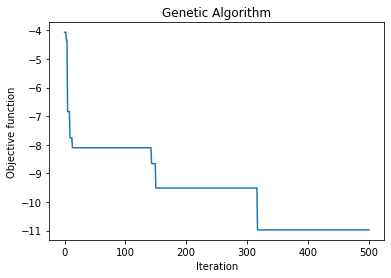

In [78]:
model_ga_t4 = geneticalgorithm(function=object_function_t4,
                               dimension=12,
                               variable_type='int',
                               variable_boundaries=varbound,
                               algorithm_parameters=algorithm_param)

model_ga_t4.run()

In [79]:
convergence_t4 = model_ga_t4.report
solution_t4 = model_ga_t4.output_dict

print(convergence_t4)
print(solution_t4)

[-4.064958251773321, -4.064958251773321, -4.064958251773321, -4.338339057394086, -4.338339057394086, -6.839728252740348, -6.839728252740348, -6.839728252740348, -6.839728252740348, -7.76093254288892, -7.76093254288892, -7.76093254288892, -7.76093254288892, -8.10454343070104, -8.10454343070104, -8.10454343070104, -8.10454343070104, -8.10454343070104, -8.10454343070104, -8.10454343070104, -8.10454343070104, -8.10454343070104, -8.10454343070104, -8.10454343070104, -8.10454343070104, -8.10454343070104, -8.10454343070104, -8.10454343070104, -8.10454343070104, -8.10454343070104, -8.10454343070104, -8.10454343070104, -8.10454343070104, -8.10454343070104, -8.10454343070104, -8.10454343070104, -8.10454343070104, -8.10454343070104, -8.10454343070104, -8.10454343070104, -8.10454343070104, -8.10454343070104, -8.10454343070104, -8.10454343070104, -8.10454343070104, -8.10454343070104, -8.10454343070104, -8.10454343070104, -8.10454343070104, -8.10454343070104, -8.10454343070104, -8.10454343070104, -8

In [80]:
ga_solution = input_conversion(solution_t4['variable'])
ga_solution = np.array(ga_solution).reshape(1, -1)

ga_solution_df = pd.DataFrame(ga_solution, columns=features)
ga_solution_df

,G1,absences,goout,age,famrel,studytime,Medu,Walc,Mjob_mean_enc,freetime,Fedu,Fjob_mean_enc
0,15.0,36.0,1.0,19.0,4.0,4.0,4.0,1.0,11.019417,1.0,4.0,10.297297


In [81]:
Fjob = Fjob_encode[Fjob_encode.isin(ga_solution_df['Fjob_mean_enc'])].index[0]
ga_solution_df['Fjob_mean_enc'] = Fjob
ga_solution_df = ga_solution_df.rename(columns={'Fjob_mean_enc': 'Fjob'})

Mjob = Mjob_encode[Mjob_encode.isin(ga_solution_df['Mjob_mean_enc'])].index[0]
ga_solution_df['Mjob_mean_enc'] = Mjob
ga_solution_df = ga_solution_df.rename(columns={'Mjob_mean_enc': 'Mjob'})
ga_solution_df

,G1,absences,goout,age,famrel,studytime,Medu,Walc,Mjob,freetime,Fedu,Fjob
0,15.0,36.0,1.0,19.0,4.0,4.0,4.0,1.0,services,1.0,4.0,services


In [82]:
prediction = voting_clf.predict(scaler.transform(ga_solution))
ga_solution_df['G3'] = prediction[0]
ga_solution_t4 = ga_solution_df
ga_solution_t4

,G1,absences,goout,age,famrel,studytime,Medu,Walc,Mjob,freetime,Fedu,Fjob,G3
0,15.0,36.0,1.0,19.0,4.0,4.0,4.0,1.0,services,1.0,4.0,services,13.999983


In [83]:
inf_input = copy.deepcopy(model_ga_t4)

distribution = []

for i in tqdm.tqdm(range(10000)):       
    inf_input.output_dict['variable'][1] = randint(df['absences'].min(), df['absences'].max())
    inf_input.output_dict['variable'][2] = randint(df['goout'].min(), df['goout'].max())
    inf_input.output_dict['variable'][3] = randint(df['age'].min(), df['age'].max())
    inf_input.output_dict['variable'][4] = randint(df['famrel'].min(), df['famrel'].max())
    inf_input.output_dict['variable'][5] = randint(df['studytime'].min(), df['studytime'].max())    
    inf_input.output_dict['variable'][7] = randint(df['Walc'].min(), df['Walc'].max())
    inf_input.output_dict['variable'][8] = randint(0, len(Mjob_encode) - 1)
    inf_input.output_dict['variable'][9] = randint(df['freetime'].min(), df['freetime'].max())    
    inf_input.output_dict['variable'][11] = randint(0, len(Fjob_encode) - 1)

    input_converted = input_conversion(inf_input.output_dict['variable'])
    input_converted = np.array(input_converted).reshape(1, -1)

    input_scaled = scaler.transform(input_converted)
    prediction = voting_clf.predict(input_scaled)    
    distribution.append([i, prediction[0]])

100%|██████████████████████████████████████████████████████████████████████████| 10000/10000 [00:05<00:00, 1931.85it/s]


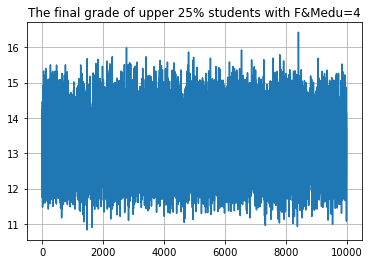

In [84]:
distribution_df = pd.DataFrame(distribution, columns=['trials', 'final_grade'])

plt.grid()
plt.title('The final grade of upper 25% students with F&Medu=4')
plt.plot(distribution_df['trials'], distribution_df['final_grade'])

Average views: 13.278036558846388
Median views: 13.27281451934398
Standard deviation of views [count]: 0.8969059586540474
Standard deviation of views     [%]: 6.754808624596615


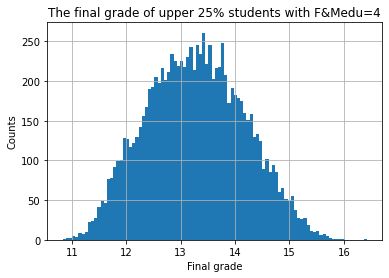

In [85]:
plt.grid()
plt.title('The final grade of upper 25% students with F&Medu=4')
plt.xlabel('Final grade')
plt.ylabel('Counts')
plt.hist(distribution_df['final_grade'], bins=96)

print('Average views:', distribution_df['final_grade'].mean())
print('Median views:', distribution_df['final_grade'].median())
print('Standard deviation of views [count]:', distribution_df['final_grade'].std())
print('Standard deviation of views     [%]:', distribution_df['final_grade'].std()*100 / distribution_df['final_grade'].mean())

#**Task 5. 목표값 탐색 + 변화량 분석**

In [86]:
# [GA 목표값 탐색 + 변화량 분석]
# 위 학생 공부시간 (study time)에 따른 최종 등급을 구하라.

In [87]:
inf_input = copy.deepcopy(model_ga_t4)

studytime_dep = []

for i in tqdm.tqdm(range(df['studytime'].min(), df['studytime'].max() + 1)):   
    inf_input.output_dict['variable'][5] = i

    input_converted = input_conversion(inf_input.output_dict['variable'])
    input_converted = np.array(input_converted).reshape(1, -1)

    input_scaled = scaler.transform(input_converted)
    prediction = voting_clf.predict(input_scaled)    
    studytime_dep.append([i, prediction[0]])

100%|██████████████████████████████████████████████████████████████████████████████████| 4/4 [00:00<00:00, 1999.91it/s]


<BarContainer object of 4 artists>

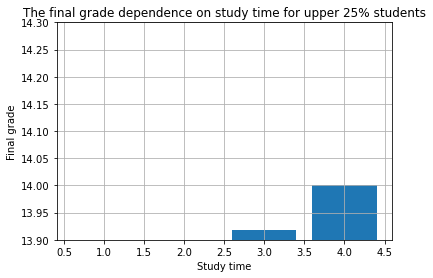

In [88]:
studytime_dep_df = pd.DataFrame(studytime_dep, columns=['studytime', 'G3'])

plt.title('The final grade dependence on study time for upper 25% students')
plt.xlabel('Study time')
plt.ylabel('Final grade')
plt.ylim(13.9, 14.3)
plt.grid()
plt.bar(studytime_dep_df['studytime'], studytime_dep_df['G3'])

#**Task 6. 최적해 탐색**

In [89]:
# [GA 최적해 탐색]
# 최대 등급 달성 (target G3 > 19.7) 가능 case를 제시하라.

In [90]:
# 0: 'G1',
# 1: 'absences',
# 2: 'goout',
# 3: 'age',
# 4: 'famrel',
# 5: 'studytime',
# 6: 'Medu',
# 7: 'Walc',
# 8: 'Mjob_mean_enc',
# 9: 'freetime',
# 10: 'Fedu',
# 11: 'Fjob_mean_enc'

varbound = np.array([[df['G1'].min(), df['G1'].max()],
                     [df['absences'].min(), df['absences'].max()],
                     [df['goout'].min(), df['goout'].max()],
                     [df['age'].min(), df['age'].max()],
                     [df['famrel'].min(), df['famrel'].max()],                     
                     [df['studytime'].min(), df['studytime'].max()],
                     [df['Medu'].min(), df['Medu'].max()],
                     [df['Walc'].min(), df['Walc'].max()],
                     [0, len(Mjob_encode) - 1],
                     [df['freetime'].min(), df['freetime'].max()],
                     [df['Fedu'].min(), df['Fedu'].max()],                     
                     [0, len(Fjob_encode) - 1]])

In [91]:
def object_function_t6(x_input, target_model=voting_clf):
    input_converted = input_conversion(x_input)
    input_converted = np.array(input_converted).reshape(1, -1)

    input_scaled = scaler.transform(input_converted)
    prediction = target_model.predict(input_scaled)

    # target = 20.0
    # print('Predicted views:', int(prediction), 'Difference from target:', int(prediction - target))
    print('Predicted grade:', prediction[0])

    return pow(-prediction[0], 3)

Predicted grade: 5.595851134182574
Predicted grade: 16.03966330921512
Predicted grade: 12.535775286939886
Predicted grade: 8.879892390069116
Predicted grade: 10.917181163724962
Predicted grade: 13.105258690155855
Predicted grade: 8.919065584176714
Predicted grade: 7.726246943223629
Predicted grade: 16.226497736192666
Predicted grade: 15.302949011697882
Predicted grade: 15.225201724715788
Predicted grade: 10.089968538144712
Predicted grade: 4.1182220085664945
Predicted grade: 3.115448335840039
Predicted grade: 7.640829849625537
Predicted grade: 7.387454195564206
Predicted grade: 9.703093507094131
Predicted grade: 14.55544983550073
Predicted grade: 7.638473410134179
Predicted grade: 4.241581090172834
Predicted grade: 11.074344984581458
Predicted grade: 5.050591955033558
Predicted grade: 9.105716533890542
Predicted grade: 5.870283444093381
Predicted grade: 4.6675469420684745
Predicted grade: 4.15160273892148
Predicted grade: 7.825329507766494
Predicted grade: 13.699555158106925
Predicted 

Predicted grade: 13.677702827804657
Predicted grade: 13.671617018742351
Predicted grade: 15.945192537181024
Predicted grade: 13.086257633441361
Predicted grade: 7.626924148891589
Predicted grade: 15.269339350509107
Predicted grade: 14.828287127599262
Predicted grade: 6.4252041687644805
Predicted grade: 13.457519268062791
Predicted grade: 11.887528105139005
Predicted grade: 8.475842383262133
Predicted grade: 12.937108105324787
Predicted grade: 13.710148657111873
Predicted grade: 14.736948183299015
Predicted grade: 4.158570240218386
Predicted grade: 15.750751929842965
Predicted grade: 13.840859120000836
Predicted grade: 17.34882252083667
Predicted grade: 13.55270541617689
Predicted grade: 13.494785308056727
Predicted grade: 13.69660393018854
Predicted grade: 11.337396113032916
Predicted grade: 17.19992170360307
Predicted grade: 10.79723272253448
Predicted grade: 13.075048676844636
Predicted grade: 13.281841543066198
Predicted grade: 6.234008708408912
Predicted grade: 14.753293911684452
P

Predicted grade: 15.060122897162698
Predicted grade: 12.293857843055326
Predicted grade: 15.977883042903406
Predicted grade: 16.419399474379947
Predicted grade: 15.904568273581853
Predicted grade: 13.396010926480885
Predicted grade: 15.918646177318264
Predicted grade: 5.882435678731958
Predicted grade: 15.2875403349095
Predicted grade: 13.905646389105073
Predicted grade: 17.942907428172962
Predicted grade: 16.545846113548357
Predicted grade: 15.680044099662906
Predicted grade: 12.440242496206006
Predicted grade: 17.32489266571695
Predicted grade: 4.717755899013753
Predicted grade: 13.6372190673781
Predicted grade: 14.821960324443914
Predicted grade: 18.140632676372373
Predicted grade: 17.69250983504226
Predicted grade: 9.851243382215971
Predicted grade: 17.29580954341278
Predicted grade: 13.931188527781787
Predicted grade: 15.97061970733598
Predicted grade: 15.01498347092729
Predicted grade: 14.612494462743568
Predicted grade: 16.448147391535183
Predicted grade: 16.60163494614074
Predi

Predicted grade: 14.868606147669794
Predicted grade: 16.442324046417912
Predicted grade: 14.816120985222376
Predicted grade: 8.462837269477648
Predicted grade: 18.301621026990784
Predicted grade: 7.247073524040257
Predicted grade: 13.943609625968627
Predicted grade: 18.011699744318484
Predicted grade: 15.697090210223417
Predicted grade: 5.677005292168338
Predicted grade: 12.121994690161145
Predicted grade: 9.962047472706615
Predicted grade: 10.489407327844772
Predicted grade: 17.43742637487268
Predicted grade: 16.979479755658392
Predicted grade: 15.597639957988099
Predicted grade: 16.148792576980668
Predicted grade: 16.585531391996053
Predicted grade: 17.198747904464998
Predicted grade: 15.33537869353606
Predicted grade: 15.330208331165245
Predicted grade: 15.103042738120822
Predicted grade: 14.67339866707767
Predicted grade: 15.502404488816884
Predicted grade: 13.992866584751354
Predicted grade: 5.816443423699745
Predicted grade: 16.41631645358486
Predicted grade: 15.012636442301476
P

|_________________________________________________ 1.4% GA is running...Predicted grade: 18.60587242924801
Predicted grade: 18.152154213009126
Predicted grade: 17.56701331035616
Predicted grade: 16.52484557222878
Predicted grade: 15.56874064623981
Predicted grade: 16.833366021304588
Predicted grade: 11.788082066352585
Predicted grade: 18.34061294373664
Predicted grade: 16.447214615775227
Predicted grade: 10.10017604462522
Predicted grade: 16.23369195805419
Predicted grade: 18.04531093906972
Predicted grade: 16.12863807445648
Predicted grade: 15.67757221291034
Predicted grade: 17.351562213143637
Predicted grade: 18.145219444690213
Predicted grade: 18.213109081824864
Predicted grade: 13.51368070383552
Predicted grade: 10.33046923833188
Predicted grade: 15.294566048231394
Predicted grade: 6.010533942221389
Predicted grade: 15.942740142458142
Predicted grade: 16.12965227518263
Predicted grade: 15.957987175638884
Predicted grade: 17.670210778198566
Predicted grade: 17.337825378836172
Predic

Predicted grade: 16.05074719779498
Predicted grade: 16.442118790681054
Predicted grade: 13.4610295689787
Predicted grade: 17.723826831791385
Predicted grade: 12.02704008321029
Predicted grade: 16.12408836404097
Predicted grade: 17.79161574332599
Predicted grade: 17.04073159610381
Predicted grade: 17.80230833499157
Predicted grade: 16.867103349069566
Predicted grade: 15.459008759610455
Predicted grade: 15.963380319817304
Predicted grade: 17.54063527237183
Predicted grade: 15.816014278241033
Predicted grade: 16.86824035222676
Predicted grade: 17.436854242819873
Predicted grade: 18.05794985323692
Predicted grade: 17.467331204409255
Predicted grade: 17.336271300690072
Predicted grade: 18.43862324162245
Predicted grade: 17.80376343654797
Predicted grade: 16.027754962453216
Predicted grade: 17.961726280577203
Predicted grade: 17.880686775034885
Predicted grade: 18.222396343838714
Predicted grade: 17.67975056144902
Predicted grade: 11.295722598891684
Predicted grade: 15.688691981486935
Predic

Predicted grade: 17.746653738801133
Predicted grade: 17.8244457918199
Predicted grade: 17.19717674332834
Predicted grade: 16.90265414127774
Predicted grade: 17.958794632295977
Predicted grade: 14.346801703258103
Predicted grade: 16.30437454063226
Predicted grade: 16.282310429003953
Predicted grade: 18.329511030009606
Predicted grade: 13.781270645561216
Predicted grade: 16.554017468718516
Predicted grade: 16.3937196264857
Predicted grade: 17.250338406461307
Predicted grade: 17.64460222861903
Predicted grade: 18.27476726355831
Predicted grade: 16.996783815091238
Predicted grade: 15.556748653657118
Predicted grade: 15.531462786207285
Predicted grade: 11.741906356071325
Predicted grade: 17.99738337395492
Predicted grade: 17.890932005095767
Predicted grade: 14.99179747594392
Predicted grade: 15.553422629815644
Predicted grade: 17.301478351689262
Predicted grade: 17.303748375990423
Predicted grade: 14.072166043360676
Predicted grade: 16.878395277956198
Predicted grade: 16.939172920798978
Pre

|_________________________________________________ 2.4% GA is running...Predicted grade: 17.698984930450543
Predicted grade: 14.786187401906
Predicted grade: 16.04926164712774
Predicted grade: 16.65669846586078
Predicted grade: 16.68590809311017
Predicted grade: 17.335351366838932
Predicted grade: 17.059999801951747
Predicted grade: 18.072292039488687
Predicted grade: 15.974404515609072
Predicted grade: 17.98364268845761
Predicted grade: 17.957886469010635
Predicted grade: 18.14306753248557
Predicted grade: 17.585097150411517
Predicted grade: 17.816639619880455
Predicted grade: 16.13780609185284
Predicted grade: 17.336648136143083
Predicted grade: 17.697026802078916
Predicted grade: 18.419438200013733
Predicted grade: 18.003206679230757
Predicted grade: 17.134341070807253
Predicted grade: 17.48174134817864
Predicted grade: 18.16814079643172
Predicted grade: 16.614076560915425
Predicted grade: 17.757577816584455
Predicted grade: 18.394968408889408
Predicted grade: 17.403032296631658
Pre

Predicted grade: 17.450197317863275
Predicted grade: 17.929976548655404
Predicted grade: 17.2501724874659
Predicted grade: 18.450565131823268
Predicted grade: 17.22576297263301
Predicted grade: 16.152081152490478
Predicted grade: 18.308518123135737
Predicted grade: 16.766135292167238
Predicted grade: 18.1113333608243
Predicted grade: 6.285930047505982
Predicted grade: 16.68813839599272
Predicted grade: 16.630177527592824
Predicted grade: 16.989854310604425
Predicted grade: 18.123070772234893
Predicted grade: 7.17413701814548
Predicted grade: 6.086774803051462
Predicted grade: 18.325537593860822
Predicted grade: 15.667082306738825
Predicted grade: 17.327073453079834
Predicted grade: 2.6682516107298895
Predicted grade: 18.146815151943617
Predicted grade: 16.748314984670188
Predicted grade: 18.280482613709335
Predicted grade: 18.53403786923251
Predicted grade: 17.653814508896872
Predicted grade: 5.724612242556847
Predicted grade: 16.46200993742039
Predicted grade: 16.731595396568355
Predi

Predicted grade: 18.579248598287
Predicted grade: 12.227191261288667
Predicted grade: 18.27102081370127
Predicted grade: 16.951094358652615
Predicted grade: 17.835583898905956
Predicted grade: 18.304022592031018
Predicted grade: 18.688842301653775
Predicted grade: 16.367080208667808
Predicted grade: 17.51699208238792
Predicted grade: 18.038197308731856
Predicted grade: 17.326305232453304
Predicted grade: 15.932442357175189
Predicted grade: 11.611984094307926
Predicted grade: 17.934591644820973
Predicted grade: 4.5231864484176985
Predicted grade: 14.847477636518896
Predicted grade: 17.697772501554027
Predicted grade: 17.013168165691358
Predicted grade: 9.284707657799167
Predicted grade: 11.65234418719642
Predicted grade: 17.03004007158963
Predicted grade: 7.3669010139799544
Predicted grade: 16.983919334656076
Predicted grade: 19.045711762824848
Predicted grade: 16.375112692765473
Predicted grade: 13.792654208217996
Predicted grade: 17.975196221224408
Predicted grade: 13.277009737849864


||________________________________________________ 3.4% GA is running...Predicted grade: 15.884227853169262
Predicted grade: 18.518108602989823
Predicted grade: 17.565428280560635
Predicted grade: 18.097197862694454
Predicted grade: 16.85025075742413
Predicted grade: 18.323086250987615
Predicted grade: 5.561023473267366
Predicted grade: 18.09314863754047
Predicted grade: 16.008602719660825
Predicted grade: 18.183575210931245
Predicted grade: 18.086388351530164
Predicted grade: 18.943124858358654
Predicted grade: 18.04595630716092
Predicted grade: 17.929460015299266
Predicted grade: 12.237016628662928
Predicted grade: 17.194526186509552
Predicted grade: 16.00638079074689
Predicted grade: 17.71936472077378
Predicted grade: 18.663714714334837
Predicted grade: 12.27272167477562
Predicted grade: 18.00770964379499
Predicted grade: 17.822833024673816
Predicted grade: 18.438595439300432
Predicted grade: 12.828400738707813
Predicted grade: 18.05123172695806
Predicted grade: 15.578559407697567
P

Predicted grade: 17.409061686423836
Predicted grade: 18.832030471323915
Predicted grade: 17.127941457795817
Predicted grade: 15.50086540815204
Predicted grade: 17.5465490236215
Predicted grade: 18.43347346144781
Predicted grade: 17.50999930149101
Predicted grade: 18.422202186641503
Predicted grade: 17.31544334940466
Predicted grade: 17.508695823270916
Predicted grade: 17.632455424062364
Predicted grade: 17.537576460995293
Predicted grade: 6.0792738295170805
Predicted grade: 15.539242143290489
Predicted grade: 18.20063886301549
Predicted grade: 17.234894680860986
Predicted grade: 18.5691585897763
Predicted grade: 17.401414437771596
Predicted grade: 18.45210638480832
Predicted grade: 17.416365102594742
Predicted grade: 18.11281761995161
Predicted grade: 17.525509101372545
Predicted grade: 19.27855354246857
Predicted grade: 19.204696123348004
Predicted grade: 18.07300215223908
Predicted grade: 18.61191198532983
Predicted grade: 13.438662230923184
Predicted grade: 17.835246927684956
Predic

Predicted grade: 19.485581995041
Predicted grade: 17.584312324855706
Predicted grade: 18.84745478329532
Predicted grade: 18.918913563685525
Predicted grade: 17.908667510428025
Predicted grade: 17.848574747580198
Predicted grade: 18.33284608455293
Predicted grade: 12.916884385327384
Predicted grade: 15.671953662763949
Predicted grade: 14.068101325785712
Predicted grade: 15.58155303856815
Predicted grade: 18.068044461874347
Predicted grade: 18.271710738263835
Predicted grade: 15.76871949111495
Predicted grade: 17.866224845464867
Predicted grade: 10.639670736635802
Predicted grade: 18.689327251712985
Predicted grade: 19.152773988452402
Predicted grade: 17.803414372510655
Predicted grade: 16.14449289690521
Predicted grade: 16.128848952434087
Predicted grade: 13.338997626869483
Predicted grade: 17.22176459378563
Predicted grade: 17.40211142656674
Predicted grade: 18.458860555124193
Predicted grade: 17.193412547162797
Predicted grade: 17.170637170818846
Predicted grade: 17.933972077715424
Pr

Predicted grade: 16.72618389422055
Predicted grade: 15.747927909355958
Predicted grade: 18.201956785921936
Predicted grade: 17.984199514677137
Predicted grade: 19.15984757589482
Predicted grade: 18.905304282266766
||________________________________________________ 4.4% GA is running...Predicted grade: 17.189719643179604
Predicted grade: 5.5850549732760895
Predicted grade: 13.103096145515169
Predicted grade: 12.713123199884336
Predicted grade: 15.79170645791038
Predicted grade: 18.29127715659142
Predicted grade: 17.240973856649052
Predicted grade: 17.432829711817945
Predicted grade: 17.50033527677695
Predicted grade: 7.707325275824054
Predicted grade: 16.9371537064503
Predicted grade: 15.11405840908854
Predicted grade: 17.015949465032868
Predicted grade: 16.8789157767452
Predicted grade: 16.635765166176462
Predicted grade: 12.81862711333257
Predicted grade: 18.277649831786906
Predicted grade: 18.547704754559778
Predicted grade: 7.282631652991291
Predicted grade: 18.1249845632645
Predict

Predicted grade: 17.591799223705593
Predicted grade: 17.891057893493727
Predicted grade: 13.161656821741731
Predicted grade: 16.97276615950303
Predicted grade: 19.290524271449254
Predicted grade: 15.285071109480365
Predicted grade: 12.723265065240815
Predicted grade: 17.841303100665424
Predicted grade: 6.478926761837297
Predicted grade: 18.24526244601883
Predicted grade: 17.685967027239617
Predicted grade: 17.100724612367625
Predicted grade: 8.589971952178749
Predicted grade: 16.177327072237038
Predicted grade: 9.720397751108388
Predicted grade: 18.677811525976693
Predicted grade: 15.843746070493788
Predicted grade: 16.854928119208214
Predicted grade: 17.569956941059907
Predicted grade: 18.704804133293596
Predicted grade: 18.72998168308173
Predicted grade: 11.759133392711343
Predicted grade: 18.08713435592706
Predicted grade: 19.057531702646287
Predicted grade: 16.472543815252376
Predicted grade: 18.276247178477394
Predicted grade: 17.96622093840723
Predicted grade: 18.531805319696304


Predicted grade: 17.48033318582284
Predicted grade: 16.095410545510592
Predicted grade: 16.153511708227153
Predicted grade: 15.903418978886974
Predicted grade: 5.902779476450017
Predicted grade: 16.64679045867157
Predicted grade: 8.37862271890866
Predicted grade: 17.696044604637006
Predicted grade: 14.845999644670863
Predicted grade: 18.271734822188183
Predicted grade: 17.291582989012294
Predicted grade: 19.506785805148983
Predicted grade: 17.892027135288004
Predicted grade: 18.726587361497266
Predicted grade: 19.396750652905737
Predicted grade: 17.100253987346495
Predicted grade: 16.976109344337925
Predicted grade: 17.100724612367625
Predicted grade: 16.519197681677877
Predicted grade: 16.460445125724814
Predicted grade: 18.35692306078639
Predicted grade: 17.021775914924568
Predicted grade: 18.309357412134258
Predicted grade: 16.16490074650534
Predicted grade: 17.378546117151394
Predicted grade: 15.069328702054614
Predicted grade: 17.270527298890475
Predicted grade: 19.15166291921484


Predicted grade: 18.37557076559878
Predicted grade: 17.67553630763393
Predicted grade: 18.11064436913291
Predicted grade: 18.29190126225244
Predicted grade: 17.6550455891334
Predicted grade: 18.387005741374512
Predicted grade: 17.885438954723465
Predicted grade: 14.588941923995021
Predicted grade: 18.512656433732552
Predicted grade: 13.475097479364571
Predicted grade: 16.670156097950947
Predicted grade: 15.78865657078507
Predicted grade: 14.870584939264555
Predicted grade: 18.7365928937882
|||_______________________________________________ 5.4% GA is running...Predicted grade: 19.2074558376523
Predicted grade: 18.579132644064707
Predicted grade: 13.657824772179348
Predicted grade: 17.342229752517856
Predicted grade: 8.911043851141068
Predicted grade: 16.171622427762795
Predicted grade: 18.279087628013322
Predicted grade: 18.352633678005834
Predicted grade: 4.350334743323908
Predicted grade: 6.068329345160386
Predicted grade: 12.382846972368364
Predicted grade: 17.688847738824496
Predic

Predicted grade: 17.733216036530234
Predicted grade: 17.761482275023756
Predicted grade: 18.37806684999251
Predicted grade: 17.373683130130413
Predicted grade: 18.35931296164105
Predicted grade: 18.26883805533677
Predicted grade: 17.448915621387915
Predicted grade: 18.3471815467966
Predicted grade: 18.448710091319462
Predicted grade: 17.724187300796093
Predicted grade: 17.721440164852414
Predicted grade: 17.805350507108837
Predicted grade: 12.023475936702122
Predicted grade: 16.65930336146366
Predicted grade: 16.5081606582114
Predicted grade: 11.751338841550004
Predicted grade: 18.47767232156495
Predicted grade: 18.10199009317002
Predicted grade: 15.243597171800644
Predicted grade: 17.897122113085185
Predicted grade: 18.9893429555687
Predicted grade: 18.880750562722323
Predicted grade: 18.477514319197144
Predicted grade: 10.488354163226496
Predicted grade: 15.523372139879314
Predicted grade: 19.108045538671394
Predicted grade: 12.719283866938554
Predicted grade: 18.36219864282575
Predi

Predicted grade: 3.576203436175028
Predicted grade: 17.889560787716103
Predicted grade: 18.336945881580444
Predicted grade: 17.518510984545404
Predicted grade: 17.993129771903924
Predicted grade: 17.875411981858942
Predicted grade: 15.591355805942948
Predicted grade: 19.334422232439568
Predicted grade: 17.953757717877227
Predicted grade: 16.5937346963694
Predicted grade: 18.019273169526468
Predicted grade: 6.460642006330768
Predicted grade: 8.927862071027546
Predicted grade: 18.018821875309886
Predicted grade: 15.450165341699822
Predicted grade: 17.03548232948468
Predicted grade: 15.670057698832338
Predicted grade: 18.607449226812985
Predicted grade: 18.120688468196374
Predicted grade: 17.12479954102771
Predicted grade: 18.339809964687802
Predicted grade: 18.060217104722547
Predicted grade: 16.45545765014457
Predicted grade: 5.239964282492086
Predicted grade: 16.063423322798993
Predicted grade: 18.29297552320872
Predicted grade: 18.32374165571368
Predicted grade: 18.29508272938257
Pred

Predicted grade: 18.433875187074296
Predicted grade: 17.124678194920094
Predicted grade: 16.151787638576753
Predicted grade: 18.270235572490474
Predicted grade: 8.82384136128663
Predicted grade: 18.566420909222348
Predicted grade: 17.96303733959556
Predicted grade: 17.96723017529034
Predicted grade: 17.989319140337187
Predicted grade: 18.872130068447543
Predicted grade: 17.614436926292388
Predicted grade: 15.902279200390792
Predicted grade: 18.56284282782811
Predicted grade: 10.432973500636338
Predicted grade: 19.60941907654493
|||_______________________________________________ 6.4% GA is running...Predicted grade: 9.310039489564787
Predicted grade: 12.14695365850496
Predicted grade: 19.485581995041
Predicted grade: 16.527488730105286
Predicted grade: 7.280125604246014
Predicted grade: 17.917366532552016
Predicted grade: 17.467134808363053
Predicted grade: 18.275409049011724
Predicted grade: 17.30524895559282
Predicted grade: 18.28520183079998
Predicted grade: 12.945289353557285
Predic

Predicted grade: 15.84212954796773
Predicted grade: 18.237780459294857
Predicted grade: 17.35276962903079
Predicted grade: 18.335359884609243
Predicted grade: 15.872067431514916
Predicted grade: 19.010984762746137
Predicted grade: 14.056451363468781
Predicted grade: 17.002068691725157
Predicted grade: 17.25781042915022
Predicted grade: 18.588961761923965
Predicted grade: 16.34186663029868
Predicted grade: 17.864153105574186
Predicted grade: 17.416285585064095
Predicted grade: 17.707245828052294
Predicted grade: 5.089919434512805
Predicted grade: 16.771230272075602
Predicted grade: 6.227215231455045
Predicted grade: 18.259802445607153
Predicted grade: 16.040402023298007
Predicted grade: 12.763869056974023
Predicted grade: 8.614872086517527
Predicted grade: 18.363685223137903
Predicted grade: 16.72936950740734
Predicted grade: 15.619310726096751
Predicted grade: 13.656923640451012
Predicted grade: 16.232486493153246
Predicted grade: 17.680067183392058
Predicted grade: 17.87900300406881
P

Predicted grade: 18.49989889751028
Predicted grade: 18.004463026966246
Predicted grade: 17.353425359784975
Predicted grade: 16.100199484551037
Predicted grade: 17.526713352013108
Predicted grade: 17.060475182543737
Predicted grade: 16.752974780736793
Predicted grade: 16.97839502082147
Predicted grade: 18.067056319374966
Predicted grade: 18.64679101783132
Predicted grade: 10.873535061699206
Predicted grade: 15.723195004454867
Predicted grade: 15.728887708352127
Predicted grade: 11.414684251675354
Predicted grade: 18.103485455814845
Predicted grade: 18.613537253681894
Predicted grade: 15.986106381525133
Predicted grade: 17.79698543455703
Predicted grade: 18.43814053620852
Predicted grade: 18.656024482198923
Predicted grade: 17.851664192397532
Predicted grade: 17.74398653136763
Predicted grade: 16.83380987864834
Predicted grade: 16.34222359458198
Predicted grade: 18.191603994324776
Predicted grade: 11.376172107225765
Predicted grade: 15.431685609883687
Predicted grade: 17.754268018263122


Predicted grade: 16.63815791618079
Predicted grade: 16.215346283539535
Predicted grade: 15.862606732108256
Predicted grade: 11.173921475676655
Predicted grade: 16.99541403133631
Predicted grade: 10.641534148285613
Predicted grade: 16.510770604387492
Predicted grade: 17.040670565332988
Predicted grade: 16.068375239622267
Predicted grade: 16.53580535648253
Predicted grade: 17.281183131563
Predicted grade: 15.300999108059381
Predicted grade: 17.877022020257254
Predicted grade: 15.987616559105732
Predicted grade: 17.054576913282467
Predicted grade: 8.819276331396376
Predicted grade: 16.77176902711206
Predicted grade: 17.327279253624976
Predicted grade: 8.03377902551172
Predicted grade: 18.23905650235758
Predicted grade: 16.956947170775063
Predicted grade: 16.4616500672592
Predicted grade: 17.171401879718477
Predicted grade: 16.163225754299457
Predicted grade: 17.523491283544672
Predicted grade: 17.40368691829985
Predicted grade: 16.373789826723243
Predicted grade: 16.219863303870877
Predic

Predicted grade: 16.954389033167427
Predicted grade: 5.959688719417403
Predicted grade: 17.918348593696408
Predicted grade: 17.911974000723777
Predicted grade: 7.710117754732573
Predicted grade: 14.239878661064296
Predicted grade: 15.075469152150426
Predicted grade: 15.330294003574373
Predicted grade: 14.884498909494397
Predicted grade: 10.742567708927226
Predicted grade: 18.489266395662828
Predicted grade: 17.75791415497292
Predicted grade: 17.189823156779113
Predicted grade: 18.905745508319466
Predicted grade: 15.718060985783183
Predicted grade: 16.28844886502986
Predicted grade: 17.685187335410443
Predicted grade: 16.608023164822825
Predicted grade: 6.707199380574802
Predicted grade: 16.132626803417725
Predicted grade: 17.421628180734032
Predicted grade: 17.257915613006233
Predicted grade: 17.621268766620535
Predicted grade: 17.332288448568995
Predicted grade: 15.983538340542589
Predicted grade: 16.1082072003616
Predicted grade: 14.145231534880564
Predicted grade: 17.37220323114443


Predicted grade: 13.877068412340124
Predicted grade: 15.2675350456314
Predicted grade: 8.118560527943377
Predicted grade: 17.56610087409149
Predicted grade: 17.417430728851894
Predicted grade: 16.647190299885427
Predicted grade: 17.805887863643065
Predicted grade: 12.568912778768523
Predicted grade: 17.889233130342323
Predicted grade: 9.656163458265548
Predicted grade: 17.009102938784633
Predicted grade: 18.232525593692312
Predicted grade: 18.55518195600224
Predicted grade: 16.9415920571556
Predicted grade: 17.524041396090315
Predicted grade: 17.454504311004488
Predicted grade: 17.995249466957123
Predicted grade: 18.489266395662828
Predicted grade: 16.51013681323656
Predicted grade: 16.02795636977244
Predicted grade: 17.285780250928934
Predicted grade: 18.341719980283063
Predicted grade: 13.732464804898706
Predicted grade: 16.78765650529663
Predicted grade: 18.545619171990438
Predicted grade: 17.912639696445787
Predicted grade: 16.84503478276498
Predicted grade: 12.907060230064488
Pred

Predicted grade: 15.340182902355048
Predicted grade: 17.012254916517133
Predicted grade: 14.407415860310309
Predicted grade: 17.5814060548875
Predicted grade: 17.669256895559883
Predicted grade: 5.446188117769952
Predicted grade: 18.812416721970106
Predicted grade: 14.125862756923205
Predicted grade: 14.97189248845428
Predicted grade: 16.45966367386372
Predicted grade: 17.262261960258517
Predicted grade: 18.458884398494508
Predicted grade: 18.64655410681303
Predicted grade: 17.290667554860025
Predicted grade: 16.61535044286944
Predicted grade: 16.56379502508964
Predicted grade: 14.707149732596562
Predicted grade: 18.132831127972374
Predicted grade: 16.543281682580762
Predicted grade: 15.312398773085773
Predicted grade: 18.003054902552524
Predicted grade: 17.14232770330297
Predicted grade: 14.054889587188898
Predicted grade: 16.96422894776259
Predicted grade: 14.025837379087898
Predicted grade: 16.06656984302039
Predicted grade: 15.665326054353054
Predicted grade: 15.19940158155039
Pred

Predicted grade: 17.51347100025825
Predicted grade: 16.29348314011852
Predicted grade: 6.873948537744668
Predicted grade: 17.47197840939266
Predicted grade: 18.652359132352494
Predicted grade: 6.390312050916708
Predicted grade: 17.490140565254258
Predicted grade: 18.305688523867847
Predicted grade: 16.310033836755164
Predicted grade: 18.089133380676007
Predicted grade: 18.427693459107427
Predicted grade: 15.538201927469855
Predicted grade: 16.98046676306598
Predicted grade: 17.8070158313533
Predicted grade: 18.562440645708424
Predicted grade: 13.172652102605822
Predicted grade: 15.728238050845475
Predicted grade: 18.51725905020601
Predicted grade: 16.832834576585338
Predicted grade: 17.73928211434112
Predicted grade: 17.38334082540236
Predicted grade: 17.17353234815609
Predicted grade: 17.011137493478596
Predicted grade: 17.99400016896018
Predicted grade: 18.133273469613176
Predicted grade: 18.18648621333666
Predicted grade: 19.120754891475926
Predicted grade: 17.654964210772317
Predic

Predicted grade: 17.120936975321754
Predicted grade: 19.05429220990555
Predicted grade: 19.318691300348284
Predicted grade: 15.473474922425417
Predicted grade: 19.220174771954166
Predicted grade: 19.30655484760194
Predicted grade: 16.52678407793856
Predicted grade: 15.247552893278623
Predicted grade: 12.850883423107007
Predicted grade: 18.095734905755045
Predicted grade: 15.055773941274609
Predicted grade: 18.078208396933146
Predicted grade: 15.147153494516578
Predicted grade: 14.378818239672354
Predicted grade: 17.80605076402271
Predicted grade: 15.659446626676775
Predicted grade: 16.838867355930752
Predicted grade: 18.517418449986973
Predicted grade: 17.90380230504068
Predicted grade: 4.63157764094406
Predicted grade: 10.99614515353682
Predicted grade: 19.1370270605789
Predicted grade: 18.6577425676824
Predicted grade: 16.564073781871997
Predicted grade: 19.45500366693874
Predicted grade: 19.052631840447535
Predicted grade: 9.31325898686079
Predicted grade: 17.55485261025377
Predicte

Predicted grade: 17.959127918708166
Predicted grade: 18.772794019960845
Predicted grade: 17.08880135677209
Predicted grade: 12.886404797805122
Predicted grade: 18.520553637178423
Predicted grade: 18.051788096490085
Predicted grade: 16.090064712762977
Predicted grade: 18.366787701511935
Predicted grade: 19.328797307004617
Predicted grade: 16.480620272109892
Predicted grade: 17.23656056324116
Predicted grade: 17.614584373034464
Predicted grade: 16.705224438298817
Predicted grade: 17.601169085051783
Predicted grade: 18.190534717945287
Predicted grade: 14.671308634892343
Predicted grade: 18.770710201124775
Predicted grade: 17.42952118343951
Predicted grade: 18.42550503840544
Predicted grade: 17.722183826342235
Predicted grade: 18.41585613374862
Predicted grade: 15.449717663313047
Predicted grade: 19.3449044934864
Predicted grade: 18.619333718013834
Predicted grade: 18.50932944826199
Predicted grade: 17.752417148249
Predicted grade: 19.04153701341547
Predicted grade: 18.304092266388416
Pred

Predicted grade: 18.121339756300014
Predicted grade: 19.074492205291904
Predicted grade: 16.02146099913725
Predicted grade: 17.668236289385778
Predicted grade: 16.386070005917805
Predicted grade: 16.5953211573897
Predicted grade: 17.42504216621378
Predicted grade: 17.610821959757324
Predicted grade: 15.116789310403831
Predicted grade: 17.530707868547584
Predicted grade: 18.74940137290115
Predicted grade: 14.997911514507358
Predicted grade: 19.135616570896016
Predicted grade: 15.542589347806976
Predicted grade: 17.952244685535074
Predicted grade: 16.771534767793327
Predicted grade: 16.039472885059443
Predicted grade: 17.850719623309576
Predicted grade: 12.645088733768524
Predicted grade: 17.8854202710569
Predicted grade: 15.57357174890364
Predicted grade: 16.057505928801305
Predicted grade: 18.34869979075601
Predicted grade: 14.374862491793872
Predicted grade: 17.601123888124036
Predicted grade: 18.008422999403816
Predicted grade: 18.563115761083154
Predicted grade: 16.54936116904015
Pr

Predicted grade: 16.820887152319422
Predicted grade: 7.228663629362096
Predicted grade: 17.307198083278465
Predicted grade: 17.20693316313977
Predicted grade: 7.278344632004598
Predicted grade: 19.427528146573817
Predicted grade: 16.478364496361934
Predicted grade: 17.78455491294496
Predicted grade: 18.97561434866552
Predicted grade: 18.356559685077247
Predicted grade: 17.65297410923083
Predicted grade: 18.8214911636112
Predicted grade: 18.66296489623304
Predicted grade: 18.296248238751875
Predicted grade: 15.690881164873508
Predicted grade: 17.120364869676035
Predicted grade: 16.849537461429005
Predicted grade: 17.85022661292017
Predicted grade: 18.76547457405462
Predicted grade: 18.518950218165276
Predicted grade: 14.165827010605911
Predicted grade: 12.99770689840612
Predicted grade: 8.788136085953429
Predicted grade: 18.070701751887317
Predicted grade: 17.02870028011087
Predicted grade: 14.995894500042539
Predicted grade: 18.461729714858922
Predicted grade: 18.837390439539785
Predic

Predicted grade: 17.71376529541458
Predicted grade: 18.227966514832083
Predicted grade: 17.58715128075195
Predicted grade: 17.2318737231184
Predicted grade: 16.45305398957156
Predicted grade: 18.384901751516292
Predicted grade: 6.217550715512211
Predicted grade: 17.02302660423023
Predicted grade: 18.308446621738774
Predicted grade: 18.448938359190382
Predicted grade: 16.780609109094396
Predicted grade: 18.09500535468468
Predicted grade: 19.96735192523467
Predicted grade: 19.01967388336361
Predicted grade: 18.25006059413785
Predicted grade: 18.164613948190517
Predicted grade: 15.228487530510527
Predicted grade: 18.97246701813178
Predicted grade: 18.100053453528954
Predicted grade: 18.609966747119646
Predicted grade: 16.97184256441743
Predicted grade: 18.759158099409305
Predicted grade: 15.780345513063958
Predicted grade: 18.09142248527017
Predicted grade: 17.579160815903162
Predicted grade: 18.621661594516016
Predicted grade: 17.898786636082146
Predicted grade: 18.49364835745224
Predict

Predicted grade: 18.568271313802857
Predicted grade: 18.686398704867827
Predicted grade: 16.115120843489024
Predicted grade: 15.446982589488437
Predicted grade: 8.411344135061816
Predicted grade: 17.56944409578164
Predicted grade: 17.62529448067178
Predicted grade: 17.929218643135318
Predicted grade: 17.854314488453976
Predicted grade: 17.290089942764627
Predicted grade: 18.387107682014854
Predicted grade: 17.767908991622786
Predicted grade: 18.085812946112387
Predicted grade: 17.079528322265357
Predicted grade: 17.422498135571395
Predicted grade: 18.08889938831601
Predicted grade: 18.430787931921913
Predicted grade: 18.609560929437134
Predicted grade: 19.339595713102444
Predicted grade: 13.948110235083783
Predicted grade: 18.87842557897058
Predicted grade: 14.50737046954553
Predicted grade: 18.374288958935427
Predicted grade: 19.114070998710833
Predicted grade: 18.620626692708118
Predicted grade: 19.26020610356834
Predicted grade: 16.571119339667447
Predicted grade: 17.00622272554826


Predicted grade: 17.265842593138544
Predicted grade: 17.137346889855394
Predicted grade: 17.58822491398055
Predicted grade: 18.232034440016367
Predicted grade: 18.013615764341726
Predicted grade: 16.245401762046495
Predicted grade: 17.26103116379632
Predicted grade: 13.786390784939966
Predicted grade: 18.12484922161699
Predicted grade: 17.576112780563594
Predicted grade: 18.750332790743613
Predicted grade: 16.73114050838022
Predicted grade: 19.331587324257725
Predicted grade: 17.098864745759226
Predicted grade: 16.91528670394863
Predicted grade: 17.843400742815337
Predicted grade: 10.160448017545518
Predicted grade: 17.012981520038974
Predicted grade: 5.510078631419458
Predicted grade: 16.577263971549296
Predicted grade: 17.754916641381243
Predicted grade: 17.21172539653517
Predicted grade: 17.831731683429833
Predicted grade: 16.694818964015948
Predicted grade: 18.813815008430776
Predicted grade: 18.29079839767594
Predicted grade: 19.540640528087035
Predicted grade: 18.76808694121636
P

Predicted grade: 18.23244278781549
Predicted grade: 16.78137824274628
Predicted grade: 18.183079703802296
Predicted grade: 17.337838533043794
Predicted grade: 17.424957463898675
Predicted grade: 15.848366923139814
Predicted grade: 14.318224931544455
Predicted grade: 17.810013733378295
Predicted grade: 18.511369926535114
Predicted grade: 17.641063000219734
Predicted grade: 5.57538940648563
Predicted grade: 18.16821475788069
Predicted grade: 16.65598318465195
Predicted grade: 18.5801636762876
Predicted grade: 19.793164353080797
Predicted grade: 18.256682714558366
Predicted grade: 16.416901185009518
Predicted grade: 18.264005186137
Predicted grade: 17.21098270103803
Predicted grade: 17.309626021308592
Predicted grade: 16.45089145920738
Predicted grade: 17.059315370424983
Predicted grade: 17.330906928619456
Predicted grade: 17.900169558953664
Predicted grade: 18.421041098069246
Predicted grade: 17.861614241563277
Predicted grade: 17.91062022321492
Predicted grade: 18.37207200530483
Predict

Predicted grade: 18.598487198672306
Predicted grade: 17.57530434471632
Predicted grade: 17.828987533900886
Predicted grade: 17.972146536773867
Predicted grade: 18.763407926963865
Predicted grade: 18.808738550219477
Predicted grade: 16.304740673263886
Predicted grade: 18.02026669339369
Predicted grade: 18.02026669339369
Predicted grade: 17.810968087660953
Predicted grade: 17.338451033988235
Predicted grade: 17.26257682402632
Predicted grade: 17.166261992634848
Predicted grade: 11.138278236275633
Predicted grade: 17.642293730457038
Predicted grade: 17.05530805409414
Predicted grade: 17.316816133233797
Predicted grade: 17.75401867460801
Predicted grade: 18.345651831957944
Predicted grade: 4.989355631093688
Predicted grade: 17.400092900574112
Predicted grade: 16.930970108384713
Predicted grade: 18.07700051528889
Predicted grade: 18.61108492158932
Predicted grade: 17.0834294199174
Predicted grade: 7.408717909056693
Predicted grade: 18.305562495057796
Predicted grade: 16.27592582709595
Predi

Predicted grade: 16.213306420299013
Predicted grade: 19.104299211291202
Predicted grade: 14.28791979409665
Predicted grade: 16.938861386290203
Predicted grade: 18.419611734689223
Predicted grade: 14.036980310435702
Predicted grade: 18.30193275248374
Predicted grade: 18.114259873469127
Predicted grade: 17.781764852464686
Predicted grade: 18.694808505873564
Predicted grade: 17.377737292534665
Predicted grade: 18.65874229064507
Predicted grade: 17.004705181485736
Predicted grade: 17.94803672786345
Predicted grade: 18.32557443407529
Predicted grade: 18.404642767493154
Predicted grade: 17.4777384631718
Predicted grade: 18.220215461213016
Predicted grade: 15.392141693401916
Predicted grade: 18.451341838441866
Predicted grade: 17.569877604533062
Predicted grade: 16.400608806132386
Predicted grade: 18.115334323651386
Predicted grade: 17.893472513983493
Predicted grade: 5.337982444032337
Predicted grade: 15.666062964259808
Predicted grade: 17.243781567455578
Predicted grade: 17.04172777730435
P

Predicted grade: 17.705240893116468
Predicted grade: 16.407384094930702
Predicted grade: 18.3379164651445
Predicted grade: 16.285594428833207
Predicted grade: 16.302088277813002
Predicted grade: 17.654399785621507
Predicted grade: 16.72790924522134
Predicted grade: 8.805351159633265
Predicted grade: 18.26639535356302
Predicted grade: 18.56376740979285
Predicted grade: 18.052417686970514
Predicted grade: 18.15924915454197
Predicted grade: 18.13802929552566
Predicted grade: 18.029827308645
Predicted grade: 17.626727297413467
Predicted grade: 17.058552137852526
Predicted grade: 18.061179351919577
Predicted grade: 18.932896461237775
Predicted grade: 17.538172580489228
Predicted grade: 17.372378429829407
Predicted grade: 17.103636712799517
Predicted grade: 17.32143545708235
Predicted grade: 17.703437952558044
Predicted grade: 17.328806532376188
Predicted grade: 16.807154003230846
Predicted grade: 16.6550291875904
Predicted grade: 17.340939134598987
Predicted grade: 16.612917999538368
Predic

Predicted grade: 17.019042778910737
Predicted grade: 8.546532502582835
Predicted grade: 6.615281998305991
Predicted grade: 17.290753131472435
Predicted grade: 10.026301559993657
Predicted grade: 16.02002579195747
Predicted grade: 9.668708823542566
Predicted grade: 16.713166503014463
Predicted grade: 17.494624476281356
Predicted grade: 18.615261991615622
Predicted grade: 15.691413871942975
Predicted grade: 17.45777575514065
Predicted grade: 16.918361151346208
Predicted grade: 18.29540116401545
Predicted grade: 15.918126985299892
Predicted grade: 12.832869084558114
Predicted grade: 16.017248512515813
Predicted grade: 18.714779608860102
Predicted grade: 18.746790632489667
Predicted grade: 18.534605210910563
Predicted grade: 18.1036314493327
Predicted grade: 16.09029169924382
Predicted grade: 18.290860699567727
Predicted grade: 17.261628320102563
Predicted grade: 18.78099151093814
Predicted grade: 17.85665322192035
Predicted grade: 16.21755445181486
Predicted grade: 16.413608584986893
Pred

Predicted grade: 18.903581673620774
Predicted grade: 19.164049593228448
Predicted grade: 17.858535735407017
Predicted grade: 17.742050678175037
Predicted grade: 18.07843643550161
Predicted grade: 17.996709854589287
Predicted grade: 17.46623981977906
Predicted grade: 19.064252207866282
Predicted grade: 18.663765761829364
Predicted grade: 18.295509513533705
Predicted grade: 19.168268474334553
Predicted grade: 14.383295006760754
Predicted grade: 19.05263508025022
Predicted grade: 12.70779028333196
Predicted grade: 17.429431986979335
Predicted grade: 16.086542912996837
Predicted grade: 17.112122404560633
Predicted grade: 19.109398196532613
Predicted grade: 18.47547774991271
Predicted grade: 12.962131098324567
Predicted grade: 18.633674183501668
Predicted grade: 17.453953855643746
Predicted grade: 18.345177692212918
Predicted grade: 15.7944484685521
Predicted grade: 18.370623443541668
Predicted grade: 17.568841461872974
Predicted grade: 14.519159776328905
Predicted grade: 17.552916131683588

Predicted grade: 18.355402282966576
Predicted grade: 17.412414574856964
Predicted grade: 17.886737445673777
Predicted grade: 17.1818113394806
Predicted grade: 17.39945742095942
Predicted grade: 18.26860113434406
Predicted grade: 13.975476852030987
Predicted grade: 17.977499478007335
Predicted grade: 4.96604061382055
Predicted grade: 5.87016441235874
Predicted grade: 18.35047453325659
Predicted grade: 16.581023565824477
Predicted grade: 19.08016893356576
Predicted grade: 19.213108315475736
Predicted grade: 17.708507550286082
Predicted grade: 17.581295860444964
Predicted grade: 17.61091213292318
Predicted grade: 17.968333298599756
Predicted grade: 18.87799956740679
Predicted grade: 17.315683041848338
Predicted grade: 10.497741492767373
Predicted grade: 17.314301360666132
|||||||___________________________________________ 13.4% GA is running...Predicted grade: 17.64588290567412
Predicted grade: 17.999106525195142
Predicted grade: 17.999269388069404
Predicted grade: 18.232222078769233
Pred

Predicted grade: 17.242447369935828
Predicted grade: 6.705616020914669
Predicted grade: 16.128726184046283
Predicted grade: 19.22174476111573
Predicted grade: 17.81247834394528
Predicted grade: 18.725902186684998
Predicted grade: 17.226483116533505
Predicted grade: 16.006603991138324
Predicted grade: 15.77328137239025
Predicted grade: 16.21895752068016
Predicted grade: 15.41218291019681
Predicted grade: 15.44096384623401
Predicted grade: 12.692759499359857
Predicted grade: 17.34669616860033
Predicted grade: 18.09683827022767
Predicted grade: 15.538020016129204
Predicted grade: 15.824445386013162
Predicted grade: 6.007997132690904
Predicted grade: 16.512992370741944
Predicted grade: 18.054197200576322
Predicted grade: 6.395120917335356
Predicted grade: 18.39528945018755
Predicted grade: 19.066927356125415
Predicted grade: 17.503958228377495
Predicted grade: 18.430866146317754
Predicted grade: 18.51004319693005
Predicted grade: 19.045087943440716
Predicted grade: 16.225564989951952
Predi

Predicted grade: 16.379229696242003
Predicted grade: 16.236430856452312
Predicted grade: 18.8445126842128
Predicted grade: 15.286055187197112
Predicted grade: 18.85966145516166
Predicted grade: 17.94078644758855
Predicted grade: 18.30697317541716
Predicted grade: 17.728846781624522
Predicted grade: 17.00566631536843
Predicted grade: 5.396033426336577
Predicted grade: 17.646525786986363
Predicted grade: 16.678167804782944
Predicted grade: 15.010652879996494
Predicted grade: 15.955312922910954
Predicted grade: 17.67684443014679
Predicted grade: 18.49992657124825
Predicted grade: 19.203561649915812
Predicted grade: 4.328104641327049
Predicted grade: 17.64466343260272
Predicted grade: 17.84191924285599
Predicted grade: 18.495123427664463
Predicted grade: 17.629522448847776
Predicted grade: 17.34106858778541
Predicted grade: 12.814988134881311
Predicted grade: 18.296855150463582
Predicted grade: 16.729798177708997
Predicted grade: 18.596691928233117
Predicted grade: 15.33266154601784
Predic

Predicted grade: 16.89002553298442
Predicted grade: 16.876633905640848
Predicted grade: 17.205710422482795
Predicted grade: 16.237673660838812
Predicted grade: 9.82875676223581
Predicted grade: 16.273979743728386
Predicted grade: 17.58154592271158
Predicted grade: 19.1229790781424
Predicted grade: 17.412454742294475
Predicted grade: 12.744818711285282
Predicted grade: 18.494109289078622
Predicted grade: 17.915439011217206
Predicted grade: 15.414928421640106
Predicted grade: 15.557378161612093
Predicted grade: 16.665225753910672
Predicted grade: 18.096943310531685
Predicted grade: 15.7996423954957
Predicted grade: 15.70533854010832
Predicted grade: 16.66187930570454
Predicted grade: 8.429013062334148
Predicted grade: 17.646012330950782
Predicted grade: 17.522365795637562
Predicted grade: 17.898217556601043
Predicted grade: 15.923703195491967
Predicted grade: 16.77218958762269
Predicted grade: 15.334017091700082
Predicted grade: 8.179891642606613
Predicted grade: 15.334174035787882
Predi

Predicted grade: 16.45478130670246
Predicted grade: 9.704690704901987
Predicted grade: 17.783801122400057
Predicted grade: 15.344705979551193
Predicted grade: 18.48178444115484
Predicted grade: 18.126454078777858
Predicted grade: 14.339728468567516
Predicted grade: 17.611895996273088
Predicted grade: 16.87524230813048
Predicted grade: 11.238675126395606
Predicted grade: 17.691589361789568
Predicted grade: 16.075491146267943
Predicted grade: 17.340235042861618
Predicted grade: 18.261408651229434
Predicted grade: 16.85315490777207
Predicted grade: 16.34357072970954
Predicted grade: 15.529205367766403
Predicted grade: 15.29966262189933
Predicted grade: 17.584558028717943
Predicted grade: 15.954389802489553
Predicted grade: 18.151589657066797
Predicted grade: 16.160902094608076
Predicted grade: 16.44959902512348
Predicted grade: 16.288063925787615
Predicted grade: 18.090299700583376
Predicted grade: 16.040642634964865
Predicted grade: 18.987133528911496
Predicted grade: 18.13866281213937
P

Predicted grade: 16.194929301890976
Predicted grade: 18.34408378603649
Predicted grade: 11.151936727697446
Predicted grade: 17.068035242718466
Predicted grade: 17.559030224630792
Predicted grade: 18.68511468816617
Predicted grade: 17.13495762924458
Predicted grade: 15.141298382012407
Predicted grade: 19.12874071260798
Predicted grade: 14.629732792475815
Predicted grade: 17.267124367478797
Predicted grade: 15.476795243186706
Predicted grade: 17.77616988327939
Predicted grade: 16.212159929242024
Predicted grade: 19.159782912665282
Predicted grade: 17.067322512989033
Predicted grade: 12.152261736634069
Predicted grade: 18.04279956796026
Predicted grade: 12.774391632830323
Predicted grade: 13.412240981280577
Predicted grade: 19.091208495403098
Predicted grade: 17.155617656128168
Predicted grade: 18.22981213944559
Predicted grade: 17.82975671741429
Predicted grade: 18.081222292557417
Predicted grade: 18.915805892103567
Predicted grade: 5.327462772953772
Predicted grade: 19.590395852005102
P

Predicted grade: 19.973399647339942
Predicted grade: 17.898056397075784
Predicted grade: 9.275491821460635
Predicted grade: 9.597671611769753
Predicted grade: 11.160829038179171
Predicted grade: 17.007344806895855
Predicted grade: 11.843952059561326
Predicted grade: 17.463395205305577
Predicted grade: 14.396618808436841
Predicted grade: 18.877155581055657
Predicted grade: 6.0486754579148325
Predicted grade: 16.89313801020383
Predicted grade: 16.40946491590054
Predicted grade: 13.467652505886525
Predicted grade: 16.83703257926609
Predicted grade: 18.18613259059686
Predicted grade: 18.389162702494872
Predicted grade: 18.37936793165016
Predicted grade: 18.103568485736286
Predicted grade: 17.75561817612204
Predicted grade: 17.863721468701883
Predicted grade: 14.082847584911972
Predicted grade: 10.296191911927988
Predicted grade: 13.751069220645613
Predicted grade: 17.474724027004132
Predicted grade: 19.973399647339942
Predicted grade: 17.10934698247721
Predicted grade: 16.192608233229894
P

Predicted grade: 6.081477917016936
Predicted grade: 12.719425380739649
Predicted grade: 16.27060310434678
Predicted grade: 17.597493945385256
Predicted grade: 17.797999113675406
Predicted grade: 9.897190327270689
Predicted grade: 17.147729825569233
Predicted grade: 17.299565995429365
Predicted grade: 17.098631581111146
Predicted grade: 16.921662763363347
Predicted grade: 17.914421145042727
Predicted grade: 18.787795402738364
Predicted grade: 18.21474860216733
Predicted grade: 17.945196132591633
Predicted grade: 18.386875662847896
Predicted grade: 17.400392340387317
Predicted grade: 18.60594563164723
Predicted grade: 18.558294655998264
Predicted grade: 13.455824697673131
Predicted grade: 8.02779102693874
Predicted grade: 18.621261869904004
Predicted grade: 17.05458702860394
Predicted grade: 15.018529853357483
Predicted grade: 9.960013892204502
Predicted grade: 16.70161937697736
Predicted grade: 18.121812832744492
Predicted grade: 7.838082319162592
Predicted grade: 19.184472848469422
Pre

||||||||__________________________________________ 16.0% GA is running...Predicted grade: 6.000067093371183
Predicted grade: 17.77440221683452
Predicted grade: 18.675479225950756
Predicted grade: 9.062829635732257
Predicted grade: 19.08982597986675
Predicted grade: 14.723603510263478
Predicted grade: 8.22657931292706
Predicted grade: 18.05193972714098
Predicted grade: 19.775363798187296
Predicted grade: 19.161703968199102
Predicted grade: 19.275191289753966
Predicted grade: 16.926885532200192
Predicted grade: 18.456823117105365
Predicted grade: 18.5684635060668
Predicted grade: 5.910290526693577
Predicted grade: 17.923091942815265
Predicted grade: 17.798226763051645
Predicted grade: 17.764854211345313
Predicted grade: 7.872252151285223
Predicted grade: 17.397081231305183
Predicted grade: 17.9583603536321
Predicted grade: 17.31798511454873
Predicted grade: 17.757901837026992
Predicted grade: 19.102507717966656
Predicted grade: 17.97537403729275
Predicted grade: 19.447344227698135
Predic

Predicted grade: 16.5452164874179
Predicted grade: 15.756350771969366
Predicted grade: 17.045247979466104
Predicted grade: 15.38774430919622
Predicted grade: 18.568187356217145
Predicted grade: 17.747820488212955
Predicted grade: 18.226693370508787
Predicted grade: 19.139627260030277
Predicted grade: 18.397649656194528
Predicted grade: 16.338556130382262
Predicted grade: 3.8890309385086232
Predicted grade: 9.837844219099601
Predicted grade: 17.394915250928367
Predicted grade: 18.856142192698037
Predicted grade: 19.089226058304295
Predicted grade: 11.198627127227796
Predicted grade: 9.071238359913975
Predicted grade: 18.603684077609906
Predicted grade: 17.790625173355977
Predicted grade: 3.8353913825818284
Predicted grade: 16.47021629333491
Predicted grade: 19.005180847784
Predicted grade: 16.188580047650152
Predicted grade: 16.80557987673743
Predicted grade: 9.157679594054377
Predicted grade: 15.834603903677547
Predicted grade: 15.766721801532592
Predicted grade: 17.95464278252999
Pred

Predicted grade: 17.955476991946714
Predicted grade: 16.794301776162417
Predicted grade: 16.360635394940093
Predicted grade: 17.426976879323295
Predicted grade: 18.294401479588664
Predicted grade: 18.563236359180404
Predicted grade: 18.531172332332844
Predicted grade: 18.14072100902769
Predicted grade: 19.170900817154273
Predicted grade: 16.224612024358617
Predicted grade: 19.34242658959997
Predicted grade: 18.3476021519207
Predicted grade: 18.63562612546427
Predicted grade: 18.066722791371408
Predicted grade: 17.682925167527973
Predicted grade: 17.87641800228672
Predicted grade: 7.574420783660468
Predicted grade: 18.264932097749607
Predicted grade: 13.012562938754867
Predicted grade: 18.856408744368725
Predicted grade: 18.980716754199083
Predicted grade: 19.11500663376749
Predicted grade: 17.280476275341453
Predicted grade: 18.320305853755915
Predicted grade: 18.458321969583924
Predicted grade: 17.160429404151106
Predicted grade: 18.28692002517563
Predicted grade: 17.68752486397914
Pr

Predicted grade: 18.678938807930777
Predicted grade: 16.363270427232873
Predicted grade: 11.037197431453906
Predicted grade: 18.043195482843355
Predicted grade: 17.531416765426393
||||||||__________________________________________ 17.0% GA is running...Predicted grade: 18.124116568601025
Predicted grade: 17.20241630902626
Predicted grade: 18.378532607797535
Predicted grade: 17.139481177138702
Predicted grade: 17.602733082516057
Predicted grade: 17.139426944372023
Predicted grade: 17.97370805683927
Predicted grade: 18.208639893651412
Predicted grade: 17.65846939909744
Predicted grade: 17.663273683646903
Predicted grade: 17.58942256956197
Predicted grade: 5.285008414907256
Predicted grade: 16.297140711821644
Predicted grade: 9.142873713860688
Predicted grade: 17.10604660437242
Predicted grade: 16.83177950340881
Predicted grade: 9.877687180453544
Predicted grade: 11.406211517415462
Predicted grade: 17.746815460778
Predicted grade: 17.655751961744887
Predicted grade: 18.117801223354736
Pre

Predicted grade: 4.577830524534875
Predicted grade: 18.065762613569422
Predicted grade: 17.096539210887283
Predicted grade: 17.098572398788836
Predicted grade: 5.1993159826298765
Predicted grade: 17.88134358877974
Predicted grade: 11.739177274624987
Predicted grade: 17.506506097780264
Predicted grade: 15.665709898407343
Predicted grade: 18.822726183042217
Predicted grade: 19.131148979166202
Predicted grade: 19.445129216825453
Predicted grade: 15.582481064478761
Predicted grade: 17.694315969151333
Predicted grade: 18.641227552100506
Predicted grade: 11.697319134267468
Predicted grade: 10.558678980478696
Predicted grade: 16.741021442914157
Predicted grade: 17.7777305454168
Predicted grade: 18.28460555748306
Predicted grade: 15.860411375496204
Predicted grade: 17.41743729730932
Predicted grade: 19.012956061134403
Predicted grade: 19.50564740177632
Predicted grade: 18.650022653720203
Predicted grade: 18.305324003920898
Predicted grade: 17.532628065937413
Predicted grade: 18.045089107390343

Predicted grade: 18.738333184948562
Predicted grade: 15.273420891362933
Predicted grade: 17.07554129833667
Predicted grade: 16.78392240891137
Predicted grade: 17.306286546182893
Predicted grade: 12.211199764853196
Predicted grade: 18.867215836984403
Predicted grade: 19.05801281261571
Predicted grade: 15.378788145820332
Predicted grade: 18.319881991076347
Predicted grade: 17.933790613646803
Predicted grade: 17.78543401925113
Predicted grade: 17.565386785960644
Predicted grade: 13.563308917212238
Predicted grade: 12.86746926600785
Predicted grade: 18.44597164529659
Predicted grade: 17.740606923309198
Predicted grade: 17.367025527880116
Predicted grade: 18.570218870618007
Predicted grade: 18.66691727109995
Predicted grade: 19.164264418864345
Predicted grade: 17.780790982222616
Predicted grade: 18.897930009174807
Predicted grade: 19.14413210101936
Predicted grade: 14.695574551320258
Predicted grade: 15.991561113041904
Predicted grade: 16.247726286562198
Predicted grade: 18.035086432922345


Predicted grade: 18.476298192057218
Predicted grade: 16.9523517467243
Predicted grade: 17.176409715342654
Predicted grade: 11.946953740885464
Predicted grade: 16.592259676498024
Predicted grade: 18.445775395164457
Predicted grade: 19.2661333325397
Predicted grade: 8.763156291053626
Predicted grade: 18.827765730182808
Predicted grade: 14.191230337731184
Predicted grade: 19.040314354858097
|||||||||_________________________________________ 18.0% GA is running...Predicted grade: 19.53220615114157
Predicted grade: 19.26107075112822
Predicted grade: 9.84646453768449
Predicted grade: 18.380573411678665
Predicted grade: 18.440082264983925
Predicted grade: 19.286970877011388
Predicted grade: 16.6803050196029
Predicted grade: 18.035147012792514
Predicted grade: 7.601303526701346
Predicted grade: 19.350965724123526
Predicted grade: 7.297034788278982
Predicted grade: 16.82927561399268
Predicted grade: 18.880545919185906
Predicted grade: 18.99561139205626
Predicted grade: 18.817860575384145
Predic

Predicted grade: 17.1281175291869
Predicted grade: 18.241147881981036
Predicted grade: 14.359708625116163
Predicted grade: 18.46451368440599
Predicted grade: 17.345257630367854
Predicted grade: 12.48409842481293
Predicted grade: 10.45021823881332
Predicted grade: 8.719770962906777
Predicted grade: 19.429972991908684
Predicted grade: 18.648440468404768
Predicted grade: 18.133687831825462
Predicted grade: 18.75873999825523
Predicted grade: 16.899784018591998
Predicted grade: 18.171672654635568
Predicted grade: 18.045074101839507
Predicted grade: 11.866303136450158
Predicted grade: 14.044678665431876
Predicted grade: 17.46637264600906
Predicted grade: 15.10029461283179
Predicted grade: 17.30343675521744
Predicted grade: 18.52401392075505
Predicted grade: 18.082992710587458
Predicted grade: 17.38222076446619
Predicted grade: 17.796471374448945
Predicted grade: 17.360614889024657
Predicted grade: 18.52883920693432
Predicted grade: 18.64534591387752
Predicted grade: 19.083864884693938
Predic

Predicted grade: 17.811040934856297
Predicted grade: 7.05450652008959
Predicted grade: 17.054095299428923
Predicted grade: 14.754567713106875
Predicted grade: 19.815893048567816
Predicted grade: 17.32795734274229
Predicted grade: 16.985450599590205
Predicted grade: 18.485718783476766
Predicted grade: 17.99280300757066
Predicted grade: 18.93914605460998
Predicted grade: 10.397664428488435
Predicted grade: 17.71399740196881
Predicted grade: 10.797300053696027
Predicted grade: 18.00779353297158
Predicted grade: 9.201649739764933
Predicted grade: 16.602870103039695
Predicted grade: 18.29504904508844
Predicted grade: 17.79320681933567
Predicted grade: 12.803911459143166
Predicted grade: 17.922540425168794
Predicted grade: 16.282812564256968
Predicted grade: 17.642406660760816
Predicted grade: 18.049186103288154
Predicted grade: 9.725402380981308
Predicted grade: 18.89929761474256
Predicted grade: 15.923476132438367
Predicted grade: 15.33371378907563
Predicted grade: 16.092210420533647
Predi

||||||||||________________________________________ 19.0% GA is running...Predicted grade: 17.979049566953265
Predicted grade: 15.594795366023774
Predicted grade: 16.622251609390123
Predicted grade: 18.13148749934403
Predicted grade: 18.313862639893603
Predicted grade: 18.119983949192612
Predicted grade: 17.98393553243999
Predicted grade: 17.255990342014286
Predicted grade: 17.196446554215864
Predicted grade: 17.817368093675185
Predicted grade: 12.179344332931793
Predicted grade: 17.39257720436422
Predicted grade: 16.667189090236644
Predicted grade: 16.87729709039368
Predicted grade: 17.697236204728593
Predicted grade: 17.725024424109264
Predicted grade: 18.690402161833216
Predicted grade: 18.75305892845826
Predicted grade: 17.55261909141112
Predicted grade: 17.077862663898497
Predicted grade: 18.397025242242577
Predicted grade: 17.406266066172876
Predicted grade: 9.263296237221294
Predicted grade: 18.759539283342825
Predicted grade: 18.005665251739078
Predicted grade: 10.14762577948945

Predicted grade: 17.743651616611604
Predicted grade: 16.629035473198744
Predicted grade: 18.209340673145366
Predicted grade: 16.718981041406177
Predicted grade: 17.36598869024944
Predicted grade: 16.512308271682468
Predicted grade: 18.31834562648126
Predicted grade: 17.877589109728525
Predicted grade: 15.934725919065428
Predicted grade: 18.737907921225563
Predicted grade: 18.270063472790977
Predicted grade: 17.889111603803624
Predicted grade: 15.928109000857937
Predicted grade: 14.82220101121066
Predicted grade: 14.944164411052782
Predicted grade: 15.613856531364078
Predicted grade: 16.17163004608253
Predicted grade: 14.034569265600704
Predicted grade: 16.9917146558519
Predicted grade: 5.596059574927621
Predicted grade: 17.692433750493553
Predicted grade: 18.85072115694059
Predicted grade: 6.536748652765983
Predicted grade: 17.890299176815457
Predicted grade: 17.10298932080619
Predicted grade: 17.943791513944145
Predicted grade: 17.58656132683603
Predicted grade: 16.385097991618817
Pre

Predicted grade: 17.9519956855112
Predicted grade: 9.270804596428029
Predicted grade: 17.730786977247423
Predicted grade: 16.0703669551292
Predicted grade: 17.100939700288865
Predicted grade: 18.769348820891494
Predicted grade: 10.545578656733623
Predicted grade: 18.064677628528745
Predicted grade: 19.100246518128134
Predicted grade: 16.503107578336188
Predicted grade: 18.733987218372743
Predicted grade: 14.776737758874697
Predicted grade: 16.70702762923631
Predicted grade: 17.756941176982433
Predicted grade: 17.26468936810206
Predicted grade: 17.270166029566315
Predicted grade: 17.733953415802745
Predicted grade: 17.710104272011794
Predicted grade: 16.18639946705194
Predicted grade: 18.4800578082862
Predicted grade: 18.077148175869567
Predicted grade: 16.1524663444832
Predicted grade: 17.79164178625113
Predicted grade: 10.483147111335759
Predicted grade: 17.79283038970286
Predicted grade: 16.882602798054318
Predicted grade: 16.488827364272794
Predicted grade: 16.689616852447884
Predic

||||||||||________________________________________ 20.0% GA is running...Predicted grade: 16.280863304553222
Predicted grade: 18.28733462977613
Predicted grade: 17.22510060330982
Predicted grade: 17.39950391835043
Predicted grade: 18.101422719979436
Predicted grade: 18.110344497647898
Predicted grade: 17.081331065263
Predicted grade: 17.215256864189612
Predicted grade: 16.002767710781825
Predicted grade: 10.044946796932804
Predicted grade: 17.408010048649636
Predicted grade: 18.57712394212354
Predicted grade: 17.863692326705642
Predicted grade: 16.248020698026394
Predicted grade: 18.44343501839119
Predicted grade: 18.066219958550796
Predicted grade: 6.146159915567769
Predicted grade: 17.501716180983067
Predicted grade: 18.55926818275311
Predicted grade: 15.594661049908751
Predicted grade: 13.780271843891702
Predicted grade: 17.18593199248266
Predicted grade: 18.064782984297782
Predicted grade: 17.60665256406772
Predicted grade: 15.72795770600735
Predicted grade: 16.783391701900598
Pred

Predicted grade: 17.33891665287254
Predicted grade: 17.171216954571054
Predicted grade: 17.943648997961443
Predicted grade: 17.299054808506188
Predicted grade: 15.718930192334552
Predicted grade: 16.966814407646922
Predicted grade: 17.795423043419373
Predicted grade: 17.141518419600896
Predicted grade: 17.491114864518142
Predicted grade: 17.41587499603566
Predicted grade: 16.94673831605944
Predicted grade: 18.239367973472994
Predicted grade: 17.019643730045974
Predicted grade: 17.342493621603147
Predicted grade: 16.560102650473365
Predicted grade: 15.941059186186832
Predicted grade: 17.174669018850512
Predicted grade: 17.247464693430313
Predicted grade: 18.479912732259834
Predicted grade: 15.4927448011964
Predicted grade: 18.662045947360493
Predicted grade: 16.759959401214598
Predicted grade: 18.635664163682055
Predicted grade: 16.816224072765028
Predicted grade: 17.68036400067388
Predicted grade: 17.872805207086262
Predicted grade: 17.757447384907092
Predicted grade: 17.95055513346024

Predicted grade: 17.983777505915977
Predicted grade: 17.162842486284163
Predicted grade: 18.48816677606889
Predicted grade: 17.589219558826713
Predicted grade: 18.092575042693465
Predicted grade: 16.89453851823252
Predicted grade: 18.19795584478777
Predicted grade: 18.426483955880624
Predicted grade: 17.178006155175925
Predicted grade: 19.69545717055618
Predicted grade: 19.640704843765732
Predicted grade: 17.507073124995575
Predicted grade: 17.557793025698036
Predicted grade: 17.788353991310228
Predicted grade: 17.534632175883154
Predicted grade: 17.327245027572655
Predicted grade: 17.482289016288163
Predicted grade: 17.860949790554724
Predicted grade: 17.278797635127102
Predicted grade: 18.196139684106843
Predicted grade: 6.783063945109263
Predicted grade: 11.807683676348029
Predicted grade: 16.50913618818849
Predicted grade: 16.22095839362587
Predicted grade: 17.742895417279787
Predicted grade: 18.74650769240893
Predicted grade: 18.08955267369967
Predicted grade: 17.59265600128228
Pr

Predicted grade: 17.80645482120995
Predicted grade: 17.10963844269458
Predicted grade: 18.27770360626405
Predicted grade: 18.50891601573271
Predicted grade: 16.95363670409785
Predicted grade: 4.212933562317842
Predicted grade: 17.17506758601967
Predicted grade: 13.943839318311872
Predicted grade: 14.439906400692061
Predicted grade: 17.584350168612545
Predicted grade: 9.336303260940289
Predicted grade: 16.855142596719414
Predicted grade: 18.981948365407632
Predicted grade: 17.122230332749933
Predicted grade: 18.11871674801078
Predicted grade: 17.61185947625693
Predicted grade: 18.278129777391584
Predicted grade: 6.70581656063477
Predicted grade: 18.17335443708502
Predicted grade: 18.04955969471712
Predicted grade: 13.705240010100857
Predicted grade: 19.188758788574848
Predicted grade: 18.129697279073834
Predicted grade: 18.526893081752398
Predicted grade: 5.940150818371786
Predicted grade: 18.845833546809953
Predicted grade: 18.26629098571448
Predicted grade: 17.52627691172251
Predicted

Predicted grade: 16.70460861697278
Predicted grade: 16.233830394350786
Predicted grade: 8.271298077412295
Predicted grade: 17.232723760171222
Predicted grade: 16.438317668644817
Predicted grade: 12.937623957174536
Predicted grade: 17.397488523619582
Predicted grade: 9.598705932040131
Predicted grade: 17.3355178618374
Predicted grade: 5.667389217799351
Predicted grade: 13.062291986515328
Predicted grade: 4.727121290421853
Predicted grade: 18.43121411689074
Predicted grade: 18.242669231077503
Predicted grade: 18.978771390815087
Predicted grade: 18.23896008549976
Predicted grade: 17.113694371245696
Predicted grade: 19.194136219039738
Predicted grade: 18.182173789804793
Predicted grade: 19.055342714161895
Predicted grade: 19.824321584672187
Predicted grade: 18.228031874069483
Predicted grade: 17.538562684236393
Predicted grade: 19.415911621291965
Predicted grade: 18.441235724316368
Predicted grade: 18.302279260471284
Predicted grade: 18.76494696820181
Predicted grade: 16.7715426110234
Pred

Predicted grade: 17.48288645497068
Predicted grade: 19.394793253459433
Predicted grade: 18.584442023979697
Predicted grade: 18.591674542345917
Predicted grade: 16.897578973076936
Predicted grade: 6.604719447644271
Predicted grade: 17.85125819446746
Predicted grade: 18.01725468382611
Predicted grade: 18.685709917209085
Predicted grade: 6.887721700813458
Predicted grade: 18.966582634424682
Predicted grade: 10.168326171359304
Predicted grade: 19.25379606887098
Predicted grade: 17.298965148519212
Predicted grade: 7.924191677617288
Predicted grade: 16.56508703728447
Predicted grade: 14.361258830671213
Predicted grade: 17.586228918920956
Predicted grade: 16.47000199978655
Predicted grade: 18.30984036894505
Predicted grade: 18.38281723233946
Predicted grade: 19.443167617777032
Predicted grade: 13.954713102188386
Predicted grade: 17.948030898450977
Predicted grade: 17.77787475062668
Predicted grade: 12.021383467233315
Predicted grade: 18.912551370633278
Predicted grade: 18.31630482220395
Predi

Predicted grade: 15.027949750480715
Predicted grade: 16.107619580812653
Predicted grade: 16.753600640606315
Predicted grade: 16.41371452278687
Predicted grade: 18.57379973071832
Predicted grade: 17.40727583544744
Predicted grade: 17.827662969859087
Predicted grade: 19.37819410589663
Predicted grade: 16.487498561563694
Predicted grade: 18.006831978410798
Predicted grade: 15.441347604394373
Predicted grade: 6.272605350614449
Predicted grade: 11.652441197589182
Predicted grade: 17.199600210483236
Predicted grade: 17.817237871137728
Predicted grade: 16.12243074229069
Predicted grade: 18.812969857920642
Predicted grade: 15.37288171263439
Predicted grade: 18.425993648194698
Predicted grade: 17.789566275561597
Predicted grade: 18.430316336734226
Predicted grade: 18.93033889224349
Predicted grade: 18.262150489800337
Predicted grade: 18.61586944609402
Predicted grade: 19.099812917241163
Predicted grade: 18.08452024255921
Predicted grade: 16.395765028011912
Predicted grade: 18.501710471809147
Pr

Predicted grade: 18.275583131026874
Predicted grade: 18.106648568134936
Predicted grade: 13.249625991394751
Predicted grade: 18.80284548504265
Predicted grade: 18.86107327168332
Predicted grade: 6.664284103466646
Predicted grade: 18.787112671136665
Predicted grade: 19.03069678070931
Predicted grade: 16.260824540174838
Predicted grade: 16.622790070206108
Predicted grade: 17.072365229267763
Predicted grade: 18.55872683955165
Predicted grade: 18.213835621931036
Predicted grade: 15.448553488867597
Predicted grade: 16.44807012904408
Predicted grade: 18.150342547725174
Predicted grade: 7.1040502152937535
Predicted grade: 8.571529265885749
Predicted grade: 16.574978500929685
Predicted grade: 17.444981721327967
Predicted grade: 18.79088848083728
Predicted grade: 17.48559206662389
Predicted grade: 11.923029749535658
Predicted grade: 18.473307313976118
Predicted grade: 18.70172080305524
Predicted grade: 4.333275826733341
Predicted grade: 18.912820678883282
Predicted grade: 16.537000232181807
Pre

Predicted grade: 16.67322774896975
Predicted grade: 17.69694684263535
Predicted grade: 17.9785564332502
Predicted grade: 16.83200380998149
Predicted grade: 18.586799095375167
Predicted grade: 17.328436560060172
Predicted grade: 17.99027185977701
Predicted grade: 11.369855589056145
Predicted grade: 17.70004996179934
Predicted grade: 5.655921454573465
Predicted grade: 15.199874378116677
Predicted grade: 15.973520651227508
Predicted grade: 13.30790180193974
Predicted grade: 19.06685927431651
Predicted grade: 8.252602338346863
Predicted grade: 17.313936049990627
Predicted grade: 16.846877798648297
Predicted grade: 18.604086882015554
Predicted grade: 18.986962736294387
Predicted grade: 18.318818264425868
Predicted grade: 16.73487702306239
Predicted grade: 10.400240196191962
Predicted grade: 12.435943055625648
Predicted grade: 17.49421581660809
Predicted grade: 18.597211027427818
Predicted grade: 14.461137521144764
Predicted grade: 8.86214586654071
Predicted grade: 16.999871469749248
Predict

Predicted grade: 8.375697565538855
Predicted grade: 19.11687539401692
Predicted grade: 8.761145112385503
Predicted grade: 18.915540815641382
Predicted grade: 17.00985505141416
Predicted grade: 17.471123520536008
Predicted grade: 18.29691518662815
Predicted grade: 15.9806100656003
Predicted grade: 17.40293920440925
Predicted grade: 17.20357971961374
Predicted grade: 16.293713512912305
Predicted grade: 17.751352312074427
Predicted grade: 19.538698302628244
Predicted grade: 17.636804949649044
Predicted grade: 17.059767305308917
Predicted grade: 17.816036062035426
Predicted grade: 11.7421136444826
Predicted grade: 17.22273901611157
Predicted grade: 15.883549432045832
Predicted grade: 18.18924966368398
Predicted grade: 18.041505004076775
Predicted grade: 18.270499876114524
Predicted grade: 18.556767880929645
Predicted grade: 11.491486220937446
Predicted grade: 15.796205897297133
Predicted grade: 14.057829076763833
Predicted grade: 17.07155585045455
Predicted grade: 16.33733519792951
Predict

Predicted grade: 19.140452049602967
Predicted grade: 10.213733656941637
Predicted grade: 18.168534720365525
Predicted grade: 6.634317632098991
Predicted grade: 18.957242418736527
Predicted grade: 19.151757835825567
Predicted grade: 16.97549275342507
Predicted grade: 15.564999999596745
||||||||||||______________________________________ 23.4% GA is running...Predicted grade: 18.06722374742573
Predicted grade: 12.804252848506254
Predicted grade: 18.478994718470954
Predicted grade: 17.48923463306413
Predicted grade: 17.43817048769481
Predicted grade: 16.476818574915786
Predicted grade: 17.920291091506765
Predicted grade: 18.132155962333055
Predicted grade: 18.182601324655582
Predicted grade: 18.143552757829074
Predicted grade: 16.94925936109325
Predicted grade: 18.158047342397126
Predicted grade: 17.315356999546836
Predicted grade: 18.96636848925994
Predicted grade: 17.94291888862085
Predicted grade: 17.99210377942927
Predicted grade: 16.539077999176563
Predicted grade: 17.26969959163174
P

Predicted grade: 18.235100425965182
Predicted grade: 16.766961682943474
Predicted grade: 17.00976584555538
Predicted grade: 18.413019983256795
Predicted grade: 18.302746107430476
Predicted grade: 17.16172547184751
Predicted grade: 19.13347006201827
Predicted grade: 16.44257214591214
Predicted grade: 17.723868990110628
Predicted grade: 16.189210458546047
Predicted grade: 19.16121856218088
Predicted grade: 18.006391853584436
Predicted grade: 18.661974280206355
Predicted grade: 18.34948149506143
Predicted grade: 17.264640664925746
Predicted grade: 13.279029300796866
Predicted grade: 15.233811226983724
Predicted grade: 16.939467786858685
Predicted grade: 10.063693129848472
Predicted grade: 18.259324069456156
Predicted grade: 18.229841199169147
Predicted grade: 17.622029044507133
Predicted grade: 18.30024961003452
Predicted grade: 17.372381312974927
Predicted grade: 6.029799674116208
Predicted grade: 18.007836748136366
Predicted grade: 16.952231536380694
Predicted grade: 15.86360061320479
P

Predicted grade: 18.44434378697177
Predicted grade: 19.17904355862653
Predicted grade: 9.559184924607875
Predicted grade: 18.326771663857187
Predicted grade: 18.492086834597483
Predicted grade: 15.070173753860864
Predicted grade: 17.96983772157121
Predicted grade: 16.248229039472694
Predicted grade: 17.86538879255777
Predicted grade: 13.19751913186964
Predicted grade: 18.571730816117693
Predicted grade: 17.267726787028067
Predicted grade: 17.99204826427908
Predicted grade: 16.81591161607108
Predicted grade: 13.570284898287712
Predicted grade: 19.744565027138872
Predicted grade: 5.066835299720285
Predicted grade: 18.004447526435424
Predicted grade: 17.977552692186404
Predicted grade: 18.14293956322525
Predicted grade: 17.23049119453278
Predicted grade: 17.942800017396902
Predicted grade: 17.059157759041565
Predicted grade: 18.844893570983444
Predicted grade: 17.92722820768859
Predicted grade: 18.0619450629486
Predicted grade: 17.000199502697534
Predicted grade: 19.316241597588284
Predic

Predicted grade: 18.625535329215403
Predicted grade: 18.793971254695844
Predicted grade: 12.214029284894428
Predicted grade: 18.227215270900675
Predicted grade: 8.154092513958757
Predicted grade: 18.334007652601493
Predicted grade: 19.15913161945826
Predicted grade: 18.52065865313126
Predicted grade: 16.56179535593849
Predicted grade: 18.173854477829597
Predicted grade: 18.367993862071376
Predicted grade: 17.38612395451136
Predicted grade: 17.40069600685288
Predicted grade: 18.6694987059614
Predicted grade: 18.743789309121816
Predicted grade: 17.08538143234609
Predicted grade: 14.142117178789256
Predicted grade: 15.389408861489699
||||||||||||______________________________________ 24.4% GA is running...Predicted grade: 11.901873992864063
Predicted grade: 16.24088065453594
Predicted grade: 17.74956901554974
Predicted grade: 18.67699179719993
Predicted grade: 18.72849395520722
Predicted grade: 17.331556911262922
Predicted grade: 18.041312984669634
Predicted grade: 18.037447975090426
Pred

Predicted grade: 19.116275375233084
Predicted grade: 18.090335007600732
Predicted grade: 16.548559846941007
Predicted grade: 6.491470734402672
Predicted grade: 18.01795889356706
Predicted grade: 19.53710578589477
Predicted grade: 16.315841506107123
Predicted grade: 16.508132837941616
Predicted grade: 17.442065958348504
Predicted grade: 18.13079304117744
Predicted grade: 18.74007161568166
Predicted grade: 14.995115745119989
Predicted grade: 17.483446099298096
Predicted grade: 17.187571866384257
Predicted grade: 17.373863954771878
Predicted grade: 12.75016894148182
Predicted grade: 16.82260697055783
Predicted grade: 18.566853984511898
Predicted grade: 17.554444757664086
Predicted grade: 12.070480845338503
Predicted grade: 16.663350113402533
Predicted grade: 19.1608410510591
Predicted grade: 18.90387722291899
Predicted grade: 16.818975219904083
Predicted grade: 17.872420278516707
Predicted grade: 11.297629134082575
Predicted grade: 17.02197398272124
Predicted grade: 18.3737532533678
Predi

Predicted grade: 18.818978176262007
Predicted grade: 17.469537628439262
Predicted grade: 17.31863669211578
Predicted grade: 15.160199821927568
Predicted grade: 16.20632908236532
Predicted grade: 17.61965915907724
Predicted grade: 18.92825379404665
Predicted grade: 12.781257498014677
Predicted grade: 16.15585842411443
Predicted grade: 15.449725662672217
Predicted grade: 17.261874075255204
Predicted grade: 17.32327301104739
Predicted grade: 16.11248713297614
Predicted grade: 17.853934472308524
Predicted grade: 17.57630813517768
Predicted grade: 17.622900013348758
Predicted grade: 16.65285761728025
Predicted grade: 16.509060745887794
Predicted grade: 16.78465161620792
Predicted grade: 7.208109289890636
Predicted grade: 15.416682260209948
Predicted grade: 15.15275830323288
Predicted grade: 17.601366985861606
Predicted grade: 18.421606739628388
Predicted grade: 17.87285971137015
Predicted grade: 16.45493847153727
Predicted grade: 18.94184436467968
Predicted grade: 16.380817484182938
Predict

Predicted grade: 16.97838034131024
Predicted grade: 18.36890210787502
Predicted grade: 17.02271314977115
Predicted grade: 18.13933867064283
Predicted grade: 15.941039177296853
Predicted grade: 18.07707513905536
Predicted grade: 18.48915247113646
Predicted grade: 16.53011702921169
Predicted grade: 17.949304654153508
Predicted grade: 18.68059331743304
Predicted grade: 17.064729845168326
Predicted grade: 18.353152384148785
Predicted grade: 16.78465161620792
Predicted grade: 7.889609017502636
Predicted grade: 17.756650650305648
Predicted grade: 18.903115406880534
Predicted grade: 17.687653508219093
Predicted grade: 16.630048517101113
Predicted grade: 17.12749847908927
Predicted grade: 17.60538276228293
|||||||||||||_____________________________________ 25.4% GA is running...Predicted grade: 17.63012999259982
Predicted grade: 17.716726479335108
Predicted grade: 17.714467877976848
Predicted grade: 18.923433394037207
Predicted grade: 17.37675494191758
Predicted grade: 18.731221997776778
Predi

Predicted grade: 18.390195499161475
Predicted grade: 17.847459646351723
Predicted grade: 17.381851054519185
Predicted grade: 8.24545938123953
Predicted grade: 17.842764505861044
Predicted grade: 17.224646419176434
Predicted grade: 17.167232120805824
Predicted grade: 16.995169815016204
Predicted grade: 19.973399647339942
Predicted grade: 19.709104634378136
Predicted grade: 17.080828704753632
Predicted grade: 17.920093163090147
Predicted grade: 18.489112019348273
Predicted grade: 17.187205637226057
Predicted grade: 18.35368811202053
Predicted grade: 18.33189527127277
Predicted grade: 17.796387423289037
Predicted grade: 17.28092936436993
Predicted grade: 15.354694242581544
Predicted grade: 17.606657332017512
Predicted grade: 17.438928528702096
Predicted grade: 16.988844567259264
Predicted grade: 15.150077717016392
Predicted grade: 12.381962193673111
Predicted grade: 15.778149075246091
Predicted grade: 13.209224409676352
Predicted grade: 17.976572827587926
Predicted grade: 18.5190322733597

Predicted grade: 16.917827112280563
Predicted grade: 15.579595846689337
Predicted grade: 17.166514499393195
Predicted grade: 9.826794669109624
Predicted grade: 18.32705927734865
Predicted grade: 15.189366931453577
Predicted grade: 18.969165865830167
Predicted grade: 16.79298926841154
Predicted grade: 18.972769235969583
Predicted grade: 19.026061021209664
Predicted grade: 17.59107109181912
Predicted grade: 12.67109019752566
Predicted grade: 18.342507001866213
Predicted grade: 16.607544989922435
Predicted grade: 18.0061922595053
Predicted grade: 16.388371999982116
Predicted grade: 17.570014948679585
Predicted grade: 16.215981077939137
Predicted grade: 17.77702605479583
Predicted grade: 14.773503617392825
Predicted grade: 17.284350383742456
Predicted grade: 5.462271937814563
Predicted grade: 18.48436932535232
Predicted grade: 12.970948404337252
Predicted grade: 16.407520368011323
Predicted grade: 16.07306683662942
Predicted grade: 17.117115166401074
Predicted grade: 17.37538714789857
Pred

Predicted grade: 17.64108294424619
Predicted grade: 16.46964846635109
Predicted grade: 17.369361380851817
Predicted grade: 18.076485931085827
Predicted grade: 17.23809648661619
Predicted grade: 17.96484716289599
Predicted grade: 16.4994400131179
Predicted grade: 17.19832775785866
Predicted grade: 18.61632394585304
Predicted grade: 17.348454550932228
Predicted grade: 15.961111699329548
Predicted grade: 17.8407574502404
Predicted grade: 13.859819205622479
Predicted grade: 17.007634546311674
|||||||||||||_____________________________________ 26.4% GA is running...Predicted grade: 12.494000463103879
Predicted grade: 18.42970185734773
Predicted grade: 17.540769414220605
Predicted grade: 18.815718870231454
Predicted grade: 18.717457427435814
Predicted grade: 9.718113237879685
Predicted grade: 17.450654477382898
Predicted grade: 17.872793041669308
Predicted grade: 14.294402632338583
Predicted grade: 16.992513071377722
Predicted grade: 17.799506054656696
Predicted grade: 15.728513338624623
Pre

Predicted grade: 19.35988269312352
Predicted grade: 18.07481168549165
Predicted grade: 11.198290291355427
Predicted grade: 18.122354752058595
Predicted grade: 6.83650197691249
Predicted grade: 17.695441292304587
Predicted grade: 18.46626767306275
Predicted grade: 5.3863271522314875
Predicted grade: 16.56052778022092
Predicted grade: 16.33997167607486
Predicted grade: 5.202431447604103
Predicted grade: 17.076768569487484
Predicted grade: 18.950363627631997
Predicted grade: 17.429220802001094
Predicted grade: 17.326985911273074
Predicted grade: 18.57095460102853
Predicted grade: 18.389539464819272
Predicted grade: 16.784124799128172
Predicted grade: 18.28424155266778
Predicted grade: 16.272669440116086
Predicted grade: 3.7541783339555526
Predicted grade: 17.170593236742107
Predicted grade: 10.195421344279062
Predicted grade: 15.382854812813742
Predicted grade: 18.518988065852053
Predicted grade: 18.834811756510863
Predicted grade: 16.123673830968684
Predicted grade: 16.529557198295876
Pr

Predicted grade: 17.650887706586367
Predicted grade: 17.04403716520415
Predicted grade: 17.059144758507085
Predicted grade: 12.941860245357793
Predicted grade: 16.52068566095687
Predicted grade: 17.503627088693676
Predicted grade: 17.604760770619936
Predicted grade: 17.810370846856085
Predicted grade: 19.350709085590964
Predicted grade: 6.568606470769097
Predicted grade: 17.442251214860857
Predicted grade: 17.75688470004273
Predicted grade: 17.828513408315914
Predicted grade: 19.288029013111604
Predicted grade: 9.322064355214971
Predicted grade: 18.567417621720956
Predicted grade: 18.63669693148302
Predicted grade: 18.697099179738885
Predicted grade: 18.269187767194023
Predicted grade: 4.6791644513104185
Predicted grade: 18.66584163147176
Predicted grade: 2.9091717054591535
Predicted grade: 8.031437649097482
Predicted grade: 18.912799533193446
Predicted grade: 15.748995762800831
Predicted grade: 16.62449544172073
Predicted grade: 18.555447691785428
Predicted grade: 14.497899555569335
P

Predicted grade: 15.846936616047557
Predicted grade: 17.287567969461303
Predicted grade: 16.658197713721197
Predicted grade: 18.96483039096627
Predicted grade: 17.232029775540415
Predicted grade: 18.393197688659026
Predicted grade: 4.14436206430473
Predicted grade: 17.15447196741076
Predicted grade: 19.154805819574356
Predicted grade: 18.929781151104716
Predicted grade: 18.28728232695857
Predicted grade: 10.90059139249682
Predicted grade: 18.4727758555328
Predicted grade: 17.978825514503736
Predicted grade: 17.636564055112547
Predicted grade: 16.607136259177647
||||||||||||||____________________________________ 27.4% GA is running...Predicted grade: 18.549369836892026
Predicted grade: 11.746688487698362
Predicted grade: 17.954667134640527
Predicted grade: 17.72342293802754
Predicted grade: 7.584920507643869
Predicted grade: 18.52758445115992
Predicted grade: 9.36987670193984
Predicted grade: 5.43709514414801
Predicted grade: 16.634466726437065
Predicted grade: 16.50736303913543
Predict

Predicted grade: 16.20520804994683
Predicted grade: 17.4436100949731
Predicted grade: 17.60449805632447
Predicted grade: 18.423345761204477
Predicted grade: 17.65491915187678
Predicted grade: 18.80237000351752
Predicted grade: 18.467963927172043
Predicted grade: 14.489551045890089
Predicted grade: 8.210507109161174
Predicted grade: 18.27188091192503
Predicted grade: 18.5080351899726
Predicted grade: 17.712476746575337
Predicted grade: 18.344267088040485
Predicted grade: 11.42189646377058
Predicted grade: 18.398666242392217
Predicted grade: 18.70363712413999
Predicted grade: 18.176815296500987
Predicted grade: 13.123315313341728
Predicted grade: 7.090432867420873
Predicted grade: 18.06080679575426
Predicted grade: 18.70407255950985
Predicted grade: 17.819920144392597
Predicted grade: 9.662568193272213
Predicted grade: 16.61378787327106
Predicted grade: 17.454008445506744
Predicted grade: 17.454681858937594
Predicted grade: 18.13934776062168
Predicted grade: 8.467786238916164
Predicted g

Predicted grade: 10.393503854453641
Predicted grade: 10.754765760858461
Predicted grade: 16.453304522300957
Predicted grade: 18.359817472864986
Predicted grade: 15.854374393821027
Predicted grade: 17.392595097383623
Predicted grade: 11.50633531696032
Predicted grade: 16.462957479068177
Predicted grade: 17.998725473450936
Predicted grade: 11.563566608292476
Predicted grade: 17.952253347721122
Predicted grade: 10.77058566569748
Predicted grade: 17.318409370589254
Predicted grade: 18.943998130164776
Predicted grade: 13.393473774131865
Predicted grade: 17.84725843275456
Predicted grade: 18.909138461326876
Predicted grade: 17.826090240252032
Predicted grade: 16.77031645572419
Predicted grade: 16.684810183022424
Predicted grade: 19.065024426299335
Predicted grade: 19.2382820467686
Predicted grade: 14.497308812355504
Predicted grade: 18.157978840568152
Predicted grade: 17.65631980965023
Predicted grade: 11.8570029738582
Predicted grade: 17.951643241331535
Predicted grade: 14.103481504358934
P

Predicted grade: 17.093479200666753
Predicted grade: 18.970911499633473
Predicted grade: 18.546145382451332
Predicted grade: 18.060382765537575
Predicted grade: 17.309883871697636
Predicted grade: 19.157518236005675
Predicted grade: 17.16030818019564
Predicted grade: 14.67997809759107
Predicted grade: 18.213726639745953
Predicted grade: 17.628244848859595
Predicted grade: 14.772987212320771
||||||||||||||____________________________________ 28.4% GA is running...Predicted grade: 16.74970095293773
Predicted grade: 18.20536776257599
Predicted grade: 18.53283370548547
Predicted grade: 17.33826995102795
Predicted grade: 17.806694290891205
Predicted grade: 18.51605145633621
Predicted grade: 16.91108382419411
Predicted grade: 18.70284136909471
Predicted grade: 18.26384018615822
Predicted grade: 17.99191568456884
Predicted grade: 14.5301802025042
Predicted grade: 16.663996643155475
Predicted grade: 18.681374932102727
Predicted grade: 14.366473052051981
Predicted grade: 14.835450561594419
Pred

Predicted grade: 19.40387550181926
Predicted grade: 18.899177910680297
Predicted grade: 16.82148796476845
Predicted grade: 17.23935320163685
Predicted grade: 16.60956196396363
Predicted grade: 19.903788474659617
Predicted grade: 10.376261103747895
Predicted grade: 12.29516820980797
Predicted grade: 17.287140432662074
Predicted grade: 18.160227231285763
Predicted grade: 17.143212452007504
Predicted grade: 17.08885523146453
Predicted grade: 18.44348714065227
Predicted grade: 16.6167048907833
Predicted grade: 16.3802936159885
Predicted grade: 17.690064208205406
Predicted grade: 14.48449415006259
Predicted grade: 16.07065549409426
Predicted grade: 19.167709444024656
Predicted grade: 17.097720295242613
Predicted grade: 17.02876112613248
Predicted grade: 17.285374067841925
Predicted grade: 14.999507998988031
Predicted grade: 18.281647854290274
Predicted grade: 18.552929925764083
Predicted grade: 18.960901443596857
Predicted grade: 18.12553216700518
Predicted grade: 19.175714422317345
Predict

Predicted grade: 16.051940367468703
Predicted grade: 19.663297166949352
Predicted grade: 13.418389625680666
Predicted grade: 17.94062664106016
Predicted grade: 18.007639723805823
Predicted grade: 18.320708453499353
Predicted grade: 10.555022883769228
Predicted grade: 17.092500185444592
Predicted grade: 18.952468896173837
Predicted grade: 12.693520823938819
Predicted grade: 18.238867975782313
Predicted grade: 18.388257450132034
Predicted grade: 15.851892181562533
Predicted grade: 14.45884705535255
Predicted grade: 17.52376649433756
Predicted grade: 18.238765659743553
Predicted grade: 18.54063326204053
Predicted grade: 15.806249296506957
Predicted grade: 18.82780299674876
Predicted grade: 17.00806648958206
Predicted grade: 14.604578031445115
Predicted grade: 12.573163320929643
Predicted grade: 17.695962211465034
Predicted grade: 8.540521817154477
Predicted grade: 16.144443511061628
Predicted grade: 18.733371811111777
Predicted grade: 17.49028709530992
Predicted grade: 19.49794342731071
P

Predicted grade: 14.092960498647699
Predicted grade: 17.084115643911257
Predicted grade: 18.322501994172892
Predicted grade: 18.279821298262863
Predicted grade: 17.068793220323002
Predicted grade: 18.687170169869706
Predicted grade: 18.62610816891907
Predicted grade: 17.363435472644948
Predicted grade: 15.746944142516947
Predicted grade: 17.61133114020817
Predicted grade: 6.829094233684683
Predicted grade: 17.093772982690137
|||||||||||||||___________________________________ 29.4% GA is running...Predicted grade: 14.917987629616407
Predicted grade: 18.40815205494413
Predicted grade: 16.84755455931843
Predicted grade: 18.21507646223952
Predicted grade: 19.432998701494835
Predicted grade: 16.846927978293962
Predicted grade: 18.162186050082223
Predicted grade: 18.72092085265018
Predicted grade: 16.820452111495623
Predicted grade: 17.723945246517236
Predicted grade: 16.64625754520241
Predicted grade: 18.132150923492574
Predicted grade: 8.987011878975997
Predicted grade: 17.433529490370816


Predicted grade: 17.21348611568167
Predicted grade: 18.954720106691358
Predicted grade: 18.680034756450336
Predicted grade: 6.3268911521089395
Predicted grade: 17.904714015945313
Predicted grade: 18.2263768460056
Predicted grade: 9.023326294426813
Predicted grade: 18.33350964907021
Predicted grade: 17.954405224762983
Predicted grade: 17.848019475272668
Predicted grade: 18.619135983822478
Predicted grade: 17.50684220716593
Predicted grade: 18.754709113362335
Predicted grade: 17.70661505659276
Predicted grade: 18.981822441785052
Predicted grade: 10.626245389752654
Predicted grade: 6.108765373771207
Predicted grade: 18.11119341680558
Predicted grade: 15.194623561027418
Predicted grade: 19.02756783946049
Predicted grade: 16.498927230464975
Predicted grade: 16.782656832644395
Predicted grade: 17.923384473051026
Predicted grade: 7.673868108940687
Predicted grade: 17.851313979382848
Predicted grade: 4.604767362349888
Predicted grade: 18.32187684989118
Predicted grade: 19.640249819161255
Predi

Predicted grade: 19.34624356267161
Predicted grade: 17.042799786805862
Predicted grade: 19.0530543782831
Predicted grade: 18.376094131766855
Predicted grade: 16.53323912287527
Predicted grade: 18.543105287996923
Predicted grade: 16.71350111018612
Predicted grade: 14.694704148920886
Predicted grade: 16.021947986152245
Predicted grade: 17.04939283060717
Predicted grade: 7.359172851178357
Predicted grade: 18.243453047931727
Predicted grade: 19.37702026861668
Predicted grade: 16.71505631937668
Predicted grade: 13.821086665182392
Predicted grade: 12.014906545644216
Predicted grade: 18.87797973917475
Predicted grade: 6.765474567147586
Predicted grade: 7.270300690200441
Predicted grade: 10.680254921847906
Predicted grade: 17.861254148345935
Predicted grade: 19.044072592862808
Predicted grade: 17.34269919725864
Predicted grade: 18.20407094841386
Predicted grade: 18.715663841917134
Predicted grade: 17.01911882308956
Predicted grade: 16.26578222838721
Predicted grade: 16.607826840577143
Predicte

Predicted grade: 4.098653964227164
Predicted grade: 17.131396444627224
Predicted grade: 18.107572099338682
Predicted grade: 15.363663395348333
Predicted grade: 11.590233729017678
Predicted grade: 11.522011777048471
Predicted grade: 19.402870382442188
Predicted grade: 17.41604792658954
Predicted grade: 18.200473007879697
Predicted grade: 17.25761825391615
Predicted grade: 18.856051310956406
Predicted grade: 16.868022983843602
Predicted grade: 16.749874688003434
Predicted grade: 13.299886703679524
Predicted grade: 17.00306002934946
Predicted grade: 12.945211153830343
Predicted grade: 10.303902831329065
Predicted grade: 19.601545617099628
Predicted grade: 17.394769420200774
Predicted grade: 18.56461517179783
|||||||||||||||___________________________________ 30.4% GA is running...Predicted grade: 17.417966686240206
Predicted grade: 17.848298576345517
Predicted grade: 11.063322816266583
Predicted grade: 13.614678895561026
Predicted grade: 18.039701370243066
Predicted grade: 16.793108840120

Predicted grade: 15.48749377542296
Predicted grade: 17.710475594996428
Predicted grade: 18.479843012982162
Predicted grade: 16.864242887041836
Predicted grade: 16.537091665810873
Predicted grade: 17.339835946129032
Predicted grade: 16.286666685308447
Predicted grade: 15.93520530569259
Predicted grade: 18.06167121910794
Predicted grade: 9.993880584096125
Predicted grade: 18.595890726593087
Predicted grade: 17.57235581366584
Predicted grade: 17.397127824362183
Predicted grade: 17.63516423113015
Predicted grade: 18.998922186199685
Predicted grade: 19.16938509799076
Predicted grade: 13.957409429314813
Predicted grade: 17.941428168274637
Predicted grade: 16.95971056254327
Predicted grade: 18.64445566526954
Predicted grade: 16.864765810829443
Predicted grade: 17.731357582719713
Predicted grade: 18.31346734624067
Predicted grade: 17.925618197678006
Predicted grade: 6.770038225417255
Predicted grade: 17.972137428159666
Predicted grade: 17.427977567977134
Predicted grade: 16.738641590500738
Pre

Predicted grade: 13.05015822676586
Predicted grade: 17.873053920345257
Predicted grade: 17.89615522556338
Predicted grade: 18.67606611254324
Predicted grade: 15.299903119645812
Predicted grade: 18.430229608774365
Predicted grade: 19.4583904143356
Predicted grade: 16.600798918352535
Predicted grade: 16.625436395711976
Predicted grade: 8.317376037499622
Predicted grade: 17.535214345363503
Predicted grade: 17.98255232090074
Predicted grade: 16.285453804999282
Predicted grade: 17.826314211146297
Predicted grade: 16.963439442407047
Predicted grade: 9.801825227830609
Predicted grade: 18.194907816760765
Predicted grade: 11.006954978190734
Predicted grade: 18.656058351182207
Predicted grade: 19.18045095398139
Predicted grade: 18.935213788981866
Predicted grade: 17.11492091251071
Predicted grade: 16.887322576288998
Predicted grade: 8.034163994858305
Predicted grade: 14.004030037874088
Predicted grade: 19.29239467202717
Predicted grade: 14.004462228363295
Predicted grade: 18.646417262532182
Pred

Predicted grade: 8.410659807273376
Predicted grade: 16.515872447153427
Predicted grade: 17.749312168589103
Predicted grade: 18.17096489157628
Predicted grade: 19.39792351447932
Predicted grade: 15.78044312026087
Predicted grade: 18.02246753303012
Predicted grade: 17.53370177230138
Predicted grade: 19.31373934449874
Predicted grade: 17.055017024592285
Predicted grade: 18.14379096754848
Predicted grade: 18.298231864479984
Predicted grade: 16.58240840485295
Predicted grade: 17.9271526445266
Predicted grade: 17.6706235818473
Predicted grade: 17.346079398595617
Predicted grade: 18.61386383330745
Predicted grade: 17.498276175620365
Predicted grade: 19.18024955223515
Predicted grade: 17.184493502064274
Predicted grade: 17.835558329995482
||||||||||||||||__________________________________ 31.4% GA is running...Predicted grade: 18.0040413597238
Predicted grade: 17.836673498699856
Predicted grade: 16.427313653464314
Predicted grade: 18.463089028006706
Predicted grade: 10.79933182239413
Predicted

Predicted grade: 18.915889361669088
Predicted grade: 17.75415499879938
Predicted grade: 19.09232931053164
Predicted grade: 7.360659549684617
Predicted grade: 17.08803878394706
Predicted grade: 18.282054807709834
Predicted grade: 14.976329644489041
Predicted grade: 15.880007396683359
Predicted grade: 16.48304139783908
Predicted grade: 15.134120407599697
Predicted grade: 18.40484631332842
Predicted grade: 18.93213953587372
Predicted grade: 16.070735341338764
Predicted grade: 19.366644926834784
Predicted grade: 8.194365224470001
Predicted grade: 18.28111696930188
Predicted grade: 17.732741495395967
Predicted grade: 17.40143403276151
Predicted grade: 18.019005349874707
Predicted grade: 17.09204969145425
Predicted grade: 17.259188333431183
Predicted grade: 18.40478248224164
Predicted grade: 17.76661790133276
Predicted grade: 17.70889533818953
Predicted grade: 17.539967504536225
Predicted grade: 6.601337475313623
Predicted grade: 17.791439342473314
Predicted grade: 18.572146137501253
Predict

Predicted grade: 17.89935126897625
Predicted grade: 18.23638067644412
Predicted grade: 17.225425822234268
Predicted grade: 4.435490955678006
Predicted grade: 18.562318339029677
Predicted grade: 6.5993353938123045
Predicted grade: 17.6242305999266
Predicted grade: 18.190639460263082
Predicted grade: 16.53255520602816
Predicted grade: 19.298437927509692
Predicted grade: 19.616483361288832
Predicted grade: 5.168342125841462
Predicted grade: 17.392750752277404
Predicted grade: 18.590601933595686
Predicted grade: 17.892443027977336
Predicted grade: 19.158631502846717
Predicted grade: 16.024268877382458
Predicted grade: 18.976571979750116
Predicted grade: 18.787576583797755
Predicted grade: 18.623274900336323
Predicted grade: 16.784219745378273
Predicted grade: 17.96731435580617
Predicted grade: 18.040284170470162
Predicted grade: 16.662167952572748
Predicted grade: 16.513691211050645
Predicted grade: 6.786047314286244
Predicted grade: 16.517531812100213
Predicted grade: 17.639536503286397
P

Predicted grade: 18.089426718643985
Predicted grade: 18.078208067662242
Predicted grade: 14.839018555886673
Predicted grade: 11.547317036836622
Predicted grade: 18.60596114923746
Predicted grade: 18.47927687024097
Predicted grade: 19.398296155914334
Predicted grade: 15.645081206387667
Predicted grade: 18.88281888487949
Predicted grade: 12.89059498468698
Predicted grade: 17.607529806160112
Predicted grade: 16.043779566596992
Predicted grade: 16.76507951602158
Predicted grade: 8.789572524886784
Predicted grade: 5.211850427060662
Predicted grade: 18.61165181754374
Predicted grade: 17.59668443477889
Predicted grade: 17.89123899859937
Predicted grade: 16.471006832394792
Predicted grade: 17.80504323011371
Predicted grade: 19.82381674309696
Predicted grade: 18.938616195803885
Predicted grade: 17.516840633038044
Predicted grade: 15.6629418816704
Predicted grade: 17.288929100700653
Predicted grade: 16.665322269782916
Predicted grade: 17.360868163107185
Predicted grade: 17.116131038571606
Predic

Predicted grade: 11.761839050730282
Predicted grade: 19.449748855019283
Predicted grade: 17.21541993078649
Predicted grade: 17.471584799319256
Predicted grade: 16.468507477325474
Predicted grade: 16.70534143501931
Predicted grade: 18.19651001580841
Predicted grade: 17.508417423580116
Predicted grade: 17.895820694793155
Predicted grade: 18.610707468023477
Predicted grade: 7.7969557373847636
Predicted grade: 16.245402586392274
Predicted grade: 19.15870432375924
Predicted grade: 17.955627261801382
Predicted grade: 17.731803229134787
Predicted grade: 17.7320031635854
Predicted grade: 18.771002252798514
Predicted grade: 18.161991889090835
Predicted grade: 18.6340691584282
Predicted grade: 7.626735601771489
Predicted grade: 18.333353082622818
Predicted grade: 15.211740668947899
Predicted grade: 18.14821932939267
Predicted grade: 16.480186236430402
Predicted grade: 18.801263849016717
Predicted grade: 18.646147141306045
Predicted grade: 17.64099431672317
Predicted grade: 18.361386693349985
Pre

Predicted grade: 18.7757015608744
Predicted grade: 15.61387204291814
Predicted grade: 17.786753074460687
Predicted grade: 18.448259918002105
Predicted grade: 18.576107432593044
Predicted grade: 19.429090570943476
Predicted grade: 19.068044426792728
Predicted grade: 17.642158945610202
Predicted grade: 19.28788762291096
Predicted grade: 14.502330939869916
Predicted grade: 16.570114744655445
Predicted grade: 17.920592907007848
Predicted grade: 18.0855335955825
Predicted grade: 7.4542979617845235
Predicted grade: 7.83065075581321
Predicted grade: 17.5681438875884
Predicted grade: 16.335264143400643
Predicted grade: 17.098761876019154
Predicted grade: 8.007993704920013
Predicted grade: 19.34119391468432
Predicted grade: 18.26967280053802
Predicted grade: 17.81617676288933
Predicted grade: 18.110757384661024
Predicted grade: 16.421278030265256
Predicted grade: 14.815747851869155
Predicted grade: 19.043873638771405
Predicted grade: 18.53676054043957
Predicted grade: 18.709121563317215
Predict

Predicted grade: 18.116333805575195
Predicted grade: 18.793139176083056
Predicted grade: 16.13129637281123
Predicted grade: 5.902771962149951
Predicted grade: 18.59355292864778
Predicted grade: 18.518154632262927
Predicted grade: 19.263204126290116
Predicted grade: 18.05269836786853
Predicted grade: 18.99900053494203
Predicted grade: 19.169400366093296
Predicted grade: 18.99284904560365
Predicted grade: 12.96155019349741
Predicted grade: 18.13726920551892
Predicted grade: 18.689771527528666
Predicted grade: 17.628490460222082
Predicted grade: 17.518485420695427
Predicted grade: 16.981122323592903
Predicted grade: 17.827127437592363
Predicted grade: 16.7333710461829
Predicted grade: 18.400089916935006
Predicted grade: 18.475524402979236
Predicted grade: 17.58850236198063
Predicted grade: 18.9880670031603
Predicted grade: 8.7978433627242
Predicted grade: 18.33916770114171
Predicted grade: 19.151309390541048
Predicted grade: 16.328878272759294
Predicted grade: 15.812948320317197
Predicted

Predicted grade: 19.325601877184578
Predicted grade: 18.6627327914394
Predicted grade: 18.713845025453605
Predicted grade: 19.19699314865981
Predicted grade: 17.523383002603683
Predicted grade: 8.41344572656686
Predicted grade: 18.66912059951271
Predicted grade: 18.0939362581852
Predicted grade: 18.23537656414419
Predicted grade: 18.072346300895898
Predicted grade: 19.38672675069485
Predicted grade: 17.50986890074972
Predicted grade: 18.326648813913998
Predicted grade: 18.284857968517628
Predicted grade: 17.55816653241969
Predicted grade: 17.013463335615167
Predicted grade: 8.74061934806309
Predicted grade: 15.349736934352059
Predicted grade: 16.93840517412865
Predicted grade: 19.23045798425063
Predicted grade: 17.466946860972325
Predicted grade: 19.168268474334553
Predicted grade: 15.806692631033577
Predicted grade: 18.051925282249147
Predicted grade: 19.41451760037337
Predicted grade: 18.780116749175118
Predicted grade: 8.80074122080697
Predicted grade: 18.877067254957158
Predicted g

|||||||||||||||||_________________________________ 34.0% GA is running...Predicted grade: 16.073037912274252
Predicted grade: 11.321913517338066
Predicted grade: 19.086739712295707
Predicted grade: 16.28016663045509
Predicted grade: 18.120082173634902
Predicted grade: 19.378916386066994
Predicted grade: 16.720332727240418
Predicted grade: 15.220261642856125
Predicted grade: 16.763790693027747
Predicted grade: 18.491472466679976
Predicted grade: 15.527812956623903
Predicted grade: 16.496471158386345
Predicted grade: 19.159934811637775
Predicted grade: 14.534049624365352
Predicted grade: 6.975360720104597
Predicted grade: 18.01313073534126
Predicted grade: 17.860965352274597
Predicted grade: 17.887548175232162
Predicted grade: 17.34655281987858
Predicted grade: 18.54656210940135
Predicted grade: 17.82372992337625
Predicted grade: 19.285852676251015
Predicted grade: 18.959183630728166
Predicted grade: 6.550223939821976
Predicted grade: 18.03482853429443
Predicted grade: 18.821548775481325

Predicted grade: 16.12596157383953
Predicted grade: 18.60645705886816
Predicted grade: 17.318772288331562
Predicted grade: 16.552216766533718
Predicted grade: 18.482887473203288
Predicted grade: 16.063948849967957
Predicted grade: 18.966026315079976
Predicted grade: 19.12160510104158
Predicted grade: 16.669792731493644
Predicted grade: 18.170129748468316
Predicted grade: 12.390965988123497
Predicted grade: 18.05580012836498
Predicted grade: 18.184530940361295
Predicted grade: 18.308976850714664
Predicted grade: 14.453554991842637
Predicted grade: 16.863720089777857
Predicted grade: 15.393583939825533
Predicted grade: 18.520149323514524
Predicted grade: 5.867288385389428
Predicted grade: 17.100835882847882
Predicted grade: 16.693129018035766
Predicted grade: 18.9314475757834
Predicted grade: 17.707225900834786
Predicted grade: 18.478529549562822
Predicted grade: 18.755858164887766
Predicted grade: 18.065871859278126
Predicted grade: 19.731966707709297
Predicted grade: 5.728407521533517


Predicted grade: 17.663609950345894
Predicted grade: 17.58456719736453
Predicted grade: 18.44980789514351
Predicted grade: 19.175539990783207
Predicted grade: 10.894976864561192
Predicted grade: 18.097637276224916
Predicted grade: 17.432766872753444
Predicted grade: 17.15881570653649
Predicted grade: 17.909640593842926
Predicted grade: 18.651604347359115
Predicted grade: 18.671366583863943
Predicted grade: 16.370822989302432
Predicted grade: 18.890008656738896
Predicted grade: 19.423513672504864
Predicted grade: 16.378458384871497
Predicted grade: 9.299881576579567
Predicted grade: 18.429563194604416
Predicted grade: 16.47695990306221
Predicted grade: 17.34956627134115
Predicted grade: 17.737944876188674
Predicted grade: 17.646059519805018
Predicted grade: 17.032515958214056
Predicted grade: 17.087769005264672
Predicted grade: 16.404668599657445
Predicted grade: 17.975046276326733
Predicted grade: 18.35802274955458
Predicted grade: 18.03616147163198
Predicted grade: 10.55419312097535
P

Predicted grade: 17.052232987932687
Predicted grade: 16.74155226614112
Predicted grade: 16.423156367705023
Predicted grade: 19.552287125370384
Predicted grade: 19.21482639171519
Predicted grade: 18.62931261478404
Predicted grade: 16.875545119851516
||||||||||||||||||________________________________ 35.0% GA is running...Predicted grade: 18.139000071804052
Predicted grade: 19.344388950640365
Predicted grade: 17.75735537241346
Predicted grade: 14.370895455308903
Predicted grade: 18.038777073405488
Predicted grade: 18.407253633768594
Predicted grade: 18.978208538275272
Predicted grade: 18.70894454000471
Predicted grade: 18.67651678452405
Predicted grade: 16.20662648826133
Predicted grade: 19.104756843798892
Predicted grade: 14.827666684250415
Predicted grade: 18.660183564617014
Predicted grade: 16.048567831417163
Predicted grade: 15.703027047164303
Predicted grade: 17.336731362525867
Predicted grade: 16.893142883932995
Predicted grade: 16.203816552381195
Predicted grade: 18.04269130687559

Predicted grade: 17.720892573889078
Predicted grade: 19.449403441256436
Predicted grade: 18.456938466153343
Predicted grade: 17.595981611141337
Predicted grade: 14.472765175024
Predicted grade: 13.961212393378185
Predicted grade: 18.330211366185495
Predicted grade: 17.860775215606267
Predicted grade: 18.793586717711406
Predicted grade: 6.561496237105204
Predicted grade: 17.61475262077303
Predicted grade: 17.440018671891327
Predicted grade: 19.156604198657135
Predicted grade: 18.604130059863937
Predicted grade: 17.885909617789093
Predicted grade: 18.06641197178209
Predicted grade: 18.424353065654245
Predicted grade: 17.795238227561505
Predicted grade: 6.844869795217805
Predicted grade: 16.799547784914907
Predicted grade: 18.806984133625793
Predicted grade: 7.063994367443605
Predicted grade: 18.781110983727185
Predicted grade: 18.466525628892537
Predicted grade: 17.40388149561756
Predicted grade: 18.916577166020783
Predicted grade: 18.167210217768286
Predicted grade: 17.949738995057547
P

Predicted grade: 19.23796100805679
Predicted grade: 15.878746514706151
Predicted grade: 17.657409021786577
Predicted grade: 18.646533468794043
Predicted grade: 16.37160193944813
Predicted grade: 18.20844796310406
Predicted grade: 7.705994895181322
Predicted grade: 18.912122472556167
Predicted grade: 18.964844276579907
Predicted grade: 17.87757932068251
Predicted grade: 16.602299476913323
Predicted grade: 19.30496623333984
Predicted grade: 18.20882613210943
Predicted grade: 18.549841160496452
Predicted grade: 18.116986436753447
Predicted grade: 17.20206445049943
Predicted grade: 8.399136502067117
Predicted grade: 17.057779328895784
Predicted grade: 18.851194721907707
Predicted grade: 8.308067213295882
Predicted grade: 17.306386874391098
Predicted grade: 16.05627140305124
Predicted grade: 17.060565755240304
Predicted grade: 6.319085923428841
Predicted grade: 17.074173473922812
Predicted grade: 14.870366599224226
Predicted grade: 15.38643443032656
Predicted grade: 16.995966678564624
Predi

Predicted grade: 19.183137025978812
Predicted grade: 19.528383773222902
Predicted grade: 14.422150533528347
Predicted grade: 19.420045611829128
Predicted grade: 5.3754836868075175
Predicted grade: 8.448669384255064
Predicted grade: 10.466156918030437
Predicted grade: 19.128109720657523
Predicted grade: 17.42619731482531
Predicted grade: 17.93246330200188
Predicted grade: 18.246856943638196
Predicted grade: 16.810258282261767
Predicted grade: 16.3327146211694
Predicted grade: 16.231175534925523
Predicted grade: 18.20039610366132
Predicted grade: 17.579105395134274
Predicted grade: 17.83221796291293
Predicted grade: 10.822088560575162
Predicted grade: 17.966455703156196
Predicted grade: 17.97969448486049
Predicted grade: 19.268787728413685
Predicted grade: 17.983873353045166
Predicted grade: 17.002186218323015
Predicted grade: 6.616755680438584
Predicted grade: 18.68473877807329
Predicted grade: 18.348631322220573
Predicted grade: 19.020301664722627
Predicted grade: 17.188478610574872
Pr

Predicted grade: 19.4415179498172
Predicted grade: 4.309818486897552
Predicted grade: 16.92647360547119
Predicted grade: 15.699393834034305
Predicted grade: 16.798555792682567
Predicted grade: 17.391001137092424
Predicted grade: 18.239640836392397
Predicted grade: 18.374390416721656
Predicted grade: 13.561345658211033
Predicted grade: 15.241343616224093
Predicted grade: 17.186327140831313
Predicted grade: 18.963523306153643
Predicted grade: 18.32598055529594
Predicted grade: 18.342459695220366
Predicted grade: 17.462765739555692
Predicted grade: 18.03022835175351
Predicted grade: 11.297864310780971
Predicted grade: 9.29509278259578
Predicted grade: 17.66617603572309
Predicted grade: 18.005686589449887
Predicted grade: 19.692564670038816
Predicted grade: 17.179359960492864
Predicted grade: 17.36984198693634
Predicted grade: 17.793709970653918
Predicted grade: 17.456321729470236
Predicted grade: 17.449277730128937
Predicted grade: 17.46635905967412
Predicted grade: 18.76289155459595
Pred

Predicted grade: 18.458109093814425
Predicted grade: 16.013475145044037
Predicted grade: 19.122634397610874
Predicted grade: 17.48717415352844
Predicted grade: 18.4837753295816
Predicted grade: 6.970525574297969
Predicted grade: 15.194818205242447
Predicted grade: 5.909276371328105
Predicted grade: 17.076701576507634
Predicted grade: 18.255119170545225
Predicted grade: 9.001424634378425
Predicted grade: 18.372758404580395
Predicted grade: 15.090254463788133
Predicted grade: 18.65756125581183
Predicted grade: 17.03394681819875
Predicted grade: 19.88121597360862
Predicted grade: 17.33253493384073
Predicted grade: 8.484329361177398
Predicted grade: 17.541185414202396
Predicted grade: 17.80629956277102
Predicted grade: 18.068318274646533
Predicted grade: 17.101445640656895
Predicted grade: 19.259649328035582
Predicted grade: 18.284578793448237
Predicted grade: 17.575721949669312
Predicted grade: 19.08899325138089
Predicted grade: 18.90497706122192
Predicted grade: 8.255040134271502
Predict

Predicted grade: 19.428830671692268
Predicted grade: 10.352155422365149
Predicted grade: 17.735810692816386
||||||||||||||||||________________________________ 37.0% GA is running...Predicted grade: 18.838652647810036
Predicted grade: 19.843722132069843
Predicted grade: 18.22816729198061
Predicted grade: 11.678102879079736
Predicted grade: 18.078784420776298
Predicted grade: 16.811665553250492
Predicted grade: 17.50105757431722
Predicted grade: 19.24265265470042
Predicted grade: 18.408097679660436
Predicted grade: 18.171877104749843
Predicted grade: 17.770382987207388
Predicted grade: 15.48965503052869
Predicted grade: 17.264150779756694
Predicted grade: 18.79246819079074
Predicted grade: 16.054251482337985
Predicted grade: 5.536653484479601
Predicted grade: 4.932523747258254
Predicted grade: 19.231328741838496
Predicted grade: 19.527165562234366
Predicted grade: 18.659483408914415
Predicted grade: 15.874973678400067
Predicted grade: 8.694023206137054
Predicted grade: 17.76716539244728


Predicted grade: 7.550639453477873
Predicted grade: 14.771898995596763
Predicted grade: 16.849482318432518
Predicted grade: 16.02314953297129
Predicted grade: 16.79019958213237
Predicted grade: 6.684057695953452
Predicted grade: 11.324747351512622
Predicted grade: 13.456947942327394
Predicted grade: 19.269449549164964
Predicted grade: 18.038045296131397
Predicted grade: 17.893055891378072
Predicted grade: 18.8403932219581
Predicted grade: 18.713261079151774
Predicted grade: 18.581644663268364
Predicted grade: 16.30373571068166
Predicted grade: 17.498669347197527
Predicted grade: 19.174431968161727
Predicted grade: 16.43942270936449
Predicted grade: 16.94545003687467
Predicted grade: 17.801363193857664
Predicted grade: 5.395959717648683
Predicted grade: 17.1352425586833
Predicted grade: 17.778203807688232
Predicted grade: 17.615728092531473
Predicted grade: 18.077988100623504
Predicted grade: 15.937363194177413
Predicted grade: 18.9137228464803
Predicted grade: 17.21975453383251
Predict

Predicted grade: 16.67854716494556
Predicted grade: 18.487557491626436
Predicted grade: 17.437675013575838
Predicted grade: 16.16379765013514
Predicted grade: 18.368322614959542
Predicted grade: 14.156756386917971
Predicted grade: 19.100425944616013
Predicted grade: 14.007111494500927
Predicted grade: 18.810604802784397
Predicted grade: 18.61626320755875
Predicted grade: 19.475177893203142
Predicted grade: 18.625543416127343
Predicted grade: 16.424507855427525
Predicted grade: 17.413866064431975
Predicted grade: 18.158303491541794
Predicted grade: 17.645750472705647
Predicted grade: 15.317356987380462
Predicted grade: 17.618150921582775
Predicted grade: 17.386738256459264
Predicted grade: 18.838598302425464
Predicted grade: 18.208288417745717
Predicted grade: 17.691798850459378
Predicted grade: 18.831119663469057
Predicted grade: 16.667118609230542
Predicted grade: 15.04071013427126
Predicted grade: 17.656654393512504
Predicted grade: 17.144697998523956
Predicted grade: 16.906081980481

|||||||||||||||||||_______________________________ 38.0% GA is running...Predicted grade: 17.387178054286103
Predicted grade: 18.89894866904932
Predicted grade: 16.216076641239155
Predicted grade: 17.269429079864086
Predicted grade: 17.681765180140967
Predicted grade: 17.729472791399555
Predicted grade: 17.308276208883417
Predicted grade: 16.43996502815837
Predicted grade: 18.3129568011863
Predicted grade: 17.13314757035293
Predicted grade: 17.630424267919732
Predicted grade: 18.41513413290392
Predicted grade: 10.39159423568699
Predicted grade: 18.694684611748315
Predicted grade: 16.476206732604435
Predicted grade: 17.082574355131012
Predicted grade: 18.777644919925823
Predicted grade: 17.207264784303913
Predicted grade: 17.19876522875111
Predicted grade: 16.935253169975862
Predicted grade: 16.64188307185191
Predicted grade: 17.89306204875059
Predicted grade: 16.008034478421937
Predicted grade: 19.164598066078153
Predicted grade: 18.438958228887245
Predicted grade: 16.52984727545276
Pr

Predicted grade: 18.145812980507817
Predicted grade: 16.913891880964584
Predicted grade: 17.080713787411725
Predicted grade: 16.324616497874008
Predicted grade: 19.45759714781729
Predicted grade: 6.541463084916941
Predicted grade: 18.46662687282664
Predicted grade: 7.19751208170151
Predicted grade: 6.689353714306758
Predicted grade: 18.796485805782535
Predicted grade: 18.99201544334287
Predicted grade: 5.416847908179814
Predicted grade: 17.969303703182067
Predicted grade: 16.542720167038066
Predicted grade: 13.430010148390567
Predicted grade: 13.806579320806085
Predicted grade: 17.77777511445066
Predicted grade: 17.625030937589138
Predicted grade: 15.772864109147955
Predicted grade: 17.188144689264366
Predicted grade: 18.042965211543713
Predicted grade: 18.96252574558494
Predicted grade: 16.53405980279968
Predicted grade: 14.152094388224603
Predicted grade: 17.820581526100902
Predicted grade: 18.978878272180356
Predicted grade: 15.951089828716334
Predicted grade: 16.842809922862653
Pre

Predicted grade: 18.796434813391404
Predicted grade: 18.671093673005828
Predicted grade: 14.963260195241205
Predicted grade: 17.52526170502014
Predicted grade: 18.537841076035374
Predicted grade: 17.680074902484225
Predicted grade: 16.29685773959015
Predicted grade: 18.40831346727681
Predicted grade: 16.226274521293522
Predicted grade: 16.972561917810598
Predicted grade: 18.76466265368919
Predicted grade: 15.289019236824922
Predicted grade: 13.860063435350973
Predicted grade: 6.389359102934255
Predicted grade: 18.012805373661646
Predicted grade: 14.589725141107067
Predicted grade: 7.374046145762098
Predicted grade: 17.012979703067966
Predicted grade: 7.163861530894384
Predicted grade: 17.585948510520566
Predicted grade: 18.250738431444343
Predicted grade: 18.577128962934836
Predicted grade: 17.85597826778348
Predicted grade: 9.41115787584665
Predicted grade: 18.92962666574451
Predicted grade: 18.37641095089497
Predicted grade: 17.340806041733007
Predicted grade: 7.857840724521517
Predi

||||||||||||||||||||______________________________ 39.0% GA is running...Predicted grade: 8.172818139094609
Predicted grade: 18.476290419354584
Predicted grade: 18.50762884531967
Predicted grade: 18.1179091037487
Predicted grade: 18.314939075337424
Predicted grade: 8.341783495063119
Predicted grade: 17.304272366273864
Predicted grade: 13.420823553849054
Predicted grade: 18.77876924565692
Predicted grade: 17.27774584229175
Predicted grade: 18.63849185707761
Predicted grade: 19.119126054131822
Predicted grade: 16.43405827613476
Predicted grade: 19.197224789612722
Predicted grade: 18.962130201284292
Predicted grade: 15.076189748158852
Predicted grade: 18.65911065718208
Predicted grade: 19.870211380913425
Predicted grade: 18.570771051263925
Predicted grade: 18.844605324191363
Predicted grade: 18.78875014957896
Predicted grade: 18.600223362832455
Predicted grade: 17.80325998101187
Predicted grade: 17.564327091141763
Predicted grade: 17.047465848447235
Predicted grade: 17.705363493240537
Pre

Predicted grade: 11.792068069691576
Predicted grade: 18.51543462484811
Predicted grade: 19.581023051476894
Predicted grade: 10.526934884010512
Predicted grade: 17.98826691358308
Predicted grade: 18.03272202675218
Predicted grade: 18.70120618647176
Predicted grade: 14.023497783631564
Predicted grade: 18.356742171319286
Predicted grade: 16.944648915887935
Predicted grade: 17.144405441836902
Predicted grade: 17.14468225690692
Predicted grade: 18.229398338249656
Predicted grade: 18.616595475021246
Predicted grade: 19.41064594126966
Predicted grade: 18.096339690092336
Predicted grade: 16.459570049667516
Predicted grade: 19.24008638946744
Predicted grade: 18.062456028121662
Predicted grade: 17.21692952032848
Predicted grade: 17.105669509018036
Predicted grade: 18.299862706837953
Predicted grade: 18.384081608329247
Predicted grade: 17.102922087111025
Predicted grade: 9.398248620158702
Predicted grade: 18.818679261958305
Predicted grade: 18.10267126246828
Predicted grade: 11.129349182284392
Pr

Predicted grade: 16.01911721329579
Predicted grade: 18.51308908540834
Predicted grade: 12.489304986318972
Predicted grade: 17.397699407166872
Predicted grade: 18.107215010259736
Predicted grade: 17.54521601799608
Predicted grade: 18.21598992141194
Predicted grade: 16.790262204165092
Predicted grade: 18.41403588774372
Predicted grade: 19.424308536528866
Predicted grade: 5.115946632927611
Predicted grade: 16.858152855674984
Predicted grade: 13.427597833006596
Predicted grade: 17.28501282449343
Predicted grade: 18.61793848616999
Predicted grade: 18.31507845706804
Predicted grade: 17.35185934701548
Predicted grade: 6.745223858011282
Predicted grade: 17.81002932870499
Predicted grade: 12.093532572827785
Predicted grade: 13.691462395297322
Predicted grade: 17.446620244799863
Predicted grade: 18.0849117230211
Predicted grade: 18.105587174914106
Predicted grade: 17.318614536039938
Predicted grade: 18.165262227011606
Predicted grade: 17.90730041199722
Predicted grade: 16.872325215033964
Predict

Predicted grade: 18.5488605365216
Predicted grade: 16.825302900307534
Predicted grade: 19.545181955582006
Predicted grade: 16.7597288714962
Predicted grade: 18.96838132281062
Predicted grade: 19.008458794248828
Predicted grade: 19.32368607470271
Predicted grade: 16.96638487770453
Predicted grade: 18.57278435439966
Predicted grade: 17.275008296666087
Predicted grade: 18.60205908817924
Predicted grade: 17.86752366878697
Predicted grade: 17.63533952576645
Predicted grade: 18.167280715901814
Predicted grade: 11.187155927580113
Predicted grade: 16.43365699032856
Predicted grade: 18.742296482045344
Predicted grade: 19.10180307430865
Predicted grade: 9.790773437075993
Predicted grade: 13.429862276567194
Predicted grade: 19.087356643338158
Predicted grade: 5.128543948507388
Predicted grade: 18.589976644766153
Predicted grade: 18.483786818564383
Predicted grade: 11.40228190909887
Predicted grade: 5.921503157969826
Predicted grade: 17.681336790141277
Predicted grade: 16.09179851929115
Predicted 

Predicted grade: 18.443674882889777
Predicted grade: 17.812189233786373
Predicted grade: 17.44317049442947
Predicted grade: 16.584501996254698
Predicted grade: 10.706273370505906
Predicted grade: 5.764710322776851
Predicted grade: 18.33927644810588
Predicted grade: 17.906930602694985
Predicted grade: 18.7449800554395
Predicted grade: 17.130138888591084
Predicted grade: 18.31693082163162
Predicted grade: 18.30491756024062
Predicted grade: 10.164843054376972
Predicted grade: 17.894319505717135
Predicted grade: 18.004042684233216
Predicted grade: 18.57278435439966
Predicted grade: 16.981821420957882
Predicted grade: 17.72045686886015
Predicted grade: 16.841388573637616
Predicted grade: 9.476319573737426
Predicted grade: 18.508796439382827
Predicted grade: 17.241401154380956
Predicted grade: 18.94726014000362
Predicted grade: 11.123258253872615
Predicted grade: 17.82319423996542
Predicted grade: 18.481135721060028
Predicted grade: 17.565571792444516
Predicted grade: 14.737486378283023
Pred

Predicted grade: 18.618198761535044
Predicted grade: 17.428126428963704
Predicted grade: 18.235490106214396
Predicted grade: 16.232748135810862
Predicted grade: 12.667875123770381
Predicted grade: 17.722554970567476
Predicted grade: 14.482374694947472
Predicted grade: 15.431001709960876
Predicted grade: 17.886446634753085
Predicted grade: 18.731387902691004
Predicted grade: 19.18031379290147
Predicted grade: 18.02519798183547
Predicted grade: 19.009286283225958
Predicted grade: 17.48915674096453
Predicted grade: 7.554030529339301
Predicted grade: 18.815299671397664
Predicted grade: 19.973399647339942
Predicted grade: 17.344957624412057
Predicted grade: 18.955509661800377
Predicted grade: 19.527134340188365
Predicted grade: 18.543279357163424
Predicted grade: 16.337629933145937
Predicted grade: 10.968664678644004
Predicted grade: 16.22824003678204
Predicted grade: 18.171098635714298
Predicted grade: 18.058626857304265
Predicted grade: 16.884812020007598
Predicted grade: 17.7138753873077

Predicted grade: 19.51103946546232
Predicted grade: 18.44809493412144
Predicted grade: 17.418584827992213
Predicted grade: 17.446830473409918
Predicted grade: 18.721648329256855
Predicted grade: 14.894665478809122
Predicted grade: 18.837833901037108
Predicted grade: 18.860143693716186
Predicted grade: 17.279144232175764
Predicted grade: 18.01329270671639
Predicted grade: 17.114923866170653
Predicted grade: 18.64315719295814
Predicted grade: 18.240997251550393
Predicted grade: 7.850701387994249
Predicted grade: 17.135501427618603
Predicted grade: 16.41473456520963
Predicted grade: 17.354585145890685
Predicted grade: 17.94901684436673
Predicted grade: 17.812189233786373
Predicted grade: 16.8127607699503
Predicted grade: 18.24167752700816
Predicted grade: 17.42551527864326
Predicted grade: 7.10767218405375
Predicted grade: 17.28013076312721
Predicted grade: 17.30906671091356
Predicted grade: 17.495824741761137
Predicted grade: 18.63928460233816
Predicted grade: 9.877714032949862
Predicted

Predicted grade: 16.820436235632986
Predicted grade: 8.429202391523479
Predicted grade: 17.68635653339486
Predicted grade: 18.726634521468174
Predicted grade: 18.146155274106828
Predicted grade: 16.274583844860604
Predicted grade: 19.009192285074025
Predicted grade: 17.493853659179347
Predicted grade: 18.477655589251942
Predicted grade: 18.30404714243537
Predicted grade: 8.64219009419811
Predicted grade: 6.2994640393029435
Predicted grade: 18.941409591933123
Predicted grade: 17.167878660117665
Predicted grade: 17.882698371908926
Predicted grade: 18.139628637917692
Predicted grade: 17.334569961503266
Predicted grade: 19.13864373540841
Predicted grade: 16.902970625228548
Predicted grade: 19.017254215375903
Predicted grade: 6.799500342565461
Predicted grade: 17.15237744352729
Predicted grade: 18.09911002267883
Predicted grade: 16.71435298697693
Predicted grade: 17.89264309708523
Predicted grade: 18.150037449119814
Predicted grade: 19.429626585909332
Predicted grade: 17.0803417733801
Predi

Predicted grade: 17.866256355421697
Predicted grade: 19.701565619282587
Predicted grade: 14.828016822768213
Predicted grade: 8.835911300172027
Predicted grade: 19.04444421367863
Predicted grade: 18.65253882336305
Predicted grade: 16.665146650743292
Predicted grade: 18.504790799307386
Predicted grade: 16.889848438563657
Predicted grade: 7.042089438939946
Predicted grade: 19.297418905098272
Predicted grade: 18.54901428412327
Predicted grade: 15.306691151625316
Predicted grade: 18.34599304219524
Predicted grade: 17.929718476293576
Predicted grade: 19.077369617526095
Predicted grade: 18.71456658117866
Predicted grade: 16.566899556273857
Predicted grade: 17.242039237199574
Predicted grade: 7.827120006282051
Predicted grade: 18.509790146333636
Predicted grade: 11.840515293284584
Predicted grade: 18.899913896298717
Predicted grade: 18.39688677180717
Predicted grade: 17.585547647659244
Predicted grade: 18.040438688548196
Predicted grade: 18.724037137286587
Predicted grade: 14.816105909291885
P

Predicted grade: 16.706410481032233
Predicted grade: 11.262903543428768
Predicted grade: 10.916429083811394
Predicted grade: 13.545546513225483
Predicted grade: 17.14593243175791
Predicted grade: 18.232319983717918
Predicted grade: 17.567171861164343
Predicted grade: 18.258317970466553
Predicted grade: 16.421932871488014
Predicted grade: 18.660724368348706
Predicted grade: 17.365612276598327
Predicted grade: 8.605760866128788
Predicted grade: 17.80194881443983
Predicted grade: 18.68866447507906
Predicted grade: 17.885431724772143
Predicted grade: 18.0931877553923
Predicted grade: 19.12780413477607
Predicted grade: 19.10600151157897
Predicted grade: 17.788567422578897
Predicted grade: 17.370885353875625
Predicted grade: 16.21420793747108
Predicted grade: 19.34969628679615
Predicted grade: 18.13032169169804
Predicted grade: 18.56268274986358
Predicted grade: 12.744796861406671
Predicted grade: 15.910880726865882
Predicted grade: 17.79401250286529
Predicted grade: 16.073753591515377
Predi

Predicted grade: 12.56778731919047
Predicted grade: 12.319516891196686
Predicted grade: 10.545733747527134
Predicted grade: 18.783678300825
Predicted grade: 18.13433254168709
Predicted grade: 17.730596361489667
Predicted grade: 17.824692732783046
Predicted grade: 17.777761493460158
Predicted grade: 13.530169981822985
Predicted grade: 6.928402612185079
Predicted grade: 10.746011111233125
Predicted grade: 16.710022680046784
Predicted grade: 19.27025749006158
Predicted grade: 19.146676895322667
Predicted grade: 17.902147698480523
Predicted grade: 18.877622513397284
Predicted grade: 18.242293854826496
Predicted grade: 7.9923053219319975
Predicted grade: 18.396631907282057
Predicted grade: 17.2788691044635
Predicted grade: 19.48419413193377
Predicted grade: 16.275869706818764
Predicted grade: 17.038739097924466
Predicted grade: 8.59628089069592
Predicted grade: 18.88238752801121
Predicted grade: 19.219481409044516
Predicted grade: 15.906682079101317
Predicted grade: 19.173570904758467
Predi

Predicted grade: 18.290695044678525
Predicted grade: 10.052131513938455
Predicted grade: 18.834036003042158
Predicted grade: 18.4019987388852
Predicted grade: 17.89343363086547
Predicted grade: 4.19401355932084
Predicted grade: 19.05902445649873
Predicted grade: 14.098844789021664
Predicted grade: 9.82154967023071
Predicted grade: 15.265676447535691
Predicted grade: 16.63077577011668
Predicted grade: 17.52789196247785
Predicted grade: 17.377505879145506
Predicted grade: 17.90469844970394
Predicted grade: 19.125565996137922
Predicted grade: 16.12587802812377
Predicted grade: 18.27795327908531
Predicted grade: 4.328979257104568
Predicted grade: 15.833541549920616
Predicted grade: 19.09874736238089
Predicted grade: 18.21054025282856
Predicted grade: 18.61902957608039
Predicted grade: 17.52319996483944
Predicted grade: 17.29358476629965
Predicted grade: 11.88678254589503
Predicted grade: 18.273455065896417
Predicted grade: 18.094395950529016
Predicted grade: 17.587873613550276
Predicted gr

Predicted grade: 17.883736058399734
Predicted grade: 16.136749516177574
Predicted grade: 16.877747819723822
Predicted grade: 5.7551810475540455
Predicted grade: 18.538155127335195
Predicted grade: 18.14439555753683
Predicted grade: 16.871868174749697
Predicted grade: 15.536078289597192
Predicted grade: 9.378597262821682
Predicted grade: 16.545074922172585
Predicted grade: 16.557737514130576
Predicted grade: 18.55390651480054
Predicted grade: 17.71051809680176
Predicted grade: 18.95660902679221
Predicted grade: 16.7718712753624
Predicted grade: 19.455192943652083
Predicted grade: 17.407050748761353
Predicted grade: 17.607404687266126
Predicted grade: 17.988148633262792
Predicted grade: 17.208215272885344
Predicted grade: 14.839141561945558
Predicted grade: 17.892580411747414
Predicted grade: 13.752611361779975
Predicted grade: 16.19644574752542
Predicted grade: 16.581585553685276
Predicted grade: 17.389631164600036
Predicted grade: 17.231249775243096
Predicted grade: 18.845246332652884


Predicted grade: 17.107946622334524
Predicted grade: 17.002041883288882
Predicted grade: 16.347382527463967
Predicted grade: 17.452458255232063
Predicted grade: 17.13831487498491
Predicted grade: 15.429994508499638
Predicted grade: 17.738835093276133
Predicted grade: 10.161295593256641
Predicted grade: 16.501600909085962
Predicted grade: 18.045404165817818
Predicted grade: 16.66810409171632
Predicted grade: 17.796773136613783
Predicted grade: 15.91988756832446
Predicted grade: 17.43277083920626
Predicted grade: 18.43393366382345
Predicted grade: 15.828539325682263
Predicted grade: 15.560467575586133
Predicted grade: 18.75860442293401
Predicted grade: 17.49909830079776
Predicted grade: 17.59000439455645
Predicted grade: 18.91232462524623
Predicted grade: 16.505017451466845
Predicted grade: 13.041247920010841
Predicted grade: 16.7336149940177
Predicted grade: 7.150232819894664
Predicted grade: 18.66521400359341
Predicted grade: 18.68652404387707
Predicted grade: 6.106830037457633
Predict

Predicted grade: 18.908613031712694
Predicted grade: 19.276219473113393
Predicted grade: 16.683409071107047
Predicted grade: 17.183973825987238
Predicted grade: 17.98113787523521
Predicted grade: 19.973399647339942
Predicted grade: 11.99213068968612
Predicted grade: 15.946217950237326
Predicted grade: 16.033592304565712
Predicted grade: 16.177063526625957
Predicted grade: 16.290776255462777
Predicted grade: 17.425598337522114
Predicted grade: 14.346706561217067
Predicted grade: 3.595193097970452
Predicted grade: 17.045441029441395
Predicted grade: 17.84180004502626
Predicted grade: 19.96735192523467
Predicted grade: 19.3065481259591
Predicted grade: 19.603656920222942
Predicted grade: 18.503092147126633
Predicted grade: 16.14214624805283
Predicted grade: 13.193062811221209
Predicted grade: 15.965743458127916
Predicted grade: 16.45025902453935
Predicted grade: 18.967917332388208
Predicted grade: 17.654752757131003
Predicted grade: 9.51284466645745
Predicted grade: 17.917992308748655
Pre

Predicted grade: 17.23117265844176
Predicted grade: 17.00784924752131
Predicted grade: 19.598601213835266
Predicted grade: 8.019485156491562
||||||||||||||||||||||____________________________ 44.0% GA is running...Predicted grade: 18.88725471702736
Predicted grade: 9.080264955793293
Predicted grade: 18.069493799502517
Predicted grade: 17.944168510300468
Predicted grade: 13.043692384724627
Predicted grade: 7.4442882336071285
Predicted grade: 17.79299425097176
Predicted grade: 8.719455273856646
Predicted grade: 18.895570580555844
Predicted grade: 18.456387867320107
Predicted grade: 9.828598696478247
Predicted grade: 19.21896514817674
Predicted grade: 17.81609352363412
Predicted grade: 14.028103013230785
Predicted grade: 19.25936433134218
Predicted grade: 18.200670593881863
Predicted grade: 18.186662210555628
Predicted grade: 17.40524492962084
Predicted grade: 11.329347193608172
Predicted grade: 18.13494872558086
Predicted grade: 13.190012381962399
Predicted grade: 17.875699505971514
Pred

Predicted grade: 17.657725688933837
Predicted grade: 11.761885131778017
Predicted grade: 18.61067399511062
Predicted grade: 17.598872515748727
Predicted grade: 16.39866542098856
Predicted grade: 19.005080496358502
Predicted grade: 14.125278200134924
Predicted grade: 19.00723820474902
Predicted grade: 19.72810075644587
Predicted grade: 19.47077040140181
Predicted grade: 17.27201298207458
Predicted grade: 17.720103097937457
Predicted grade: 16.54413352295321
Predicted grade: 14.92609934447315
Predicted grade: 16.756819856159648
Predicted grade: 17.843336467305196
Predicted grade: 19.087325477417888
Predicted grade: 18.173398489574264
Predicted grade: 17.039502436804437
Predicted grade: 15.820568384249787
Predicted grade: 18.981309247178046
Predicted grade: 13.983643459442183
Predicted grade: 18.94514753024247
Predicted grade: 8.721616765848472
Predicted grade: 18.4686829764896
Predicted grade: 18.805906730311445
Predicted grade: 18.834414064226138
Predicted grade: 3.8226654378633054
Pred

Predicted grade: 15.471601262681387
Predicted grade: 17.699186516946313
Predicted grade: 15.294359485247268
Predicted grade: 18.435193852426043
Predicted grade: 17.065641998446107
Predicted grade: 17.59862338553801
Predicted grade: 12.806362994197274
Predicted grade: 14.25534020240378
Predicted grade: 17.18666353873353
Predicted grade: 7.6613653572222296
Predicted grade: 17.510468696240594
Predicted grade: 15.769271511842286
Predicted grade: 18.35901826974293
Predicted grade: 19.535288415134808
Predicted grade: 16.78671948811733
Predicted grade: 16.368909432253037
Predicted grade: 16.292438683966097
Predicted grade: 17.548844746742073
Predicted grade: 15.706864436772983
Predicted grade: 18.7705086304377
Predicted grade: 16.78108808588095
Predicted grade: 18.809440960395307
Predicted grade: 19.22450240303796
Predicted grade: 16.758906944822012
Predicted grade: 17.650102015825222
Predicted grade: 18.86721007563969
Predicted grade: 16.99495138572812
Predicted grade: 16.74210005928117
Pred

Predicted grade: 18.08981101327862
Predicted grade: 16.859178611368538
Predicted grade: 16.51673463851459
Predicted grade: 18.910986999529282
Predicted grade: 17.94989485612903
Predicted grade: 18.855446821276928
Predicted grade: 17.140112128221578
Predicted grade: 18.70242352943669
||||||||||||||||||||||____________________________ 45.0% GA is running...Predicted grade: 16.044621908780734
Predicted grade: 4.9499364067107505
Predicted grade: 17.874316501884035
Predicted grade: 16.909947230495792
Predicted grade: 13.844860875330527
Predicted grade: 18.310201442857274
Predicted grade: 7.297664188225984
Predicted grade: 17.09326187098016
Predicted grade: 18.834931867571886
Predicted grade: 18.410229784216664
Predicted grade: 5.043688003122026
Predicted grade: 15.624448923297336
Predicted grade: 3.3858534530892057
Predicted grade: 17.476018191312843
Predicted grade: 8.688326331932444
Predicted grade: 18.743959486692173
Predicted grade: 8.025936872042335
Predicted grade: 8.995088681941077
P

Predicted grade: 18.57839038804871
Predicted grade: 16.716672167490668
Predicted grade: 8.702921334970894
Predicted grade: 5.597140727465464
Predicted grade: 18.929675251068613
Predicted grade: 18.93650642788469
Predicted grade: 18.065711868394025
Predicted grade: 15.508471027252975
Predicted grade: 16.461974926244675
Predicted grade: 16.99743166275425
Predicted grade: 17.988706969901525
Predicted grade: 16.90684608785653
Predicted grade: 16.730730312847466
Predicted grade: 18.880934018599323
Predicted grade: 19.25166915895908
Predicted grade: 11.81542133106774
Predicted grade: 15.952179076836806
Predicted grade: 16.98176198527756
Predicted grade: 17.98182250076101
Predicted grade: 15.745028492418323
Predicted grade: 18.90906549444849
Predicted grade: 17.155287189896352
Predicted grade: 15.343539559365823
Predicted grade: 18.891782839188046
Predicted grade: 18.54391165809628
Predicted grade: 19.81015740122213
Predicted grade: 18.29725020710103
Predicted grade: 18.20601593941627
Predict

Predicted grade: 18.861079180648463
Predicted grade: 14.380174106452637
Predicted grade: 5.193084775055062
Predicted grade: 18.50346065946475
Predicted grade: 18.12454632118949
Predicted grade: 19.20654391209465
Predicted grade: 17.542589809333105
Predicted grade: 17.044681789647232
Predicted grade: 18.681676322851935
Predicted grade: 18.522954904671128
Predicted grade: 5.766960183253739
Predicted grade: 17.075366744079027
Predicted grade: 18.134705496756165
Predicted grade: 17.81977935358056
Predicted grade: 17.928733134098813
Predicted grade: 18.6622268673495
Predicted grade: 19.329320473965808
Predicted grade: 19.153174524346912
Predicted grade: 17.62317976403368
Predicted grade: 17.591258208204234
Predicted grade: 13.146143772099306
Predicted grade: 13.921316202476499
Predicted grade: 18.465134792589453
Predicted grade: 12.878236253272556
Predicted grade: 18.492721521449145
Predicted grade: 5.405959365011334
Predicted grade: 18.806454141366277
Predicted grade: 12.664753711546647
Pr

Predicted grade: 18.807235060097238
Predicted grade: 18.473306024649442
Predicted grade: 18.00862035236754
Predicted grade: 17.94898997845858
Predicted grade: 17.815417756378547
Predicted grade: 18.136362149910585
Predicted grade: 17.54646326501569
Predicted grade: 18.156447570634302
Predicted grade: 17.96152415398832
Predicted grade: 7.173508214891275
Predicted grade: 17.4924504632679
Predicted grade: 17.623250010017706
|||||||||||||||||||||||___________________________ 46.0% GA is running...Predicted grade: 7.474891648464009
Predicted grade: 17.32266475030221
Predicted grade: 18.69836284505301
Predicted grade: 17.788567422578897
Predicted grade: 8.436399466662797
Predicted grade: 17.40790519443658
Predicted grade: 16.25540439406798
Predicted grade: 9.206359159179813
Predicted grade: 15.833540781392372
Predicted grade: 17.69410340056825
Predicted grade: 16.57950398153834
Predicted grade: 17.9486244325648
Predicted grade: 18.077912001512814
Predicted grade: 19.1015927453571
Predicted g

Predicted grade: 19.17957342246448
Predicted grade: 17.42667114460602
Predicted grade: 19.221601369530273
Predicted grade: 18.186468360286067
Predicted grade: 18.389474673824083
Predicted grade: 17.18011734886763
Predicted grade: 17.26559885007426
Predicted grade: 17.5654433081072
Predicted grade: 18.138978831593388
Predicted grade: 17.976280052407514
Predicted grade: 17.23261817561831
Predicted grade: 19.660329377896996
Predicted grade: 18.562297615192346
Predicted grade: 19.518324363629812
Predicted grade: 18.817621313439076
Predicted grade: 18.006078044936512
Predicted grade: 17.864937610850355
Predicted grade: 19.244376954623203
Predicted grade: 4.544979322054896
Predicted grade: 18.323902600172477
Predicted grade: 19.20737562198644
Predicted grade: 18.490616303222712
Predicted grade: 11.590060501236396
Predicted grade: 17.764023379424973
Predicted grade: 18.919023666333803
Predicted grade: 18.371303481072843
Predicted grade: 17.238208959429112
Predicted grade: 4.090509127438511
Pr

Predicted grade: 13.678472161394849
Predicted grade: 18.29148961481381
Predicted grade: 18.265166142881554
Predicted grade: 18.989595435102117
Predicted grade: 18.963904935606532
Predicted grade: 18.327819399578605
Predicted grade: 17.44562948415331
Predicted grade: 19.27187074119937
Predicted grade: 9.897155530315443
Predicted grade: 12.323951651743357
Predicted grade: 17.41136603935947
Predicted grade: 18.387391642760623
Predicted grade: 18.35699971256527
Predicted grade: 18.767113413096883
Predicted grade: 5.4774050216046675
Predicted grade: 19.141502542575935
Predicted grade: 15.294567555479674
Predicted grade: 12.479847927622941
Predicted grade: 6.4939148203611206
Predicted grade: 19.741747694247376
Predicted grade: 19.642306187090977
Predicted grade: 16.634233629112114
Predicted grade: 15.583264006200517
Predicted grade: 18.655762213892817
Predicted grade: 19.061319233256174
Predicted grade: 16.60504250606748
Predicted grade: 12.643521595039127
Predicted grade: 19.05517492018666


Predicted grade: 11.065635259499027
Predicted grade: 18.741720610484425
Predicted grade: 18.923159636470032
Predicted grade: 18.097609992782
Predicted grade: 18.633638223794804
Predicted grade: 19.114882699690444
Predicted grade: 18.54352439205633
Predicted grade: 11.629877695952581
Predicted grade: 18.322195119342705
Predicted grade: 18.44397280851206
Predicted grade: 19.103336349048107
Predicted grade: 17.085614314929092
Predicted grade: 18.0918990805376
Predicted grade: 14.371438438977286
Predicted grade: 16.75218986865321
Predicted grade: 16.89809727276908
Predicted grade: 18.926245457270472
Predicted grade: 19.69742753490058
Predicted grade: 18.43717420432801
Predicted grade: 17.646503159091306
Predicted grade: 19.168065124071784
Predicted grade: 17.945586885343346
Predicted grade: 15.429609671767663
Predicted grade: 10.999995720080548
Predicted grade: 18.15751871539329
||||||||||||||||||||||||__________________________ 47.0% GA is running...Predicted grade: 13.52500583289573
Pred

Predicted grade: 12.818915859317158
Predicted grade: 19.162358884007094
Predicted grade: 17.790644900373696
Predicted grade: 18.299074729389837
Predicted grade: 19.059121211197503
Predicted grade: 19.3867576175804
Predicted grade: 17.86610610782844
Predicted grade: 19.190227601497963
Predicted grade: 15.472396030520336
Predicted grade: 16.22693280051762
Predicted grade: 18.555524950306236
Predicted grade: 18.606077132684756
Predicted grade: 15.607520074274518
Predicted grade: 5.798820996235963
Predicted grade: 18.273520843173483
Predicted grade: 18.34410769852945
Predicted grade: 16.54252083261346
Predicted grade: 17.151610020068492
Predicted grade: 18.819721758864727
Predicted grade: 19.456325819550788
Predicted grade: 9.919708450362387
Predicted grade: 17.96037020170575
Predicted grade: 17.68424663428698
Predicted grade: 6.462423615120496
Predicted grade: 16.945709862752793
Predicted grade: 18.285692832370035
Predicted grade: 5.856717572156366
Predicted grade: 16.99255488745612
Predi

Predicted grade: 18.76348737929673
Predicted grade: 15.027382128911105
Predicted grade: 18.224888102950082
Predicted grade: 9.004205994089276
Predicted grade: 16.059719067576594
Predicted grade: 14.964522912621595
Predicted grade: 19.336249867845627
Predicted grade: 19.59666080134705
Predicted grade: 10.533241781251263
Predicted grade: 14.220880854834087
Predicted grade: 11.130322890013389
Predicted grade: 17.935842305918445
Predicted grade: 18.29433183622019
Predicted grade: 17.08456147963467
Predicted grade: 11.53506689605742
Predicted grade: 17.989117800534373
Predicted grade: 18.025900671654917
Predicted grade: 18.682326870323674
Predicted grade: 18.390282053662634
Predicted grade: 12.467864889816056
Predicted grade: 19.69545717055618
Predicted grade: 14.690140121311467
Predicted grade: 18.81275960333125
Predicted grade: 18.165531736484862
Predicted grade: 16.63008226683275
Predicted grade: 18.75792194763402
Predicted grade: 15.731682657373833
Predicted grade: 14.556590635258708
Pr

Predicted grade: 18.148992503413854
Predicted grade: 18.65481679198227
Predicted grade: 10.195575082936548
Predicted grade: 18.60608257422284
Predicted grade: 19.78016998768576
Predicted grade: 18.072221518719015
Predicted grade: 18.983214774667108
Predicted grade: 16.495595361570356
Predicted grade: 18.58594259581368
Predicted grade: 17.215198971185405
Predicted grade: 17.755657411938362
Predicted grade: 17.717961238369284
Predicted grade: 19.64566283810628
Predicted grade: 19.612940408680924
Predicted grade: 19.03857759101783
Predicted grade: 9.326016185398492
Predicted grade: 18.005328987706935
Predicted grade: 19.551607213127742
Predicted grade: 19.471074389397582
Predicted grade: 16.657010096416215
Predicted grade: 14.467302665232305
Predicted grade: 16.924735587580958
Predicted grade: 18.11548779367068
Predicted grade: 10.707676209391119
Predicted grade: 13.792188089237499
Predicted grade: 17.03938352100374
Predicted grade: 17.660160491926522
Predicted grade: 16.706275734592737
P

Predicted grade: 15.496473248528678
Predicted grade: 9.8955212484467
Predicted grade: 19.400403025578644
Predicted grade: 18.629767843040867
Predicted grade: 18.21946814245296
Predicted grade: 18.50590502955909
Predicted grade: 17.839243247702495
Predicted grade: 18.507496208421863
Predicted grade: 14.479472802610758
Predicted grade: 19.39494496124853
Predicted grade: 13.921546753776505
Predicted grade: 17.679614501677616
Predicted grade: 19.566351694929363
Predicted grade: 8.77832761762925
Predicted grade: 18.401272240609092
Predicted grade: 18.628349590478805
Predicted grade: 17.82452320355348
Predicted grade: 18.02287990015395
Predicted grade: 18.813048718948824
Predicted grade: 11.379841137700739
Predicted grade: 16.449955705411956
Predicted grade: 9.3896192469849
Predicted grade: 11.366500482069048
Predicted grade: 17.9125554834159
Predicted grade: 18.068053954250356
Predicted grade: 19.12920668193141
Predicted grade: 18.981691024775387
Predicted grade: 18.378818743729514
Predicte

Predicted grade: 16.558245920010915
Predicted grade: 18.352356548336445
Predicted grade: 3.1525707107360135
Predicted grade: 18.79696977159945
Predicted grade: 18.428753139042016
Predicted grade: 19.190395331975186
Predicted grade: 19.134158768432957
Predicted grade: 13.29189226199002
Predicted grade: 18.972347353685336
Predicted grade: 14.568100608523272
Predicted grade: 16.127714912809015
Predicted grade: 16.947270480131895
Predicted grade: 18.042107981498884
Predicted grade: 18.549851091678466
Predicted grade: 16.751479961459975
Predicted grade: 17.529868887317626
Predicted grade: 18.66001252173662
Predicted grade: 13.078422293237821
Predicted grade: 18.622370723480728
Predicted grade: 17.16940069038435
Predicted grade: 15.767251980655251
Predicted grade: 17.702204235666184
Predicted grade: 19.041737429999042
Predicted grade: 18.73697626408877
Predicted grade: 18.50066429102534
Predicted grade: 18.64826376140898
Predicted grade: 17.377178873914946
Predicted grade: 18.845896975402805

Predicted grade: 18.156690055616625
Predicted grade: 17.79784988999332
Predicted grade: 4.665784665323504
Predicted grade: 16.373155299008257
Predicted grade: 16.47924192179036
Predicted grade: 18.270203156254365
Predicted grade: 18.87830532685054
Predicted grade: 6.433019924062795
Predicted grade: 18.979628782779514
Predicted grade: 17.02087104527958
Predicted grade: 15.761330000465458
Predicted grade: 18.180248010798476
Predicted grade: 18.209670611159584
Predicted grade: 16.959524169689928
Predicted grade: 17.122780844517003
Predicted grade: 17.32248025641284
Predicted grade: 16.264661533360666
Predicted grade: 8.568502673038028
Predicted grade: 17.64937261878403
Predicted grade: 17.211538445418995
Predicted grade: 18.24850101534843
Predicted grade: 19.648340464676494
Predicted grade: 7.583785597598163
Predicted grade: 16.460334133753744
Predicted grade: 16.467712923425804
Predicted grade: 18.145859239577753
Predicted grade: 18.30116929873921
Predicted grade: 18.52022176386713
Predi

Predicted grade: 17.837945688480605
Predicted grade: 17.779943171315043
Predicted grade: 12.978967577919901
Predicted grade: 11.830313190624617
Predicted grade: 16.961437472757606
Predicted grade: 16.305722585588228
Predicted grade: 15.92967068101371
Predicted grade: 17.094768258142867
Predicted grade: 4.35680884453366
Predicted grade: 18.164206423981874
Predicted grade: 9.761652390864226
Predicted grade: 18.34479747181773
Predicted grade: 14.672350563941096
Predicted grade: 17.518656212028706
Predicted grade: 18.363455661348308
Predicted grade: 18.47707840950657
Predicted grade: 9.221246908892203
Predicted grade: 17.370954582462797
Predicted grade: 11.824210532638872
Predicted grade: 12.006770424845636
Predicted grade: 12.816098427844365
Predicted grade: 18.715577149593084
Predicted grade: 11.195817041231138
Predicted grade: 17.200268470704845
Predicted grade: 19.501200147002024
Predicted grade: 16.16685062173407
Predicted grade: 19.336249867845627
Predicted grade: 12.819507320339222


Predicted grade: 5.351295908491303
Predicted grade: 18.04522490916912
Predicted grade: 17.767680118350096
Predicted grade: 18.175157581621153
|||||||||||||||||||||||||_________________________ 49.6% GA is running...Predicted grade: 16.506384472191556
Predicted grade: 15.665091349389217
Predicted grade: 16.075565500681634
Predicted grade: 18.40467194145094
Predicted grade: 18.231822048071226
Predicted grade: 8.07997460393973
Predicted grade: 17.56858156044044
Predicted grade: 18.702354151618554
Predicted grade: 17.397102005766122
Predicted grade: 17.40176700124056
Predicted grade: 4.681372438265485
Predicted grade: 16.890324905846843
Predicted grade: 15.471339689561724
Predicted grade: 18.18103402737038
Predicted grade: 13.48833640362858
Predicted grade: 15.4761242707048
Predicted grade: 7.249441997746229
Predicted grade: 17.638697075587075
Predicted grade: 18.37169751263074
Predicted grade: 18.21341143318415
Predicted grade: 18.558663405055242
Predicted grade: 16.807845537029905
Predic

Predicted grade: 15.68392475524717
Predicted grade: 11.67329278797932
Predicted grade: 19.19412421632361
Predicted grade: 18.317175824082046
Predicted grade: 17.96786948314494
Predicted grade: 18.095505881322733
Predicted grade: 18.78017893593235
Predicted grade: 17.78384237435983
Predicted grade: 19.400403025578644
Predicted grade: 17.538573155113934
Predicted grade: 17.867092277061285
Predicted grade: 8.27317108623849
Predicted grade: 18.13007439311755
Predicted grade: 17.60444398156413
Predicted grade: 17.558958479796
Predicted grade: 19.46223248970852
Predicted grade: 9.221460304586499
Predicted grade: 17.504684675660567
Predicted grade: 18.87040562617285
Predicted grade: 15.668747399349146
Predicted grade: 18.112309532996203
Predicted grade: 18.471909125443787
Predicted grade: 18.413392953072382
Predicted grade: 19.413860440443553
Predicted grade: 15.531880066581072
Predicted grade: 18.217841538247153
Predicted grade: 18.87751004232425
Predicted grade: 15.957424659998258
Predicted

Predicted grade: 18.1945015065317
Predicted grade: 18.76126096365832
Predicted grade: 18.508169091714144
Predicted grade: 18.940236052700854
Predicted grade: 18.555760717555312
Predicted grade: 18.695908406655295
Predicted grade: 9.662452014563343
Predicted grade: 8.018093462000971
Predicted grade: 16.731369369305057
Predicted grade: 6.195287339696613
Predicted grade: 15.248542965100711
Predicted grade: 17.100069486051048
Predicted grade: 19.2107122654815
Predicted grade: 18.625752692276436
Predicted grade: 16.79837655196795
Predicted grade: 10.333103829027728
Predicted grade: 17.26673935405327
Predicted grade: 15.799732211624127
Predicted grade: 18.546484311251927
Predicted grade: 18.038525100803064
Predicted grade: 17.319759315655123
Predicted grade: 18.471345337517796
Predicted grade: 16.27558713606191
Predicted grade: 17.966919469498816
Predicted grade: 18.45736919034274
Predicted grade: 17.79879088305706
Predicted grade: 18.71207132028166
Predicted grade: 17.49535464170102
Predict

Predicted grade: 9.27500894540694
Predicted grade: 18.404381203384066
Predicted grade: 8.749706446218694
Predicted grade: 8.81776188860767
Predicted grade: 15.635849299088152
Predicted grade: 5.389942967203116
Predicted grade: 19.5710350461768
Predicted grade: 17.098153277467997
Predicted grade: 17.82460012631618
Predicted grade: 15.334271050981599
Predicted grade: 18.484791132965608
Predicted grade: 9.863074739236085
Predicted grade: 17.52382580104455
Predicted grade: 17.36514071355231
Predicted grade: 19.31285950430148
|||||||||||||||||||||||||_________________________ 50.6% GA is running...Predicted grade: 7.705597331162086
Predicted grade: 17.672623501444892
Predicted grade: 17.214666758903196
Predicted grade: 14.30490567199736
Predicted grade: 19.050472339160056
Predicted grade: 18.24456906125997
Predicted grade: 19.77200246407308
Predicted grade: 19.89260170957391
Predicted grade: 16.879034784684936
Predicted grade: 17.39348940705126
Predicted grade: 18.047313340753263
Predicted 

Predicted grade: 19.086529337946672
Predicted grade: 18.39968202774755
Predicted grade: 19.387036026594703
Predicted grade: 17.922787341822886
Predicted grade: 18.392520835249822
Predicted grade: 14.687453521407562
Predicted grade: 18.64811125241312
Predicted grade: 18.61865666297805
Predicted grade: 18.833135746133976
Predicted grade: 18.66392312448148
Predicted grade: 19.063691739438482
Predicted grade: 18.329153909441494
Predicted grade: 7.467661268604425
Predicted grade: 16.84779717451345
Predicted grade: 18.83139076042601
Predicted grade: 18.881097175478587
Predicted grade: 16.763236127007698
Predicted grade: 17.364068763681896
Predicted grade: 17.90010374659582
Predicted grade: 14.786148994398346
Predicted grade: 15.909441796476742
Predicted grade: 18.874645871265958
Predicted grade: 18.96540767831156
Predicted grade: 18.54030763633456
Predicted grade: 18.11727968328491
Predicted grade: 18.1368240304689
Predicted grade: 19.648089929225318
Predicted grade: 17.707023872267968
Predi

Predicted grade: 18.373164344607236
Predicted grade: 18.645387151031635
Predicted grade: 17.189251806409263
Predicted grade: 13.90963958886413
Predicted grade: 15.995699339349086
Predicted grade: 19.864780683026087
Predicted grade: 17.782314007662666
Predicted grade: 18.59178909537581
Predicted grade: 17.51658928190997
Predicted grade: 19.45430854434939
Predicted grade: 7.039583065753423
Predicted grade: 17.177268205373124
Predicted grade: 19.493886817508457
Predicted grade: 16.600309674832797
Predicted grade: 15.61418318271057
Predicted grade: 18.613924291610022
Predicted grade: 18.481708893211177
Predicted grade: 17.443619813822952
Predicted grade: 16.70372679959461
Predicted grade: 15.078551747309591
Predicted grade: 16.951300051773334
Predicted grade: 15.668653215536983
Predicted grade: 17.74619218730383
Predicted grade: 16.80809166266445
Predicted grade: 16.937766575471628
Predicted grade: 16.356018519986616
Predicted grade: 18.552172677887953
Predicted grade: 18.37436633740432
Pr

Predicted grade: 16.28940991465046
Predicted grade: 19.160022123446794
Predicted grade: 18.4632255449882
Predicted grade: 17.899763844869266
Predicted grade: 18.324197297482485
Predicted grade: 17.52355870520974
Predicted grade: 17.94310045683499
Predicted grade: 17.793141597958364
Predicted grade: 7.81023745762559
||||||||||||||||||||||||||________________________ 51.6% GA is running...Predicted grade: 19.334685993440715
Predicted grade: 18.200117417331345
Predicted grade: 18.683079760296973
Predicted grade: 14.855189314325992
Predicted grade: 19.15269988275179
Predicted grade: 17.81805765087931
Predicted grade: 17.880608754442765
Predicted grade: 18.019322495940305
Predicted grade: 15.502316972697713
Predicted grade: 19.57685405960651
Predicted grade: 6.789045393752864
Predicted grade: 19.973399647339942
Predicted grade: 16.842614093532323
Predicted grade: 18.24339523769517
Predicted grade: 6.337581178950939
Predicted grade: 18.099977719441977
Predicted grade: 18.69419370423899
Predi

Predicted grade: 19.590395852005102
Predicted grade: 18.402543374072938
Predicted grade: 16.38997886307396
Predicted grade: 18.55323121195555
Predicted grade: 7.713221098554672
Predicted grade: 12.340226834041724
Predicted grade: 19.343429883974213
Predicted grade: 17.3967098097078
Predicted grade: 17.42904837740281
Predicted grade: 18.710009511519207
Predicted grade: 18.102387723982215
Predicted grade: 8.399625866660669
Predicted grade: 19.402085854312087
Predicted grade: 17.485057692987755
Predicted grade: 16.82473052499093
Predicted grade: 17.031214901964635
Predicted grade: 17.262644385535783
Predicted grade: 17.023357006939566
Predicted grade: 18.350161150154737
Predicted grade: 18.75591852451196
Predicted grade: 18.55309668660868
Predicted grade: 18.108533214570254
Predicted grade: 13.976189122451494
Predicted grade: 6.489667174781245
Predicted grade: 14.104499195645483
Predicted grade: 15.945174093221455
Predicted grade: 17.441886635414253
Predicted grade: 10.519540702918656
Pre

Predicted grade: 18.409103284442985
Predicted grade: 19.719514166758263
Predicted grade: 18.31485639116603
Predicted grade: 14.91604423414092
Predicted grade: 17.120981116063962
Predicted grade: 11.150348191088199
Predicted grade: 17.14071111954992
Predicted grade: 16.2094502191451
Predicted grade: 17.925108100935006
Predicted grade: 18.307606094756963
Predicted grade: 14.475043625333116
Predicted grade: 18.560408540059758
Predicted grade: 5.128591211936693
Predicted grade: 19.252851618483692
Predicted grade: 18.834268649650316
Predicted grade: 17.651089258718613
Predicted grade: 17.74552159829959
Predicted grade: 18.259570057902806
Predicted grade: 19.205900892730533
Predicted grade: 17.97464010965835
Predicted grade: 18.255234356899084
Predicted grade: 18.65895425161509
Predicted grade: 16.15983536050001
Predicted grade: 14.911044255575009
Predicted grade: 14.409252023063623
Predicted grade: 18.223461141965974
Predicted grade: 17.970259686415833
Predicted grade: 17.78255176297484
Pre

Predicted grade: 18.641374967463587
Predicted grade: 17.928058294739007
Predicted grade: 11.504366445264687
Predicted grade: 15.240585810888964
Predicted grade: 9.920013476287233
Predicted grade: 18.847151333801545
Predicted grade: 19.11451808308122
Predicted grade: 19.549046766352973
Predicted grade: 18.081191411543763
Predicted grade: 19.39809575699776
Predicted grade: 7.27854953859521
Predicted grade: 17.350350710005703
Predicted grade: 17.19148371727543
Predicted grade: 7.422151689972335
||||||||||||||||||||||||||________________________ 52.6% GA is running...Predicted grade: 18.36373197397171
Predicted grade: 17.41519525704955
Predicted grade: 7.933696472722359
Predicted grade: 19.318893564484444
Predicted grade: 7.087629647624856
Predicted grade: 18.47481079887461
Predicted grade: 18.542770160201403
Predicted grade: 17.131216671717457
Predicted grade: 17.96252265936214
Predicted grade: 17.866690575007386
Predicted grade: 18.11501539305399
Predicted grade: 18.12409982437671
Predic

Predicted grade: 17.491550111406195
Predicted grade: 18.691546732210334
Predicted grade: 16.456536669091328
Predicted grade: 18.216276936783004
Predicted grade: 16.64451498530005
Predicted grade: 16.818575196124403
Predicted grade: 14.473494841441592
Predicted grade: 17.768236126421865
Predicted grade: 16.867139662777394
Predicted grade: 18.393979037500387
Predicted grade: 7.481049141162235
Predicted grade: 17.79039307437218
Predicted grade: 16.866618258905437
Predicted grade: 17.859688489689706
Predicted grade: 18.70685937491993
Predicted grade: 16.82262632932571
Predicted grade: 17.02402159040713
Predicted grade: 7.722597311896728
Predicted grade: 8.390393421116283
Predicted grade: 15.788876661766615
Predicted grade: 18.222094868260303
Predicted grade: 17.971425257421014
Predicted grade: 18.29010311533823
Predicted grade: 18.41348027380621
Predicted grade: 17.493783772072607
Predicted grade: 18.010196864489785
Predicted grade: 18.941594038196488
Predicted grade: 18.490948210444305
Pr

Predicted grade: 8.428362249032956
Predicted grade: 12.536455099309165
Predicted grade: 6.546735061932459
Predicted grade: 19.612379491401104
Predicted grade: 18.74226242654105
Predicted grade: 8.969280952628823
Predicted grade: 16.213649991978382
Predicted grade: 16.392347004299015
Predicted grade: 17.36660956385367
Predicted grade: 19.71677539021412
Predicted grade: 7.363053385047657
Predicted grade: 18.23366935756764
Predicted grade: 19.368648634117022
Predicted grade: 10.590966645049512
Predicted grade: 19.071863042369802
Predicted grade: 16.42277576858716
Predicted grade: 17.70598543713514
Predicted grade: 15.508231048241202
Predicted grade: 18.39156397783316
Predicted grade: 16.275070105776027
Predicted grade: 18.009883382251044
Predicted grade: 17.48714072474483
Predicted grade: 16.22231262903787
Predicted grade: 16.835234921820412
Predicted grade: 19.881685860793684
Predicted grade: 17.901260479340465
Predicted grade: 17.703373299540154
Predicted grade: 16.90972457549485
Predic

Predicted grade: 17.679179537450214
Predicted grade: 14.210529449783051
Predicted grade: 16.76692099369699
Predicted grade: 13.154473524246129
Predicted grade: 16.263005649904922
Predicted grade: 17.273601590876247
Predicted grade: 18.297117002637275
Predicted grade: 16.787388164196695
Predicted grade: 18.634943359474494
Predicted grade: 15.203388856795684
Predicted grade: 16.697045255475572
Predicted grade: 17.618016454363158
Predicted grade: 13.887330726607038
Predicted grade: 15.365760883272293
Predicted grade: 15.266770646398376
Predicted grade: 17.91119028218164
Predicted grade: 7.782488469946871
Predicted grade: 15.14121158352514
Predicted grade: 17.339362381759603
Predicted grade: 17.063133748857116
Predicted grade: 17.356479953678303
Predicted grade: 16.602800190810445
Predicted grade: 15.040769254860214
Predicted grade: 13.592265804681537
Predicted grade: 18.609023432777335
Predicted grade: 17.663945397951284
Predicted grade: 15.863858884050586
Predicted grade: 13.258675846943

Predicted grade: 19.54473953160014
Predicted grade: 18.642957722332195
Predicted grade: 19.1031845256631
Predicted grade: 12.689381691231596
Predicted grade: 14.0442208403559
Predicted grade: 14.3835754495352
Predicted grade: 18.487853026726395
Predicted grade: 16.19640971079492
Predicted grade: 17.719870698356864
Predicted grade: 18.87704020983919
Predicted grade: 19.223013030584962
Predicted grade: 6.281267556955588
Predicted grade: 19.42557965653555
Predicted grade: 19.198325740433372
Predicted grade: 16.869561373547295
Predicted grade: 17.53433591566679
Predicted grade: 14.489815313605234
Predicted grade: 19.582321719615503
Predicted grade: 18.824830522414768
Predicted grade: 16.99874832188702
Predicted grade: 17.779968551631377
Predicted grade: 17.526875819257743
Predicted grade: 13.282713253916816
Predicted grade: 18.851723295641253
Predicted grade: 4.8632893123641106
Predicted grade: 19.14546831902123
Predicted grade: 18.745290290872042
Predicted grade: 19.459429394314004
Predic

Predicted grade: 16.05970466527602
Predicted grade: 14.664054970962155
Predicted grade: 11.77598698953281
Predicted grade: 14.180389041473374
Predicted grade: 11.802104452721013
Predicted grade: 18.85081887346338
Predicted grade: 17.886754958365668
Predicted grade: 19.85621242454768
Predicted grade: 18.516049778547323
Predicted grade: 19.37980658513356
Predicted grade: 17.062814768521992
Predicted grade: 17.856036154759366
Predicted grade: 17.65925089860875
Predicted grade: 18.056569437640455
Predicted grade: 18.840297729534612
Predicted grade: 17.97196966354869
Predicted grade: 18.141512478074727
Predicted grade: 16.3295510241578
Predicted grade: 12.964853360830498
Predicted grade: 17.6543238541248
Predicted grade: 18.806902796029593
Predicted grade: 18.56939526517274
Predicted grade: 18.872442900601893
Predicted grade: 16.475710197599586
Predicted grade: 17.568210472065708
Predicted grade: 18.40160510679281
Predicted grade: 18.104781956742233
Predicted grade: 17.40969604220518
Predic

Predicted grade: 17.865355375057923
Predicted grade: 19.449327306252986
Predicted grade: 18.22606504703118
Predicted grade: 17.498049580211106
Predicted grade: 13.779978053134997
Predicted grade: 12.952015277538415
Predicted grade: 11.328766449345713
Predicted grade: 18.170716845029947
Predicted grade: 16.96159385786108
Predicted grade: 13.152852781387637
Predicted grade: 19.585337209437878
Predicted grade: 17.883030853947464
Predicted grade: 18.277215380654273
Predicted grade: 6.972718105611425
Predicted grade: 19.864780683026087
Predicted grade: 16.662638700473938
Predicted grade: 17.49663731512227
Predicted grade: 16.78398920455099
Predicted grade: 17.26953760299081
Predicted grade: 16.624384187100848
Predicted grade: 16.730660315508857
Predicted grade: 18.687115677546736
Predicted grade: 17.90074715382902
Predicted grade: 18.655593710328805
Predicted grade: 18.967638280582953
Predicted grade: 16.524034630376658
Predicted grade: 17.126780623741393
Predicted grade: 19.213217663365864

Predicted grade: 19.20105150200494
Predicted grade: 16.442769062165578
Predicted grade: 9.980444548941557
Predicted grade: 18.092293730347247
Predicted grade: 18.112744509593735
Predicted grade: 14.149166698988894
Predicted grade: 16.93098380437485
Predicted grade: 14.431653543450714
Predicted grade: 18.28647327340862
Predicted grade: 18.79055731139487
Predicted grade: 16.124678171608227
Predicted grade: 14.387327818494184
Predicted grade: 16.983400175263114
Predicted grade: 17.492648208250326
Predicted grade: 16.567833220213952
Predicted grade: 18.077385064207387
Predicted grade: 18.11909458159398
Predicted grade: 17.46647269327053
Predicted grade: 17.808649440666045
Predicted grade: 16.829958616153572
Predicted grade: 8.521780192534472
Predicted grade: 12.710715441987398
Predicted grade: 16.263857307681402
Predicted grade: 17.964453920233243
Predicted grade: 18.227788443535577
Predicted grade: 16.95084876530346
Predicted grade: 18.334860741108265
Predicted grade: 14.829349188568235
P

Predicted grade: 18.089989870103363
Predicted grade: 14.452186246248546
Predicted grade: 18.004649358800616
Predicted grade: 17.153905900175662
Predicted grade: 17.422877211130785
Predicted grade: 4.450774368561377
Predicted grade: 16.2749204249891
Predicted grade: 6.222055630261921
Predicted grade: 19.69545717055618
Predicted grade: 16.34591142557773
Predicted grade: 17.903637960061914
Predicted grade: 16.49222437355505
Predicted grade: 16.796041947045634
Predicted grade: 17.106142423861904
Predicted grade: 16.449309241758474
Predicted grade: 18.77110556396665
Predicted grade: 18.091677217182944
Predicted grade: 17.008306291703935
Predicted grade: 18.692771473629822
Predicted grade: 19.18093423775924
Predicted grade: 17.889634237348602
Predicted grade: 8.734314411888048
Predicted grade: 17.370913202130833
Predicted grade: 17.784213925203343
Predicted grade: 11.249996949152802
Predicted grade: 15.020820310302092
Predicted grade: 19.973399647339942
Predicted grade: 18.460027595878106
Pr

Predicted grade: 15.758715085776828
Predicted grade: 14.811663278829064
Predicted grade: 17.504949605213646
Predicted grade: 18.74579845703073
Predicted grade: 17.047088611480973
Predicted grade: 18.545744984123242
Predicted grade: 18.643165869426838
Predicted grade: 17.491514733443612
Predicted grade: 18.074528555856144
Predicted grade: 18.055339402417474
Predicted grade: 18.403479699817318
Predicted grade: 17.997616761503508
Predicted grade: 12.665757685477326
Predicted grade: 18.702869613455807
Predicted grade: 14.947906596099022
Predicted grade: 16.383117913880483
Predicted grade: 16.47894806802638
Predicted grade: 15.70708394549458
Predicted grade: 15.464972127560953
Predicted grade: 16.841624782369106
||||||||||||||||||||||||||||______________________ 55.6% GA is running...Predicted grade: 14.310019268249249
Predicted grade: 16.880807538957004
Predicted grade: 17.367934016224005
Predicted grade: 17.020567306407727
Predicted grade: 14.449890066577247
Predicted grade: 18.1229680935

Predicted grade: 18.32829364986828
Predicted grade: 18.253944163830422
Predicted grade: 16.919563218898983
Predicted grade: 16.404851568392026
Predicted grade: 18.11975976360362
Predicted grade: 10.534378274172637
Predicted grade: 17.59985948473994
Predicted grade: 18.12007450455383
Predicted grade: 19.305775955134894
Predicted grade: 17.5716829255279
Predicted grade: 16.612764804410926
Predicted grade: 17.40216102495581
Predicted grade: 16.175224633258836
Predicted grade: 17.745714124978708
Predicted grade: 15.159744634407032
Predicted grade: 18.790311380512318
Predicted grade: 19.519310720994678
Predicted grade: 11.436783515575144
Predicted grade: 19.042177529209994
Predicted grade: 19.298002995331395
Predicted grade: 17.29451376884349
Predicted grade: 17.487229773887236
Predicted grade: 17.810783074712994
Predicted grade: 12.176095715421324
Predicted grade: 18.492023970199792
Predicted grade: 19.32483795948264
Predicted grade: 18.13763983534936
Predicted grade: 18.522940208667517
Pr

Predicted grade: 17.789221076695785
Predicted grade: 14.105074264935658
Predicted grade: 16.924459282899218
Predicted grade: 19.04725130634644
Predicted grade: 18.30528060753818
Predicted grade: 9.695476613274705
Predicted grade: 18.436115154452313
Predicted grade: 18.300553693339616
Predicted grade: 18.082313512153235
Predicted grade: 19.28134678363916
Predicted grade: 19.24957416568793
Predicted grade: 17.927500626736986
Predicted grade: 16.183036537583604
Predicted grade: 17.027302454503445
Predicted grade: 17.41678740947617
Predicted grade: 17.372059657068284
Predicted grade: 18.62021870101717
Predicted grade: 17.231087176937184
Predicted grade: 19.23556593670136
Predicted grade: 17.235359929425673
Predicted grade: 16.90296074435295
Predicted grade: 4.334812800656045
Predicted grade: 18.973263196742277
Predicted grade: 16.123355870978298
Predicted grade: 18.241536225636924
Predicted grade: 16.587079240922225
Predicted grade: 18.11812227405207
Predicted grade: 17.77423235827953
Pred

Predicted grade: 18.228036002044757
Predicted grade: 15.752532327140612
Predicted grade: 17.097945765069085
Predicted grade: 19.3256164868635
Predicted grade: 18.70808394312689
Predicted grade: 17.476185434982494
Predicted grade: 17.13802419490793
Predicted grade: 18.634830862386305
Predicted grade: 15.820436830536488
Predicted grade: 15.231792061277856
Predicted grade: 17.811871464328892
Predicted grade: 14.445586247029064
Predicted grade: 15.76441593167363
Predicted grade: 17.301625811380273
Predicted grade: 7.626748677668477
Predicted grade: 12.593346581902182
Predicted grade: 17.85285461485779
Predicted grade: 15.80820066121912
Predicted grade: 11.616894050197493
Predicted grade: 18.27779953522027
Predicted grade: 16.028663373243067
Predicted grade: 17.927685818305815
Predicted grade: 7.0683480542984185
Predicted grade: 18.881412483590584
Predicted grade: 16.401849018478714
Predicted grade: 18.10155184415655
Predicted grade: 17.546017751345886
Predicted grade: 16.63699438749615
Pre

Predicted grade: 17.631869376109584
Predicted grade: 4.197338716334362
Predicted grade: 6.0387307885675385
Predicted grade: 18.11829772254421
Predicted grade: 17.329066634071093
Predicted grade: 17.950944812979873
Predicted grade: 7.076780952028606
Predicted grade: 16.522814731825886
Predicted grade: 18.172956446102408
Predicted grade: 16.323296036385226
Predicted grade: 17.23097318261526
Predicted grade: 11.5070057163652
Predicted grade: 18.061514179619234
Predicted grade: 18.18065300353707
Predicted grade: 17.75842848323421
Predicted grade: 12.36782266540852
Predicted grade: 16.797448091458612
Predicted grade: 9.556246522243192
Predicted grade: 11.812317825868744
Predicted grade: 11.721991821246798
Predicted grade: 15.83750292127329
Predicted grade: 17.64116196487609
Predicted grade: 18.280856279979037
Predicted grade: 5.2034641108630675
Predicted grade: 18.177587222166597
Predicted grade: 18.93777064469747
Predicted grade: 18.687691526406645
Predicted grade: 18.436251521005776
Predi

Predicted grade: 18.69318165171185
Predicted grade: 16.472508992437024
Predicted grade: 18.502498404596114
Predicted grade: 19.16605201674219
Predicted grade: 18.365655620159327
Predicted grade: 19.42710400710536
Predicted grade: 18.75001249687983
Predicted grade: 17.01693073488963
Predicted grade: 18.50773248316267
Predicted grade: 18.508678109977662
Predicted grade: 18.520851610023687
Predicted grade: 18.540370021563124
Predicted grade: 15.486999490231355
Predicted grade: 18.84114008574083
Predicted grade: 15.74869118637767
Predicted grade: 18.426131832255454
Predicted grade: 19.26117104628922
Predicted grade: 16.198902522696955
Predicted grade: 17.880072848257758
Predicted grade: 17.73257743512131
Predicted grade: 17.499273100836053
Predicted grade: 8.372419752876
Predicted grade: 16.345960159094272
Predicted grade: 18.339073799467187
Predicted grade: 17.52259079646734
Predicted grade: 12.524823951069527
Predicted grade: 17.874797445949266
Predicted grade: 11.508662708021669
Predict

Predicted grade: 17.313935321406486
Predicted grade: 4.906548613954817
Predicted grade: 9.519517374735202
Predicted grade: 5.477286515617039
Predicted grade: 16.166760914102216
Predicted grade: 17.17535736862585
Predicted grade: 18.603906099744517
Predicted grade: 7.503750530525885
Predicted grade: 17.4471002035487
Predicted grade: 15.323208613787727
Predicted grade: 15.455952983500055
Predicted grade: 17.958924558476422
Predicted grade: 15.751627178951155
Predicted grade: 11.684151655022305
Predicted grade: 14.84422039468105
Predicted grade: 16.231439369434018
Predicted grade: 16.67068994685979
Predicted grade: 8.410647895779906
Predicted grade: 18.279445711137694
Predicted grade: 17.68937368589972
Predicted grade: 18.978071452578426
Predicted grade: 15.570935456317699
Predicted grade: 16.857272347479483
Predicted grade: 19.147209622727363
Predicted grade: 17.957502932739434
Predicted grade: 5.693562084604525
Predicted grade: 18.85194772508066
Predicted grade: 18.502826339884724
Predi

Predicted grade: 19.9537281168973
Predicted grade: 17.29363615227729
Predicted grade: 17.523450652747396
Predicted grade: 19.17615991082965
Predicted grade: 18.73934257690939
Predicted grade: 11.630482764170182
Predicted grade: 18.85882807477329
Predicted grade: 19.459406260810066
Predicted grade: 10.141332773423708
Predicted grade: 17.490555599655522
Predicted grade: 16.19984970652037
Predicted grade: 17.750577038535226
Predicted grade: 17.703665146277558
Predicted grade: 17.338214678200085
Predicted grade: 17.869527612034364
Predicted grade: 18.355503030942753
Predicted grade: 18.86771329826261
Predicted grade: 18.290056783968797
Predicted grade: 16.809155634806284
Predicted grade: 6.062840650849393
Predicted grade: 18.409757546463723
Predicted grade: 15.255952110543584
Predicted grade: 16.025505462489104
Predicted grade: 17.37065380447699
Predicted grade: 11.165336909749335
Predicted grade: 8.00961866837514
Predicted grade: 18.50166079773078
Predicted grade: 18.865102492288628
Predi

|||||||||||||||||||||||||||||_____________________ 58.2% GA is running...Predicted grade: 19.149501770298254
Predicted grade: 19.11909941296929
Predicted grade: 18.898354654914975
Predicted grade: 7.151298717808227
Predicted grade: 18.306141741947243
Predicted grade: 18.59676900711214
Predicted grade: 17.25214909283808
Predicted grade: 18.194348495839893
Predicted grade: 18.936413111162366
Predicted grade: 18.757402878310106
Predicted grade: 17.849935594851807
Predicted grade: 19.405227315533846
Predicted grade: 18.900735287519336
Predicted grade: 18.894597697095985
Predicted grade: 15.813091466608412
Predicted grade: 19.774299534527877
Predicted grade: 18.144912198460847
Predicted grade: 17.396663204757
Predicted grade: 17.647245247885404
Predicted grade: 19.09910509225925
Predicted grade: 19.552287125370384
Predicted grade: 16.175982116685045
Predicted grade: 19.04655813860679
Predicted grade: 18.655665708213967
Predicted grade: 17.938275470275666
Predicted grade: 16.69871164844503
P

Predicted grade: 16.236378127305084
Predicted grade: 17.312820947833163
Predicted grade: 12.143873135520982
Predicted grade: 18.018737176499204
Predicted grade: 16.18037013385781
Predicted grade: 15.554594709718442
Predicted grade: 18.454319936752956
Predicted grade: 11.399284051801567
Predicted grade: 18.842971439498225
Predicted grade: 17.70464307333916
Predicted grade: 14.527685499290575
Predicted grade: 9.626550388988862
Predicted grade: 18.691601153245784
Predicted grade: 16.76904827929543
Predicted grade: 18.15425102134645
Predicted grade: 17.490241646195123
Predicted grade: 18.329742587419982
Predicted grade: 18.89755022245986
Predicted grade: 16.831981018873265
Predicted grade: 19.690241424420325
Predicted grade: 19.29632137598495
Predicted grade: 15.687052698032067
Predicted grade: 16.25099872983719
Predicted grade: 16.606579538171832
Predicted grade: 18.56205388140486
Predicted grade: 9.174397602701633
Predicted grade: 17.92250622674933
Predicted grade: 17.320731221905536
Pre

Predicted grade: 15.64611384281236
Predicted grade: 16.7378015228461
Predicted grade: 16.87769090257602
Predicted grade: 14.053930514436312
Predicted grade: 17.107771753633873
Predicted grade: 16.226468970917804
Predicted grade: 8.37451067633428
Predicted grade: 18.18168393336501
Predicted grade: 15.96164424123476
Predicted grade: 15.529691165913624
Predicted grade: 16.040157291864674
Predicted grade: 17.591746873318144
Predicted grade: 16.985453479440782
Predicted grade: 18.53530494477587
Predicted grade: 18.504989194927877
Predicted grade: 17.99830625127652
Predicted grade: 19.153724341422368
Predicted grade: 17.421433809486917
Predicted grade: 16.799100948733596
Predicted grade: 19.102297838507692
Predicted grade: 16.687730994743912
Predicted grade: 11.355892493309872
Predicted grade: 10.98087490855147
Predicted grade: 19.22758909556622
Predicted grade: 19.43926157643676
Predicted grade: 19.06768924511648
Predicted grade: 18.20336386284193
Predicted grade: 16.278752775189687
Predict

Predicted grade: 11.51501172893689
Predicted grade: 17.12477309018183
Predicted grade: 6.437884798379975
Predicted grade: 17.91571719938013
Predicted grade: 17.83481081360169
Predicted grade: 15.569585844702852
Predicted grade: 18.158326650431363
Predicted grade: 17.78717273901879
Predicted grade: 18.36210755640968
Predicted grade: 17.000271029790053
||||||||||||||||||||||||||||||____________________ 59.2% GA is running...Predicted grade: 18.8823000970196
Predicted grade: 18.66177085525545
Predicted grade: 18.771106143741346
Predicted grade: 18.118612476545724
Predicted grade: 13.507497582330396
Predicted grade: 10.151493038576014
Predicted grade: 19.42115597306163
Predicted grade: 18.302911259342192
Predicted grade: 16.34316332547168
Predicted grade: 18.471542468471316
Predicted grade: 9.681339004433548
Predicted grade: 17.879288916333532
Predicted grade: 4.7223939199175575
Predicted grade: 17.066501249904555
Predicted grade: 11.690257316399174
Predicted grade: 17.545542312742086
Pred

Predicted grade: 17.542698915866445
Predicted grade: 18.177397687849986
Predicted grade: 17.337109884604555
Predicted grade: 17.80637507049498
Predicted grade: 16.351012141391745
Predicted grade: 16.953726735268287
Predicted grade: 17.115613351169987
Predicted grade: 7.209902163151997
Predicted grade: 18.733147816908254
Predicted grade: 18.00353642132698
Predicted grade: 15.82188645145873
Predicted grade: 6.8159075333599
Predicted grade: 19.008583324959858
Predicted grade: 16.202136083754617
Predicted grade: 17.977132082044495
Predicted grade: 16.581804567706737
Predicted grade: 18.535618178482647
Predicted grade: 9.692734042985228
Predicted grade: 17.881266400388185
Predicted grade: 12.360908880027145
Predicted grade: 18.218147371864443
Predicted grade: 18.417158873932873
Predicted grade: 18.020045071275828
Predicted grade: 15.39230609954304
Predicted grade: 18.856500207548635
Predicted grade: 17.913508617190676
Predicted grade: 16.553567207987935
Predicted grade: 18.479505070951046
P

Predicted grade: 19.46612583937601
Predicted grade: 19.00297490201977
Predicted grade: 12.951024998010817
Predicted grade: 19.16148640826089
Predicted grade: 17.812053361614407
Predicted grade: 17.248077704510376
Predicted grade: 8.970487807762657
Predicted grade: 12.917903878060429
Predicted grade: 19.062298708011244
Predicted grade: 19.01719295995776
Predicted grade: 17.117814697417945
Predicted grade: 5.702766260262462
Predicted grade: 16.10332032701297
Predicted grade: 14.082870353275409
Predicted grade: 14.177152306159874
Predicted grade: 18.363482752374413
Predicted grade: 14.749911552228303
Predicted grade: 10.355343183028817
Predicted grade: 16.646785831898658
Predicted grade: 17.14029159813062
Predicted grade: 19.30675709387443
Predicted grade: 12.13930752059276
Predicted grade: 18.46984957415454
Predicted grade: 18.08515228733024
Predicted grade: 16.635810937138036
Predicted grade: 16.552089686783432
Predicted grade: 13.665014927138975
Predicted grade: 18.61361552850347
Predi

Predicted grade: 17.443856965537908
Predicted grade: 18.68958069198006
Predicted grade: 18.440978058113902
Predicted grade: 16.789519519746452
Predicted grade: 18.15052853066776
Predicted grade: 18.227383269054368
Predicted grade: 17.923705057475647
Predicted grade: 18.42030784195016
Predicted grade: 18.090795438565987
Predicted grade: 18.05539763565497
||||||||||||||||||||||||||||||____________________ 60.2% GA is running...Predicted grade: 19.58327907836082
Predicted grade: 8.022833706192852
Predicted grade: 17.101579001037713
Predicted grade: 18.68958069198006
Predicted grade: 18.425091627362274
Predicted grade: 17.971239893616083
Predicted grade: 6.760074341573677
Predicted grade: 17.678552274302515
Predicted grade: 19.00101575766155
Predicted grade: 17.596569887577424
Predicted grade: 16.742424895138164
Predicted grade: 17.425884869696436
Predicted grade: 17.9570506295596
Predicted grade: 17.939004116091116
Predicted grade: 15.489816819966064
Predicted grade: 18.16798703266931
Pre

Predicted grade: 15.83018544426865
Predicted grade: 4.297499134100961
Predicted grade: 16.914837922207422
Predicted grade: 18.07894458031739
Predicted grade: 18.276271878937635
Predicted grade: 18.30376660762408
Predicted grade: 15.374120622700604
Predicted grade: 16.794916689889124
Predicted grade: 17.392367830081948
Predicted grade: 18.29896887175784
Predicted grade: 17.491250724267484
Predicted grade: 19.132265028554365
Predicted grade: 17.297533840697444
Predicted grade: 17.46187107113103
Predicted grade: 15.811906878391545
Predicted grade: 18.914744192382397
Predicted grade: 17.74099365443954
Predicted grade: 17.739179838243288
Predicted grade: 12.152838199117026
Predicted grade: 17.281440665441178
Predicted grade: 18.02255585179674
Predicted grade: 15.710628115628339
Predicted grade: 14.420050463288625
Predicted grade: 16.293665367632517
Predicted grade: 16.38868854198713
Predicted grade: 17.036730060871736
Predicted grade: 17.20673289287645
Predicted grade: 17.570299373176635
Pr

Predicted grade: 18.577802776612497
Predicted grade: 16.71545398135643
Predicted grade: 17.287342983168777
Predicted grade: 10.299716783270759
Predicted grade: 17.175518037437097
Predicted grade: 16.733659098256137
Predicted grade: 17.94136627606071
Predicted grade: 19.05569524934796
Predicted grade: 17.4641522626881
Predicted grade: 15.475396239406466
Predicted grade: 5.812391073856117
Predicted grade: 19.270433790547056
Predicted grade: 18.636789726325016
Predicted grade: 18.649297699954435
Predicted grade: 17.236478988739368
Predicted grade: 17.831895375894657
Predicted grade: 18.268834517304914
Predicted grade: 17.343772519674122
Predicted grade: 16.653878360072838
Predicted grade: 16.237983575352526
Predicted grade: 16.41244434036284
Predicted grade: 18.65964381530687
Predicted grade: 17.36073808342638
Predicted grade: 18.25121061706806
Predicted grade: 17.596571350048375
Predicted grade: 11.660158733934436
Predicted grade: 15.48408518888308
Predicted grade: 18.423777311025155
Pre

Predicted grade: 17.768395064779856
Predicted grade: 18.811942993665323
Predicted grade: 18.589039747679625
Predicted grade: 18.119514120415484
Predicted grade: 14.641463990030468
Predicted grade: 18.33169421387993
Predicted grade: 16.916362138579093
Predicted grade: 10.223201689968613
Predicted grade: 16.856087414894265
Predicted grade: 16.997958949770403
Predicted grade: 17.927807556403277
Predicted grade: 17.06770671722786
Predicted grade: 17.348389235153316
Predicted grade: 19.084569461996363
Predicted grade: 19.268891817136584
|||||||||||||||||||||||||||||||___________________ 61.2% GA is running...Predicted grade: 16.040331613062314
Predicted grade: 17.196465863619295
Predicted grade: 7.49370761663488
Predicted grade: 18.606239459216685
Predicted grade: 10.365216275178398
Predicted grade: 15.019384403567267
Predicted grade: 17.077473949266793
Predicted grade: 17.536798552185235
Predicted grade: 18.540956292966527
Predicted grade: 14.273118379959428
Predicted grade: 18.07074667664

Predicted grade: 17.993564370969825
Predicted grade: 16.161768762454642
Predicted grade: 7.230593796951578
Predicted grade: 18.46863134549122
Predicted grade: 19.1177095778297
Predicted grade: 17.341361826357534
Predicted grade: 17.3488783756375
Predicted grade: 17.520173255369787
Predicted grade: 18.644694723683056
Predicted grade: 16.519335726617
Predicted grade: 15.367216332555438
Predicted grade: 18.497660084658495
Predicted grade: 18.474222928010047
Predicted grade: 8.360690292832075
Predicted grade: 19.060138443791573
Predicted grade: 16.931642673675814
Predicted grade: 18.103453718070757
Predicted grade: 16.15351183651465
Predicted grade: 17.67203913088397
Predicted grade: 10.58366659544051
Predicted grade: 19.649239325765702
Predicted grade: 19.114940442206745
Predicted grade: 17.281462716584855
Predicted grade: 17.954948072142717
Predicted grade: 18.493668586913326
Predicted grade: 19.352213097991
Predicted grade: 17.365075225576977
Predicted grade: 17.76381484114096
Predicted

Predicted grade: 18.630553216535667
Predicted grade: 17.11496770821346
Predicted grade: 17.302999654174823
Predicted grade: 17.90324284171469
Predicted grade: 18.70768093606488
Predicted grade: 17.889423694986395
Predicted grade: 17.973678814324455
Predicted grade: 14.29294440469441
Predicted grade: 14.549632992743506
Predicted grade: 19.500547336076778
Predicted grade: 17.290750649345615
Predicted grade: 18.081685335244813
Predicted grade: 19.122515191334156
Predicted grade: 16.803458092761904
Predicted grade: 18.785159132941242
Predicted grade: 17.710644425940085
Predicted grade: 17.346671418967563
Predicted grade: 18.68379122957159
Predicted grade: 17.858472718470157
Predicted grade: 18.723258379272767
Predicted grade: 15.946254206550426
Predicted grade: 18.873584514204623
Predicted grade: 18.036159280972484
Predicted grade: 16.697960954682475
Predicted grade: 18.82581018229041
Predicted grade: 11.306410794058843
Predicted grade: 18.74091971464712
Predicted grade: 16.917437155841938

Predicted grade: 16.756682988159536
Predicted grade: 3.4085005265469484
Predicted grade: 7.655281641222758
Predicted grade: 14.38814567997929
Predicted grade: 17.15090608093679
Predicted grade: 12.240447170217388
Predicted grade: 8.885430386898909
Predicted grade: 18.97028123239176
Predicted grade: 19.170419199072892
Predicted grade: 11.530255869781152
Predicted grade: 8.699617823950115
Predicted grade: 16.28764453645856
Predicted grade: 18.489699098738583
Predicted grade: 11.662046848433187
Predicted grade: 11.417390063636399
Predicted grade: 16.565569591334306
Predicted grade: 11.519226238969074
Predicted grade: 18.286618183469848
Predicted grade: 19.157194588637207
Predicted grade: 17.539305091624474
Predicted grade: 16.667346025639272
Predicted grade: 19.185407034229545
Predicted grade: 17.62104733114357
Predicted grade: 18.68154084388271
|||||||||||||||||||||||||||||||___________________ 62.2% GA is running...Predicted grade: 7.639226951913699
Predicted grade: 15.386257673815143
P

Predicted grade: 17.954255636737788
Predicted grade: 17.86403849491747
Predicted grade: 14.611409612609734
Predicted grade: 17.38133522747422
Predicted grade: 17.982910107821606
Predicted grade: 18.698221456144083
Predicted grade: 18.465683850772706
Predicted grade: 14.102061835904024
Predicted grade: 18.300590863147676
Predicted grade: 19.06527670513866
Predicted grade: 17.883693892374573
Predicted grade: 18.29256246943465
Predicted grade: 19.154747622904114
Predicted grade: 19.405246558987884
Predicted grade: 13.219617284569408
Predicted grade: 19.249311156277546
Predicted grade: 17.170042165445206
Predicted grade: 18.91429731299905
Predicted grade: 18.373331861402146
Predicted grade: 17.11917037867659
Predicted grade: 18.13104979978535
Predicted grade: 18.59313399805998
Predicted grade: 15.44325461747745
Predicted grade: 18.590101681152287
Predicted grade: 5.374058727818894
Predicted grade: 19.11501022439633
Predicted grade: 18.042941652162444
Predicted grade: 17.52435240644518
Pred

Predicted grade: 17.35774766336056
Predicted grade: 19.29986785194455
Predicted grade: 18.70383780436883
Predicted grade: 18.77244974909159
Predicted grade: 17.06272426529259
Predicted grade: 18.8810712928424
Predicted grade: 19.390212166289356
Predicted grade: 14.81687500654281
Predicted grade: 17.727353789263073
Predicted grade: 17.0566834427545
Predicted grade: 18.120776278857573
Predicted grade: 18.02266580277676
Predicted grade: 19.075649236202228
Predicted grade: 17.76694004606698
Predicted grade: 15.637777394324234
Predicted grade: 6.877103664375078
Predicted grade: 11.681548544582986
Predicted grade: 16.6189600350652
Predicted grade: 18.641376413101796
Predicted grade: 18.45864319572443
Predicted grade: 18.680177301243354
Predicted grade: 16.243311410150216
Predicted grade: 17.496252851818216
Predicted grade: 19.323816582062516
Predicted grade: 18.57984923053496
Predicted grade: 18.590615970107184
Predicted grade: 17.902934732377318
Predicted grade: 3.0703833470777355
Predicted

Predicted grade: 17.57695359179802
Predicted grade: 11.925243154259215
Predicted grade: 18.015389784912752
Predicted grade: 18.144365382544624
Predicted grade: 17.676426933822324
Predicted grade: 18.25445976485025
Predicted grade: 18.285623354166674
Predicted grade: 13.112906581518383
Predicted grade: 18.14483780695905
Predicted grade: 18.03602894208412
Predicted grade: 18.130541658614053
Predicted grade: 18.521610902214046
Predicted grade: 19.15530895001596
Predicted grade: 11.788856157662343
Predicted grade: 16.67976000514532
Predicted grade: 16.719966508107866
Predicted grade: 8.49604656075016
Predicted grade: 16.18688625752792
Predicted grade: 8.82636823245774
Predicted grade: 15.3476396161508
Predicted grade: 14.655560451551727
Predicted grade: 12.039712327517373
Predicted grade: 5.417728383641503
Predicted grade: 17.585771214311848
Predicted grade: 18.753937031137415
Predicted grade: 18.60463599002463
Predicted grade: 18.186492839935745
Predicted grade: 17.438873015873565
Predict

Predicted grade: 13.512032115367377
Predicted grade: 18.122393186595023
Predicted grade: 17.52124846099017
Predicted grade: 18.79237702433407
Predicted grade: 17.851592636680177
Predicted grade: 13.714254504456585
Predicted grade: 18.01401138090069
Predicted grade: 18.09321353145266
Predicted grade: 18.225658427518404
Predicted grade: 17.597734379742935
Predicted grade: 14.13712201355149
Predicted grade: 15.688200764210649
Predicted grade: 15.737450167209145
Predicted grade: 8.93345788954298
Predicted grade: 5.802451886736481
Predicted grade: 18.07644275161778
Predicted grade: 16.940690039783664
Predicted grade: 14.762496255046775
Predicted grade: 18.521481690823375
Predicted grade: 14.210331875074877
Predicted grade: 17.219439266986058
Predicted grade: 17.605575749854626
Predicted grade: 17.141400612121654
Predicted grade: 15.324391838153156
Predicted grade: 7.350501980510841
Predicted grade: 16.813403107749284
Predicted grade: 17.816899340313025
Predicted grade: 18.37473475100887
Pre

||||||||||||||||||||||||||||||||__________________ 63.8% GA is running...Predicted grade: 10.056061722103408
Predicted grade: 18.32772787076878
Predicted grade: 8.642184294676248
Predicted grade: 17.10781667599899
Predicted grade: 18.270695387498723
Predicted grade: 18.62498493346415
Predicted grade: 17.81820878345073
Predicted grade: 16.45148647237733
Predicted grade: 19.371100553843153
Predicted grade: 17.805036026142222
Predicted grade: 17.06656313506031
Predicted grade: 16.75365422947827
Predicted grade: 19.16510711323001
Predicted grade: 18.009032002377896
Predicted grade: 8.619986264758014
Predicted grade: 16.117822231185134
Predicted grade: 16.04607051558308
Predicted grade: 16.710468619126083
Predicted grade: 7.485436758720444
Predicted grade: 18.536985367749217
Predicted grade: 17.669896222548342
Predicted grade: 5.904926105087962
Predicted grade: 19.382385572574595
Predicted grade: 15.818069864006391
Predicted grade: 18.783797671988054
Predicted grade: 18.03028126120014
Predi

Predicted grade: 15.203094008511533
Predicted grade: 18.407875576027
Predicted grade: 17.512242510033246
Predicted grade: 17.771760761173482
Predicted grade: 18.32526759789175
Predicted grade: 17.64013004820976
Predicted grade: 15.85216193329409
Predicted grade: 17.87625954295352
Predicted grade: 17.77150367376265
Predicted grade: 14.293634328249572
Predicted grade: 18.597358603524
Predicted grade: 14.71867799969526
Predicted grade: 16.36457201635459
Predicted grade: 16.56657914701054
Predicted grade: 15.06678636784982
Predicted grade: 17.757477490633587
Predicted grade: 17.134051251349288
Predicted grade: 18.471878265072377
Predicted grade: 7.391613305594945
Predicted grade: 15.695432031687139
Predicted grade: 14.348185027137243
Predicted grade: 17.452879965748135
Predicted grade: 16.05822718188279
Predicted grade: 16.330819762859203
Predicted grade: 15.818813365076194
Predicted grade: 11.73402531495251
Predicted grade: 18.20860835537084
Predicted grade: 16.945015662049947
Predicted g

Predicted grade: 16.833485667204794
Predicted grade: 18.39998383441006
Predicted grade: 15.031038528571782
Predicted grade: 17.102498870549805
Predicted grade: 16.95947458505759
Predicted grade: 18.824850150023035
Predicted grade: 12.812795712657026
Predicted grade: 17.956051973200896
Predicted grade: 17.743784867379304
Predicted grade: 17.60784069246408
Predicted grade: 18.860847205433064
Predicted grade: 16.456312200095734
Predicted grade: 18.90860265399551
Predicted grade: 16.210068855148226
Predicted grade: 18.616189211106732
Predicted grade: 5.415085593418195
Predicted grade: 17.42131853189548
Predicted grade: 16.743489983047024
Predicted grade: 18.20365659374238
Predicted grade: 16.67329279412797
Predicted grade: 15.99091478218969
Predicted grade: 16.775767701816815
Predicted grade: 18.757944492986457
Predicted grade: 17.792770268002027
Predicted grade: 18.2866384121885
Predicted grade: 17.933250919342495
Predicted grade: 17.368801109080028
Predicted grade: 18.251854719673357
Pre

Predicted grade: 4.3306112514277935
Predicted grade: 17.662756567893894
Predicted grade: 16.370768760157343
Predicted grade: 18.089775145362104
Predicted grade: 8.102892121219744
Predicted grade: 18.90427205531413
Predicted grade: 17.796439550177976
Predicted grade: 18.7345507451183
Predicted grade: 16.22362836622491
||||||||||||||||||||||||||||||||__________________ 64.8% GA is running...Predicted grade: 16.52445744185145
Predicted grade: 15.790066149059383
Predicted grade: 17.36934763980553
Predicted grade: 19.655946671903354
Predicted grade: 17.093105698229138
Predicted grade: 16.998621144767366
Predicted grade: 17.453160174707865
Predicted grade: 17.58461438640197
Predicted grade: 6.3540485726705045
Predicted grade: 18.339842913589102
Predicted grade: 18.31926759359899
Predicted grade: 17.391058707567073
Predicted grade: 17.48935204219295
Predicted grade: 17.676449203781853
Predicted grade: 16.72625149866401
Predicted grade: 16.72625149866401
Predicted grade: 17.854042958218596
Pre

Predicted grade: 18.79277997557998
Predicted grade: 12.148241977259223
Predicted grade: 18.243375566697257
Predicted grade: 15.438800544155873
Predicted grade: 16.993773160070308
Predicted grade: 17.704617034942448
Predicted grade: 18.174783189012746
Predicted grade: 18.809274005090163
Predicted grade: 16.550999048258834
Predicted grade: 18.368412773155786
Predicted grade: 18.640273526800506
Predicted grade: 17.875097404799124
Predicted grade: 17.94481800172031
Predicted grade: 16.585410246622335
Predicted grade: 19.507702701530913
Predicted grade: 16.89738305914346
Predicted grade: 18.87688845776171
Predicted grade: 16.117256607619105
Predicted grade: 19.265916765446846
Predicted grade: 17.662807445690458
Predicted grade: 17.868192014419073
Predicted grade: 16.377051171528823
Predicted grade: 17.845692089627804
Predicted grade: 19.033457946338515
Predicted grade: 18.140241636441647
Predicted grade: 16.052967272567283
Predicted grade: 16.26440621314115
Predicted grade: 18.0516783554247

Predicted grade: 15.575548446900195
Predicted grade: 9.190237113833383
Predicted grade: 15.79023770491257
Predicted grade: 17.022237219804353
Predicted grade: 16.301651430585736
Predicted grade: 19.82262337543528
Predicted grade: 17.73167768736098
Predicted grade: 17.521355963647828
Predicted grade: 17.100645292202934
Predicted grade: 16.24638804418733
Predicted grade: 17.496285343067246
Predicted grade: 17.850181182258073
Predicted grade: 17.619829846911628
Predicted grade: 10.401538632956637
Predicted grade: 15.172409530353548
Predicted grade: 16.558550109503688
Predicted grade: 19.584133618190105
Predicted grade: 15.29581471340073
Predicted grade: 19.48199704870106
Predicted grade: 17.285183439289877
Predicted grade: 16.432224854841177
Predicted grade: 18.759376338287076
Predicted grade: 17.070839125913487
Predicted grade: 16.88613599135525
Predicted grade: 15.880083621969176
Predicted grade: 18.758872727004825
Predicted grade: 15.926827748192851
Predicted grade: 18.090713010637042


Predicted grade: 16.76249581701372
Predicted grade: 17.426831829859932
Predicted grade: 18.934621426940137
Predicted grade: 19.29628146615198
Predicted grade: 17.55481920793382
Predicted grade: 17.35982982535202
Predicted grade: 16.845787406366245
Predicted grade: 17.667192620962425
Predicted grade: 19.008030494816328
Predicted grade: 19.805982458861973
Predicted grade: 5.065507809750281
Predicted grade: 18.210409317318497
Predicted grade: 16.943281593727004
Predicted grade: 18.243659630853184
|||||||||||||||||||||||||||||||||_________________ 65.8% GA is running...Predicted grade: 16.315214711842426
Predicted grade: 19.11390926102273
Predicted grade: 16.791879467730528
Predicted grade: 16.408366689922797
Predicted grade: 15.854608465902919
Predicted grade: 18.42914010128166
Predicted grade: 18.02789561751882
Predicted grade: 6.049680794823736
Predicted grade: 16.353145972407436
Predicted grade: 10.894444925106013
Predicted grade: 16.204626713744563
Predicted grade: 17.178808417092288


Predicted grade: 18.861785453801446
Predicted grade: 11.367407991672323
Predicted grade: 14.732620097583359
Predicted grade: 10.755943210255092
Predicted grade: 19.011091204907082
Predicted grade: 4.9532241380128506
Predicted grade: 12.504330487790625
Predicted grade: 10.776839008053784
Predicted grade: 18.704883301991572
Predicted grade: 12.065369794272348
Predicted grade: 18.620474561931903
Predicted grade: 18.664337743424387
Predicted grade: 4.1172443145996
Predicted grade: 18.55725929574861
Predicted grade: 16.298811799738747
Predicted grade: 18.112673947085973
Predicted grade: 17.57954840942936
Predicted grade: 10.866642878590858
Predicted grade: 17.406890729020777
Predicted grade: 15.273143246879636
Predicted grade: 15.673338996514374
Predicted grade: 16.17884806625402
Predicted grade: 19.20550123754492
Predicted grade: 15.964545669781174
Predicted grade: 17.955128224387735
Predicted grade: 18.64769477554638
Predicted grade: 18.912118678151412
Predicted grade: 17.49528407799384
P

Predicted grade: 18.092043034770516
Predicted grade: 17.7009958747139
Predicted grade: 19.101874731298512
Predicted grade: 12.532115708015063
Predicted grade: 8.962235052514654
Predicted grade: 15.006813670409082
Predicted grade: 17.93305274529911
Predicted grade: 12.888368766472956
Predicted grade: 15.475750220547605
Predicted grade: 9.919696860878974
Predicted grade: 16.184446169586263
Predicted grade: 19.67530884276762
Predicted grade: 17.01141064072334
Predicted grade: 18.61268201182739
Predicted grade: 15.758602427597582
Predicted grade: 16.065522037744305
Predicted grade: 18.125038183796217
Predicted grade: 13.907966652581072
Predicted grade: 11.69482941396915
Predicted grade: 17.145813549651255
Predicted grade: 17.913604099161514
Predicted grade: 17.66089464783681
Predicted grade: 16.39809756913623
Predicted grade: 18.272600911239405
Predicted grade: 18.682897968996173
Predicted grade: 17.801327332958557
Predicted grade: 17.29966515885474
Predicted grade: 10.552081929410242
Pred

|||||||||||||||||||||||||||||||||_________________ 66.8% GA is running...Predicted grade: 16.5226222431195
Predicted grade: 15.285258582572402
Predicted grade: 16.44832096136601
Predicted grade: 19.33006287531809
Predicted grade: 18.006113714442677
Predicted grade: 19.96735192523467
Predicted grade: 16.495704435051934
Predicted grade: 17.617029464124812
Predicted grade: 17.90063722542616
Predicted grade: 17.55335364485741
Predicted grade: 17.74279172302196
Predicted grade: 17.65347712104032
Predicted grade: 18.890518307645404
Predicted grade: 13.601613822449416
Predicted grade: 16.24438428637014
Predicted grade: 14.747604171507744
Predicted grade: 17.58148078934889
Predicted grade: 17.035869664294836
Predicted grade: 16.781982265908024
Predicted grade: 7.127571965099176
Predicted grade: 16.867848640816963
Predicted grade: 18.627893975381806
Predicted grade: 6.9719869189436485
Predicted grade: 19.474052953220085
Predicted grade: 16.992783732445318
Predicted grade: 17.709268449375088
Pre

Predicted grade: 16.211651556771468
Predicted grade: 18.0112397189295
Predicted grade: 18.585147425663695
Predicted grade: 17.939367745955135
Predicted grade: 19.191876443595202
Predicted grade: 11.899131533920878
Predicted grade: 10.860116771560095
Predicted grade: 18.092653558265187
Predicted grade: 17.516140327188253
Predicted grade: 18.0640648313678
Predicted grade: 17.843535068552402
Predicted grade: 18.714286040008556
Predicted grade: 17.128368991256483
Predicted grade: 15.221901795207726
Predicted grade: 15.17654212438998
Predicted grade: 18.170095996392835
Predicted grade: 18.12461870742887
Predicted grade: 18.313656021841044
Predicted grade: 17.63768526934958
Predicted grade: 18.28359333728135
Predicted grade: 18.07730370202724
Predicted grade: 18.454718017065677
Predicted grade: 17.8459300115777
Predicted grade: 17.32598095798214
Predicted grade: 16.089333092392124
Predicted grade: 16.45174018669747
Predicted grade: 17.81549183606954
Predicted grade: 12.705818590283288
Predic

Predicted grade: 17.7109075965655
Predicted grade: 15.90844293939115
Predicted grade: 10.694427955742517
Predicted grade: 16.260463040645686
Predicted grade: 19.62705568470583
Predicted grade: 18.359040178035798
Predicted grade: 17.710284761820358
Predicted grade: 17.309203249378168
Predicted grade: 17.57915377299579
Predicted grade: 16.96714938439922
Predicted grade: 16.630183682854618
Predicted grade: 18.48743949827899
Predicted grade: 4.597223290668405
Predicted grade: 15.84869014571018
Predicted grade: 16.912433306249646
Predicted grade: 19.026087247152557
Predicted grade: 17.966667682617796
Predicted grade: 18.89481162416266
Predicted grade: 18.893132653178565
Predicted grade: 18.17492529050485
Predicted grade: 15.107732107626598
Predicted grade: 16.750028493889886
Predicted grade: 18.34819806249124
Predicted grade: 18.75988359165876
Predicted grade: 9.766964378427769
Predicted grade: 8.999871343839512
Predicted grade: 5.90321050647497
Predicted grade: 16.706534378597674
Predicted

Predicted grade: 17.23332589974431
Predicted grade: 15.728731217528923
||||||||||||||||||||||||||||||||||________________ 67.8% GA is running...Predicted grade: 17.98686258900612
Predicted grade: 10.769499518668878
Predicted grade: 15.230053766172707
Predicted grade: 15.255945586226636
Predicted grade: 17.945556471345334
Predicted grade: 16.92057506002413
Predicted grade: 18.302882559102297
Predicted grade: 16.650374185945168
Predicted grade: 17.584977983430843
Predicted grade: 14.804978762430318
Predicted grade: 18.041661683991794
Predicted grade: 7.432346219093126
Predicted grade: 16.44479832003959
Predicted grade: 18.90976006423456
Predicted grade: 15.65396508195453
Predicted grade: 18.583146029742277
Predicted grade: 17.86479771342635
Predicted grade: 18.495481603215435
Predicted grade: 18.339100373469364
Predicted grade: 17.031884339798815
Predicted grade: 17.54136791117733
Predicted grade: 17.898425050315417
Predicted grade: 18.86290464914178
Predicted grade: 18.233994528033133
P

Predicted grade: 16.55022412962747
Predicted grade: 16.150966512442096
Predicted grade: 17.40711629925292
Predicted grade: 15.468309663637868
Predicted grade: 17.98924032654591
Predicted grade: 17.75693772241411
Predicted grade: 11.783200204755323
Predicted grade: 12.576725281329757
Predicted grade: 16.70036042416973
Predicted grade: 17.58093760370096
Predicted grade: 15.648193280133535
Predicted grade: 18.18199236679511
Predicted grade: 17.72308690857682
Predicted grade: 17.655565237541982
Predicted grade: 17.783524121259077
Predicted grade: 17.408497214830522
Predicted grade: 18.7732130363794
Predicted grade: 18.597890754203206
Predicted grade: 14.075790172269251
Predicted grade: 17.446014642100355
Predicted grade: 17.952517213670298
Predicted grade: 14.62483181185082
Predicted grade: 16.855093973527406
Predicted grade: 16.390401710172267
Predicted grade: 18.03044879681993
Predicted grade: 18.103974654145713
Predicted grade: 14.011687453793778
Predicted grade: 16.21108321140696
Predi

Predicted grade: 18.624007414480342
Predicted grade: 16.07901829851873
Predicted grade: 15.008326001570637
Predicted grade: 17.885764383286073
Predicted grade: 17.70091270300581
Predicted grade: 15.235412041365374
Predicted grade: 16.331554031223664
Predicted grade: 18.15924856990407
Predicted grade: 16.224253499698378
Predicted grade: 17.27674200217796
Predicted grade: 18.298190650845623
Predicted grade: 17.4058964950969
Predicted grade: 16.286603823055444
Predicted grade: 11.856490764062622
Predicted grade: 16.3708090476029
Predicted grade: 17.987874046369463
Predicted grade: 16.79910436178154
Predicted grade: 16.982504762503183
Predicted grade: 17.38075789677417
Predicted grade: 19.048773113458957
Predicted grade: 18.570683919023526
Predicted grade: 18.12348263398728
Predicted grade: 17.524077736685353
Predicted grade: 17.429246781613248
Predicted grade: 18.055062144457768
Predicted grade: 17.667167361225243
Predicted grade: 17.033606233852453
Predicted grade: 4.468560749188659
Pred

Predicted grade: 17.529266983094466
Predicted grade: 17.924536175664127
Predicted grade: 17.61063695656243
Predicted grade: 16.770277154125342
Predicted grade: 16.804854629072107
Predicted grade: 18.03576971191986
Predicted grade: 17.03629919949147
Predicted grade: 16.64387669102452
Predicted grade: 18.858538067643078
Predicted grade: 15.351623419603015
Predicted grade: 18.596693128034534
Predicted grade: 16.244582259364467
Predicted grade: 16.413795159369304
Predicted grade: 17.061354650738217
Predicted grade: 16.778874005529662
Predicted grade: 17.250728867704897
Predicted grade: 18.2673038561156
||||||||||||||||||||||||||||||||||________________ 68.8% GA is running...Predicted grade: 15.48852969245032
Predicted grade: 19.157497563665498
Predicted grade: 17.384811787213
Predicted grade: 17.48642972801939
Predicted grade: 8.442178848717525
Predicted grade: 17.546484502934316
Predicted grade: 16.983148024075735
Predicted grade: 17.372316564930433
Predicted grade: 19.301371578673386
Pre

Predicted grade: 14.882225994568463
Predicted grade: 6.573627447527701
Predicted grade: 17.58648230982794
Predicted grade: 11.308607742782229
Predicted grade: 18.529262740107757
Predicted grade: 17.16095193325447
Predicted grade: 17.50067984490524
Predicted grade: 17.227624360959283
Predicted grade: 17.726522340125836
Predicted grade: 17.41318371141756
Predicted grade: 16.807491047934665
Predicted grade: 18.3749510512449
Predicted grade: 17.647321443111014
Predicted grade: 17.82390148002987
Predicted grade: 18.57390366080111
Predicted grade: 18.249856554311076
Predicted grade: 16.319668044052168
Predicted grade: 17.44350384278597
Predicted grade: 16.066897468899313
Predicted grade: 17.56748674125059
Predicted grade: 18.202390749531173
Predicted grade: 11.751417138864431
Predicted grade: 17.93097266822144
Predicted grade: 17.380737859054815
Predicted grade: 7.796265140432979
Predicted grade: 17.607027388568657
Predicted grade: 18.03032568036517
Predicted grade: 17.688615740460868
Predic

Predicted grade: 17.478840647188505
Predicted grade: 17.97573903833887
Predicted grade: 19.337495814032874
Predicted grade: 17.279983243800732
Predicted grade: 18.494281479317625
Predicted grade: 15.119592699668601
Predicted grade: 7.944324450468653
Predicted grade: 17.40752983668713
Predicted grade: 18.34416791522529
Predicted grade: 16.7117212113415
Predicted grade: 15.189807606849543
Predicted grade: 11.273398192311292
Predicted grade: 17.757777242811585
Predicted grade: 18.029976650265144
Predicted grade: 17.996967056522752
Predicted grade: 19.102074683983428
Predicted grade: 18.048885934611707
Predicted grade: 14.954381474526842
Predicted grade: 14.432959069922932
Predicted grade: 17.32137155809747
Predicted grade: 18.5991008259082
Predicted grade: 18.36184297991865
Predicted grade: 17.250418428247954
Predicted grade: 13.730043355868053
Predicted grade: 18.666809285593835
Predicted grade: 19.527630529507817
Predicted grade: 13.821419951797838
Predicted grade: 18.865888612557487
Pr

Predicted grade: 18.653117847012098
|||||||||||||||||||||||||||||||||||_______________ 69.8% GA is running...Predicted grade: 17.643754623204696
Predicted grade: 14.108230965450849
Predicted grade: 17.94857381169684
Predicted grade: 9.491267451020667
Predicted grade: 16.767559247317376
Predicted grade: 7.732725587417781
Predicted grade: 16.28498306460592
Predicted grade: 17.46537680458619
Predicted grade: 16.290100296452263
Predicted grade: 18.07049156753508
Predicted grade: 11.777419370823885
Predicted grade: 19.113996550012416
Predicted grade: 18.859031937640303
Predicted grade: 17.930863337771353
Predicted grade: 9.17434689192997
Predicted grade: 8.647743331314258
Predicted grade: 18.120647936507492
Predicted grade: 18.310312781484377
Predicted grade: 18.428841873185757
Predicted grade: 18.771603609348784
Predicted grade: 18.695710012643453
Predicted grade: 18.325781474339976
Predicted grade: 18.59649903475571
Predicted grade: 18.31853618453977
Predicted grade: 12.493161202407682
Pr

Predicted grade: 18.149028946318666
Predicted grade: 16.912893230599312
Predicted grade: 17.79656918549473
Predicted grade: 9.986711909896645
Predicted grade: 17.661434201699056
Predicted grade: 17.44088528945547
Predicted grade: 17.575360151252227
Predicted grade: 17.46157620511652
Predicted grade: 17.276636392483343
Predicted grade: 18.183109126612212
Predicted grade: 18.66047420698378
Predicted grade: 5.855358735723769
Predicted grade: 15.792482289646559
Predicted grade: 16.845004193241625
Predicted grade: 16.534523675427362
Predicted grade: 18.989265346739103
Predicted grade: 18.226477373581183
Predicted grade: 19.36527810105613
Predicted grade: 18.995020226297846
Predicted grade: 17.839658949091305
Predicted grade: 17.625781902230774
Predicted grade: 18.038499346529303
Predicted grade: 16.733688928269114
Predicted grade: 17.557269137638
Predicted grade: 6.6791171382946475
Predicted grade: 17.44555434881287
Predicted grade: 14.03026475444613
Predicted grade: 10.96731290657244
Predi

Predicted grade: 19.022498565526195
Predicted grade: 18.14647745429146
Predicted grade: 4.6379638858214545
Predicted grade: 16.865232559038418
Predicted grade: 17.359878769354058
Predicted grade: 17.524618600001087
Predicted grade: 11.385536787325137
Predicted grade: 7.922966587589035
Predicted grade: 18.86420185714743
Predicted grade: 17.893197233939762
Predicted grade: 15.032318826688213
Predicted grade: 17.549062857932327
Predicted grade: 15.476084099997268
Predicted grade: 17.82930312663679
Predicted grade: 17.612397425587275
Predicted grade: 14.150089573456
Predicted grade: 18.011050106792677
Predicted grade: 14.809606342931483
Predicted grade: 17.845782363064828
Predicted grade: 17.969487092106647
Predicted grade: 16.660258526888317
Predicted grade: 16.316992625557305
Predicted grade: 12.740888294996111
Predicted grade: 17.06807543704172
Predicted grade: 15.868931003955447
Predicted grade: 16.335731863836944
Predicted grade: 16.134227542534138
Predicted grade: 17.729830769185636


Predicted grade: 17.307219908156178
Predicted grade: 18.097734166084376
Predicted grade: 15.483919821163243
Predicted grade: 15.392861863888678
Predicted grade: 16.233212512463723
Predicted grade: 17.539384401666773
Predicted grade: 8.476802272576924
Predicted grade: 16.388662429160902
Predicted grade: 12.14076001067952
Predicted grade: 15.985520005719039
|||||||||||||||||||||||||||||||||||_______________ 70.8% GA is running...Predicted grade: 16.076835103809113
Predicted grade: 18.508299976105558
Predicted grade: 15.143997862171602
Predicted grade: 18.63403692645487
Predicted grade: 18.12228697299268
Predicted grade: 17.44056822991661
Predicted grade: 19.15407740234828
Predicted grade: 15.994277800195377
Predicted grade: 17.560189237200138
Predicted grade: 11.453183193952947
Predicted grade: 14.15549577344145
Predicted grade: 15.921522180281642
Predicted grade: 18.894832294112224
Predicted grade: 17.74730821752227
Predicted grade: 17.15649367525488
Predicted grade: 18.59480943631141
P

Predicted grade: 18.388232474109664
Predicted grade: 14.135213565025117
Predicted grade: 18.267610421962758
Predicted grade: 18.138369446810795
Predicted grade: 19.28979117847126
Predicted grade: 11.634133112650593
Predicted grade: 19.071309833779804
Predicted grade: 18.62186412046135
Predicted grade: 16.327285268698656
Predicted grade: 17.45847134853589
Predicted grade: 18.00044166563096
Predicted grade: 12.490204418891741
Predicted grade: 16.274521191019574
Predicted grade: 17.901227422222927
Predicted grade: 12.167291436107009
Predicted grade: 19.340308826793883
Predicted grade: 6.731665494294009
Predicted grade: 14.614066816912521
Predicted grade: 17.2227127586997
Predicted grade: 17.5887717834804
Predicted grade: 18.037263543364627
Predicted grade: 18.002028045662367
Predicted grade: 12.289871571292126
Predicted grade: 16.262351485557854
Predicted grade: 17.321050703479617
Predicted grade: 17.214994529316378
Predicted grade: 16.189017642589658
Predicted grade: 17.25823452624772
Pr

Predicted grade: 15.19386842495831
Predicted grade: 19.432967787009826
Predicted grade: 19.304018672945023
Predicted grade: 15.995808342803663
Predicted grade: 16.76772184487616
Predicted grade: 19.288690792309183
Predicted grade: 12.611890514285236
Predicted grade: 17.39043990374059
Predicted grade: 16.864333063091483
Predicted grade: 15.820845818930986
Predicted grade: 17.96429427897016
Predicted grade: 16.850005227498297
Predicted grade: 19.463481849302948
Predicted grade: 18.024077197435368
Predicted grade: 17.94966472010781
Predicted grade: 16.584577224104326
Predicted grade: 17.64680316117307
Predicted grade: 17.91891103652136
Predicted grade: 16.169069902433808
Predicted grade: 18.041867175064166
Predicted grade: 14.398672507350659
Predicted grade: 18.119477603982208
Predicted grade: 16.15762133806262
Predicted grade: 17.571813078546466
Predicted grade: 17.010554036698274
Predicted grade: 17.862587024375962
Predicted grade: 16.214028370503485
Predicted grade: 13.481759153527657


Predicted grade: 18.75974023767675
Predicted grade: 18.513630314606033
Predicted grade: 18.16992483213643
Predicted grade: 16.324388934641224
Predicted grade: 18.83215409360777
Predicted grade: 16.942389836112106
Predicted grade: 13.033435823782705
Predicted grade: 17.718259468837775
Predicted grade: 16.183321821141874
Predicted grade: 16.84616699145379
Predicted grade: 19.506004536150535
Predicted grade: 15.299925831757351
Predicted grade: 17.414374317099696
Predicted grade: 17.26105463212436
Predicted grade: 18.006277196300633
Predicted grade: 17.37939091712312
||||||||||||||||||||||||||||||||||||______________ 71.8% GA is running...Predicted grade: 18.388255532700377
Predicted grade: 18.251427320494397
Predicted grade: 17.232965925264036
Predicted grade: 18.51911663072514
Predicted grade: 17.062302510476
Predicted grade: 15.256286614998649
Predicted grade: 16.130639220743078
Predicted grade: 17.446251867488446
Predicted grade: 16.805245249305795
Predicted grade: 17.33381931395687
Pr

Predicted grade: 15.315356398530923
Predicted grade: 13.555298828667285
Predicted grade: 18.524216970005515
Predicted grade: 16.256472159776802
Predicted grade: 19.146520179215106
Predicted grade: 15.680966670799462
Predicted grade: 17.667566342875826
Predicted grade: 19.18214278340631
Predicted grade: 16.34374042706791
Predicted grade: 19.548509541561852
Predicted grade: 18.76779835993411
Predicted grade: 9.103849193298867
Predicted grade: 8.822728502803333
Predicted grade: 17.42063532035441
Predicted grade: 17.79515110532863
Predicted grade: 17.817629994928968
Predicted grade: 18.286481281603056
Predicted grade: 18.955586160350475
Predicted grade: 17.24035638118897
Predicted grade: 17.571656304180298
Predicted grade: 19.09520720980582
Predicted grade: 18.75922942891258
Predicted grade: 18.643511992368932
Predicted grade: 19.20509633212531
Predicted grade: 9.109988707330194
Predicted grade: 17.48073943753501
Predicted grade: 18.339936129223187
Predicted grade: 17.377891396414853
Predi

Predicted grade: 19.973399647339942
Predicted grade: 18.58609972054416
Predicted grade: 19.311623083012325
Predicted grade: 18.603293058787997
Predicted grade: 18.72938432639882
Predicted grade: 17.501240654176613
Predicted grade: 16.903725451175017
Predicted grade: 16.250268503670117
Predicted grade: 18.67107879057715
Predicted grade: 16.830981440601345
Predicted grade: 18.342454844406678
Predicted grade: 18.59772458736079
Predicted grade: 18.62147426071338
Predicted grade: 11.948143080966515
Predicted grade: 17.33669349585632
Predicted grade: 19.355754815670558
Predicted grade: 19.59853371874939
Predicted grade: 17.411522688554086
Predicted grade: 17.088842892441292
Predicted grade: 17.942085130579127
Predicted grade: 18.61484178261948
Predicted grade: 17.23162095967197
Predicted grade: 17.635913452420283
Predicted grade: 18.22896506498411
Predicted grade: 18.35313547270839
Predicted grade: 18.533314248979725
Predicted grade: 15.810465557537109
Predicted grade: 17.90334768967171
Pred

Predicted grade: 14.987930822369327
Predicted grade: 16.510552100297947
Predicted grade: 17.65427226677554
Predicted grade: 17.867337913532968
Predicted grade: 18.808697012086434
Predicted grade: 19.87701614711892
Predicted grade: 9.28867861190742
Predicted grade: 18.6969772548554
Predicted grade: 18.172222264094337
Predicted grade: 18.280090803505058
Predicted grade: 17.415728292967184
Predicted grade: 18.807337390238136
Predicted grade: 18.208041290196604
||||||||||||||||||||||||||||||||||||______________ 72.8% GA is running...Predicted grade: 14.340884059940278
Predicted grade: 18.915752673940613
Predicted grade: 13.5984520289187
Predicted grade: 17.82210124112093
Predicted grade: 17.090371544731557
Predicted grade: 16.712408453736426
Predicted grade: 18.959358067763404
Predicted grade: 18.660207628037117
Predicted grade: 12.157623092640682
Predicted grade: 16.108683437717243
Predicted grade: 9.838610138830306
Predicted grade: 19.004365863973064
Predicted grade: 6.924835246849816
Pr

Predicted grade: 13.999451944768138
Predicted grade: 18.763726699478937
Predicted grade: 8.074015671312749
Predicted grade: 18.178279107072708
Predicted grade: 17.81567699217864
Predicted grade: 17.59355777250356
Predicted grade: 19.316469013397988
Predicted grade: 17.954918783547782
Predicted grade: 10.007649066487321
Predicted grade: 17.99617484985616
Predicted grade: 17.30266159697116
Predicted grade: 15.935693258619294
Predicted grade: 17.570708895893898
Predicted grade: 11.304785540545977
Predicted grade: 18.404316169507982
Predicted grade: 18.299231537755958
Predicted grade: 18.027646986350508
Predicted grade: 19.29830789064935
Predicted grade: 19.06537727379843
Predicted grade: 10.091235715131603
Predicted grade: 18.403603922166287
Predicted grade: 16.957804760164713
Predicted grade: 19.1358148636983
Predicted grade: 6.312031946326332
Predicted grade: 17.17303395219873
Predicted grade: 17.53688605469709
Predicted grade: 19.099349103028405
Predicted grade: 15.939231278117886
Pred

Predicted grade: 19.31423431075579
Predicted grade: 18.26348791811714
Predicted grade: 6.6950123046498335
Predicted grade: 18.08992466394358
Predicted grade: 14.925680211462781
Predicted grade: 16.404079762033177
Predicted grade: 17.210655371623396
Predicted grade: 17.626306458621887
Predicted grade: 17.901539915174155
Predicted grade: 14.058919558867785
Predicted grade: 16.136846555321384
Predicted grade: 16.191555952592797
Predicted grade: 16.926428229724
Predicted grade: 18.765492047116517
Predicted grade: 16.473435079411967
Predicted grade: 18.596375122716307
Predicted grade: 18.890843374102165
Predicted grade: 17.704383547231814
Predicted grade: 17.583324914836595
Predicted grade: 16.91329902065216
Predicted grade: 15.679215411925634
Predicted grade: 19.033370451525162
Predicted grade: 18.461773383719216
Predicted grade: 14.542307399342919
Predicted grade: 18.453069035026516
Predicted grade: 13.348846884448806
Predicted grade: 18.650119760789323
Predicted grade: 12.400934201840075

Predicted grade: 15.250372339554298
Predicted grade: 18.318099052603973
Predicted grade: 11.592615881046944
Predicted grade: 16.20757866435918
Predicted grade: 18.395013644565203
Predicted grade: 17.349013443450424
Predicted grade: 12.289093769918638
Predicted grade: 11.196442744826342
Predicted grade: 16.209687094141927
Predicted grade: 16.86786417698449
Predicted grade: 16.45169249663255
Predicted grade: 18.64470723247393
Predicted grade: 18.752449509166734
Predicted grade: 15.457710858652447
Predicted grade: 15.6639535992577
Predicted grade: 10.992053796596913
Predicted grade: 17.546123648988893
Predicted grade: 19.382098784878025
Predicted grade: 16.54276813198345
Predicted grade: 16.843285796464784
Predicted grade: 16.512681801488757
Predicted grade: 17.89021723780056
Predicted grade: 5.970648914212277
|||||||||||||||||||||||||||||||||||||_____________ 73.8% GA is running...Predicted grade: 17.73493375340151
Predicted grade: 17.581343113257965
Predicted grade: 13.01680777908971
Pr

Predicted grade: 17.67543044763625
Predicted grade: 18.296815664074774
Predicted grade: 19.32444501324042
Predicted grade: 18.39618432134792
Predicted grade: 16.16561363755817
Predicted grade: 9.983683613653518
Predicted grade: 11.344082963270553
Predicted grade: 18.92206851132919
Predicted grade: 16.695894386349096
Predicted grade: 16.559622664451798
Predicted grade: 16.481452452315725
Predicted grade: 14.562655307609432
Predicted grade: 16.154204696881816
Predicted grade: 17.131137515621116
Predicted grade: 18.153290117310203
Predicted grade: 18.923042443438177
Predicted grade: 18.91488627315457
Predicted grade: 17.810482815120423
Predicted grade: 18.53124961450589
Predicted grade: 15.399338368679281
Predicted grade: 18.053140695104076
Predicted grade: 17.076727191625665
Predicted grade: 16.663193898220193
Predicted grade: 19.046429068045516
Predicted grade: 17.261290359190962
Predicted grade: 18.98098007165758
Predicted grade: 12.235221862280495
Predicted grade: 18.36478792751321
Pr

Predicted grade: 19.382975510598303
Predicted grade: 15.643051657625534
Predicted grade: 19.119336680837108
Predicted grade: 7.650770194552654
Predicted grade: 17.17010137596947
Predicted grade: 9.561643271629519
Predicted grade: 16.36875451292656
Predicted grade: 8.510649717555527
Predicted grade: 17.63223656942571
Predicted grade: 17.601073768954866
Predicted grade: 5.876702017993305
Predicted grade: 9.865271328410126
Predicted grade: 12.70975881834869
Predicted grade: 15.41059073430501
Predicted grade: 19.352000485744526
Predicted grade: 16.811966562240684
Predicted grade: 17.785042548968445
Predicted grade: 16.477907884408364
Predicted grade: 17.316323286370036
Predicted grade: 17.365106910864604
Predicted grade: 19.44331103986827
Predicted grade: 17.10609420947678
Predicted grade: 17.543982184741587
Predicted grade: 18.61553549486954
Predicted grade: 18.217753720861634
Predicted grade: 17.17583617807831
Predicted grade: 11.743785576935723
Predicted grade: 10.385435530727596
Predic

Predicted grade: 6.618013174865453
Predicted grade: 17.4765142442611
Predicted grade: 17.754751153401312
Predicted grade: 17.639981227990106
Predicted grade: 17.441066916028674
Predicted grade: 17.5853973045371
Predicted grade: 17.08731275081843
Predicted grade: 16.278818395256007
Predicted grade: 3.80201455436298
Predicted grade: 17.650679576185407
Predicted grade: 17.603968442835555
Predicted grade: 17.814022505388753
Predicted grade: 18.76969731482956
Predicted grade: 18.575343134474494
Predicted grade: 18.16408055383756
Predicted grade: 6.741633043200825
Predicted grade: 18.242737983700668
Predicted grade: 16.370681082402545
Predicted grade: 19.124310509447525
Predicted grade: 16.8940852256328
Predicted grade: 10.471680539708082
Predicted grade: 18.339996871901377
Predicted grade: 18.732871407503
Predicted grade: 18.74416074104962
Predicted grade: 18.5238865245411
Predicted grade: 17.33940836588055
Predicted grade: 13.822519117758313
Predicted grade: 15.812607513093837
Predicted gr

Predicted grade: 16.09612024017932
Predicted grade: 9.878508580673161
Predicted grade: 4.850695066671551
Predicted grade: 17.784448581817674
Predicted grade: 16.10724413493411
Predicted grade: 17.04976402543439
Predicted grade: 18.41573569372824
Predicted grade: 18.853961574874837
Predicted grade: 16.60822423245217
Predicted grade: 12.51004952326191
Predicted grade: 9.261450782371938
Predicted grade: 15.038221978693082
Predicted grade: 9.629790569697521
Predicted grade: 16.787765860732623
Predicted grade: 10.1079087476687
Predicted grade: 17.04480383591212
Predicted grade: 11.92765319172149
Predicted grade: 17.422754509556928
Predicted grade: 14.250388967328833
Predicted grade: 8.299628208029349
Predicted grade: 9.901630193054752
Predicted grade: 16.876889524741568
Predicted grade: 7.752606469299951
Predicted grade: 18.197963539620087
Predicted grade: 16.954350688034587
Predicted grade: 17.872607184441062
Predicted grade: 17.332967628295716
Predicted grade: 17.94654627570992
Predicted 

Predicted grade: 18.71060355188685
Predicted grade: 17.940466023632037
Predicted grade: 18.24454571991536
Predicted grade: 19.37971020989806
Predicted grade: 18.883818238162107
Predicted grade: 17.267065917160057
Predicted grade: 18.613293738649315
Predicted grade: 17.648776106533834
Predicted grade: 18.183207890886006
Predicted grade: 11.275691457519093
Predicted grade: 19.015867592464215
Predicted grade: 19.302596588596284
Predicted grade: 19.416890184959197
Predicted grade: 19.58924295745931
Predicted grade: 18.470104630218604
Predicted grade: 18.18433219838759
Predicted grade: 18.066134342941947
Predicted grade: 18.697362126740604
Predicted grade: 19.50685619842709
Predicted grade: 18.45069836141006
Predicted grade: 15.671095120970074
Predicted grade: 18.15763929399725
Predicted grade: 19.031442330148934
Predicted grade: 5.3479437991097285
Predicted grade: 18.352879757417465
Predicted grade: 5.263883017546408
Predicted grade: 17.837102346470324
Predicted grade: 17.770713092036928
P

Predicted grade: 18.66929710656218
Predicted grade: 17.682664122371715
Predicted grade: 17.82912416619578
Predicted grade: 17.87356578150406
Predicted grade: 19.394714544963193
Predicted grade: 18.76250421066622
Predicted grade: 14.955139215976155
Predicted grade: 15.930283670891313
Predicted grade: 18.346323001186022
Predicted grade: 18.953367843884504
Predicted grade: 19.138310779335672
Predicted grade: 17.942282637841203
Predicted grade: 5.468090591438035
Predicted grade: 5.1968020619193
Predicted grade: 6.312006440859501
Predicted grade: 17.337566037862825
Predicted grade: 18.30461867800663
Predicted grade: 15.246997226433527
Predicted grade: 16.9196948891078
Predicted grade: 18.143419978317702
Predicted grade: 17.271069529408173
Predicted grade: 16.077474160064114
Predicted grade: 18.406585565749406
Predicted grade: 16.254396805534025
Predicted grade: 18.853274788621764
Predicted grade: 17.08930032930598
Predicted grade: 18.149227523725667
Predicted grade: 7.175693969174254
Predic

Predicted grade: 15.989037971943185
Predicted grade: 17.766844557821045
Predicted grade: 18.46149364006852
Predicted grade: 18.716154652650488
Predicted grade: 4.527223924022318
Predicted grade: 11.635695339090603
Predicted grade: 16.86453654198212
Predicted grade: 18.570463493684198
Predicted grade: 17.814261298146068
Predicted grade: 18.46612848308366
Predicted grade: 5.412427401220246
Predicted grade: 17.922000913420245
Predicted grade: 18.520908244401927
Predicted grade: 16.80818263216007
Predicted grade: 12.123817721547672
Predicted grade: 18.33092794811606
Predicted grade: 16.845039243097983
Predicted grade: 18.381535665243028
Predicted grade: 17.500173513573703
Predicted grade: 18.530551985283864
Predicted grade: 6.010086618627514
Predicted grade: 17.389179437405186
Predicted grade: 8.762449421736497
Predicted grade: 17.73628768506533
Predicted grade: 16.99234542181971
Predicted grade: 14.390218487204537
Predicted grade: 17.886545469432075
Predicted grade: 16.957259765895618
Pre

||||||||||||||||||||||||||||||||||||||____________ 76.4% GA is running...Predicted grade: 19.086118789738308
Predicted grade: 18.21209536767181
Predicted grade: 14.468495180906396
Predicted grade: 16.898080588395192
Predicted grade: 14.225899707120448
Predicted grade: 17.980974155548278
Predicted grade: 18.339670144707366
Predicted grade: 8.801415009438118
Predicted grade: 15.769321455870598
Predicted grade: 13.431982887236709
Predicted grade: 4.531778775383998
Predicted grade: 17.16031466587774
Predicted grade: 18.569739821052618
Predicted grade: 18.313033009787137
Predicted grade: 18.617206314376038
Predicted grade: 17.97075309616744
Predicted grade: 16.301040219949012
Predicted grade: 16.35019038183089
Predicted grade: 19.126821425955224
Predicted grade: 18.567856674423865
Predicted grade: 17.067017853440706
Predicted grade: 16.76626754769349
Predicted grade: 16.683114536830466
Predicted grade: 18.43672250391229
Predicted grade: 18.05203501091748
Predicted grade: 10.169766200858424


Predicted grade: 17.64207855366494
Predicted grade: 18.602676981027226
Predicted grade: 19.1881203419294
Predicted grade: 18.0001374035409
Predicted grade: 15.405431122695765
Predicted grade: 19.060320346614933
Predicted grade: 18.329657498117196
Predicted grade: 17.685084580035035
Predicted grade: 14.016347508119475
Predicted grade: 16.694482226543155
Predicted grade: 10.536370379073325
Predicted grade: 15.868799383046985
Predicted grade: 17.74409028595355
Predicted grade: 13.748382759403674
Predicted grade: 13.748382759403674
Predicted grade: 16.778124228398653
Predicted grade: 13.362592472610531
Predicted grade: 17.301632175254298
Predicted grade: 18.715931874091826
Predicted grade: 4.508021433256975
Predicted grade: 17.399304461397424
Predicted grade: 16.423816008067398
Predicted grade: 18.110284487295417
Predicted grade: 17.586709813569133
Predicted grade: 17.364898548313537
Predicted grade: 14.70320766569508
Predicted grade: 16.591032162483334
Predicted grade: 16.69679508238819
P

Predicted grade: 15.588663312628718
Predicted grade: 18.419200892686128
Predicted grade: 17.974665083799724
Predicted grade: 18.64277285088402
Predicted grade: 11.774962179951302
Predicted grade: 16.546718814121313
Predicted grade: 15.004080150429829
Predicted grade: 14.424732289923254
Predicted grade: 14.317440134474145
Predicted grade: 13.807695485041371
Predicted grade: 8.329996122429705
Predicted grade: 17.020198067807552
Predicted grade: 7.469684522261514
Predicted grade: 18.606828757720955
Predicted grade: 9.906216478351105
Predicted grade: 19.526209077409185
Predicted grade: 16.623119319638267
Predicted grade: 16.936074136817965
Predicted grade: 16.785451392254767
Predicted grade: 16.75643383587629
Predicted grade: 16.398031288816224
Predicted grade: 18.352061111309897
Predicted grade: 17.501226402089472
Predicted grade: 14.817223071670652
Predicted grade: 14.724684399695475
Predicted grade: 18.958863534543468
Predicted grade: 14.961576034994138
Predicted grade: 16.0232727343299

Predicted grade: 15.738260681268747
Predicted grade: 16.790048829871804
Predicted grade: 10.445092239433292
Predicted grade: 17.955222984596286
Predicted grade: 3.7697141895528348
Predicted grade: 15.66801531792624
Predicted grade: 8.572727232417696
Predicted grade: 17.6562451255723
Predicted grade: 17.730244971696198
Predicted grade: 16.79759832468526
|||||||||||||||||||||||||||||||||||||||___________ 77.4% GA is running...Predicted grade: 18.81355188267859
Predicted grade: 17.28245152535912
Predicted grade: 17.161256316414477
Predicted grade: 15.642196623688918
Predicted grade: 18.428427047619742
Predicted grade: 17.714746173008834
Predicted grade: 17.354938774809504
Predicted grade: 17.98202545748718
Predicted grade: 19.4209794764494
Predicted grade: 11.04971999929752
Predicted grade: 16.73751606717253
Predicted grade: 18.21168169032975
Predicted grade: 12.465342690566205
Predicted grade: 14.482612303156104
Predicted grade: 12.73290283023394
Predicted grade: 17.16337362039272
Predic

Predicted grade: 18.005573295671514
Predicted grade: 15.735099804962966
Predicted grade: 18.591477892649863
Predicted grade: 18.162390034775992
Predicted grade: 16.909613119569226
Predicted grade: 19.451319533766576
Predicted grade: 18.13473244662558
Predicted grade: 16.063382154135898
Predicted grade: 16.069630745384256
Predicted grade: 17.024501778162872
Predicted grade: 16.75409647905279
Predicted grade: 11.085401294942463
Predicted grade: 17.08495350669796
Predicted grade: 4.129242106325674
Predicted grade: 18.741484259858364
Predicted grade: 17.087946021167166
Predicted grade: 11.833562337494579
Predicted grade: 17.835940313309205
Predicted grade: 17.605473161359495
Predicted grade: 17.657641209779886
Predicted grade: 17.487835697364705
Predicted grade: 5.726734532939074
Predicted grade: 16.729195238976207
Predicted grade: 18.61288004733552
Predicted grade: 16.231783698275137
Predicted grade: 16.49395496197108
Predicted grade: 16.9341118404118
Predicted grade: 16.459396358774182
P

Predicted grade: 18.10974931122411
Predicted grade: 17.628049359371477
Predicted grade: 17.597411422014883
Predicted grade: 17.536093762198764
Predicted grade: 17.754911426251102
Predicted grade: 18.283197291289355
Predicted grade: 8.185553686952906
Predicted grade: 18.441123328686242
Predicted grade: 18.402978178043593
Predicted grade: 8.865339134470272
Predicted grade: 16.85901005149553
Predicted grade: 16.773873741545774
Predicted grade: 17.58688270489161
Predicted grade: 18.017267235489957
Predicted grade: 17.827554363173835
Predicted grade: 16.807063648991797
Predicted grade: 16.333383815198314
Predicted grade: 16.400592501217712
Predicted grade: 17.694969428441603
Predicted grade: 16.914502989808867
Predicted grade: 19.009902415571514
Predicted grade: 13.522154748549141
Predicted grade: 17.575216237405286
Predicted grade: 9.818064628127432
Predicted grade: 16.700226718860847
Predicted grade: 17.690766584066036
Predicted grade: 17.87518170055669
Predicted grade: 10.254662067435964

Predicted grade: 19.15067340647778
Predicted grade: 13.456084938215554
Predicted grade: 12.07257843510827
Predicted grade: 17.73949577739219
Predicted grade: 13.602933915564817
Predicted grade: 16.26281121624302
Predicted grade: 18.404493280163123
Predicted grade: 5.806224056354793
Predicted grade: 18.93114078188157
Predicted grade: 18.18965446836002
Predicted grade: 17.0499835025324
Predicted grade: 18.43851149352736
Predicted grade: 16.626855750817565
Predicted grade: 18.35284677745744
Predicted grade: 18.52139918107376
Predicted grade: 17.069767706630774
Predicted grade: 13.565821728861017
Predicted grade: 17.982256067126528
Predicted grade: 14.28829371965559
|||||||||||||||||||||||||||||||||||||||___________ 78.4% GA is running...Predicted grade: 8.201705410154739
Predicted grade: 17.8309879061167
Predicted grade: 16.793309705215638
Predicted grade: 11.025126146553161
Predicted grade: 8.747577509141417
Predicted grade: 17.271913453459053
Predicted grade: 18.537773831121488
Predicte

Predicted grade: 11.289147678765099
Predicted grade: 16.84268325822397
Predicted grade: 18.092448619549767
Predicted grade: 16.167778933776443
Predicted grade: 6.84951464880336
Predicted grade: 18.39067850659362
Predicted grade: 17.367231119342765
Predicted grade: 17.93017754029698
Predicted grade: 17.651808647378925
Predicted grade: 17.662603936626976
Predicted grade: 16.280292974741084
Predicted grade: 18.137194124883628
Predicted grade: 11.5809320385738
Predicted grade: 17.343439969596588
Predicted grade: 16.57035725125266
Predicted grade: 18.046890404585465
Predicted grade: 19.413420447735717
Predicted grade: 16.643505967993786
Predicted grade: 15.191232599095445
Predicted grade: 16.528825737626658
Predicted grade: 14.981881165987877
Predicted grade: 16.87275060200366
Predicted grade: 18.210886096044153
Predicted grade: 6.702581031832387
Predicted grade: 16.691154864339804
Predicted grade: 17.476448885174964
Predicted grade: 16.724852975152455
Predicted grade: 8.144728716592153
Pre

Predicted grade: 18.24152753356353
Predicted grade: 12.716628871571581
Predicted grade: 18.720453403741427
Predicted grade: 12.194040782605086
Predicted grade: 18.782384042627132
Predicted grade: 14.243402950904988
Predicted grade: 16.753341165021876
Predicted grade: 16.043549980610393
Predicted grade: 16.91580352434929
Predicted grade: 17.29533380877193
Predicted grade: 17.220621993967058
Predicted grade: 15.640600711657576
Predicted grade: 18.172664780924062
Predicted grade: 18.05655474354551
Predicted grade: 18.573032882287986
Predicted grade: 17.817017195285015
Predicted grade: 18.752237654309592
Predicted grade: 7.69913556511725
Predicted grade: 17.620540358264417
Predicted grade: 17.625310282862447
Predicted grade: 18.30458417402973
Predicted grade: 16.307762773274565
Predicted grade: 15.436452406455913
Predicted grade: 17.30357565555461
Predicted grade: 18.740149071399056
Predicted grade: 18.276203951714223
Predicted grade: 13.24065609513849
Predicted grade: 17.81560654072794
Pr

Predicted grade: 16.901437093661343
Predicted grade: 18.233441521502673
Predicted grade: 15.875903479298358
Predicted grade: 17.341411993992498
Predicted grade: 17.501159435710843
Predicted grade: 18.400631714682728
Predicted grade: 18.69939390468702
Predicted grade: 17.838399991851762
Predicted grade: 15.746967991970033
Predicted grade: 15.527683601962314
Predicted grade: 14.330397505001201
Predicted grade: 16.702202304216836
Predicted grade: 17.64801027965918
Predicted grade: 15.126167653198138
Predicted grade: 18.672225721683628
Predicted grade: 17.630826663099107
Predicted grade: 5.809446089621365
Predicted grade: 16.219077694412693
Predicted grade: 17.877786842319665
Predicted grade: 17.50451320367205
Predicted grade: 16.47800683816607
Predicted grade: 17.220700609374163
Predicted grade: 17.919801293707035
Predicted grade: 18.320724796423235
Predicted grade: 16.90426663236425
Predicted grade: 18.748950443281114
Predicted grade: 14.370741102671632
Predicted grade: 16.15174319105414

Predicted grade: 18.678293503838248
Predicted grade: 17.150939918764337
Predicted grade: 17.44198959968978
Predicted grade: 17.953277178937544
Predicted grade: 17.644709843696205
Predicted grade: 17.62785257410415
Predicted grade: 18.183507763970297
Predicted grade: 18.065645120835516
Predicted grade: 18.001801411179404
Predicted grade: 17.338604025985443
Predicted grade: 17.33723395870653
Predicted grade: 18.312963144681174
Predicted grade: 19.087683362147995
Predicted grade: 18.65691606307207
Predicted grade: 19.7784882200206
Predicted grade: 14.582971405488811
Predicted grade: 19.009958631869186
Predicted grade: 15.485834883264738
Predicted grade: 17.838204527840336
Predicted grade: 17.87358683732735
Predicted grade: 16.0117400756864
Predicted grade: 17.320516999548
Predicted grade: 18.26563115744109
Predicted grade: 17.669616794255035
Predicted grade: 17.682083081268832
Predicted grade: 17.90222224656333
Predicted grade: 16.894237881808213
Predicted grade: 17.97364404451602
Predict

Predicted grade: 18.098848776767824
Predicted grade: 15.000911768231552
Predicted grade: 4.19831040872414
Predicted grade: 18.407927035183146
Predicted grade: 11.845938821544266
Predicted grade: 16.73698376534122
Predicted grade: 17.91449767387206
Predicted grade: 16.261704578562867
Predicted grade: 18.362147104392786
Predicted grade: 10.275044221534857
Predicted grade: 18.101310884121805
Predicted grade: 17.206774481854826
Predicted grade: 17.571135210511542
Predicted grade: 18.22225689100376
Predicted grade: 11.016797431283953
Predicted grade: 17.636162297715398
Predicted grade: 16.166127707338134
Predicted grade: 16.100413110598137
Predicted grade: 17.75658190669306
Predicted grade: 19.306823375402384
Predicted grade: 16.6321651960049
Predicted grade: 15.192593412279932
Predicted grade: 16.643708211755897
Predicted grade: 19.155823932566108
Predicted grade: 14.671621283026681
Predicted grade: 18.55252759565174
Predicted grade: 16.54267663177173
Predicted grade: 7.788263027400493
Pre

Predicted grade: 9.812124429233373
Predicted grade: 10.058945651536321
Predicted grade: 16.923547357011664
Predicted grade: 18.140684457691147
Predicted grade: 18.173606860043307
Predicted grade: 18.54998351148173
Predicted grade: 17.32453346202383
Predicted grade: 17.491032492098352
Predicted grade: 15.530485933060833
Predicted grade: 18.82785600266509
Predicted grade: 9.818516037481109
Predicted grade: 11.188060604818771
Predicted grade: 9.456378268051868
Predicted grade: 7.127904172160565
Predicted grade: 17.767937587285832
Predicted grade: 13.565714473742311
Predicted grade: 18.150759447079736
Predicted grade: 16.185582942340655
Predicted grade: 17.93610413349553
Predicted grade: 18.276235544277956
Predicted grade: 13.98446284806233
Predicted grade: 16.95668019153813
Predicted grade: 17.852252819920636
Predicted grade: 4.101506384132304
Predicted grade: 16.76551139993096
Predicted grade: 14.795176066551207
Predicted grade: 6.125252706673439
Predicted grade: 16.160937675859277
Predi

Predicted grade: 17.886267216217433
Predicted grade: 17.326753859957197
Predicted grade: 16.91202662222059
Predicted grade: 17.257329911770718
Predicted grade: 17.89526150852542
Predicted grade: 19.13040815534228
Predicted grade: 17.67751442490476
Predicted grade: 18.23819063031606
Predicted grade: 18.8241764940688
Predicted grade: 18.022964059072674
Predicted grade: 17.138065081575153
Predicted grade: 16.416525653260706
Predicted grade: 18.057107696074493
Predicted grade: 9.302717056572162
Predicted grade: 12.351828896727332
Predicted grade: 18.27131553961578
Predicted grade: 18.761633211457056
Predicted grade: 18.041458198877887
Predicted grade: 17.745443870277814
Predicted grade: 18.252714454947945
Predicted grade: 18.231116960850198
Predicted grade: 17.158429138684095
Predicted grade: 19.008615046692142
Predicted grade: 16.658878621956173
Predicted grade: 16.58648447501477
Predicted grade: 17.40471233285864
Predicted grade: 18.17892174034726
Predicted grade: 17.36392638087524
Predi

Predicted grade: 17.592629435724096
Predicted grade: 17.401575823882663
Predicted grade: 19.112594448513303
Predicted grade: 16.67973113661915
Predicted grade: 19.31556794688777
Predicted grade: 15.751735684714598
Predicted grade: 18.098375140873102
Predicted grade: 19.040980295321773
Predicted grade: 18.48547045953575
Predicted grade: 18.504891446221503
Predicted grade: 19.0771933681218
Predicted grade: 16.116940344186204
Predicted grade: 17.92358519408577
Predicted grade: 18.302428971059587
Predicted grade: 16.9217613556864
Predicted grade: 19.683435039350055
Predicted grade: 17.468376540929857
Predicted grade: 18.30370194015632
Predicted grade: 18.975785756301033
Predicted grade: 19.072304552533044
Predicted grade: 18.18495926388329
Predicted grade: 10.467320828839897
Predicted grade: 17.735783260354832
Predicted grade: 17.60620091265445
Predicted grade: 19.204945726076474
Predicted grade: 16.758756981354566
Predicted grade: 15.454225882068192
Predicted grade: 16.977222549945484
Pre

Predicted grade: 14.334287124196095
Predicted grade: 17.328904610090664
Predicted grade: 17.174104267236228
Predicted grade: 18.77327070593255
Predicted grade: 18.659423563572314
Predicted grade: 18.528027020591974
Predicted grade: 17.38564165690995
Predicted grade: 16.547220887151255
Predicted grade: 17.116115786987958
Predicted grade: 19.08831812360157
Predicted grade: 16.645088056137407
Predicted grade: 18.698388728972482
Predicted grade: 16.67815415930886
Predicted grade: 17.316861123142235
Predicted grade: 17.95103091926241
Predicted grade: 17.526447883897582
Predicted grade: 12.540910459504113
Predicted grade: 6.810991414550718
Predicted grade: 19.157095714389285
Predicted grade: 16.96072267831398
Predicted grade: 18.23618609934434
Predicted grade: 18.587572358163143
Predicted grade: 17.834275861274367
Predicted grade: 17.632847788827043
Predicted grade: 17.179939131879102
Predicted grade: 18.498217794069667
Predicted grade: 18.480239512541036
Predicted grade: 17.59586469211023
P

Predicted grade: 16.56916320342763
Predicted grade: 17.958353624074693
Predicted grade: 18.680107188430792
Predicted grade: 15.192870080517489
Predicted grade: 16.371116774206723
Predicted grade: 17.068698874907
Predicted grade: 18.290585319672317
Predicted grade: 17.01365463904325
Predicted grade: 18.019385196715493
Predicted grade: 11.069771456121543
Predicted grade: 16.94077477243278
Predicted grade: 11.31627851557522
Predicted grade: 17.203094975806014
Predicted grade: 6.659620954329919
Predicted grade: 18.751221734395273
Predicted grade: 8.261172902524264
Predicted grade: 18.301971776393348
Predicted grade: 9.953903202026394
Predicted grade: 19.59561503122562
Predicted grade: 17.375728740126462
Predicted grade: 18.663033449484082
Predicted grade: 14.981349057325595
Predicted grade: 18.685773957557824
Predicted grade: 16.944143166083393
Predicted grade: 17.420174508373297
Predicted grade: 17.350270341170116
Predicted grade: 16.410652960737643
Predicted grade: 17.46378991121649
Pred

Predicted grade: 7.425055377016448
Predicted grade: 19.468789923715292
Predicted grade: 6.759937699440306
Predicted grade: 17.52471114152337
Predicted grade: 17.63006511055516
Predicted grade: 18.73756003464179
Predicted grade: 18.54473332192266
|||||||||||||||||||||||||||||||||||||||||_________ 82.0% GA is running...Predicted grade: 17.58744700300149
Predicted grade: 17.787295905551563
Predicted grade: 19.31707249344666
Predicted grade: 17.855367036937718
Predicted grade: 18.595319162981905
Predicted grade: 10.545000358920577
Predicted grade: 17.882413563420204
Predicted grade: 19.1959790225226
Predicted grade: 16.251867231271657
Predicted grade: 19.35593749296667
Predicted grade: 5.375225401884044
Predicted grade: 19.65975024732234
Predicted grade: 14.590834415355168
Predicted grade: 18.534253709166407
Predicted grade: 9.598943534735636
Predicted grade: 17.750426972135255
Predicted grade: 17.81230152466367
Predicted grade: 15.228867455390029
Predicted grade: 14.764719443316613
Predic

Predicted grade: 19.58576777150735
Predicted grade: 18.530702136902804
Predicted grade: 17.8235948042697
Predicted grade: 19.355946035764124
Predicted grade: 19.28403856199867
Predicted grade: 17.74985809400646
Predicted grade: 5.564079792950261
Predicted grade: 17.508067149272467
Predicted grade: 18.43706311343315
Predicted grade: 17.42324904620672
Predicted grade: 17.780836369192045
Predicted grade: 5.258365631626567
Predicted grade: 19.9537281168973
Predicted grade: 17.58795497279253
Predicted grade: 17.875004675576722
Predicted grade: 19.15403324968817
Predicted grade: 16.871835414736854
Predicted grade: 18.80228917228324
Predicted grade: 17.266671025345143
Predicted grade: 16.841056745338026
Predicted grade: 18.70957334129741
Predicted grade: 18.576061814993835
Predicted grade: 19.528143006351588
Predicted grade: 16.614327078874545
Predicted grade: 19.017810011301155
Predicted grade: 18.039316950791896
Predicted grade: 18.933985040413948
Predicted grade: 18.486438189802545
Predict

Predicted grade: 17.64213076267564
Predicted grade: 8.503210653561688
Predicted grade: 18.088249127190508
Predicted grade: 16.297724292457314
Predicted grade: 17.20313500521973
Predicted grade: 15.589020441058324
Predicted grade: 19.44488980545404
Predicted grade: 16.943681802700365
Predicted grade: 15.339271336814283
Predicted grade: 18.621388440853362
Predicted grade: 17.367438778971742
Predicted grade: 17.936543535695115
Predicted grade: 17.900491265213287
Predicted grade: 19.46957245778474
Predicted grade: 19.881685860793684
Predicted grade: 17.187638096922274
Predicted grade: 16.743227037119073
Predicted grade: 16.7475775873601
Predicted grade: 16.648413702954468
Predicted grade: 16.103370177830072
Predicted grade: 19.438993641110542
Predicted grade: 8.068374007967629
Predicted grade: 18.742313087291745
Predicted grade: 18.588718582176526
Predicted grade: 18.18338239288354
Predicted grade: 15.06717221405962
Predicted grade: 17.629023227125007
Predicted grade: 14.219446079500798
Pr

Predicted grade: 12.920045179707435
Predicted grade: 18.430420388945876
Predicted grade: 7.86967982367172
Predicted grade: 18.42795317472004
Predicted grade: 6.313297377576526
Predicted grade: 17.1518713694006
Predicted grade: 18.484704893689464
Predicted grade: 18.85096138269564
Predicted grade: 15.829102647063662
Predicted grade: 16.94887616424018
Predicted grade: 14.644322996808741
Predicted grade: 17.31451638778609
Predicted grade: 19.056810210214834
Predicted grade: 17.03778094415624
Predicted grade: 17.423394989856885
Predicted grade: 17.061446395713343
Predicted grade: 15.30936987793517
Predicted grade: 18.362605290785634
Predicted grade: 17.59776430075824
Predicted grade: 19.445551055646174
Predicted grade: 17.57772823503745
Predicted grade: 7.504183945720842
||||||||||||||||||||||||||||||||||||||||||________ 83.0% GA is running...Predicted grade: 17.3344849678216
Predicted grade: 16.211098986780073
Predicted grade: 16.24250030480944
Predicted grade: 17.678447107588287
Predicte

Predicted grade: 19.54048172620293
Predicted grade: 18.47719328541775
Predicted grade: 17.373679575987843
Predicted grade: 16.35483424254301
Predicted grade: 16.52636790072786
Predicted grade: 18.735895579642285
Predicted grade: 16.469922057452376
Predicted grade: 17.30695428384914
Predicted grade: 17.799910879597167
Predicted grade: 18.178698445727616
Predicted grade: 18.64776584212127
Predicted grade: 18.365582970600418
Predicted grade: 18.42896328724865
Predicted grade: 19.100246518128134
Predicted grade: 19.176914560331706
Predicted grade: 17.297925036709913
Predicted grade: 16.967898120260287
Predicted grade: 17.729987030123308
Predicted grade: 17.64183177860767
Predicted grade: 17.521103362642197
Predicted grade: 17.255933017682995
Predicted grade: 19.08648401814583
Predicted grade: 19.277389677387134
Predicted grade: 19.67530884276762
Predicted grade: 18.011231654929837
Predicted grade: 17.756693909216263
Predicted grade: 10.568649885926753
Predicted grade: 14.804316148145135
Pr

Predicted grade: 15.983471143805227
Predicted grade: 15.241500446240352
Predicted grade: 16.83904034794911
Predicted grade: 18.144636720056198
Predicted grade: 16.784635299929153
Predicted grade: 17.61459628506475
Predicted grade: 16.38075279187267
Predicted grade: 16.63854531491673
Predicted grade: 13.315148030147462
Predicted grade: 17.028516693767692
Predicted grade: 17.952872842230708
Predicted grade: 18.12288734370364
Predicted grade: 17.063713792802176
Predicted grade: 16.994444558104313
Predicted grade: 18.22554494358219
Predicted grade: 17.575663639266228
Predicted grade: 17.858609538338875
Predicted grade: 17.44388417656981
Predicted grade: 16.834223170678786
Predicted grade: 17.596910108862097
Predicted grade: 13.557823455935557
Predicted grade: 17.46809106067776
Predicted grade: 17.650754618377714
Predicted grade: 17.40835731757808
Predicted grade: 17.46202729414429
Predicted grade: 19.592907264198416
Predicted grade: 17.36610095761543
Predicted grade: 17.11440124294794
Pred

Predicted grade: 17.292048334991076
Predicted grade: 10.170342337835772
Predicted grade: 17.78668128441959
Predicted grade: 18.005853087107372
Predicted grade: 17.08602169547643
Predicted grade: 8.280596937250062
Predicted grade: 11.315417144989945
Predicted grade: 17.83154705869515
Predicted grade: 17.61445958943299
Predicted grade: 17.44420571149404
Predicted grade: 17.342910275525448
Predicted grade: 17.246299732636775
Predicted grade: 18.278638810644747
Predicted grade: 18.463626736260164
Predicted grade: 18.294082599719236
Predicted grade: 18.20217667356633
Predicted grade: 17.834626519888094
Predicted grade: 17.258016800561986
Predicted grade: 18.951970808838976
Predicted grade: 17.681513425285647
Predicted grade: 16.30698278680175
Predicted grade: 17.63193642796246
Predicted grade: 17.609821946653213
Predicted grade: 17.84412231332686
Predicted grade: 18.934756604469477
Predicted grade: 16.016053072157355
Predicted grade: 17.69678501992166
Predicted grade: 8.365513264750328
Pred

Predicted grade: 18.35397191026405
Predicted grade: 17.298582412477664
Predicted grade: 16.060428600298888
Predicted grade: 19.168509386245265
Predicted grade: 17.86162863150072
Predicted grade: 18.050035683699782
Predicted grade: 17.72238531392789
Predicted grade: 18.85419603431055
Predicted grade: 18.32887014085647
Predicted grade: 18.414362309644922
Predicted grade: 17.74442903759108
Predicted grade: 10.484932803999833
Predicted grade: 17.103438217039095
Predicted grade: 17.879053669084257
Predicted grade: 18.092150402544803
Predicted grade: 19.113195829346118
Predicted grade: 18.436694250184228
Predicted grade: 18.527480748121793
Predicted grade: 16.85134911613811
Predicted grade: 15.897082563653159
Predicted grade: 18.147464492102937
Predicted grade: 16.462681368800094
Predicted grade: 16.3927436926496
Predicted grade: 18.96485081776051
Predicted grade: 16.652768733515916
Predicted grade: 18.091762764960837
Predicted grade: 16.267668184537808
Predicted grade: 18.452226758119362
Pr

Predicted grade: 18.809338161008025
Predicted grade: 13.387864414891295
Predicted grade: 12.263732507573556
Predicted grade: 17.46728383278051
Predicted grade: 17.534207731457673
Predicted grade: 17.738117817529005
Predicted grade: 18.0133472580417
Predicted grade: 16.405396562301455
Predicted grade: 18.131263620850344
Predicted grade: 16.737377362852502
Predicted grade: 17.273282414148593
Predicted grade: 17.53166971370371
Predicted grade: 17.646699058613116
Predicted grade: 16.38148626933868
Predicted grade: 17.668443906658894
Predicted grade: 18.034468888243932
Predicted grade: 18.23856133228084
Predicted grade: 16.505114309454125
Predicted grade: 17.55273022065109
Predicted grade: 18.719873230812595
Predicted grade: 17.988987850995937
Predicted grade: 18.76585048428787
Predicted grade: 17.281318101250097
Predicted grade: 18.20098526785597
Predicted grade: 18.181956196547286
Predicted grade: 16.83793992555373
Predicted grade: 18.536149216660018
Predicted grade: 16.142678747578998
Pr

Predicted grade: 16.410965430651448
Predicted grade: 17.815527738490097
Predicted grade: 13.106389979910398
Predicted grade: 16.99703366505279
Predicted grade: 17.542780990763177
Predicted grade: 14.774178704510263
Predicted grade: 17.47940262226405
Predicted grade: 17.214957061266446
Predicted grade: 12.116199671232456
Predicted grade: 17.73608554782791
Predicted grade: 16.29647717465995
Predicted grade: 4.229050142157845
Predicted grade: 16.89154258540803
Predicted grade: 18.05571552411072
Predicted grade: 17.48476453548676
Predicted grade: 18.061986502449553
Predicted grade: 16.25805377177493
Predicted grade: 16.564524276639858
Predicted grade: 18.055130467078136
Predicted grade: 18.91763943693149
Predicted grade: 18.305301173779696
Predicted grade: 11.601900595142908
Predicted grade: 18.273948120465544
Predicted grade: 12.344591322954505
Predicted grade: 18.91918233067881
Predicted grade: 17.008275147461244
Predicted grade: 16.10132207411451
Predicted grade: 17.655697880192104
Pred

Predicted grade: 18.36502366454873
Predicted grade: 13.51346720388394
Predicted grade: 18.563681368004197
Predicted grade: 17.409118348535742
Predicted grade: 18.75535374113393
Predicted grade: 9.061633900994945
Predicted grade: 17.222460483301294
Predicted grade: 17.23293504778916
Predicted grade: 12.929123331985807
Predicted grade: 16.603423173764178
Predicted grade: 17.531848235087946
Predicted grade: 17.66886949322353
Predicted grade: 15.728296361150507
Predicted grade: 19.55350584747875
Predicted grade: 18.618241317157363
Predicted grade: 17.31895302393721
Predicted grade: 16.49946861450372
Predicted grade: 19.681625886905685
Predicted grade: 14.195642784470074
Predicted grade: 17.828287546229333
Predicted grade: 16.78813272187624
Predicted grade: 16.300191009872144
Predicted grade: 16.434118143952546
Predicted grade: 8.43632620284074
Predicted grade: 15.01901043111797
Predicted grade: 17.92479551676442
Predicted grade: 18.970795794256286
Predicted grade: 14.558301984702288
Predic

Predicted grade: 17.644065133153905
Predicted grade: 17.843912533366865
Predicted grade: 16.83426645456626
Predicted grade: 18.880168631157833
Predicted grade: 5.626902740373172
Predicted grade: 19.88574752220932
Predicted grade: 16.396547040197543
Predicted grade: 17.976882092064432
Predicted grade: 11.894139299098503
Predicted grade: 15.977727346507654
Predicted grade: 17.96900582013324
Predicted grade: 18.648993113913168
Predicted grade: 17.20887707908287
Predicted grade: 17.833392122625067
Predicted grade: 17.12648084420266
Predicted grade: 17.945790224081676
Predicted grade: 18.28649468960708
Predicted grade: 18.117868013074432
Predicted grade: 17.15689027898468
Predicted grade: 17.49533044169468
Predicted grade: 9.906216478351105
Predicted grade: 17.32639918622517
Predicted grade: 16.21217580607806
Predicted grade: 13.60003580852498
Predicted grade: 16.878716080682153
Predicted grade: 17.79303160569638
Predicted grade: 16.47420321216751
Predicted grade: 16.73377613009221
Predicte

Predicted grade: 8.685845270197277
Predicted grade: 7.211479960921167
Predicted grade: 17.289193198599893
Predicted grade: 17.686046389792264
Predicted grade: 16.7070145704333
Predicted grade: 17.311929768375467
Predicted grade: 17.749936140347607
Predicted grade: 17.867534967431606
Predicted grade: 17.87601793191314
Predicted grade: 16.779434756790277
Predicted grade: 11.394041001368807
Predicted grade: 10.233971063862933
Predicted grade: 16.632423836029883
Predicted grade: 18.38836631238303
Predicted grade: 17.592294985851538
Predicted grade: 17.118256829717183
Predicted grade: 17.249845339482032
Predicted grade: 16.641436879545747
Predicted grade: 14.671834758958417
Predicted grade: 17.29531549097641
Predicted grade: 16.26373310673607
Predicted grade: 12.18540403910515
Predicted grade: 16.956072424918734
Predicted grade: 16.699955077179723
Predicted grade: 15.738838086417056
Predicted grade: 18.657021433505843
Predicted grade: 16.550000232755604
Predicted grade: 17.81102302663268
Pr

Predicted grade: 15.225342062377033
Predicted grade: 16.93968169319055
Predicted grade: 19.167914619166794
Predicted grade: 16.412677496485987
Predicted grade: 12.936018216974679
Predicted grade: 17.37860846871749
Predicted grade: 5.384416131172479
Predicted grade: 15.339317746187538
Predicted grade: 16.18924103427077
Predicted grade: 17.346118167283894
Predicted grade: 17.134846552972167
Predicted grade: 13.8494217869266
Predicted grade: 17.543395492870122
Predicted grade: 14.002829606895773
Predicted grade: 18.13728902009574
Predicted grade: 16.00702280444853
Predicted grade: 17.59928681552229
Predicted grade: 19.177728200427012
Predicted grade: 6.5303639489520435
Predicted grade: 19.313832822393724
Predicted grade: 7.742824534423942
Predicted grade: 15.651490302321994
Predicted grade: 14.83258155515603
Predicted grade: 17.155427794637106
Predicted grade: 16.58620231844016
Predicted grade: 9.582416100898653
Predicted grade: 15.313843325901152
Predicted grade: 15.965078748302929
Predi

Predicted grade: 17.920665891409183
Predicted grade: 17.643856838830313
Predicted grade: 16.424528780016143
Predicted grade: 19.825262912375596
Predicted grade: 17.153271121815695
Predicted grade: 16.998259419595385
Predicted grade: 16.96075504884269
|||||||||||||||||||||||||||||||||||||||||||_______ 86.6% GA is running...Predicted grade: 17.507945605825487
Predicted grade: 16.455396248142485
Predicted grade: 19.552790965235314
Predicted grade: 18.469334490528666
Predicted grade: 18.976510926516614
Predicted grade: 18.970256884089064
Predicted grade: 16.13563057632875
Predicted grade: 17.19726419849545
Predicted grade: 16.991203129718823
Predicted grade: 16.682832183547344
Predicted grade: 16.08204148518923
Predicted grade: 17.90621928773268
Predicted grade: 12.672902592844551
Predicted grade: 18.35624475231468
Predicted grade: 18.61660037180522
Predicted grade: 18.27131054021634
Predicted grade: 18.46113001126164
Predicted grade: 18.419137890472356
Predicted grade: 19.11504175955712
P

Predicted grade: 18.51791183709788
Predicted grade: 17.810456195965685
Predicted grade: 18.93728476532282
Predicted grade: 19.249180456706316
Predicted grade: 17.277431817143636
Predicted grade: 16.30716126442365
Predicted grade: 17.518280515353577
Predicted grade: 17.562071602283233
Predicted grade: 17.358463992045674
Predicted grade: 18.47358860476264
Predicted grade: 13.007185368418993
Predicted grade: 17.858203438376275
Predicted grade: 18.17341461066603
Predicted grade: 15.497602965308438
Predicted grade: 17.6611777688022
Predicted grade: 17.450500465129902
Predicted grade: 17.62000376278989
Predicted grade: 17.790779725616847
Predicted grade: 17.902882264148683
Predicted grade: 18.477825669937282
Predicted grade: 9.296627633902325
Predicted grade: 18.340334181409673
Predicted grade: 18.77756964657466
Predicted grade: 17.04585277651259
Predicted grade: 19.54813719454712
Predicted grade: 17.32493366519585
Predicted grade: 17.124762712796144
Predicted grade: 16.858387546020037
Predi

Predicted grade: 16.948190317805672
Predicted grade: 16.93795193314561
Predicted grade: 17.734826308399843
Predicted grade: 12.952793087480188
Predicted grade: 16.65813450124205
Predicted grade: 16.025984058605626
Predicted grade: 18.220819818202887
Predicted grade: 17.116379990201096
Predicted grade: 6.470757365118371
Predicted grade: 17.681236918205865
Predicted grade: 17.974580508122774
Predicted grade: 14.910259173536238
Predicted grade: 16.44996944737757
Predicted grade: 17.66726705369715
Predicted grade: 18.22395169246804
Predicted grade: 17.038039333094172
Predicted grade: 17.865455814024603
Predicted grade: 18.488888686859088
Predicted grade: 15.111175054844011
Predicted grade: 18.76250421066622
Predicted grade: 18.686659018630348
Predicted grade: 16.94746435862771
Predicted grade: 12.054868845268123
Predicted grade: 18.25340637668248
Predicted grade: 15.820447967309164
Predicted grade: 19.34680243359037
Predicted grade: 17.73247836594523
Predicted grade: 10.081778426608373
Pre

Predicted grade: 11.92826304515341
Predicted grade: 18.927790654200365
Predicted grade: 17.10567383232945
Predicted grade: 15.010697687735862
Predicted grade: 17.205629659657696
Predicted grade: 19.270356622408695
Predicted grade: 15.890283469207715
Predicted grade: 16.266572981543998
Predicted grade: 17.499463535036536
Predicted grade: 14.464153282464709
Predicted grade: 15.387032489038377
Predicted grade: 16.671705630097804
Predicted grade: 18.632715421604704
Predicted grade: 18.242242849592643
Predicted grade: 18.208960580571254
Predicted grade: 17.47394415878646
||||||||||||||||||||||||||||||||||||||||||||______ 87.6% GA is running...Predicted grade: 16.305145023811132
Predicted grade: 16.782996026767947
Predicted grade: 19.203187622959344
Predicted grade: 15.473859742344152
Predicted grade: 10.866944653887742
Predicted grade: 16.505042589218846
Predicted grade: 18.812005385703753
Predicted grade: 17.206150081973025
Predicted grade: 19.220765454577194
Predicted grade: 16.2216116143

Predicted grade: 18.144474059796664
Predicted grade: 18.46016101116676
Predicted grade: 16.12970286885929
Predicted grade: 15.468029108700023
Predicted grade: 17.469220549844337
Predicted grade: 19.82381674309696
Predicted grade: 17.974629293357626
Predicted grade: 11.452280123192276
Predicted grade: 18.552972039243993
Predicted grade: 9.367527574632149
Predicted grade: 16.88930866371029
Predicted grade: 17.75300521710301
Predicted grade: 18.112226360307677
Predicted grade: 18.01229643112049
Predicted grade: 17.029471547463668
Predicted grade: 19.259052785613466
Predicted grade: 17.655875324565244
Predicted grade: 17.99848655614364
Predicted grade: 14.154149909153448
Predicted grade: 14.612718518684394
Predicted grade: 6.799842024350369
Predicted grade: 17.476165871967765
Predicted grade: 18.486493575156988
Predicted grade: 18.52258540864709
Predicted grade: 16.977423647039487
Predicted grade: 17.14796528251379
Predicted grade: 6.587567661736119
Predicted grade: 16.68389079627856
Predi

Predicted grade: 18.347015275325234
Predicted grade: 7.243644749137347
Predicted grade: 17.141092697492727
Predicted grade: 17.632822755942215
Predicted grade: 11.175912802524445
Predicted grade: 18.87814492684515
Predicted grade: 16.999948481496137
Predicted grade: 17.317286731513356
Predicted grade: 18.201992901056258
Predicted grade: 17.869410771027166
Predicted grade: 16.5920271588724
Predicted grade: 15.292447435713349
Predicted grade: 16.19977486220783
Predicted grade: 18.01288018418195
Predicted grade: 14.315722739351552
Predicted grade: 19.437955621490644
Predicted grade: 12.044366009380823
Predicted grade: 19.06042411709254
Predicted grade: 18.314867165550165
Predicted grade: 18.32389980636012
Predicted grade: 9.396977270616917
Predicted grade: 18.59457152346732
Predicted grade: 15.917015324117921
Predicted grade: 14.280862096445263
Predicted grade: 16.815606444211387
Predicted grade: 17.542351265653856
Predicted grade: 16.644280380151432
Predicted grade: 17.232383810967253
Pr

Predicted grade: 15.242653894415833
Predicted grade: 18.111865292890375
Predicted grade: 17.55258461268001
Predicted grade: 8.47367378114456
Predicted grade: 9.405166619372972
Predicted grade: 15.746045720421334
Predicted grade: 14.76362289604297
Predicted grade: 17.129702802430284
||||||||||||||||||||||||||||||||||||||||||||______ 88.6% GA is running...Predicted grade: 16.060302075500598
Predicted grade: 3.7444851467628584
Predicted grade: 17.1707590503288
Predicted grade: 14.624584641596513
Predicted grade: 10.994394028379652
Predicted grade: 18.127036129063512
Predicted grade: 18.825104901881257
Predicted grade: 18.936742520008195
Predicted grade: 18.20284939860551
Predicted grade: 18.15474875668821
Predicted grade: 6.421566659389814
Predicted grade: 17.736511762145103
Predicted grade: 16.856484231512663
Predicted grade: 7.92598900623383
Predicted grade: 18.315607200267152
Predicted grade: 16.516945758815808
Predicted grade: 15.79502142764518
Predicted grade: 18.249318767370323
Pred

Predicted grade: 19.124089212386874
Predicted grade: 17.681299771774444
Predicted grade: 18.40682517450144
Predicted grade: 15.782549783971168
Predicted grade: 17.27841460383058
Predicted grade: 17.37660516950379
Predicted grade: 16.74171301352962
Predicted grade: 17.33338205327602
Predicted grade: 5.990468138239348
Predicted grade: 8.550148430695108
Predicted grade: 13.689706929627784
Predicted grade: 12.300260166158353
Predicted grade: 18.873392034258544
Predicted grade: 18.328097683301895
Predicted grade: 8.122830706305928
Predicted grade: 16.827932488301645
Predicted grade: 17.022543903644014
Predicted grade: 4.27838805501464
Predicted grade: 16.923389443259953
Predicted grade: 15.7773011694903
Predicted grade: 18.05608411679329
Predicted grade: 11.495582401057257
Predicted grade: 12.098451532760599
Predicted grade: 17.693042198285237
Predicted grade: 19.353057814328412
Predicted grade: 18.063665462337386
Predicted grade: 17.56524033261628
Predicted grade: 18.570451849509272
Predic

Predicted grade: 17.493682583138277
Predicted grade: 17.554287076405718
Predicted grade: 17.56036994590932
Predicted grade: 18.776130685533705
Predicted grade: 15.806485057291418
Predicted grade: 17.9581261021717
Predicted grade: 17.353825792923402
Predicted grade: 17.407170944979697
Predicted grade: 18.38061886635536
Predicted grade: 18.44628712636722
Predicted grade: 18.279280066768436
Predicted grade: 17.056583735031207
Predicted grade: 10.595107292240586
Predicted grade: 17.551918912387737
Predicted grade: 17.14775372206609
Predicted grade: 16.71939901767927
Predicted grade: 9.596458508318925
Predicted grade: 16.014324780883268
Predicted grade: 18.642436385712816
Predicted grade: 16.30736871354471
Predicted grade: 16.239543034972765
Predicted grade: 17.608541987888255
Predicted grade: 9.075558356839034
Predicted grade: 19.063272123335626
Predicted grade: 17.965156389530666
Predicted grade: 18.371610856765173
Predicted grade: 16.37114793452785
Predicted grade: 17.599154733446365
Pre

Predicted grade: 16.840012534815376
Predicted grade: 15.896965114659048
Predicted grade: 16.981430435810207
Predicted grade: 17.18316530840019
Predicted grade: 16.875743838087224
Predicted grade: 17.02155649632638
Predicted grade: 16.996606708640837
Predicted grade: 15.37709833596229
Predicted grade: 17.403787081329202
Predicted grade: 16.964485824722217
Predicted grade: 18.36229370925874
Predicted grade: 18.935502047461792
Predicted grade: 17.561617598581638
Predicted grade: 17.17329434727906
Predicted grade: 18.546071346380888
Predicted grade: 18.196277086866786
Predicted grade: 17.193397898999105
|||||||||||||||||||||||||||||||||||||||||||||_____ 89.6% GA is running...Predicted grade: 16.31566144695984
Predicted grade: 19.077492115898682
Predicted grade: 17.541578241252648
Predicted grade: 18.430229608774365
Predicted grade: 17.196717003413443
Predicted grade: 18.044703607828463
Predicted grade: 16.06183939485958
Predicted grade: 17.054523007972946
Predicted grade: 11.13437871687071

Predicted grade: 17.658071528582948
Predicted grade: 16.900980346166737
Predicted grade: 15.434319666311865
Predicted grade: 18.717735873215872
Predicted grade: 17.86272154042059
Predicted grade: 18.317472109959464
Predicted grade: 18.061055858524814
Predicted grade: 18.824207562011843
Predicted grade: 17.5540880102354
Predicted grade: 18.005812540418734
Predicted grade: 17.894381577410588
Predicted grade: 18.56315421920558
Predicted grade: 18.77697086727856
Predicted grade: 11.221475634066705
Predicted grade: 16.282404028755114
Predicted grade: 13.070372987852046
Predicted grade: 18.0620804007029
Predicted grade: 17.52304559934151
Predicted grade: 18.223335908092462
Predicted grade: 17.213531779630078
Predicted grade: 19.92361235655276
Predicted grade: 17.328702577299893
Predicted grade: 11.697319343435732
Predicted grade: 11.518637460042127
Predicted grade: 15.621739552718779
Predicted grade: 18.27046948061899
Predicted grade: 16.96192028250093
Predicted grade: 17.890581125846538
Pre

Predicted grade: 17.83082414938891
Predicted grade: 18.93099928109935
Predicted grade: 19.430204265888424
Predicted grade: 18.78923594485785
Predicted grade: 15.92972899364854
Predicted grade: 16.71656230036099
Predicted grade: 18.72564832905042
Predicted grade: 18.931721379449446
Predicted grade: 18.133653474030435
Predicted grade: 19.447179873776165
Predicted grade: 18.26675913491614
Predicted grade: 17.751727800445767
Predicted grade: 18.274733807591332
Predicted grade: 15.79938939222256
Predicted grade: 19.42967500079125
Predicted grade: 16.963612709192976
Predicted grade: 16.961245998764255
Predicted grade: 17.555405340504876
Predicted grade: 18.583444581185088
Predicted grade: 16.925215154430006
Predicted grade: 17.08441990285836
Predicted grade: 17.070937457854605
Predicted grade: 15.440958770663926
Predicted grade: 16.899399660506266
Predicted grade: 17.33728509883609
Predicted grade: 18.569581869981832
Predicted grade: 18.924801539188607
Predicted grade: 18.869537604942494
Pre

Predicted grade: 17.085576368784032
Predicted grade: 14.399635996051742
Predicted grade: 9.597957623300465
Predicted grade: 17.082552995255064
Predicted grade: 16.22461501857738
Predicted grade: 16.092596785272573
Predicted grade: 17.034858627053374
Predicted grade: 16.706371584310908
Predicted grade: 7.530100355637725
Predicted grade: 18.679830471317807
Predicted grade: 11.595491439712239
Predicted grade: 8.930241248505611
Predicted grade: 16.30871650432592
Predicted grade: 12.92295920032678
Predicted grade: 14.228696727965142
Predicted grade: 18.244101066164635
Predicted grade: 11.779211703672061
Predicted grade: 16.82201750772893
Predicted grade: 14.743044201414586
Predicted grade: 17.733502000744874
Predicted grade: 15.411567658870721
Predicted grade: 14.5642186695195
Predicted grade: 16.878965210755492
Predicted grade: 18.997243001474974
Predicted grade: 19.591732320867177
Predicted grade: 17.56851711876546
Predicted grade: 15.895139308181518
Predicted grade: 9.090605581003972
Pre

Predicted grade: 17.133592842112648
Predicted grade: 17.180878125684565
Predicted grade: 16.84290890458123
Predicted grade: 16.02561995193459
Predicted grade: 18.819413504939515
Predicted grade: 7.88373108049786
Predicted grade: 19.709104634378136
Predicted grade: 16.681216917022294
Predicted grade: 19.42940547980292
Predicted grade: 14.401970215186822
Predicted grade: 18.67622139102798
Predicted grade: 17.002905875122078
Predicted grade: 18.13623016305735
Predicted grade: 14.454817063781547
Predicted grade: 18.19463856387473
Predicted grade: 19.255353952836078
Predicted grade: 18.760820297136686
Predicted grade: 16.09519762273088
Predicted grade: 17.715005714028674
Predicted grade: 16.823685122114185
Predicted grade: 18.8611304010745
Predicted grade: 18.322487887671297
Predicted grade: 18.86427711148494
Predicted grade: 16.14928156375931
Predicted grade: 15.151720005204304
Predicted grade: 17.82607371429569
Predicted grade: 18.47376758838349
Predicted grade: 17.3996169388934
Predicted

Predicted grade: 8.94920326123957
Predicted grade: 18.81053989083894
Predicted grade: 19.417418867899723
Predicted grade: 19.214793657276456
Predicted grade: 18.63812156053761
Predicted grade: 18.22643358954767
Predicted grade: 17.999296943286172
Predicted grade: 17.685185043735796
Predicted grade: 18.424232739698848
Predicted grade: 19.487341275491822
Predicted grade: 6.653378857919819
Predicted grade: 17.270905909321275
Predicted grade: 16.057046762052256
Predicted grade: 18.222844263576963
Predicted grade: 19.481745506083843
Predicted grade: 17.961362194333944
Predicted grade: 15.92441662854523
Predicted grade: 13.908753197832334
Predicted grade: 16.479514101541284
Predicted grade: 18.24429483214321
Predicted grade: 19.076411048302443
Predicted grade: 18.456072955307505
Predicted grade: 18.526893844982354
Predicted grade: 16.908204430776916
Predicted grade: 18.710448255998173
Predicted grade: 19.418199814089537
Predicted grade: 12.029523006044434
Predicted grade: 18.699709240177267


Predicted grade: 19.467293071093202
Predicted grade: 18.682488439496634
Predicted grade: 17.9869097360374
Predicted grade: 18.687899684508405
Predicted grade: 19.552697916179202
Predicted grade: 18.032708696681084
Predicted grade: 19.35369403004867
Predicted grade: 18.747727478567864
Predicted grade: 19.410116563152084
Predicted grade: 19.381451212615687
Predicted grade: 17.20441770870705
Predicted grade: 18.111774264217264
Predicted grade: 15.344258246276548
Predicted grade: 16.165915558126517
Predicted grade: 17.934941683002048
Predicted grade: 19.650547339382772
Predicted grade: 18.13639651709394
Predicted grade: 16.010392702419896
Predicted grade: 18.311890310591917
Predicted grade: 17.61502882299168
Predicted grade: 6.237083358430137
Predicted grade: 16.013042843628025
Predicted grade: 19.18491515738468
Predicted grade: 19.291343400050323
Predicted grade: 15.679852925026765
Predicted grade: 6.899866300816769
Predicted grade: 17.633283449313055
Predicted grade: 18.326504320373868
P

Predicted grade: 16.965061933600495
Predicted grade: 18.965635231546557
Predicted grade: 19.22765531042222
Predicted grade: 18.818488701501767
Predicted grade: 16.63004974521337
Predicted grade: 17.274138072999033
Predicted grade: 19.00590835675471
Predicted grade: 17.74081365965701
Predicted grade: 18.38585334077753
Predicted grade: 17.956235183654133
Predicted grade: 15.216414836125532
Predicted grade: 17.15613155256542
Predicted grade: 12.237466882140012
Predicted grade: 18.944543331720265
Predicted grade: 18.276318125379465
Predicted grade: 18.163828556790957
Predicted grade: 17.112621724487003
Predicted grade: 5.8688815071101885
Predicted grade: 17.177638531036177
Predicted grade: 18.02614568980638
Predicted grade: 16.220615142681584
Predicted grade: 16.985733667489754
Predicted grade: 19.639479224868506
Predicted grade: 17.80976893791591
Predicted grade: 12.745282353773701
Predicted grade: 19.455080166006802
Predicted grade: 17.164788263641725
Predicted grade: 18.917969600291382


||||||||||||||||||||||||||||||||||||||||||||||____ 92.2% GA is running...Predicted grade: 17.945412519305
Predicted grade: 17.364929140081752
Predicted grade: 18.083518955224026
Predicted grade: 16.65338579008728
Predicted grade: 10.949336259079663
Predicted grade: 18.20590720442218
Predicted grade: 18.129284300061887
Predicted grade: 9.22239239613987
Predicted grade: 17.541063633668546
Predicted grade: 18.559033387607094
Predicted grade: 16.281085071550944
Predicted grade: 17.224239508532104
Predicted grade: 17.500475809394086
Predicted grade: 18.13651476156936
Predicted grade: 17.85563863060909
Predicted grade: 18.569925859317472
Predicted grade: 16.265606818395792
Predicted grade: 19.390577027317637
Predicted grade: 16.501998207076426
Predicted grade: 7.212785763029693
Predicted grade: 15.098012277895641
Predicted grade: 14.736931708945809
Predicted grade: 10.015464950466711
Predicted grade: 18.181470070599246
Predicted grade: 17.35437126031545
Predicted grade: 18.489063003346757
Pr

Predicted grade: 17.575259848052763
Predicted grade: 6.03481724718564
Predicted grade: 16.1647219580576
Predicted grade: 14.478346584953748
Predicted grade: 13.276262070966936
Predicted grade: 7.61700749487598
Predicted grade: 19.113575234136587
Predicted grade: 18.60697504873131
Predicted grade: 16.9823673896276
Predicted grade: 17.92489607193977
Predicted grade: 17.853556816858294
Predicted grade: 14.108302784656942
Predicted grade: 17.170371608586024
Predicted grade: 17.488107892569282
Predicted grade: 15.054177774463268
Predicted grade: 18.27313888667108
Predicted grade: 17.0663105489398
Predicted grade: 12.405282950209012
Predicted grade: 17.681743528780334
Predicted grade: 19.18045095398139
Predicted grade: 18.399320720419595
Predicted grade: 18.39518354968687
Predicted grade: 18.9184333951459
Predicted grade: 18.857619318203223
Predicted grade: 14.609029065802426
Predicted grade: 18.14406931950026
Predicted grade: 12.002357744681158
Predicted grade: 18.445019010066613
Predicted 

Predicted grade: 12.541383440367087
Predicted grade: 19.374080843753188
Predicted grade: 19.11921518822607
Predicted grade: 18.118307391664132
Predicted grade: 19.770843248474606
Predicted grade: 19.553172137199383
Predicted grade: 18.30853564544668
Predicted grade: 18.801381718406944
Predicted grade: 15.152556566713116
Predicted grade: 14.520057891925461
Predicted grade: 17.886971369475557
Predicted grade: 18.074222351782097
Predicted grade: 17.23348247605486
Predicted grade: 18.39717453707809
Predicted grade: 17.449289377031157
Predicted grade: 18.596778530317938
Predicted grade: 19.256780732375915
Predicted grade: 17.492360056602607
Predicted grade: 18.9786889950869
Predicted grade: 19.008308267263956
Predicted grade: 18.65033303453486
Predicted grade: 19.16108689188186
Predicted grade: 12.915627465822018
Predicted grade: 19.881685860793684
Predicted grade: 18.405193252150287
Predicted grade: 17.027878022720262
Predicted grade: 17.463179497319896
Predicted grade: 19.05980609571612
P

Predicted grade: 17.03307768823504
Predicted grade: 17.331167878630193
Predicted grade: 18.52106587490244
Predicted grade: 18.877478217048886
Predicted grade: 12.828108044002994
Predicted grade: 18.951923550790173
Predicted grade: 18.703801398688807
Predicted grade: 18.53389220218511
Predicted grade: 18.23770028980341
|||||||||||||||||||||||||||||||||||||||||||||||___ 93.2% GA is running...Predicted grade: 17.730381377457256
Predicted grade: 17.832749008709282
Predicted grade: 16.42979113525991
Predicted grade: 10.861616927409074
Predicted grade: 16.742130106225574
Predicted grade: 17.650204736950258
Predicted grade: 18.26616365280006
Predicted grade: 18.01665055264054
Predicted grade: 18.636674832115375
Predicted grade: 19.216594807132036
Predicted grade: 18.02814580171641
Predicted grade: 14.249873729759235
Predicted grade: 18.696572059575658
Predicted grade: 19.33539255645645
Predicted grade: 17.508819417550402
Predicted grade: 19.215107163876752
Predicted grade: 18.003124935903056


Predicted grade: 18.065368726713235
Predicted grade: 4.480964799713236
Predicted grade: 17.383313437203498
Predicted grade: 16.369508466667476
Predicted grade: 18.169499211507112
Predicted grade: 19.053121352709155
Predicted grade: 18.97682402228745
Predicted grade: 18.993318947910684
Predicted grade: 18.47698318890477
Predicted grade: 17.530139855731594
Predicted grade: 18.546269553487633
Predicted grade: 16.757852500823606
Predicted grade: 17.97383075326056
Predicted grade: 17.441467939872187
Predicted grade: 18.386156367500835
Predicted grade: 19.215475848962893
Predicted grade: 17.54105566618848
Predicted grade: 18.968315133604268
Predicted grade: 17.306739117775262
Predicted grade: 18.81923542525065
Predicted grade: 12.29443027218734
Predicted grade: 19.005009774954036
Predicted grade: 18.551960861790153
Predicted grade: 16.09485133517747
Predicted grade: 18.506338934622274
Predicted grade: 10.95666129742317
Predicted grade: 8.799887373110487
Predicted grade: 17.704309617565453
Pr

Predicted grade: 12.744840597616106
Predicted grade: 13.31761249562418
Predicted grade: 18.979837765006085
Predicted grade: 18.178102113354953
Predicted grade: 17.328080248301237
Predicted grade: 18.388932299325017
Predicted grade: 17.317342856294875
Predicted grade: 18.57374197253566
Predicted grade: 18.95415785041847
Predicted grade: 17.350247556191377
Predicted grade: 19.032546328632648
Predicted grade: 16.194594071732926
Predicted grade: 16.668154801634316
Predicted grade: 18.767415987298126
Predicted grade: 19.973399647339942
Predicted grade: 16.935484868114706
Predicted grade: 19.195606784144257
Predicted grade: 18.259932215833654
Predicted grade: 18.508343440153954
Predicted grade: 17.732906472659167
Predicted grade: 17.554092587953836
Predicted grade: 19.064884146527938
Predicted grade: 19.340494348645716
Predicted grade: 18.345439972200694
Predicted grade: 10.944037735123231
Predicted grade: 16.50709043824867
Predicted grade: 18.15616650877689
Predicted grade: 5.08213485414293

|||||||||||||||||||||||||||||||||||||||||||||||___ 94.2% GA is running...Predicted grade: 11.037717158500678
Predicted grade: 18.502398222609635
Predicted grade: 18.887454359557083
Predicted grade: 13.329570882469019
Predicted grade: 19.436435765615975
Predicted grade: 17.999521558692322
Predicted grade: 16.448268232962622
Predicted grade: 18.107516089679837
Predicted grade: 18.33688892847769
Predicted grade: 19.683520929791673
Predicted grade: 17.81932773146467
Predicted grade: 15.405837581076652
Predicted grade: 19.23901211844409
Predicted grade: 15.794310171109165
Predicted grade: 19.470150907139274
Predicted grade: 17.81733722814446
Predicted grade: 16.720255496685084
Predicted grade: 17.021276025977272
Predicted grade: 9.71404796070435
Predicted grade: 18.137949437391416
Predicted grade: 16.910939419169328
Predicted grade: 10.371294608977172
Predicted grade: 12.247273418486978
Predicted grade: 7.985412454654134
Predicted grade: 18.79929204237864
Predicted grade: 19.108735730197466

Predicted grade: 17.019463298568734
Predicted grade: 17.631724799340933
Predicted grade: 18.534518112936244
Predicted grade: 16.17631194495821
Predicted grade: 18.682897968996173
Predicted grade: 16.50614650655751
Predicted grade: 18.053428081009006
Predicted grade: 19.424308536528866
Predicted grade: 15.879311769682056
Predicted grade: 19.493804222360428
Predicted grade: 14.084791913411001
Predicted grade: 16.202246257708094
Predicted grade: 17.12574209522383
Predicted grade: 18.63976863046885
Predicted grade: 19.733041392175362
Predicted grade: 19.002726933723846
Predicted grade: 18.246033595236728
Predicted grade: 18.371008365140348
Predicted grade: 17.11999753963369
Predicted grade: 18.24607146289664
Predicted grade: 16.850213351753016
Predicted grade: 19.158683032345575
Predicted grade: 19.67530884276762
Predicted grade: 12.489122088455085
Predicted grade: 18.668718072515052
Predicted grade: 18.25892937691985
Predicted grade: 16.14878750000226
Predicted grade: 17.842174118788204
P

Predicted grade: 13.795840200680436
Predicted grade: 18.182757736250363
Predicted grade: 17.992178534871314
Predicted grade: 18.530869127274915
Predicted grade: 18.50123086958224
Predicted grade: 16.300123231840512
Predicted grade: 17.583381329587557
Predicted grade: 16.722688867101365
Predicted grade: 13.868750126154305
Predicted grade: 16.72269933061826
Predicted grade: 14.083501196913128
Predicted grade: 19.157804636874015
Predicted grade: 16.76921190595977
Predicted grade: 17.858812932316834
Predicted grade: 17.469493759415602
Predicted grade: 18.803415507290413
Predicted grade: 16.93046674714095
Predicted grade: 16.822691113034292
Predicted grade: 17.9000654943591
Predicted grade: 18.805389499318576
Predicted grade: 18.81829059234839
Predicted grade: 17.252807797555036
Predicted grade: 15.953635471986564
Predicted grade: 18.944296589391683
Predicted grade: 7.150858522675969
Predicted grade: 18.471343981663953
Predicted grade: 6.881512241667909
Predicted grade: 17.739903010749142
P

||||||||||||||||||||||||||||||||||||||||||||||||__ 95.2% GA is running...Predicted grade: 12.571408057766225
Predicted grade: 19.33566656318391
Predicted grade: 6.834862146794246
Predicted grade: 10.888400255105632
Predicted grade: 17.997275647708808
Predicted grade: 18.81992536841409
Predicted grade: 13.837076964941176
Predicted grade: 9.663871424927455
Predicted grade: 17.33926750459025
Predicted grade: 19.736918277928943
Predicted grade: 17.661701363739756
Predicted grade: 17.14361052786175
Predicted grade: 18.722557261731584
Predicted grade: 19.329784520743658
Predicted grade: 11.011395948873151
Predicted grade: 14.33151322202687
Predicted grade: 17.27207991207114
Predicted grade: 17.893730299004133
Predicted grade: 18.089615453125642
Predicted grade: 11.157629607283093
Predicted grade: 16.41151593497138
Predicted grade: 17.855440480053286
Predicted grade: 18.9877548316674
Predicted grade: 11.047839087458764
Predicted grade: 17.98476816763758
Predicted grade: 18.86723289195512
Pred

Predicted grade: 16.15825444352797
Predicted grade: 17.9452803730001
Predicted grade: 10.776520935274084
Predicted grade: 17.873111734693435
Predicted grade: 19.06319315090448
Predicted grade: 16.368676312743574
Predicted grade: 18.009752864677854
Predicted grade: 18.271089483609856
Predicted grade: 14.710701112962525
Predicted grade: 17.700389587685375
Predicted grade: 17.230027915741672
Predicted grade: 18.24076364971855
Predicted grade: 17.61802680851315
Predicted grade: 17.51011338894322
Predicted grade: 18.155918400559425
Predicted grade: 17.59255802792225
Predicted grade: 13.886236589692244
Predicted grade: 19.05161667912004
Predicted grade: 19.007465134424418
Predicted grade: 19.45583596716411
Predicted grade: 17.369886758151896
Predicted grade: 17.355922507582747
Predicted grade: 16.53562886654462
Predicted grade: 17.457178697983665
Predicted grade: 16.92425425396731
Predicted grade: 17.627691862183905
Predicted grade: 17.971117800990225
Predicted grade: 18.024517056012257
Pred

Predicted grade: 18.394791464532407
Predicted grade: 15.708214240839913
Predicted grade: 16.68146385367059
Predicted grade: 18.071734035345646
Predicted grade: 18.96948994293317
Predicted grade: 19.093449766678113
Predicted grade: 19.541655168335215
Predicted grade: 17.840497335557973
Predicted grade: 17.470330401356744
Predicted grade: 18.67266646885989
Predicted grade: 18.8814237617817
Predicted grade: 11.615905722970686
Predicted grade: 18.39435665286705
Predicted grade: 18.198024820597357
Predicted grade: 18.04462475189737
Predicted grade: 6.749847095867252
Predicted grade: 17.1915195697094
Predicted grade: 17.3963032509475
Predicted grade: 17.939407780506542
Predicted grade: 8.434869848349578
Predicted grade: 9.488998384618187
Predicted grade: 16.966640015782556
Predicted grade: 13.305161881716634
Predicted grade: 18.349044391751708
Predicted grade: 13.406168014993531
Predicted grade: 16.549822745165333
Predicted grade: 18.68065097155723
Predicted grade: 17.632906982205302
Predict

Predicted grade: 17.41578999080441
Predicted grade: 13.342006926376044
Predicted grade: 18.967182870989916
||||||||||||||||||||||||||||||||||||||||||||||||__ 96.2% GA is running...Predicted grade: 17.897341373788688
Predicted grade: 19.230937747679906
Predicted grade: 18.95550598204205
Predicted grade: 18.796959171386867
Predicted grade: 17.66377696353004
Predicted grade: 18.517844032695248
Predicted grade: 18.236979464821566
Predicted grade: 16.328392462661828
Predicted grade: 18.254175187387002
Predicted grade: 11.904787298316874
Predicted grade: 18.392527347713337
Predicted grade: 18.194380702394565
Predicted grade: 14.139966677621812
Predicted grade: 17.33148027559535
Predicted grade: 18.73546488734294
Predicted grade: 18.48362092289952
Predicted grade: 15.886178123222598
Predicted grade: 16.848306200209404
Predicted grade: 15.060808085523092
Predicted grade: 18.29501100451921
Predicted grade: 16.991922350070936
Predicted grade: 12.042009160861438
Predicted grade: 16.48494511055873

Predicted grade: 9.870504301619944
Predicted grade: 18.83486815726675
Predicted grade: 17.294106033945354
Predicted grade: 18.69709217096908
Predicted grade: 16.24245257554325
Predicted grade: 19.17360966341891
Predicted grade: 19.33673844829004
Predicted grade: 12.361685867615721
Predicted grade: 18.45484342219972
Predicted grade: 18.651485578377613
Predicted grade: 18.37935216625957
Predicted grade: 17.690641974440492
Predicted grade: 16.429666630730097
Predicted grade: 17.817490742463296
Predicted grade: 16.14585102361904
Predicted grade: 18.47264967566969
Predicted grade: 16.834125949243028
Predicted grade: 17.690177013713228
Predicted grade: 16.379391586679418
Predicted grade: 4.974704064375116
Predicted grade: 17.048626652472084
Predicted grade: 16.364582819215492
Predicted grade: 16.101698220883588
Predicted grade: 19.0636692128549
Predicted grade: 18.85198587902875
Predicted grade: 12.407856582396763
Predicted grade: 15.798448943317489
Predicted grade: 9.043611790005286
Predict

Predicted grade: 17.599475459344077
Predicted grade: 16.39932433367539
Predicted grade: 17.66968007751481
Predicted grade: 18.667097072923045
Predicted grade: 18.873248583732327
Predicted grade: 16.52457762696925
Predicted grade: 11.919734193433895
Predicted grade: 16.781585023687143
Predicted grade: 15.867681414580622
Predicted grade: 16.150876232254173
Predicted grade: 16.501561867548
Predicted grade: 4.357529658327147
Predicted grade: 18.31795988171329
Predicted grade: 11.860997633040602
Predicted grade: 18.236734731684972
Predicted grade: 5.164249102315001
Predicted grade: 18.460439628472347
Predicted grade: 19.338749595705888
Predicted grade: 18.33553088287005
Predicted grade: 17.932093601545343
Predicted grade: 18.72263235331099
Predicted grade: 17.916765344102263
Predicted grade: 16.673769038526828
Predicted grade: 18.460597718857688
Predicted grade: 18.136618057978932
Predicted grade: 17.403930397477353
Predicted grade: 18.050385517719388
Predicted grade: 14.358042880506739
Pre

Predicted grade: 16.133274158112663
Predicted grade: 19.180029843094097
Predicted grade: 17.080316986620378
Predicted grade: 17.650717639049432
Predicted grade: 9.40344093873352
Predicted grade: 10.360535001144802
Predicted grade: 6.560357742279694
Predicted grade: 13.969325305274985
Predicted grade: 15.941801656617088
Predicted grade: 16.542129896496142
Predicted grade: 18.125667668194605
Predicted grade: 11.385594220964391
Predicted grade: 17.41070826293898
Predicted grade: 18.967917332388208
Predicted grade: 6.430841886806172
Predicted grade: 18.205440810235917
Predicted grade: 17.768868232544794
Predicted grade: 19.401095157859228
Predicted grade: 9.99347186771797
Predicted grade: 16.675883364468763
Predicted grade: 16.755676559594693
Predicted grade: 17.304563099536697
Predicted grade: 16.653895827610956
Predicted grade: 19.455849850572076
Predicted grade: 18.097904539837533
Predicted grade: 19.102834630525155
Predicted grade: 17.20932460079962
Predicted grade: 16.61848532507189
P

Predicted grade: 19.122560145966368
Predicted grade: 18.087290646924306
Predicted grade: 17.659451336322277
Predicted grade: 17.15980300646501
Predicted grade: 16.653649796237605
Predicted grade: 18.181194001973147
Predicted grade: 17.507501144739212
Predicted grade: 19.28230835764101
Predicted grade: 17.455545796320973
Predicted grade: 16.403789440076846
Predicted grade: 17.99642970168171
Predicted grade: 16.317380595847883
Predicted grade: 14.840314199307594
Predicted grade: 19.20995770486446
Predicted grade: 18.266565953938876
Predicted grade: 16.06628263758203
Predicted grade: 18.797215172869002
Predicted grade: 14.463513843228299
Predicted grade: 16.721647965686852
Predicted grade: 17.4123539770809
Predicted grade: 5.9115254721117845
Predicted grade: 18.60571205851497
Predicted grade: 17.43398665645189
Predicted grade: 6.882854275372483
Predicted grade: 16.775130336719187
Predicted grade: 17.3080589518726
Predicted grade: 18.610711298980554
Predicted grade: 13.923713885883734
Pred

Predicted grade: 17.804810833166027
Predicted grade: 11.920059029109717
Predicted grade: 17.012050811089924
Predicted grade: 14.073034791633416
Predicted grade: 12.424643437278815
Predicted grade: 16.48024743251347
Predicted grade: 18.72908049635121
Predicted grade: 17.31270739907904
Predicted grade: 18.053516759651593
Predicted grade: 17.32454496439239
Predicted grade: 11.818036768273004
Predicted grade: 18.713555602401385
Predicted grade: 18.549753937712534
Predicted grade: 17.718099131676073
Predicted grade: 16.849604265122373
Predicted grade: 16.639395350222326
Predicted grade: 17.13930555990579
Predicted grade: 15.35781847012562
Predicted grade: 16.36896689207845
Predicted grade: 16.35692686893942
Predicted grade: 18.13086893892348
Predicted grade: 18.305542864584705
Predicted grade: 17.184483077873978
Predicted grade: 5.596294331006104
Predicted grade: 16.980655642048752
Predicted grade: 18.898210643394023
Predicted grade: 16.500653634377702
Predicted grade: 9.868240922270752
Pre

Predicted grade: 19.10671116596051
Predicted grade: 17.68957354020583
Predicted grade: 18.046638067818648
Predicted grade: 10.631093714668118
Predicted grade: 16.826399127248916
Predicted grade: 18.37113531904795
Predicted grade: 17.093804640677053
Predicted grade: 17.703353602161155
Predicted grade: 16.546277788836324
Predicted grade: 16.95122403190184
Predicted grade: 18.769705481766298
Predicted grade: 16.72990245668885
Predicted grade: 17.440649424282118
Predicted grade: 17.58174724786417
Predicted grade: 16.606786761330223
Predicted grade: 18.256340109234156
Predicted grade: 13.327301188686514
Predicted grade: 17.604642904798627
Predicted grade: 17.45226988722798
Predicted grade: 16.12833033887345
Predicted grade: 16.695646448677074
Predicted grade: 18.006746151743368
Predicted grade: 17.366926033661446
Predicted grade: 9.820031841835672
Predicted grade: 18.44023787492267
Predicted grade: 18.79898593096639
Predicted grade: 17.966673928342228
Predicted grade: 17.517493878161797
Pre

Predicted grade: 18.01226197838295
Predicted grade: 19.5613699908637
Predicted grade: 17.218665327421085
Predicted grade: 18.554259334794235
Predicted grade: 19.23884896115527
Predicted grade: 18.708834164024637
Predicted grade: 18.3957412682915
Predicted grade: 17.455740799695572
Predicted grade: 16.290377052227594
Predicted grade: 19.05140304777541
Predicted grade: 11.838864602005275
Predicted grade: 15.739464556497325
Predicted grade: 17.346421906415824
Predicted grade: 13.798389380552829
Predicted grade: 14.74915905301493
Predicted grade: 19.592795726043835
Predicted grade: 18.329601654876043
Predicted grade: 16.05839228837366
Predicted grade: 17.601660479169325
Predicted grade: 17.210089155812287
Predicted grade: 16.06844267177011
Predicted grade: 19.028541280512897
Predicted grade: 16.845925438802272
Predicted grade: 18.31664648273804
Predicted grade: 17.241826705144714
Predicted grade: 18.452701652091285
Predicted grade: 18.092240509428464
Predicted grade: 18.598954162034826
Pre

Predicted grade: 17.67927514110679
Predicted grade: 16.466905541485037
Predicted grade: 18.186480304815642
Predicted grade: 6.625390060829698
Predicted grade: 13.389889077495871
Predicted grade: 14.260539436853213
Predicted grade: 15.186713559100795
Predicted grade: 16.837669089962635
Predicted grade: 17.09719409621834
Predicted grade: 17.474455540945527
Predicted grade: 17.499445410240337
Predicted grade: 17.51723160209311
Predicted grade: 18.061049385576634
Predicted grade: 17.838245461799765
Predicted grade: 15.818720592655476
Predicted grade: 16.321745218648726
Predicted grade: 18.90098546755242
Predicted grade: 16.841904225800615
Predicted grade: 13.146182292709975
Predicted grade: 17.7608775947642
Predicted grade: 17.701343264505685
Predicted grade: 15.568810797901483
Predicted grade: 4.651935879161687
Predicted grade: 18.24088472515912
Predicted grade: 17.822321603805857
Predicted grade: 15.991767223273834
Predicted grade: 14.168525041857583
Predicted grade: 6.338757703815975
Pr

Predicted grade: 19.243984264995714
Predicted grade: 16.79522589408013
Predicted grade: 19.58576777150735
Predicted grade: 18.429434258194117
Predicted grade: 16.35249070088116
Predicted grade: 17.808131336096235
Predicted grade: 11.464738018826159
Predicted grade: 14.098919839575055
Predicted grade: 6.303476088473585
Predicted grade: 19.084055747300273
Predicted grade: 19.26107075112822
Predicted grade: 4.278123532539933
Predicted grade: 18.107318957195464
Predicted grade: 18.586589459402234
Predicted grade: 16.98130693496292
Predicted grade: 15.048609127485902
Predicted grade: 17.923858604963055
Predicted grade: 16.573606583998476
Predicted grade: 16.76179537504283
Predicted grade: 17.167721739861342
Predicted grade: 9.2717930400374
Predicted grade: 16.705389200560774
Predicted grade: 18.012807616607393
Predicted grade: 16.94070959450377
Predicted grade: 18.132079710735617
Predicted grade: 9.650634863354478
Predicted grade: 18.93917150730986
Predicted grade: 18.843112244691657
Predic

Predicted grade: 19.002301787717915
Predicted grade: 19.192023161138774
Predicted grade: 3.6724632437141818
Predicted grade: 18.33290452479559
Predicted grade: 18.680335964552523
Predicted grade: 18.104423335564903
Predicted grade: 17.259283167524256
Predicted grade: 17.48613494898882
Predicted grade: 17.17301494705112
Predicted grade: 17.745513434947853
Predicted grade: 17.87468180458701
Predicted grade: 18.370878990685945
Predicted grade: 17.033279989109207
Predicted grade: 18.521794174899792
Predicted grade: 18.971900342811054
Predicted grade: 16.769660063976342
Predicted grade: 19.06886519611548
Predicted grade: 18.113704034603263
Predicted grade: 19.068073602934742
Predicted grade: 19.70556706073228
Predicted grade: 5.755582386554149
Predicted grade: 15.206696808350985
Predicted grade: 18.659661983727087
Predicted grade: 18.68085476366171
Predicted grade: 7.88367284758868
Predicted grade: 17.755705118867308
Predicted grade: 17.568017082514626
Predicted grade: 11.908556274322152
Pr

Predicted grade: 18.734576358019368
Predicted grade: 18.160942759763902
Predicted grade: 17.692616294040402
Predicted grade: 16.57707868570171
Predicted grade: 16.258903934583127
Predicted grade: 18.52686226996763
Predicted grade: 17.861126974426913
Predicted grade: 17.739050567451958
Predicted grade: 10.970320627369512
Predicted grade: 7.937963410500816
Predicted grade: 16.426426214946172
Predicted grade: 17.029966062802828
Predicted grade: 6.515069948569452
Predicted grade: 18.093622779975483
Predicted grade: 16.547672515672613
Predicted grade: 17.202830217136356
Predicted grade: 17.301219347465942
Predicted grade: 4.122993034232061
Predicted grade: 16.951731247419445
Predicted grade: 18.305980391572973
Predicted grade: 17.27880830753641
Predicted grade: 12.0513305239378
Predicted grade: 19.274323329759074
Predicted grade: 11.288713596678283
Predicted grade: 8.910466912951575
Predicted grade: 18.148347720552795
Predicted grade: 18.92409668167081
Predicted grade: 16.866407010297863
Pr

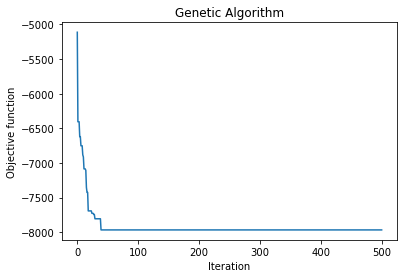

In [92]:
model_ga_t6 = geneticalgorithm(function=object_function_t6,
                               dimension=12,
                               variable_type='int',
                               variable_boundaries=varbound,
                               algorithm_parameters=algorithm_param)

model_ga_t6.run()

In [93]:
convergence_t6 = model_ga_t6.report
solution_t6 = model_ga_t6.output_dict

print(convergence_t6)
print(solution_t6)

[-5111.974662479127, -6405.4743986478525, -6405.4743986478525, -6405.4743986478525, -6620.516167565182, -6620.516167565182, -6752.440561778076, -6752.440561778076, -6752.440561778076, -6883.194399637161, -6913.920085766868, -7086.362043935609, -7086.362043935609, -7086.362043935609, -7107.384760978418, -7355.478099321266, -7426.485108905284, -7426.485108905284, -7693.369708193847, -7693.369708193847, -7693.369708193847, -7693.369708193847, -7693.369708193847, -7693.369708193847, -7728.299348544471, -7728.299348544471, -7728.299348544471, -7744.743811536845, -7744.743811536845, -7807.17985735571, -7807.17985735571, -7807.17985735571, -7807.17985735571, -7807.17985735571, -7807.17985735571, -7807.17985735571, -7807.17985735571, -7807.17985735571, -7807.17985735571, -7968.122012711784, -7968.122012711784, -7968.122012711784, -7968.122012711784, -7968.122012711784, -7968.122012711784, -7968.122012711784, -7968.122012711784, -7968.122012711784, -7968.122012711784, -7968.122012711784, -7968.

In [94]:
ga_solution = input_conversion(solution_t6['variable'])
ga_solution = np.array(ga_solution).reshape(1, -1)

ga_solution_df = pd.DataFrame(ga_solution, columns=features)
ga_solution_df

,G1,absences,goout,age,famrel,studytime,Medu,Walc,Mjob_mean_enc,freetime,Fedu,Fjob_mean_enc
0,19.0,0.0,1.0,15.0,5.0,4.0,4.0,1.0,12.147059,1.0,4.0,10.15


In [95]:
Fjob = Fjob_encode[Fjob_encode.isin(ga_solution_df['Fjob_mean_enc'])].index[0]
ga_solution_df['Fjob_mean_enc'] = Fjob
ga_solution_df = ga_solution_df.rename(columns={'Fjob_mean_enc': 'Fjob'})

Mjob = Mjob_encode[Mjob_encode.isin(ga_solution_df['Mjob_mean_enc'])].index[0]
ga_solution_df['Mjob_mean_enc'] = Mjob
ga_solution_df = ga_solution_df.rename(columns={'Mjob_mean_enc': 'Mjob'})
ga_solution_df

,G1,absences,goout,age,famrel,studytime,Medu,Walc,Mjob,freetime,Fedu,Fjob
0,19.0,0.0,1.0,15.0,5.0,4.0,4.0,1.0,health,1.0,4.0,at_home


In [96]:
prediction = voting_clf.predict(scaler.transform(ga_solution))
ga_solution_df['G3'] = prediction[0]
ga_solution_t6 = ga_solution_df
ga_solution_t6

,G1,absences,goout,age,famrel,studytime,Medu,Walc,Mjob,freetime,Fedu,Fjob,G3
0,19.0,0.0,1.0,15.0,5.0,4.0,4.0,1.0,health,1.0,4.0,at_home,19.9734


In [97]:
df.sort_values(by='G3', ascending=False)

,school,sex,age,address,famsize,Pstatus,Medu,Fedu,Mjob,Fjob,reason,guardian,traveltime,studytime,failures,schoolsup,famsup,paid,activities,nursery,higher,internet,romantic,famrel,freetime,goout,Dalc,Walc,health,absences,G1,G2,G3,address_mean_enc,famsize_mean_enc,Pstatus_mean_enc,Mjob_mean_enc,Fjob_mean_enc,reason_mean_enc,guardian_mean_enc,schoolsup_mean_enc,famsup_mean_enc,paid_mean_enc,activities_mean_enc,nursery_mean_enc,higher_mean_enc,internet_mean_enc,romantic_mean_enc
47,GP,M,16,U,GT3,T,4,3,health,services,reputation,mother,1,4,0,no,no,no,yes,yes,yes,yes,no,4,2,2,1,1,2,4,19,19,20,10.674267,10.177936,10.324859,12.147059,10.297297,11.142857,10.483516,10.561047,10.640523,9.985981,10.487562,10.535032,10.608,10.617021,10.836502
286,GP,F,18,U,GT3,T,2,2,at_home,at_home,other,mother,1,3,0,no,yes,yes,no,yes,yes,yes,no,4,3,3,1,2,2,5,18,18,19,10.674267,10.177936,10.324859,9.152542,10.150000,11.166667,10.483516,10.561047,10.272727,10.922652,10.340206,10.535032,10.608,10.617021,10.836502
110,GP,M,15,U,LE3,A,4,4,teacher,teacher,course,mother,1,1,0,no,no,no,yes,yes,yes,yes,no,5,5,3,1,1,4,6,18,19,19,10.674267,11.000000,11.195122,11.051724,11.965517,9.820690,10.483516,10.561047,10.640523,9.985981,10.487562,10.535032,10.608,10.617021,10.836502
113,GP,M,15,U,LE3,T,4,2,teacher,other,course,mother,1,1,0,no,no,no,no,yes,yes,yes,no,3,5,2,1,1,3,10,18,19,19,10.674267,11.000000,10.324859,11.051724,10.193548,9.820690,10.483516,10.561047,10.640523,9.985981,10.340206,10.535032,10.608,10.617021,10.836502
8,GP,M,15,U,LE3,A,3,2,services,other,home,mother,1,2,0,no,yes,yes,no,yes,yes,yes,no,4,2,2,1,1,1,0,16,18,19,10.674267,11.000000,11.195122,11.019417,10.193548,10.256881,10.483516,10.561047,10.272727,10.922652,10.340206,10.535032,10.608,10.617021,10.836502
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
373,MS,F,17,R,GT3,T,1,2,other,other,course,mother,1,1,0,no,no,no,yes,yes,yes,yes,no,3,5,5,1,3,1,14,6,5,5,9.511364,10.177936,10.324859,9.822695,10.193548,9.820690,10.483516,10.561047,10.640523,9.985981,10.487562,10.535032,10.608,10.617021,10.836502
79,GP,F,16,U,GT3,T,3,4,at_home,other,course,mother,1,2,0,no,yes,no,no,yes,yes,yes,no,2,4,3,1,2,3,12,5,5,5,10.674267,10.177936,10.324859,9.152542,10.193548,9.820690,10.483516,10.561047,10.272727,9.985981,10.340206,10.535032,10.608,10.617021,10.836502
72,GP,F,15,R,GT3,T,1,1,other,other,reputation,mother,1,2,2,yes,yes,no,no,no,yes,yes,yes,3,3,4,2,4,5,2,8,6,5,9.511364,10.177936,10.324859,9.822695,10.193548,11.142857,10.483516,9.431373,10.272727,9.985981,10.340206,9.950617,10.608,10.617021,9.575758
384,MS,M,18,R,GT3,T,4,2,other,other,home,father,2,1,1,no,no,yes,no,yes,yes,no,no,5,4,3,4,3,3,14,6,5,5,9.511364,10.177936,10.324859,9.822695,10.193548,10.256881,10.688889,10.561047,10.640523,10.922652,10.340206,10.535032,10.608,9.409091,10.836502
